### RNN with LSTM cell
* Architecture reference from https://arxiv.org/pdf/2004.00959.pdf
* Country-specific network (with only non-zero data)

(Something new: Maybe decrease number of classifier by grouping countries in the same GDP/ bracket)

#### Data partition
* Test data is the last 10 days
* Validation 10 days before last 10 days
* Data logged
* Noise added is smaller compared to Offline-3 (and only positive)
* Also optimize momentum of SGD
* Some countries kicked out for having too many zeros
* Version 5 learns the difference! Instead of the data itself
* Version 6 is the same as 5 but lite (in case it doesn't finish training)

In [1]:
import torch
import pandas as pd
import numpy as np
import os
import copy
#import writer
import random
from sklearn.preprocessing import normalize
import seaborn as sns
#import 
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

# Assuming that we are on a CUDA machine, this should print a CUDA device:

print(device)

cuda:0


In [2]:
# read data in
csse_country = "CPSC540_Covid/active_data/csse_world_normalized.csv"
df_csse = pd.read_csv(csse_country)
df_csse.head(10)
#list(df_csse.columns.values.tolist()) 
countries = df_csse["Country/Region"].tolist()

In [3]:
countries
df_csse.shape

(172, 86)

#### What if use grouping from k-means? or hierarchical clustering to decide which countries are in the same bracket


In [4]:
validation_d = 5
test_d = 5

# Convert to numpy array

cases = df_csse.loc[:,'1/22/20':]
casesA = cases.to_numpy()
casesA
count, days = casesA.shape

print(days)
# last 10 days for test

case_test = casesA[:,-test_d:]
case_validation = casesA[:,days-validation_d-test_d:days-test_d]
case_train = casesA[:,:days-validation_d-test_d]

print(case_test.shape)
print(case_validation.shape)
print(case_train.shape)

84
(172, 5)
(172, 5)
(172, 74)


In [5]:
def find_zero(lst):
    numzero = 0
    for i in lst:
        if i ==0:
            numzero += 1
    return(numzero)

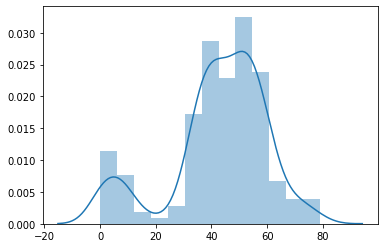

In [6]:
# graph number of days zero
cutoff = 25 # at most = 0
lstzero = []
skip_countries = []
for i in range(len(countries)):
    numz = find_zero(casesA[i,:].tolist())
    lstzero.append(numz)
    if numz > cutoff:
        skip_countries.append(i)

sns.distplot(np.array(lstzero));

In [7]:
len(skip_countries)

149

From the distribution, 30 seems a reasonable cutoff (most countries still present)

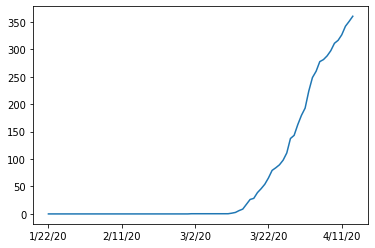

In [8]:
# plot 
#epoch = np.linspace(1, len(trainErr), len(trainErr))

cases.loc[50,:].plot.line()


In [9]:
case_train

array([[0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
        2.52296317e-01, 2.52296317e-01, 2.52296317e-01],
       [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
        4.04858300e+01, 4.95951417e+01, 5.06072874e+01],
       [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
        6.20342147e+00, 6.20342147e+00, 8.17723739e+00],
       ...,
       [3.02112385e-03, 3.02112385e-03, 6.04224770e-03, ...,
        7.36435192e+02, 8.32579437e+02, 9.33083164e+02],
       [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
        1.91862032e+05, 1.91862032e+05, 1.91862032e+05],
       [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
        4.39667807e+03, 4.39667807e+03, 4.39667807e+03]])

In [10]:
# log transform
case_test_log = np.log(case_test)
case_validation_log = np.log(case_validation)
case_train_log = np.log(case_train)
case_train_log

/space/home/nzhang/anaconda3/envs/neuralnet/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: divide by zero encountered in log
  This is separate from the ipykernel package so we can avoid doing imports until
/space/home/nzhang/anaconda3/envs/neuralnet/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log
  after removing the cwd from sys.path.


array([[       -inf,        -inf,        -inf, ..., -1.37715102,
        -1.37715102, -1.37715102],
       [       -inf,        -inf,        -inf, ...,  3.70095204,
         3.90389288,  3.92409559],
       [       -inf,        -inf,        -inf, ...,  1.82510099,
         1.82510099,  2.10135437],
       ...,
       [-5.80212638, -5.80212638, -5.1089792 , ...,  6.60182124,
         6.72452864,  6.83849433],
       [       -inf,        -inf,        -inf, ..., 12.16453181,
        12.16453181, 12.16453181],
       [       -inf,        -inf,        -inf, ...,  8.38860455,
         8.38860455,  8.38860455]])

### Divide data into training sets
* specify number of days for train and prediction
* offset the dataset so for example: [1,2,3,4] then get [1,2],[2,3] which predicts 3 and 4 respectively

In [11]:
# test 
np.array(case_train[3,:])
#total_days-pred_days-t_days
case_train[3,5:8]

array([0., 0., 0.])

In [12]:
def clear_zero(nparray):
    # return the np array that contains only 1 0:
    lst = nparray.tolist()
    #print(len(lst))
    ind = 0
    splitInd = 0
    while(lst[ind]==0):
        splitInd += 1
        ind += 1
    #print(splitInd)
    return(np.array(lst[splitInd:]))

In [13]:
clear_zero(case_train[169,:]).shape[0]

74

In [14]:
def get_diff(arr):
    lst = arr.tolist()
    difflst = []
    for i in range(len(lst)):
        if i == 0:
            continue
        # start
        difflst.append(lst[i]-lst[i-1])
    return(np.array(difflst))

In [15]:
t_days = 25 # number of days used to test 
pred_days = test_d
total_days = case_train.shape[1]

country_train_X = []
country_train_Y = []

country_valid_X = []
country_valid_Y = []

country_test_X = []
country_test_Y = []

diffData = []
for i in range(len(countries)):
    print(countries[i] + " "+ str(i))
    
    if i in skip_countries:
        country_train_X.append(0)
        country_train_Y.append(0)

        country_valid_X.append(0)
        country_valid_Y.append(0)

        country_test_X.append(0)
        country_test_Y.append(0)
        diffData.append(0)
        continue # too little data 
        
    # split dataset
    cur_c = [] # current country 
    out = []
    
    cur_v = [] # current country 
    out_v = []
    
    cur_t = [] # current country 
    out_t = []
    
    newcase1 = clear_zero(case_train[i,:])
    newcase = get_diff(newcase1)
    total_days = newcase.shape[0]
    diffData.append(newcase)
    print(total_days)
    for j in range(total_days-pred_days*2-t_days): 
        
        #print(j)
        #print(case_train[i,j:j+t_days].shape)
        #print(len(case_train[i,j+t_days]))
        cur_c.append(newcase[j:j+t_days])
        #print(str(j))
        out.append(newcase[j+t_days:j+t_days+pred_days])
        #print(len(cur_c))
    
    country_train_X.append(cur_c)
    country_train_Y.append(out)
    
    country_valid_X.append(newcase[total_days-t_days-test_d*2:total_days-test_d*2])
    print(newcase[total_days-t_days-test_d*2:total_days-test_d*2].shape)
    country_valid_Y.append(newcase[total_days-test_d*2:total_days-test_d])
    print(newcase[total_days-test_d*2:total_days-test_d].shape)
    
    country_test_X.append(newcase[total_days-test_d-t_days:total_days-test_d])
    country_test_Y.append(newcase[total_days-test_d:])
    
    # the best way to check this
    #testlist = 


Burundi 0
Djibouti 1
Eritrea 2
Ethiopia 3
Kenya 4
Madagascar 5
Malawi 6
Mauritius 7
Mozambique 8
Rwanda 9
Seychelles 10
Somalia 11
South Sudan 12
Uganda 13
Tanzania 14
Zambia 15
Zimbabwe 16
Angola 17
Cameroon 18
Central African Republic 19
Chad 20
Equatorial Guinea 21
Gabon 22
Sao Tome and Principe 23
Botswana 24
Eswatini 25
Namibia 26
South Africa 27
Benin 28
Burkina Faso 29
Cabo Verde 30
Gambia 31
Ghana 32
Guinea 33
Guinea-Bissau 34
Liberia 35
Mali 36
Mauritania 37
Niger 38
Nigeria 39
Senegal 40
Sierra Leone 41
Togo 42
Algeria 43
Egypt 44
50
(25,)
(5,)
Libya 45
Morocco 46
Sudan 47
Tunisia 48
Western Sahara 49
Armenia 50
Azerbaijan 51
Bahrain 52
Cyprus 53
Georgia 54
Iraq 55
Israel 56
Jordan 57
Kuwait 58
Lebanon 59
Oman 60
Qatar 61
Saudi Arabia 62
Syria 63
Turkey 64
United Arab Emirates 65
66
(25,)
(5,)
Yemen 66
Kazakhstan 67
Kyrgyzstan 68
Uzbekistan 69
Afghanistan 70
Bangladesh 71
Bhutan 72
India 73
65
(25,)
(5,)
Iran 74
Maldives 75
Nepal 76
70
(25,)
(5,)
Pakistan 77
Sri Lanka 78
68
(

In [16]:
country_train_X[88][0].shape
country_train_X[81][0].shape

(25,)

In [17]:
len(country_train_X)

172

In [18]:
# check dimension

#len(country_test_X[33])
total_days-pred_days-test_d
pred_days
test_d
total_days
case_train[0,29:64].shape
case_train[0,0:40].shape

(40,)

#### Data size & index
The first axis is the sequence itself, the second indexes instances in the mini-batch, and the third indexes elements of the input. We haven’t discussed mini-batching, so lets just ignore that and assume we will always have just 1 dimension on the second axis.

In [19]:
#import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim

torch.manual_seed(1)

### Optimized hyperparameters
|Parameter |Description|Distribution/Selection|Values|
|----------|------------|----------------------|---------|
|Learning rate|Minimum learning rate| Discrete|1e-1 to 1e-7|
|Hidden layers|Number of layers in the network|Discrete numeric|1 to 5|
|Hidden state|Number of memory cell in each layer|Discrete numeric|1 to 200|
|Momentum|SGD optimizer parameter for overshoot direction|Discrete numeric|0.1 to 0.9|

In [20]:
# Parameter
num_epochs = 50 # max
batch_size = 1
# Loss and optimizer
criterion = torch.nn.MSELoss()
#optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)
learning_rate = 0.01 # to be changed/optimized 
#optimizer = torch.optim.SGD(model.parameters(), lr = learning_rate, momentum=0.9)
output_directory = "mock/"
output_file_path = "mock/Train"
input_dim = t_days
hidden_dim = 2
hidden_state = 100
output_dim= pred_days
num_layers=2
lstm_input_size = t_days
#model = LSTM(lstm_input_size, hidden_dim, batch_size=batch_size, output_dim=output_dim, num_layers=num_layers)

model_name = "mock"
output_file_path = "./outputs/" + model_name + "/training/"
directory = os.path.dirname(output_file_path)
if not os.path.exists(directory):
    print("Creating directory %s" % output_file_path)
    os.makedirs(directory)
else:
     print("Directory %s exists" % output_file_path)


Directory ./outputs/mock/training/ exists


In [21]:
# RNN structure

class RNN(nn.Module):

    # you can also accept arguments in your model constructor
    def __init__(self, data_size, hidden_size, output_size):
        super(RNN, self).__init__()

        self.hidden_size = hidden_size
        input_size = data_size + hidden_size

        self.i2h = nn.Linear(input_size, hidden_size)
        self.h2o = nn.Linear(hidden_size, output_size)

    def forward(self, data, last_hidden):
        input = torch.cat((data, last_hidden), 1)
        hidden = self.i2h(input)
        output = self.h2o(hidden)
        return hidden, output
    
    def initHidden(self):
        return torch.zeros(1, self.hidden_size)


In [22]:
# LSTM structure

class LSTM(nn.Module):
 
    def __init__(self, input_dim, hidden_dim, batch_size, output_dim=pred_days,
                    num_layers=2):
        super(LSTM, self).__init__()
        self.input_dim = input_dim
        self.hidden_dim = hidden_dim
        self.batch_size = batch_size
        self.num_layers = num_layers
 
        # Define the LSTM layer
        self.lstm = nn.LSTM(self.input_dim, self.hidden_dim, self.num_layers,dropout=0)
 
        # Define the output layer
        self.linear = nn.Linear(self.hidden_dim, output_dim)
 
    def init_hidden(self):
        # This is what we'll initialise our hidden state as
        return (torch.zeros(self.num_layers, self.batch_size, self.hidden_dim),
                torch.zeros(self.num_layers, self.batch_size, self.hidden_dim))
 
    def forward(self, input):
        # Forward pass through LSTM layer
        # shape of lstm_out: [input_size, batch_size, hidden_dim]
        # shape of self.hidden: (a, b), where a and b both 
        # have shape (num_layers, batch_size, hidden_dim).
        lstm_out, self.hidden = self.lstm(input.view(len(input), self.batch_size, -1))
        
        # Only take the output from the final timetep
        # Can pass on the entirety of lstm_out to the next layer if it is a seq2seq prediction
        y_pred = self.linear(lstm_out[-1].view(self.batch_size, -1))
        
        return y_pred.view(-1)

#model = LSTM(lstm_input_size, h1, batch_size=num_train, output_dim=output_dim, num_layers=num_layers)

In [23]:
# training function
def train_model(train_loader, test_loader, model, device, criterion, optimizer, num_epochs, output_directory,learning_rate,hidden_dim,num_layers,momentum):
    
    total_step = len(train_loader)
    model.train()
    model.hidden = model.init_hidden() # LSTM hidden reinitialization
    
    #open files to log error
    train_error = open(output_directory + "training_error"+ "_"+str(learning_rate)+ "_"+ str(hidden_dim) + "_"+ str(num_layers)+ "_"+ str(momentum) +".txt", "a")
    test_error = open(output_directory + "validation_error"+ "_"+str(learning_rate)+ "_"+ str(hidden_dim) + "_"+ str(num_layers) + "_"+ str(momentum)+".txt", "a")

    #best_model_wts = copy.deepcopy(model.state_dict())
    best_loss_valid = float('inf')
    best_epoch = 1

    for epoch in range(num_epochs):
        model.train()
        running_loss = 0.0
        for i, (seqs, labels) in enumerate(train_loader):
            #print(seqs.shape)
            # add gaussian noise to sequence
            noiselevel = torch.max(torch.tensor(country_train_X[2])).item()/1000
            noise = torch.abs(torch.randn(seqs.shape[0],seqs.shape[1],seqs.shape[2],seqs.shape[3])*noiselevel)
            #print(noise.shape)
            seqs += noise # add gaussian noise
            #print(seqs.shape)
            seqs = seqs.to(device)
            labels = labels.to(device)

            # Forward pass
            #seqs = seqs.squeeze()
            #print(seqs.shape)
            #print(model(seqs))
            outputs = model(seqs) # error 
            loss = criterion(outputs, labels) # change input to 
            running_loss += loss.item()
        
            # Backward and optimize
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

            #if (i+1) % 100 == 0:
            #    print ('Epoch [{}/{}], Step [{}/{}], Loss: {:.4f}'
            #           .format(epoch+1, num_epochs, i+1, total_step, loss.item()))

        #save training loss to file
        epoch_loss = running_loss / len(train_loader.dataset)
        print("%s, %s" % (epoch, epoch_loss), file=train_error)
        
        #calculate test loss for epoch
        test_loss = 0.0
        with torch.no_grad():
            model.eval()
            for i, (seqs, labels) in enumerate(test_loader):
                x = seqs.to(device)
                y = labels.to(device)
                outputs = model(x)
                #print(outputs.shape)
                #print(y.shape)
                loss = criterion(outputs, y)
                test_loss += loss.item() 
                
                # for metrics
                #updateYlist(outputs,y)
                

        test_loss = test_loss / len(test_loader.dataset)
        
        #save outputs for epoch
        print("%s, %s" % (epoch, test_loss), file=test_error)
        
        # for each epoch, calculate metrics (f1, pr)
        #calculateMetrics(outputs,y)
        
        if test_loss < best_loss_valid:
            best_loss_valid = test_loss
            best_epoch = epoch
            best_model_wts = copy.deepcopy(model.state_dict())
            print ('Saving the best model weights at Epoch [{}], Best Valid Loss: {:.4f}' 
                       .format(epoch+1, best_loss_valid))

        
    train_error.close()
    test_error.close()

    #model.load_state_dict(best_model_wts)
    print("train error:", epoch_loss)
    return model, best_loss_valid


In [24]:
def test_model(test_loader, model, device,criterion):
    #predictions = torch.zeros(0, numClass)
    test_loss = 0.0
    
    with torch.no_grad():
        model.eval()
        for i, (seqs, labels) in enumerate(test_loader):            
            seqs = seqs.to(device)
            y = labels.to(device).float()
            print(y)
            pred = model(seqs).float()
            print(pred)
            loss = criterion(pred, y)
            test_loss += loss.item() 
            
    return pred,test_loss

In [25]:
#dimension check
a = torch.tensor(country_train_X[81]) #torch.Size([19, 30, 1, 1])
# torch.tensor(country_valid_X[0]).unsqueeze_(1).unsqueeze_(1).unsqueeze_(0).shape
# torch.tensor(country_valid_Y[0]).unsqueeze_(0).shape
# #torch.tensor(country_train_Y[0])
# torch.tensor(country_train_X[0])
# a.size(-1)
# torch.tensor(country_test_Y[0]).unsqueeze_(0).shape
# torch.tensor(country_valid_Y[0]).unsqueeze_(0).shape
# torch.tensor(country_train_Y[0]).unsqueeze_(1).shape
# #torch.tensor(country_valid_Y[0]).unsqueeze_(0).unsqueeze_(0).shape
# torch.tensor(country_train_Y[0]).unsqueeze_(1).shape
# torch.tensor(country_valid_Y[0]).unsqueeze_(0).shape
# torch.tensor(country_valid_X[0]).unsqueeze_(1).unsqueeze_(1).unsqueeze_(0).shape
# torch.tensor(country_train_X[0]).unsqueeze_(2).unsqueeze_(2).shape
# torch.tensor(country_valid_X[0]).unsqueeze_(1).unsqueeze_(1).unsqueeze_(0).shape

In [26]:
import matplotlib.pyplot as plt

graph_dir = "./graph_Offline6/"
directory = os.path.dirname(graph_dir)
if not os.path.exists(directory):
    print("Creating directory %s" % graph_dir)
    os.makedirs(directory)
else:
     print("Directory %s exists" % graph_dir)

def graph_country(index,prediction,outdir):
    
    # produce projection closeup & general graph
    # with label & title
    #print(prediction)
    data = diffData[index]
    newpred = prediction#.tolist()
    days = data.shape[0]
    
    # general trend
    x = np.linspace(1, len(data.tolist()), len(data.tolist()))
    y_real = data
    y_pred = data[:days-test_d].tolist()
    #print(len(y_pred))
    y_pred.extend(newpred)
    #print(len(y_pred))
    #print(len(y_real))
    y_pred = np.array(y_pred)
    plt.figure(index)
    plt.plot(x, y_real, label = "real")
    plt.plot(x, y_pred, label = "prediction")
    
    plt.xlabel('Days')
    plt.title(countries[index]+" trend")
    plt.savefig(outdir+countries[i]+"_general")
    plt.show()
    # specific plot
    
    x = np.linspace(1, len(data[days-test_d:].tolist()), len(data[days-test_d:].tolist()))
    y_real = data[days-test_d:]
    y_pred = newpred
    plt.figure(index*2)
    plt.plot(x, y_real, label = "real")
    plt.plot(x, y_pred, label = "prediction")
    
    plt.xlabel('Days')
    plt.title(countries[index]+" 5 days prediction")
    plt.savefig(outdir+countries[i]+"_specific")    
    plt.show()

Directory ./graph_Offline5/ exists


In [27]:
# test if it runs
learning_rate = 0.01 # to be changed/optimized 
num_layers = 2
hidden_dim = 100
momentum = 0.1

net =  LSTM(lstm_input_size, hidden_dim, batch_size=batch_size, output_dim=output_dim, num_layers=num_layers)
print(net)
model = net.to(device)
optimizer = torch.optim.SGD(model.parameters(), lr = learning_rate, momentum=0.9)

train_dataset = torch.utils.data.TensorDataset(torch.tensor(country_train_X[81]).unsqueeze_(2).unsqueeze_(2).float(), torch.tensor(country_train_Y[81]).unsqueeze_(1).float())
train_loader = torch.utils.data.DataLoader(dataset=train_dataset, batch_size=batch_size, shuffle=True)

# load validation
valid_dataset = torch.utils.data.TensorDataset(torch.tensor(country_valid_X[81]).unsqueeze_(1).unsqueeze_(1).unsqueeze_(0).float(), torch.tensor(country_valid_Y[81]).unsqueeze_(0).float())
valid_loader = torch.utils.data.DataLoader(dataset=valid_dataset, batch_size=batch_size, shuffle=False)

# load test
test_dataset = torch.utils.data.TensorDataset(torch.tensor(country_test_X[81]).unsqueeze_(1).unsqueeze_(1).unsqueeze_(0).float(), torch.tensor(country_test_Y[81]).unsqueeze_(0).float())
test_loader = torch.utils.data.DataLoader(dataset=test_dataset, batch_size=batch_size, shuffle=False)


# mock trial
err = train_model(train_loader, valid_loader, model, device, criterion,  optimizer, num_epochs, output_file_path,learning_rate,hidden_dim, num_layers,momentum)



LSTM(
  (lstm): LSTM(25, 100, num_layers=2)
  (linear): Linear(in_features=100, out_features=5, bias=True)
)


/space/home/nzhang/anaconda3/envs/neuralnet/lib/python3.7/site-packages/torch/nn/modules/loss.py:431: UserWarning: Using a target size (torch.Size([1, 1, 5])) that is different to the input size (torch.Size([5])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/space/home/nzhang/anaconda3/envs/neuralnet/lib/python3.7/site-packages/torch/nn/modules/loss.py:431: UserWarning: Using a target size (torch.Size([1, 5])) that is different to the input size (torch.Size([5])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Saving the best model weights at Epoch [1], Best Valid Loss: 0.7902
Saving the best model weights at Epoch [2], Best Valid Loss: 0.7298
Saving the best model weights at Epoch [3], Best Valid Loss: 0.7272
Saving the best model weights at Epoch [5], Best Valid Loss: 0.7154
train error: 0.07441212343493182


tensor([[0.6879, 1.7790, 2.5064, 0.9646, 4.1273]], device='cuda:0')
tensor([0.2881, 0.3184, 0.2996, 0.3696, 0.4002], device='cuda:0')


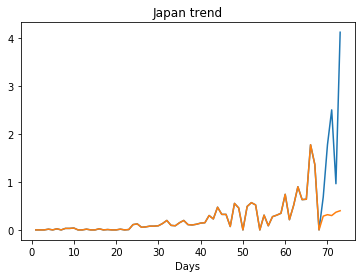

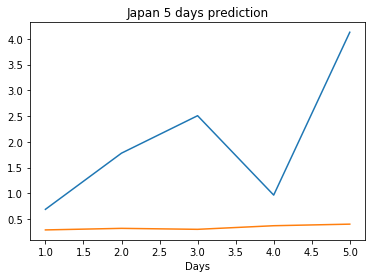

In [28]:
pred, loss = test_model(test_loader,model,device,criterion)
graph_country(81,pred.tolist(),graph_dir)

In [29]:
diffData[81].shape

(73,)

Creating directory ./offline6/Egypt/training/
Egypt
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0999
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0352
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0170
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0110
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0080


/space/home/nzhang/anaconda3/envs/neuralnet/lib/python3.7/site-packages/torch/nn/modules/loss.py:431: UserWarning: Using a target size (torch.Size([1, 1, 5])) that is different to the input size (torch.Size([5])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/space/home/nzhang/anaconda3/envs/neuralnet/lib/python3.7/site-packages/torch/nn/modules/loss.py:431: UserWarning: Using a target size (torch.Size([1, 5])) that is different to the input size (torch.Size([5])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Saving the best model weights at Epoch [6], Best Valid Loss: 0.0079
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0065
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0064
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0064
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0058
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0058
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0057
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0053
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0052
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0051
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0047
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0047
train error: 0.027791897393763067
0.

Saving the best model weights at Epoch [26], Best Valid Loss: 0.0062
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0057
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0051
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0047
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0045
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0038
train error: 0.026664665900170803
0.0038169682957232
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0071
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0062
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0042
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0037
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0032
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0017
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0008
train error: 0.01747881919145584
0.00078938057413324

Saving the best model weights at Epoch [19], Best Valid Loss: 0.0087
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0086
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0082
train error: 0.03265987535317739
0.008219699375331402
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0092
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0062
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0058
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0056
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0053
train error: 0.03468753614773353
0.0052936202846467495
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0590
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0267
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0177
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0139
S

Saving the best model weights at Epoch [4], Best Valid Loss: 0.0098
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0089
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0088
train error: 0.03258905249337355
0.008753941394388676
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0101
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0092
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0069
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0066
train error: 0.03787557613104582
0.006584643851965666
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0501
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0252
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0172
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0135
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0123
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0108
Saving

train error: 0.032631181987623374
0.007831207476556301
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0053
train error: 0.03703171020994584
0.0052737342193722725
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0596
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0285
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0184
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0133
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0106
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0106
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0106
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0106
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0102
Sa

Saving the best model weights at Epoch [50], Best Valid Loss: 0.0086
train error: 0.029732630401849747
0.008567385375499725
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1133
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0356
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0136
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0065
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0064
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0064
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0063
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0063
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0059
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0056
train error: 0.027636942795167367
0.005613592453300953
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1829
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1636
S

Saving the best model weights at Epoch [41], Best Valid Loss: 0.0048
train error: 0.028752744322021802
0.00481068342924118
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1039
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0936
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0845
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0764
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0693
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0630
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0574
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0525
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0481
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0442
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0408
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0377
Saving the best model weights at Epoch [13], Best Valid Lo

Saving the best model weights at Epoch [21], Best Valid Loss: 0.0248
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0234
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0222
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0211
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0201
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0192
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0184
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0176
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0169
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0163
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0158
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0152
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0147
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0143
Saving the best model weights at E

Saving the best model weights at Epoch [40], Best Valid Loss: 0.0135
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0133
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0131
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0129
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0126
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0124
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0123
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0122
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0120
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0119
train error: 0.030569541826844217
0.011946170590817928
Saving the best model weights at Epoch [1], Best Valid Loss: 0.2008
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1629
Saving the best model weights at Epoch [3], Best V

Saving the best model weights at Epoch [10], Best Valid Loss: 0.0343
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0304
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0273
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0243
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0223
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0206
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0193
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0179
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0167
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0159
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0153
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0146
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0140
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0136
Saving the best model weights at E

Saving the best model weights at Epoch [30], Best Valid Loss: 0.0117
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0116
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0114
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0113
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0111
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0108
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0108
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0107
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0106
train error: 0.030520404130220412
0.010564289055764675
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1259
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0435
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0170
Saving the best model weights at Epoch [4], Best Va

Saving the best model weights at Epoch [8], Best Valid Loss: 0.0794
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0725
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0663
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0608
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0559
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0516
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0477
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0442
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0411
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0383
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0358
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0336
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0315
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0297
Saving the best model weights at Epo

Saving the best model weights at Epoch [36], Best Valid Loss: 0.0166
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0161
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0157
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0153
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0150
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0146
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0143
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0141
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0138
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0136
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0134
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0132
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0130
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0128
Saving the best model weights at E

Saving the best model weights at Epoch [7], Best Valid Loss: 0.0399
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0352
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0312
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0280
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0252
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0231
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0213
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0200
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0185
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0173
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0165
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0156
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0151
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0145
Saving the best model weights at Epoc

Saving the best model weights at Epoch [34], Best Valid Loss: 0.0112
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0112
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0111
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0110
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0110
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0108
train error: 0.030561027427514393
0.010757864452898502
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0953
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0346
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0132
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0103
Saving the best model weights at Epoch [5], Best Val

Saving the best model weights at Epoch [8], Best Valid Loss: 0.0572
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0524
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0483
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0446
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0413
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0383
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0356
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0333
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0312
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0293
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0276
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0261
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0247
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0235
Saving the best model weights at Epo

Saving the best model weights at Epoch [32], Best Valid Loss: 0.0169
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0164
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0160
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0156
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0152
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0149
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0146
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0143
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0140
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0138
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0136
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0134
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0132
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0130
Saving the best model weights at E

Saving the best model weights at Epoch [6], Best Valid Loss: 0.0529
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0454
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0396
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0346
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0310
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0275
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0248
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0225
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0209
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0193
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0182
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0171
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0161
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0152
Saving the best model weights at Epoch

Saving the best model weights at Epoch [30], Best Valid Loss: 0.0118
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0117
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0116
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0114
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0114
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0114
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0112
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0111
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0111
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0108
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0108
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0108
train error: 0.03053242564201355
0

Saving the best model weights at Epoch [7], Best Valid Loss: 0.0751
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0684
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0624
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0571
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0525
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0483
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0446
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0413
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0384
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0357
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0334
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0313
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0294
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0277
Saving the best model weights at Epoc

Saving the best model weights at Epoch [29], Best Valid Loss: 0.0191
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0183
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0177
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0172
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0166
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0161
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0157
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0153
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0149
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0146
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0143
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0140
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0138
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0136
Saving the best model weights at E

Saving the best model weights at Epoch [4], Best Valid Loss: 0.2709
Saving the best model weights at Epoch [5], Best Valid Loss: 0.2652
Saving the best model weights at Epoch [6], Best Valid Loss: 0.2596
Saving the best model weights at Epoch [7], Best Valid Loss: 0.2541
Saving the best model weights at Epoch [8], Best Valid Loss: 0.2487
Saving the best model weights at Epoch [9], Best Valid Loss: 0.2436
Saving the best model weights at Epoch [10], Best Valid Loss: 0.2384
Saving the best model weights at Epoch [11], Best Valid Loss: 0.2335
Saving the best model weights at Epoch [12], Best Valid Loss: 0.2286
Saving the best model weights at Epoch [13], Best Valid Loss: 0.2239
Saving the best model weights at Epoch [14], Best Valid Loss: 0.2192
Saving the best model weights at Epoch [15], Best Valid Loss: 0.2148
Saving the best model weights at Epoch [16], Best Valid Loss: 0.2104
Saving the best model weights at Epoch [17], Best Valid Loss: 0.2059
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [24], Best Valid Loss: 0.1393
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1377
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1361
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1346
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1330
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1315
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1300
Saving the best model weights at Epoch [31], Best Valid Loss: 0.1285
Saving the best model weights at Epoch [32], Best Valid Loss: 0.1270
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1256
Saving the best model weights at Epoch [34], Best Valid Loss: 0.1241
Saving the best model weights at Epoch [35], Best Valid Loss: 0.1227
Saving the best model weights at Epoch [36], Best Valid Loss: 0.1213
Saving the best model weights at Epoch [37], Best Valid Loss: 0.1200
Saving the best model weights at E

Saving the best model weights at Epoch [44], Best Valid Loss: 0.0100
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0098
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0098
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0096
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0094
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0093
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0091
train error: 0.029647199933727584
0.00909059401601553
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1039
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1028
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1016
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1005
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0994
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0983
Saving the best model weights at Epoch [7], Best Valid 

Saving the best model weights at Epoch [15], Best Valid Loss: 0.0382
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0358
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0335
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0315
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0299
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0283
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0265
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0254
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0244
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0231
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0221
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0212
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0202
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0197
Saving the best model weights at E

Saving the best model weights at Epoch [35], Best Valid Loss: 0.0719
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0707
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0695
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0684
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0672
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0661
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0650
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0640
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0629
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0619
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0609
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0599
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0590
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0580
Saving the best model weights at E

Saving the best model weights at Epoch [3], Best Valid Loss: 0.1220
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1197
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1174
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1152
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1130
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1109
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1088
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1068
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1049
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1029
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1010
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0992
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0974
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0956
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [23], Best Valid Loss: 0.1426
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1411
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1396
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1381
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1366
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1352
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1337
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1323
Saving the best model weights at Epoch [31], Best Valid Loss: 0.1309
Saving the best model weights at Epoch [32], Best Valid Loss: 0.1295
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1282
Saving the best model weights at Epoch [34], Best Valid Loss: 0.1268
Saving the best model weights at Epoch [35], Best Valid Loss: 0.1255
Saving the best model weights at Epoch [36], Best Valid Loss: 0.1242
Saving the best model weights at E

Saving the best model weights at Epoch [43], Best Valid Loss: 0.0137
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0136
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0133
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0131
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0129
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0124
train error: 0.030528313728670278
0.012430147267878056
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1601
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1584
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1566
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1549
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1531
Saving the best model weights at Epoch [6], Best Vali

Saving the best model weights at Epoch [13], Best Valid Loss: 0.0584
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0536
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0461
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0431
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0399
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0373
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0351
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0330
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0310
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0291
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0275
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0260
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0248
Saving the best model weights at E

Saving the best model weights at Epoch [34], Best Valid Loss: 0.0736
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0724
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0712
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0700
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0689
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0678
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0666
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0656
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0644
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0635
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0624
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0614
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0605
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0595
Saving the best model weights at E

Saving the best model weights at Epoch [3], Best Valid Loss: 0.2442
Saving the best model weights at Epoch [4], Best Valid Loss: 0.2391
Saving the best model weights at Epoch [5], Best Valid Loss: 0.2343
Saving the best model weights at Epoch [6], Best Valid Loss: 0.2295
Saving the best model weights at Epoch [7], Best Valid Loss: 0.2248
Saving the best model weights at Epoch [8], Best Valid Loss: 0.2202
Saving the best model weights at Epoch [9], Best Valid Loss: 0.2158
Saving the best model weights at Epoch [10], Best Valid Loss: 0.2114
Saving the best model weights at Epoch [11], Best Valid Loss: 0.2072
Saving the best model weights at Epoch [12], Best Valid Loss: 0.2030
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1989
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1949
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1910
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1872
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [24], Best Valid Loss: 0.0848
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0840
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0832
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0824
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0816
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0808
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0801
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0793
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0786
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0778
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0771
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0764
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0757
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0750
Saving the best model weights at E

Saving the best model weights at Epoch [44], Best Valid Loss: 0.0147
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0144
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0142
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0139
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0137
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0134
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0132
train error: 0.030601397653420768
0.013164940290153027
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1583
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1566
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1549
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1532
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1515
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1498
Saving the best model weights at Epoch [7], Best Valid

Saving the best model weights at Epoch [14], Best Valid Loss: 0.0476
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0444
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0412
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0384
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0360
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0339
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0319
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0299
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0282
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0267
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0254
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0244
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0232
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0221
Saving the best model weights at E

Saving the best model weights at Epoch [34], Best Valid Loss: 0.0845
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0830
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0816
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0802
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0788
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0774
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0761
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0748
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0735
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0723
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0711
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0699
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0687
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0676
Saving the best model weights at E

Saving the best model weights at Epoch [1], Best Valid Loss: 0.2140
Saving the best model weights at Epoch [2], Best Valid Loss: 0.2097
Saving the best model weights at Epoch [3], Best Valid Loss: 0.2056
Saving the best model weights at Epoch [4], Best Valid Loss: 0.2016
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1976
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1938
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1899
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1862
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1826
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1791
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1757
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1723
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1690
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1657
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [21], Best Valid Loss: 0.1030
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1020
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1010
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1000
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0990
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0981
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0971
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0962
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0953
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0943
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0934
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0925
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0917
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0908
Saving the best model weights at E

Saving the best model weights at Epoch [42], Best Valid Loss: 0.0140
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0136
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0135
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0133
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0131
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0129
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0126
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0124
train error: 0.03054067517320315
0.012436720542609692
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1121
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1109
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1098
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1086
Saving the best model weights at Epoch [5], Best Vali

Saving the best model weights at Epoch [10], Best Valid Loss: 0.0749
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0684
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0632
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0583
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0536
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0500
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0463
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0430
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0402
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0378
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0352
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0332
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0315
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0296
Saving the best model weights at E

Saving the best model weights at Epoch [29], Best Valid Loss: 0.1177
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1155
Saving the best model weights at Epoch [31], Best Valid Loss: 0.1133
Saving the best model weights at Epoch [32], Best Valid Loss: 0.1112
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1091
Saving the best model weights at Epoch [34], Best Valid Loss: 0.1072
Saving the best model weights at Epoch [35], Best Valid Loss: 0.1051
Saving the best model weights at Epoch [36], Best Valid Loss: 0.1031
Saving the best model weights at Epoch [37], Best Valid Loss: 0.1014
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0995
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0977
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0959
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0942
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0925
Saving the best model weights at E

Saving the best model weights at Epoch [50], Best Valid Loss: 0.1710
train error: 0.1397704854607582
0.17097845673561096
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1130
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1106
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1083
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1062
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1040
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1019
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0998
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0978
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0959
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0940
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0921
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0903
Saving the best model weights at Epoch [13], Best Valid Loss

Saving the best model weights at Epoch [17], Best Valid Loss: 0.1387
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1372
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1358
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1344
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1330
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1316
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1303
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1290
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1276
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1263
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1251
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1238
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1225
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1213
Saving the best model weights at E

Saving the best model weights at Epoch [35], Best Valid Loss: 0.0158
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0153
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0151
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0149
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0144
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0141
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0139
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0136
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0135
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0132
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0131
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0130
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0128
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0127
Saving the best model weights at E

Saving the best model weights at Epoch [3], Best Valid Loss: 0.1082
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0982
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0895
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0819
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0750
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0686
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0631
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0575
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0534
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0493
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0458
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0424
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0398
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0370
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [21], Best Valid Loss: 0.0920
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0903
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0888
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0873
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0857
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0843
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0828
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0814
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0800
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0787
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0773
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0760
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0748
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0735
Saving the best model weights at E

Saving the best model weights at Epoch [42], Best Valid Loss: 0.1351
Saving the best model weights at Epoch [43], Best Valid Loss: 0.1350
Saving the best model weights at Epoch [44], Best Valid Loss: 0.1348
Saving the best model weights at Epoch [45], Best Valid Loss: 0.1347
Saving the best model weights at Epoch [46], Best Valid Loss: 0.1345
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1344
Saving the best model weights at Epoch [48], Best Valid Loss: 0.1342
Saving the best model weights at Epoch [49], Best Valid Loss: 0.1341
Saving the best model weights at Epoch [50], Best Valid Loss: 0.1339
train error: 0.11116330474615096
0.1339230090379715
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1807
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1803
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1799
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1795
Saving the best model weights at Epoch [5], Best Valid 

Saving the best model weights at Epoch [10], Best Valid Loss: 0.1687
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1685
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1683
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1681
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1680
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1678
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1676
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1674
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1672
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1670
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1668
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1667
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1665
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1663
Saving the best model weights at E

Saving the best model weights at Epoch [34], Best Valid Loss: 0.1043
Saving the best model weights at Epoch [35], Best Valid Loss: 0.1033
Saving the best model weights at Epoch [36], Best Valid Loss: 0.1024
Saving the best model weights at Epoch [37], Best Valid Loss: 0.1014
Saving the best model weights at Epoch [38], Best Valid Loss: 0.1005
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0996
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0987
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0978
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0969
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0961
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0952
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0944
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0935
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0927
Saving the best model weights at E

Saving the best model weights at Epoch [2], Best Valid Loss: 0.1985
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1965
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1945
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1924
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1904
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1885
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1864
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1845
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1827
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1808
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1789
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1770
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1752
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1734
Saving the best model weights at Epoch [16

Saving the best model weights at Epoch [21], Best Valid Loss: 0.1539
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1536
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1533
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1529
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1526
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1523
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1520
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1517
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1514
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1511
Saving the best model weights at Epoch [31], Best Valid Loss: 0.1508
Saving the best model weights at Epoch [32], Best Valid Loss: 0.1504
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1501
Saving the best model weights at Epoch [34], Best Valid Loss: 0.1498
Saving the best model weights at E

Saving the best model weights at Epoch [39], Best Valid Loss: 0.1639
Saving the best model weights at Epoch [40], Best Valid Loss: 0.1637
Saving the best model weights at Epoch [41], Best Valid Loss: 0.1635
Saving the best model weights at Epoch [42], Best Valid Loss: 0.1633
Saving the best model weights at Epoch [43], Best Valid Loss: 0.1631
Saving the best model weights at Epoch [44], Best Valid Loss: 0.1629
Saving the best model weights at Epoch [45], Best Valid Loss: 0.1627
Saving the best model weights at Epoch [46], Best Valid Loss: 0.1626
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1624
Saving the best model weights at Epoch [48], Best Valid Loss: 0.1622
Saving the best model weights at Epoch [49], Best Valid Loss: 0.1620
Saving the best model weights at Epoch [50], Best Valid Loss: 0.1618
train error: 0.14323159133394558
0.16181038320064545
Saving the best model weights at Epoch [1], Best Valid Loss: 0.2975
Saving the best model weights at Epoch [2], Best Va

Saving the best model weights at Epoch [9], Best Valid Loss: 0.2245
Saving the best model weights at Epoch [10], Best Valid Loss: 0.2242
Saving the best model weights at Epoch [11], Best Valid Loss: 0.2240
Saving the best model weights at Epoch [12], Best Valid Loss: 0.2237
Saving the best model weights at Epoch [13], Best Valid Loss: 0.2235
Saving the best model weights at Epoch [14], Best Valid Loss: 0.2232
Saving the best model weights at Epoch [15], Best Valid Loss: 0.2230
Saving the best model weights at Epoch [16], Best Valid Loss: 0.2227
Saving the best model weights at Epoch [17], Best Valid Loss: 0.2225
Saving the best model weights at Epoch [18], Best Valid Loss: 0.2222
Saving the best model weights at Epoch [19], Best Valid Loss: 0.2220
Saving the best model weights at Epoch [20], Best Valid Loss: 0.2217
Saving the best model weights at Epoch [21], Best Valid Loss: 0.2215
Saving the best model weights at Epoch [22], Best Valid Loss: 0.2212
Saving the best model weights at Ep

Saving the best model weights at Epoch [28], Best Valid Loss: 0.1355
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1342
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1329
Saving the best model weights at Epoch [31], Best Valid Loss: 0.1316
Saving the best model weights at Epoch [32], Best Valid Loss: 0.1303
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1290
Saving the best model weights at Epoch [34], Best Valid Loss: 0.1278
Saving the best model weights at Epoch [35], Best Valid Loss: 0.1265
Saving the best model weights at Epoch [36], Best Valid Loss: 0.1253
Saving the best model weights at Epoch [37], Best Valid Loss: 0.1241
Saving the best model weights at Epoch [38], Best Valid Loss: 0.1229
Saving the best model weights at Epoch [39], Best Valid Loss: 0.1218
Saving the best model weights at Epoch [40], Best Valid Loss: 0.1206
Saving the best model weights at Epoch [41], Best Valid Loss: 0.1194
Saving the best model weights at E

Saving the best model weights at Epoch [48], Best Valid Loss: 0.1550
Saving the best model weights at Epoch [49], Best Valid Loss: 0.1547
Saving the best model weights at Epoch [50], Best Valid Loss: 0.1544
train error: 0.11916722195843855
0.15440532565116882
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1872
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1855
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1836
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1818
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1799
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1781
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1764
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1746
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1729
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1711
Saving the best model weights at Epoch [11], Best Valid Los

Saving the best model weights at Epoch [18], Best Valid Loss: 0.1366
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1364
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1361
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1358
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1356
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1353
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1351
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1348
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1345
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1343
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1340
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1338
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1335
Saving the best model weights at Epoch [31], Best Valid Loss: 0.1333
Saving the best model weights at E

Saving the best model weights at Epoch [39], Best Valid Loss: 0.0879
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0878
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0877
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0876
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0875
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0874
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0873
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0872
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0872
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0871
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0870
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0869
train error: 0.07488089241087437
0.0869012102484703
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1590
Saving the best model weights at Epoch [2], Best Val

Saving the best model weights at Epoch [9], Best Valid Loss: 0.1879
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1877
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1875
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1872
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1870
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1868
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1866
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1864
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1862
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1860
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1857
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1855
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1853
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1851
Saving the best model weights at Ep

Saving the best model weights at Epoch [30], Best Valid Loss: 0.1429
Saving the best model weights at Epoch [31], Best Valid Loss: 0.1415
Saving the best model weights at Epoch [32], Best Valid Loss: 0.1401
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1388
Saving the best model weights at Epoch [34], Best Valid Loss: 0.1374
Saving the best model weights at Epoch [35], Best Valid Loss: 0.1361
Saving the best model weights at Epoch [36], Best Valid Loss: 0.1347
Saving the best model weights at Epoch [37], Best Valid Loss: 0.1335
Saving the best model weights at Epoch [38], Best Valid Loss: 0.1322
Saving the best model weights at Epoch [39], Best Valid Loss: 0.1309
Saving the best model weights at Epoch [40], Best Valid Loss: 0.1297
Saving the best model weights at Epoch [41], Best Valid Loss: 0.1284
Saving the best model weights at Epoch [42], Best Valid Loss: 0.1272
Saving the best model weights at Epoch [43], Best Valid Loss: 0.1260
Saving the best model weights at E

Saving the best model weights at Epoch [50], Best Valid Loss: 0.1173
train error: 0.09185117228577534
0.11727980524301529
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1470
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1457
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1443
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1429
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1416
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1402
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1389
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1375
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1362
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1349
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1336
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1324
Saving the best model weights at Epoch [13], Best Valid Los

Saving the best model weights at Epoch [20], Best Valid Loss: 0.1420
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1418
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1415
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1412
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1409
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1407
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1404
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1401
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1399
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1396
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1393
Saving the best model weights at Epoch [31], Best Valid Loss: 0.1391
Saving the best model weights at Epoch [32], Best Valid Loss: 0.1388
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1385
Saving the best model weights at E

Saving the best model weights at Epoch [40], Best Valid Loss: 0.3036
Saving the best model weights at Epoch [41], Best Valid Loss: 0.3032
Saving the best model weights at Epoch [42], Best Valid Loss: 0.3028
Saving the best model weights at Epoch [43], Best Valid Loss: 0.3024
Saving the best model weights at Epoch [44], Best Valid Loss: 0.3021
Saving the best model weights at Epoch [45], Best Valid Loss: 0.3017
Saving the best model weights at Epoch [46], Best Valid Loss: 0.3013
Saving the best model weights at Epoch [47], Best Valid Loss: 0.3009
Saving the best model weights at Epoch [48], Best Valid Loss: 0.3005
Saving the best model weights at Epoch [49], Best Valid Loss: 0.3002
Saving the best model weights at Epoch [50], Best Valid Loss: 0.2998
train error: 0.24668098241090775
0.2997821271419525
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1953
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1949
Saving the best model weights at Epoch [3], Best Vali

Saving the best model weights at Epoch [10], Best Valid Loss: 0.2030
Saving the best model weights at Epoch [11], Best Valid Loss: 0.2027
Saving the best model weights at Epoch [12], Best Valid Loss: 0.2025
Saving the best model weights at Epoch [13], Best Valid Loss: 0.2023
Saving the best model weights at Epoch [14], Best Valid Loss: 0.2020
Saving the best model weights at Epoch [15], Best Valid Loss: 0.2018
Saving the best model weights at Epoch [16], Best Valid Loss: 0.2016
Saving the best model weights at Epoch [17], Best Valid Loss: 0.2014
Saving the best model weights at Epoch [18], Best Valid Loss: 0.2011
Saving the best model weights at Epoch [19], Best Valid Loss: 0.2009
Saving the best model weights at Epoch [20], Best Valid Loss: 0.2007
Saving the best model weights at Epoch [21], Best Valid Loss: 0.2005
Saving the best model weights at Epoch [22], Best Valid Loss: 0.2002
Saving the best model weights at Epoch [23], Best Valid Loss: 0.2000
Saving the best model weights at E

Saving the best model weights at Epoch [30], Best Valid Loss: 0.1048
Saving the best model weights at Epoch [31], Best Valid Loss: 0.1039
Saving the best model weights at Epoch [32], Best Valid Loss: 0.1029
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1020
Saving the best model weights at Epoch [34], Best Valid Loss: 0.1011
Saving the best model weights at Epoch [35], Best Valid Loss: 0.1002
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0993
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0985
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0976
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0967
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0958
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0950
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0941
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0933
Saving the best model weights at E

Saving the best model weights at Epoch [1], Best Valid Loss: 0.1891
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1874
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1855
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1837
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1819
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1801
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1783
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1765
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1748
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1730
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1714
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1697
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1680
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1664
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [19], Best Valid Loss: 0.1583
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1580
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1576
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1573
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1570
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1567
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1564
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1561
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1558
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1555
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1552
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1549
Saving the best model weights at Epoch [31], Best Valid Loss: 0.1546
Saving the best model weights at Epoch [32], Best Valid Loss: 0.1543
Saving the best model weights at E

Saving the best model weights at Epoch [37], Best Valid Loss: 0.1864
Saving the best model weights at Epoch [38], Best Valid Loss: 0.1861
Saving the best model weights at Epoch [39], Best Valid Loss: 0.1859
Saving the best model weights at Epoch [40], Best Valid Loss: 0.1857
Saving the best model weights at Epoch [41], Best Valid Loss: 0.1855
Saving the best model weights at Epoch [42], Best Valid Loss: 0.1853
Saving the best model weights at Epoch [43], Best Valid Loss: 0.1851
Saving the best model weights at Epoch [44], Best Valid Loss: 0.1849
Saving the best model weights at Epoch [45], Best Valid Loss: 0.1847
Saving the best model weights at Epoch [46], Best Valid Loss: 0.1845
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1843
Saving the best model weights at Epoch [48], Best Valid Loss: 0.1841
Saving the best model weights at Epoch [49], Best Valid Loss: 0.1838
Saving the best model weights at Epoch [50], Best Valid Loss: 0.1836
train error: 0.14498680407802264
0

Saving the best model weights at Epoch [5], Best Valid Loss: 0.1331
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1329
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1328
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1327
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1325
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1324
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1322
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1321
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1319
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1318
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1317
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1315
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1314
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1312
Saving the best model weights at Epoch 

Saving the best model weights at Epoch [25], Best Valid Loss: 0.0743
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0737
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0731
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0724
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0718
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0712
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0706
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0700
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0694
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0689
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0683
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0678
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0672
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0666
Saving the best model weights at E

Saving the best model weights at Epoch [45], Best Valid Loss: 0.1650
Saving the best model weights at Epoch [46], Best Valid Loss: 0.1646
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1643
Saving the best model weights at Epoch [48], Best Valid Loss: 0.1640
Saving the best model weights at Epoch [49], Best Valid Loss: 0.1636
Saving the best model weights at Epoch [50], Best Valid Loss: 0.1633
train error: 0.13120893289645513
0.1632908433675766
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1304
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1293
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1280
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1267
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1255
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1243
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1231
Saving the best model weights at Epoch [8], Best Valid Los

Saving the best model weights at Epoch [15], Best Valid Loss: 0.1375
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1373
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1370
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1367
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1365
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1362
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1360
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1357
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1354
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1352
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1349
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1347
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1344
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1341
Saving the best model weights at E

Saving the best model weights at Epoch [34], Best Valid Loss: 0.3192
Saving the best model weights at Epoch [35], Best Valid Loss: 0.3191
Saving the best model weights at Epoch [36], Best Valid Loss: 0.3191
Saving the best model weights at Epoch [37], Best Valid Loss: 0.3191
Saving the best model weights at Epoch [38], Best Valid Loss: 0.3190
Saving the best model weights at Epoch [39], Best Valid Loss: 0.3190
Saving the best model weights at Epoch [40], Best Valid Loss: 0.3189
Saving the best model weights at Epoch [41], Best Valid Loss: 0.3189
Saving the best model weights at Epoch [42], Best Valid Loss: 0.3189
Saving the best model weights at Epoch [43], Best Valid Loss: 0.3188
Saving the best model weights at Epoch [44], Best Valid Loss: 0.3188
Saving the best model weights at Epoch [45], Best Valid Loss: 0.3187
Saving the best model weights at Epoch [46], Best Valid Loss: 0.3187
Saving the best model weights at Epoch [47], Best Valid Loss: 0.3187
Saving the best model weights at E

Saving the best model weights at Epoch [4], Best Valid Loss: 0.1157
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1157
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1157
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1157
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1157
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1157
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1156
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1156
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1156
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1156
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1156
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1156
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1156
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1156
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [23], Best Valid Loss: 0.1476
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1474
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1473
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1471
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1470
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1468
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1467
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1465
Saving the best model weights at Epoch [31], Best Valid Loss: 0.1464
Saving the best model weights at Epoch [32], Best Valid Loss: 0.1462
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1461
Saving the best model weights at Epoch [34], Best Valid Loss: 0.1459
Saving the best model weights at Epoch [35], Best Valid Loss: 0.1458
Saving the best model weights at Epoch [36], Best Valid Loss: 0.1456
Saving the best model weights at E

Saving the best model weights at Epoch [43], Best Valid Loss: 0.1880
Saving the best model weights at Epoch [44], Best Valid Loss: 0.1880
Saving the best model weights at Epoch [45], Best Valid Loss: 0.1880
Saving the best model weights at Epoch [46], Best Valid Loss: 0.1879
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1879
Saving the best model weights at Epoch [48], Best Valid Loss: 0.1878
Saving the best model weights at Epoch [49], Best Valid Loss: 0.1878
Saving the best model weights at Epoch [50], Best Valid Loss: 0.1878
train error: 0.14439862022797267
0.1877632886171341
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1645
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1643
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1641
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1639
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1638
Saving the best model weights at Epoch [6], Best Valid L

Saving the best model weights at Epoch [14], Best Valid Loss: 0.1966
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1966
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1966
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1965
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1965
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1964
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1964
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1964
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1963
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1963
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1962
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1962
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1962
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1961
Saving the best model weights at E

Saving the best model weights at Epoch [32], Best Valid Loss: 0.1918
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1917
Saving the best model weights at Epoch [34], Best Valid Loss: 0.1917
Saving the best model weights at Epoch [35], Best Valid Loss: 0.1917
Saving the best model weights at Epoch [36], Best Valid Loss: 0.1917
Saving the best model weights at Epoch [37], Best Valid Loss: 0.1916
Saving the best model weights at Epoch [38], Best Valid Loss: 0.1916
Saving the best model weights at Epoch [39], Best Valid Loss: 0.1916
Saving the best model weights at Epoch [40], Best Valid Loss: 0.1916
Saving the best model weights at Epoch [41], Best Valid Loss: 0.1916
Saving the best model weights at Epoch [42], Best Valid Loss: 0.1915
Saving the best model weights at Epoch [43], Best Valid Loss: 0.1915
Saving the best model weights at Epoch [44], Best Valid Loss: 0.1915
Saving the best model weights at Epoch [45], Best Valid Loss: 0.1915
Saving the best model weights at E

Saving the best model weights at Epoch [2], Best Valid Loss: 0.1432
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1431
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1431
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1431
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1431
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1431
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1431
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1430
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1430
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1430
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1430
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1430
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1430
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1429
Saving the best model weights at Epoch [16

Saving the best model weights at Epoch [22], Best Valid Loss: 0.1538
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1536
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1535
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1533
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1532
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1530
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1529
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1527
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1526
Saving the best model weights at Epoch [31], Best Valid Loss: 0.1524
Saving the best model weights at Epoch [32], Best Valid Loss: 0.1523
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1521
Saving the best model weights at Epoch [34], Best Valid Loss: 0.1520
Saving the best model weights at Epoch [35], Best Valid Loss: 0.1518
Saving the best model weights at E

Saving the best model weights at Epoch [42], Best Valid Loss: 0.1307
Saving the best model weights at Epoch [43], Best Valid Loss: 0.1306
Saving the best model weights at Epoch [44], Best Valid Loss: 0.1306
Saving the best model weights at Epoch [45], Best Valid Loss: 0.1306
Saving the best model weights at Epoch [46], Best Valid Loss: 0.1306
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1305
Saving the best model weights at Epoch [48], Best Valid Loss: 0.1305
Saving the best model weights at Epoch [49], Best Valid Loss: 0.1305
Saving the best model weights at Epoch [50], Best Valid Loss: 0.1305
train error: 0.10430732096234957
0.1304537057876587
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1508
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1507
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1505
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1504
Saving the best model weights at Epoch [5], Best Valid 

Saving the best model weights at Epoch [12], Best Valid Loss: 0.1589
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1588
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1588
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1588
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1587
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1587
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1587
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1586
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1586
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1586
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1585
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1585
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1585
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1584
Saving the best model weights at E

Saving the best model weights at Epoch [33], Best Valid Loss: 0.1912
Saving the best model weights at Epoch [34], Best Valid Loss: 0.1912
Saving the best model weights at Epoch [35], Best Valid Loss: 0.1912
Saving the best model weights at Epoch [36], Best Valid Loss: 0.1911
Saving the best model weights at Epoch [37], Best Valid Loss: 0.1911
Saving the best model weights at Epoch [38], Best Valid Loss: 0.1911
Saving the best model weights at Epoch [39], Best Valid Loss: 0.1911
Saving the best model weights at Epoch [40], Best Valid Loss: 0.1910
Saving the best model weights at Epoch [41], Best Valid Loss: 0.1910
Saving the best model weights at Epoch [42], Best Valid Loss: 0.1910
Saving the best model weights at Epoch [43], Best Valid Loss: 0.1910
Saving the best model weights at Epoch [44], Best Valid Loss: 0.1910
Saving the best model weights at Epoch [45], Best Valid Loss: 0.1909
Saving the best model weights at Epoch [46], Best Valid Loss: 0.1909
Saving the best model weights at E

Saving the best model weights at Epoch [4], Best Valid Loss: 0.2058
Saving the best model weights at Epoch [5], Best Valid Loss: 0.2058
Saving the best model weights at Epoch [6], Best Valid Loss: 0.2058
Saving the best model weights at Epoch [7], Best Valid Loss: 0.2057
Saving the best model weights at Epoch [8], Best Valid Loss: 0.2057
Saving the best model weights at Epoch [9], Best Valid Loss: 0.2057
Saving the best model weights at Epoch [10], Best Valid Loss: 0.2057
Saving the best model weights at Epoch [11], Best Valid Loss: 0.2056
Saving the best model weights at Epoch [12], Best Valid Loss: 0.2056
Saving the best model weights at Epoch [13], Best Valid Loss: 0.2056
Saving the best model weights at Epoch [14], Best Valid Loss: 0.2056
Saving the best model weights at Epoch [15], Best Valid Loss: 0.2055
Saving the best model weights at Epoch [16], Best Valid Loss: 0.2055
Saving the best model weights at Epoch [17], Best Valid Loss: 0.2055
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [24], Best Valid Loss: 0.1384
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1383
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1382
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1380
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1379
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1378
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1376
Saving the best model weights at Epoch [31], Best Valid Loss: 0.1375
Saving the best model weights at Epoch [32], Best Valid Loss: 0.1374
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1372
Saving the best model weights at Epoch [34], Best Valid Loss: 0.1371
Saving the best model weights at Epoch [35], Best Valid Loss: 0.1370
Saving the best model weights at Epoch [36], Best Valid Loss: 0.1368
Saving the best model weights at Epoch [37], Best Valid Loss: 0.1367
Saving the best model weights at E

Saving the best model weights at Epoch [44], Best Valid Loss: 0.1802
Saving the best model weights at Epoch [45], Best Valid Loss: 0.1802
Saving the best model weights at Epoch [46], Best Valid Loss: 0.1801
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1801
Saving the best model weights at Epoch [48], Best Valid Loss: 0.1801
Saving the best model weights at Epoch [49], Best Valid Loss: 0.1800
Saving the best model weights at Epoch [50], Best Valid Loss: 0.1800
train error: 0.14597924227515857
0.1799909472465515
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1816
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1815
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1813
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1811
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1809
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1807
Saving the best model weights at Epoch [7], Best Valid Lo

Saving the best model weights at Epoch [14], Best Valid Loss: 0.1548
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1548
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1547
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1547
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1547
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1546
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1546
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1546
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1545
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1545
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1545
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1544
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1544
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1544
Saving the best model weights at E

Saving the best model weights at Epoch [34], Best Valid Loss: 0.0885
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0885
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0885
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0885
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0885
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0885
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0885
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0884
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0884
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0884
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0884
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0884
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0884
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0884
Saving the best model weights at E

Saving the best model weights at Epoch [2], Best Valid Loss: 0.1700
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1700
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1700
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1700
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1700
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1699
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1699
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1699
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1699
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1699
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1698
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1698
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1698
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1698
Saving the best model weights at Epoch [16

Saving the best model weights at Epoch [22], Best Valid Loss: 0.1818
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1816
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1814
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1812
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1811
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1809
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1807
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1805
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1804
Saving the best model weights at Epoch [31], Best Valid Loss: 0.1802
Saving the best model weights at Epoch [32], Best Valid Loss: 0.1800
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1798
Saving the best model weights at Epoch [34], Best Valid Loss: 0.1796
Saving the best model weights at Epoch [35], Best Valid Loss: 0.1795
Saving the best model weights at E

Saving the best model weights at Epoch [42], Best Valid Loss: 0.1139
Saving the best model weights at Epoch [43], Best Valid Loss: 0.1139
Saving the best model weights at Epoch [44], Best Valid Loss: 0.1138
Saving the best model weights at Epoch [45], Best Valid Loss: 0.1138
Saving the best model weights at Epoch [46], Best Valid Loss: 0.1138
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1138
Saving the best model weights at Epoch [48], Best Valid Loss: 0.1138
Saving the best model weights at Epoch [49], Best Valid Loss: 0.1137
Saving the best model weights at Epoch [50], Best Valid Loss: 0.1137
train error: 0.0944332666695118
0.11371508985757828
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1802
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1801
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1799
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1797
Saving the best model weights at Epoch [5], Best Valid 

Saving the best model weights at Epoch [9], Best Valid Loss: 0.1394
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1394
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1393
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1393
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1393
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1392
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1392
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1392
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1392
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1391
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1391
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1391
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1391
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1390
Saving the best model weights at Ep

Saving the best model weights at Epoch [27], Best Valid Loss: 0.1697
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1696
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1696
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1696
Saving the best model weights at Epoch [31], Best Valid Loss: 0.1696
Saving the best model weights at Epoch [32], Best Valid Loss: 0.1696
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1695
Saving the best model weights at Epoch [34], Best Valid Loss: 0.1695
Saving the best model weights at Epoch [35], Best Valid Loss: 0.1695
Saving the best model weights at Epoch [36], Best Valid Loss: 0.1695
Saving the best model weights at Epoch [37], Best Valid Loss: 0.1695
Saving the best model weights at Epoch [38], Best Valid Loss: 0.1694
Saving the best model weights at Epoch [39], Best Valid Loss: 0.1694
Saving the best model weights at Epoch [40], Best Valid Loss: 0.1694
Saving the best model weights at E

Saving the best model weights at Epoch [48], Best Valid Loss: 0.1791
Saving the best model weights at Epoch [49], Best Valid Loss: 0.1789
Saving the best model weights at Epoch [50], Best Valid Loss: 0.1787
train error: 0.13783252686262132
0.17869718372821808
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1910
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1910
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1910
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1910
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1910
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1909
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1909
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1909
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1909
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1908
Saving the best model weights at Epoch [11], Best Valid Los

Saving the best model weights at Epoch [18], Best Valid Loss: 0.1903
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1901
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1899
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1897
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1895
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1893
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1891
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1889
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1887
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1885
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1883
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1881
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1879
Saving the best model weights at Epoch [31], Best Valid Loss: 0.1877
Saving the best model weights at E

Saving the best model weights at Epoch [38], Best Valid Loss: 0.1729
Saving the best model weights at Epoch [39], Best Valid Loss: 0.1729
Saving the best model weights at Epoch [40], Best Valid Loss: 0.1728
Saving the best model weights at Epoch [41], Best Valid Loss: 0.1728
Saving the best model weights at Epoch [42], Best Valid Loss: 0.1727
Saving the best model weights at Epoch [43], Best Valid Loss: 0.1727
Saving the best model weights at Epoch [44], Best Valid Loss: 0.1727
Saving the best model weights at Epoch [45], Best Valid Loss: 0.1726
Saving the best model weights at Epoch [46], Best Valid Loss: 0.1726
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1726
Saving the best model weights at Epoch [48], Best Valid Loss: 0.1725
Saving the best model weights at Epoch [49], Best Valid Loss: 0.1725
Saving the best model weights at Epoch [50], Best Valid Loss: 0.1725
train error: 0.1330168931434552
0.17247073352336884
Saving the best model weights at Epoch [1], Best Va

Saving the best model weights at Epoch [5], Best Valid Loss: 0.1417
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1416
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1416
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1416
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1416
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1415
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1415
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1415
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1414
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1414
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1414
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1414
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1413
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1413
Saving the best model weights at Epoch 

Saving the best model weights at Epoch [26], Best Valid Loss: 0.2322
Saving the best model weights at Epoch [27], Best Valid Loss: 0.2322
Saving the best model weights at Epoch [28], Best Valid Loss: 0.2322
Saving the best model weights at Epoch [29], Best Valid Loss: 0.2322
Saving the best model weights at Epoch [30], Best Valid Loss: 0.2322
Saving the best model weights at Epoch [31], Best Valid Loss: 0.2322
Saving the best model weights at Epoch [32], Best Valid Loss: 0.2322
Saving the best model weights at Epoch [33], Best Valid Loss: 0.2322
Saving the best model weights at Epoch [34], Best Valid Loss: 0.2322
Saving the best model weights at Epoch [35], Best Valid Loss: 0.2322
Saving the best model weights at Epoch [36], Best Valid Loss: 0.2322
Saving the best model weights at Epoch [37], Best Valid Loss: 0.2322
Saving the best model weights at Epoch [38], Best Valid Loss: 0.2322
Saving the best model weights at Epoch [39], Best Valid Loss: 0.2321
Saving the best model weights at E

Saving the best model weights at Epoch [48], Best Valid Loss: 0.1366
Saving the best model weights at Epoch [49], Best Valid Loss: 0.1365
Saving the best model weights at Epoch [50], Best Valid Loss: 0.1365
train error: 0.11653022641936937
0.13653290271759033
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1561
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1561
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1561
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1561
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1561
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1561
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1561
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1561
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1561
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1561
Saving the best model weights at Epoch [11], Best Valid Los

Saving the best model weights at Epoch [16], Best Valid Loss: 0.2111
Saving the best model weights at Epoch [17], Best Valid Loss: 0.2111
Saving the best model weights at Epoch [18], Best Valid Loss: 0.2111
Saving the best model weights at Epoch [19], Best Valid Loss: 0.2110
Saving the best model weights at Epoch [20], Best Valid Loss: 0.2110
Saving the best model weights at Epoch [21], Best Valid Loss: 0.2110
Saving the best model weights at Epoch [22], Best Valid Loss: 0.2110
Saving the best model weights at Epoch [23], Best Valid Loss: 0.2109
Saving the best model weights at Epoch [24], Best Valid Loss: 0.2109
Saving the best model weights at Epoch [25], Best Valid Loss: 0.2109
Saving the best model weights at Epoch [26], Best Valid Loss: 0.2109
Saving the best model weights at Epoch [27], Best Valid Loss: 0.2109
Saving the best model weights at Epoch [28], Best Valid Loss: 0.2108
Saving the best model weights at Epoch [29], Best Valid Loss: 0.2108
Saving the best model weights at E

Saving the best model weights at Epoch [36], Best Valid Loss: 0.1540
Saving the best model weights at Epoch [37], Best Valid Loss: 0.1540
Saving the best model weights at Epoch [38], Best Valid Loss: 0.1540
Saving the best model weights at Epoch [39], Best Valid Loss: 0.1540
Saving the best model weights at Epoch [40], Best Valid Loss: 0.1540
Saving the best model weights at Epoch [41], Best Valid Loss: 0.1540
Saving the best model weights at Epoch [42], Best Valid Loss: 0.1540
Saving the best model weights at Epoch [43], Best Valid Loss: 0.1540
Saving the best model weights at Epoch [44], Best Valid Loss: 0.1540
Saving the best model weights at Epoch [45], Best Valid Loss: 0.1540
Saving the best model weights at Epoch [46], Best Valid Loss: 0.1540
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1540
Saving the best model weights at Epoch [48], Best Valid Loss: 0.1540
Saving the best model weights at Epoch [49], Best Valid Loss: 0.1539
Saving the best model weights at E

Saving the best model weights at Epoch [6], Best Valid Loss: 0.1872
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1872
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1872
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1872
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1872
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1872
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1872
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1872
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1872
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1872
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1872
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1871
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1871
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1871
Saving the best model weights at Epoch

Saving the best model weights at Epoch [27], Best Valid Loss: 0.2173
Saving the best model weights at Epoch [28], Best Valid Loss: 0.2173
Saving the best model weights at Epoch [29], Best Valid Loss: 0.2173
Saving the best model weights at Epoch [30], Best Valid Loss: 0.2173
Saving the best model weights at Epoch [31], Best Valid Loss: 0.2173
Saving the best model weights at Epoch [32], Best Valid Loss: 0.2173
Saving the best model weights at Epoch [33], Best Valid Loss: 0.2173
Saving the best model weights at Epoch [34], Best Valid Loss: 0.2173
Saving the best model weights at Epoch [35], Best Valid Loss: 0.2173
Saving the best model weights at Epoch [36], Best Valid Loss: 0.2173
Saving the best model weights at Epoch [37], Best Valid Loss: 0.2173
Saving the best model weights at Epoch [38], Best Valid Loss: 0.2173
Saving the best model weights at Epoch [39], Best Valid Loss: 0.2173
Saving the best model weights at Epoch [40], Best Valid Loss: 0.2173
Saving the best model weights at E

Saving the best model weights at Epoch [47], Best Valid Loss: 0.3042
Saving the best model weights at Epoch [48], Best Valid Loss: 0.3042
Saving the best model weights at Epoch [49], Best Valid Loss: 0.3042
Saving the best model weights at Epoch [50], Best Valid Loss: 0.3042
train error: 0.23246852234005927
0.3041505217552185
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1867
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1867
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1867
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1867
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1867
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1867
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1867
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1867
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1867
Saving the best model weights at Epoch [10], Best Valid Loss

Saving the best model weights at Epoch [17], Best Valid Loss: 0.1430
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1430
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1430
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1430
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1429
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1429
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1429
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1429
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1429
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1429
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1429
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1428
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1428
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1428
Saving the best model weights at E

Saving the best model weights at Epoch [37], Best Valid Loss: 0.1841
Saving the best model weights at Epoch [38], Best Valid Loss: 0.1841
Saving the best model weights at Epoch [39], Best Valid Loss: 0.1841
Saving the best model weights at Epoch [40], Best Valid Loss: 0.1841
Saving the best model weights at Epoch [41], Best Valid Loss: 0.1841
Saving the best model weights at Epoch [42], Best Valid Loss: 0.1841
Saving the best model weights at Epoch [43], Best Valid Loss: 0.1841
Saving the best model weights at Epoch [44], Best Valid Loss: 0.1841
Saving the best model weights at Epoch [45], Best Valid Loss: 0.1841
Saving the best model weights at Epoch [46], Best Valid Loss: 0.1841
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1841
Saving the best model weights at Epoch [48], Best Valid Loss: 0.1841
Saving the best model weights at Epoch [49], Best Valid Loss: 0.1841
Saving the best model weights at Epoch [50], Best Valid Loss: 0.1841
train error: 0.1416421170035998
0.

Saving the best model weights at Epoch [7], Best Valid Loss: 0.1288
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1288
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1287
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1287
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1287
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1287
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1287
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1287
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1287
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1287
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1287
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1287
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1287
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1287
Saving the best model weights at Epoc

Saving the best model weights at Epoch [28], Best Valid Loss: 0.2826
Saving the best model weights at Epoch [29], Best Valid Loss: 0.2826
Saving the best model weights at Epoch [30], Best Valid Loss: 0.2826
Saving the best model weights at Epoch [31], Best Valid Loss: 0.2826
Saving the best model weights at Epoch [32], Best Valid Loss: 0.2826
Saving the best model weights at Epoch [33], Best Valid Loss: 0.2826
Saving the best model weights at Epoch [34], Best Valid Loss: 0.2826
Saving the best model weights at Epoch [35], Best Valid Loss: 0.2826
Saving the best model weights at Epoch [36], Best Valid Loss: 0.2826
Saving the best model weights at Epoch [37], Best Valid Loss: 0.2826
Saving the best model weights at Epoch [38], Best Valid Loss: 0.2826
Saving the best model weights at Epoch [39], Best Valid Loss: 0.2826
Saving the best model weights at Epoch [40], Best Valid Loss: 0.2826
Saving the best model weights at Epoch [41], Best Valid Loss: 0.2826
Saving the best model weights at E

Saving the best model weights at Epoch [49], Best Valid Loss: 0.0864
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0864
train error: 0.08267944728334745
0.08642932772636414
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1752
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1752
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1752
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1752
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1752
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1752
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1752
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1752
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1752
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1752
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1752
Saving the best model weights at Epoch [12], Best Valid Los

Saving the best model weights at Epoch [17], Best Valid Loss: 0.2476
Saving the best model weights at Epoch [18], Best Valid Loss: 0.2476
Saving the best model weights at Epoch [19], Best Valid Loss: 0.2475
Saving the best model weights at Epoch [20], Best Valid Loss: 0.2475
Saving the best model weights at Epoch [21], Best Valid Loss: 0.2475
Saving the best model weights at Epoch [22], Best Valid Loss: 0.2475
Saving the best model weights at Epoch [23], Best Valid Loss: 0.2474
Saving the best model weights at Epoch [24], Best Valid Loss: 0.2474
Saving the best model weights at Epoch [25], Best Valid Loss: 0.2474
Saving the best model weights at Epoch [26], Best Valid Loss: 0.2474
Saving the best model weights at Epoch [27], Best Valid Loss: 0.2473
Saving the best model weights at Epoch [28], Best Valid Loss: 0.2473
Saving the best model weights at Epoch [29], Best Valid Loss: 0.2473
Saving the best model weights at Epoch [30], Best Valid Loss: 0.2472
Saving the best model weights at E

Saving the best model weights at Epoch [37], Best Valid Loss: 0.1071
Saving the best model weights at Epoch [38], Best Valid Loss: 0.1071
Saving the best model weights at Epoch [39], Best Valid Loss: 0.1071
Saving the best model weights at Epoch [40], Best Valid Loss: 0.1071
Saving the best model weights at Epoch [41], Best Valid Loss: 0.1071
Saving the best model weights at Epoch [42], Best Valid Loss: 0.1071
Saving the best model weights at Epoch [43], Best Valid Loss: 0.1071
Saving the best model weights at Epoch [44], Best Valid Loss: 0.1071
Saving the best model weights at Epoch [45], Best Valid Loss: 0.1071
Saving the best model weights at Epoch [46], Best Valid Loss: 0.1070
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1070
Saving the best model weights at Epoch [48], Best Valid Loss: 0.1070
Saving the best model weights at Epoch [49], Best Valid Loss: 0.1070
Saving the best model weights at Epoch [50], Best Valid Loss: 0.1070
train error: 0.08354767722388108
0

Saving the best model weights at Epoch [4], Best Valid Loss: 0.1635
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1635
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1635
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1635
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1635
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1635
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1635
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1635
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1634
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1634
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1634
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1634
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1634
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1634
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [25], Best Valid Loss: 0.1894
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1894
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1894
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1894
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1894
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1894
Saving the best model weights at Epoch [31], Best Valid Loss: 0.1894
Saving the best model weights at Epoch [32], Best Valid Loss: 0.1894
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1894
Saving the best model weights at Epoch [34], Best Valid Loss: 0.1894
Saving the best model weights at Epoch [35], Best Valid Loss: 0.1894
Saving the best model weights at Epoch [36], Best Valid Loss: 0.1894
Saving the best model weights at Epoch [37], Best Valid Loss: 0.1894
Saving the best model weights at Epoch [38], Best Valid Loss: 0.1894
Saving the best model weights at E

Saving the best model weights at Epoch [45], Best Valid Loss: 0.1628
Saving the best model weights at Epoch [46], Best Valid Loss: 0.1628
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1628
Saving the best model weights at Epoch [48], Best Valid Loss: 0.1628
Saving the best model weights at Epoch [49], Best Valid Loss: 0.1627
Saving the best model weights at Epoch [50], Best Valid Loss: 0.1627
train error: 0.12352067890266577
0.1627204567193985
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1659
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1659
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1659
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1659
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1659
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1659
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1659
Saving the best model weights at Epoch [8], Best Valid Los

Saving the best model weights at Epoch [13], Best Valid Loss: 0.1619
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1618
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1618
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1618
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1618
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1618
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1618
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1617
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1617
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1617
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1617
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1617
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1617
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1616
Saving the best model weights at E

Saving the best model weights at Epoch [32], Best Valid Loss: 0.1573
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1573
Saving the best model weights at Epoch [34], Best Valid Loss: 0.1573
Saving the best model weights at Epoch [35], Best Valid Loss: 0.1573
Saving the best model weights at Epoch [36], Best Valid Loss: 0.1573
Saving the best model weights at Epoch [37], Best Valid Loss: 0.1573
Saving the best model weights at Epoch [38], Best Valid Loss: 0.1573
Saving the best model weights at Epoch [39], Best Valid Loss: 0.1573
Saving the best model weights at Epoch [40], Best Valid Loss: 0.1573
Saving the best model weights at Epoch [41], Best Valid Loss: 0.1573
Saving the best model weights at Epoch [42], Best Valid Loss: 0.1573
Saving the best model weights at Epoch [43], Best Valid Loss: 0.1573
Saving the best model weights at Epoch [44], Best Valid Loss: 0.1573
Saving the best model weights at Epoch [45], Best Valid Loss: 0.1573
Saving the best model weights at E

Saving the best model weights at Epoch [3], Best Valid Loss: 0.1882
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1882
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1882
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1882
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1882
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1882
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1882
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1882
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1882
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1882
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1882
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1882
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1882
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1882
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [21], Best Valid Loss: 0.2020
Saving the best model weights at Epoch [22], Best Valid Loss: 0.2020
Saving the best model weights at Epoch [23], Best Valid Loss: 0.2020
Saving the best model weights at Epoch [24], Best Valid Loss: 0.2020
Saving the best model weights at Epoch [25], Best Valid Loss: 0.2020
Saving the best model weights at Epoch [26], Best Valid Loss: 0.2020
Saving the best model weights at Epoch [27], Best Valid Loss: 0.2020
Saving the best model weights at Epoch [28], Best Valid Loss: 0.2020
Saving the best model weights at Epoch [29], Best Valid Loss: 0.2020
Saving the best model weights at Epoch [30], Best Valid Loss: 0.2020
Saving the best model weights at Epoch [31], Best Valid Loss: 0.2020
Saving the best model weights at Epoch [32], Best Valid Loss: 0.2020
Saving the best model weights at Epoch [33], Best Valid Loss: 0.2020
Saving the best model weights at Epoch [34], Best Valid Loss: 0.2019
Saving the best model weights at E

Saving the best model weights at Epoch [41], Best Valid Loss: 0.1478
Saving the best model weights at Epoch [42], Best Valid Loss: 0.1478
Saving the best model weights at Epoch [43], Best Valid Loss: 0.1478
Saving the best model weights at Epoch [44], Best Valid Loss: 0.1478
Saving the best model weights at Epoch [45], Best Valid Loss: 0.1478
Saving the best model weights at Epoch [46], Best Valid Loss: 0.1478
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1477
Saving the best model weights at Epoch [48], Best Valid Loss: 0.1477
Saving the best model weights at Epoch [49], Best Valid Loss: 0.1477
Saving the best model weights at Epoch [50], Best Valid Loss: 0.1477
train error: 0.1254015862941742
0.14769373834133148
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1262
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1262
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1262
Saving the best model weights at Epoch [4], Best Valid

Saving the best model weights at Epoch [9], Best Valid Loss: 0.1738
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1738
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1738
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1738
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1737
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1737
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1737
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1737
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1737
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1737
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1736
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1736
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1736
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1736
Saving the best model weights at Ep

Saving the best model weights at Epoch [28], Best Valid Loss: 0.1292
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1292
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1292
Saving the best model weights at Epoch [31], Best Valid Loss: 0.1292
Saving the best model weights at Epoch [32], Best Valid Loss: 0.1292
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1292
Saving the best model weights at Epoch [34], Best Valid Loss: 0.1292
Saving the best model weights at Epoch [35], Best Valid Loss: 0.1292
Saving the best model weights at Epoch [36], Best Valid Loss: 0.1292
Saving the best model weights at Epoch [37], Best Valid Loss: 0.1292
Saving the best model weights at Epoch [38], Best Valid Loss: 0.1292
Saving the best model weights at Epoch [39], Best Valid Loss: 0.1292
Saving the best model weights at Epoch [40], Best Valid Loss: 0.1292
Saving the best model weights at Epoch [41], Best Valid Loss: 0.1292
Saving the best model weights at E

Saving the best model weights at Epoch [47], Best Valid Loss: 0.1506
Saving the best model weights at Epoch [48], Best Valid Loss: 0.1506
Saving the best model weights at Epoch [49], Best Valid Loss: 0.1506
Saving the best model weights at Epoch [50], Best Valid Loss: 0.1506
train error: 0.11902537023027739
0.15063688158988953
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1774
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1774
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1774
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1774
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1774
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1773
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1773
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1773
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1773
Saving the best model weights at Epoch [10], Best Valid Los

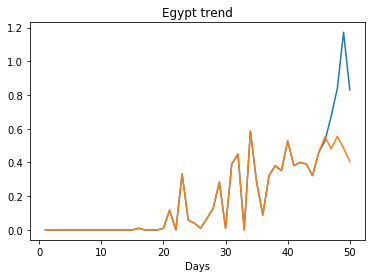

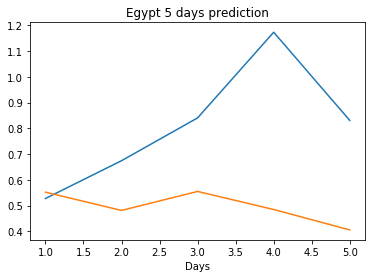

Creating directory ./offline6/United Arab Emirates/training/
United Arab Emirates
Saving the best model weights at Epoch [1], Best Valid Loss: 28.7814
Saving the best model weights at Epoch [2], Best Valid Loss: 20.9004


/space/home/nzhang/anaconda3/envs/neuralnet/lib/python3.7/site-packages/torch/nn/modules/loss.py:431: UserWarning: Using a target size (torch.Size([1, 1, 5])) that is different to the input size (torch.Size([5])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/space/home/nzhang/anaconda3/envs/neuralnet/lib/python3.7/site-packages/torch/nn/modules/loss.py:431: UserWarning: Using a target size (torch.Size([1, 5])) that is different to the input size (torch.Size([5])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Saving the best model weights at Epoch [3], Best Valid Loss: 19.4325
Saving the best model weights at Epoch [4], Best Valid Loss: 13.8692
train error: 0.18157987371687928
13.869158744812012
Saving the best model weights at Epoch [1], Best Valid Loss: 26.8385
Saving the best model weights at Epoch [2], Best Valid Loss: 17.6227
Saving the best model weights at Epoch [4], Best Valid Loss: 13.0993
Saving the best model weights at Epoch [11], Best Valid Loss: 12.8825
Saving the best model weights at Epoch [16], Best Valid Loss: 11.5871
train error: 0.30960024478695086
11.58708667755127
Saving the best model weights at Epoch [1], Best Valid Loss: 21.9356
Saving the best model weights at Epoch [5], Best Valid Loss: 13.1255
Saving the best model weights at Epoch [9], Best Valid Loss: 11.1607
Saving the best model weights at Epoch [10], Best Valid Loss: 11.1579
train error: 2.0519631291108746
11.157885551452637
Saving the best model weights at Epoch [1], Best Valid Loss: 20.0253
Saving the best

Saving the best model weights at Epoch [3], Best Valid Loss: 28.8259
Saving the best model weights at Epoch [4], Best Valid Loss: 27.8979
Saving the best model weights at Epoch [5], Best Valid Loss: 20.2172
Saving the best model weights at Epoch [6], Best Valid Loss: 16.2326
Saving the best model weights at Epoch [7], Best Valid Loss: 14.2921
Saving the best model weights at Epoch [9], Best Valid Loss: 13.7249
Saving the best model weights at Epoch [16], Best Valid Loss: 12.0733
Saving the best model weights at Epoch [20], Best Valid Loss: 12.0067
Saving the best model weights at Epoch [22], Best Valid Loss: 11.3566
Saving the best model weights at Epoch [24], Best Valid Loss: 10.1479
train error: 0.2574506736390533
10.147886276245117
Saving the best model weights at Epoch [1], Best Valid Loss: 30.9372
Saving the best model weights at Epoch [2], Best Valid Loss: 28.0173
Saving the best model weights at Epoch [3], Best Valid Loss: 18.0628
Saving the best model weights at Epoch [4], Best

train error: 2.272051549967258
12.76088809967041
Saving the best model weights at Epoch [1], Best Valid Loss: 28.6569
Saving the best model weights at Epoch [2], Best Valid Loss: 25.9450
Saving the best model weights at Epoch [11], Best Valid Loss: 24.3929
Saving the best model weights at Epoch [17], Best Valid Loss: 19.2584
Saving the best model weights at Epoch [18], Best Valid Loss: 16.2133
Saving the best model weights at Epoch [19], Best Valid Loss: 15.3889
Saving the best model weights at Epoch [20], Best Valid Loss: 14.0203
Saving the best model weights at Epoch [23], Best Valid Loss: 12.2931
Saving the best model weights at Epoch [40], Best Valid Loss: 10.5765
train error: 1.6083307763741863
10.576456069946289
Saving the best model weights at Epoch [1], Best Valid Loss: 48.2805
Saving the best model weights at Epoch [2], Best Valid Loss: 33.4281
Saving the best model weights at Epoch [4], Best Valid Loss: 30.7963
Saving the best model weights at Epoch [13], Best Valid Loss: 22.

Saving the best model weights at Epoch [2], Best Valid Loss: 31.2766
Saving the best model weights at Epoch [4], Best Valid Loss: 30.7497
Saving the best model weights at Epoch [6], Best Valid Loss: 28.1097
Saving the best model weights at Epoch [15], Best Valid Loss: 26.4415
train error: 5.335625352398042
26.441543579101562
Saving the best model weights at Epoch [1], Best Valid Loss: 35.8401
Saving the best model weights at Epoch [2], Best Valid Loss: 32.3957
Saving the best model weights at Epoch [4], Best Valid Loss: 28.1098
Saving the best model weights at Epoch [7], Best Valid Loss: 25.2371
Saving the best model weights at Epoch [13], Best Valid Loss: 24.9192
Saving the best model weights at Epoch [14], Best Valid Loss: 20.5246
Saving the best model weights at Epoch [17], Best Valid Loss: 20.2404
Saving the best model weights at Epoch [18], Best Valid Loss: 19.9183
train error: 5.5778629741361065
19.918262481689453
Saving the best model weights at Epoch [1], Best Valid Loss: 31.79

Saving the best model weights at Epoch [3], Best Valid Loss: 20.6780
Saving the best model weights at Epoch [4], Best Valid Loss: 16.0741
Saving the best model weights at Epoch [6], Best Valid Loss: 15.7055
Saving the best model weights at Epoch [7], Best Valid Loss: 14.4527
Saving the best model weights at Epoch [9], Best Valid Loss: 12.6596
Saving the best model weights at Epoch [10], Best Valid Loss: 11.4464
Saving the best model weights at Epoch [11], Best Valid Loss: 10.4615
train error: 0.1950880598967835
10.461492538452148
Saving the best model weights at Epoch [1], Best Valid Loss: 40.9801
Saving the best model weights at Epoch [2], Best Valid Loss: 38.2655
Saving the best model weights at Epoch [3], Best Valid Loss: 35.7049
Saving the best model weights at Epoch [4], Best Valid Loss: 33.0911
Saving the best model weights at Epoch [5], Best Valid Loss: 30.5394
Saving the best model weights at Epoch [6], Best Valid Loss: 28.0008
Saving the best model weights at Epoch [7], Best V

Saving the best model weights at Epoch [12], Best Valid Loss: 31.3274
Saving the best model weights at Epoch [13], Best Valid Loss: 31.0644
Saving the best model weights at Epoch [14], Best Valid Loss: 30.7858
Saving the best model weights at Epoch [15], Best Valid Loss: 30.5540
Saving the best model weights at Epoch [16], Best Valid Loss: 30.3508
Saving the best model weights at Epoch [17], Best Valid Loss: 30.1995
Saving the best model weights at Epoch [18], Best Valid Loss: 30.1014
Saving the best model weights at Epoch [19], Best Valid Loss: 29.9692
Saving the best model weights at Epoch [20], Best Valid Loss: 29.8403
Saving the best model weights at Epoch [21], Best Valid Loss: 29.7564
Saving the best model weights at Epoch [22], Best Valid Loss: 29.6796
Saving the best model weights at Epoch [23], Best Valid Loss: 29.5758
Saving the best model weights at Epoch [24], Best Valid Loss: 29.4476
Saving the best model weights at Epoch [25], Best Valid Loss: 29.4164
Saving the best mode

Saving the best model weights at Epoch [24], Best Valid Loss: 28.7652
Saving the best model weights at Epoch [25], Best Valid Loss: 28.6397
Saving the best model weights at Epoch [26], Best Valid Loss: 28.5039
Saving the best model weights at Epoch [27], Best Valid Loss: 28.3059
Saving the best model weights at Epoch [28], Best Valid Loss: 28.0722
Saving the best model weights at Epoch [29], Best Valid Loss: 27.8827
Saving the best model weights at Epoch [30], Best Valid Loss: 27.6165
Saving the best model weights at Epoch [31], Best Valid Loss: 27.3477
Saving the best model weights at Epoch [32], Best Valid Loss: 27.0521
Saving the best model weights at Epoch [33], Best Valid Loss: 26.7959
Saving the best model weights at Epoch [34], Best Valid Loss: 26.4374
Saving the best model weights at Epoch [35], Best Valid Loss: 26.0044
Saving the best model weights at Epoch [36], Best Valid Loss: 25.4519
Saving the best model weights at Epoch [37], Best Valid Loss: 24.9458
Saving the best mode

Saving the best model weights at Epoch [48], Best Valid Loss: 15.5469
Saving the best model weights at Epoch [49], Best Valid Loss: 14.8935
Saving the best model weights at Epoch [50], Best Valid Loss: 14.3138
train error: 2.870795273252072
14.31378173828125
Saving the best model weights at Epoch [1], Best Valid Loss: 40.2422
Saving the best model weights at Epoch [2], Best Valid Loss: 37.5692
Saving the best model weights at Epoch [3], Best Valid Loss: 35.7014
Saving the best model weights at Epoch [4], Best Valid Loss: 34.1759
Saving the best model weights at Epoch [5], Best Valid Loss: 32.9744
Saving the best model weights at Epoch [6], Best Valid Loss: 32.1232
Saving the best model weights at Epoch [7], Best Valid Loss: 31.4078
Saving the best model weights at Epoch [8], Best Valid Loss: 30.8332
Saving the best model weights at Epoch [9], Best Valid Loss: 30.5700
Saving the best model weights at Epoch [10], Best Valid Loss: 30.1899
Saving the best model weights at Epoch [11], Best 

train error: 2.048820086184048
13.904828071594238
Saving the best model weights at Epoch [1], Best Valid Loss: 32.8184
Saving the best model weights at Epoch [2], Best Valid Loss: 29.7758
Saving the best model weights at Epoch [3], Best Valid Loss: 27.2690
Saving the best model weights at Epoch [4], Best Valid Loss: 26.3135
Saving the best model weights at Epoch [5], Best Valid Loss: 22.1176
Saving the best model weights at Epoch [6], Best Valid Loss: 16.4378
Saving the best model weights at Epoch [7], Best Valid Loss: 13.5316
Saving the best model weights at Epoch [10], Best Valid Loss: 11.1882
Saving the best model weights at Epoch [19], Best Valid Loss: 9.7185
train error: 0.2987076811071846
9.718546867370605
Saving the best model weights at Epoch [1], Best Valid Loss: 41.4727
Saving the best model weights at Epoch [2], Best Valid Loss: 39.7163
Saving the best model weights at Epoch [3], Best Valid Loss: 38.2804
Saving the best model weights at Epoch [4], Best Valid Loss: 37.0162
Sa

Saving the best model weights at Epoch [32], Best Valid Loss: 29.8672
Saving the best model weights at Epoch [33], Best Valid Loss: 29.8618
Saving the best model weights at Epoch [34], Best Valid Loss: 29.8529
Saving the best model weights at Epoch [35], Best Valid Loss: 29.8368
Saving the best model weights at Epoch [36], Best Valid Loss: 29.8356
Saving the best model weights at Epoch [37], Best Valid Loss: 29.8071
Saving the best model weights at Epoch [38], Best Valid Loss: 29.8053
Saving the best model weights at Epoch [39], Best Valid Loss: 29.8029
Saving the best model weights at Epoch [48], Best Valid Loss: 29.7902
Saving the best model weights at Epoch [49], Best Valid Loss: 29.7731
train error: 5.123962135084214
29.773099899291992
Saving the best model weights at Epoch [1], Best Valid Loss: 40.3368
Saving the best model weights at Epoch [2], Best Valid Loss: 37.6130
Saving the best model weights at Epoch [3], Best Valid Loss: 35.6568
Saving the best model weights at Epoch [4],

Saving the best model weights at Epoch [5], Best Valid Loss: 35.7471
Saving the best model weights at Epoch [6], Best Valid Loss: 34.8181
Saving the best model weights at Epoch [7], Best Valid Loss: 34.0487
Saving the best model weights at Epoch [8], Best Valid Loss: 33.4294
Saving the best model weights at Epoch [9], Best Valid Loss: 32.8690
Saving the best model weights at Epoch [10], Best Valid Loss: 32.3657
Saving the best model weights at Epoch [11], Best Valid Loss: 31.9571
Saving the best model weights at Epoch [12], Best Valid Loss: 31.6793
Saving the best model weights at Epoch [13], Best Valid Loss: 31.4175
Saving the best model weights at Epoch [14], Best Valid Loss: 31.1658
Saving the best model weights at Epoch [15], Best Valid Loss: 30.9638
Saving the best model weights at Epoch [16], Best Valid Loss: 30.8149
Saving the best model weights at Epoch [17], Best Valid Loss: 30.6533
Saving the best model weights at Epoch [18], Best Valid Loss: 30.5673
Saving the best model wei

Saving the best model weights at Epoch [29], Best Valid Loss: 29.7515
Saving the best model weights at Epoch [30], Best Valid Loss: 29.7358
Saving the best model weights at Epoch [37], Best Valid Loss: 29.6894
Saving the best model weights at Epoch [38], Best Valid Loss: 29.6883
train error: 5.1356505347836405
29.688251495361328
Saving the best model weights at Epoch [1], Best Valid Loss: 34.3428
Saving the best model weights at Epoch [2], Best Valid Loss: 28.7317
Saving the best model weights at Epoch [19], Best Valid Loss: 28.5354
Saving the best model weights at Epoch [38], Best Valid Loss: 28.2159
train error: 5.259820926573969
28.21590232849121
Saving the best model weights at Epoch [1], Best Valid Loss: 41.2591
Saving the best model weights at Epoch [2], Best Valid Loss: 39.5129
Saving the best model weights at Epoch [3], Best Valid Loss: 38.0513
Saving the best model weights at Epoch [4], Best Valid Loss: 36.7963
Saving the best model weights at Epoch [5], Best Valid Loss: 35.73

Saving the best model weights at Epoch [11], Best Valid Loss: 30.2112
Saving the best model weights at Epoch [12], Best Valid Loss: 30.0140
Saving the best model weights at Epoch [13], Best Valid Loss: 29.8525
Saving the best model weights at Epoch [15], Best Valid Loss: 29.8227
Saving the best model weights at Epoch [16], Best Valid Loss: 29.7418
Saving the best model weights at Epoch [25], Best Valid Loss: 29.7140
Saving the best model weights at Epoch [27], Best Valid Loss: 29.6570
train error: 5.141282854541656
29.6569766998291
Saving the best model weights at Epoch [1], Best Valid Loss: 32.1353
Saving the best model weights at Epoch [2], Best Valid Loss: 28.9477
Saving the best model weights at Epoch [30], Best Valid Loss: 28.7128
train error: 5.174380625447919
28.712848663330078
Saving the best model weights at Epoch [1], Best Valid Loss: 41.5303
Saving the best model weights at Epoch [2], Best Valid Loss: 39.7420
Saving the best model weights at Epoch [3], Best Valid Loss: 38.21

Saving the best model weights at Epoch [4], Best Valid Loss: 34.1127
Saving the best model weights at Epoch [5], Best Valid Loss: 32.9857
Saving the best model weights at Epoch [6], Best Valid Loss: 32.2999
Saving the best model weights at Epoch [7], Best Valid Loss: 31.7298
Saving the best model weights at Epoch [8], Best Valid Loss: 31.2282
Saving the best model weights at Epoch [9], Best Valid Loss: 30.8305
Saving the best model weights at Epoch [10], Best Valid Loss: 30.5198
Saving the best model weights at Epoch [11], Best Valid Loss: 30.3023
Saving the best model weights at Epoch [12], Best Valid Loss: 30.2283
Saving the best model weights at Epoch [13], Best Valid Loss: 30.1617
Saving the best model weights at Epoch [15], Best Valid Loss: 30.0880
Saving the best model weights at Epoch [16], Best Valid Loss: 30.0515
Saving the best model weights at Epoch [18], Best Valid Loss: 29.9838
Saving the best model weights at Epoch [19], Best Valid Loss: 29.9001
Saving the best model weig

Saving the best model weights at Epoch [2], Best Valid Loss: 37.0688
Saving the best model weights at Epoch [3], Best Valid Loss: 35.1485
Saving the best model weights at Epoch [4], Best Valid Loss: 33.7758
Saving the best model weights at Epoch [5], Best Valid Loss: 32.7478
Saving the best model weights at Epoch [6], Best Valid Loss: 32.0345
Saving the best model weights at Epoch [7], Best Valid Loss: 31.5772
Saving the best model weights at Epoch [8], Best Valid Loss: 31.0866
Saving the best model weights at Epoch [9], Best Valid Loss: 30.7964
Saving the best model weights at Epoch [10], Best Valid Loss: 30.6705
Saving the best model weights at Epoch [11], Best Valid Loss: 30.4005
Saving the best model weights at Epoch [12], Best Valid Loss: 30.2475
Saving the best model weights at Epoch [14], Best Valid Loss: 30.1492
Saving the best model weights at Epoch [15], Best Valid Loss: 29.9165
Saving the best model weights at Epoch [18], Best Valid Loss: 29.8597
Saving the best model weight

Saving the best model weights at Epoch [42], Best Valid Loss: 34.1602
Saving the best model weights at Epoch [43], Best Valid Loss: 33.9851
Saving the best model weights at Epoch [44], Best Valid Loss: 33.8093
Saving the best model weights at Epoch [45], Best Valid Loss: 33.6287
Saving the best model weights at Epoch [46], Best Valid Loss: 33.4544
Saving the best model weights at Epoch [47], Best Valid Loss: 33.2814
Saving the best model weights at Epoch [48], Best Valid Loss: 33.1101
Saving the best model weights at Epoch [49], Best Valid Loss: 32.9406
Saving the best model weights at Epoch [50], Best Valid Loss: 32.7729
train error: 5.192820442780372
32.77287292480469
Saving the best model weights at Epoch [1], Best Valid Loss: 43.0183
Saving the best model weights at Epoch [2], Best Valid Loss: 42.6592
Saving the best model weights at Epoch [3], Best Valid Loss: 42.3084
Saving the best model weights at Epoch [4], Best Valid Loss: 41.9469
Saving the best model weights at Epoch [5], B

Saving the best model weights at Epoch [15], Best Valid Loss: 37.7834
Saving the best model weights at Epoch [16], Best Valid Loss: 37.5449
Saving the best model weights at Epoch [17], Best Valid Loss: 37.3089
Saving the best model weights at Epoch [18], Best Valid Loss: 37.0788
Saving the best model weights at Epoch [19], Best Valid Loss: 36.8404
Saving the best model weights at Epoch [20], Best Valid Loss: 36.6093
Saving the best model weights at Epoch [21], Best Valid Loss: 36.3791
Saving the best model weights at Epoch [22], Best Valid Loss: 36.1508
Saving the best model weights at Epoch [23], Best Valid Loss: 35.9229
Saving the best model weights at Epoch [24], Best Valid Loss: 35.6961
Saving the best model weights at Epoch [25], Best Valid Loss: 35.4700
Saving the best model weights at Epoch [26], Best Valid Loss: 35.2453
Saving the best model weights at Epoch [27], Best Valid Loss: 35.0210
Saving the best model weights at Epoch [28], Best Valid Loss: 34.7976
Saving the best mode

Saving the best model weights at Epoch [6], Best Valid Loss: 41.5468
Saving the best model weights at Epoch [7], Best Valid Loss: 41.2220
Saving the best model weights at Epoch [8], Best Valid Loss: 40.8925
Saving the best model weights at Epoch [9], Best Valid Loss: 40.5675
Saving the best model weights at Epoch [10], Best Valid Loss: 40.2432
Saving the best model weights at Epoch [11], Best Valid Loss: 39.9228
Saving the best model weights at Epoch [12], Best Valid Loss: 39.6055
Saving the best model weights at Epoch [13], Best Valid Loss: 39.2789
Saving the best model weights at Epoch [14], Best Valid Loss: 38.9561
Saving the best model weights at Epoch [15], Best Valid Loss: 38.6368
Saving the best model weights at Epoch [16], Best Valid Loss: 38.3178
Saving the best model weights at Epoch [17], Best Valid Loss: 37.9997
Saving the best model weights at Epoch [18], Best Valid Loss: 37.6831
Saving the best model weights at Epoch [19], Best Valid Loss: 37.3672
Saving the best model we

Saving the best model weights at Epoch [6], Best Valid Loss: 40.5489
Saving the best model weights at Epoch [7], Best Valid Loss: 40.1691
Saving the best model weights at Epoch [8], Best Valid Loss: 39.8002
Saving the best model weights at Epoch [9], Best Valid Loss: 39.4334
Saving the best model weights at Epoch [10], Best Valid Loss: 39.0697
Saving the best model weights at Epoch [11], Best Valid Loss: 38.7069
Saving the best model weights at Epoch [12], Best Valid Loss: 38.3458
Saving the best model weights at Epoch [13], Best Valid Loss: 37.9869
Saving the best model weights at Epoch [14], Best Valid Loss: 37.6303
Saving the best model weights at Epoch [15], Best Valid Loss: 37.2697
Saving the best model weights at Epoch [16], Best Valid Loss: 36.9122
Saving the best model weights at Epoch [17], Best Valid Loss: 36.5604
Saving the best model weights at Epoch [18], Best Valid Loss: 36.1986
Saving the best model weights at Epoch [19], Best Valid Loss: 35.8428
Saving the best model we

Saving the best model weights at Epoch [9], Best Valid Loss: 41.4836
Saving the best model weights at Epoch [10], Best Valid Loss: 41.2951
Saving the best model weights at Epoch [11], Best Valid Loss: 41.1093
Saving the best model weights at Epoch [12], Best Valid Loss: 40.9273
Saving the best model weights at Epoch [13], Best Valid Loss: 40.7470
Saving the best model weights at Epoch [14], Best Valid Loss: 40.5702
Saving the best model weights at Epoch [15], Best Valid Loss: 40.3966
Saving the best model weights at Epoch [16], Best Valid Loss: 40.2261
Saving the best model weights at Epoch [17], Best Valid Loss: 40.0580
Saving the best model weights at Epoch [18], Best Valid Loss: 39.8951
Saving the best model weights at Epoch [19], Best Valid Loss: 39.7299
Saving the best model weights at Epoch [20], Best Valid Loss: 39.5725
Saving the best model weights at Epoch [21], Best Valid Loss: 39.4128
Saving the best model weights at Epoch [22], Best Valid Loss: 39.2582
Saving the best model

Saving the best model weights at Epoch [30], Best Valid Loss: 29.4965
Saving the best model weights at Epoch [32], Best Valid Loss: 29.4550
Saving the best model weights at Epoch [33], Best Valid Loss: 29.4259
Saving the best model weights at Epoch [34], Best Valid Loss: 29.2884
Saving the best model weights at Epoch [36], Best Valid Loss: 29.0696
Saving the best model weights at Epoch [38], Best Valid Loss: 29.0445
Saving the best model weights at Epoch [41], Best Valid Loss: 28.8568
Saving the best model weights at Epoch [42], Best Valid Loss: 28.6980
Saving the best model weights at Epoch [44], Best Valid Loss: 28.4955
Saving the best model weights at Epoch [46], Best Valid Loss: 28.1519
Saving the best model weights at Epoch [47], Best Valid Loss: 28.1062
Saving the best model weights at Epoch [48], Best Valid Loss: 28.0733
Saving the best model weights at Epoch [49], Best Valid Loss: 27.5192
train error: 4.760278451827265
27.519163131713867
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [5], Best Valid Loss: 36.3663
Saving the best model weights at Epoch [6], Best Valid Loss: 35.5021
Saving the best model weights at Epoch [7], Best Valid Loss: 34.5985
Saving the best model weights at Epoch [8], Best Valid Loss: 33.8558
Saving the best model weights at Epoch [9], Best Valid Loss: 33.1733
Saving the best model weights at Epoch [10], Best Valid Loss: 32.6612
Saving the best model weights at Epoch [11], Best Valid Loss: 32.4071
Saving the best model weights at Epoch [12], Best Valid Loss: 31.8313
Saving the best model weights at Epoch [13], Best Valid Loss: 31.5424
Saving the best model weights at Epoch [14], Best Valid Loss: 31.2369
Saving the best model weights at Epoch [15], Best Valid Loss: 30.8516
Saving the best model weights at Epoch [16], Best Valid Loss: 30.6582
Saving the best model weights at Epoch [17], Best Valid Loss: 30.4096
Saving the best model weights at Epoch [18], Best Valid Loss: 30.2227
Saving the best model wei

Saving the best model weights at Epoch [25], Best Valid Loss: 36.4213
Saving the best model weights at Epoch [26], Best Valid Loss: 36.2112
Saving the best model weights at Epoch [27], Best Valid Loss: 35.9818
Saving the best model weights at Epoch [28], Best Valid Loss: 35.7931
Saving the best model weights at Epoch [29], Best Valid Loss: 35.6137
Saving the best model weights at Epoch [30], Best Valid Loss: 35.4044
Saving the best model weights at Epoch [31], Best Valid Loss: 35.2251
Saving the best model weights at Epoch [32], Best Valid Loss: 35.0466
Saving the best model weights at Epoch [33], Best Valid Loss: 34.8827
Saving the best model weights at Epoch [34], Best Valid Loss: 34.7056
Saving the best model weights at Epoch [35], Best Valid Loss: 34.5427
Saving the best model weights at Epoch [36], Best Valid Loss: 34.3842
Saving the best model weights at Epoch [37], Best Valid Loss: 34.2286
Saving the best model weights at Epoch [38], Best Valid Loss: 34.0742
Saving the best mode

Saving the best model weights at Epoch [45], Best Valid Loss: 36.0125
Saving the best model weights at Epoch [46], Best Valid Loss: 35.8978
Saving the best model weights at Epoch [47], Best Valid Loss: 35.7875
Saving the best model weights at Epoch [48], Best Valid Loss: 35.6785
Saving the best model weights at Epoch [49], Best Valid Loss: 35.5713
Saving the best model weights at Epoch [50], Best Valid Loss: 35.4664
train error: 5.4783929711388
35.4664421081543
Saving the best model weights at Epoch [1], Best Valid Loss: 42.8096
Saving the best model weights at Epoch [2], Best Valid Loss: 42.4055
Saving the best model weights at Epoch [3], Best Valid Loss: 42.0127
Saving the best model weights at Epoch [4], Best Valid Loss: 41.6403
Saving the best model weights at Epoch [5], Best Valid Loss: 41.2585
Saving the best model weights at Epoch [6], Best Valid Loss: 40.9181
Saving the best model weights at Epoch [7], Best Valid Loss: 40.5540
Saving the best model weights at Epoch [8], Best Va

Saving the best model weights at Epoch [14], Best Valid Loss: 40.5975
Saving the best model weights at Epoch [15], Best Valid Loss: 40.4279
Saving the best model weights at Epoch [16], Best Valid Loss: 40.2584
Saving the best model weights at Epoch [17], Best Valid Loss: 40.0912
Saving the best model weights at Epoch [18], Best Valid Loss: 39.9274
Saving the best model weights at Epoch [19], Best Valid Loss: 39.7671
Saving the best model weights at Epoch [20], Best Valid Loss: 39.6091
Saving the best model weights at Epoch [21], Best Valid Loss: 39.4544
Saving the best model weights at Epoch [22], Best Valid Loss: 39.3017
Saving the best model weights at Epoch [23], Best Valid Loss: 39.1545
Saving the best model weights at Epoch [24], Best Valid Loss: 39.0053
Saving the best model weights at Epoch [25], Best Valid Loss: 38.8605
Saving the best model weights at Epoch [26], Best Valid Loss: 38.7184
Saving the best model weights at Epoch [27], Best Valid Loss: 38.5780
Saving the best mode

train error: 5.109363673194762
29.594022750854492
Saving the best model weights at Epoch [1], Best Valid Loss: 42.5234
Saving the best model weights at Epoch [2], Best Valid Loss: 42.3069
Saving the best model weights at Epoch [3], Best Valid Loss: 42.0943
Saving the best model weights at Epoch [4], Best Valid Loss: 41.8848
Saving the best model weights at Epoch [5], Best Valid Loss: 41.6794
Saving the best model weights at Epoch [6], Best Valid Loss: 41.4779
Saving the best model weights at Epoch [7], Best Valid Loss: 41.2789
Saving the best model weights at Epoch [8], Best Valid Loss: 41.0845
Saving the best model weights at Epoch [9], Best Valid Loss: 40.8930
Saving the best model weights at Epoch [10], Best Valid Loss: 40.7050
Saving the best model weights at Epoch [11], Best Valid Loss: 40.5203
Saving the best model weights at Epoch [12], Best Valid Loss: 40.3412
Saving the best model weights at Epoch [13], Best Valid Loss: 40.1591
Saving the best model weights at Epoch [14], Best

Saving the best model weights at Epoch [18], Best Valid Loss: 30.7816
Saving the best model weights at Epoch [19], Best Valid Loss: 30.7129
Saving the best model weights at Epoch [20], Best Valid Loss: 30.6922
Saving the best model weights at Epoch [21], Best Valid Loss: 30.3938
Saving the best model weights at Epoch [22], Best Valid Loss: 30.3826
Saving the best model weights at Epoch [23], Best Valid Loss: 30.3538
Saving the best model weights at Epoch [24], Best Valid Loss: 30.1093
Saving the best model weights at Epoch [26], Best Valid Loss: 30.0319
Saving the best model weights at Epoch [28], Best Valid Loss: 29.9815
Saving the best model weights at Epoch [34], Best Valid Loss: 29.9168
Saving the best model weights at Epoch [36], Best Valid Loss: 29.8436
Saving the best model weights at Epoch [37], Best Valid Loss: 29.8350
Saving the best model weights at Epoch [40], Best Valid Loss: 29.7924
Saving the best model weights at Epoch [48], Best Valid Loss: 29.7794
train error: 5.11269

Saving the best model weights at Epoch [4], Best Valid Loss: 37.7890
Saving the best model weights at Epoch [5], Best Valid Loss: 36.4758
Saving the best model weights at Epoch [6], Best Valid Loss: 35.7366
Saving the best model weights at Epoch [7], Best Valid Loss: 34.8194
Saving the best model weights at Epoch [8], Best Valid Loss: 34.1545
Saving the best model weights at Epoch [9], Best Valid Loss: 33.4208
Saving the best model weights at Epoch [10], Best Valid Loss: 33.0710
Saving the best model weights at Epoch [11], Best Valid Loss: 32.6382
Saving the best model weights at Epoch [12], Best Valid Loss: 31.9551
Saving the best model weights at Epoch [14], Best Valid Loss: 31.4095
Saving the best model weights at Epoch [15], Best Valid Loss: 31.1004
Saving the best model weights at Epoch [17], Best Valid Loss: 30.7385
Saving the best model weights at Epoch [19], Best Valid Loss: 30.4198
Saving the best model weights at Epoch [21], Best Valid Loss: 30.3584
Saving the best model weig

Saving the best model weights at Epoch [44], Best Valid Loss: 33.4335
Saving the best model weights at Epoch [45], Best Valid Loss: 33.3338
Saving the best model weights at Epoch [46], Best Valid Loss: 33.2240
Saving the best model weights at Epoch [47], Best Valid Loss: 33.1271
Saving the best model weights at Epoch [48], Best Valid Loss: 33.0297
Saving the best model weights at Epoch [49], Best Valid Loss: 32.9371
Saving the best model weights at Epoch [50], Best Valid Loss: 32.8525
train error: 5.220284515811551
32.85247802734375
Saving the best model weights at Epoch [1], Best Valid Loss: 42.3717
Saving the best model weights at Epoch [2], Best Valid Loss: 40.4021
Saving the best model weights at Epoch [3], Best Valid Loss: 38.9115
Saving the best model weights at Epoch [4], Best Valid Loss: 37.6574
Saving the best model weights at Epoch [5], Best Valid Loss: 36.3649
Saving the best model weights at Epoch [6], Best Valid Loss: 35.6118
Saving the best model weights at Epoch [7], Bes

Saving the best model weights at Epoch [30], Best Valid Loss: 34.7640
Saving the best model weights at Epoch [31], Best Valid Loss: 34.6072
Saving the best model weights at Epoch [32], Best Valid Loss: 34.4580
Saving the best model weights at Epoch [33], Best Valid Loss: 34.3291
Saving the best model weights at Epoch [34], Best Valid Loss: 34.1937
Saving the best model weights at Epoch [35], Best Valid Loss: 34.0909
Saving the best model weights at Epoch [36], Best Valid Loss: 33.9330
Saving the best model weights at Epoch [37], Best Valid Loss: 33.8156
Saving the best model weights at Epoch [38], Best Valid Loss: 33.6898
Saving the best model weights at Epoch [39], Best Valid Loss: 33.5754
Saving the best model weights at Epoch [40], Best Valid Loss: 33.4837
Saving the best model weights at Epoch [41], Best Valid Loss: 33.3603
Saving the best model weights at Epoch [42], Best Valid Loss: 33.2550
Saving the best model weights at Epoch [43], Best Valid Loss: 33.1503
Saving the best mode

Saving the best model weights at Epoch [18], Best Valid Loss: 38.1654
Saving the best model weights at Epoch [19], Best Valid Loss: 37.9100
Saving the best model weights at Epoch [20], Best Valid Loss: 37.6729
Saving the best model weights at Epoch [21], Best Valid Loss: 37.4519
Saving the best model weights at Epoch [22], Best Valid Loss: 37.2337
Saving the best model weights at Epoch [23], Best Valid Loss: 37.0058
Saving the best model weights at Epoch [24], Best Valid Loss: 36.7938
Saving the best model weights at Epoch [25], Best Valid Loss: 36.6050
Saving the best model weights at Epoch [26], Best Valid Loss: 36.3926
Saving the best model weights at Epoch [27], Best Valid Loss: 36.2038
Saving the best model weights at Epoch [28], Best Valid Loss: 36.0205
Saving the best model weights at Epoch [29], Best Valid Loss: 35.8587
Saving the best model weights at Epoch [30], Best Valid Loss: 35.6594
Saving the best model weights at Epoch [31], Best Valid Loss: 35.4909
Saving the best mode

Saving the best model weights at Epoch [6], Best Valid Loss: 40.4995
Saving the best model weights at Epoch [7], Best Valid Loss: 40.1947
Saving the best model weights at Epoch [8], Best Valid Loss: 39.8919
Saving the best model weights at Epoch [9], Best Valid Loss: 39.6110
Saving the best model weights at Epoch [10], Best Valid Loss: 39.3200
Saving the best model weights at Epoch [11], Best Valid Loss: 39.0491
Saving the best model weights at Epoch [12], Best Valid Loss: 38.7814
Saving the best model weights at Epoch [13], Best Valid Loss: 38.5268
Saving the best model weights at Epoch [14], Best Valid Loss: 38.2794
Saving the best model weights at Epoch [15], Best Valid Loss: 38.0353
Saving the best model weights at Epoch [16], Best Valid Loss: 37.8155
Saving the best model weights at Epoch [17], Best Valid Loss: 37.5765
Saving the best model weights at Epoch [18], Best Valid Loss: 37.3566
Saving the best model weights at Epoch [19], Best Valid Loss: 37.1452
Saving the best model we

Saving the best model weights at Epoch [50], Best Valid Loss: 35.8055
train error: 5.520614952810349
35.80550003051758
Saving the best model weights at Epoch [1], Best Valid Loss: 43.6453
Saving the best model weights at Epoch [2], Best Valid Loss: 43.2216
Saving the best model weights at Epoch [3], Best Valid Loss: 42.8114
Saving the best model weights at Epoch [4], Best Valid Loss: 42.4178
Saving the best model weights at Epoch [5], Best Valid Loss: 42.0386
Saving the best model weights at Epoch [6], Best Valid Loss: 41.6842
Saving the best model weights at Epoch [7], Best Valid Loss: 41.3130
Saving the best model weights at Epoch [8], Best Valid Loss: 40.9652
Saving the best model weights at Epoch [9], Best Valid Loss: 40.6251
Saving the best model weights at Epoch [10], Best Valid Loss: 40.3094
Saving the best model weights at Epoch [11], Best Valid Loss: 39.9882
Saving the best model weights at Epoch [12], Best Valid Loss: 39.6890
Saving the best model weights at Epoch [13], Best 

Saving the best model weights at Epoch [38], Best Valid Loss: 35.7945
Saving the best model weights at Epoch [39], Best Valid Loss: 35.6960
Saving the best model weights at Epoch [40], Best Valid Loss: 35.5944
Saving the best model weights at Epoch [41], Best Valid Loss: 35.4992
Saving the best model weights at Epoch [42], Best Valid Loss: 35.4013
Saving the best model weights at Epoch [43], Best Valid Loss: 35.3074
Saving the best model weights at Epoch [44], Best Valid Loss: 35.2169
Saving the best model weights at Epoch [45], Best Valid Loss: 35.1229
Saving the best model weights at Epoch [46], Best Valid Loss: 35.0341
Saving the best model weights at Epoch [47], Best Valid Loss: 34.9466
Saving the best model weights at Epoch [48], Best Valid Loss: 34.8618
Saving the best model weights at Epoch [49], Best Valid Loss: 34.7752
Saving the best model weights at Epoch [50], Best Valid Loss: 34.6913
train error: 5.43409564706587
34.691261291503906
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [26], Best Valid Loss: 38.5599
Saving the best model weights at Epoch [27], Best Valid Loss: 38.4192
Saving the best model weights at Epoch [28], Best Valid Loss: 38.2762
Saving the best model weights at Epoch [29], Best Valid Loss: 38.1396
Saving the best model weights at Epoch [30], Best Valid Loss: 38.0020
Saving the best model weights at Epoch [31], Best Valid Loss: 37.8703
Saving the best model weights at Epoch [32], Best Valid Loss: 37.7364
Saving the best model weights at Epoch [33], Best Valid Loss: 37.6074
Saving the best model weights at Epoch [34], Best Valid Loss: 37.4798
Saving the best model weights at Epoch [35], Best Valid Loss: 37.3550
Saving the best model weights at Epoch [36], Best Valid Loss: 37.2325
Saving the best model weights at Epoch [37], Best Valid Loss: 37.1106
Saving the best model weights at Epoch [38], Best Valid Loss: 36.9912
Saving the best model weights at Epoch [39], Best Valid Loss: 36.8741
Saving the best mode

Saving the best model weights at Epoch [12], Best Valid Loss: 40.8169
Saving the best model weights at Epoch [13], Best Valid Loss: 40.6397
Saving the best model weights at Epoch [14], Best Valid Loss: 40.4617
Saving the best model weights at Epoch [15], Best Valid Loss: 40.2893
Saving the best model weights at Epoch [16], Best Valid Loss: 40.1191
Saving the best model weights at Epoch [17], Best Valid Loss: 39.9510
Saving the best model weights at Epoch [18], Best Valid Loss: 39.7860
Saving the best model weights at Epoch [19], Best Valid Loss: 39.6241
Saving the best model weights at Epoch [20], Best Valid Loss: 39.4651
Saving the best model weights at Epoch [21], Best Valid Loss: 39.3086
Saving the best model weights at Epoch [22], Best Valid Loss: 39.1562
Saving the best model weights at Epoch [23], Best Valid Loss: 39.0031
Saving the best model weights at Epoch [24], Best Valid Loss: 38.8539
Saving the best model weights at Epoch [25], Best Valid Loss: 38.7080
Saving the best mode

Saving the best model weights at Epoch [34], Best Valid Loss: 29.8772
Saving the best model weights at Epoch [36], Best Valid Loss: 29.7925
Saving the best model weights at Epoch [38], Best Valid Loss: 29.7806
Saving the best model weights at Epoch [41], Best Valid Loss: 29.7309
train error: 5.114871321185943
29.730926513671875
Saving the best model weights at Epoch [1], Best Valid Loss: 43.2021
Saving the best model weights at Epoch [2], Best Valid Loss: 42.9792
Saving the best model weights at Epoch [3], Best Valid Loss: 42.7594
Saving the best model weights at Epoch [4], Best Valid Loss: 42.5460
Saving the best model weights at Epoch [5], Best Valid Loss: 42.3333
Saving the best model weights at Epoch [6], Best Valid Loss: 42.1258
Saving the best model weights at Epoch [7], Best Valid Loss: 41.9237
Saving the best model weights at Epoch [8], Best Valid Loss: 41.7215
Saving the best model weights at Epoch [9], Best Valid Loss: 41.5252
Saving the best model weights at Epoch [10], Best

Saving the best model weights at Epoch [14], Best Valid Loss: 31.4632
Saving the best model weights at Epoch [15], Best Valid Loss: 31.1257
Saving the best model weights at Epoch [16], Best Valid Loss: 31.0060
Saving the best model weights at Epoch [17], Best Valid Loss: 30.7253
Saving the best model weights at Epoch [19], Best Valid Loss: 30.5043
Saving the best model weights at Epoch [21], Best Valid Loss: 30.2521
Saving the best model weights at Epoch [22], Best Valid Loss: 30.1122
Saving the best model weights at Epoch [24], Best Valid Loss: 29.9077
Saving the best model weights at Epoch [28], Best Valid Loss: 29.8302
Saving the best model weights at Epoch [30], Best Valid Loss: 29.7825
Saving the best model weights at Epoch [40], Best Valid Loss: 29.7178
train error: 5.118938455658574
29.717823028564453
Saving the best model weights at Epoch [1], Best Valid Loss: 44.2557
Saving the best model weights at Epoch [2], Best Valid Loss: 44.2206
Saving the best model weights at Epoch [3]

Saving the best model weights at Epoch [8], Best Valid Loss: 41.1529
Saving the best model weights at Epoch [9], Best Valid Loss: 40.9208
Saving the best model weights at Epoch [10], Best Valid Loss: 40.7317
Saving the best model weights at Epoch [11], Best Valid Loss: 40.5246
Saving the best model weights at Epoch [12], Best Valid Loss: 40.3456
Saving the best model weights at Epoch [13], Best Valid Loss: 40.1520
Saving the best model weights at Epoch [14], Best Valid Loss: 39.9949
Saving the best model weights at Epoch [15], Best Valid Loss: 39.7947
Saving the best model weights at Epoch [16], Best Valid Loss: 39.5853
Saving the best model weights at Epoch [17], Best Valid Loss: 39.4400
Saving the best model weights at Epoch [18], Best Valid Loss: 39.2529
Saving the best model weights at Epoch [19], Best Valid Loss: 39.0483
Saving the best model weights at Epoch [20], Best Valid Loss: 38.8853
Saving the best model weights at Epoch [21], Best Valid Loss: 38.6983
Saving the best model 

Saving the best model weights at Epoch [25], Best Valid Loss: 41.2058
Saving the best model weights at Epoch [26], Best Valid Loss: 41.1491
Saving the best model weights at Epoch [27], Best Valid Loss: 41.0932
Saving the best model weights at Epoch [28], Best Valid Loss: 41.0371
Saving the best model weights at Epoch [29], Best Valid Loss: 40.9824
Saving the best model weights at Epoch [30], Best Valid Loss: 40.9265
Saving the best model weights at Epoch [31], Best Valid Loss: 40.8710
Saving the best model weights at Epoch [32], Best Valid Loss: 40.8170
Saving the best model weights at Epoch [33], Best Valid Loss: 40.7639
Saving the best model weights at Epoch [34], Best Valid Loss: 40.7076
Saving the best model weights at Epoch [35], Best Valid Loss: 40.6520
Saving the best model weights at Epoch [36], Best Valid Loss: 40.5963
Saving the best model weights at Epoch [37], Best Valid Loss: 40.5454
Saving the best model weights at Epoch [38], Best Valid Loss: 40.4878
Saving the best mode

Saving the best model weights at Epoch [42], Best Valid Loss: 41.8709
Saving the best model weights at Epoch [43], Best Valid Loss: 41.8383
Saving the best model weights at Epoch [44], Best Valid Loss: 41.8061
Saving the best model weights at Epoch [45], Best Valid Loss: 41.7740
Saving the best model weights at Epoch [46], Best Valid Loss: 41.7420
Saving the best model weights at Epoch [47], Best Valid Loss: 41.7105
Saving the best model weights at Epoch [48], Best Valid Loss: 41.6780
Saving the best model weights at Epoch [49], Best Valid Loss: 41.6460
Saving the best model weights at Epoch [50], Best Valid Loss: 41.6141
train error: 6.6066640278985425
41.6141471862793
Saving the best model weights at Epoch [1], Best Valid Loss: 44.1338
Saving the best model weights at Epoch [2], Best Valid Loss: 44.0617
Saving the best model weights at Epoch [3], Best Valid Loss: 43.9891
Saving the best model weights at Epoch [4], Best Valid Loss: 43.9171
Saving the best model weights at Epoch [5], B

Saving the best model weights at Epoch [9], Best Valid Loss: 43.0988
Saving the best model weights at Epoch [10], Best Valid Loss: 43.0600
Saving the best model weights at Epoch [11], Best Valid Loss: 43.0215
Saving the best model weights at Epoch [12], Best Valid Loss: 42.9826
Saving the best model weights at Epoch [13], Best Valid Loss: 42.9440
Saving the best model weights at Epoch [14], Best Valid Loss: 42.9057
Saving the best model weights at Epoch [15], Best Valid Loss: 42.8676
Saving the best model weights at Epoch [16], Best Valid Loss: 42.8287
Saving the best model weights at Epoch [17], Best Valid Loss: 42.7904
Saving the best model weights at Epoch [18], Best Valid Loss: 42.7528
Saving the best model weights at Epoch [19], Best Valid Loss: 42.7140
Saving the best model weights at Epoch [20], Best Valid Loss: 42.6765
Saving the best model weights at Epoch [21], Best Valid Loss: 42.6378
Saving the best model weights at Epoch [22], Best Valid Loss: 42.5999
Saving the best model

Saving the best model weights at Epoch [26], Best Valid Loss: 34.4235
Saving the best model weights at Epoch [27], Best Valid Loss: 34.0914
Saving the best model weights at Epoch [28], Best Valid Loss: 33.7973
Saving the best model weights at Epoch [29], Best Valid Loss: 33.5248
Saving the best model weights at Epoch [30], Best Valid Loss: 33.1627
Saving the best model weights at Epoch [31], Best Valid Loss: 32.9305
Saving the best model weights at Epoch [32], Best Valid Loss: 32.5849
Saving the best model weights at Epoch [33], Best Valid Loss: 32.2723
Saving the best model weights at Epoch [34], Best Valid Loss: 31.9163
Saving the best model weights at Epoch [35], Best Valid Loss: 31.5839
Saving the best model weights at Epoch [36], Best Valid Loss: 31.3041
Saving the best model weights at Epoch [37], Best Valid Loss: 30.9985
Saving the best model weights at Epoch [38], Best Valid Loss: 30.7069
Saving the best model weights at Epoch [39], Best Valid Loss: 30.3754
Saving the best mode

Saving the best model weights at Epoch [43], Best Valid Loss: 43.3299
Saving the best model weights at Epoch [44], Best Valid Loss: 43.2907
Saving the best model weights at Epoch [45], Best Valid Loss: 43.2526
Saving the best model weights at Epoch [46], Best Valid Loss: 43.2145
Saving the best model weights at Epoch [47], Best Valid Loss: 43.1746
Saving the best model weights at Epoch [48], Best Valid Loss: 43.1343
Saving the best model weights at Epoch [49], Best Valid Loss: 43.0957
Saving the best model weights at Epoch [50], Best Valid Loss: 43.0577
train error: 6.791691481946938
43.05774688720703
Saving the best model weights at Epoch [1], Best Valid Loss: 45.4246
Saving the best model weights at Epoch [2], Best Valid Loss: 45.1718
Saving the best model weights at Epoch [3], Best Valid Loss: 44.9131
Saving the best model weights at Epoch [4], Best Valid Loss: 44.6897
Saving the best model weights at Epoch [5], Best Valid Loss: 44.4330
Saving the best model weights at Epoch [6], Be

Saving the best model weights at Epoch [10], Best Valid Loss: 44.0958
Saving the best model weights at Epoch [11], Best Valid Loss: 44.0513
Saving the best model weights at Epoch [12], Best Valid Loss: 44.0065
Saving the best model weights at Epoch [13], Best Valid Loss: 43.9620
Saving the best model weights at Epoch [14], Best Valid Loss: 43.9196
Saving the best model weights at Epoch [15], Best Valid Loss: 43.8738
Saving the best model weights at Epoch [16], Best Valid Loss: 43.8297
Saving the best model weights at Epoch [17], Best Valid Loss: 43.7865
Saving the best model weights at Epoch [18], Best Valid Loss: 43.7433
Saving the best model weights at Epoch [19], Best Valid Loss: 43.6991
Saving the best model weights at Epoch [20], Best Valid Loss: 43.6561
Saving the best model weights at Epoch [21], Best Valid Loss: 43.6150
Saving the best model weights at Epoch [22], Best Valid Loss: 43.5698
Saving the best model weights at Epoch [23], Best Valid Loss: 43.5269
Saving the best mode

Saving the best model weights at Epoch [27], Best Valid Loss: 43.0349
Saving the best model weights at Epoch [28], Best Valid Loss: 43.0118
Saving the best model weights at Epoch [29], Best Valid Loss: 42.9886
Saving the best model weights at Epoch [30], Best Valid Loss: 42.9655
Saving the best model weights at Epoch [31], Best Valid Loss: 42.9424
Saving the best model weights at Epoch [32], Best Valid Loss: 42.9194
Saving the best model weights at Epoch [33], Best Valid Loss: 42.8965
Saving the best model weights at Epoch [34], Best Valid Loss: 42.8736
Saving the best model weights at Epoch [35], Best Valid Loss: 42.8506
Saving the best model weights at Epoch [36], Best Valid Loss: 42.8281
Saving the best model weights at Epoch [37], Best Valid Loss: 42.8051
Saving the best model weights at Epoch [38], Best Valid Loss: 42.7822
Saving the best model weights at Epoch [39], Best Valid Loss: 42.7595
Saving the best model weights at Epoch [40], Best Valid Loss: 42.7369
Saving the best mode

Saving the best model weights at Epoch [44], Best Valid Loss: 36.8619
Saving the best model weights at Epoch [45], Best Valid Loss: 36.7629
Saving the best model weights at Epoch [46], Best Valid Loss: 36.6525
Saving the best model weights at Epoch [47], Best Valid Loss: 36.5629
Saving the best model weights at Epoch [48], Best Valid Loss: 36.4334
Saving the best model weights at Epoch [49], Best Valid Loss: 36.3274
Saving the best model weights at Epoch [50], Best Valid Loss: 36.2123
train error: 5.5776677660403715
36.212276458740234
Saving the best model weights at Epoch [1], Best Valid Loss: 43.4371
Saving the best model weights at Epoch [2], Best Valid Loss: 43.4136
Saving the best model weights at Epoch [3], Best Valid Loss: 43.3900
Saving the best model weights at Epoch [4], Best Valid Loss: 43.3667
Saving the best model weights at Epoch [5], Best Valid Loss: 43.3433
Saving the best model weights at Epoch [6], Best Valid Loss: 43.3196
Saving the best model weights at Epoch [7], B

Saving the best model weights at Epoch [11], Best Valid Loss: 41.3559
Saving the best model weights at Epoch [12], Best Valid Loss: 41.1933
Saving the best model weights at Epoch [13], Best Valid Loss: 41.0104
Saving the best model weights at Epoch [14], Best Valid Loss: 40.8549
Saving the best model weights at Epoch [15], Best Valid Loss: 40.6624
Saving the best model weights at Epoch [16], Best Valid Loss: 40.5134
Saving the best model weights at Epoch [17], Best Valid Loss: 40.3235
Saving the best model weights at Epoch [18], Best Valid Loss: 40.1487
Saving the best model weights at Epoch [19], Best Valid Loss: 40.0060
Saving the best model weights at Epoch [20], Best Valid Loss: 39.8481
Saving the best model weights at Epoch [21], Best Valid Loss: 39.6938
Saving the best model weights at Epoch [22], Best Valid Loss: 39.5386
Saving the best model weights at Epoch [23], Best Valid Loss: 39.3758
Saving the best model weights at Epoch [24], Best Valid Loss: 39.2262
Saving the best mode

Saving the best model weights at Epoch [27], Best Valid Loss: 42.7685
Saving the best model weights at Epoch [28], Best Valid Loss: 42.7312
Saving the best model weights at Epoch [29], Best Valid Loss: 42.6913
Saving the best model weights at Epoch [30], Best Valid Loss: 42.6498
Saving the best model weights at Epoch [31], Best Valid Loss: 42.6092
Saving the best model weights at Epoch [32], Best Valid Loss: 42.5714
Saving the best model weights at Epoch [33], Best Valid Loss: 42.5333
Saving the best model weights at Epoch [34], Best Valid Loss: 42.4923
Saving the best model weights at Epoch [35], Best Valid Loss: 42.4554
Saving the best model weights at Epoch [36], Best Valid Loss: 42.4140
Saving the best model weights at Epoch [37], Best Valid Loss: 42.3739
Saving the best model weights at Epoch [38], Best Valid Loss: 42.3375
Saving the best model weights at Epoch [39], Best Valid Loss: 42.2964
Saving the best model weights at Epoch [40], Best Valid Loss: 42.2579
Saving the best mode

Saving the best model weights at Epoch [45], Best Valid Loss: 42.2844
Saving the best model weights at Epoch [46], Best Valid Loss: 42.2635
Saving the best model weights at Epoch [47], Best Valid Loss: 42.2425
Saving the best model weights at Epoch [48], Best Valid Loss: 42.2216
Saving the best model weights at Epoch [49], Best Valid Loss: 42.2008
Saving the best model weights at Epoch [50], Best Valid Loss: 42.1800
train error: 6.620352909930291
42.179988861083984
Saving the best model weights at Epoch [1], Best Valid Loss: 43.6116
Saving the best model weights at Epoch [2], Best Valid Loss: 43.5699
Saving the best model weights at Epoch [3], Best Valid Loss: 43.5284
Saving the best model weights at Epoch [4], Best Valid Loss: 43.4871
Saving the best model weights at Epoch [5], Best Valid Loss: 43.4452
Saving the best model weights at Epoch [6], Best Valid Loss: 43.4063
Saving the best model weights at Epoch [7], Best Valid Loss: 43.3642
Saving the best model weights at Epoch [8], Bes

Saving the best model weights at Epoch [12], Best Valid Loss: 43.7180
Saving the best model weights at Epoch [13], Best Valid Loss: 43.6944
Saving the best model weights at Epoch [14], Best Valid Loss: 43.6710
Saving the best model weights at Epoch [15], Best Valid Loss: 43.6472
Saving the best model weights at Epoch [16], Best Valid Loss: 43.6236
Saving the best model weights at Epoch [17], Best Valid Loss: 43.6001
Saving the best model weights at Epoch [18], Best Valid Loss: 43.5767
Saving the best model weights at Epoch [19], Best Valid Loss: 43.5533
Saving the best model weights at Epoch [20], Best Valid Loss: 43.5302
Saving the best model weights at Epoch [21], Best Valid Loss: 43.5066
Saving the best model weights at Epoch [22], Best Valid Loss: 43.4833
Saving the best model weights at Epoch [23], Best Valid Loss: 43.4601
Saving the best model weights at Epoch [24], Best Valid Loss: 43.4369
Saving the best model weights at Epoch [25], Best Valid Loss: 43.4138
Saving the best mode

Saving the best model weights at Epoch [28], Best Valid Loss: 38.7655
Saving the best model weights at Epoch [29], Best Valid Loss: 38.6240
Saving the best model weights at Epoch [30], Best Valid Loss: 38.4948
Saving the best model weights at Epoch [31], Best Valid Loss: 38.3801
Saving the best model weights at Epoch [32], Best Valid Loss: 38.2267
Saving the best model weights at Epoch [33], Best Valid Loss: 38.1171
Saving the best model weights at Epoch [34], Best Valid Loss: 37.9943
Saving the best model weights at Epoch [35], Best Valid Loss: 37.8580
Saving the best model weights at Epoch [36], Best Valid Loss: 37.7550
Saving the best model weights at Epoch [37], Best Valid Loss: 37.6318
Saving the best model weights at Epoch [38], Best Valid Loss: 37.5307
Saving the best model weights at Epoch [39], Best Valid Loss: 37.4155
Saving the best model weights at Epoch [40], Best Valid Loss: 37.2912
Saving the best model weights at Epoch [41], Best Valid Loss: 37.1961
Saving the best mode

Saving the best model weights at Epoch [44], Best Valid Loss: 41.7646
Saving the best model weights at Epoch [45], Best Valid Loss: 41.7273
Saving the best model weights at Epoch [46], Best Valid Loss: 41.6937
Saving the best model weights at Epoch [47], Best Valid Loss: 41.6554
Saving the best model weights at Epoch [48], Best Valid Loss: 41.6218
Saving the best model weights at Epoch [49], Best Valid Loss: 41.5840
Saving the best model weights at Epoch [50], Best Valid Loss: 41.5489
train error: 6.520077418055265
41.54888916015625
Saving the best model weights at Epoch [1], Best Valid Loss: 43.9035
Saving the best model weights at Epoch [2], Best Valid Loss: 43.6884
Saving the best model weights at Epoch [3], Best Valid Loss: 43.4936
Saving the best model weights at Epoch [4], Best Valid Loss: 43.2809
Saving the best model weights at Epoch [5], Best Valid Loss: 43.0714
Saving the best model weights at Epoch [6], Best Valid Loss: 42.8727
Saving the best model weights at Epoch [7], Bes

Saving the best model weights at Epoch [10], Best Valid Loss: 42.4634
Saving the best model weights at Epoch [11], Best Valid Loss: 42.4254
Saving the best model weights at Epoch [12], Best Valid Loss: 42.3876
Saving the best model weights at Epoch [13], Best Valid Loss: 42.3500
Saving the best model weights at Epoch [14], Best Valid Loss: 42.3130
Saving the best model weights at Epoch [15], Best Valid Loss: 42.2762
Saving the best model weights at Epoch [16], Best Valid Loss: 42.2388
Saving the best model weights at Epoch [17], Best Valid Loss: 42.2009
Saving the best model weights at Epoch [18], Best Valid Loss: 42.1640
Saving the best model weights at Epoch [19], Best Valid Loss: 42.1292
Saving the best model weights at Epoch [20], Best Valid Loss: 42.0902
Saving the best model weights at Epoch [21], Best Valid Loss: 42.0545
Saving the best model weights at Epoch [22], Best Valid Loss: 42.0171
Saving the best model weights at Epoch [23], Best Valid Loss: 41.9809
Saving the best mode

Saving the best model weights at Epoch [26], Best Valid Loss: 41.7570
Saving the best model weights at Epoch [27], Best Valid Loss: 41.7374
Saving the best model weights at Epoch [28], Best Valid Loss: 41.7179
Saving the best model weights at Epoch [29], Best Valid Loss: 41.6984
Saving the best model weights at Epoch [30], Best Valid Loss: 41.6786
Saving the best model weights at Epoch [31], Best Valid Loss: 41.6592
Saving the best model weights at Epoch [32], Best Valid Loss: 41.6397
Saving the best model weights at Epoch [33], Best Valid Loss: 41.6203
Saving the best model weights at Epoch [34], Best Valid Loss: 41.6009
Saving the best model weights at Epoch [35], Best Valid Loss: 41.5815
Saving the best model weights at Epoch [36], Best Valid Loss: 41.5622
Saving the best model weights at Epoch [37], Best Valid Loss: 41.5430
Saving the best model weights at Epoch [38], Best Valid Loss: 41.5237
Saving the best model weights at Epoch [39], Best Valid Loss: 41.5046
Saving the best mode

Saving the best model weights at Epoch [43], Best Valid Loss: 37.2752
Saving the best model weights at Epoch [44], Best Valid Loss: 37.1697
Saving the best model weights at Epoch [45], Best Valid Loss: 37.0237
Saving the best model weights at Epoch [46], Best Valid Loss: 36.9310
Saving the best model weights at Epoch [47], Best Valid Loss: 36.8462
Saving the best model weights at Epoch [48], Best Valid Loss: 36.7205
Saving the best model weights at Epoch [49], Best Valid Loss: 36.6165
Saving the best model weights at Epoch [50], Best Valid Loss: 36.5099
train error: 5.620868158917273
36.50990676879883
Saving the best model weights at Epoch [1], Best Valid Loss: 43.0358
Saving the best model weights at Epoch [2], Best Valid Loss: 43.0136
Saving the best model weights at Epoch [3], Best Valid Loss: 42.9912
Saving the best model weights at Epoch [4], Best Valid Loss: 42.9690
Saving the best model weights at Epoch [5], Best Valid Loss: 42.9468
Saving the best model weights at Epoch [6], Be

Saving the best model weights at Epoch [10], Best Valid Loss: 41.7054
Saving the best model weights at Epoch [11], Best Valid Loss: 41.5244
Saving the best model weights at Epoch [12], Best Valid Loss: 41.3598
Saving the best model weights at Epoch [13], Best Valid Loss: 41.1735
Saving the best model weights at Epoch [14], Best Valid Loss: 41.0074
Saving the best model weights at Epoch [15], Best Valid Loss: 40.8345
Saving the best model weights at Epoch [16], Best Valid Loss: 40.6820
Saving the best model weights at Epoch [17], Best Valid Loss: 40.5276
Saving the best model weights at Epoch [18], Best Valid Loss: 40.3387
Saving the best model weights at Epoch [19], Best Valid Loss: 40.2033
Saving the best model weights at Epoch [20], Best Valid Loss: 40.0529
Saving the best model weights at Epoch [21], Best Valid Loss: 39.9009
Saving the best model weights at Epoch [22], Best Valid Loss: 39.7274
Saving the best model weights at Epoch [23], Best Valid Loss: 39.5924
Saving the best mode

Saving the best model weights at Epoch [26], Best Valid Loss: 42.3964
Saving the best model weights at Epoch [27], Best Valid Loss: 42.3580
Saving the best model weights at Epoch [28], Best Valid Loss: 42.3214
Saving the best model weights at Epoch [29], Best Valid Loss: 42.2829
Saving the best model weights at Epoch [30], Best Valid Loss: 42.2465
Saving the best model weights at Epoch [31], Best Valid Loss: 42.2109
Saving the best model weights at Epoch [32], Best Valid Loss: 42.1732
Saving the best model weights at Epoch [33], Best Valid Loss: 42.1348
Saving the best model weights at Epoch [34], Best Valid Loss: 42.0995
Saving the best model weights at Epoch [35], Best Valid Loss: 42.0620
Saving the best model weights at Epoch [36], Best Valid Loss: 42.0237
Saving the best model weights at Epoch [37], Best Valid Loss: 41.9884
Saving the best model weights at Epoch [38], Best Valid Loss: 41.9512
Saving the best model weights at Epoch [39], Best Valid Loss: 41.9178
Saving the best mode

Saving the best model weights at Epoch [43], Best Valid Loss: 42.0784
Saving the best model weights at Epoch [44], Best Valid Loss: 42.0582
Saving the best model weights at Epoch [45], Best Valid Loss: 42.0379
Saving the best model weights at Epoch [46], Best Valid Loss: 42.0178
Saving the best model weights at Epoch [47], Best Valid Loss: 41.9977
Saving the best model weights at Epoch [48], Best Valid Loss: 41.9776
Saving the best model weights at Epoch [49], Best Valid Loss: 41.9576
Saving the best model weights at Epoch [50], Best Valid Loss: 41.9376
train error: 6.6163360394176935
41.9376106262207
Saving the best model weights at Epoch [1], Best Valid Loss: 42.3351
Saving the best model weights at Epoch [2], Best Valid Loss: 42.2971
Saving the best model weights at Epoch [3], Best Valid Loss: 42.2601
Saving the best model weights at Epoch [4], Best Valid Loss: 42.2226
Saving the best model weights at Epoch [5], Best Valid Loss: 42.1864
Saving the best model weights at Epoch [6], Be

Saving the best model weights at Epoch [9], Best Valid Loss: 43.0387
Saving the best model weights at Epoch [10], Best Valid Loss: 43.0162
Saving the best model weights at Epoch [11], Best Valid Loss: 42.9936
Saving the best model weights at Epoch [12], Best Valid Loss: 42.9712
Saving the best model weights at Epoch [13], Best Valid Loss: 42.9487
Saving the best model weights at Epoch [14], Best Valid Loss: 42.9263
Saving the best model weights at Epoch [15], Best Valid Loss: 42.9041
Saving the best model weights at Epoch [16], Best Valid Loss: 42.8816
Saving the best model weights at Epoch [17], Best Valid Loss: 42.8595
Saving the best model weights at Epoch [18], Best Valid Loss: 42.8372
Saving the best model weights at Epoch [19], Best Valid Loss: 42.8148
Saving the best model weights at Epoch [20], Best Valid Loss: 42.7926
Saving the best model weights at Epoch [21], Best Valid Loss: 42.7705
Saving the best model weights at Epoch [22], Best Valid Loss: 42.7485
Saving the best model

Saving the best model weights at Epoch [25], Best Valid Loss: 39.7724
Saving the best model weights at Epoch [26], Best Valid Loss: 39.6395
Saving the best model weights at Epoch [27], Best Valid Loss: 39.4737
Saving the best model weights at Epoch [28], Best Valid Loss: 39.3314
Saving the best model weights at Epoch [29], Best Valid Loss: 39.1900
Saving the best model weights at Epoch [30], Best Valid Loss: 39.0646
Saving the best model weights at Epoch [31], Best Valid Loss: 38.9463
Saving the best model weights at Epoch [32], Best Valid Loss: 38.7775
Saving the best model weights at Epoch [33], Best Valid Loss: 38.6565
Saving the best model weights at Epoch [34], Best Valid Loss: 38.5302
Saving the best model weights at Epoch [35], Best Valid Loss: 38.3951
Saving the best model weights at Epoch [36], Best Valid Loss: 38.2912
Saving the best model weights at Epoch [37], Best Valid Loss: 38.1507
Saving the best model weights at Epoch [38], Best Valid Loss: 38.0387
Saving the best mode

Saving the best model weights at Epoch [41], Best Valid Loss: 42.1808
Saving the best model weights at Epoch [42], Best Valid Loss: 42.1416
Saving the best model weights at Epoch [43], Best Valid Loss: 42.1030
Saving the best model weights at Epoch [44], Best Valid Loss: 42.0669
Saving the best model weights at Epoch [45], Best Valid Loss: 42.0288
Saving the best model weights at Epoch [46], Best Valid Loss: 41.9915
Saving the best model weights at Epoch [47], Best Valid Loss: 41.9575
Saving the best model weights at Epoch [48], Best Valid Loss: 41.9189
Saving the best model weights at Epoch [49], Best Valid Loss: 41.8817
Saving the best model weights at Epoch [50], Best Valid Loss: 41.8446
train error: 6.658144685409723
41.84455490112305
Saving the best model weights at Epoch [1], Best Valid Loss: 42.8238
Saving the best model weights at Epoch [2], Best Valid Loss: 42.6364
Saving the best model weights at Epoch [3], Best Valid Loss: 42.4285
Saving the best model weights at Epoch [4], 

Saving the best model weights at Epoch [7], Best Valid Loss: 43.1058
Saving the best model weights at Epoch [8], Best Valid Loss: 43.0661
Saving the best model weights at Epoch [9], Best Valid Loss: 43.0273
Saving the best model weights at Epoch [10], Best Valid Loss: 42.9850
Saving the best model weights at Epoch [11], Best Valid Loss: 42.9447
Saving the best model weights at Epoch [12], Best Valid Loss: 42.9075
Saving the best model weights at Epoch [13], Best Valid Loss: 42.8653
Saving the best model weights at Epoch [14], Best Valid Loss: 42.8259
Saving the best model weights at Epoch [15], Best Valid Loss: 42.7886
Saving the best model weights at Epoch [16], Best Valid Loss: 42.7481
Saving the best model weights at Epoch [17], Best Valid Loss: 42.7083
Saving the best model weights at Epoch [18], Best Valid Loss: 42.6708
Saving the best model weights at Epoch [19], Best Valid Loss: 42.6320
Saving the best model weights at Epoch [20], Best Valid Loss: 42.5925
Saving the best model w

Saving the best model weights at Epoch [25], Best Valid Loss: 45.6363
Saving the best model weights at Epoch [26], Best Valid Loss: 45.6327
Saving the best model weights at Epoch [27], Best Valid Loss: 45.6293
Saving the best model weights at Epoch [28], Best Valid Loss: 45.6258
Saving the best model weights at Epoch [29], Best Valid Loss: 45.6224
Saving the best model weights at Epoch [30], Best Valid Loss: 45.6189
Saving the best model weights at Epoch [31], Best Valid Loss: 45.6155
Saving the best model weights at Epoch [32], Best Valid Loss: 45.6120
Saving the best model weights at Epoch [33], Best Valid Loss: 45.6085
Saving the best model weights at Epoch [34], Best Valid Loss: 45.6051
Saving the best model weights at Epoch [35], Best Valid Loss: 45.6016
Saving the best model weights at Epoch [36], Best Valid Loss: 45.5982
Saving the best model weights at Epoch [37], Best Valid Loss: 45.5947
Saving the best model weights at Epoch [38], Best Valid Loss: 45.5912
Saving the best mode

Saving the best model weights at Epoch [42], Best Valid Loss: 41.7928
Saving the best model weights at Epoch [43], Best Valid Loss: 41.7681
Saving the best model weights at Epoch [44], Best Valid Loss: 41.7428
Saving the best model weights at Epoch [45], Best Valid Loss: 41.7215
Saving the best model weights at Epoch [46], Best Valid Loss: 41.6977
Saving the best model weights at Epoch [47], Best Valid Loss: 41.6754
Saving the best model weights at Epoch [48], Best Valid Loss: 41.6501
Saving the best model weights at Epoch [49], Best Valid Loss: 41.6277
Saving the best model weights at Epoch [50], Best Valid Loss: 41.6003
train error: 6.782096375861475
41.600341796875
Saving the best model weights at Epoch [1], Best Valid Loss: 44.2314
Saving the best model weights at Epoch [2], Best Valid Loss: 44.2277
Saving the best model weights at Epoch [3], Best Valid Loss: 44.2240
Saving the best model weights at Epoch [4], Best Valid Loss: 44.2203
Saving the best model weights at Epoch [5], Bes

Saving the best model weights at Epoch [11], Best Valid Loss: 43.3274
Saving the best model weights at Epoch [12], Best Valid Loss: 43.3004
Saving the best model weights at Epoch [13], Best Valid Loss: 43.2759
Saving the best model weights at Epoch [14], Best Valid Loss: 43.2484
Saving the best model weights at Epoch [15], Best Valid Loss: 43.2218
Saving the best model weights at Epoch [16], Best Valid Loss: 43.1959
Saving the best model weights at Epoch [17], Best Valid Loss: 43.1693
Saving the best model weights at Epoch [18], Best Valid Loss: 43.1458
Saving the best model weights at Epoch [19], Best Valid Loss: 43.1168
Saving the best model weights at Epoch [20], Best Valid Loss: 43.0940
Saving the best model weights at Epoch [21], Best Valid Loss: 43.0675
Saving the best model weights at Epoch [22], Best Valid Loss: 43.0409
Saving the best model weights at Epoch [23], Best Valid Loss: 43.0153
Saving the best model weights at Epoch [24], Best Valid Loss: 42.9931
Saving the best mode

Saving the best model weights at Epoch [29], Best Valid Loss: 42.3932
Saving the best model weights at Epoch [30], Best Valid Loss: 42.3867
Saving the best model weights at Epoch [31], Best Valid Loss: 42.3796
Saving the best model weights at Epoch [32], Best Valid Loss: 42.3728
Saving the best model weights at Epoch [33], Best Valid Loss: 42.3664
Saving the best model weights at Epoch [34], Best Valid Loss: 42.3600
Saving the best model weights at Epoch [35], Best Valid Loss: 42.3531
Saving the best model weights at Epoch [36], Best Valid Loss: 42.3464
Saving the best model weights at Epoch [37], Best Valid Loss: 42.3397
Saving the best model weights at Epoch [38], Best Valid Loss: 42.3331
Saving the best model weights at Epoch [39], Best Valid Loss: 42.3265
Saving the best model weights at Epoch [40], Best Valid Loss: 42.3206
Saving the best model weights at Epoch [41], Best Valid Loss: 42.3133
Saving the best model weights at Epoch [42], Best Valid Loss: 42.3066
Saving the best mode

Saving the best model weights at Epoch [47], Best Valid Loss: 42.5584
Saving the best model weights at Epoch [48], Best Valid Loss: 42.5542
Saving the best model weights at Epoch [49], Best Valid Loss: 42.5500
Saving the best model weights at Epoch [50], Best Valid Loss: 42.5458
train error: 6.853996295241579
42.545753479003906
Saving the best model weights at Epoch [1], Best Valid Loss: 42.8738
Saving the best model weights at Epoch [2], Best Valid Loss: 42.8665
Saving the best model weights at Epoch [3], Best Valid Loss: 42.8597
Saving the best model weights at Epoch [4], Best Valid Loss: 42.8517
Saving the best model weights at Epoch [5], Best Valid Loss: 42.8444
Saving the best model weights at Epoch [6], Best Valid Loss: 42.8372
Saving the best model weights at Epoch [7], Best Valid Loss: 42.8300
Saving the best model weights at Epoch [8], Best Valid Loss: 42.8225
Saving the best model weights at Epoch [9], Best Valid Loss: 42.8153
Saving the best model weights at Epoch [10], Best

Saving the best model weights at Epoch [14], Best Valid Loss: 46.1338
Saving the best model weights at Epoch [15], Best Valid Loss: 46.1309
Saving the best model weights at Epoch [16], Best Valid Loss: 46.1281
Saving the best model weights at Epoch [17], Best Valid Loss: 46.1252
Saving the best model weights at Epoch [18], Best Valid Loss: 46.1223
Saving the best model weights at Epoch [19], Best Valid Loss: 46.1195
Saving the best model weights at Epoch [20], Best Valid Loss: 46.1166
Saving the best model weights at Epoch [21], Best Valid Loss: 46.1138
Saving the best model weights at Epoch [22], Best Valid Loss: 46.1109
Saving the best model weights at Epoch [23], Best Valid Loss: 46.1080
Saving the best model weights at Epoch [24], Best Valid Loss: 46.1052
Saving the best model weights at Epoch [25], Best Valid Loss: 46.1023
Saving the best model weights at Epoch [26], Best Valid Loss: 46.0994
Saving the best model weights at Epoch [27], Best Valid Loss: 46.0966
Saving the best mode

Saving the best model weights at Epoch [31], Best Valid Loss: 41.9163
Saving the best model weights at Epoch [32], Best Valid Loss: 41.8962
Saving the best model weights at Epoch [33], Best Valid Loss: 41.8800
Saving the best model weights at Epoch [34], Best Valid Loss: 41.8592
Saving the best model weights at Epoch [35], Best Valid Loss: 41.8420
Saving the best model weights at Epoch [36], Best Valid Loss: 41.8236
Saving the best model weights at Epoch [37], Best Valid Loss: 41.8030
Saving the best model weights at Epoch [38], Best Valid Loss: 41.7870
Saving the best model weights at Epoch [39], Best Valid Loss: 41.7688
Saving the best model weights at Epoch [40], Best Valid Loss: 41.7490
Saving the best model weights at Epoch [41], Best Valid Loss: 41.7316
Saving the best model weights at Epoch [42], Best Valid Loss: 41.7141
Saving the best model weights at Epoch [43], Best Valid Loss: 41.6937
Saving the best model weights at Epoch [44], Best Valid Loss: 41.6782
Saving the best mode

Saving the best model weights at Epoch [48], Best Valid Loss: 44.4671
Saving the best model weights at Epoch [49], Best Valid Loss: 44.4625
Saving the best model weights at Epoch [50], Best Valid Loss: 44.4583
train error: 7.0693345915886665
44.458282470703125
Saving the best model weights at Epoch [1], Best Valid Loss: 43.3664
Saving the best model weights at Epoch [2], Best Valid Loss: 43.3468
Saving the best model weights at Epoch [3], Best Valid Loss: 43.3256
Saving the best model weights at Epoch [4], Best Valid Loss: 43.3053
Saving the best model weights at Epoch [5], Best Valid Loss: 43.2846
Saving the best model weights at Epoch [6], Best Valid Loss: 43.2632
Saving the best model weights at Epoch [7], Best Valid Loss: 43.2419
Saving the best model weights at Epoch [8], Best Valid Loss: 43.2205
Saving the best model weights at Epoch [9], Best Valid Loss: 43.1982
Saving the best model weights at Epoch [10], Best Valid Loss: 43.1781
Saving the best model weights at Epoch [11], Bes

Saving the best model weights at Epoch [15], Best Valid Loss: 43.8489
Saving the best model weights at Epoch [16], Best Valid Loss: 43.8449
Saving the best model weights at Epoch [17], Best Valid Loss: 43.8405
Saving the best model weights at Epoch [18], Best Valid Loss: 43.8361
Saving the best model weights at Epoch [19], Best Valid Loss: 43.8315
Saving the best model weights at Epoch [20], Best Valid Loss: 43.8272
Saving the best model weights at Epoch [21], Best Valid Loss: 43.8231
Saving the best model weights at Epoch [22], Best Valid Loss: 43.8185
Saving the best model weights at Epoch [23], Best Valid Loss: 43.8141
Saving the best model weights at Epoch [24], Best Valid Loss: 43.8099
Saving the best model weights at Epoch [25], Best Valid Loss: 43.8055
Saving the best model weights at Epoch [26], Best Valid Loss: 43.8011
Saving the best model weights at Epoch [27], Best Valid Loss: 43.7969
Saving the best model weights at Epoch [28], Best Valid Loss: 43.7925
Saving the best mode

Saving the best model weights at Epoch [32], Best Valid Loss: 43.4328
Saving the best model weights at Epoch [33], Best Valid Loss: 43.4304
Saving the best model weights at Epoch [34], Best Valid Loss: 43.4281
Saving the best model weights at Epoch [35], Best Valid Loss: 43.4257
Saving the best model weights at Epoch [36], Best Valid Loss: 43.4233
Saving the best model weights at Epoch [37], Best Valid Loss: 43.4210
Saving the best model weights at Epoch [38], Best Valid Loss: 43.4186
Saving the best model weights at Epoch [39], Best Valid Loss: 43.4163
Saving the best model weights at Epoch [40], Best Valid Loss: 43.4139
Saving the best model weights at Epoch [41], Best Valid Loss: 43.4116
Saving the best model weights at Epoch [42], Best Valid Loss: 43.4092
Saving the best model weights at Epoch [43], Best Valid Loss: 43.4068
Saving the best model weights at Epoch [44], Best Valid Loss: 43.4045
Saving the best model weights at Epoch [45], Best Valid Loss: 43.4021
Saving the best mode

Saving the best model weights at Epoch [49], Best Valid Loss: 42.1023
Saving the best model weights at Epoch [50], Best Valid Loss: 42.0826
train error: 6.690762324919624
42.082576751708984
Saving the best model weights at Epoch [1], Best Valid Loss: 41.7887
Saving the best model weights at Epoch [2], Best Valid Loss: 41.7868
Saving the best model weights at Epoch [3], Best Valid Loss: 41.7848
Saving the best model weights at Epoch [4], Best Valid Loss: 41.7829
Saving the best model weights at Epoch [5], Best Valid Loss: 41.7810
Saving the best model weights at Epoch [6], Best Valid Loss: 41.7791
Saving the best model weights at Epoch [7], Best Valid Loss: 41.7772
Saving the best model weights at Epoch [8], Best Valid Loss: 41.7753
Saving the best model weights at Epoch [9], Best Valid Loss: 41.7734
Saving the best model weights at Epoch [10], Best Valid Loss: 41.7715
Saving the best model weights at Epoch [11], Best Valid Loss: 41.7695
Saving the best model weights at Epoch [12], Best

Saving the best model weights at Epoch [15], Best Valid Loss: 43.9334
Saving the best model weights at Epoch [16], Best Valid Loss: 43.9091
Saving the best model weights at Epoch [17], Best Valid Loss: 43.8899
Saving the best model weights at Epoch [18], Best Valid Loss: 43.8669
Saving the best model weights at Epoch [19], Best Valid Loss: 43.8455
Saving the best model weights at Epoch [20], Best Valid Loss: 43.8245
Saving the best model weights at Epoch [21], Best Valid Loss: 43.7993
Saving the best model weights at Epoch [22], Best Valid Loss: 43.7778
Saving the best model weights at Epoch [23], Best Valid Loss: 43.7568
Saving the best model weights at Epoch [24], Best Valid Loss: 43.7344
Saving the best model weights at Epoch [25], Best Valid Loss: 43.7142
Saving the best model weights at Epoch [26], Best Valid Loss: 43.6905
Saving the best model weights at Epoch [27], Best Valid Loss: 43.6687
Saving the best model weights at Epoch [28], Best Valid Loss: 43.6489
Saving the best mode

Saving the best model weights at Epoch [31], Best Valid Loss: 43.2325
Saving the best model weights at Epoch [32], Best Valid Loss: 43.2282
Saving the best model weights at Epoch [33], Best Valid Loss: 43.2242
Saving the best model weights at Epoch [34], Best Valid Loss: 43.2200
Saving the best model weights at Epoch [35], Best Valid Loss: 43.2159
Saving the best model weights at Epoch [36], Best Valid Loss: 43.2119
Saving the best model weights at Epoch [37], Best Valid Loss: 43.2079
Saving the best model weights at Epoch [38], Best Valid Loss: 43.2040
Saving the best model weights at Epoch [39], Best Valid Loss: 43.1999
Saving the best model weights at Epoch [40], Best Valid Loss: 43.1955
Saving the best model weights at Epoch [41], Best Valid Loss: 43.1915
Saving the best model weights at Epoch [42], Best Valid Loss: 43.1875
Saving the best model weights at Epoch [43], Best Valid Loss: 43.1834
Saving the best model weights at Epoch [44], Best Valid Loss: 43.1795
Saving the best mode

Saving the best model weights at Epoch [48], Best Valid Loss: 42.9689
Saving the best model weights at Epoch [49], Best Valid Loss: 42.9667
Saving the best model weights at Epoch [50], Best Valid Loss: 42.9645
train error: 6.8526520188296995
42.9644775390625
Saving the best model weights at Epoch [1], Best Valid Loss: 43.3961
Saving the best model weights at Epoch [2], Best Valid Loss: 43.3919
Saving the best model weights at Epoch [3], Best Valid Loss: 43.3879
Saving the best model weights at Epoch [4], Best Valid Loss: 43.3836
Saving the best model weights at Epoch [5], Best Valid Loss: 43.3797
Saving the best model weights at Epoch [6], Best Valid Loss: 43.3755
Saving the best model weights at Epoch [7], Best Valid Loss: 43.3713
Saving the best model weights at Epoch [8], Best Valid Loss: 43.3671
Saving the best model weights at Epoch [9], Best Valid Loss: 43.3633
Saving the best model weights at Epoch [10], Best Valid Loss: 43.3588
Saving the best model weights at Epoch [11], Best 

Saving the best model weights at Epoch [14], Best Valid Loss: 43.1812
Saving the best model weights at Epoch [15], Best Valid Loss: 43.1789
Saving the best model weights at Epoch [16], Best Valid Loss: 43.1767
Saving the best model weights at Epoch [17], Best Valid Loss: 43.1744
Saving the best model weights at Epoch [18], Best Valid Loss: 43.1721
Saving the best model weights at Epoch [19], Best Valid Loss: 43.1699
Saving the best model weights at Epoch [20], Best Valid Loss: 43.1676
Saving the best model weights at Epoch [21], Best Valid Loss: 43.1654
Saving the best model weights at Epoch [22], Best Valid Loss: 43.1631
Saving the best model weights at Epoch [23], Best Valid Loss: 43.1608
Saving the best model weights at Epoch [24], Best Valid Loss: 43.1586
Saving the best model weights at Epoch [25], Best Valid Loss: 43.1563
Saving the best model weights at Epoch [26], Best Valid Loss: 43.1541
Saving the best model weights at Epoch [27], Best Valid Loss: 43.1518
Saving the best mode

Saving the best model weights at Epoch [31], Best Valid Loss: 42.1860
Saving the best model weights at Epoch [32], Best Valid Loss: 42.1664
Saving the best model weights at Epoch [33], Best Valid Loss: 42.1487
Saving the best model weights at Epoch [34], Best Valid Loss: 42.1304
Saving the best model weights at Epoch [35], Best Valid Loss: 42.1113
Saving the best model weights at Epoch [36], Best Valid Loss: 42.0921
Saving the best model weights at Epoch [37], Best Valid Loss: 42.0745
Saving the best model weights at Epoch [38], Best Valid Loss: 42.0524
Saving the best model weights at Epoch [39], Best Valid Loss: 42.0348
Saving the best model weights at Epoch [40], Best Valid Loss: 42.0154
Saving the best model weights at Epoch [41], Best Valid Loss: 41.9983
Saving the best model weights at Epoch [42], Best Valid Loss: 41.9782
Saving the best model weights at Epoch [43], Best Valid Loss: 41.9601
Saving the best model weights at Epoch [44], Best Valid Loss: 41.9423
Saving the best mode

Saving the best model weights at Epoch [47], Best Valid Loss: 41.9739
Saving the best model weights at Epoch [48], Best Valid Loss: 41.9703
Saving the best model weights at Epoch [49], Best Valid Loss: 41.9670
Saving the best model weights at Epoch [50], Best Valid Loss: 41.9631
train error: 6.66339786879478
41.963111877441406
Saving the best model weights at Epoch [1], Best Valid Loss: 42.8640
Saving the best model weights at Epoch [2], Best Valid Loss: 42.8443
Saving the best model weights at Epoch [3], Best Valid Loss: 42.8251
Saving the best model weights at Epoch [4], Best Valid Loss: 42.8044
Saving the best model weights at Epoch [5], Best Valid Loss: 42.7809
Saving the best model weights at Epoch [6], Best Valid Loss: 42.7600
Saving the best model weights at Epoch [7], Best Valid Loss: 42.7382
Saving the best model weights at Epoch [8], Best Valid Loss: 42.7161
Saving the best model weights at Epoch [9], Best Valid Loss: 42.6968
Saving the best model weights at Epoch [10], Best 

Saving the best model weights at Epoch [13], Best Valid Loss: 42.5048
Saving the best model weights at Epoch [14], Best Valid Loss: 42.5010
Saving the best model weights at Epoch [15], Best Valid Loss: 42.4971
Saving the best model weights at Epoch [16], Best Valid Loss: 42.4932
Saving the best model weights at Epoch [17], Best Valid Loss: 42.4893
Saving the best model weights at Epoch [18], Best Valid Loss: 42.4854
Saving the best model weights at Epoch [19], Best Valid Loss: 42.4814
Saving the best model weights at Epoch [20], Best Valid Loss: 42.4776
Saving the best model weights at Epoch [21], Best Valid Loss: 42.4736
Saving the best model weights at Epoch [22], Best Valid Loss: 42.4698
Saving the best model weights at Epoch [23], Best Valid Loss: 42.4659
Saving the best model weights at Epoch [24], Best Valid Loss: 42.4620
Saving the best model weights at Epoch [25], Best Valid Loss: 42.4581
Saving the best model weights at Epoch [26], Best Valid Loss: 42.4541
Saving the best mode

Saving the best model weights at Epoch [30], Best Valid Loss: 42.1677
Saving the best model weights at Epoch [31], Best Valid Loss: 42.1656
Saving the best model weights at Epoch [32], Best Valid Loss: 42.1635
Saving the best model weights at Epoch [33], Best Valid Loss: 42.1615
Saving the best model weights at Epoch [34], Best Valid Loss: 42.1594
Saving the best model weights at Epoch [35], Best Valid Loss: 42.1573
Saving the best model weights at Epoch [36], Best Valid Loss: 42.1553
Saving the best model weights at Epoch [37], Best Valid Loss: 42.1532
Saving the best model weights at Epoch [38], Best Valid Loss: 42.1511
Saving the best model weights at Epoch [39], Best Valid Loss: 42.1491
Saving the best model weights at Epoch [40], Best Valid Loss: 42.1470
Saving the best model weights at Epoch [41], Best Valid Loss: 42.1449
Saving the best model weights at Epoch [42], Best Valid Loss: 42.1429
Saving the best model weights at Epoch [43], Best Valid Loss: 42.1408
Saving the best mode

Saving the best model weights at Epoch [46], Best Valid Loss: 42.4848
Saving the best model weights at Epoch [47], Best Valid Loss: 42.4645
Saving the best model weights at Epoch [48], Best Valid Loss: 42.4464
Saving the best model weights at Epoch [49], Best Valid Loss: 42.4274
Saving the best model weights at Epoch [50], Best Valid Loss: 42.4059
train error: 6.758707659018617
42.405948638916016
Saving the best model weights at Epoch [1], Best Valid Loss: 43.0012
Saving the best model weights at Epoch [2], Best Valid Loss: 42.9989
Saving the best model weights at Epoch [3], Best Valid Loss: 42.9967
Saving the best model weights at Epoch [4], Best Valid Loss: 42.9945
Saving the best model weights at Epoch [5], Best Valid Loss: 42.9923
Saving the best model weights at Epoch [6], Best Valid Loss: 42.9900
Saving the best model weights at Epoch [7], Best Valid Loss: 42.9878
Saving the best model weights at Epoch [8], Best Valid Loss: 42.9856
Saving the best model weights at Epoch [9], Best

Saving the best model weights at Epoch [12], Best Valid Loss: 42.4845
Saving the best model weights at Epoch [13], Best Valid Loss: 42.4642
Saving the best model weights at Epoch [14], Best Valid Loss: 42.4449
Saving the best model weights at Epoch [15], Best Valid Loss: 42.4271
Saving the best model weights at Epoch [16], Best Valid Loss: 42.4059
Saving the best model weights at Epoch [17], Best Valid Loss: 42.3896
Saving the best model weights at Epoch [18], Best Valid Loss: 42.3680
Saving the best model weights at Epoch [19], Best Valid Loss: 42.3482
Saving the best model weights at Epoch [20], Best Valid Loss: 42.3297
Saving the best model weights at Epoch [21], Best Valid Loss: 42.3124
Saving the best model weights at Epoch [22], Best Valid Loss: 42.2929
Saving the best model weights at Epoch [23], Best Valid Loss: 42.2714
Saving the best model weights at Epoch [24], Best Valid Loss: 42.2544
Saving the best model weights at Epoch [25], Best Valid Loss: 42.2351
Saving the best mode

Saving the best model weights at Epoch [28], Best Valid Loss: 41.9799
Saving the best model weights at Epoch [29], Best Valid Loss: 41.9762
Saving the best model weights at Epoch [30], Best Valid Loss: 41.9722
Saving the best model weights at Epoch [31], Best Valid Loss: 41.9684
Saving the best model weights at Epoch [32], Best Valid Loss: 41.9647
Saving the best model weights at Epoch [33], Best Valid Loss: 41.9608
Saving the best model weights at Epoch [34], Best Valid Loss: 41.9572
Saving the best model weights at Epoch [35], Best Valid Loss: 41.9533
Saving the best model weights at Epoch [36], Best Valid Loss: 41.9495
Saving the best model weights at Epoch [37], Best Valid Loss: 41.9459
Saving the best model weights at Epoch [38], Best Valid Loss: 41.9419
Saving the best model weights at Epoch [39], Best Valid Loss: 41.9382
Saving the best model weights at Epoch [40], Best Valid Loss: 41.9344
Saving the best model weights at Epoch [41], Best Valid Loss: 41.9308
Saving the best mode

Saving the best model weights at Epoch [44], Best Valid Loss: 42.8408
Saving the best model weights at Epoch [45], Best Valid Loss: 42.8386
Saving the best model weights at Epoch [46], Best Valid Loss: 42.8364
Saving the best model weights at Epoch [47], Best Valid Loss: 42.8342
Saving the best model weights at Epoch [48], Best Valid Loss: 42.8320
Saving the best model weights at Epoch [49], Best Valid Loss: 42.8298
Saving the best model weights at Epoch [50], Best Valid Loss: 42.8276
train error: 6.849910886297303
42.827571868896484
Saving the best model weights at Epoch [1], Best Valid Loss: 43.2769
Saving the best model weights at Epoch [2], Best Valid Loss: 43.2731
Saving the best model weights at Epoch [3], Best Valid Loss: 43.2688
Saving the best model weights at Epoch [4], Best Valid Loss: 43.2649
Saving the best model weights at Epoch [5], Best Valid Loss: 43.2609
Saving the best model weights at Epoch [6], Best Valid Loss: 43.2569
Saving the best model weights at Epoch [7], Be

Saving the best model weights at Epoch [10], Best Valid Loss: 43.4451
Saving the best model weights at Epoch [11], Best Valid Loss: 43.4428
Saving the best model weights at Epoch [12], Best Valid Loss: 43.4405
Saving the best model weights at Epoch [13], Best Valid Loss: 43.4383
Saving the best model weights at Epoch [14], Best Valid Loss: 43.4360
Saving the best model weights at Epoch [15], Best Valid Loss: 43.4337
Saving the best model weights at Epoch [16], Best Valid Loss: 43.4314
Saving the best model weights at Epoch [17], Best Valid Loss: 43.4292
Saving the best model weights at Epoch [18], Best Valid Loss: 43.4269
Saving the best model weights at Epoch [19], Best Valid Loss: 43.4246
Saving the best model weights at Epoch [20], Best Valid Loss: 43.4224
Saving the best model weights at Epoch [21], Best Valid Loss: 43.4201
Saving the best model weights at Epoch [22], Best Valid Loss: 43.4178
Saving the best model weights at Epoch [23], Best Valid Loss: 43.4156
Saving the best mode

Saving the best model weights at Epoch [26], Best Valid Loss: 43.1845
Saving the best model weights at Epoch [27], Best Valid Loss: 43.1639
Saving the best model weights at Epoch [28], Best Valid Loss: 43.1444
Saving the best model weights at Epoch [29], Best Valid Loss: 43.1244
Saving the best model weights at Epoch [30], Best Valid Loss: 43.1050
Saving the best model weights at Epoch [31], Best Valid Loss: 43.0850
Saving the best model weights at Epoch [32], Best Valid Loss: 43.0618
Saving the best model weights at Epoch [33], Best Valid Loss: 43.0435
Saving the best model weights at Epoch [34], Best Valid Loss: 43.0222
Saving the best model weights at Epoch [35], Best Valid Loss: 43.0035
Saving the best model weights at Epoch [36], Best Valid Loss: 42.9819
Saving the best model weights at Epoch [37], Best Valid Loss: 42.9643
Saving the best model weights at Epoch [38], Best Valid Loss: 42.9429
Saving the best model weights at Epoch [39], Best Valid Loss: 42.9216
Saving the best mode

Saving the best model weights at Epoch [42], Best Valid Loss: 43.1732
Saving the best model weights at Epoch [43], Best Valid Loss: 43.1691
Saving the best model weights at Epoch [44], Best Valid Loss: 43.1650
Saving the best model weights at Epoch [45], Best Valid Loss: 43.1609
Saving the best model weights at Epoch [46], Best Valid Loss: 43.1570
Saving the best model weights at Epoch [47], Best Valid Loss: 43.1527
Saving the best model weights at Epoch [48], Best Valid Loss: 43.1488
Saving the best model weights at Epoch [49], Best Valid Loss: 43.1446
Saving the best model weights at Epoch [50], Best Valid Loss: 43.1406
train error: 6.948356013384558
43.1406135559082
Saving the best model weights at Epoch [1], Best Valid Loss: 43.5397
Saving the best model weights at Epoch [2], Best Valid Loss: 43.5179
Saving the best model weights at Epoch [3], Best Valid Loss: 43.4966
Saving the best model weights at Epoch [4], Best Valid Loss: 43.4744
Saving the best model weights at Epoch [5], Be

Saving the best model weights at Epoch [10], Best Valid Loss: 43.7617
Saving the best model weights at Epoch [11], Best Valid Loss: 43.7612
Saving the best model weights at Epoch [12], Best Valid Loss: 43.7607
Saving the best model weights at Epoch [13], Best Valid Loss: 43.7603
Saving the best model weights at Epoch [14], Best Valid Loss: 43.7598
Saving the best model weights at Epoch [15], Best Valid Loss: 43.7593
Saving the best model weights at Epoch [16], Best Valid Loss: 43.7588
Saving the best model weights at Epoch [17], Best Valid Loss: 43.7583
Saving the best model weights at Epoch [18], Best Valid Loss: 43.7578
Saving the best model weights at Epoch [19], Best Valid Loss: 43.7573
Saving the best model weights at Epoch [20], Best Valid Loss: 43.7569
Saving the best model weights at Epoch [21], Best Valid Loss: 43.7564
Saving the best model weights at Epoch [22], Best Valid Loss: 43.7559
Saving the best model weights at Epoch [23], Best Valid Loss: 43.7554
Saving the best mode

Saving the best model weights at Epoch [27], Best Valid Loss: 44.2171
Saving the best model weights at Epoch [28], Best Valid Loss: 44.2167
Saving the best model weights at Epoch [29], Best Valid Loss: 44.2163
Saving the best model weights at Epoch [30], Best Valid Loss: 44.2160
Saving the best model weights at Epoch [31], Best Valid Loss: 44.2156
Saving the best model weights at Epoch [32], Best Valid Loss: 44.2152
Saving the best model weights at Epoch [33], Best Valid Loss: 44.2149
Saving the best model weights at Epoch [34], Best Valid Loss: 44.2145
Saving the best model weights at Epoch [35], Best Valid Loss: 44.2141
Saving the best model weights at Epoch [36], Best Valid Loss: 44.2137
Saving the best model weights at Epoch [37], Best Valid Loss: 44.2133
Saving the best model weights at Epoch [38], Best Valid Loss: 44.2130
Saving the best model weights at Epoch [39], Best Valid Loss: 44.2126
Saving the best model weights at Epoch [40], Best Valid Loss: 44.2122
Saving the best mode

Saving the best model weights at Epoch [44], Best Valid Loss: 42.7933
Saving the best model weights at Epoch [45], Best Valid Loss: 42.7907
Saving the best model weights at Epoch [46], Best Valid Loss: 42.7882
Saving the best model weights at Epoch [47], Best Valid Loss: 42.7854
Saving the best model weights at Epoch [48], Best Valid Loss: 42.7826
Saving the best model weights at Epoch [49], Best Valid Loss: 42.7801
Saving the best model weights at Epoch [50], Best Valid Loss: 42.7773
train error: 6.897851498737451
42.77732467651367
Saving the best model weights at Epoch [1], Best Valid Loss: 44.1617
Saving the best model weights at Epoch [2], Best Valid Loss: 44.1613
Saving the best model weights at Epoch [3], Best Valid Loss: 44.1609
Saving the best model weights at Epoch [4], Best Valid Loss: 44.1605
Saving the best model weights at Epoch [5], Best Valid Loss: 44.1601
Saving the best model weights at Epoch [6], Best Valid Loss: 44.1597
Saving the best model weights at Epoch [7], Bes

Saving the best model weights at Epoch [10], Best Valid Loss: 43.8444
Saving the best model weights at Epoch [11], Best Valid Loss: 43.8419
Saving the best model weights at Epoch [12], Best Valid Loss: 43.8383
Saving the best model weights at Epoch [13], Best Valid Loss: 43.8356
Saving the best model weights at Epoch [14], Best Valid Loss: 43.8328
Saving the best model weights at Epoch [15], Best Valid Loss: 43.8303
Saving the best model weights at Epoch [16], Best Valid Loss: 43.8271
Saving the best model weights at Epoch [17], Best Valid Loss: 43.8244
Saving the best model weights at Epoch [18], Best Valid Loss: 43.8215
Saving the best model weights at Epoch [19], Best Valid Loss: 43.8185
Saving the best model weights at Epoch [20], Best Valid Loss: 43.8158
Saving the best model weights at Epoch [21], Best Valid Loss: 43.8128
Saving the best model weights at Epoch [22], Best Valid Loss: 43.8104
Saving the best model weights at Epoch [23], Best Valid Loss: 43.8072
Saving the best mode

Saving the best model weights at Epoch [27], Best Valid Loss: 43.2063
Saving the best model weights at Epoch [28], Best Valid Loss: 43.2057
Saving the best model weights at Epoch [29], Best Valid Loss: 43.2048
Saving the best model weights at Epoch [30], Best Valid Loss: 43.2041
Saving the best model weights at Epoch [31], Best Valid Loss: 43.2034
Saving the best model weights at Epoch [32], Best Valid Loss: 43.2027
Saving the best model weights at Epoch [33], Best Valid Loss: 43.2020
Saving the best model weights at Epoch [34], Best Valid Loss: 43.2012
Saving the best model weights at Epoch [35], Best Valid Loss: 43.2005
Saving the best model weights at Epoch [36], Best Valid Loss: 43.1998
Saving the best model weights at Epoch [37], Best Valid Loss: 43.1991
Saving the best model weights at Epoch [38], Best Valid Loss: 43.1983
Saving the best model weights at Epoch [39], Best Valid Loss: 43.1976
Saving the best model weights at Epoch [40], Best Valid Loss: 43.1969
Saving the best mode

Saving the best model weights at Epoch [43], Best Valid Loss: 41.5739
Saving the best model weights at Epoch [44], Best Valid Loss: 41.5737
Saving the best model weights at Epoch [45], Best Valid Loss: 41.5735
Saving the best model weights at Epoch [46], Best Valid Loss: 41.5733
Saving the best model weights at Epoch [47], Best Valid Loss: 41.5731
Saving the best model weights at Epoch [48], Best Valid Loss: 41.5729
Saving the best model weights at Epoch [49], Best Valid Loss: 41.5727
Saving the best model weights at Epoch [50], Best Valid Loss: 41.5725
train error: 6.620726256180675
41.572505950927734
Saving the best model weights at Epoch [1], Best Valid Loss: 42.5671
Saving the best model weights at Epoch [2], Best Valid Loss: 42.5667
Saving the best model weights at Epoch [3], Best Valid Loss: 42.5663
Saving the best model weights at Epoch [4], Best Valid Loss: 42.5659
Saving the best model weights at Epoch [5], Best Valid Loss: 42.5655
Saving the best model weights at Epoch [6], B

Saving the best model weights at Epoch [10], Best Valid Loss: 43.1317
Saving the best model weights at Epoch [11], Best Valid Loss: 43.1315
Saving the best model weights at Epoch [12], Best Valid Loss: 43.1313
Saving the best model weights at Epoch [13], Best Valid Loss: 43.1311
Saving the best model weights at Epoch [14], Best Valid Loss: 43.1308
Saving the best model weights at Epoch [15], Best Valid Loss: 43.1306
Saving the best model weights at Epoch [16], Best Valid Loss: 43.1304
Saving the best model weights at Epoch [17], Best Valid Loss: 43.1301
Saving the best model weights at Epoch [18], Best Valid Loss: 43.1299
Saving the best model weights at Epoch [19], Best Valid Loss: 43.1297
Saving the best model weights at Epoch [20], Best Valid Loss: 43.1294
Saving the best model weights at Epoch [21], Best Valid Loss: 43.1292
Saving the best model weights at Epoch [22], Best Valid Loss: 43.1290
Saving the best model weights at Epoch [23], Best Valid Loss: 43.1288
Saving the best mode

Saving the best model weights at Epoch [27], Best Valid Loss: 42.9696
Saving the best model weights at Epoch [28], Best Valid Loss: 42.9675
Saving the best model weights at Epoch [29], Best Valid Loss: 42.9656
Saving the best model weights at Epoch [30], Best Valid Loss: 42.9637
Saving the best model weights at Epoch [31], Best Valid Loss: 42.9616
Saving the best model weights at Epoch [32], Best Valid Loss: 42.9597
Saving the best model weights at Epoch [33], Best Valid Loss: 42.9576
Saving the best model weights at Epoch [34], Best Valid Loss: 42.9558
Saving the best model weights at Epoch [35], Best Valid Loss: 42.9537
Saving the best model weights at Epoch [36], Best Valid Loss: 42.9515
Saving the best model weights at Epoch [37], Best Valid Loss: 42.9496
Saving the best model weights at Epoch [38], Best Valid Loss: 42.9478
Saving the best model weights at Epoch [39], Best Valid Loss: 42.9457
Saving the best model weights at Epoch [40], Best Valid Loss: 42.9438
Saving the best mode

Saving the best model weights at Epoch [44], Best Valid Loss: 43.6895
Saving the best model weights at Epoch [45], Best Valid Loss: 43.6890
Saving the best model weights at Epoch [46], Best Valid Loss: 43.6886
Saving the best model weights at Epoch [47], Best Valid Loss: 43.6882
Saving the best model weights at Epoch [48], Best Valid Loss: 43.6878
Saving the best model weights at Epoch [49], Best Valid Loss: 43.6874
Saving the best model weights at Epoch [50], Best Valid Loss: 43.6869
train error: 7.008619863419764
43.68693161010742
Saving the best model weights at Epoch [1], Best Valid Loss: 42.5317
Saving the best model weights at Epoch [2], Best Valid Loss: 42.5296
Saving the best model weights at Epoch [3], Best Valid Loss: 42.5274
Saving the best model weights at Epoch [4], Best Valid Loss: 42.5255
Saving the best model weights at Epoch [5], Best Valid Loss: 42.5236
Saving the best model weights at Epoch [6], Best Valid Loss: 42.5216
Saving the best model weights at Epoch [7], Bes

Saving the best model weights at Epoch [11], Best Valid Loss: 43.2250
Saving the best model weights at Epoch [12], Best Valid Loss: 43.2246
Saving the best model weights at Epoch [13], Best Valid Loss: 43.2242
Saving the best model weights at Epoch [14], Best Valid Loss: 43.2238
Saving the best model weights at Epoch [15], Best Valid Loss: 43.2234
Saving the best model weights at Epoch [16], Best Valid Loss: 43.2230
Saving the best model weights at Epoch [17], Best Valid Loss: 43.2225
Saving the best model weights at Epoch [18], Best Valid Loss: 43.2221
Saving the best model weights at Epoch [19], Best Valid Loss: 43.2217
Saving the best model weights at Epoch [20], Best Valid Loss: 43.2213
Saving the best model weights at Epoch [21], Best Valid Loss: 43.2209
Saving the best model weights at Epoch [22], Best Valid Loss: 43.2205
Saving the best model weights at Epoch [23], Best Valid Loss: 43.2201
Saving the best model weights at Epoch [24], Best Valid Loss: 43.2197
Saving the best mode

Saving the best model weights at Epoch [27], Best Valid Loss: 44.1312
Saving the best model weights at Epoch [28], Best Valid Loss: 44.1310
Saving the best model weights at Epoch [29], Best Valid Loss: 44.1307
Saving the best model weights at Epoch [30], Best Valid Loss: 44.1305
Saving the best model weights at Epoch [31], Best Valid Loss: 44.1302
Saving the best model weights at Epoch [32], Best Valid Loss: 44.1300
Saving the best model weights at Epoch [33], Best Valid Loss: 44.1297
Saving the best model weights at Epoch [34], Best Valid Loss: 44.1295
Saving the best model weights at Epoch [35], Best Valid Loss: 44.1292
Saving the best model weights at Epoch [36], Best Valid Loss: 44.1290
Saving the best model weights at Epoch [37], Best Valid Loss: 44.1287
Saving the best model weights at Epoch [38], Best Valid Loss: 44.1285
Saving the best model weights at Epoch [39], Best Valid Loss: 44.1282
Saving the best model weights at Epoch [40], Best Valid Loss: 44.1280
Saving the best mode

Saving the best model weights at Epoch [43], Best Valid Loss: 43.7112
Saving the best model weights at Epoch [44], Best Valid Loss: 43.7092
Saving the best model weights at Epoch [45], Best Valid Loss: 43.7072
Saving the best model weights at Epoch [46], Best Valid Loss: 43.7046
Saving the best model weights at Epoch [47], Best Valid Loss: 43.7026
Saving the best model weights at Epoch [48], Best Valid Loss: 43.7001
Saving the best model weights at Epoch [49], Best Valid Loss: 43.6983
Saving the best model weights at Epoch [50], Best Valid Loss: 43.6958
train error: 7.134012455421109
43.69581985473633
Saving the best model weights at Epoch [1], Best Valid Loss: 42.9663
Saving the best model weights at Epoch [2], Best Valid Loss: 42.9661
Saving the best model weights at Epoch [3], Best Valid Loss: 42.9659
Saving the best model weights at Epoch [4], Best Valid Loss: 42.9656
Saving the best model weights at Epoch [5], Best Valid Loss: 42.9654
Saving the best model weights at Epoch [6], Be

Saving the best model weights at Epoch [10], Best Valid Loss: 42.5885
Saving the best model weights at Epoch [11], Best Valid Loss: 42.5865
Saving the best model weights at Epoch [12], Best Valid Loss: 42.5845
Saving the best model weights at Epoch [13], Best Valid Loss: 42.5826
Saving the best model weights at Epoch [14], Best Valid Loss: 42.5808
Saving the best model weights at Epoch [15], Best Valid Loss: 42.5788
Saving the best model weights at Epoch [16], Best Valid Loss: 42.5769
Saving the best model weights at Epoch [17], Best Valid Loss: 42.5750
Saving the best model weights at Epoch [18], Best Valid Loss: 42.5732
Saving the best model weights at Epoch [19], Best Valid Loss: 42.5714
Saving the best model weights at Epoch [20], Best Valid Loss: 42.5692
Saving the best model weights at Epoch [21], Best Valid Loss: 42.5671
Saving the best model weights at Epoch [22], Best Valid Loss: 42.5655
Saving the best model weights at Epoch [23], Best Valid Loss: 42.5633
Saving the best mode

Saving the best model weights at Epoch [26], Best Valid Loss: 43.3312
Saving the best model weights at Epoch [27], Best Valid Loss: 43.3308
Saving the best model weights at Epoch [28], Best Valid Loss: 43.3304
Saving the best model weights at Epoch [29], Best Valid Loss: 43.3300
Saving the best model weights at Epoch [30], Best Valid Loss: 43.3296
Saving the best model weights at Epoch [31], Best Valid Loss: 43.3291
Saving the best model weights at Epoch [32], Best Valid Loss: 43.3287
Saving the best model weights at Epoch [33], Best Valid Loss: 43.3284
Saving the best model weights at Epoch [34], Best Valid Loss: 43.3279
Saving the best model weights at Epoch [35], Best Valid Loss: 43.3275
Saving the best model weights at Epoch [36], Best Valid Loss: 43.3271
Saving the best model weights at Epoch [37], Best Valid Loss: 43.3267
Saving the best model weights at Epoch [38], Best Valid Loss: 43.3263
Saving the best model weights at Epoch [39], Best Valid Loss: 43.3259
Saving the best mode

Saving the best model weights at Epoch [42], Best Valid Loss: 43.5553
Saving the best model weights at Epoch [43], Best Valid Loss: 43.5551
Saving the best model weights at Epoch [44], Best Valid Loss: 43.5549
Saving the best model weights at Epoch [45], Best Valid Loss: 43.5546
Saving the best model weights at Epoch [46], Best Valid Loss: 43.5544
Saving the best model weights at Epoch [47], Best Valid Loss: 43.5541
Saving the best model weights at Epoch [48], Best Valid Loss: 43.5539
Saving the best model weights at Epoch [49], Best Valid Loss: 43.5537
Saving the best model weights at Epoch [50], Best Valid Loss: 43.5534
train error: 7.009662896635071
43.553443908691406
Saving the best model weights at Epoch [1], Best Valid Loss: 43.1002
Saving the best model weights at Epoch [2], Best Valid Loss: 43.0998
Saving the best model weights at Epoch [3], Best Valid Loss: 43.0995
Saving the best model weights at Epoch [4], Best Valid Loss: 43.0990
Saving the best model weights at Epoch [5], 

Saving the best model weights at Epoch [9], Best Valid Loss: 43.5975
Saving the best model weights at Epoch [10], Best Valid Loss: 43.5973
Saving the best model weights at Epoch [11], Best Valid Loss: 43.5970
Saving the best model weights at Epoch [12], Best Valid Loss: 43.5968
Saving the best model weights at Epoch [13], Best Valid Loss: 43.5966
Saving the best model weights at Epoch [14], Best Valid Loss: 43.5963
Saving the best model weights at Epoch [15], Best Valid Loss: 43.5961
Saving the best model weights at Epoch [16], Best Valid Loss: 43.5959
Saving the best model weights at Epoch [17], Best Valid Loss: 43.5956
Saving the best model weights at Epoch [18], Best Valid Loss: 43.5954
Saving the best model weights at Epoch [19], Best Valid Loss: 43.5952
Saving the best model weights at Epoch [20], Best Valid Loss: 43.5950
Saving the best model weights at Epoch [21], Best Valid Loss: 43.5947
Saving the best model weights at Epoch [22], Best Valid Loss: 43.5945
Saving the best model

Saving the best model weights at Epoch [25], Best Valid Loss: 44.0652
Saving the best model weights at Epoch [26], Best Valid Loss: 44.0631
Saving the best model weights at Epoch [27], Best Valid Loss: 44.0610
Saving the best model weights at Epoch [28], Best Valid Loss: 44.0586
Saving the best model weights at Epoch [29], Best Valid Loss: 44.0566
Saving the best model weights at Epoch [30], Best Valid Loss: 44.0545
Saving the best model weights at Epoch [31], Best Valid Loss: 44.0521
Saving the best model weights at Epoch [32], Best Valid Loss: 44.0500
Saving the best model weights at Epoch [33], Best Valid Loss: 44.0478
Saving the best model weights at Epoch [34], Best Valid Loss: 44.0456
Saving the best model weights at Epoch [35], Best Valid Loss: 44.0435
Saving the best model weights at Epoch [36], Best Valid Loss: 44.0412
Saving the best model weights at Epoch [37], Best Valid Loss: 44.0392
Saving the best model weights at Epoch [38], Best Valid Loss: 44.0371
Saving the best mode

Saving the best model weights at Epoch [41], Best Valid Loss: 43.6537
Saving the best model weights at Epoch [42], Best Valid Loss: 43.6533
Saving the best model weights at Epoch [43], Best Valid Loss: 43.6529
Saving the best model weights at Epoch [44], Best Valid Loss: 43.6525
Saving the best model weights at Epoch [45], Best Valid Loss: 43.6521
Saving the best model weights at Epoch [46], Best Valid Loss: 43.6516
Saving the best model weights at Epoch [47], Best Valid Loss: 43.6512
Saving the best model weights at Epoch [48], Best Valid Loss: 43.6508
Saving the best model weights at Epoch [49], Best Valid Loss: 43.6504
Saving the best model weights at Epoch [50], Best Valid Loss: 43.6500
train error: 6.9314416072541665
43.649993896484375
Saving the best model weights at Epoch [1], Best Valid Loss: 43.8278
Saving the best model weights at Epoch [2], Best Valid Loss: 43.8258
Saving the best model weights at Epoch [3], Best Valid Loss: 43.8236
Saving the best model weights at Epoch [4]

Saving the best model weights at Epoch [7], Best Valid Loss: 42.8637
Saving the best model weights at Epoch [8], Best Valid Loss: 42.8633
Saving the best model weights at Epoch [9], Best Valid Loss: 42.8629
Saving the best model weights at Epoch [10], Best Valid Loss: 42.8625
Saving the best model weights at Epoch [11], Best Valid Loss: 42.8621
Saving the best model weights at Epoch [12], Best Valid Loss: 42.8616
Saving the best model weights at Epoch [13], Best Valid Loss: 42.8612
Saving the best model weights at Epoch [14], Best Valid Loss: 42.8609
Saving the best model weights at Epoch [15], Best Valid Loss: 42.8604
Saving the best model weights at Epoch [16], Best Valid Loss: 42.8600
Saving the best model weights at Epoch [17], Best Valid Loss: 42.8596
Saving the best model weights at Epoch [18], Best Valid Loss: 42.8592
Saving the best model weights at Epoch [19], Best Valid Loss: 42.8588
Saving the best model weights at Epoch [20], Best Valid Loss: 42.8585
Saving the best model w

Saving the best model weights at Epoch [23], Best Valid Loss: 43.5675
Saving the best model weights at Epoch [24], Best Valid Loss: 43.5673
Saving the best model weights at Epoch [25], Best Valid Loss: 43.5670
Saving the best model weights at Epoch [26], Best Valid Loss: 43.5668
Saving the best model weights at Epoch [27], Best Valid Loss: 43.5666
Saving the best model weights at Epoch [28], Best Valid Loss: 43.5663
Saving the best model weights at Epoch [29], Best Valid Loss: 43.5661
Saving the best model weights at Epoch [30], Best Valid Loss: 43.5659
Saving the best model weights at Epoch [31], Best Valid Loss: 43.5656
Saving the best model weights at Epoch [32], Best Valid Loss: 43.5654
Saving the best model weights at Epoch [33], Best Valid Loss: 43.5652
Saving the best model weights at Epoch [34], Best Valid Loss: 43.5649
Saving the best model weights at Epoch [35], Best Valid Loss: 43.5647
Saving the best model weights at Epoch [36], Best Valid Loss: 43.5645
Saving the best mode

Saving the best model weights at Epoch [39], Best Valid Loss: 42.6978
Saving the best model weights at Epoch [40], Best Valid Loss: 42.6960
Saving the best model weights at Epoch [41], Best Valid Loss: 42.6938
Saving the best model weights at Epoch [42], Best Valid Loss: 42.6920
Saving the best model weights at Epoch [43], Best Valid Loss: 42.6900
Saving the best model weights at Epoch [44], Best Valid Loss: 42.6880
Saving the best model weights at Epoch [45], Best Valid Loss: 42.6862
Saving the best model weights at Epoch [46], Best Valid Loss: 42.6841
Saving the best model weights at Epoch [47], Best Valid Loss: 42.6821
Saving the best model weights at Epoch [48], Best Valid Loss: 42.6803
Saving the best model weights at Epoch [49], Best Valid Loss: 42.6784
Saving the best model weights at Epoch [50], Best Valid Loss: 42.6764
train error: 6.804721849820306
42.676422119140625
Saving the best model weights at Epoch [1], Best Valid Loss: 42.8949
Saving the best model weights at Epoch [2

Saving the best model weights at Epoch [5], Best Valid Loss: 44.4293
Saving the best model weights at Epoch [6], Best Valid Loss: 44.4272
Saving the best model weights at Epoch [7], Best Valid Loss: 44.4250
Saving the best model weights at Epoch [8], Best Valid Loss: 44.4227
Saving the best model weights at Epoch [9], Best Valid Loss: 44.4205
Saving the best model weights at Epoch [10], Best Valid Loss: 44.4182
Saving the best model weights at Epoch [11], Best Valid Loss: 44.4158
Saving the best model weights at Epoch [12], Best Valid Loss: 44.4137
Saving the best model weights at Epoch [13], Best Valid Loss: 44.4115
Saving the best model weights at Epoch [14], Best Valid Loss: 44.4093
Saving the best model weights at Epoch [15], Best Valid Loss: 44.4070
Saving the best model weights at Epoch [16], Best Valid Loss: 44.4049
Saving the best model weights at Epoch [17], Best Valid Loss: 44.4025
Saving the best model weights at Epoch [18], Best Valid Loss: 44.4002
Saving the best model wei

Saving the best model weights at Epoch [21], Best Valid Loss: 43.2888
Saving the best model weights at Epoch [22], Best Valid Loss: 43.2884
Saving the best model weights at Epoch [23], Best Valid Loss: 43.2880
Saving the best model weights at Epoch [24], Best Valid Loss: 43.2876
Saving the best model weights at Epoch [25], Best Valid Loss: 43.2872
Saving the best model weights at Epoch [26], Best Valid Loss: 43.2868
Saving the best model weights at Epoch [27], Best Valid Loss: 43.2863
Saving the best model weights at Epoch [28], Best Valid Loss: 43.2859
Saving the best model weights at Epoch [29], Best Valid Loss: 43.2854
Saving the best model weights at Epoch [30], Best Valid Loss: 43.2850
Saving the best model weights at Epoch [31], Best Valid Loss: 43.2846
Saving the best model weights at Epoch [32], Best Valid Loss: 43.2842
Saving the best model weights at Epoch [33], Best Valid Loss: 43.2838
Saving the best model weights at Epoch [34], Best Valid Loss: 43.2833
Saving the best mode

Saving the best model weights at Epoch [37], Best Valid Loss: 43.1366
Saving the best model weights at Epoch [38], Best Valid Loss: 43.1364
Saving the best model weights at Epoch [39], Best Valid Loss: 43.1362
Saving the best model weights at Epoch [40], Best Valid Loss: 43.1360
Saving the best model weights at Epoch [41], Best Valid Loss: 43.1357
Saving the best model weights at Epoch [42], Best Valid Loss: 43.1355
Saving the best model weights at Epoch [43], Best Valid Loss: 43.1353
Saving the best model weights at Epoch [44], Best Valid Loss: 43.1350
Saving the best model weights at Epoch [45], Best Valid Loss: 43.1348
Saving the best model weights at Epoch [46], Best Valid Loss: 43.1346
Saving the best model weights at Epoch [47], Best Valid Loss: 43.1344
Saving the best model weights at Epoch [48], Best Valid Loss: 43.1341
Saving the best model weights at Epoch [49], Best Valid Loss: 43.1339
Saving the best model weights at Epoch [50], Best Valid Loss: 43.1337
train error: 6.93119

Saving the best model weights at Epoch [3], Best Valid Loss: 43.7699
Saving the best model weights at Epoch [4], Best Valid Loss: 43.7696
Saving the best model weights at Epoch [5], Best Valid Loss: 43.7694
Saving the best model weights at Epoch [6], Best Valid Loss: 43.7691
Saving the best model weights at Epoch [7], Best Valid Loss: 43.7689
Saving the best model weights at Epoch [8], Best Valid Loss: 43.7687
Saving the best model weights at Epoch [9], Best Valid Loss: 43.7684
Saving the best model weights at Epoch [10], Best Valid Loss: 43.7682
Saving the best model weights at Epoch [11], Best Valid Loss: 43.7680
Saving the best model weights at Epoch [12], Best Valid Loss: 43.7677
Saving the best model weights at Epoch [13], Best Valid Loss: 43.7675
Saving the best model weights at Epoch [14], Best Valid Loss: 43.7673
Saving the best model weights at Epoch [15], Best Valid Loss: 43.7670
Saving the best model weights at Epoch [16], Best Valid Loss: 43.7668
Saving the best model weigh

Saving the best model weights at Epoch [19], Best Valid Loss: 43.4905
Saving the best model weights at Epoch [20], Best Valid Loss: 43.4883
Saving the best model weights at Epoch [21], Best Valid Loss: 43.4861
Saving the best model weights at Epoch [22], Best Valid Loss: 43.4843
Saving the best model weights at Epoch [23], Best Valid Loss: 43.4821
Saving the best model weights at Epoch [24], Best Valid Loss: 43.4801
Saving the best model weights at Epoch [25], Best Valid Loss: 43.4781
Saving the best model weights at Epoch [26], Best Valid Loss: 43.4761
Saving the best model weights at Epoch [27], Best Valid Loss: 43.4739
Saving the best model weights at Epoch [28], Best Valid Loss: 43.4719
Saving the best model weights at Epoch [29], Best Valid Loss: 43.4698
Saving the best model weights at Epoch [30], Best Valid Loss: 43.4677
Saving the best model weights at Epoch [31], Best Valid Loss: 43.4656
Saving the best model weights at Epoch [32], Best Valid Loss: 43.4637
Saving the best mode

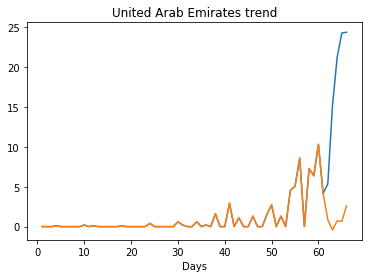

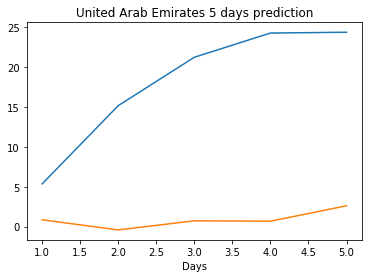

Creating directory ./offline6/India/training/
India
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0087
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0072


/space/home/nzhang/anaconda3/envs/neuralnet/lib/python3.7/site-packages/torch/nn/modules/loss.py:431: UserWarning: Using a target size (torch.Size([1, 1, 5])) that is different to the input size (torch.Size([5])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/space/home/nzhang/anaconda3/envs/neuralnet/lib/python3.7/site-packages/torch/nn/modules/loss.py:431: UserWarning: Using a target size (torch.Size([1, 5])) that is different to the input size (torch.Size([5])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Saving the best model weights at Epoch [3], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0066
train error: 0.00081491319288034
0.006617230363190174
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0057
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0056
train error: 0.0008083098810554172
0.005605945363640785
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0019
train error: 0.000844574300936074
0.0018722781678661704
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0082
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0065
Saving the b

Saving the best model weights at Epoch [5], Best Valid Loss: 0.0065
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0065
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0065
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0063
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0061
train error: 0.0007886475490522571
0.006079453509300947
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0070
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0063
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0058
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0057
train error: 0.0008212038524410066
0.005682372488081455
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0051
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0039
train error: 0.0010910621220925046
0.0039036348462104797
Saving the

Saving the best model weights at Epoch [2], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0060
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0052
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0042
train error: 0.0009331995461252518
0.004185022786259651
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0061
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0060
train error: 0.0007856379035123003
0.006034127902239561
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0064
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0062
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0061
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0059
Saving the best model weights at Epoch [47], Best Valid Loss: 0.005

Saving the best model weights at Epoch [16], Best Valid Loss: 0.0087
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0084
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0081
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0079
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0077
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0076
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0073
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0071
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0070
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0070
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0069
Saving the best model weights at E

Saving the best model weights at Epoch [19], Best Valid Loss: 0.0071
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0070
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0069
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0065
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0065
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0065
Saving the best model weights at E

Saving the best model weights at Epoch [37], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0065
train error: 0.0007627341059560422
0.006546223070472479
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0081
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0065
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0064
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0063
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0062
train error: 0.0007585174881872566
0.006243615411221981
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0398
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0312
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0248
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0200
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0165


Saving the best model weights at Epoch [15], Best Valid Loss: 0.0070
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0069
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0066
train error: 0.000763794148224406


Saving the best model weights at Epoch [11], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0066
train error: 0.0007603377552489594
0.006580966059118509
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0093
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0065
Saving the best model weights at Epoch [9], Best V

Saving the best model weights at Epoch [4], Best Valid Loss: 0.0110
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0098
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0090
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0084
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0080
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0076
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0071
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0070
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0069
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [8], Best Valid Loss: 0.0069
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0069
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0066
Saving the best model weights at Epo

Saving the best model weights at Epoch [32], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0066
train error: 0.0007635079886919509
0.006579833570867777
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0120
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0062
train error: 0.0007966326164023485
0.00623380346223712
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0118
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0108
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0100
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0094
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0089
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0085


Saving the best model weights at Epoch [12], Best Valid Loss: 0.0374
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0364
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0355
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0345
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0337
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0328
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0320
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0312
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0304
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0296
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0289
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0282
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0275
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0268
Saving the best model weights at E

Saving the best model weights at Epoch [27], Best Valid Loss: 0.0139
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0137
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0135
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0133
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0131
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0129
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0128
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0126
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0124
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0123
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0121
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0119
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0118
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0117
Saving the best model weights at E

Saving the best model weights at Epoch [18], Best Valid Loss: 0.0088
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0086
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0084
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0083
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0082
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0080
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0079
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0078
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0077
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0076
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0075
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0073
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0073
Saving the best model weights at E

Saving the best model weights at Epoch [6], Best Valid Loss: 0.0097
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0096
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0096
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0095
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0094
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0093
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0092
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0091
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0091
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0090
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0089
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0088
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0088
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0087
Saving the best model weights at Epoch

Saving the best model weights at Epoch [42], Best Valid Loss: 0.0090
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0089
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0089
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0088
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0088
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0087
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0087
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0086
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0086
train error: 0.002078481625843172
0.008564497344195843
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0132
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0125
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0118
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0112
Saving the best model weights at Epoch [5], Best Val

Saving the best model weights at Epoch [27], Best Valid Loss: 0.0137
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0136
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0134
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0133
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0131
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0130
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0128
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0126
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0125
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0123
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0122
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0121
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0120
Saving the best model weights at E

Saving the best model weights at Epoch [18], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0183
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0180
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0177
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0175
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0172
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0169
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0167
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0165
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0162
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0160
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0158
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0155
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0153
Saving the best model weights at E

Saving the best model weights at Epoch [9], Best Valid Loss: 0.0113
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0112
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0111
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0110
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0108
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0108
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0107
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0106
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0105
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0103
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0102
Saving the best model weights at Ep

Saving the best model weights at Epoch [15], Best Valid Loss: 0.0152
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0148
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0143
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0139
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0135
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0131
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0123
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0120
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0116
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0113
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0110
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0107
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0104
Saving the best model weights at E

Saving the best model weights at Epoch [15], Best Valid Loss: 0.0087
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0086
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0084
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0082
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0081
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0079
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0078
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0077
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0075
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0073
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0071
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0070
Saving the best model weights at E

Saving the best model weights at Epoch [35], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0066
train error: 0.0007566002066596411
0.006603551562875509
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0245
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0242
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0238
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0235
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0232
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0229
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0225
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0222
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0219
Saving the best model weights at Epoch [10], Best Valid 

Saving the best model weights at Epoch [23], Best Valid Loss: 0.0065
train error: 0.000758059895936943
0.006500856019556522
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0065
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0065
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0064
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0064
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0063
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0063
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0062
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0062
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0062
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0061
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0061
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0060
Saving the best model weights at Epoch [13], Best Valid L

Saving the best model weights at Epoch [18], Best Valid Loss: 0.0307
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0302
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0296
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0291
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0286
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0281
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0276
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0271
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0266
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0262
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0257
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0253
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0249
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0245
Saving the best model weights at E

Saving the best model weights at Epoch [11], Best Valid Loss: 0.0174
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0171
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0169
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0167
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0165
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0162
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0160
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0158
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0156
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0154
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0152
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0151
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0149
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0147
Saving the best model weights at E

train error: 0.0007577234525039481
0.006601732224225998
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0142
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0140
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0138
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0136
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0134
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0133
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0131
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0129
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0126
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0124
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0123
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0121
Saving the best model weights at Epoch [14], Best Valid 

Saving the best model weights at Epoch [18], Best Valid Loss: 0.0075
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0073
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0071
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0071
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0070
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0069
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0069
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0067
Saving the best model weights at E

Saving the best model weights at Epoch [46], Best Valid Loss: 0.0083
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0082
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0082
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0081
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0081
train error: 0.001115785511501599
0.00805624108761549
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0071
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0064
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0062
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0061
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0061
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0060
train error: 0.0007570486838327876
0.006004467606544495
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0668
S

Saving the best model weights at Epoch [6], Best Valid Loss: 0.0134
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0114
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0099
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0090
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0082
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0076
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0069
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0065
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0065
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0065
Saving the best model weights at Epoch

Saving the best model weights at Epoch [4], Best Valid Loss: 0.0167
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0149
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0135
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0123
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0114
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0106
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0100
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0094
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0090
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0086
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0084
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0081
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0079
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0077
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [35], Best Valid Loss: 0.0094
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0093
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0092
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0091
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0090
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0089
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0088
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0087
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0086
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0085
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0084
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0084
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0083
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0082
Saving the best model weights at E

Saving the best model weights at Epoch [30], Best Valid Loss: 0.0087
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0086
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0085
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0085
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0084
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0084
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0083
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0083
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0082
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0082
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0081
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0081
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0080
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0080
Saving the best model weights at E

Saving the best model weights at Epoch [20], Best Valid Loss: 0.0197
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0196
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0195
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0193
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0192
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0190
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0189
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0188
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0185
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0184
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0182
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0181
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0180
Saving the best model weights at E

Saving the best model weights at Epoch [38], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0108
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0108
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0108
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0108
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0108
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0107
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0107
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0107
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0107
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0106
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0106
train error: 0.01213946168621381
0.010623537003993988
Saving the best model weights at Epoch [1], Best 

Saving the best model weights at Epoch [5], Best Valid Loss: 0.0313
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0312
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0311
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0311
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0310
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0310
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0309
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0309
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0308
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0308
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0307
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0307
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0306
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0306
Saving the best model weights at Epoch 

Saving the best model weights at Epoch [25], Best Valid Loss: 0.0199
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0197
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0195
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0193
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0190
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0188
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0184
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0183
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0181
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0179
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0177
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0175
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0174
Saving the best model weights at E

Saving the best model weights at Epoch [46], Best Valid Loss: 0.0076
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0076
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0076
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0076
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0076
train error: 0.0012455957902905842
0.007560251746326685
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0187
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0185
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0182
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0180
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0178
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0175
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0173
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0171
Saving the best model weights at Epoch [9], Best Valid 

Saving the best model weights at Epoch [13], Best Valid Loss: 0.0648
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0646
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0644
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0641
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0639
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0637
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0635
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0632
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0630
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0628
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0626
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0624
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0622
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0619
Saving the best model weights at E

Saving the best model weights at Epoch [33], Best Valid Loss: 0.0324
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0323
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0322
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0322
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0321
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0321
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0320
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0320
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0319
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0319
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0318
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0317
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0317
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0316
Saving the best model weights at E

Saving the best model weights at Epoch [3], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0071
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0071
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [23], Best Valid Loss: 0.0049
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0049
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0049
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0048
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0048
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0048
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0048
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0048
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0047
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0047
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0047
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0047
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0047
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0047
Saving the best model weights at E

Saving the best model weights at Epoch [46], Best Valid Loss: 0.0196
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0196
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0196
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0195
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0195
train error: 0.0057997983181849126
0.019456906244158745
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0193
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0191
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0188
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0184
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0182
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0180
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0178
Saving the best model weights at Epoch [9], Best Valid 

Saving the best model weights at Epoch [14], Best Valid Loss: 0.0713
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0711
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0708
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0706
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0703
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0700
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0698
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0695
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0693
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0690
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0688
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0685
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0683
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0680
Saving the best model weights at E

Saving the best model weights at Epoch [32], Best Valid Loss: 0.0192
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0192
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0191
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0191
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0191
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0190
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0190
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0190
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0189
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0189
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0189
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0189
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0188
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0188
Saving the best model weights at E

Saving the best model weights at Epoch [1], Best Valid Loss: 0.0090
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0090
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0090
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0090
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0090
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0090
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0090
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0089
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0089
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0089
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0089
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0089
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0089
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0089
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [20], Best Valid Loss: 0.0060
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0060
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0059
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0058
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0058
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0057
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0057
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0056
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0056
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0055
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0055
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0055
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0054
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0054
Saving the best model weights at E

Saving the best model weights at Epoch [40], Best Valid Loss: 0.0054
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0054
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0054
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0054
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0054
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0054
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0054
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0054
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0054
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0054
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0054
train error: 0.002413973441192259
0.005407201126217842
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0091
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0090
Saving the best model weights at Epoch [3], Best V

Saving the best model weights at Epoch [7], Best Valid Loss: 0.0565
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0563
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0560
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0558
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0556
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0554
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0551
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0549
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0547
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0545
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0542
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0540
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0538
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0536
Saving the best model weights at Epoc

Saving the best model weights at Epoch [25], Best Valid Loss: 0.0177
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0177
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0177
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0176
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0176
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0176
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0175
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0175
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0175
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0174
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0174
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0174
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0173
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0173
Saving the best model weights at E

Saving the best model weights at Epoch [12], Best Valid Loss: 0.0253
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0252
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0252
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0252
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0251
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0251
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0250
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0250
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0250
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0249
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0249
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0248
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0248
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0248
Saving the best model weights at E

Saving the best model weights at Epoch [31], Best Valid Loss: 0.0124
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0123
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0122
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0121
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0120
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0119
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0118
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0117
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0116
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0115
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0114
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0113
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0112
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0111
Saving the best model weights at E

Saving the best model weights at Epoch [30], Best Valid Loss: 0.0657
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0655
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0654
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0653
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0651
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0650
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0648
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0647
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0646
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0644
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0643
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0642
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0640
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0639
Saving the best model weights at E

Saving the best model weights at Epoch [48], Best Valid Loss: 0.0158
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0156
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0153
train error: 0.01103531311576565
0.015338532626628876
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0221
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0221
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0221
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0221
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0220
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0220
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0220
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0219
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0219
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0219
Saving the best model weights at Epoch [11], Best Valid Lo

Saving the best model weights at Epoch [16], Best Valid Loss: 0.0145
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0143
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0142
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0140
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0138
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0137
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0135
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0133
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0132
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0130
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0129
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0128
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0126
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0125
Saving the best model weights at E

Saving the best model weights at Epoch [34], Best Valid Loss: 0.0228
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0227
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0227
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0226
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0225
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0225
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0224
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0224
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0223
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0223
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0222
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0222
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0221
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0221
Saving the best model weights at E

Saving the best model weights at Epoch [2], Best Valid Loss: 0.0173
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0172
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0172
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0172
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0171
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0171
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0171
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0170
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0170
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0170
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0169
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0169
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0169
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0168
Saving the best model weights at Epoch [16

Saving the best model weights at Epoch [22], Best Valid Loss: 0.0286
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0286
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0286
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0286
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0286
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0285
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0285
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0285
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0285
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0285
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0285
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0285
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0285
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0285
Saving the best model weights at E

Saving the best model weights at Epoch [41], Best Valid Loss: 0.0516
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0515
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0514
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0514
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0513
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0512
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0511
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0510
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0509
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0508
train error: 0.029088800648848216
0.050801169127225876
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0105
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0105
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0105
Saving the best model weights at Epoch [4], Best Va

Saving the best model weights at Epoch [8], Best Valid Loss: 0.0303
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0303
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0302
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0302
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0301
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0301
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0300
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0300
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0299
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0299
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0299
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0298
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0298
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0297
Saving the best model weights at Epo

Saving the best model weights at Epoch [27], Best Valid Loss: 0.0359
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0359
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0358
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0358
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0358
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0358
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0358
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0358
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0358
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0358
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0357
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0357
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0357
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0357
Saving the best model weights at E

Saving the best model weights at Epoch [47], Best Valid Loss: 0.0215
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0215
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0214
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0214
train error: 0.005977823748253286
0.02144705317914486
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0160
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0160
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0160
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0160
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0160
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0160
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0160
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0159
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0159
Saving the best model weights at Epoch [10], Best Valid Lo

Saving the best model weights at Epoch [16], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0185
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0185
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0185
Saving the best model weights at E

Saving the best model weights at Epoch [36], Best Valid Loss: 0.0123
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0122
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0122
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0122
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0121
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0121
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0121
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0120
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0120
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0120
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0120
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0119
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0119
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0119
Saving the best model weights at E

Saving the best model weights at Epoch [3], Best Valid Loss: 0.0110
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0110
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0110
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0110
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0110
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0110
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0110
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [23], Best Valid Loss: 0.0118
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0118
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0118
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0118
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0118
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0118
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0118
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0118
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0118
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0118
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0118
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0118
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0118
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0118
Saving the best model weights at E

Saving the best model weights at Epoch [43], Best Valid Loss: 0.0065
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0065
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0065
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0065
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0065
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0065
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0065
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0065
train error: 0.0032423131167888643
0.006471828557550907
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0082
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0082
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0082
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0082
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0082
Saving the best model weights at Epoch [6], Best Val

Saving the best model weights at Epoch [12], Best Valid Loss: 0.0837
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0837
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0836
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0836
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0836
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0836
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0836
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0835
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0835
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0835
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0835
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0835
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0835
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0834
Saving the best model weights at E

Saving the best model weights at Epoch [30], Best Valid Loss: 0.0208
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0208
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0207
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0207
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0207
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0206
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0206
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0205
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0205
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0205
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0204
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0204
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0204
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0203
Saving the best model weights at E

Saving the best model weights at Epoch [49], Best Valid Loss: 0.0310
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0310
train error: 0.013261546629170578
0.03096366859972477
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0126
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0126
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0126
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0126
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0126
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0126
Saving the best model weights at Epoch [12], Best Valid Lo

Saving the best model weights at Epoch [18], Best Valid Loss: 0.0148
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0148
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0148
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0148
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0148
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0148
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0148
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0148
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0148
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0148
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0148
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0148
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0148
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0147
Saving the best model weights at E

Saving the best model weights at Epoch [36], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0103
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0103
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0103
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0103
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0103
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0103
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0103
Saving the best model weights at E

Saving the best model weights at Epoch [3], Best Valid Loss: 0.0869
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0869
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0869
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0869
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0868
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0868
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0868
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0868
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0868
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0867
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0867
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0867
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0867
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0867
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [21], Best Valid Loss: 0.0458
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0457
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0456
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0455
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0454
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0454
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0453
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0452
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0451
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0450
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0449
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0449
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0448
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0447
Saving the best model weights at E

Saving the best model weights at Epoch [40], Best Valid Loss: 0.0241
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0241
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0241
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0241
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0241
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0241
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0241
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0241
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0241
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0241
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0241
train error: 0.008043355060120423
0.024071646854281425
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0406
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0406
Saving the best model weights at Epoch [3], Best V

Saving the best model weights at Epoch [7], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0068
Saving the best model weights at Epoc

Saving the best model weights at Epoch [26], Best Valid Loss: 0.0097
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0097
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0097
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0097
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0097
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0097
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0097
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0097
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0097
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0097
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0097
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0097
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0097
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0097
Saving the best model weights at E

Saving the best model weights at Epoch [46], Best Valid Loss: 0.0147
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0147
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0147
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0147
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0146
train error: 0.0030770935739080113
0.014643514528870583
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0356
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0356
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0356
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0356
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0355
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0355
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0355
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0355
Saving the best model weights at Epoch [9], Best Valid 

Saving the best model weights at Epoch [13], Best Valid Loss: 0.0613
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0611
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0610
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0608
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0607
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0606
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0604
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0603
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0602
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0600
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0599
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0597
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0596
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0595
Saving the best model weights at E

Saving the best model weights at Epoch [31], Best Valid Loss: 0.0191
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0191
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0191
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0191
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0191
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0191
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0191
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0190
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0190
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0190
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0190
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0190
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0190
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0190
Saving the best model weights at E

Saving the best model weights at Epoch [49], Best Valid Loss: 0.0293
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0293
train error: 0.011076843366026878
0.029276728630065918
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0294
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0294
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0293
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0293
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0293
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0293
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0293
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0293
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0293
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0293
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0293
Saving the best model weights at Epoch [12], Best Valid L

Saving the best model weights at Epoch [17], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0104
Saving the best model weights at E

Saving the best model weights at Epoch [35], Best Valid Loss: 0.0115
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0114
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0114
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0114
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0114
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0114
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0114
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0114
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0114
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0113
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0113
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0113
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0113
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0113
Saving the best model weights at E

Saving the best model weights at Epoch [4], Best Valid Loss: 0.0666
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0666
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0665
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0665
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0665
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0665
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0665
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0665
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0665
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0664
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0664
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0664
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0664
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0664
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [22], Best Valid Loss: 0.0260
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0260
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0260
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0260
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0260
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0260
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0260
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0260
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0260
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0260
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0260
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0260
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0260
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0260
Saving the best model weights at E

Saving the best model weights at Epoch [40], Best Valid Loss: 0.0051
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0051
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0051
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0051
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0051
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0051
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0051
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0051
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0051
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0051
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0051
train error: 0.007282576508199175
0.005091495346277952
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0092
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0092
Saving the best model weights at Epoch [3], Best V

Saving the best model weights at Epoch [9], Best Valid Loss: 0.0154
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0154
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0154
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0154
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0154
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0154
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0154
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0154
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0154
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0154
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0154
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0154
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0154
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0154
Saving the best model weights at Ep

Saving the best model weights at Epoch [27], Best Valid Loss: 0.0181
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0181
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0181
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0180
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0180
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0180
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0180
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0180
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0180
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0180
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0180
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0180
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0180
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0180
Saving the best model weights at E

Saving the best model weights at Epoch [47], Best Valid Loss: 0.0395
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0394
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0394
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0394
train error: 0.03425907678902149
0.039445918053388596
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0490
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0490
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0490
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0490
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0489
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0489
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0489
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0489
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0489
Saving the best model weights at Epoch [10], Best Valid Lo

Saving the best model weights at Epoch [16], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0074
Saving the best model weights at E

Saving the best model weights at Epoch [36], Best Valid Loss: 0.0064
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0064
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0064
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0064
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0064
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0064
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0064
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0064
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0064
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0064
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0064
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0064
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0064
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0064
Saving the best model weights at E

Saving the best model weights at Epoch [3], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [23], Best Valid Loss: 0.0198
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0198
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0198
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0198
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0198
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0198
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0197
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0197
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0197
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0197
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0197
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0197
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0197
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0197
Saving the best model weights at E

Saving the best model weights at Epoch [41], Best Valid Loss: 0.0631
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0631
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0631
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0631
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0631
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0631
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0631
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0631
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0631
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0631
train error: 0.048788490767280264
0.0630662813782692
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0417
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0417
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0417
Saving the best model weights at Epoch [4], Best Vali

Saving the best model weights at Epoch [8], Best Valid Loss: 0.0260
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0260
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0260
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0260
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0260
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0260
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0260
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0260
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0260
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0260
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0260
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0260
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0260
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0260
Saving the best model weights at Epo

Saving the best model weights at Epoch [26], Best Valid Loss: 0.0099
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0099
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0099
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0099
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0099
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0099
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0099
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0099
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0099
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0099
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0099
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0099
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0099
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0099
Saving the best model weights at E

Saving the best model weights at Epoch [44], Best Valid Loss: 0.0122
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0122
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0122
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0122
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0122
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0122
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0122
train error: 0.004938191074567537
0.01221510861068964
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0181
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0181
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0181
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0181
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0181
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0181
Saving the best model weights at Epoch [7], Best Valid 

Saving the best model weights at Epoch [12], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0109
Saving the best model weights at E

Saving the best model weights at Epoch [31], Best Valid Loss: 0.0265
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0265
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0265
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0265
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0265
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0265
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0265
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0265
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0265
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0265
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0265
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0265
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0265
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0265
Saving the best model weights at E

Saving the best model weights at Epoch [50], Best Valid Loss: 0.0154
train error: 0.01346603709583481
0.015409417450428009
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0216
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0216
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0216
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0216
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0216
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0216
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0216
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0216
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0216
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0216
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0216
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0216
Saving the best model weights at Epoch [13], Best Valid Lo

Saving the best model weights at Epoch [17], Best Valid Loss: 0.0169
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0169
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0169
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0169
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0169
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0169
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0169
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0169
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0169
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0169
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0169
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0169
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0169
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0169
Saving the best model weights at E

Saving the best model weights at Epoch [35], Best Valid Loss: 0.0030
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0030
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0030
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0030
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0030
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0030
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0030
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0030
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0030
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0030
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0030
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0030
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0030
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0030
Saving the best model weights at E

Saving the best model weights at Epoch [3], Best Valid Loss: 0.0089
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0089
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0089
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0089
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0089
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0089
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0089
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0089
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0089
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0089
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0089
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0089
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0089
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0089
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [21], Best Valid Loss: 0.0427
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0427
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0427
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0427
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0427
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0427
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0427
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0426
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0426
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0426
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0426
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0426
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0426
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0426
Saving the best model weights at E

Saving the best model weights at Epoch [39], Best Valid Loss: 0.0166
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0166
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0166
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0166
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0166
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0166
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0166
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0166
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0166
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0166
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0166
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0166
train error: 0.011286302500714858
0.0165722519159317
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0250
Saving the best model weights at Epoch [2], Best Va

Saving the best model weights at Epoch [7], Best Valid Loss: 0.0124
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0124
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0124
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0124
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0124
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0124
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0124
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0124
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0124
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0124
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0124
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0124
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0124
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0124
Saving the best model weights at Epoc

Saving the best model weights at Epoch [25], Best Valid Loss: 0.0236
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0236
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0236
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0236
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0236
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0236
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0236
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0236
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0236
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0235
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0235
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0235
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0235
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0235
Saving the best model weights at E

Saving the best model weights at Epoch [43], Best Valid Loss: 0.0039
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0039
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0039
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0039
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0039
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0039
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0039
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0039
train error: 0.004810023913159966
0.003919518552720547
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0124
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0124
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0124
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0124
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0124
Saving the best model weights at Epoch [6], Best Vali

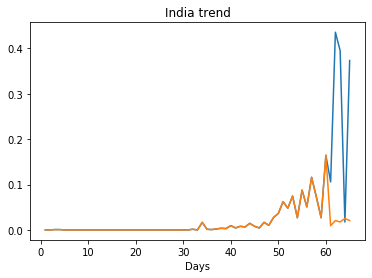

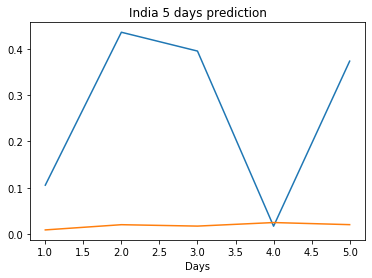

Creating directory ./offline6/Nepal/training/
Nepal
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0027
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0006


/space/home/nzhang/anaconda3/envs/neuralnet/lib/python3.7/site-packages/torch/nn/modules/loss.py:431: UserWarning: Using a target size (torch.Size([1, 1, 5])) that is different to the input size (torch.Size([5])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/space/home/nzhang/anaconda3/envs/neuralnet/lib/python3.7/site-packages/torch/nn/modules/loss.py:431: UserWarning: Using a target size (torch.Size([1, 5])) that is different to the input size (torch.Size([5])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Saving the best model weights at Epoch [3], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0004
train error: 9.463804300529384e-05
0.0004273301165085286
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0004
train error: 9.745319524491995e-05
0.000388295389711856

Saving the best model weights at Epoch [2], Best Valid Loss: 0.0004
train error: 9.439716412608894e-05
0.0003536661097314209
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0004
train error: 9.738602500744622e-05
0.0003761641855817288
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0003
train error: 0.00010105749717175578
0.00034534590668044984
Savi

Saving the best model weights at Epoch [10], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0003
train error: 0.0001085335565481468
0.000325948087265715
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0004
train error: 9.504601141868209e-05
0.00039631506660953164
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [8], Best Valid Loss: 0.00

Saving the best model weights at Epoch [21], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0004
Saving the best model weights at E

Saving the best model weights at Epoch [36], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0004
train error: 9.204278992131419e-05
0.0004220650589559227
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0038
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0023
Saving the best model weights at Epoch [3], Best

Saving the best model weights at Epoch [3], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0038
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0022
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0014
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0009
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [11], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0004
train error: 9.242375890607945e-05
0.0004123921971768141
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0003
train error: 9.497163572242633e-05
0.00031956814927980304
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0002
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0002
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0002
train error: 9.19767818101848e-05
0.00015733230975456536
Saving

Saving the best model weights at Epoch [4], Best Valid Loss: 0.0033
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0022
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0015
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0009
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [36], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0004
Saving the best model weights at E

Saving the best model weights at Epoch [8], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0010
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0008
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0004
Saving the best model weights at Epo

Saving the best model weights at Epoch [16], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0004
train error: 9.198912669359873e-05
0.0004057247133459896
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0303
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0165
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0091
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0050
Saving the best model weights at Epoch [5], Best V

Saving the best model weights at Epoch [12], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0004
Saving the best model weights at E

Saving the best model weights at Epoch [31], Best Valid Loss: 0.0040
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0038
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0036
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0034
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0032
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0030
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0029
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0027
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0026
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0024
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0023
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0022
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0021
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0020
Saving the best model weights at E

Saving the best model weights at Epoch [37], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0004
train error: 0.0004547042206728033

Saving the best model weights at Epoch [7], Best Valid Loss: 0.0082
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0078
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0070
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0062
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0059
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0056
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0053
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0050
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0048
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0045
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0043
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0041
Saving the best model weights at Epoc

Saving the best model weights at Epoch [4], Best Valid Loss: 0.0022
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0021
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0020
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0019
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0017
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0016
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0016
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0015
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0014
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0014
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0013
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0013
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [36], Best Valid Loss: 0.0110
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0106
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0103
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0100
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0097
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0094
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0091
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0088
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0085
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0082
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0080
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0077
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0075
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0073
Saving the best model weights at E

Saving the best model weights at Epoch [6], Best Valid Loss: 0.0032
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0031
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0030
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0029
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0028
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0028
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0027
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0026
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0025
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0025
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0024
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0023
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0023
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0022
Saving the best model weights at Epoch

Saving the best model weights at Epoch [25], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0004
Saving the best model weights at E

Saving the best model weights at Epoch [50], Best Valid Loss: 0.0006
train error: 0.0006202838150784374
0.0005557002732530236
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0016
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0008
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0003
train error: 9.182564933455849e-05
0.00028698871028609574
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0045
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0044

Saving the best model weights at Epoch [8], Best Valid Loss: 0.0010
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0009
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0008
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0004
Saving the best model weights at Epo

Saving the best model weights at Epoch [40], Best Valid Loss: 0.0044
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0042
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0040
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0038
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0037
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0035
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0034
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0032
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0031
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0030
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0029
train error: 0.0015296291892549821
0.0028589963912963867
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0184
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0138
Saving the best model weights at Epoch [3], Best

Saving the best model weights at Epoch [20], Best Valid Loss: 0.0026
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0024
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0023
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0022
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0020
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0019
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0017
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0016
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0015
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0015
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0014
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0013
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0013
Saving the best model weights at E

Saving the best model weights at Epoch [10], Best Valid Loss: 0.0081
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0077
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0073
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0069
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0063
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0060
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0057
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0054
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0052
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0049
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0047
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0045
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0043
Saving the best model weights at E

Saving the best model weights at Epoch [37], Best Valid Loss: 0.0024
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0023
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0022
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0022
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0021
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0021
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0020
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0020
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0019
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0019
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0019
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0017
train error: 0.0010402857375863407

Saving the best model weights at Epoch [22], Best Valid Loss: 0.0113
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0108
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0100
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0096
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0093
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0089
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0086
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0082
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0079
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0076
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0073
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0070
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0068
Saving the best model weights at E

Saving the best model weights at Epoch [20], Best Valid Loss: 0.0058
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0056
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0054
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0053
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0052
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0050
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0049
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0047
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0046
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0045
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0044
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0043
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0041
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0040
Saving the best model weights at E

Saving the best model weights at Epoch [38], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0004
train error: 9.174342249025358e-05
0.0004135238123126328
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0098
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0095
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0092
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0089
Saving the best model weights at Epoch [5], Best V

Saving the best model weights at Epoch [10], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0010
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0009
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0008
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0005
Saving the best model weights at E

Saving the best model weights at Epoch [34], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0004
Saving the best model weights at E

Saving the best model weights at Epoch [42], Best Valid Loss: 0.0037
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0035
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0033
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0032
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0030
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0029
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0027
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0026
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0025
train error: 0.0020898702088743447
0.0024563372135162354
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0133
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0095
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0047
Saving the best model weights at Epoch [5], Best V

Saving the best model weights at Epoch [44], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0005
train error: 0.0007994611647778323
0.00045716878958046436
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0077
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0059
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0045
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0035
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0028
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0022
Saving the best model weights at Epoch [7], Best Va

Saving the best model weights at Epoch [20], Best Valid Loss: 0.0014
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0013
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0010
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0009
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0009
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0008
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0008
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0006
Saving the best model weights at E

Saving the best model weights at Epoch [50], Best Valid Loss: 0.0010
train error: 0.0005687359437745597
0.0010160449892282486
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0036
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0034
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0032
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0031
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0029
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0028
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0026
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0025
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0023
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0022
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0021
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0020
Saving the best model weights at Epoch [13], Best Valid

Saving the best model weights at Epoch [48], Best Valid Loss: 0.0338
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0337
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0336
train error: 0.037144500549350465
0.03357367217540741
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0179
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0177
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0176
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0175
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0174
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0173
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0172
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0171
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0170
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0169
Saving the best model weights at Epoch [11], Best Valid Lo

Saving the best model weights at Epoch [15], Best Valid Loss: 0.0096
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0095
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0095
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0095
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0094
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0094
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0094
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0093
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0093
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0093
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0092
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0092
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0092
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0091
Saving the best model weights at E

Saving the best model weights at Epoch [35], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0017
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0017
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0016
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0016
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0015
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0015
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0014
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0014
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0014
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0013
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0013
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0012
Saving the best model weights at E

Saving the best model weights at Epoch [2], Best Valid Loss: 0.0100
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0098
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0095
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0092
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0090
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0087
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0085
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0083
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0081
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0078
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0076
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0070
Saving the best model weights at Epoch [16

Saving the best model weights at Epoch [22], Best Valid Loss: 0.0049
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0049
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0049
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0049
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0048
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0048
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0048
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0048
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0047
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0047
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0047
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0047
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0046
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0046
Saving the best model weights at E

Saving the best model weights at Epoch [41], Best Valid Loss: 0.0282
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0281
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0280
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0279
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0278
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0277
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0276
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0276
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0275
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0274
train error: 0.022331405537469047
0.02739783003926277
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0345
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0343
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0341
Saving the best model weights at Epoch [4], Best Val

Saving the best model weights at Epoch [10], Best Valid Loss: 0.0150
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0150
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0149
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0149
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0148
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0148
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0147
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0147
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0146
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0146
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0146
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0145
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0145
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0144
Saving the best model weights at E

Saving the best model weights at Epoch [29], Best Valid Loss: 0.0039
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0038
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0038
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0037
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0036
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0035
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0035
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0034
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0033
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0032
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0032
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0031
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0031
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0030
Saving the best model weights at E

Saving the best model weights at Epoch [47], Best Valid Loss: 0.0055
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0055
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0055
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0054
train error: 0.005794553771348936
0.005437406711280346
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0115
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0112
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0106
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0103
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0100
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0097
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0095
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0092
Saving the best model weights at Epoch [10], Best Valid L

Saving the best model weights at Epoch [16], Best Valid Loss: 0.0034
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0034
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0034
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0034
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0034
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0033
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0033
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0033
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0033
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0033
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0032
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0032
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0032
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0032
Saving the best model weights at E

Saving the best model weights at Epoch [35], Best Valid Loss: 0.0280
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0279
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0278
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0277
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0277
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0276
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0275
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0274
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0273
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0272
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0271
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0270
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0270
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0269
Saving the best model weights at E

Saving the best model weights at Epoch [3], Best Valid Loss: 0.0024
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0024
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0024
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0024
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0024
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0024
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0024
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0024
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0024
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0024
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0024
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0024
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0023
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0023
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [23], Best Valid Loss: 0.0036
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0035
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0034
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0033
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0032
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0031
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0030
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0029
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0028
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0027
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0027
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0026
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0025
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0024
Saving the best model weights at E

Saving the best model weights at Epoch [41], Best Valid Loss: 0.0043
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0043
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0042
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0042
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0042
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0042
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0042
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0041
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0041
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0041
train error: 0.0031206815303968533
0.0040894015692174435
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0101
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0098
Saving the best model weights at Epoch [4], Best 

Saving the best model weights at Epoch [9], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0017
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0017
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0017
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0017
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0017
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0017
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0017
Saving the best model weights at Ep

Saving the best model weights at Epoch [27], Best Valid Loss: 0.0419
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0418
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0416
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0415
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0414
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0412
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0411
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0410
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0408
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0407
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0406
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0404
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0403
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0402
Saving the best model weights at E

Saving the best model weights at Epoch [45], Best Valid Loss: 0.0027
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0027
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0026
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0026
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0025
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0024
train error: 0.0016159835953398474
0.0024463606532663107
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0080
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0080
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0080
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0080
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0080
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0079
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0079
Saving the best model weights at Epoch [8], Best Vali

Saving the best model weights at Epoch [13], Best Valid Loss: 0.0100
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0097
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0095
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0092
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0090
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0087
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0085
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0083
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0080
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0078
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0076
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0070
Saving the best model weights at E

Saving the best model weights at Epoch [31], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0071
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0071
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0071
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0070
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0070
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0070
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0069
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0069
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0069
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0068
Saving the best model weights at E

Saving the best model weights at Epoch [49], Best Valid Loss: 0.0049
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0049
train error: 0.004193486526076283
0.004906600806862116
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0049
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0049
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0049
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0049
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0048
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0048
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0048
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0048
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0048
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0047
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0047
Saving the best model weights at Epoch [12], Best Valid L

Saving the best model weights at Epoch [17], Best Valid Loss: 0.0386
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0384
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0383
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0382
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0380
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0379
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0378
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0376
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0375
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0374
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0373
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0371
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0370
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0369
Saving the best model weights at E

Saving the best model weights at Epoch [35], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0101
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0099
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0096
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0094
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0091
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0089
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0086
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0084
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0082
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0080
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0078
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0076
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0074
Saving the best model weights at E

Saving the best model weights at Epoch [3], Best Valid Loss: 0.0084
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0081
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0079
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0077
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0070
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0064
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0062
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0060
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0058
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0057
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [21], Best Valid Loss: 0.0028
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0028
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0027
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0027
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0027
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0027
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0027
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0027
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0027
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0027
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0026
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0026
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0026
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0026
Saving the best model weights at E

Saving the best model weights at Epoch [39], Best Valid Loss: 0.0025
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0025
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0025
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0024
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0024
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0024
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0024
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0024
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0024
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0024
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0024
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0024
train error: 0.0019483208689572557
0.0023950429167598486
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0033
Saving the best model weights at Epoch [2], Bes

Saving the best model weights at Epoch [7], Best Valid Loss: 0.0349
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0349
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0348
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0348
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0348
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0348
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0348
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0348
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0348
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0348
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0347
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0347
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0347
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0347
Saving the best model weights at Epoc

Saving the best model weights at Epoch [25], Best Valid Loss: 0.0380
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0379
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0378
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0376
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0375
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0374
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0373
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0372
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0370
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0369
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0368
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0367
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0366
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0365
Saving the best model weights at E

Saving the best model weights at Epoch [45], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0072
train error: 0.010678442088621003
0.007222333457320929
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0111
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0111
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0110
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0110
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [8], Best Valid 

Saving the best model weights at Epoch [13], Best Valid Loss: 0.0077
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0077
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0077
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0077
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0077
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0076
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0076
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0076
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0076
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0076
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0076
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0076
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0076
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0076
Saving the best model weights at E

Saving the best model weights at Epoch [31], Best Valid Loss: 0.0034
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0034
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0034
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0034
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0034
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0034
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0034
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0034
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0034
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0034
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0034
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0034
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0034
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0034
Saving the best model weights at E

Saving the best model weights at Epoch [1], Best Valid Loss: 0.0499
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0498
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0498
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0498
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0498
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0498
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0497
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0497
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0497
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0497
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0497
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0497
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [19], Best Valid Loss: 0.0108
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0108
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0108
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0107
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0107
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0107
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0107
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0106
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0106
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0106
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0106
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0105
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0105
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0105
Saving the best model weights at E

Saving the best model weights at Epoch [38], Best Valid Loss: 0.0036
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0036
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0036
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0036
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0036
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0036
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0036
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0036
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0036
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0036
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0036
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0036
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0036
train error: 0.0020262959712584105
0.0035956278443336487
Saving the best model weights at Epoch [1], Be

Saving the best model weights at Epoch [5], Best Valid Loss: 0.0040
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0040
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0040
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0040
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0040
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0040
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0040
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0040
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0040
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0040
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0040
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0040
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0040
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0040
Saving the best model weights at Epoch 

Saving the best model weights at Epoch [23], Best Valid Loss: 0.0096
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0096
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0096
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0096
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0096
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0096
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0096
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0096
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0096
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0096
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0096
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0096
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0096
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0096
Saving the best model weights at E

Saving the best model weights at Epoch [42], Best Valid Loss: 0.0052
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0052
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0052
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0051
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0051
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0051
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0051
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0051
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0051
train error: 0.004528690961056522
0.005068470723927021
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0108
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0108
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0108
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0108
Saving the best model weights at Epoch [5], Best Val

Saving the best model weights at Epoch [9], Best Valid Loss: 0.0330
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0329
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0328
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0328
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0327
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0326
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0325
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0324
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0323
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0322
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0321
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0320
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0320
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0319
Saving the best model weights at Ep

Saving the best model weights at Epoch [28], Best Valid Loss: 0.0248
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0248
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0248
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0247
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0247
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0247
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0247
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0247
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0247
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0247
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0246
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0246
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0246
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0246
Saving the best model weights at E

Saving the best model weights at Epoch [46], Best Valid Loss: 0.0054
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0054
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0054
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0054
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0054
train error: 0.007707444432058504
0.005436248611658812
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0160
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0160
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0160
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0160
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0160
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0160
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0160
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0160
Saving the best model weights at Epoch [9], Best Valid L

Saving the best model weights at Epoch [14], Best Valid Loss: 0.0073
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0073
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0073
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0073
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0073
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0073
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0073
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0073
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0073
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0073
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0073
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0073
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0073
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0073
Saving the best model weights at E

Saving the best model weights at Epoch [32], Best Valid Loss: 0.0070
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0070
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0070
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0070
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0069
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0069
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0069
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0069
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0069
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0068
Saving the best model weights at E

Saving the best model weights at Epoch [50], Best Valid Loss: 0.0197
train error: 0.022667470946908
0.019706137478351593
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0158
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0158
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0157
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0157
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0156
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0156
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0155
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0155
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0154
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0154
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0154
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0153
Saving the best model weights at Epoch [13], Best Valid Loss

Saving the best model weights at Epoch [18], Best Valid Loss: 0.0162
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0162
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0162
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0162
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0162
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0162
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0161
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0161
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0161
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0161
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0161
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0161
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0161
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0161
Saving the best model weights at E

Saving the best model weights at Epoch [36], Best Valid Loss: 0.0128
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0128
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0128
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0128
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0128
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0128
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0128
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0128
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0128
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0128
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0128
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0127
Saving the best model weights at E

Saving the best model weights at Epoch [4], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [22], Best Valid Loss: 0.0008
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0008
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0008
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0008
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0008
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0008
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0008
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0008
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0008
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0008
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0008
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0008
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0008
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0008
Saving the best model weights at E

Saving the best model weights at Epoch [40], Best Valid Loss: 0.0502
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0502
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0502
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0502
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0501
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0501
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0501
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0500
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0500
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0500
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0499
train error: 0.046894742654902594
0.049946993589401245
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0272
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0272
Saving the best model weights at Epoch [3], Best V

Saving the best model weights at Epoch [8], Best Valid Loss: 0.0042
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0042
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0042
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0042
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0042
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0042
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0042
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0042
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0042
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0042
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0042
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0042
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0042
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0042
Saving the best model weights at Epo

Saving the best model weights at Epoch [26], Best Valid Loss: 0.0126
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0126
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0126
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0126
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0126
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0126
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0126
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0126
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0125
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0125
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0125
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0125
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0125
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0125
Saving the best model weights at E

Saving the best model weights at Epoch [44], Best Valid Loss: 0.0051
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0051
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0051
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0051
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0051
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0051
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0050
train error: 0.0047033063934317654
0.005047328770160675
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0013
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0013
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0013
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0013
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0013
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0013
Saving the best model weights at Epoch [7], Best Vali

Saving the best model weights at Epoch [12], Best Valid Loss: 0.0031
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0031
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0031
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0031
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0031
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0030
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0030
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0030
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0030
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0030
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0030
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0030
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0030
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0030
Saving the best model weights at E

Saving the best model weights at Epoch [31], Best Valid Loss: 0.0502
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0502
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0502
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0502
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0502
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0502
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0501
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0501
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0501
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0501
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0501
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0501
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0501
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0501
Saving the best model weights at E

Saving the best model weights at Epoch [1], Best Valid Loss: 0.0229
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0229
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0229
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0229
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0229
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0229
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0229
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0229
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0229
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0229
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0229
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0229
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0229
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0229
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [21], Best Valid Loss: 0.0045
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0045
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0045
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0045
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0045
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0045
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0045
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0045
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0045
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0045
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0045
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0045
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0045
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0045
Saving the best model weights at E

Saving the best model weights at Epoch [41], Best Valid Loss: 0.0030
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0030
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0030
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0030
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0030
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0030
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0030
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0030
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0030
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0030
train error: 0.0031058924572010126
0.003033165819942951
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0065
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0065
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0065
Saving the best model weights at Epoch [4], Best V

Saving the best model weights at Epoch [8], Best Valid Loss: 0.0023
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0023
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0023
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0023
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0023
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0023
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0023
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0023
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0023
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0023
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0023
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0023
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0023
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0023
Saving the best model weights at Epo

Saving the best model weights at Epoch [27], Best Valid Loss: 0.0377
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0377
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0377
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0377
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0377
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0377
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0377
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0376
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0376
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0376
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0376
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0376
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0376
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0376
Saving the best model weights at E

Saving the best model weights at Epoch [46], Best Valid Loss: 0.0100
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0100
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0100
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0100
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0100
train error: 0.006566799777959075
0.009954692795872688
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0129
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0129
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0129
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0129
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0129
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0129
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0129
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0129
Saving the best model weights at Epoch [9], Best Valid L

Saving the best model weights at Epoch [14], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0074
Saving the best model weights at E

Saving the best model weights at Epoch [32], Best Valid Loss: 0.0037
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0037
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0037
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0037
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0037
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0037
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0037
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0037
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0037
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0037
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0037
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0037
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0037
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0037
Saving the best model weights at E

Saving the best model weights at Epoch [1], Best Valid Loss: 0.0030
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0030
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0030
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0030
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0030
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0030
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0030
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0030
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0030
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0030
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0030
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0030
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0030
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0030
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [20], Best Valid Loss: 0.0493
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0493
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0493
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0493
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0493
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0493
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0493
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0493
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0492
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0492
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0492
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0492
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0492
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0492
Saving the best model weights at E

Saving the best model weights at Epoch [38], Best Valid Loss: 0.0139
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0139
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0139
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0139
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0139
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0139
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0139
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0139
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0139
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0139
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0139
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0139
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0139
train error: 0.01615330422563212
0.013935494236648083
Saving the best model weights at Epoch [1], Best 

Saving the best model weights at Epoch [6], Best Valid Loss: 0.0116
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0116
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0116
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0116
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0116
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0116
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0116
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0116
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0116
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0116
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0116
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0116
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0116
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0116
Saving the best model weights at Epoch

Saving the best model weights at Epoch [24], Best Valid Loss: 0.0047
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0047
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0047
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0047
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0047
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0047
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0047
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0047
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0047
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0047
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0047
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0047
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0047
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0047
Saving the best model weights at E

Saving the best model weights at Epoch [43], Best Valid Loss: 0.0020
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0020
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0020
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0020
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0020
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0020
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0020
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0020
train error: 0.0013564172367166196
0.0019596382044255733
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0052
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0052
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0052
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0052
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0052
Saving the best model weights at Epoch [6], Best Va

Saving the best model weights at Epoch [11], Best Valid Loss: 0.0279
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0279
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0279
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0279
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0279
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0279
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0279
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0279
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0279
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0279
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0279
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0279
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0279
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0279
Saving the best model weights at E

Saving the best model weights at Epoch [29], Best Valid Loss: 0.0138
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0138
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0138
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0138
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0138
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0138
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0138
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0138
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0138
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0138
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0138
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0138
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0138
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0138
Saving the best model weights at E

Saving the best model weights at Epoch [47], Best Valid Loss: 0.0158
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0158
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0158
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0158
train error: 0.018262610903808048
0.015760991722345352
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0055
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0055
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0055
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0055
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0055
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0055
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0055
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0055
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0055
Saving the best model weights at Epoch [10], Best Valid L

Saving the best model weights at Epoch [15], Best Valid Loss: 0.0040
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0040
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0039
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0039
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0039
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0039
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0039
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0039
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0039
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0039
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0039
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0039
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0039
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0039
Saving the best model weights at E

Saving the best model weights at Epoch [33], Best Valid Loss: 0.0019
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0019
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0019
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0019
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0019
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0019
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0019
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0019
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0019
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0019
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0019
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0019
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0019
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0019
Saving the best model weights at E

Saving the best model weights at Epoch [1], Best Valid Loss: 0.0533
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0533
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0533
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0533
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0533
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0533
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0533
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0533
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0533
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0533
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0533
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0533
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0533
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0533
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [19], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0127
Saving the best model weights at E

Saving the best model weights at Epoch [37], Best Valid Loss: 0.0099
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0099
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0099
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0099
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0099
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0099
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0099
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0099
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0099
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0099
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0099
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0099
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0099
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0099
train error: 0.008745275304785796


Saving the best model weights at Epoch [5], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0074
Saving the best model weights at Epoch 

Saving the best model weights at Epoch [23], Best Valid Loss: 0.0073
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0073
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0073
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0073
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0073
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0073
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0073
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0073
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0073
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0073
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0073
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0073
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0073
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0073
Saving the best model weights at E

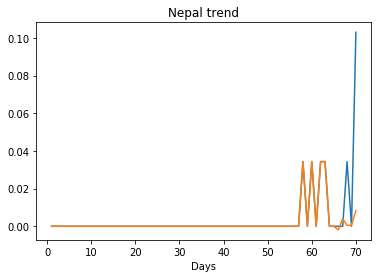

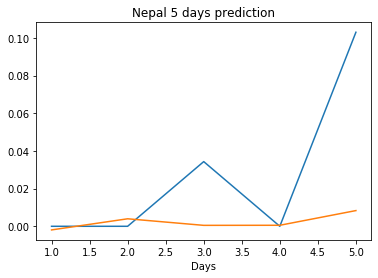

Creating directory ./offline6/Sri Lanka/training/
Sri Lanka
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0152
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0117


/space/home/nzhang/anaconda3/envs/neuralnet/lib/python3.7/site-packages/torch/nn/modules/loss.py:431: UserWarning: Using a target size (torch.Size([1, 1, 5])) that is different to the input size (torch.Size([5])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/space/home/nzhang/anaconda3/envs/neuralnet/lib/python3.7/site-packages/torch/nn/modules/loss.py:431: UserWarning: Using a target size (torch.Size([1, 5])) that is different to the input size (torch.Size([5])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Saving the best model weights at Epoch [4], Best Valid Loss: 0.0105
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0101
train error: 0.03651303651206421
0.010112318210303783
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0158
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0140
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0140
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0136
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0123
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0121
train error: 0.03194842740865142
0.012117763049900532
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0180
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0059
train error: 0.022711876529325364
0.005945459473878145
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0232
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0171
Saving the best mo

train error: 0.05179658111636386
0.00908088218420744
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0173
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0124
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0106
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0076
train error: 0.05647776704846007
0.007615573704242706
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0171
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0131
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0114
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0113
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0107
train error: 0.04966500782492486
0.010715889744460583
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0166
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0143
Saving the best mod

Saving the best model weights at Epoch [2], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0101
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0081
train error: 0.05136710532348265
0.00810748990625143
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0228
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0140
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0070
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0047
train error: 0.054206120696934784
0.0046965437941253185
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0111
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0108
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0104
train error: 0.05008950657352353
0.010405370965600014
Saving the best m

Saving the best model weights at Epoch [6], Best Valid Loss: 0.0162
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0150
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0142
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0136
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0130
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0126
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0123
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0121
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0119
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0118
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0117
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0115
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0115
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0114
Saving the best model weights at Epoch

Saving the best model weights at Epoch [18], Best Valid Loss: 0.0134
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0133
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0133
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0132
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0132
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0132
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0132
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0131
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0131
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0131
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0131
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0130
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0130
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0130
Saving the best model weights at E

Saving the best model weights at Epoch [24], Best Valid Loss: 0.0131
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0131
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0131
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0130
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0130
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0130
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0130
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0129
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0129
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0129
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0129
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0129
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0129
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0129
train error: 0.04810451033214728
0

Saving the best model weights at Epoch [6], Best Valid Loss: 0.0165
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0153
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0142
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0137
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0133
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0130
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0130
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0126
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0126
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0124
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0123
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0123
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0123
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0121
Saving the best model weights at Epoch

Saving the best model weights at Epoch [4], Best Valid Loss: 0.0268
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0239
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0217
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0200
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0175
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0165
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0158
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0152
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0147
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0143
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0139
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0137
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0135
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [7], Best Valid Loss: 0.0111
train error: 0.048173137037365726
0.011108134873211384
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0733
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0485
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0341
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0256
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0205
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0178
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0158
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0146
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0140
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0135
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0131
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0129
Saving the best model weights at Epoch [13], Best Valid Lo

Saving the best model weights at Epoch [33], Best Valid Loss: 0.0122
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0122
train error: 0.04817424872607896
0.012243421748280525
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0276
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0214
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0178
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0154
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0142
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0134
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0130
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0126
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0124
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0123
Saving the best model weights at Epoch [15], Best Valid Lo

Saving the best model weights at Epoch [34], Best Valid Loss: 0.0123
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0122
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0121
train error: 0.04832657206464897
0.01206772681325674
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0233
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0117
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0108
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0104
train error: 0.04873695673251694
0.01043296791613102
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0552
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0455
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0382
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0325
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0282
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0249
Saving

Saving the best model weights at Epoch [2], Best Valid Loss: 0.0114
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0108
train error: 0.04921122135199381
0.01078601460903883
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0371
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0306
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0260
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0226
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0201
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0182
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0167
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0156
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0148
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0142
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0138
Saving the best model weights at Epoch [12], Best Valid Loss

Saving the best model weights at Epoch [6], Best Valid Loss: 0.0760
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0728
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0697
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0668
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0641
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0615
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0589
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0566
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0544
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0524
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0503
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0485
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0466
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0449
Saving the best model weights at Epoch

Saving the best model weights at Epoch [42], Best Valid Loss: 0.0329
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0323
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0318
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0313
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0308
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0303
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0299
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0294
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0290
train error: 0.056854904890342645
0.028982440009713173
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0507
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0484
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0462
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0442
Saving the best model weights at Epoch [5], Best Val

Saving the best model weights at Epoch [32], Best Valid Loss: 0.0483
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0475
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0467
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0459
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0452
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0444
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0437
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0430
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0423
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0417
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0410
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0404
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0398
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0392
Saving the best model weights at E

Saving the best model weights at Epoch [18], Best Valid Loss: 0.0340
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0334
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0329
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0324
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0318
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0313
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0308
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0304
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0299
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0295
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0290
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0286
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0282
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0278
Saving the best model weights at E

Saving the best model weights at Epoch [12], Best Valid Loss: 0.0688
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0668
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0649
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0630
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0612
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0595
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0578
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0562
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0546
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0531
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0516
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0502
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0488
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0474
Saving the best model weights at E

Saving the best model weights at Epoch [34], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0126
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0126
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0124
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0123
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0121
train error: 0.047976606779477814
0.012092492543160915
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0455
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0446
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0438
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0429
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0421
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0413
Saving the best model weights at Epoch [7], Best Valid

Saving the best model weights at Epoch [13], Best Valid Loss: 0.0140
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0139
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0133
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0131
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0131
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0129
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0129
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0126
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0125
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0123
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0123
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0122
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0122
Saving the best model weights at E

Saving the best model weights at Epoch [1], Best Valid Loss: 0.0509
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0422
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0357
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0302
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0270
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0237
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0211
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0193
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0180
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0165
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0159
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0154
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0147
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0142
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [40], Best Valid Loss: 0.0150
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0149
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0147
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0145
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0144
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0143
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0141
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0140
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0139
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0138
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0137
train error: 0.049855210465576616
0.013713057152926922
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0632
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0522
Saving the best model weights at Epoch [3], Best V

Saving the best model weights at Epoch [26], Best Valid Loss: 0.0287
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0280
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0274
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0268
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0262
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0257
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0252
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0247
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0242
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0237
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0233
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0229
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0224
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0221
Saving the best model weights at E

Saving the best model weights at Epoch [9], Best Valid Loss: 0.0539
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0519
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0502
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0484
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0468
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0452
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0437
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0424
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0410
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0397
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0385
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0373
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0362
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0352
Saving the best model weights at Ep

Saving the best model weights at Epoch [20], Best Valid Loss: 0.0276
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0268
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0261
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0254
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0248
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0241
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0235
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0230
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0224
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0219
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0215
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0210
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0206
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0202
Saving the best model weights at E

Saving the best model weights at Epoch [16], Best Valid Loss: 0.0252
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0246
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0239
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0234
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0228
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0223
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0218
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0213
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0208
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0204
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0200
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0196
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0193
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0189
Saving the best model weights at E

Saving the best model weights at Epoch [20], Best Valid Loss: 0.0203
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0200
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0196
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0193
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0191
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0187
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0185
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0182
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0180
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0178
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0175
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0173
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0171
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0169
Saving the best model weights at E

Saving the best model weights at Epoch [8], Best Valid Loss: 0.0419
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0402
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0388
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0372
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0359
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0346
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0334
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0322
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0311
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0301
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0292
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0282
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0274
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0266
Saving the best model weights at Epo

Saving the best model weights at Epoch [46], Best Valid Loss: 0.0197
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0194
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0192
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0190
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0188
train error: 0.053849960253997284
0.018822653219103813
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0697
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0668
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0640
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0614
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0588
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0565
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0542
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0520
Saving the best model weights at Epoch [9], Best Valid L

Saving the best model weights at Epoch [36], Best Valid Loss: 0.0227
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0225
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0222
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0220
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0217
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0215
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0213
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0211
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0209
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0206
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0204
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0202
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0200
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0199
Saving the best model weights at E

Saving the best model weights at Epoch [32], Best Valid Loss: 0.0275
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0272
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0268
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0264
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0261
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0257
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0254
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0251
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0248
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0245
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0242
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0239
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0236
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0233
Saving the best model weights at E

Saving the best model weights at Epoch [20], Best Valid Loss: 0.0301
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0297
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0293
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0288
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0284
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0280
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0276
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0272
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0269
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0265
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0261
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0258
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0255
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0251
Saving the best model weights at E

Saving the best model weights at Epoch [4], Best Valid Loss: 0.0574
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0561
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0548
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0536
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0524
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0512
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0501
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0490
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0479
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0469
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0459
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0450
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0440
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0431
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [26], Best Valid Loss: 0.0125
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0125
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0123
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0123
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0123
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0122
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0121
train error: 0.04810651225235426
0.0121230473741889
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0506
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0497
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0488
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0479
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0471
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0463
Saving the best model weights at Epoch [7], Best Valid Lo

Saving the best model weights at Epoch [12], Best Valid Loss: 0.0138
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0133
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0132
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0129
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0128
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0125
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0123
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0123
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0121
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0121
train error: 0.04805803866210309
0.012059412896633148
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0840
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0838
Saving the best model weights at Epoch [3], Best Va

Saving the best model weights at Epoch [8], Best Valid Loss: 0.0821
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0798
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0778
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0758
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0739
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0720
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0703
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0684
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0667
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0651
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0635
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0619
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0604
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0591
Saving the best model weights at Epo

Saving the best model weights at Epoch [27], Best Valid Loss: 0.0481
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0480
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0478
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0477
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0475
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0473
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0472
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0471
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0469
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0468
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0466
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0465
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0463
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0462
Saving the best model weights at E

Saving the best model weights at Epoch [46], Best Valid Loss: 0.0828
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0826
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0824
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0822
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0820
train error: 0.10033474309426366
0.08199580013751984
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0699
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0696
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0693
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0690
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0687
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0684
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0681
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0678
Saving the best model weights at Epoch [9], Best Valid Los

Saving the best model weights at Epoch [14], Best Valid Loss: 0.0484
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0483
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0482
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0481
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0480
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0479
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0478
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0477
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0476
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0475
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0474
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0473
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0472
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0471
Saving the best model weights at E

Saving the best model weights at Epoch [34], Best Valid Loss: 0.0319
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0314
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0310
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0305
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0301
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0296
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0292
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0288
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0284
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0280
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0277
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0273
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0270
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0266
Saving the best model weights at E

Saving the best model weights at Epoch [1], Best Valid Loss: 0.1780
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1737
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1695
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1655
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1612
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1575
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1535
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1498
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1463
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1428
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1393
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1360
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1329
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1297
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [21], Best Valid Loss: 0.0345
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0344
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0343
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0342
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0341
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0339
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0338
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0337
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0336
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0335
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0334
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0333
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0332
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0330
Saving the best model weights at E

Saving the best model weights at Epoch [41], Best Valid Loss: 0.0476
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0475
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0474
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0474
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0473
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0472
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0471
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0470
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0469
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0468
train error: 0.06961906917223876
0.04680372402071953
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0477
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0475
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0473
Saving the best model weights at Epoch [4], Best Vali

Saving the best model weights at Epoch [8], Best Valid Loss: 0.0350
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0349
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0349
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0348
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0347
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0347
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0346
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0345
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0344
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0344
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0343
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0342
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0341
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0341
Saving the best model weights at Epo

Saving the best model weights at Epoch [28], Best Valid Loss: 0.0240
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0238
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0235
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0232
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0230
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0228
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0225
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0223
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0221
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0218
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0216
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0215
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0212
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0210
Saving the best model weights at E

Saving the best model weights at Epoch [46], Best Valid Loss: 0.1060
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1056
Saving the best model weights at Epoch [48], Best Valid Loss: 0.1052
Saving the best model weights at Epoch [49], Best Valid Loss: 0.1048
Saving the best model weights at Epoch [50], Best Valid Loss: 0.1043
train error: 0.10139389065178958
0.10433981567621231
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1333
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1301
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1269
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1238
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1208
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1178
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1150
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1121
Saving the best model weights at Epoch [9], Best Valid Los

Saving the best model weights at Epoch [13], Best Valid Loss: 0.0353
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0351
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0350
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0349
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0348
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0347
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0345
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0344
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0343
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0342
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0341
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0339
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0338
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0337
Saving the best model weights at E

Saving the best model weights at Epoch [31], Best Valid Loss: 0.0476
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0475
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0474
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0473
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0472
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0471
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0470
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0469
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0468
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0467
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0466
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0465
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0464
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0463
Saving the best model weights at E

Saving the best model weights at Epoch [49], Best Valid Loss: 0.0292
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0289
train error: 0.05491616698264173
0.02888837456703186
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0294
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0294
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0293
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0293
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0292
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0292
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0291
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0291
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0290
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0290
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0289
Saving the best model weights at Epoch [12], Best Valid Los

Saving the best model weights at Epoch [16], Best Valid Loss: 0.0278
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0275
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0272
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0269
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0266
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0263
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0260
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0257
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0255
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0252
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0249
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0246
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0244
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0241
Saving the best model weights at E

Saving the best model weights at Epoch [34], Best Valid Loss: 0.0523
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0521
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0519
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0517
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0515
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0513
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0511
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0510
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0508
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0506
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0504
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0502
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0500
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0498
Saving the best model weights at E

Saving the best model weights at Epoch [2], Best Valid Loss: 0.0649
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0647
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0644
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0642
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0640
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0637
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0635
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0633
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0630
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0628
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0626
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0623
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0621
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0619
Saving the best model weights at Epoch [16

Saving the best model weights at Epoch [20], Best Valid Loss: 0.0448
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0447
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0447
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0446
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0445
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0444
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0444
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0443
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0442
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0441
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0441
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0440
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0439
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0438
Saving the best model weights at E

Saving the best model weights at Epoch [38], Best Valid Loss: 0.0359
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0353
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0348
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0342
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0337
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0333
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0328
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0323
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0319
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0315
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0310
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0306
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0303
train error: 0.058403089198029855
0.030252976343035698
Saving the best model weights at Epoch [1], Best

Saving the best model weights at Epoch [6], Best Valid Loss: 0.0353
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0347
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0342
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0338
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0332
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0328
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0323
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0318
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0314
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0310
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0306
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0302
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0299
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0294
Saving the best model weights at Epoch

Saving the best model weights at Epoch [24], Best Valid Loss: 0.0773
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0770
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0766
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0763
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0759
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0756
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0752
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0749
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0745
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0742
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0738
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0735
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0732
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0728
Saving the best model weights at E

Saving the best model weights at Epoch [42], Best Valid Loss: 0.0670
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0669
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0667
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0666
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0664
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0663
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0661
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0660
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0659
train error: 0.08401526640536207
0.06585510820150375
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1012
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1008
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1003
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0999
Saving the best model weights at Epoch [5], Best Valid

Saving the best model weights at Epoch [10], Best Valid Loss: 0.0623
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0621
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0620
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0618
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0617
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0615
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0614
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0613
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0611
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0610
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0608
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0607
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0605
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0604
Saving the best model weights at E

Saving the best model weights at Epoch [28], Best Valid Loss: 0.0431
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0424
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0417
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0409
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0403
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0396
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0389
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0382
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0376
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0370
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0364
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0358
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0353
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0347
Saving the best model weights at E

Saving the best model weights at Epoch [46], Best Valid Loss: 0.0433
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0431
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0430
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0428
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0427
train error: 0.06778561927476955
0.04269086569547653
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0467
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0458
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0452
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0443
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0435
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0427
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0420
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0412
Saving the best model weights at Epoch [9], Best Valid Los

Saving the best model weights at Epoch [15], Best Valid Loss: 0.0868
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0868
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0868
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0867
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0867
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0866
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0866
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0866
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0865
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0865
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0865
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0864
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0864
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0863
Saving the best model weights at E

Saving the best model weights at Epoch [33], Best Valid Loss: 0.0305
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0305
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0305
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0305
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0305
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0305
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0305
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0305
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0304
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0304
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0304
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0304
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0304
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0304
Saving the best model weights at E

Saving the best model weights at Epoch [1], Best Valid Loss: 0.0372
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0372
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0372
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0372
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0372
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0372
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0372
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0372
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0372
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0372
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0371
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0371
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0371
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0371
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [21], Best Valid Loss: 0.0211
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0210
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0210
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0209
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0209
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0208
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0208
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0208
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0207
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0207
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0206
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0206
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0205
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0205
Saving the best model weights at E

Saving the best model weights at Epoch [41], Best Valid Loss: 0.0368
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0368
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0368
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0368
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0368
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0368
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0367
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0367
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0367
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0367
train error: 0.0634675047247473
0.036710094660520554
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0527
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0526
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0525
Saving the best model weights at Epoch [4], Best Vali

Saving the best model weights at Epoch [10], Best Valid Loss: 0.1772
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1771
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1770
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1769
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1768
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1768
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1767
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1766
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1765
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1764
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1764
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1763
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1762
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1761
Saving the best model weights at E

Saving the best model weights at Epoch [29], Best Valid Loss: 0.0404
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0404
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0404
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0404
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0404
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0403
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0403
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0403
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0403
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0403
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0403
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0403
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0403
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0403
Saving the best model weights at E

Saving the best model weights at Epoch [49], Best Valid Loss: 0.0474
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0473
train error: 0.06643678634568598
0.04728400334715843
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0581
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0580
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0580
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0580
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0580
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0580
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0580
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0580
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0579
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0579
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0579
Saving the best model weights at Epoch [12], Best Valid Los

Saving the best model weights at Epoch [16], Best Valid Loss: 0.0409
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0408
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0408
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0407
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0406
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0405
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0405
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0404
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0403
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0403
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0402
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0401
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0401
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0400
Saving the best model weights at E

Saving the best model weights at Epoch [36], Best Valid Loss: 0.0498
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0498
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0498
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0497
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0497
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0497
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0497
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0497
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0496
Saving the best model weights at E

Saving the best model weights at Epoch [3], Best Valid Loss: 0.1141
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1141
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1140
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1140
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1139
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1139
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1138
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1138
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1137
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1137
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1136
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1136
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1135
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1135
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [21], Best Valid Loss: 0.0473
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0473
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0473
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0473
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0473
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0473
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0473
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0473
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0472
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0472
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0472
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0472
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0472
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0472
Saving the best model weights at E

Saving the best model weights at Epoch [39], Best Valid Loss: 0.0206
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0206
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0205
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0205
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0204
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0204
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0204
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0203
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0203
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0202
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0202
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0202
train error: 0.06659956183284521
0.020174412056803703
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0675
Saving the best model weights at Epoch [2], Best V

Saving the best model weights at Epoch [7], Best Valid Loss: 0.0661
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0659
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0658
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0656
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0655
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0653
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0652
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0651
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0649
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0648
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0646
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0645
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0643
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0642
Saving the best model weights at Epoc

Saving the best model weights at Epoch [26], Best Valid Loss: 0.0456
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0456
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0456
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0455
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0455
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0455
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0455
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0455
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0455
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0454
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0454
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0454
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0454
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0454
Saving the best model weights at E

Saving the best model weights at Epoch [45], Best Valid Loss: 0.0331
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0331
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0331
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0331
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0331
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0331
train error: 0.07353261338941978
0.03305432200431824
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0737
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0737
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0736
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0736
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0736
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0735
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0735
Saving the best model weights at Epoch [8], Best Valid Lo

Saving the best model weights at Epoch [13], Best Valid Loss: 0.0915
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0915
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0914
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0914
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0914
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0914
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0914
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0913
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0913
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0913
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0913
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0912
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0912
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0912
Saving the best model weights at E

Saving the best model weights at Epoch [31], Best Valid Loss: 0.0926
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0924
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0922
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0921
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0919
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0917
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0915
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0913
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0911
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0910
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0908
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0906
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0904
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0902
Saving the best model weights at E

Saving the best model weights at Epoch [49], Best Valid Loss: 0.0844
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0844
train error: 0.10005038372720733
0.084377720952034
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0475
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0474
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0474
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0473
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0472
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0471
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0470
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0469
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0469
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0468
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0467
Saving the best model weights at Epoch [12], Best Valid Loss:

Saving the best model weights at Epoch [17], Best Valid Loss: 0.0320
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0320
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0320
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0320
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0319
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0319
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0319
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0319
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0319
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0319
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0319
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0319
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0319
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0318
Saving the best model weights at E

Saving the best model weights at Epoch [35], Best Valid Loss: 0.0195
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0195
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0195
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0195
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0195
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0195
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0195
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0195
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0195
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0195
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0195
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0195
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0195
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0195
Saving the best model weights at E

Saving the best model weights at Epoch [3], Best Valid Loss: 0.0708
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0708
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0708
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0708
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0708
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0707
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0707
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0707
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0707
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0707
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0707
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0706
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0706
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0706
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [21], Best Valid Loss: 0.0915
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0913
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0911
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0910
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0908
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0906
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0904
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0903
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0901
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0899
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0897
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0896
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0894
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0892
Saving the best model weights at E

Saving the best model weights at Epoch [39], Best Valid Loss: 0.0671
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0671
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0670
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0670
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0670
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0670
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0670
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0669
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0669
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0669
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0669
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0668
train error: 0.07686932698230851
0.06683357059955597
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0665
Saving the best model weights at Epoch [2], Best Va

Saving the best model weights at Epoch [7], Best Valid Loss: 0.0299
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0299
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0299
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0299
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0299
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0299
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0298
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0298
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0298
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0298
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0298
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0298
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0298
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0298
Saving the best model weights at Epoc

Saving the best model weights at Epoch [25], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0104
Saving the best model weights at E

Saving the best model weights at Epoch [45], Best Valid Loss: 0.1478
Saving the best model weights at Epoch [46], Best Valid Loss: 0.1478
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1477
Saving the best model weights at Epoch [48], Best Valid Loss: 0.1477
Saving the best model weights at Epoch [49], Best Valid Loss: 0.1476
Saving the best model weights at Epoch [50], Best Valid Loss: 0.1476
train error: 0.1544583629478108
0.14760641753673553
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0700
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0700
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0700
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0700
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0700
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0700
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0700
Saving the best model weights at Epoch [8], Best Valid Los

Saving the best model weights at Epoch [12], Best Valid Loss: 0.0817
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0817
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0817
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0817
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0816
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0816
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0816
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0816
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0816
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0816
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0815
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0815
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0815
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0815
Saving the best model weights at E

Saving the best model weights at Epoch [32], Best Valid Loss: 0.0682
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0682
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0682
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0682
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0682
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0682
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0682
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0682
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0682
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0682
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0682
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0682
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0682
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0682
Saving the best model weights at E

Saving the best model weights at Epoch [2], Best Valid Loss: 0.0748
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0748
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0748
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0748
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0748
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0748
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0748
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0748
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0748
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0748
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0748
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0748
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0748
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0748
Saving the best model weights at Epoch [16

Saving the best model weights at Epoch [22], Best Valid Loss: 0.1364
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1364
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1364
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1364
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1364
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1364
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1364
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1364
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1364
Saving the best model weights at Epoch [31], Best Valid Loss: 0.1364
Saving the best model weights at Epoch [32], Best Valid Loss: 0.1364
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1364
Saving the best model weights at Epoch [34], Best Valid Loss: 0.1364
Saving the best model weights at Epoch [35], Best Valid Loss: 0.1363
Saving the best model weights at E

Saving the best model weights at Epoch [42], Best Valid Loss: 0.0660
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0660
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0660
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0660
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0660
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0660
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0660
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0660
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0659
train error: 0.07557007111608982
0.06594911217689514
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0678
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0678
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0678
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0678
Saving the best model weights at Epoch [5], Best Valid

Saving the best model weights at Epoch [9], Best Valid Loss: 0.1239
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1239
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1239
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1238
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1238
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1238
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1238
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1237
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1237
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1237
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1236
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1236
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1236
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1236
Saving the best model weights at Ep

Saving the best model weights at Epoch [29], Best Valid Loss: 0.0472
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0472
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0472
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0472
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0472
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0472
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0472
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0472
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0472
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0472
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0472
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0472
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0472
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0472
Saving the best model weights at E

Saving the best model weights at Epoch [49], Best Valid Loss: 0.0516
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0516
train error: 0.07590511547768432
0.051640093326568604
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0348
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0348
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0347
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0347
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0347
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0347
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0347
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0347
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0347
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0347
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0347
Saving the best model weights at Epoch [12], Best Valid Lo

Saving the best model weights at Epoch [17], Best Valid Loss: 0.0486
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0486
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0486
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0486
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0486
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0486
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0486
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0486
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0486
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0486
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0486
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0486
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0486
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0486
Saving the best model weights at E

Saving the best model weights at Epoch [36], Best Valid Loss: 0.0357
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0357
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0357
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0357
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0356
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0356
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0356
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0356
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0356
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0356
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0356
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0356
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0356
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0356
Saving the best model weights at E

Saving the best model weights at Epoch [3], Best Valid Loss: 0.0727
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0727
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0727
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0727
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0727
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0727
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0726
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0726
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0726
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0726
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0726
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0726
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0725
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0725
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [21], Best Valid Loss: 0.0513
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0513
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0513
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0513
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0513
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0513
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0513
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0513
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0513
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0513
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0513
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0513
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0513
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0513
Saving the best model weights at E

Saving the best model weights at Epoch [39], Best Valid Loss: 0.0393
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0393
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0393
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0393
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0393
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0393
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0393
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0393
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0393
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0393
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0393
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0393
train error: 0.06341968611531863
0.03934125974774361
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0485
Saving the best model weights at Epoch [2], Best Va

Saving the best model weights at Epoch [7], Best Valid Loss: 0.0040
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0040
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0040
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0040
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0040
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0040
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0040
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0040
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0040
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0040
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0040
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0040
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0040
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0040
Saving the best model weights at Epoc

Saving the best model weights at Epoch [25], Best Valid Loss: 0.0732
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0732
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0732
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0732
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0732
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0732
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0731
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0731
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0731
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0731
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0731
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0731
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0731
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0731
Saving the best model weights at E

Saving the best model weights at Epoch [43], Best Valid Loss: 0.0378
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0378
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0378
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0378
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0378
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0378
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0378
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0378
train error: 0.0779778127643195
0.037765566259622574
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0652
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0652
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0652
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0651
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0651
Saving the best model weights at Epoch [6], Best Valid 

Saving the best model weights at Epoch [11], Best Valid Loss: 0.0923
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0923
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0923
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0923
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0923
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0922
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0922
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0922
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0922
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0922
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0922
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0922
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0922
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0922
Saving the best model weights at E

Saving the best model weights at Epoch [29], Best Valid Loss: 0.0666
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0666
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0666
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0666
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0666
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0666
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0666
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0666
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0666
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0666
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0666
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0666
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0666
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0666
Saving the best model weights at E

Saving the best model weights at Epoch [47], Best Valid Loss: 0.0318
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0318
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0318
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0318
train error: 0.05523522827548511
0.031785931438207626
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0888
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0888
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0888
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0888
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0888
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0888
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0888
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0888
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0888
Saving the best model weights at Epoch [10], Best Valid Lo

Saving the best model weights at Epoch [15], Best Valid Loss: 0.0237
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0237
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0237
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0237
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0237
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0237
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0237
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0237
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0237
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0237
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0237
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0237
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0237
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0237
Saving the best model weights at E

Saving the best model weights at Epoch [33], Best Valid Loss: 0.0821
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0821
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0821
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0821
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0821
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0821
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0821
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0821
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0821
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0821
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0821
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0821
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0821
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0821
Saving the best model weights at E

Saving the best model weights at Epoch [1], Best Valid Loss: 0.0374
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0374
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0374
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0374
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0374
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0374
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0374
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0374
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0374
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0374
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0374
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0374
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0374
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0374
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [19], Best Valid Loss: 0.0351
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0351
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0351
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0351
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0351
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0351
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0351
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0351
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0351
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0351
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0351
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0351
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0351
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0351
Saving the best model weights at E

Saving the best model weights at Epoch [37], Best Valid Loss: 0.0625
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0625
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0625
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0625
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0624
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0624
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0624
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0624
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0624
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0624
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0624
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0624
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0624
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0623
train error: 0.07924577519015381
0

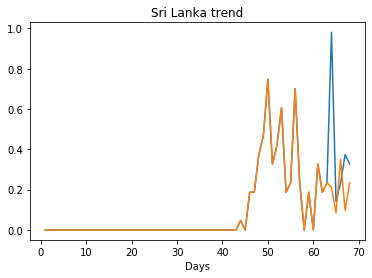

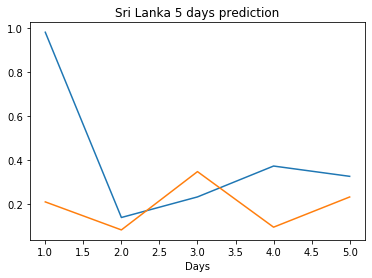

Creating directory ./offline6/Taiwan*/training/
Taiwan*
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1123
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0748


/space/home/nzhang/anaconda3/envs/neuralnet/lib/python3.7/site-packages/torch/nn/modules/loss.py:431: UserWarning: Using a target size (torch.Size([1, 1, 5])) that is different to the input size (torch.Size([5])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/space/home/nzhang/anaconda3/envs/neuralnet/lib/python3.7/site-packages/torch/nn/modules/loss.py:431: UserWarning: Using a target size (torch.Size([1, 5])) that is different to the input size (torch.Size([5])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Saving the best model weights at Epoch [3], Best Valid Loss: 0.0682
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0544
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0443
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0389
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0283
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0170
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0166
train error: 0.036825665842594675
0.01663375459611416
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1169
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1042
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0647
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0549
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0191
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0174
train error: 0.028073008242675935
0.017399996519088745
Saving 

train error: 0.0246629411857085
0.015765801072120667
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1610
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1371
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1321
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1306
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1204
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1114
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1088
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0948
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0910
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0826
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0608
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0455
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0377
Saving the best model weights at Epoch [48], Best Valid

Saving the best model weights at Epoch [2], Best Valid Loss: 0.0967
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0841
train error: 0.12385588781417985
0.0841074138879776
Saving the best model weights at Epoch [1], Best Valid Loss: 0.2211
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0310
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0201
train error: 0.1408075988782864
0.020089002326130867
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1274
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1141
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1056
Saving the best model weights at Epoch [44], Best Valid Loss: 0.1017
train error: 0.12359502352774143
0.10167481750249863
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1929
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1367
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1267
Saving the best model w

Saving the best model weights at Epoch [28], Best Valid Loss: 0.0783
train error: 0.12344324262812734
0.07826197892427444
Saving the best model weights at Epoch [1], Best Valid Loss: 0.3294
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1808
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1524
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1003
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0350
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0323
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0180
train error: 0.1488170555400613
0.017956217750906944
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1916
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1268
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1173
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1166
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1031
Saving

Saving the best model weights at Epoch [13], Best Valid Loss: 0.0960
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0936
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0907
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0887
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0876
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0849
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0837
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0798
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0781
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0752
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0738
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0722
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0714
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0701
Saving the best model weights at E

Saving the best model weights at Epoch [19], Best Valid Loss: 0.1168
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1165
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1140
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1111
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1097
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1066
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1049
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1037
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0999
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0987
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0971
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0949
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0932
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0892
Saving the best model weights at E

Saving the best model weights at Epoch [25], Best Valid Loss: 0.0538
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0518
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0499
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0464
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0443
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0420
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0393
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0375
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0355
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0334
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0317
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0303
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0281
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0268
Saving the best model weights at E

Saving the best model weights at Epoch [34], Best Valid Loss: 0.0324
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0312
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0281
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0271
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0256
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0224
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0208
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0191
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0175
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0161
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0145
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0134
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0121
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0115
Saving the best model weights at E

Saving the best model weights at Epoch [25], Best Valid Loss: 0.1325
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1320
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1316
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1316
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1313
Saving the best model weights at Epoch [34], Best Valid Loss: 0.1307
Saving the best model weights at Epoch [37], Best Valid Loss: 0.1304
Saving the best model weights at Epoch [38], Best Valid Loss: 0.1303
Saving the best model weights at Epoch [39], Best Valid Loss: 0.1302
Saving the best model weights at Epoch [40], Best Valid Loss: 0.1297
Saving the best model weights at Epoch [45], Best Valid Loss: 0.1295
Saving the best model weights at Epoch [46], Best Valid Loss: 0.1292
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1292
Saving the best model weights at Epoch [50], Best Valid Loss: 0.1290
train error: 0.11976847608916853
0

Saving the best model weights at Epoch [20], Best Valid Loss: 0.1048
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0974
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0864
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0784
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0783
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0628
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0626
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0548
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0485
train error: 0.0998534146990431
0.04848599433898926
Saving the best model weights at Epoch [1], Best Valid Loss: 0.3233
Saving the best model weights at Epoch [2], Best Valid Loss: 0.2833
Saving the best model weights at Epoch [3], Best Valid Loss: 0.2525
Saving the best model weights at Epoch [4], Best Valid Loss: 0.2276
Saving the best model weights at Epoch [5], Best Valid 

Saving the best model weights at Epoch [39], Best Valid Loss: 0.1293
Saving the best model weights at Epoch [48], Best Valid Loss: 0.1292
Saving the best model weights at Epoch [49], Best Valid Loss: 0.1289
Saving the best model weights at Epoch [50], Best Valid Loss: 0.1282
train error: 0.1197472128183826
0.1281643956899643
Saving the best model weights at Epoch [1], Best Valid Loss: 0.2528
Saving the best model weights at Epoch [2], Best Valid Loss: 0.2142
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1893
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1725
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1601
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1502
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1453
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1418
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1379
Saving the best model weights at Epoch [10], Best Valid Loss:

Saving the best model weights at Epoch [4], Best Valid Loss: 0.1734
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1630
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1521
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1445
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1399
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1358
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1334
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1328
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1318
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1301
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1293
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1278
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1277
train error: 0.12014667873613928
0.12772880494594574
Saving the best model weights at Epoch [1], Best Valid L

Saving the best model weights at Epoch [47], Best Valid Loss: 0.1293
Saving the best model weights at Epoch [48], Best Valid Loss: 0.1292
Saving the best model weights at Epoch [49], Best Valid Loss: 0.1290
Saving the best model weights at Epoch [50], Best Valid Loss: 0.1284
train error: 0.1198680630002759
0.12844745814800262
Saving the best model weights at Epoch [1], Best Valid Loss: 0.3116
Saving the best model weights at Epoch [2], Best Valid Loss: 0.2492
Saving the best model weights at Epoch [3], Best Valid Loss: 0.2104
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1857
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1687
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1580
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1499
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1438
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1420
Saving the best model weights at Epoch [10], Best Valid Loss

Saving the best model weights at Epoch [32], Best Valid Loss: 0.1302
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1297
Saving the best model weights at Epoch [35], Best Valid Loss: 0.1293
train error: 0.11992397257371952
0.12930260598659515
Saving the best model weights at Epoch [1], Best Valid Loss: 0.3201
Saving the best model weights at Epoch [2], Best Valid Loss: 0.2543
Saving the best model weights at Epoch [3], Best Valid Loss: 0.2153
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1873
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1689
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1573
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1486
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1431
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1405
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1372
Saving the best model weights at Epoch [11], Best Valid Los

Saving the best model weights at Epoch [4], Best Valid Loss: 0.1885
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1710
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1576
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1502
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1446
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1397
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1374
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1331
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1314
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1309
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1302
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1294
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1288
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1280
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [2], Best Valid Loss: 0.2559
Saving the best model weights at Epoch [3], Best Valid Loss: 0.2142
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1898
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1666
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1560
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1468
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1432
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1371
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1370
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1351
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1316
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1306
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1303
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1272
Saving the best model weights at Epoch [21

Saving the best model weights at Epoch [48], Best Valid Loss: 0.1893
Saving the best model weights at Epoch [49], Best Valid Loss: 0.1879
Saving the best model weights at Epoch [50], Best Valid Loss: 0.1866
train error: 0.1301642428642433
0.18655171990394592
Saving the best model weights at Epoch [1], Best Valid Loss: 0.4345
Saving the best model weights at Epoch [2], Best Valid Loss: 0.4188
Saving the best model weights at Epoch [3], Best Valid Loss: 0.4038
Saving the best model weights at Epoch [4], Best Valid Loss: 0.3899
Saving the best model weights at Epoch [5], Best Valid Loss: 0.3768
Saving the best model weights at Epoch [6], Best Valid Loss: 0.3640
Saving the best model weights at Epoch [7], Best Valid Loss: 0.3516
Saving the best model weights at Epoch [8], Best Valid Loss: 0.3403
Saving the best model weights at Epoch [9], Best Valid Loss: 0.3298
Saving the best model weights at Epoch [10], Best Valid Loss: 0.3193
Saving the best model weights at Epoch [11], Best Valid Loss

Saving the best model weights at Epoch [24], Best Valid Loss: 0.2850
Saving the best model weights at Epoch [25], Best Valid Loss: 0.2810
Saving the best model weights at Epoch [26], Best Valid Loss: 0.2772
Saving the best model weights at Epoch [27], Best Valid Loss: 0.2734
Saving the best model weights at Epoch [28], Best Valid Loss: 0.2698
Saving the best model weights at Epoch [29], Best Valid Loss: 0.2662
Saving the best model weights at Epoch [30], Best Valid Loss: 0.2627
Saving the best model weights at Epoch [31], Best Valid Loss: 0.2593
Saving the best model weights at Epoch [32], Best Valid Loss: 0.2560
Saving the best model weights at Epoch [33], Best Valid Loss: 0.2528
Saving the best model weights at Epoch [34], Best Valid Loss: 0.2496
Saving the best model weights at Epoch [35], Best Valid Loss: 0.2465
Saving the best model weights at Epoch [36], Best Valid Loss: 0.2436
Saving the best model weights at Epoch [37], Best Valid Loss: 0.2406
Saving the best model weights at E

Saving the best model weights at Epoch [3], Best Valid Loss: 0.3675
Saving the best model weights at Epoch [4], Best Valid Loss: 0.3608
Saving the best model weights at Epoch [5], Best Valid Loss: 0.3544
Saving the best model weights at Epoch [6], Best Valid Loss: 0.3483
Saving the best model weights at Epoch [7], Best Valid Loss: 0.3422
Saving the best model weights at Epoch [8], Best Valid Loss: 0.3363
Saving the best model weights at Epoch [9], Best Valid Loss: 0.3306
Saving the best model weights at Epoch [10], Best Valid Loss: 0.3250
Saving the best model weights at Epoch [11], Best Valid Loss: 0.3196
Saving the best model weights at Epoch [12], Best Valid Loss: 0.3143
Saving the best model weights at Epoch [13], Best Valid Loss: 0.3091
Saving the best model weights at Epoch [14], Best Valid Loss: 0.3042
Saving the best model weights at Epoch [15], Best Valid Loss: 0.2993
Saving the best model weights at Epoch [16], Best Valid Loss: 0.2945
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [22], Best Valid Loss: 0.1035
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1033
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1026
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0975
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0970
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0932
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0913
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0900
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0896
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0881
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0869
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0857
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0848
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0840
Saving the best model weights at E

Saving the best model weights at Epoch [49], Best Valid Loss: 0.1482
Saving the best model weights at Epoch [50], Best Valid Loss: 0.1469
train error: 0.11878748132700198
0.1468580663204193
Saving the best model weights at Epoch [1], Best Valid Loss: 0.3467
Saving the best model weights at Epoch [2], Best Valid Loss: 0.2997
Saving the best model weights at Epoch [3], Best Valid Loss: 0.2608
Saving the best model weights at Epoch [4], Best Valid Loss: 0.2325
Saving the best model weights at Epoch [5], Best Valid Loss: 0.2080
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1884
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1751
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1634
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1541
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1487
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1382
Saving the best model weights at Epoch [12], Best Valid Loss

Saving the best model weights at Epoch [23], Best Valid Loss: 0.2537
Saving the best model weights at Epoch [24], Best Valid Loss: 0.2489
Saving the best model weights at Epoch [25], Best Valid Loss: 0.2443
Saving the best model weights at Epoch [26], Best Valid Loss: 0.2400
Saving the best model weights at Epoch [27], Best Valid Loss: 0.2359
Saving the best model weights at Epoch [28], Best Valid Loss: 0.2321
Saving the best model weights at Epoch [29], Best Valid Loss: 0.2279
Saving the best model weights at Epoch [30], Best Valid Loss: 0.2244
Saving the best model weights at Epoch [31], Best Valid Loss: 0.2210
Saving the best model weights at Epoch [32], Best Valid Loss: 0.2173
Saving the best model weights at Epoch [33], Best Valid Loss: 0.2140
Saving the best model weights at Epoch [34], Best Valid Loss: 0.2110
Saving the best model weights at Epoch [35], Best Valid Loss: 0.2081
Saving the best model weights at Epoch [36], Best Valid Loss: 0.2052
Saving the best model weights at E

Saving the best model weights at Epoch [18], Best Valid Loss: 0.2703
Saving the best model weights at Epoch [19], Best Valid Loss: 0.2650
Saving the best model weights at Epoch [20], Best Valid Loss: 0.2595
Saving the best model weights at Epoch [21], Best Valid Loss: 0.2545
Saving the best model weights at Epoch [22], Best Valid Loss: 0.2498
Saving the best model weights at Epoch [23], Best Valid Loss: 0.2453
Saving the best model weights at Epoch [24], Best Valid Loss: 0.2407
Saving the best model weights at Epoch [25], Best Valid Loss: 0.2366
Saving the best model weights at Epoch [26], Best Valid Loss: 0.2323
Saving the best model weights at Epoch [27], Best Valid Loss: 0.2284
Saving the best model weights at Epoch [28], Best Valid Loss: 0.2247
Saving the best model weights at Epoch [29], Best Valid Loss: 0.2211
Saving the best model weights at Epoch [30], Best Valid Loss: 0.2178
Saving the best model weights at Epoch [31], Best Valid Loss: 0.2148
Saving the best model weights at E

Saving the best model weights at Epoch [6], Best Valid Loss: 0.2893
Saving the best model weights at Epoch [7], Best Valid Loss: 0.2827
Saving the best model weights at Epoch [8], Best Valid Loss: 0.2766
Saving the best model weights at Epoch [9], Best Valid Loss: 0.2706
Saving the best model weights at Epoch [10], Best Valid Loss: 0.2648
Saving the best model weights at Epoch [11], Best Valid Loss: 0.2594
Saving the best model weights at Epoch [12], Best Valid Loss: 0.2541
Saving the best model weights at Epoch [13], Best Valid Loss: 0.2491
Saving the best model weights at Epoch [14], Best Valid Loss: 0.2446
Saving the best model weights at Epoch [15], Best Valid Loss: 0.2398
Saving the best model weights at Epoch [16], Best Valid Loss: 0.2355
Saving the best model weights at Epoch [17], Best Valid Loss: 0.2316
Saving the best model weights at Epoch [18], Best Valid Loss: 0.2275
Saving the best model weights at Epoch [19], Best Valid Loss: 0.2236
Saving the best model weights at Epoch

Saving the best model weights at Epoch [50], Best Valid Loss: 0.2119
train error: 0.131303625916572
0.21194906532764435
Saving the best model weights at Epoch [1], Best Valid Loss: 0.3463
Saving the best model weights at Epoch [2], Best Valid Loss: 0.3373
Saving the best model weights at Epoch [3], Best Valid Loss: 0.3282
Saving the best model weights at Epoch [4], Best Valid Loss: 0.3197
Saving the best model weights at Epoch [5], Best Valid Loss: 0.3122
Saving the best model weights at Epoch [6], Best Valid Loss: 0.3041
Saving the best model weights at Epoch [7], Best Valid Loss: 0.2967
Saving the best model weights at Epoch [8], Best Valid Loss: 0.2898
Saving the best model weights at Epoch [9], Best Valid Loss: 0.2832
Saving the best model weights at Epoch [10], Best Valid Loss: 0.2771
Saving the best model weights at Epoch [11], Best Valid Loss: 0.2706
Saving the best model weights at Epoch [12], Best Valid Loss: 0.2649
Saving the best model weights at Epoch [13], Best Valid Loss:

Saving the best model weights at Epoch [44], Best Valid Loss: 0.2487
Saving the best model weights at Epoch [45], Best Valid Loss: 0.2461
Saving the best model weights at Epoch [46], Best Valid Loss: 0.2435
Saving the best model weights at Epoch [47], Best Valid Loss: 0.2410
Saving the best model weights at Epoch [48], Best Valid Loss: 0.2387
Saving the best model weights at Epoch [49], Best Valid Loss: 0.2363
Saving the best model weights at Epoch [50], Best Valid Loss: 0.2340
train error: 0.14024272409120672
0.23399782180786133
Saving the best model weights at Epoch [1], Best Valid Loss: 0.5350
Saving the best model weights at Epoch [2], Best Valid Loss: 0.5167
Saving the best model weights at Epoch [3], Best Valid Loss: 0.4995
Saving the best model weights at Epoch [4], Best Valid Loss: 0.4831
Saving the best model weights at Epoch [5], Best Valid Loss: 0.4680
Saving the best model weights at Epoch [6], Best Valid Loss: 0.4528
Saving the best model weights at Epoch [7], Best Valid L

Saving the best model weights at Epoch [34], Best Valid Loss: 0.2272
Saving the best model weights at Epoch [35], Best Valid Loss: 0.2251
Saving the best model weights at Epoch [36], Best Valid Loss: 0.2231
Saving the best model weights at Epoch [37], Best Valid Loss: 0.2211
Saving the best model weights at Epoch [38], Best Valid Loss: 0.2192
Saving the best model weights at Epoch [39], Best Valid Loss: 0.2173
Saving the best model weights at Epoch [40], Best Valid Loss: 0.2155
Saving the best model weights at Epoch [41], Best Valid Loss: 0.2137
Saving the best model weights at Epoch [42], Best Valid Loss: 0.2120
Saving the best model weights at Epoch [43], Best Valid Loss: 0.2102
Saving the best model weights at Epoch [44], Best Valid Loss: 0.2086
Saving the best model weights at Epoch [45], Best Valid Loss: 0.2069
Saving the best model weights at Epoch [46], Best Valid Loss: 0.2053
Saving the best model weights at Epoch [47], Best Valid Loss: 0.2038
Saving the best model weights at E

Saving the best model weights at Epoch [26], Best Valid Loss: 0.1999
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1984
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1970
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1956
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1942
Saving the best model weights at Epoch [31], Best Valid Loss: 0.1929
Saving the best model weights at Epoch [32], Best Valid Loss: 0.1916
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1903
Saving the best model weights at Epoch [34], Best Valid Loss: 0.1890
Saving the best model weights at Epoch [35], Best Valid Loss: 0.1878
Saving the best model weights at Epoch [36], Best Valid Loss: 0.1866
Saving the best model weights at Epoch [37], Best Valid Loss: 0.1854
Saving the best model weights at Epoch [38], Best Valid Loss: 0.1843
Saving the best model weights at Epoch [39], Best Valid Loss: 0.1832
Saving the best model weights at E

Saving the best model weights at Epoch [16], Best Valid Loss: 0.2854
Saving the best model weights at Epoch [17], Best Valid Loss: 0.2818
Saving the best model weights at Epoch [18], Best Valid Loss: 0.2784
Saving the best model weights at Epoch [19], Best Valid Loss: 0.2750
Saving the best model weights at Epoch [20], Best Valid Loss: 0.2717
Saving the best model weights at Epoch [21], Best Valid Loss: 0.2685
Saving the best model weights at Epoch [22], Best Valid Loss: 0.2653
Saving the best model weights at Epoch [23], Best Valid Loss: 0.2623
Saving the best model weights at Epoch [24], Best Valid Loss: 0.2593
Saving the best model weights at Epoch [25], Best Valid Loss: 0.2564
Saving the best model weights at Epoch [26], Best Valid Loss: 0.2536
Saving the best model weights at Epoch [27], Best Valid Loss: 0.2508
Saving the best model weights at Epoch [28], Best Valid Loss: 0.2481
Saving the best model weights at Epoch [29], Best Valid Loss: 0.2455
Saving the best model weights at E

Saving the best model weights at Epoch [10], Best Valid Loss: 0.2945
Saving the best model weights at Epoch [11], Best Valid Loss: 0.2906
Saving the best model weights at Epoch [12], Best Valid Loss: 0.2869
Saving the best model weights at Epoch [13], Best Valid Loss: 0.2832
Saving the best model weights at Epoch [14], Best Valid Loss: 0.2797
Saving the best model weights at Epoch [15], Best Valid Loss: 0.2762
Saving the best model weights at Epoch [16], Best Valid Loss: 0.2729
Saving the best model weights at Epoch [17], Best Valid Loss: 0.2696
Saving the best model weights at Epoch [18], Best Valid Loss: 0.2664
Saving the best model weights at Epoch [19], Best Valid Loss: 0.2632
Saving the best model weights at Epoch [20], Best Valid Loss: 0.2602
Saving the best model weights at Epoch [21], Best Valid Loss: 0.2572
Saving the best model weights at Epoch [22], Best Valid Loss: 0.2544
Saving the best model weights at Epoch [23], Best Valid Loss: 0.2515
Saving the best model weights at E

train error: 0.11974641587585211
0.1265040934085846
Saving the best model weights at Epoch [1], Best Valid Loss: 0.3161
Saving the best model weights at Epoch [2], Best Valid Loss: 0.3119
Saving the best model weights at Epoch [3], Best Valid Loss: 0.3079
Saving the best model weights at Epoch [4], Best Valid Loss: 0.3039
Saving the best model weights at Epoch [5], Best Valid Loss: 0.3000
Saving the best model weights at Epoch [6], Best Valid Loss: 0.2962
Saving the best model weights at Epoch [7], Best Valid Loss: 0.2925
Saving the best model weights at Epoch [8], Best Valid Loss: 0.2889
Saving the best model weights at Epoch [9], Best Valid Loss: 0.2854
Saving the best model weights at Epoch [10], Best Valid Loss: 0.2820
Saving the best model weights at Epoch [11], Best Valid Loss: 0.2786
Saving the best model weights at Epoch [12], Best Valid Loss: 0.2754
Saving the best model weights at Epoch [13], Best Valid Loss: 0.2722
Saving the best model weights at Epoch [14], Best Valid Loss

Saving the best model weights at Epoch [18], Best Valid Loss: 0.1399
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1378
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1329
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1313
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1301
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1295
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1288
Saving the best model weights at Epoch [35], Best Valid Loss: 0.1281
Saving the best model weights at Epoch [45], Best Valid Loss: 0.1272
train error: 0.11957391503414042
0.12717287242412567
Saving the best model weights at Epoch [1], Best Valid Loss: 0.3890
Saving the best model weights at Epoch [2], Best Valid Loss: 0.3830
Saving the best model weights at Epoch [3], Best Valid Loss: 0.3771
Saving the best model weights at Epoch [4], Best Valid Loss: 0.3714
Saving the best model weights at Epoch [5], Best Valid

Saving the best model weights at Epoch [10], Best Valid Loss: 0.1693
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1607
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1567
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1509
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1474
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1447
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1432
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1422
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1416
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1375
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1372
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1345
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1344
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1321
Saving the best model weights at E

Saving the best model weights at Epoch [48], Best Valid Loss: 0.1659
Saving the best model weights at Epoch [49], Best Valid Loss: 0.1646
Saving the best model weights at Epoch [50], Best Valid Loss: 0.1635
train error: 0.12221704683217563
0.16351689398288727
Saving the best model weights at Epoch [1], Best Valid Loss: 0.3083
Saving the best model weights at Epoch [2], Best Valid Loss: 0.2711
Saving the best model weights at Epoch [3], Best Valid Loss: 0.2444
Saving the best model weights at Epoch [4], Best Valid Loss: 0.2264
Saving the best model weights at Epoch [5], Best Valid Loss: 0.2052
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1917
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1841
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1728
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1647
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1600
Saving the best model weights at Epoch [11], Best Valid Los

Saving the best model weights at Epoch [42], Best Valid Loss: 0.1744
Saving the best model weights at Epoch [43], Best Valid Loss: 0.1726
Saving the best model weights at Epoch [44], Best Valid Loss: 0.1711
Saving the best model weights at Epoch [45], Best Valid Loss: 0.1698
Saving the best model weights at Epoch [46], Best Valid Loss: 0.1684
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1671
Saving the best model weights at Epoch [48], Best Valid Loss: 0.1657
Saving the best model weights at Epoch [49], Best Valid Loss: 0.1647
Saving the best model weights at Epoch [50], Best Valid Loss: 0.1634
train error: 0.12176061803965192
0.16340051591396332
Saving the best model weights at Epoch [1], Best Valid Loss: 0.2943
Saving the best model weights at Epoch [2], Best Valid Loss: 0.2608
Saving the best model weights at Epoch [3], Best Valid Loss: 0.2353
Saving the best model weights at Epoch [4], Best Valid Loss: 0.2138
Saving the best model weights at Epoch [5], Best Valid

Saving the best model weights at Epoch [36], Best Valid Loss: 0.1877
Saving the best model weights at Epoch [37], Best Valid Loss: 0.1853
Saving the best model weights at Epoch [38], Best Valid Loss: 0.1832
Saving the best model weights at Epoch [39], Best Valid Loss: 0.1812
Saving the best model weights at Epoch [40], Best Valid Loss: 0.1794
Saving the best model weights at Epoch [41], Best Valid Loss: 0.1777
Saving the best model weights at Epoch [42], Best Valid Loss: 0.1757
Saving the best model weights at Epoch [43], Best Valid Loss: 0.1743
Saving the best model weights at Epoch [44], Best Valid Loss: 0.1723
Saving the best model weights at Epoch [45], Best Valid Loss: 0.1710
Saving the best model weights at Epoch [46], Best Valid Loss: 0.1695
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1678
Saving the best model weights at Epoch [48], Best Valid Loss: 0.1664
Saving the best model weights at Epoch [49], Best Valid Loss: 0.1652
Saving the best model weights at E

Saving the best model weights at Epoch [30], Best Valid Loss: 0.1957
Saving the best model weights at Epoch [31], Best Valid Loss: 0.1930
Saving the best model weights at Epoch [32], Best Valid Loss: 0.1912
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1885
Saving the best model weights at Epoch [34], Best Valid Loss: 0.1866
Saving the best model weights at Epoch [35], Best Valid Loss: 0.1843
Saving the best model weights at Epoch [36], Best Valid Loss: 0.1822
Saving the best model weights at Epoch [37], Best Valid Loss: 0.1803
Saving the best model weights at Epoch [38], Best Valid Loss: 0.1785
Saving the best model weights at Epoch [39], Best Valid Loss: 0.1767
Saving the best model weights at Epoch [40], Best Valid Loss: 0.1753
Saving the best model weights at Epoch [41], Best Valid Loss: 0.1735
Saving the best model weights at Epoch [42], Best Valid Loss: 0.1721
Saving the best model weights at Epoch [43], Best Valid Loss: 0.1705
Saving the best model weights at E

Saving the best model weights at Epoch [24], Best Valid Loss: 0.2173
Saving the best model weights at Epoch [25], Best Valid Loss: 0.2138
Saving the best model weights at Epoch [26], Best Valid Loss: 0.2109
Saving the best model weights at Epoch [27], Best Valid Loss: 0.2075
Saving the best model weights at Epoch [28], Best Valid Loss: 0.2045
Saving the best model weights at Epoch [29], Best Valid Loss: 0.2019
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1991
Saving the best model weights at Epoch [31], Best Valid Loss: 0.1966
Saving the best model weights at Epoch [32], Best Valid Loss: 0.1944
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1918
Saving the best model weights at Epoch [34], Best Valid Loss: 0.1894
Saving the best model weights at Epoch [35], Best Valid Loss: 0.1871
Saving the best model weights at Epoch [36], Best Valid Loss: 0.1853
Saving the best model weights at Epoch [37], Best Valid Loss: 0.1833
Saving the best model weights at E

Saving the best model weights at Epoch [19], Best Valid Loss: 0.3712
Saving the best model weights at Epoch [20], Best Valid Loss: 0.3700
Saving the best model weights at Epoch [21], Best Valid Loss: 0.3688
Saving the best model weights at Epoch [22], Best Valid Loss: 0.3676
Saving the best model weights at Epoch [23], Best Valid Loss: 0.3665
Saving the best model weights at Epoch [24], Best Valid Loss: 0.3653
Saving the best model weights at Epoch [25], Best Valid Loss: 0.3641
Saving the best model weights at Epoch [26], Best Valid Loss: 0.3630
Saving the best model weights at Epoch [27], Best Valid Loss: 0.3618
Saving the best model weights at Epoch [28], Best Valid Loss: 0.3607
Saving the best model weights at Epoch [29], Best Valid Loss: 0.3595
Saving the best model weights at Epoch [30], Best Valid Loss: 0.3584
Saving the best model weights at Epoch [31], Best Valid Loss: 0.3573
Saving the best model weights at Epoch [32], Best Valid Loss: 0.3562
Saving the best model weights at E

Saving the best model weights at Epoch [39], Best Valid Loss: 0.2992
Saving the best model weights at Epoch [40], Best Valid Loss: 0.2988
Saving the best model weights at Epoch [41], Best Valid Loss: 0.2984
Saving the best model weights at Epoch [42], Best Valid Loss: 0.2979
Saving the best model weights at Epoch [43], Best Valid Loss: 0.2975
Saving the best model weights at Epoch [44], Best Valid Loss: 0.2971
Saving the best model weights at Epoch [45], Best Valid Loss: 0.2967
Saving the best model weights at Epoch [46], Best Valid Loss: 0.2963
Saving the best model weights at Epoch [47], Best Valid Loss: 0.2959
Saving the best model weights at Epoch [48], Best Valid Loss: 0.2955
Saving the best model weights at Epoch [49], Best Valid Loss: 0.2951
Saving the best model weights at Epoch [50], Best Valid Loss: 0.2947
train error: 0.15910367061702632
0.2946832776069641
Saving the best model weights at Epoch [1], Best Valid Loss: 0.4074
Saving the best model weights at Epoch [2], Best Val

Saving the best model weights at Epoch [6], Best Valid Loss: 0.3726
Saving the best model weights at Epoch [7], Best Valid Loss: 0.3719
Saving the best model weights at Epoch [8], Best Valid Loss: 0.3713
Saving the best model weights at Epoch [9], Best Valid Loss: 0.3706
Saving the best model weights at Epoch [10], Best Valid Loss: 0.3700
Saving the best model weights at Epoch [11], Best Valid Loss: 0.3694
Saving the best model weights at Epoch [12], Best Valid Loss: 0.3687
Saving the best model weights at Epoch [13], Best Valid Loss: 0.3681
Saving the best model weights at Epoch [14], Best Valid Loss: 0.3675
Saving the best model weights at Epoch [15], Best Valid Loss: 0.3668
Saving the best model weights at Epoch [16], Best Valid Loss: 0.3662
Saving the best model weights at Epoch [17], Best Valid Loss: 0.3656
Saving the best model weights at Epoch [18], Best Valid Loss: 0.3649
Saving the best model weights at Epoch [19], Best Valid Loss: 0.3643
Saving the best model weights at Epoch

Saving the best model weights at Epoch [26], Best Valid Loss: 0.2875
Saving the best model weights at Epoch [27], Best Valid Loss: 0.2832
Saving the best model weights at Epoch [28], Best Valid Loss: 0.2801
Saving the best model weights at Epoch [29], Best Valid Loss: 0.2760
Saving the best model weights at Epoch [30], Best Valid Loss: 0.2726
Saving the best model weights at Epoch [31], Best Valid Loss: 0.2689
Saving the best model weights at Epoch [32], Best Valid Loss: 0.2653
Saving the best model weights at Epoch [33], Best Valid Loss: 0.2621
Saving the best model weights at Epoch [34], Best Valid Loss: 0.2589
Saving the best model weights at Epoch [35], Best Valid Loss: 0.2557
Saving the best model weights at Epoch [36], Best Valid Loss: 0.2526
Saving the best model weights at Epoch [37], Best Valid Loss: 0.2495
Saving the best model weights at Epoch [38], Best Valid Loss: 0.2468
Saving the best model weights at Epoch [39], Best Valid Loss: 0.2438
Saving the best model weights at E

Saving the best model weights at Epoch [46], Best Valid Loss: 0.3239
Saving the best model weights at Epoch [47], Best Valid Loss: 0.3230
Saving the best model weights at Epoch [48], Best Valid Loss: 0.3221
Saving the best model weights at Epoch [49], Best Valid Loss: 0.3212
Saving the best model weights at Epoch [50], Best Valid Loss: 0.3203
train error: 0.1736246896126479
0.3202853798866272
Saving the best model weights at Epoch [1], Best Valid Loss: 0.3630
Saving the best model weights at Epoch [2], Best Valid Loss: 0.3576
Saving the best model weights at Epoch [3], Best Valid Loss: 0.3520
Saving the best model weights at Epoch [4], Best Valid Loss: 0.3470
Saving the best model weights at Epoch [5], Best Valid Loss: 0.3419
Saving the best model weights at Epoch [6], Best Valid Loss: 0.3369
Saving the best model weights at Epoch [7], Best Valid Loss: 0.3323
Saving the best model weights at Epoch [8], Best Valid Loss: 0.3275
Saving the best model weights at Epoch [9], Best Valid Loss:

Saving the best model weights at Epoch [13], Best Valid Loss: 0.4060
Saving the best model weights at Epoch [14], Best Valid Loss: 0.4048
Saving the best model weights at Epoch [15], Best Valid Loss: 0.4034
Saving the best model weights at Epoch [16], Best Valid Loss: 0.4021
Saving the best model weights at Epoch [17], Best Valid Loss: 0.4008
Saving the best model weights at Epoch [18], Best Valid Loss: 0.3996
Saving the best model weights at Epoch [19], Best Valid Loss: 0.3983
Saving the best model weights at Epoch [20], Best Valid Loss: 0.3971
Saving the best model weights at Epoch [21], Best Valid Loss: 0.3958
Saving the best model weights at Epoch [22], Best Valid Loss: 0.3946
Saving the best model weights at Epoch [23], Best Valid Loss: 0.3933
Saving the best model weights at Epoch [24], Best Valid Loss: 0.3920
Saving the best model weights at Epoch [25], Best Valid Loss: 0.3909
Saving the best model weights at Epoch [26], Best Valid Loss: 0.3896
Saving the best model weights at E

Saving the best model weights at Epoch [31], Best Valid Loss: 0.4243
Saving the best model weights at Epoch [32], Best Valid Loss: 0.4236
Saving the best model weights at Epoch [33], Best Valid Loss: 0.4229
Saving the best model weights at Epoch [34], Best Valid Loss: 0.4222
Saving the best model weights at Epoch [35], Best Valid Loss: 0.4215
Saving the best model weights at Epoch [36], Best Valid Loss: 0.4208
Saving the best model weights at Epoch [37], Best Valid Loss: 0.4201
Saving the best model weights at Epoch [38], Best Valid Loss: 0.4194
Saving the best model weights at Epoch [39], Best Valid Loss: 0.4187
Saving the best model weights at Epoch [40], Best Valid Loss: 0.4180
Saving the best model weights at Epoch [41], Best Valid Loss: 0.4173
Saving the best model weights at Epoch [42], Best Valid Loss: 0.4166
Saving the best model weights at Epoch [43], Best Valid Loss: 0.4159
Saving the best model weights at Epoch [44], Best Valid Loss: 0.4153
Saving the best model weights at E

Saving the best model weights at Epoch [50], Best Valid Loss: 0.2184
train error: 0.1332810622836022
0.21838560700416565
Saving the best model weights at Epoch [1], Best Valid Loss: 0.4356
Saving the best model weights at Epoch [2], Best Valid Loss: 0.4348
Saving the best model weights at Epoch [3], Best Valid Loss: 0.4341
Saving the best model weights at Epoch [4], Best Valid Loss: 0.4333
Saving the best model weights at Epoch [5], Best Valid Loss: 0.4326
Saving the best model weights at Epoch [6], Best Valid Loss: 0.4318
Saving the best model weights at Epoch [7], Best Valid Loss: 0.4311
Saving the best model weights at Epoch [8], Best Valid Loss: 0.4303
Saving the best model weights at Epoch [9], Best Valid Loss: 0.4296
Saving the best model weights at Epoch [10], Best Valid Loss: 0.4288
Saving the best model weights at Epoch [11], Best Valid Loss: 0.4281
Saving the best model weights at Epoch [12], Best Valid Loss: 0.4273
Saving the best model weights at Epoch [13], Best Valid Loss

Saving the best model weights at Epoch [18], Best Valid Loss: 0.3390
Saving the best model weights at Epoch [19], Best Valid Loss: 0.3342
Saving the best model weights at Epoch [20], Best Valid Loss: 0.3298
Saving the best model weights at Epoch [21], Best Valid Loss: 0.3256
Saving the best model weights at Epoch [22], Best Valid Loss: 0.3218
Saving the best model weights at Epoch [23], Best Valid Loss: 0.3180
Saving the best model weights at Epoch [24], Best Valid Loss: 0.3138
Saving the best model weights at Epoch [25], Best Valid Loss: 0.3100
Saving the best model weights at Epoch [26], Best Valid Loss: 0.3065
Saving the best model weights at Epoch [27], Best Valid Loss: 0.3032
Saving the best model weights at Epoch [28], Best Valid Loss: 0.2989
Saving the best model weights at Epoch [29], Best Valid Loss: 0.2954
Saving the best model weights at Epoch [30], Best Valid Loss: 0.2924
Saving the best model weights at Epoch [31], Best Valid Loss: 0.2889
Saving the best model weights at E

Saving the best model weights at Epoch [37], Best Valid Loss: 0.3327
Saving the best model weights at Epoch [38], Best Valid Loss: 0.3318
Saving the best model weights at Epoch [39], Best Valid Loss: 0.3309
Saving the best model weights at Epoch [40], Best Valid Loss: 0.3301
Saving the best model weights at Epoch [41], Best Valid Loss: 0.3292
Saving the best model weights at Epoch [42], Best Valid Loss: 0.3284
Saving the best model weights at Epoch [43], Best Valid Loss: 0.3275
Saving the best model weights at Epoch [44], Best Valid Loss: 0.3267
Saving the best model weights at Epoch [45], Best Valid Loss: 0.3258
Saving the best model weights at Epoch [46], Best Valid Loss: 0.3250
Saving the best model weights at Epoch [47], Best Valid Loss: 0.3242
Saving the best model weights at Epoch [48], Best Valid Loss: 0.3234
Saving the best model weights at Epoch [49], Best Valid Loss: 0.3226
Saving the best model weights at Epoch [50], Best Valid Loss: 0.3218
train error: 0.17393082045907104
0

Saving the best model weights at Epoch [5], Best Valid Loss: 0.5736
Saving the best model weights at Epoch [6], Best Valid Loss: 0.5714
Saving the best model weights at Epoch [7], Best Valid Loss: 0.5694
Saving the best model weights at Epoch [8], Best Valid Loss: 0.5674
Saving the best model weights at Epoch [9], Best Valid Loss: 0.5654
Saving the best model weights at Epoch [10], Best Valid Loss: 0.5634
Saving the best model weights at Epoch [11], Best Valid Loss: 0.5613
Saving the best model weights at Epoch [12], Best Valid Loss: 0.5594
Saving the best model weights at Epoch [13], Best Valid Loss: 0.5574
Saving the best model weights at Epoch [14], Best Valid Loss: 0.5554
Saving the best model weights at Epoch [15], Best Valid Loss: 0.5535
Saving the best model weights at Epoch [16], Best Valid Loss: 0.5516
Saving the best model weights at Epoch [17], Best Valid Loss: 0.5496
Saving the best model weights at Epoch [18], Best Valid Loss: 0.5477
Saving the best model weights at Epoch 

Saving the best model weights at Epoch [23], Best Valid Loss: 0.3939
Saving the best model weights at Epoch [24], Best Valid Loss: 0.3933
Saving the best model weights at Epoch [25], Best Valid Loss: 0.3926
Saving the best model weights at Epoch [26], Best Valid Loss: 0.3920
Saving the best model weights at Epoch [27], Best Valid Loss: 0.3914
Saving the best model weights at Epoch [28], Best Valid Loss: 0.3908
Saving the best model weights at Epoch [29], Best Valid Loss: 0.3901
Saving the best model weights at Epoch [30], Best Valid Loss: 0.3895
Saving the best model weights at Epoch [31], Best Valid Loss: 0.3889
Saving the best model weights at Epoch [32], Best Valid Loss: 0.3883
Saving the best model weights at Epoch [33], Best Valid Loss: 0.3876
Saving the best model weights at Epoch [34], Best Valid Loss: 0.3870
Saving the best model weights at Epoch [35], Best Valid Loss: 0.3864
Saving the best model weights at Epoch [36], Best Valid Loss: 0.3858
Saving the best model weights at E

Saving the best model weights at Epoch [41], Best Valid Loss: 0.2566
Saving the best model weights at Epoch [42], Best Valid Loss: 0.2540
Saving the best model weights at Epoch [43], Best Valid Loss: 0.2516
Saving the best model weights at Epoch [44], Best Valid Loss: 0.2492
Saving the best model weights at Epoch [45], Best Valid Loss: 0.2465
Saving the best model weights at Epoch [46], Best Valid Loss: 0.2445
Saving the best model weights at Epoch [47], Best Valid Loss: 0.2420
Saving the best model weights at Epoch [48], Best Valid Loss: 0.2397
Saving the best model weights at Epoch [49], Best Valid Loss: 0.2377
Saving the best model weights at Epoch [50], Best Valid Loss: 0.2352
train error: 0.13716486921092788
0.235208660364151
Saving the best model weights at Epoch [1], Best Valid Loss: 0.3331
Saving the best model weights at Epoch [2], Best Valid Loss: 0.3326
Saving the best model weights at Epoch [3], Best Valid Loss: 0.3321
Saving the best model weights at Epoch [4], Best Valid 

Saving the best model weights at Epoch [9], Best Valid Loss: 0.3534
Saving the best model weights at Epoch [10], Best Valid Loss: 0.3482
Saving the best model weights at Epoch [11], Best Valid Loss: 0.3434
Saving the best model weights at Epoch [12], Best Valid Loss: 0.3391
Saving the best model weights at Epoch [13], Best Valid Loss: 0.3342
Saving the best model weights at Epoch [14], Best Valid Loss: 0.3303
Saving the best model weights at Epoch [15], Best Valid Loss: 0.3257
Saving the best model weights at Epoch [16], Best Valid Loss: 0.3218
Saving the best model weights at Epoch [17], Best Valid Loss: 0.3171
Saving the best model weights at Epoch [18], Best Valid Loss: 0.3132
Saving the best model weights at Epoch [19], Best Valid Loss: 0.3096
Saving the best model weights at Epoch [20], Best Valid Loss: 0.3067
Saving the best model weights at Epoch [21], Best Valid Loss: 0.3020
Saving the best model weights at Epoch [22], Best Valid Loss: 0.2989
Saving the best model weights at Ep

Saving the best model weights at Epoch [27], Best Valid Loss: 0.2652
Saving the best model weights at Epoch [28], Best Valid Loss: 0.2647
Saving the best model weights at Epoch [29], Best Valid Loss: 0.2641
Saving the best model weights at Epoch [30], Best Valid Loss: 0.2635
Saving the best model weights at Epoch [31], Best Valid Loss: 0.2630
Saving the best model weights at Epoch [32], Best Valid Loss: 0.2625
Saving the best model weights at Epoch [33], Best Valid Loss: 0.2619
Saving the best model weights at Epoch [34], Best Valid Loss: 0.2614
Saving the best model weights at Epoch [35], Best Valid Loss: 0.2608
Saving the best model weights at Epoch [36], Best Valid Loss: 0.2603
Saving the best model weights at Epoch [37], Best Valid Loss: 0.2597
Saving the best model weights at Epoch [38], Best Valid Loss: 0.2592
Saving the best model weights at Epoch [39], Best Valid Loss: 0.2587
Saving the best model weights at Epoch [40], Best Valid Loss: 0.2581
Saving the best model weights at E

Saving the best model weights at Epoch [45], Best Valid Loss: 0.4698
Saving the best model weights at Epoch [46], Best Valid Loss: 0.4690
Saving the best model weights at Epoch [47], Best Valid Loss: 0.4681
Saving the best model weights at Epoch [48], Best Valid Loss: 0.4672
Saving the best model weights at Epoch [49], Best Valid Loss: 0.4664
Saving the best model weights at Epoch [50], Best Valid Loss: 0.4655
train error: 0.253248750428228
0.46554794907569885
Saving the best model weights at Epoch [1], Best Valid Loss: 0.3226
Saving the best model weights at Epoch [2], Best Valid Loss: 0.3217
Saving the best model weights at Epoch [3], Best Valid Loss: 0.3209
Saving the best model weights at Epoch [4], Best Valid Loss: 0.3200
Saving the best model weights at Epoch [5], Best Valid Loss: 0.3191
Saving the best model weights at Epoch [6], Best Valid Loss: 0.3183
Saving the best model weights at Epoch [7], Best Valid Loss: 0.3175
Saving the best model weights at Epoch [8], Best Valid Loss

Saving the best model weights at Epoch [13], Best Valid Loss: 0.3108
Saving the best model weights at Epoch [14], Best Valid Loss: 0.3104
Saving the best model weights at Epoch [15], Best Valid Loss: 0.3099
Saving the best model weights at Epoch [16], Best Valid Loss: 0.3095
Saving the best model weights at Epoch [17], Best Valid Loss: 0.3091
Saving the best model weights at Epoch [18], Best Valid Loss: 0.3086
Saving the best model weights at Epoch [19], Best Valid Loss: 0.3082
Saving the best model weights at Epoch [20], Best Valid Loss: 0.3078
Saving the best model weights at Epoch [21], Best Valid Loss: 0.3074
Saving the best model weights at Epoch [22], Best Valid Loss: 0.3070
Saving the best model weights at Epoch [23], Best Valid Loss: 0.3065
Saving the best model weights at Epoch [24], Best Valid Loss: 0.3061
Saving the best model weights at Epoch [25], Best Valid Loss: 0.3057
Saving the best model weights at Epoch [26], Best Valid Loss: 0.3053
Saving the best model weights at E

Saving the best model weights at Epoch [31], Best Valid Loss: 0.2379
Saving the best model weights at Epoch [32], Best Valid Loss: 0.2356
Saving the best model weights at Epoch [33], Best Valid Loss: 0.2340
Saving the best model weights at Epoch [34], Best Valid Loss: 0.2317
Saving the best model weights at Epoch [35], Best Valid Loss: 0.2295
Saving the best model weights at Epoch [36], Best Valid Loss: 0.2277
Saving the best model weights at Epoch [37], Best Valid Loss: 0.2260
Saving the best model weights at Epoch [38], Best Valid Loss: 0.2243
Saving the best model weights at Epoch [39], Best Valid Loss: 0.2224
Saving the best model weights at Epoch [40], Best Valid Loss: 0.2207
Saving the best model weights at Epoch [41], Best Valid Loss: 0.2185
Saving the best model weights at Epoch [42], Best Valid Loss: 0.2167
Saving the best model weights at Epoch [43], Best Valid Loss: 0.2153
Saving the best model weights at Epoch [44], Best Valid Loss: 0.2134
Saving the best model weights at E

Saving the best model weights at Epoch [49], Best Valid Loss: 0.3345
Saving the best model weights at Epoch [50], Best Valid Loss: 0.3337
train error: 0.17631318567375848
0.3336692452430725
Saving the best model weights at Epoch [1], Best Valid Loss: 0.3600
Saving the best model weights at Epoch [2], Best Valid Loss: 0.3549
Saving the best model weights at Epoch [3], Best Valid Loss: 0.3500
Saving the best model weights at Epoch [4], Best Valid Loss: 0.3444
Saving the best model weights at Epoch [5], Best Valid Loss: 0.3400
Saving the best model weights at Epoch [6], Best Valid Loss: 0.3350
Saving the best model weights at Epoch [7], Best Valid Loss: 0.3311
Saving the best model weights at Epoch [8], Best Valid Loss: 0.3264
Saving the best model weights at Epoch [9], Best Valid Loss: 0.3219
Saving the best model weights at Epoch [10], Best Valid Loss: 0.3178
Saving the best model weights at Epoch [11], Best Valid Loss: 0.3138
Saving the best model weights at Epoch [12], Best Valid Loss

Saving the best model weights at Epoch [17], Best Valid Loss: 0.3551
Saving the best model weights at Epoch [18], Best Valid Loss: 0.3541
Saving the best model weights at Epoch [19], Best Valid Loss: 0.3532
Saving the best model weights at Epoch [20], Best Valid Loss: 0.3522
Saving the best model weights at Epoch [21], Best Valid Loss: 0.3513
Saving the best model weights at Epoch [22], Best Valid Loss: 0.3503
Saving the best model weights at Epoch [23], Best Valid Loss: 0.3494
Saving the best model weights at Epoch [24], Best Valid Loss: 0.3484
Saving the best model weights at Epoch [25], Best Valid Loss: 0.3475
Saving the best model weights at Epoch [26], Best Valid Loss: 0.3466
Saving the best model weights at Epoch [27], Best Valid Loss: 0.3457
Saving the best model weights at Epoch [28], Best Valid Loss: 0.3448
Saving the best model weights at Epoch [29], Best Valid Loss: 0.3439
Saving the best model weights at Epoch [30], Best Valid Loss: 0.3429
Saving the best model weights at E

Saving the best model weights at Epoch [35], Best Valid Loss: 0.5479
Saving the best model weights at Epoch [36], Best Valid Loss: 0.5468
Saving the best model weights at Epoch [37], Best Valid Loss: 0.5457
Saving the best model weights at Epoch [38], Best Valid Loss: 0.5447
Saving the best model weights at Epoch [39], Best Valid Loss: 0.5436
Saving the best model weights at Epoch [40], Best Valid Loss: 0.5425
Saving the best model weights at Epoch [41], Best Valid Loss: 0.5415
Saving the best model weights at Epoch [42], Best Valid Loss: 0.5404
Saving the best model weights at Epoch [43], Best Valid Loss: 0.5394
Saving the best model weights at Epoch [44], Best Valid Loss: 0.5383
Saving the best model weights at Epoch [45], Best Valid Loss: 0.5373
Saving the best model weights at Epoch [46], Best Valid Loss: 0.5362
Saving the best model weights at Epoch [47], Best Valid Loss: 0.5352
Saving the best model weights at Epoch [48], Best Valid Loss: 0.5342
Saving the best model weights at E

Saving the best model weights at Epoch [3], Best Valid Loss: 0.3251
Saving the best model weights at Epoch [4], Best Valid Loss: 0.3246
Saving the best model weights at Epoch [5], Best Valid Loss: 0.3241
Saving the best model weights at Epoch [6], Best Valid Loss: 0.3236
Saving the best model weights at Epoch [7], Best Valid Loss: 0.3231
Saving the best model weights at Epoch [8], Best Valid Loss: 0.3227
Saving the best model weights at Epoch [9], Best Valid Loss: 0.3222
Saving the best model weights at Epoch [10], Best Valid Loss: 0.3217
Saving the best model weights at Epoch [11], Best Valid Loss: 0.3212
Saving the best model weights at Epoch [12], Best Valid Loss: 0.3207
Saving the best model weights at Epoch [13], Best Valid Loss: 0.3203
Saving the best model weights at Epoch [14], Best Valid Loss: 0.3198
Saving the best model weights at Epoch [15], Best Valid Loss: 0.3193
Saving the best model weights at Epoch [16], Best Valid Loss: 0.3189
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [21], Best Valid Loss: 0.2955
Saving the best model weights at Epoch [22], Best Valid Loss: 0.2919
Saving the best model weights at Epoch [23], Best Valid Loss: 0.2886
Saving the best model weights at Epoch [24], Best Valid Loss: 0.2852
Saving the best model weights at Epoch [25], Best Valid Loss: 0.2821
Saving the best model weights at Epoch [26], Best Valid Loss: 0.2786
Saving the best model weights at Epoch [27], Best Valid Loss: 0.2759
Saving the best model weights at Epoch [28], Best Valid Loss: 0.2727
Saving the best model weights at Epoch [29], Best Valid Loss: 0.2694
Saving the best model weights at Epoch [30], Best Valid Loss: 0.2666
Saving the best model weights at Epoch [31], Best Valid Loss: 0.2640
Saving the best model weights at Epoch [32], Best Valid Loss: 0.2608
Saving the best model weights at Epoch [33], Best Valid Loss: 0.2586
Saving the best model weights at Epoch [34], Best Valid Loss: 0.2557
Saving the best model weights at E

Saving the best model weights at Epoch [39], Best Valid Loss: 0.3052
Saving the best model weights at Epoch [40], Best Valid Loss: 0.3045
Saving the best model weights at Epoch [41], Best Valid Loss: 0.3038
Saving the best model weights at Epoch [42], Best Valid Loss: 0.3030
Saving the best model weights at Epoch [43], Best Valid Loss: 0.3023
Saving the best model weights at Epoch [44], Best Valid Loss: 0.3016
Saving the best model weights at Epoch [45], Best Valid Loss: 0.3009
Saving the best model weights at Epoch [46], Best Valid Loss: 0.3003
Saving the best model weights at Epoch [47], Best Valid Loss: 0.2995
Saving the best model weights at Epoch [48], Best Valid Loss: 0.2988
Saving the best model weights at Epoch [49], Best Valid Loss: 0.2982
Saving the best model weights at Epoch [50], Best Valid Loss: 0.2974
train error: 0.16066014813259244
0.29744952917099
Saving the best model weights at Epoch [1], Best Valid Loss: 0.4595
Saving the best model weights at Epoch [2], Best Valid

Saving the best model weights at Epoch [7], Best Valid Loss: 0.3875
Saving the best model weights at Epoch [8], Best Valid Loss: 0.3864
Saving the best model weights at Epoch [9], Best Valid Loss: 0.3853
Saving the best model weights at Epoch [10], Best Valid Loss: 0.3842
Saving the best model weights at Epoch [11], Best Valid Loss: 0.3831
Saving the best model weights at Epoch [12], Best Valid Loss: 0.3819
Saving the best model weights at Epoch [13], Best Valid Loss: 0.3809
Saving the best model weights at Epoch [14], Best Valid Loss: 0.3798
Saving the best model weights at Epoch [15], Best Valid Loss: 0.3787
Saving the best model weights at Epoch [16], Best Valid Loss: 0.3776
Saving the best model weights at Epoch [17], Best Valid Loss: 0.3766
Saving the best model weights at Epoch [18], Best Valid Loss: 0.3755
Saving the best model weights at Epoch [19], Best Valid Loss: 0.3745
Saving the best model weights at Epoch [20], Best Valid Loss: 0.3734
Saving the best model weights at Epoc

Saving the best model weights at Epoch [25], Best Valid Loss: 0.3587
Saving the best model weights at Epoch [26], Best Valid Loss: 0.3587
Saving the best model weights at Epoch [27], Best Valid Loss: 0.3586
Saving the best model weights at Epoch [28], Best Valid Loss: 0.3585
Saving the best model weights at Epoch [29], Best Valid Loss: 0.3585
Saving the best model weights at Epoch [30], Best Valid Loss: 0.3584
Saving the best model weights at Epoch [31], Best Valid Loss: 0.3583
Saving the best model weights at Epoch [32], Best Valid Loss: 0.3583
Saving the best model weights at Epoch [33], Best Valid Loss: 0.3582
Saving the best model weights at Epoch [34], Best Valid Loss: 0.3581
Saving the best model weights at Epoch [35], Best Valid Loss: 0.3580
Saving the best model weights at Epoch [36], Best Valid Loss: 0.3580
Saving the best model weights at Epoch [37], Best Valid Loss: 0.3579
Saving the best model weights at Epoch [38], Best Valid Loss: 0.3578
Saving the best model weights at E

Saving the best model weights at Epoch [45], Best Valid Loss: 0.5319
Saving the best model weights at Epoch [46], Best Valid Loss: 0.5311
Saving the best model weights at Epoch [47], Best Valid Loss: 0.5302
Saving the best model weights at Epoch [48], Best Valid Loss: 0.5293
Saving the best model weights at Epoch [49], Best Valid Loss: 0.5285
Saving the best model weights at Epoch [50], Best Valid Loss: 0.5277
train error: 0.24349058478286392
0.5276724100112915
Saving the best model weights at Epoch [1], Best Valid Loss: 0.4379
Saving the best model weights at Epoch [2], Best Valid Loss: 0.4378
Saving the best model weights at Epoch [3], Best Valid Loss: 0.4377
Saving the best model weights at Epoch [4], Best Valid Loss: 0.4377
Saving the best model weights at Epoch [5], Best Valid Loss: 0.4376
Saving the best model weights at Epoch [6], Best Valid Loss: 0.4375
Saving the best model weights at Epoch [7], Best Valid Loss: 0.4374
Saving the best model weights at Epoch [8], Best Valid Los

Saving the best model weights at Epoch [12], Best Valid Loss: 0.4263
Saving the best model weights at Epoch [13], Best Valid Loss: 0.4255
Saving the best model weights at Epoch [14], Best Valid Loss: 0.4248
Saving the best model weights at Epoch [15], Best Valid Loss: 0.4239
Saving the best model weights at Epoch [16], Best Valid Loss: 0.4232
Saving the best model weights at Epoch [17], Best Valid Loss: 0.4224
Saving the best model weights at Epoch [18], Best Valid Loss: 0.4217
Saving the best model weights at Epoch [19], Best Valid Loss: 0.4209
Saving the best model weights at Epoch [20], Best Valid Loss: 0.4202
Saving the best model weights at Epoch [21], Best Valid Loss: 0.4194
Saving the best model weights at Epoch [22], Best Valid Loss: 0.4187
Saving the best model weights at Epoch [23], Best Valid Loss: 0.4180
Saving the best model weights at Epoch [24], Best Valid Loss: 0.4172
Saving the best model weights at Epoch [25], Best Valid Loss: 0.4164
Saving the best model weights at E

Saving the best model weights at Epoch [32], Best Valid Loss: 0.4528
Saving the best model weights at Epoch [33], Best Valid Loss: 0.4527
Saving the best model weights at Epoch [34], Best Valid Loss: 0.4525
Saving the best model weights at Epoch [35], Best Valid Loss: 0.4524
Saving the best model weights at Epoch [36], Best Valid Loss: 0.4523
Saving the best model weights at Epoch [37], Best Valid Loss: 0.4521
Saving the best model weights at Epoch [38], Best Valid Loss: 0.4520
Saving the best model weights at Epoch [39], Best Valid Loss: 0.4518
Saving the best model weights at Epoch [40], Best Valid Loss: 0.4517
Saving the best model weights at Epoch [41], Best Valid Loss: 0.4515
Saving the best model weights at Epoch [42], Best Valid Loss: 0.4514
Saving the best model weights at Epoch [43], Best Valid Loss: 0.4513
Saving the best model weights at Epoch [44], Best Valid Loss: 0.4511
Saving the best model weights at Epoch [45], Best Valid Loss: 0.4510
Saving the best model weights at E

Saving the best model weights at Epoch [2], Best Valid Loss: 0.3720
Saving the best model weights at Epoch [3], Best Valid Loss: 0.3719
Saving the best model weights at Epoch [4], Best Valid Loss: 0.3718
Saving the best model weights at Epoch [5], Best Valid Loss: 0.3717
Saving the best model weights at Epoch [6], Best Valid Loss: 0.3716
Saving the best model weights at Epoch [7], Best Valid Loss: 0.3715
Saving the best model weights at Epoch [8], Best Valid Loss: 0.3713
Saving the best model weights at Epoch [9], Best Valid Loss: 0.3712
Saving the best model weights at Epoch [10], Best Valid Loss: 0.3711
Saving the best model weights at Epoch [11], Best Valid Loss: 0.3710
Saving the best model weights at Epoch [12], Best Valid Loss: 0.3709
Saving the best model weights at Epoch [13], Best Valid Loss: 0.3708
Saving the best model weights at Epoch [14], Best Valid Loss: 0.3707
Saving the best model weights at Epoch [15], Best Valid Loss: 0.3706
Saving the best model weights at Epoch [16

Saving the best model weights at Epoch [21], Best Valid Loss: 0.4542
Saving the best model weights at Epoch [22], Best Valid Loss: 0.4541
Saving the best model weights at Epoch [23], Best Valid Loss: 0.4540
Saving the best model weights at Epoch [24], Best Valid Loss: 0.4539
Saving the best model weights at Epoch [25], Best Valid Loss: 0.4539
Saving the best model weights at Epoch [26], Best Valid Loss: 0.4538
Saving the best model weights at Epoch [27], Best Valid Loss: 0.4537
Saving the best model weights at Epoch [28], Best Valid Loss: 0.4536
Saving the best model weights at Epoch [29], Best Valid Loss: 0.4535
Saving the best model weights at Epoch [30], Best Valid Loss: 0.4534
Saving the best model weights at Epoch [31], Best Valid Loss: 0.4534
Saving the best model weights at Epoch [32], Best Valid Loss: 0.4533
Saving the best model weights at Epoch [33], Best Valid Loss: 0.4532
Saving the best model weights at Epoch [34], Best Valid Loss: 0.4531
Saving the best model weights at E

Saving the best model weights at Epoch [40], Best Valid Loss: 0.4110
Saving the best model weights at Epoch [41], Best Valid Loss: 0.4103
Saving the best model weights at Epoch [42], Best Valid Loss: 0.4097
Saving the best model weights at Epoch [43], Best Valid Loss: 0.4090
Saving the best model weights at Epoch [44], Best Valid Loss: 0.4084
Saving the best model weights at Epoch [45], Best Valid Loss: 0.4078
Saving the best model weights at Epoch [46], Best Valid Loss: 0.4071
Saving the best model weights at Epoch [47], Best Valid Loss: 0.4065
Saving the best model weights at Epoch [48], Best Valid Loss: 0.4058
Saving the best model weights at Epoch [49], Best Valid Loss: 0.4051
Saving the best model weights at Epoch [50], Best Valid Loss: 0.4046
train error: 0.22838132259877106
0.40455618500709534
Saving the best model weights at Epoch [1], Best Valid Loss: 0.4251
Saving the best model weights at Epoch [2], Best Valid Loss: 0.4250
Saving the best model weights at Epoch [3], Best Val

Saving the best model weights at Epoch [8], Best Valid Loss: 0.2842
Saving the best model weights at Epoch [9], Best Valid Loss: 0.2839
Saving the best model weights at Epoch [10], Best Valid Loss: 0.2836
Saving the best model weights at Epoch [11], Best Valid Loss: 0.2833
Saving the best model weights at Epoch [12], Best Valid Loss: 0.2830
Saving the best model weights at Epoch [13], Best Valid Loss: 0.2827
Saving the best model weights at Epoch [14], Best Valid Loss: 0.2823
Saving the best model weights at Epoch [15], Best Valid Loss: 0.2820
Saving the best model weights at Epoch [16], Best Valid Loss: 0.2818
Saving the best model weights at Epoch [17], Best Valid Loss: 0.2814
Saving the best model weights at Epoch [18], Best Valid Loss: 0.2811
Saving the best model weights at Epoch [19], Best Valid Loss: 0.2808
Saving the best model weights at Epoch [20], Best Valid Loss: 0.2805
Saving the best model weights at Epoch [21], Best Valid Loss: 0.2802
Saving the best model weights at Epo

Saving the best model weights at Epoch [26], Best Valid Loss: 0.4305
Saving the best model weights at Epoch [27], Best Valid Loss: 0.4304
Saving the best model weights at Epoch [28], Best Valid Loss: 0.4303
Saving the best model weights at Epoch [29], Best Valid Loss: 0.4301
Saving the best model weights at Epoch [30], Best Valid Loss: 0.4300
Saving the best model weights at Epoch [31], Best Valid Loss: 0.4299
Saving the best model weights at Epoch [32], Best Valid Loss: 0.4297
Saving the best model weights at Epoch [33], Best Valid Loss: 0.4296
Saving the best model weights at Epoch [34], Best Valid Loss: 0.4295
Saving the best model weights at Epoch [35], Best Valid Loss: 0.4293
Saving the best model weights at Epoch [36], Best Valid Loss: 0.4292
Saving the best model weights at Epoch [37], Best Valid Loss: 0.4291
Saving the best model weights at Epoch [38], Best Valid Loss: 0.4289
Saving the best model weights at Epoch [39], Best Valid Loss: 0.4288
Saving the best model weights at E

Saving the best model weights at Epoch [44], Best Valid Loss: 0.3093
Saving the best model weights at Epoch [45], Best Valid Loss: 0.3092
Saving the best model weights at Epoch [46], Best Valid Loss: 0.3092
Saving the best model weights at Epoch [47], Best Valid Loss: 0.3091
Saving the best model weights at Epoch [48], Best Valid Loss: 0.3091
Saving the best model weights at Epoch [49], Best Valid Loss: 0.3090
Saving the best model weights at Epoch [50], Best Valid Loss: 0.3090
train error: 0.16518485803451194
0.30900299549102783
Saving the best model weights at Epoch [1], Best Valid Loss: 0.3851
Saving the best model weights at Epoch [2], Best Valid Loss: 0.3850
Saving the best model weights at Epoch [3], Best Valid Loss: 0.3849
Saving the best model weights at Epoch [4], Best Valid Loss: 0.3848
Saving the best model weights at Epoch [5], Best Valid Loss: 0.3847
Saving the best model weights at Epoch [6], Best Valid Loss: 0.3846
Saving the best model weights at Epoch [7], Best Valid L

Saving the best model weights at Epoch [12], Best Valid Loss: 0.4740
Saving the best model weights at Epoch [13], Best Valid Loss: 0.4739
Saving the best model weights at Epoch [14], Best Valid Loss: 0.4738
Saving the best model weights at Epoch [15], Best Valid Loss: 0.4737
Saving the best model weights at Epoch [16], Best Valid Loss: 0.4736
Saving the best model weights at Epoch [17], Best Valid Loss: 0.4735
Saving the best model weights at Epoch [18], Best Valid Loss: 0.4735
Saving the best model weights at Epoch [19], Best Valid Loss: 0.4734
Saving the best model weights at Epoch [20], Best Valid Loss: 0.4733
Saving the best model weights at Epoch [21], Best Valid Loss: 0.4732
Saving the best model weights at Epoch [22], Best Valid Loss: 0.4731
Saving the best model weights at Epoch [23], Best Valid Loss: 0.4730
Saving the best model weights at Epoch [24], Best Valid Loss: 0.4730
Saving the best model weights at Epoch [25], Best Valid Loss: 0.4729
Saving the best model weights at E

Saving the best model weights at Epoch [30], Best Valid Loss: 0.3658
Saving the best model weights at Epoch [31], Best Valid Loss: 0.3654
Saving the best model weights at Epoch [32], Best Valid Loss: 0.3649
Saving the best model weights at Epoch [33], Best Valid Loss: 0.3645
Saving the best model weights at Epoch [34], Best Valid Loss: 0.3639
Saving the best model weights at Epoch [35], Best Valid Loss: 0.3635
Saving the best model weights at Epoch [36], Best Valid Loss: 0.3630
Saving the best model weights at Epoch [37], Best Valid Loss: 0.3625
Saving the best model weights at Epoch [38], Best Valid Loss: 0.3620
Saving the best model weights at Epoch [39], Best Valid Loss: 0.3616
Saving the best model weights at Epoch [40], Best Valid Loss: 0.3611
Saving the best model weights at Epoch [41], Best Valid Loss: 0.3606
Saving the best model weights at Epoch [42], Best Valid Loss: 0.3602
Saving the best model weights at Epoch [43], Best Valid Loss: 0.3597
Saving the best model weights at E

Saving the best model weights at Epoch [48], Best Valid Loss: 0.4643
Saving the best model weights at Epoch [49], Best Valid Loss: 0.4641
Saving the best model weights at Epoch [50], Best Valid Loss: 0.4639
train error: 0.24965684674680233
0.46394920349121094
Saving the best model weights at Epoch [1], Best Valid Loss: 0.2759
Saving the best model weights at Epoch [2], Best Valid Loss: 0.2756
Saving the best model weights at Epoch [3], Best Valid Loss: 0.2753
Saving the best model weights at Epoch [4], Best Valid Loss: 0.2750
Saving the best model weights at Epoch [5], Best Valid Loss: 0.2747
Saving the best model weights at Epoch [6], Best Valid Loss: 0.2744
Saving the best model weights at Epoch [7], Best Valid Loss: 0.2741
Saving the best model weights at Epoch [8], Best Valid Loss: 0.2738
Saving the best model weights at Epoch [9], Best Valid Loss: 0.2735
Saving the best model weights at Epoch [10], Best Valid Loss: 0.2733
Saving the best model weights at Epoch [11], Best Valid Los

Saving the best model weights at Epoch [16], Best Valid Loss: 0.4296
Saving the best model weights at Epoch [17], Best Valid Loss: 0.4295
Saving the best model weights at Epoch [18], Best Valid Loss: 0.4294
Saving the best model weights at Epoch [19], Best Valid Loss: 0.4292
Saving the best model weights at Epoch [20], Best Valid Loss: 0.4291
Saving the best model weights at Epoch [21], Best Valid Loss: 0.4290
Saving the best model weights at Epoch [22], Best Valid Loss: 0.4288
Saving the best model weights at Epoch [23], Best Valid Loss: 0.4287
Saving the best model weights at Epoch [24], Best Valid Loss: 0.4286
Saving the best model weights at Epoch [25], Best Valid Loss: 0.4285
Saving the best model weights at Epoch [26], Best Valid Loss: 0.4283
Saving the best model weights at Epoch [27], Best Valid Loss: 0.4282
Saving the best model weights at Epoch [28], Best Valid Loss: 0.4281
Saving the best model weights at Epoch [29], Best Valid Loss: 0.4279
Saving the best model weights at E

Saving the best model weights at Epoch [34], Best Valid Loss: 0.3464
Saving the best model weights at Epoch [35], Best Valid Loss: 0.3463
Saving the best model weights at Epoch [36], Best Valid Loss: 0.3463
Saving the best model weights at Epoch [37], Best Valid Loss: 0.3462
Saving the best model weights at Epoch [38], Best Valid Loss: 0.3462
Saving the best model weights at Epoch [39], Best Valid Loss: 0.3461
Saving the best model weights at Epoch [40], Best Valid Loss: 0.3461
Saving the best model weights at Epoch [41], Best Valid Loss: 0.3460
Saving the best model weights at Epoch [42], Best Valid Loss: 0.3460
Saving the best model weights at Epoch [43], Best Valid Loss: 0.3459
Saving the best model weights at Epoch [44], Best Valid Loss: 0.3459
Saving the best model weights at Epoch [45], Best Valid Loss: 0.3458
Saving the best model weights at Epoch [46], Best Valid Loss: 0.3458
Saving the best model weights at Epoch [47], Best Valid Loss: 0.3457
Saving the best model weights at E

Saving the best model weights at Epoch [2], Best Valid Loss: 0.5262
Saving the best model weights at Epoch [3], Best Valid Loss: 0.5261
Saving the best model weights at Epoch [4], Best Valid Loss: 0.5260
Saving the best model weights at Epoch [5], Best Valid Loss: 0.5259
Saving the best model weights at Epoch [6], Best Valid Loss: 0.5258
Saving the best model weights at Epoch [7], Best Valid Loss: 0.5257
Saving the best model weights at Epoch [8], Best Valid Loss: 0.5256
Saving the best model weights at Epoch [9], Best Valid Loss: 0.5255
Saving the best model weights at Epoch [10], Best Valid Loss: 0.5254
Saving the best model weights at Epoch [11], Best Valid Loss: 0.5253
Saving the best model weights at Epoch [12], Best Valid Loss: 0.5252
Saving the best model weights at Epoch [13], Best Valid Loss: 0.5251
Saving the best model weights at Epoch [14], Best Valid Loss: 0.5250
Saving the best model weights at Epoch [15], Best Valid Loss: 0.5249
Saving the best model weights at Epoch [16

Saving the best model weights at Epoch [20], Best Valid Loss: 0.2645
Saving the best model weights at Epoch [21], Best Valid Loss: 0.2642
Saving the best model weights at Epoch [22], Best Valid Loss: 0.2639
Saving the best model weights at Epoch [23], Best Valid Loss: 0.2635
Saving the best model weights at Epoch [24], Best Valid Loss: 0.2632
Saving the best model weights at Epoch [25], Best Valid Loss: 0.2628
Saving the best model weights at Epoch [26], Best Valid Loss: 0.2625
Saving the best model weights at Epoch [27], Best Valid Loss: 0.2622
Saving the best model weights at Epoch [28], Best Valid Loss: 0.2618
Saving the best model weights at Epoch [29], Best Valid Loss: 0.2615
Saving the best model weights at Epoch [30], Best Valid Loss: 0.2612
Saving the best model weights at Epoch [31], Best Valid Loss: 0.2608
Saving the best model weights at Epoch [32], Best Valid Loss: 0.2605
Saving the best model weights at Epoch [33], Best Valid Loss: 0.2601
Saving the best model weights at E

Saving the best model weights at Epoch [38], Best Valid Loss: 0.4323
Saving the best model weights at Epoch [39], Best Valid Loss: 0.4322
Saving the best model weights at Epoch [40], Best Valid Loss: 0.4321
Saving the best model weights at Epoch [41], Best Valid Loss: 0.4319
Saving the best model weights at Epoch [42], Best Valid Loss: 0.4318
Saving the best model weights at Epoch [43], Best Valid Loss: 0.4317
Saving the best model weights at Epoch [44], Best Valid Loss: 0.4315
Saving the best model weights at Epoch [45], Best Valid Loss: 0.4314
Saving the best model weights at Epoch [46], Best Valid Loss: 0.4313
Saving the best model weights at Epoch [47], Best Valid Loss: 0.4311
Saving the best model weights at Epoch [48], Best Valid Loss: 0.4310
Saving the best model weights at Epoch [49], Best Valid Loss: 0.4309
Saving the best model weights at Epoch [50], Best Valid Loss: 0.4307
train error: 0.23078079043740504
0.4307441711425781
Saving the best model weights at Epoch [1], Best Va

Saving the best model weights at Epoch [6], Best Valid Loss: 0.3735
Saving the best model weights at Epoch [7], Best Valid Loss: 0.3733
Saving the best model weights at Epoch [8], Best Valid Loss: 0.3732
Saving the best model weights at Epoch [9], Best Valid Loss: 0.3731
Saving the best model weights at Epoch [10], Best Valid Loss: 0.3730
Saving the best model weights at Epoch [11], Best Valid Loss: 0.3729
Saving the best model weights at Epoch [12], Best Valid Loss: 0.3728
Saving the best model weights at Epoch [13], Best Valid Loss: 0.3727
Saving the best model weights at Epoch [14], Best Valid Loss: 0.3726
Saving the best model weights at Epoch [15], Best Valid Loss: 0.3725
Saving the best model weights at Epoch [16], Best Valid Loss: 0.3724
Saving the best model weights at Epoch [17], Best Valid Loss: 0.3723
Saving the best model weights at Epoch [18], Best Valid Loss: 0.3722
Saving the best model weights at Epoch [19], Best Valid Loss: 0.3721
Saving the best model weights at Epoch

Saving the best model weights at Epoch [24], Best Valid Loss: 0.3723
Saving the best model weights at Epoch [25], Best Valid Loss: 0.3723
Saving the best model weights at Epoch [26], Best Valid Loss: 0.3722
Saving the best model weights at Epoch [27], Best Valid Loss: 0.3722
Saving the best model weights at Epoch [28], Best Valid Loss: 0.3721
Saving the best model weights at Epoch [29], Best Valid Loss: 0.3721
Saving the best model weights at Epoch [30], Best Valid Loss: 0.3720
Saving the best model weights at Epoch [31], Best Valid Loss: 0.3719
Saving the best model weights at Epoch [32], Best Valid Loss: 0.3719
Saving the best model weights at Epoch [33], Best Valid Loss: 0.3718
Saving the best model weights at Epoch [34], Best Valid Loss: 0.3718
Saving the best model weights at Epoch [35], Best Valid Loss: 0.3717
Saving the best model weights at Epoch [36], Best Valid Loss: 0.3717
Saving the best model weights at Epoch [37], Best Valid Loss: 0.3716
Saving the best model weights at E

Saving the best model weights at Epoch [42], Best Valid Loss: 0.3325
Saving the best model weights at Epoch [43], Best Valid Loss: 0.3321
Saving the best model weights at Epoch [44], Best Valid Loss: 0.3316
Saving the best model weights at Epoch [45], Best Valid Loss: 0.3312
Saving the best model weights at Epoch [46], Best Valid Loss: 0.3308
Saving the best model weights at Epoch [47], Best Valid Loss: 0.3303
Saving the best model weights at Epoch [48], Best Valid Loss: 0.3299
Saving the best model weights at Epoch [49], Best Valid Loss: 0.3295
Saving the best model weights at Epoch [50], Best Valid Loss: 0.3290
train error: 0.1755041459879354
0.329049289226532
Saving the best model weights at Epoch [1], Best Valid Loss: 0.3846
Saving the best model weights at Epoch [2], Best Valid Loss: 0.3845
Saving the best model weights at Epoch [3], Best Valid Loss: 0.3844
Saving the best model weights at Epoch [4], Best Valid Loss: 0.3844
Saving the best model weights at Epoch [5], Best Valid Lo

Saving the best model weights at Epoch [10], Best Valid Loss: 0.3312
Saving the best model weights at Epoch [11], Best Valid Loss: 0.3308
Saving the best model weights at Epoch [12], Best Valid Loss: 0.3304
Saving the best model weights at Epoch [13], Best Valid Loss: 0.3298
Saving the best model weights at Epoch [14], Best Valid Loss: 0.3294
Saving the best model weights at Epoch [15], Best Valid Loss: 0.3290
Saving the best model weights at Epoch [16], Best Valid Loss: 0.3285
Saving the best model weights at Epoch [17], Best Valid Loss: 0.3280
Saving the best model weights at Epoch [18], Best Valid Loss: 0.3276
Saving the best model weights at Epoch [19], Best Valid Loss: 0.3271
Saving the best model weights at Epoch [20], Best Valid Loss: 0.3267
Saving the best model weights at Epoch [21], Best Valid Loss: 0.3263
Saving the best model weights at Epoch [22], Best Valid Loss: 0.3258
Saving the best model weights at Epoch [23], Best Valid Loss: 0.3253
Saving the best model weights at E

Saving the best model weights at Epoch [28], Best Valid Loss: 0.4713
Saving the best model weights at Epoch [29], Best Valid Loss: 0.4711
Saving the best model weights at Epoch [30], Best Valid Loss: 0.4710
Saving the best model weights at Epoch [31], Best Valid Loss: 0.4708
Saving the best model weights at Epoch [32], Best Valid Loss: 0.4707
Saving the best model weights at Epoch [33], Best Valid Loss: 0.4705
Saving the best model weights at Epoch [34], Best Valid Loss: 0.4704
Saving the best model weights at Epoch [35], Best Valid Loss: 0.4702
Saving the best model weights at Epoch [36], Best Valid Loss: 0.4701
Saving the best model weights at Epoch [37], Best Valid Loss: 0.4699
Saving the best model weights at Epoch [38], Best Valid Loss: 0.4697
Saving the best model weights at Epoch [39], Best Valid Loss: 0.4696
Saving the best model weights at Epoch [40], Best Valid Loss: 0.4694
Saving the best model weights at Epoch [41], Best Valid Loss: 0.4693
Saving the best model weights at E

Saving the best model weights at Epoch [46], Best Valid Loss: 0.2698
Saving the best model weights at Epoch [47], Best Valid Loss: 0.2698
Saving the best model weights at Epoch [48], Best Valid Loss: 0.2697
Saving the best model weights at Epoch [49], Best Valid Loss: 0.2697
Saving the best model weights at Epoch [50], Best Valid Loss: 0.2697
train error: 0.1517560854676719
0.2696673274040222
Saving the best model weights at Epoch [1], Best Valid Loss: 0.3019
Saving the best model weights at Epoch [2], Best Valid Loss: 0.3018
Saving the best model weights at Epoch [3], Best Valid Loss: 0.3017
Saving the best model weights at Epoch [4], Best Valid Loss: 0.3016
Saving the best model weights at Epoch [5], Best Valid Loss: 0.3016
Saving the best model weights at Epoch [6], Best Valid Loss: 0.3015
Saving the best model weights at Epoch [7], Best Valid Loss: 0.3014
Saving the best model weights at Epoch [8], Best Valid Loss: 0.3014
Saving the best model weights at Epoch [9], Best Valid Loss:

Saving the best model weights at Epoch [14], Best Valid Loss: 0.3605
Saving the best model weights at Epoch [15], Best Valid Loss: 0.3604
Saving the best model weights at Epoch [16], Best Valid Loss: 0.3604
Saving the best model weights at Epoch [17], Best Valid Loss: 0.3603
Saving the best model weights at Epoch [18], Best Valid Loss: 0.3602
Saving the best model weights at Epoch [19], Best Valid Loss: 0.3602
Saving the best model weights at Epoch [20], Best Valid Loss: 0.3601
Saving the best model weights at Epoch [21], Best Valid Loss: 0.3601
Saving the best model weights at Epoch [22], Best Valid Loss: 0.3600
Saving the best model weights at Epoch [23], Best Valid Loss: 0.3600
Saving the best model weights at Epoch [24], Best Valid Loss: 0.3599
Saving the best model weights at Epoch [25], Best Valid Loss: 0.3599
Saving the best model weights at Epoch [26], Best Valid Loss: 0.3598
Saving the best model weights at Epoch [27], Best Valid Loss: 0.3597
Saving the best model weights at E

Saving the best model weights at Epoch [32], Best Valid Loss: 0.3931
Saving the best model weights at Epoch [33], Best Valid Loss: 0.3925
Saving the best model weights at Epoch [34], Best Valid Loss: 0.3919
Saving the best model weights at Epoch [35], Best Valid Loss: 0.3914
Saving the best model weights at Epoch [36], Best Valid Loss: 0.3908
Saving the best model weights at Epoch [37], Best Valid Loss: 0.3903
Saving the best model weights at Epoch [38], Best Valid Loss: 0.3897
Saving the best model weights at Epoch [39], Best Valid Loss: 0.3891
Saving the best model weights at Epoch [40], Best Valid Loss: 0.3885
Saving the best model weights at Epoch [41], Best Valid Loss: 0.3880
Saving the best model weights at Epoch [42], Best Valid Loss: 0.3874
Saving the best model weights at Epoch [43], Best Valid Loss: 0.3869
Saving the best model weights at Epoch [44], Best Valid Loss: 0.3863
Saving the best model weights at Epoch [45], Best Valid Loss: 0.3857
Saving the best model weights at E

Saving the best model weights at Epoch [2], Best Valid Loss: 0.4017
Saving the best model weights at Epoch [3], Best Valid Loss: 0.4017
Saving the best model weights at Epoch [4], Best Valid Loss: 0.4016
Saving the best model weights at Epoch [5], Best Valid Loss: 0.4015
Saving the best model weights at Epoch [6], Best Valid Loss: 0.4015
Saving the best model weights at Epoch [7], Best Valid Loss: 0.4014
Saving the best model weights at Epoch [8], Best Valid Loss: 0.4014
Saving the best model weights at Epoch [9], Best Valid Loss: 0.4013
Saving the best model weights at Epoch [10], Best Valid Loss: 0.4012
Saving the best model weights at Epoch [11], Best Valid Loss: 0.4011
Saving the best model weights at Epoch [12], Best Valid Loss: 0.4011
Saving the best model weights at Epoch [13], Best Valid Loss: 0.4010
Saving the best model weights at Epoch [14], Best Valid Loss: 0.4009
Saving the best model weights at Epoch [15], Best Valid Loss: 0.4009
Saving the best model weights at Epoch [16

Saving the best model weights at Epoch [22], Best Valid Loss: 0.3371
Saving the best model weights at Epoch [23], Best Valid Loss: 0.3371
Saving the best model weights at Epoch [24], Best Valid Loss: 0.3371
Saving the best model weights at Epoch [25], Best Valid Loss: 0.3371
Saving the best model weights at Epoch [26], Best Valid Loss: 0.3371
Saving the best model weights at Epoch [27], Best Valid Loss: 0.3371
Saving the best model weights at Epoch [28], Best Valid Loss: 0.3371
Saving the best model weights at Epoch [29], Best Valid Loss: 0.3371
Saving the best model weights at Epoch [30], Best Valid Loss: 0.3370
Saving the best model weights at Epoch [31], Best Valid Loss: 0.3370
Saving the best model weights at Epoch [32], Best Valid Loss: 0.3370
Saving the best model weights at Epoch [33], Best Valid Loss: 0.3370
Saving the best model weights at Epoch [34], Best Valid Loss: 0.3370
Saving the best model weights at Epoch [35], Best Valid Loss: 0.3370
Saving the best model weights at E

Saving the best model weights at Epoch [42], Best Valid Loss: 0.3462
Saving the best model weights at Epoch [43], Best Valid Loss: 0.3462
Saving the best model weights at Epoch [44], Best Valid Loss: 0.3462
Saving the best model weights at Epoch [45], Best Valid Loss: 0.3462
Saving the best model weights at Epoch [46], Best Valid Loss: 0.3462
Saving the best model weights at Epoch [47], Best Valid Loss: 0.3462
Saving the best model weights at Epoch [48], Best Valid Loss: 0.3462
Saving the best model weights at Epoch [49], Best Valid Loss: 0.3462
Saving the best model weights at Epoch [50], Best Valid Loss: 0.3462
train error: 0.18128519219738481
0.34620752930641174
Saving the best model weights at Epoch [1], Best Valid Loss: 0.3984
Saving the best model weights at Epoch [2], Best Valid Loss: 0.3984
Saving the best model weights at Epoch [3], Best Valid Loss: 0.3984
Saving the best model weights at Epoch [4], Best Valid Loss: 0.3984
Saving the best model weights at Epoch [5], Best Valid

Saving the best model weights at Epoch [9], Best Valid Loss: 0.3862
Saving the best model weights at Epoch [10], Best Valid Loss: 0.3862
Saving the best model weights at Epoch [11], Best Valid Loss: 0.3862
Saving the best model weights at Epoch [12], Best Valid Loss: 0.3862
Saving the best model weights at Epoch [13], Best Valid Loss: 0.3861
Saving the best model weights at Epoch [14], Best Valid Loss: 0.3861
Saving the best model weights at Epoch [15], Best Valid Loss: 0.3861
Saving the best model weights at Epoch [16], Best Valid Loss: 0.3861
Saving the best model weights at Epoch [17], Best Valid Loss: 0.3861
Saving the best model weights at Epoch [18], Best Valid Loss: 0.3861
Saving the best model weights at Epoch [19], Best Valid Loss: 0.3861
Saving the best model weights at Epoch [20], Best Valid Loss: 0.3861
Saving the best model weights at Epoch [21], Best Valid Loss: 0.3861
Saving the best model weights at Epoch [22], Best Valid Loss: 0.3861
Saving the best model weights at Ep

Saving the best model weights at Epoch [29], Best Valid Loss: 0.3602
Saving the best model weights at Epoch [30], Best Valid Loss: 0.3602
Saving the best model weights at Epoch [31], Best Valid Loss: 0.3601
Saving the best model weights at Epoch [32], Best Valid Loss: 0.3601
Saving the best model weights at Epoch [33], Best Valid Loss: 0.3600
Saving the best model weights at Epoch [34], Best Valid Loss: 0.3600
Saving the best model weights at Epoch [35], Best Valid Loss: 0.3599
Saving the best model weights at Epoch [36], Best Valid Loss: 0.3599
Saving the best model weights at Epoch [37], Best Valid Loss: 0.3598
Saving the best model weights at Epoch [38], Best Valid Loss: 0.3597
Saving the best model weights at Epoch [39], Best Valid Loss: 0.3597
Saving the best model weights at Epoch [40], Best Valid Loss: 0.3596
Saving the best model weights at Epoch [41], Best Valid Loss: 0.3596
Saving the best model weights at Epoch [42], Best Valid Loss: 0.3595
Saving the best model weights at E

Saving the best model weights at Epoch [47], Best Valid Loss: 0.2930
Saving the best model weights at Epoch [48], Best Valid Loss: 0.2930
Saving the best model weights at Epoch [49], Best Valid Loss: 0.2930
Saving the best model weights at Epoch [50], Best Valid Loss: 0.2930
train error: 0.16186960558652094
0.2929846942424774
Saving the best model weights at Epoch [1], Best Valid Loss: 0.3105
Saving the best model weights at Epoch [2], Best Valid Loss: 0.3104
Saving the best model weights at Epoch [3], Best Valid Loss: 0.3104
Saving the best model weights at Epoch [4], Best Valid Loss: 0.3104
Saving the best model weights at Epoch [5], Best Valid Loss: 0.3103
Saving the best model weights at Epoch [6], Best Valid Loss: 0.3103
Saving the best model weights at Epoch [7], Best Valid Loss: 0.3102
Saving the best model weights at Epoch [8], Best Valid Loss: 0.3102
Saving the best model weights at Epoch [9], Best Valid Loss: 0.3102
Saving the best model weights at Epoch [10], Best Valid Loss

Saving the best model weights at Epoch [15], Best Valid Loss: 0.4511
Saving the best model weights at Epoch [16], Best Valid Loss: 0.4511
Saving the best model weights at Epoch [17], Best Valid Loss: 0.4511
Saving the best model weights at Epoch [18], Best Valid Loss: 0.4511
Saving the best model weights at Epoch [19], Best Valid Loss: 0.4511
Saving the best model weights at Epoch [20], Best Valid Loss: 0.4510
Saving the best model weights at Epoch [21], Best Valid Loss: 0.4510
Saving the best model weights at Epoch [22], Best Valid Loss: 0.4510
Saving the best model weights at Epoch [23], Best Valid Loss: 0.4510
Saving the best model weights at Epoch [24], Best Valid Loss: 0.4510
Saving the best model weights at Epoch [25], Best Valid Loss: 0.4510
Saving the best model weights at Epoch [26], Best Valid Loss: 0.4510
Saving the best model weights at Epoch [27], Best Valid Loss: 0.4509
Saving the best model weights at Epoch [28], Best Valid Loss: 0.4509
Saving the best model weights at E

Saving the best model weights at Epoch [33], Best Valid Loss: 0.4150
Saving the best model weights at Epoch [34], Best Valid Loss: 0.4150
Saving the best model weights at Epoch [35], Best Valid Loss: 0.4150
Saving the best model weights at Epoch [36], Best Valid Loss: 0.4150
Saving the best model weights at Epoch [37], Best Valid Loss: 0.4150
Saving the best model weights at Epoch [38], Best Valid Loss: 0.4150
Saving the best model weights at Epoch [39], Best Valid Loss: 0.4150
Saving the best model weights at Epoch [40], Best Valid Loss: 0.4149
Saving the best model weights at Epoch [41], Best Valid Loss: 0.4149
Saving the best model weights at Epoch [42], Best Valid Loss: 0.4149
Saving the best model weights at Epoch [43], Best Valid Loss: 0.4149
Saving the best model weights at Epoch [44], Best Valid Loss: 0.4149
Saving the best model weights at Epoch [45], Best Valid Loss: 0.4149
Saving the best model weights at Epoch [46], Best Valid Loss: 0.4149
Saving the best model weights at E

Saving the best model weights at Epoch [1], Best Valid Loss: 0.3582
Saving the best model weights at Epoch [2], Best Valid Loss: 0.3582
Saving the best model weights at Epoch [3], Best Valid Loss: 0.3582
Saving the best model weights at Epoch [4], Best Valid Loss: 0.3582
Saving the best model weights at Epoch [5], Best Valid Loss: 0.3582
Saving the best model weights at Epoch [6], Best Valid Loss: 0.3581
Saving the best model weights at Epoch [7], Best Valid Loss: 0.3581
Saving the best model weights at Epoch [8], Best Valid Loss: 0.3581
Saving the best model weights at Epoch [9], Best Valid Loss: 0.3581
Saving the best model weights at Epoch [10], Best Valid Loss: 0.3581
Saving the best model weights at Epoch [11], Best Valid Loss: 0.3581
Saving the best model weights at Epoch [12], Best Valid Loss: 0.3581
Saving the best model weights at Epoch [13], Best Valid Loss: 0.3581
Saving the best model weights at Epoch [14], Best Valid Loss: 0.3581
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [19], Best Valid Loss: 0.4023
Saving the best model weights at Epoch [20], Best Valid Loss: 0.4023
Saving the best model weights at Epoch [21], Best Valid Loss: 0.4022
Saving the best model weights at Epoch [22], Best Valid Loss: 0.4021
Saving the best model weights at Epoch [23], Best Valid Loss: 0.4021
Saving the best model weights at Epoch [24], Best Valid Loss: 0.4020
Saving the best model weights at Epoch [25], Best Valid Loss: 0.4020
Saving the best model weights at Epoch [26], Best Valid Loss: 0.4019
Saving the best model weights at Epoch [27], Best Valid Loss: 0.4019
Saving the best model weights at Epoch [28], Best Valid Loss: 0.4018
Saving the best model weights at Epoch [29], Best Valid Loss: 0.4017
Saving the best model weights at Epoch [30], Best Valid Loss: 0.4017
Saving the best model weights at Epoch [31], Best Valid Loss: 0.4016
Saving the best model weights at Epoch [32], Best Valid Loss: 0.4016
Saving the best model weights at E

Saving the best model weights at Epoch [37], Best Valid Loss: 0.4873
Saving the best model weights at Epoch [38], Best Valid Loss: 0.4873
Saving the best model weights at Epoch [39], Best Valid Loss: 0.4873
Saving the best model weights at Epoch [40], Best Valid Loss: 0.4873
Saving the best model weights at Epoch [41], Best Valid Loss: 0.4873
Saving the best model weights at Epoch [42], Best Valid Loss: 0.4873
Saving the best model weights at Epoch [43], Best Valid Loss: 0.4872
Saving the best model weights at Epoch [44], Best Valid Loss: 0.4872
Saving the best model weights at Epoch [45], Best Valid Loss: 0.4872
Saving the best model weights at Epoch [46], Best Valid Loss: 0.4872
Saving the best model weights at Epoch [47], Best Valid Loss: 0.4872
Saving the best model weights at Epoch [48], Best Valid Loss: 0.4872
Saving the best model weights at Epoch [49], Best Valid Loss: 0.4871
Saving the best model weights at Epoch [50], Best Valid Loss: 0.4871
train error: 0.2726734190395004
0.

Saving the best model weights at Epoch [5], Best Valid Loss: 0.3351
Saving the best model weights at Epoch [6], Best Valid Loss: 0.3351
Saving the best model weights at Epoch [7], Best Valid Loss: 0.3351
Saving the best model weights at Epoch [8], Best Valid Loss: 0.3351
Saving the best model weights at Epoch [9], Best Valid Loss: 0.3351
Saving the best model weights at Epoch [10], Best Valid Loss: 0.3351
Saving the best model weights at Epoch [11], Best Valid Loss: 0.3351
Saving the best model weights at Epoch [12], Best Valid Loss: 0.3351
Saving the best model weights at Epoch [13], Best Valid Loss: 0.3351
Saving the best model weights at Epoch [14], Best Valid Loss: 0.3351
Saving the best model weights at Epoch [15], Best Valid Loss: 0.3350
Saving the best model weights at Epoch [16], Best Valid Loss: 0.3350
Saving the best model weights at Epoch [17], Best Valid Loss: 0.3350
Saving the best model weights at Epoch [18], Best Valid Loss: 0.3350
Saving the best model weights at Epoch 

Saving the best model weights at Epoch [23], Best Valid Loss: 0.4089
Saving the best model weights at Epoch [24], Best Valid Loss: 0.4088
Saving the best model weights at Epoch [25], Best Valid Loss: 0.4088
Saving the best model weights at Epoch [26], Best Valid Loss: 0.4088
Saving the best model weights at Epoch [27], Best Valid Loss: 0.4088
Saving the best model weights at Epoch [28], Best Valid Loss: 0.4088
Saving the best model weights at Epoch [29], Best Valid Loss: 0.4088
Saving the best model weights at Epoch [30], Best Valid Loss: 0.4088
Saving the best model weights at Epoch [31], Best Valid Loss: 0.4088
Saving the best model weights at Epoch [32], Best Valid Loss: 0.4088
Saving the best model weights at Epoch [33], Best Valid Loss: 0.4088
Saving the best model weights at Epoch [34], Best Valid Loss: 0.4088
Saving the best model weights at Epoch [35], Best Valid Loss: 0.4088
Saving the best model weights at Epoch [36], Best Valid Loss: 0.4088
Saving the best model weights at E

Saving the best model weights at Epoch [41], Best Valid Loss: 0.3509
Saving the best model weights at Epoch [42], Best Valid Loss: 0.3508
Saving the best model weights at Epoch [43], Best Valid Loss: 0.3508
Saving the best model weights at Epoch [44], Best Valid Loss: 0.3507
Saving the best model weights at Epoch [45], Best Valid Loss: 0.3507
Saving the best model weights at Epoch [46], Best Valid Loss: 0.3506
Saving the best model weights at Epoch [47], Best Valid Loss: 0.3506
Saving the best model weights at Epoch [48], Best Valid Loss: 0.3506
Saving the best model weights at Epoch [49], Best Valid Loss: 0.3505
Saving the best model weights at Epoch [50], Best Valid Loss: 0.3505
train error: 0.18626316000499124
0.3504596948623657
Saving the best model weights at Epoch [1], Best Valid Loss: 0.3480
Saving the best model weights at Epoch [2], Best Valid Loss: 0.3480
Saving the best model weights at Epoch [3], Best Valid Loss: 0.3480
Saving the best model weights at Epoch [4], Best Valid

Saving the best model weights at Epoch [9], Best Valid Loss: 0.4236
Saving the best model weights at Epoch [10], Best Valid Loss: 0.4235
Saving the best model weights at Epoch [11], Best Valid Loss: 0.4234
Saving the best model weights at Epoch [12], Best Valid Loss: 0.4234
Saving the best model weights at Epoch [13], Best Valid Loss: 0.4233
Saving the best model weights at Epoch [14], Best Valid Loss: 0.4232
Saving the best model weights at Epoch [15], Best Valid Loss: 0.4232
Saving the best model weights at Epoch [16], Best Valid Loss: 0.4231
Saving the best model weights at Epoch [17], Best Valid Loss: 0.4230
Saving the best model weights at Epoch [18], Best Valid Loss: 0.4230
Saving the best model weights at Epoch [19], Best Valid Loss: 0.4229
Saving the best model weights at Epoch [20], Best Valid Loss: 0.4228
Saving the best model weights at Epoch [21], Best Valid Loss: 0.4228
Saving the best model weights at Epoch [22], Best Valid Loss: 0.4227
Saving the best model weights at Ep

Saving the best model weights at Epoch [27], Best Valid Loss: 0.2658
Saving the best model weights at Epoch [28], Best Valid Loss: 0.2658
Saving the best model weights at Epoch [29], Best Valid Loss: 0.2658
Saving the best model weights at Epoch [30], Best Valid Loss: 0.2658
Saving the best model weights at Epoch [31], Best Valid Loss: 0.2658
Saving the best model weights at Epoch [32], Best Valid Loss: 0.2658
Saving the best model weights at Epoch [33], Best Valid Loss: 0.2658
Saving the best model weights at Epoch [34], Best Valid Loss: 0.2658
Saving the best model weights at Epoch [35], Best Valid Loss: 0.2657
Saving the best model weights at Epoch [36], Best Valid Loss: 0.2657
Saving the best model weights at Epoch [37], Best Valid Loss: 0.2657
Saving the best model weights at Epoch [38], Best Valid Loss: 0.2657
Saving the best model weights at Epoch [39], Best Valid Loss: 0.2657
Saving the best model weights at Epoch [40], Best Valid Loss: 0.2657
Saving the best model weights at E

Saving the best model weights at Epoch [45], Best Valid Loss: 0.3704
Saving the best model weights at Epoch [46], Best Valid Loss: 0.3704
Saving the best model weights at Epoch [47], Best Valid Loss: 0.3704
Saving the best model weights at Epoch [48], Best Valid Loss: 0.3704
Saving the best model weights at Epoch [49], Best Valid Loss: 0.3704
Saving the best model weights at Epoch [50], Best Valid Loss: 0.3704
train error: 0.20575517525063142
0.37037181854248047
Saving the best model weights at Epoch [1], Best Valid Loss: 0.2838
Saving the best model weights at Epoch [2], Best Valid Loss: 0.2838
Saving the best model weights at Epoch [3], Best Valid Loss: 0.2838
Saving the best model weights at Epoch [4], Best Valid Loss: 0.2838
Saving the best model weights at Epoch [5], Best Valid Loss: 0.2838
Saving the best model weights at Epoch [6], Best Valid Loss: 0.2838
Saving the best model weights at Epoch [7], Best Valid Loss: 0.2838
Saving the best model weights at Epoch [8], Best Valid Lo

Saving the best model weights at Epoch [13], Best Valid Loss: 0.4007
Saving the best model weights at Epoch [14], Best Valid Loss: 0.4007
Saving the best model weights at Epoch [15], Best Valid Loss: 0.4007
Saving the best model weights at Epoch [16], Best Valid Loss: 0.4007
Saving the best model weights at Epoch [17], Best Valid Loss: 0.4007
Saving the best model weights at Epoch [18], Best Valid Loss: 0.4007
Saving the best model weights at Epoch [19], Best Valid Loss: 0.4007
Saving the best model weights at Epoch [20], Best Valid Loss: 0.4007
Saving the best model weights at Epoch [21], Best Valid Loss: 0.4007
Saving the best model weights at Epoch [22], Best Valid Loss: 0.4007
Saving the best model weights at Epoch [23], Best Valid Loss: 0.4007
Saving the best model weights at Epoch [24], Best Valid Loss: 0.4006
Saving the best model weights at Epoch [25], Best Valid Loss: 0.4006
Saving the best model weights at Epoch [26], Best Valid Loss: 0.4006
Saving the best model weights at E

Saving the best model weights at Epoch [31], Best Valid Loss: 0.3848
Saving the best model weights at Epoch [32], Best Valid Loss: 0.3848
Saving the best model weights at Epoch [33], Best Valid Loss: 0.3847
Saving the best model weights at Epoch [34], Best Valid Loss: 0.3847
Saving the best model weights at Epoch [35], Best Valid Loss: 0.3846
Saving the best model weights at Epoch [36], Best Valid Loss: 0.3845
Saving the best model weights at Epoch [37], Best Valid Loss: 0.3845
Saving the best model weights at Epoch [38], Best Valid Loss: 0.3844
Saving the best model weights at Epoch [39], Best Valid Loss: 0.3844
Saving the best model weights at Epoch [40], Best Valid Loss: 0.3843
Saving the best model weights at Epoch [41], Best Valid Loss: 0.3843
Saving the best model weights at Epoch [42], Best Valid Loss: 0.3842
Saving the best model weights at Epoch [43], Best Valid Loss: 0.3841
Saving the best model weights at Epoch [44], Best Valid Loss: 0.3841
Saving the best model weights at E

Saving the best model weights at Epoch [49], Best Valid Loss: 0.3698
Saving the best model weights at Epoch [50], Best Valid Loss: 0.3698
train error: 0.19050539691785448
0.369772344827652
Saving the best model weights at Epoch [1], Best Valid Loss: 0.3586
Saving the best model weights at Epoch [2], Best Valid Loss: 0.3586
Saving the best model weights at Epoch [3], Best Valid Loss: 0.3585
Saving the best model weights at Epoch [4], Best Valid Loss: 0.3585
Saving the best model weights at Epoch [5], Best Valid Loss: 0.3584
Saving the best model weights at Epoch [6], Best Valid Loss: 0.3584
Saving the best model weights at Epoch [7], Best Valid Loss: 0.3583
Saving the best model weights at Epoch [8], Best Valid Loss: 0.3583
Saving the best model weights at Epoch [9], Best Valid Loss: 0.3582
Saving the best model weights at Epoch [10], Best Valid Loss: 0.3582
Saving the best model weights at Epoch [11], Best Valid Loss: 0.3581
Saving the best model weights at Epoch [12], Best Valid Loss:

Saving the best model weights at Epoch [17], Best Valid Loss: 0.4097
Saving the best model weights at Epoch [18], Best Valid Loss: 0.4097
Saving the best model weights at Epoch [19], Best Valid Loss: 0.4097
Saving the best model weights at Epoch [20], Best Valid Loss: 0.4097
Saving the best model weights at Epoch [21], Best Valid Loss: 0.4097
Saving the best model weights at Epoch [22], Best Valid Loss: 0.4097
Saving the best model weights at Epoch [23], Best Valid Loss: 0.4097
Saving the best model weights at Epoch [24], Best Valid Loss: 0.4097
Saving the best model weights at Epoch [25], Best Valid Loss: 0.4097
Saving the best model weights at Epoch [26], Best Valid Loss: 0.4096
Saving the best model weights at Epoch [27], Best Valid Loss: 0.4096
Saving the best model weights at Epoch [28], Best Valid Loss: 0.4096
Saving the best model weights at Epoch [29], Best Valid Loss: 0.4096
Saving the best model weights at Epoch [30], Best Valid Loss: 0.4096
Saving the best model weights at E

Saving the best model weights at Epoch [35], Best Valid Loss: 0.4233
Saving the best model weights at Epoch [36], Best Valid Loss: 0.4233
Saving the best model weights at Epoch [37], Best Valid Loss: 0.4233
Saving the best model weights at Epoch [38], Best Valid Loss: 0.4233
Saving the best model weights at Epoch [39], Best Valid Loss: 0.4233
Saving the best model weights at Epoch [40], Best Valid Loss: 0.4233
Saving the best model weights at Epoch [41], Best Valid Loss: 0.4233
Saving the best model weights at Epoch [42], Best Valid Loss: 0.4232
Saving the best model weights at Epoch [43], Best Valid Loss: 0.4232
Saving the best model weights at Epoch [44], Best Valid Loss: 0.4232
Saving the best model weights at Epoch [45], Best Valid Loss: 0.4232
Saving the best model weights at Epoch [46], Best Valid Loss: 0.4232
Saving the best model weights at Epoch [47], Best Valid Loss: 0.4232
Saving the best model weights at Epoch [48], Best Valid Loss: 0.4232
Saving the best model weights at E

Saving the best model weights at Epoch [3], Best Valid Loss: 0.4464
Saving the best model weights at Epoch [4], Best Valid Loss: 0.4464
Saving the best model weights at Epoch [5], Best Valid Loss: 0.4464
Saving the best model weights at Epoch [6], Best Valid Loss: 0.4464
Saving the best model weights at Epoch [7], Best Valid Loss: 0.4464
Saving the best model weights at Epoch [8], Best Valid Loss: 0.4464
Saving the best model weights at Epoch [9], Best Valid Loss: 0.4463
Saving the best model weights at Epoch [10], Best Valid Loss: 0.4463
Saving the best model weights at Epoch [11], Best Valid Loss: 0.4463
Saving the best model weights at Epoch [12], Best Valid Loss: 0.4463
Saving the best model weights at Epoch [13], Best Valid Loss: 0.4463
Saving the best model weights at Epoch [14], Best Valid Loss: 0.4463
Saving the best model weights at Epoch [15], Best Valid Loss: 0.4463
Saving the best model weights at Epoch [16], Best Valid Loss: 0.4463
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [21], Best Valid Loss: 0.4478
Saving the best model weights at Epoch [22], Best Valid Loss: 0.4477
Saving the best model weights at Epoch [23], Best Valid Loss: 0.4477
Saving the best model weights at Epoch [24], Best Valid Loss: 0.4476
Saving the best model weights at Epoch [25], Best Valid Loss: 0.4475
Saving the best model weights at Epoch [26], Best Valid Loss: 0.4475
Saving the best model weights at Epoch [27], Best Valid Loss: 0.4474
Saving the best model weights at Epoch [28], Best Valid Loss: 0.4473
Saving the best model weights at Epoch [29], Best Valid Loss: 0.4472
Saving the best model weights at Epoch [30], Best Valid Loss: 0.4472
Saving the best model weights at Epoch [31], Best Valid Loss: 0.4471
Saving the best model weights at Epoch [32], Best Valid Loss: 0.4470
Saving the best model weights at Epoch [33], Best Valid Loss: 0.4469
Saving the best model weights at Epoch [34], Best Valid Loss: 0.4469
Saving the best model weights at E

Saving the best model weights at Epoch [39], Best Valid Loss: 0.4145
Saving the best model weights at Epoch [40], Best Valid Loss: 0.4145
Saving the best model weights at Epoch [41], Best Valid Loss: 0.4144
Saving the best model weights at Epoch [42], Best Valid Loss: 0.4144
Saving the best model weights at Epoch [43], Best Valid Loss: 0.4144
Saving the best model weights at Epoch [44], Best Valid Loss: 0.4144
Saving the best model weights at Epoch [45], Best Valid Loss: 0.4144
Saving the best model weights at Epoch [46], Best Valid Loss: 0.4144
Saving the best model weights at Epoch [47], Best Valid Loss: 0.4144
Saving the best model weights at Epoch [48], Best Valid Loss: 0.4144
Saving the best model weights at Epoch [49], Best Valid Loss: 0.4143
Saving the best model weights at Epoch [50], Best Valid Loss: 0.4143
train error: 0.21395689231882753
0.41432809829711914
Saving the best model weights at Epoch [1], Best Valid Loss: 0.3578
Saving the best model weights at Epoch [2], Best Va

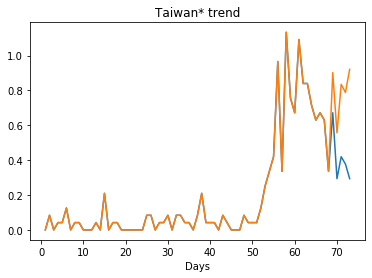

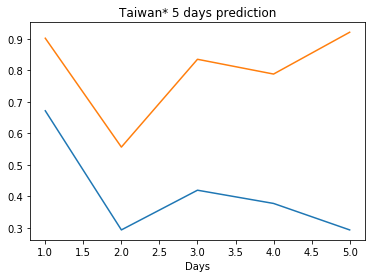

Creating directory ./offline6/Korea, South/training/
Korea, South
Saving the best model weights at Epoch [1], Best Valid Loss: 3.1189


/space/home/nzhang/anaconda3/envs/neuralnet/lib/python3.7/site-packages/torch/nn/modules/loss.py:431: UserWarning: Using a target size (torch.Size([1, 1, 5])) that is different to the input size (torch.Size([5])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/space/home/nzhang/anaconda3/envs/neuralnet/lib/python3.7/site-packages/torch/nn/modules/loss.py:431: UserWarning: Using a target size (torch.Size([1, 5])) that is different to the input size (torch.Size([5])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Saving the best model weights at Epoch [3], Best Valid Loss: 2.2252
Saving the best model weights at Epoch [4], Best Valid Loss: 0.9584
Saving the best model weights at Epoch [13], Best Valid Loss: 0.8317
Saving the best model weights at Epoch [24], Best Valid Loss: 0.8144
Saving the best model weights at Epoch [27], Best Valid Loss: 0.7998
Saving the best model weights at Epoch [32], Best Valid Loss: 0.6791
Saving the best model weights at Epoch [48], Best Valid Loss: 0.5391
train error: 19.96199538441081
0.539077639579773
Saving the best model weights at Epoch [1], Best Valid Loss: 10.5341
Saving the best model weights at Epoch [2], Best Valid Loss: 0.3083
train error: 53.404202599274484
0.3083205819129944
Saving the best model weights at Epoch [1], Best Valid Loss: 313.3657
Saving the best model weights at Epoch [2], Best Valid Loss: 83.1522
Saving the best model weights at Epoch [3], Best Valid Loss: 20.1808
Saving the best model weights at Epoch [7], Best Valid Loss: 11.0393
Savin

Saving the best model weights at Epoch [30], Best Valid Loss: 0.4365
train error: 15.502596368915157
0.43649420142173767
Saving the best model weights at Epoch [1], Best Valid Loss: 9.1182
Saving the best model weights at Epoch [2], Best Valid Loss: 3.3901
Saving the best model weights at Epoch [4], Best Valid Loss: 3.0212
Saving the best model weights at Epoch [6], Best Valid Loss: 3.0181
Saving the best model weights at Epoch [8], Best Valid Loss: 2.4858
Saving the best model weights at Epoch [14], Best Valid Loss: 2.2041
Saving the best model weights at Epoch [17], Best Valid Loss: 1.8437
Saving the best model weights at Epoch [29], Best Valid Loss: 1.5326
Saving the best model weights at Epoch [44], Best Valid Loss: 1.1532
Saving the best model weights at Epoch [47], Best Valid Loss: 0.7487
train error: 42.88270309724306
0.7486978769302368
Saving the best model weights at Epoch [1], Best Valid Loss: 25.6293
Saving the best model weights at Epoch [2], Best Valid Loss: 5.5333
Saving 

Saving the best model weights at Epoch [7], Best Valid Loss: 10.2214
Saving the best model weights at Epoch [12], Best Valid Loss: 1.9755
train error: 93.06035039299412
1.9754984378814697
Saving the best model weights at Epoch [1], Best Valid Loss: 0.9575
train error: 76.35283544189052
0.9575240015983582
Saving the best model weights at Epoch [1], Best Valid Loss: 46.4141
Saving the best model weights at Epoch [2], Best Valid Loss: 30.6741
Saving the best model weights at Epoch [4], Best Valid Loss: 26.8301
Saving the best model weights at Epoch [5], Best Valid Loss: 4.4526
Saving the best model weights at Epoch [34], Best Valid Loss: 1.9941
Saving the best model weights at Epoch [35], Best Valid Loss: 1.7028
Saving the best model weights at Epoch [44], Best Valid Loss: 0.7636
train error: 95.54939009013928
0.763619601726532
Saving the best model weights at Epoch [1], Best Valid Loss: 53.6844
Saving the best model weights at Epoch [2], Best Valid Loss: 25.3821
Saving the best model wei

train error: 7.40979716475857
0.9218801856040955
Saving the best model weights at Epoch [1], Best Valid Loss: 1.0621
Saving the best model weights at Epoch [4], Best Valid Loss: 0.8260
Saving the best model weights at Epoch [9], Best Valid Loss: 0.5376
Saving the best model weights at Epoch [44], Best Valid Loss: 0.5361
train error: 9.028949459132395
0.5360572934150696
Saving the best model weights at Epoch [1], Best Valid Loss: 9.0763
Saving the best model weights at Epoch [2], Best Valid Loss: 7.3881
Saving the best model weights at Epoch [5], Best Valid Loss: 5.2524
Saving the best model weights at Epoch [6], Best Valid Loss: 3.9492
Saving the best model weights at Epoch [8], Best Valid Loss: 3.6281
Saving the best model weights at Epoch [12], Best Valid Loss: 0.9557
Saving the best model weights at Epoch [34], Best Valid Loss: 0.5740
train error: 17.84408148260493
0.5740460753440857
Saving the best model weights at Epoch [1], Best Valid Loss: 5.1206
Saving the best model weights at

Saving the best model weights at Epoch [8], Best Valid Loss: 1.5319
Saving the best model weights at Epoch [10], Best Valid Loss: 1.3216
Saving the best model weights at Epoch [24], Best Valid Loss: 1.0924
Saving the best model weights at Epoch [26], Best Valid Loss: 1.0446
Saving the best model weights at Epoch [30], Best Valid Loss: 0.4926
train error: 18.17626437152687
0.49255427718162537
Saving the best model weights at Epoch [1], Best Valid Loss: 6.6702
Saving the best model weights at Epoch [2], Best Valid Loss: 0.9841
train error: 38.00916323693175
0.9841477274894714
Saving the best model weights at Epoch [1], Best Valid Loss: 1.9195
Saving the best model weights at Epoch [21], Best Valid Loss: 1.4074
Saving the best model weights at Epoch [32], Best Valid Loss: 1.3898
Saving the best model weights at Epoch [46], Best Valid Loss: 1.2137
train error: 65.38986398671803
1.2137149572372437
Saving the best model weights at Epoch [1], Best Valid Loss: 25.5218
Saving the best model wei

Saving the best model weights at Epoch [7], Best Valid Loss: 4.2338
Saving the best model weights at Epoch [8], Best Valid Loss: 2.6582
Saving the best model weights at Epoch [9], Best Valid Loss: 1.7538
Saving the best model weights at Epoch [10], Best Valid Loss: 1.2781
Saving the best model weights at Epoch [11], Best Valid Loss: 1.1661
Saving the best model weights at Epoch [13], Best Valid Loss: 0.9643
Saving the best model weights at Epoch [14], Best Valid Loss: 0.9088
Saving the best model weights at Epoch [15], Best Valid Loss: 0.8955
train error: 30.994999331471167
0.8954648971557617
Saving the best model weights at Epoch [1], Best Valid Loss: 13.3347
Saving the best model weights at Epoch [2], Best Valid Loss: 11.0630
Saving the best model weights at Epoch [3], Best Valid Loss: 9.0557
Saving the best model weights at Epoch [4], Best Valid Loss: 7.0702
Saving the best model weights at Epoch [5], Best Valid Loss: 4.4835
Saving the best model weights at Epoch [6], Best Valid Los

train error: 39.957530118132894
0.7284231781959534
Saving the best model weights at Epoch [1], Best Valid Loss: 16.1769
Saving the best model weights at Epoch [2], Best Valid Loss: 14.8907
Saving the best model weights at Epoch [3], Best Valid Loss: 13.6723
Saving the best model weights at Epoch [4], Best Valid Loss: 12.5083
Saving the best model weights at Epoch [5], Best Valid Loss: 11.3965
Saving the best model weights at Epoch [6], Best Valid Loss: 10.3291
Saving the best model weights at Epoch [7], Best Valid Loss: 9.3021
Saving the best model weights at Epoch [8], Best Valid Loss: 8.3067
Saving the best model weights at Epoch [9], Best Valid Loss: 7.3412
Saving the best model weights at Epoch [10], Best Valid Loss: 6.4013
Saving the best model weights at Epoch [11], Best Valid Loss: 5.4763
Saving the best model weights at Epoch [12], Best Valid Loss: 4.5610
Saving the best model weights at Epoch [13], Best Valid Loss: 3.6959
Saving the best model weights at Epoch [14], Best Valid

Saving the best model weights at Epoch [8], Best Valid Loss: 3.7279
Saving the best model weights at Epoch [9], Best Valid Loss: 2.7797
Saving the best model weights at Epoch [10], Best Valid Loss: 2.0362
Saving the best model weights at Epoch [11], Best Valid Loss: 1.4631
Saving the best model weights at Epoch [12], Best Valid Loss: 1.0829
Saving the best model weights at Epoch [13], Best Valid Loss: 0.8735
train error: 38.29035928688551
0.8734654784202576
Saving the best model weights at Epoch [1], Best Valid Loss: 9.4409
Saving the best model weights at Epoch [2], Best Valid Loss: 3.4270
Saving the best model weights at Epoch [3], Best Valid Loss: 0.8451
Saving the best model weights at Epoch [12], Best Valid Loss: 0.7499
train error: 48.318096248727095
0.7499186396598816
Saving the best model weights at Epoch [1], Best Valid Loss: 15.3830
Saving the best model weights at Epoch [2], Best Valid Loss: 14.1276
Saving the best model weights at Epoch [3], Best Valid Loss: 12.9383
Saving 

Saving the best model weights at Epoch [4], Best Valid Loss: 8.9460
Saving the best model weights at Epoch [5], Best Valid Loss: 7.2038
Saving the best model weights at Epoch [6], Best Valid Loss: 5.6114
Saving the best model weights at Epoch [7], Best Valid Loss: 4.1140
Saving the best model weights at Epoch [8], Best Valid Loss: 2.8170
Saving the best model weights at Epoch [9], Best Valid Loss: 1.8041
Saving the best model weights at Epoch [10], Best Valid Loss: 1.0515
Saving the best model weights at Epoch [11], Best Valid Loss: 0.8575
Saving the best model weights at Epoch [21], Best Valid Loss: 0.8572
Saving the best model weights at Epoch [22], Best Valid Loss: 0.8529
train error: 16.62111554334038
0.8529128432273865
Saving the best model weights at Epoch [1], Best Valid Loss: 9.2190
Saving the best model weights at Epoch [2], Best Valid Loss: 2.4037
Saving the best model weights at Epoch [3], Best Valid Loss: 2.1274
Saving the best model weights at Epoch [6], Best Valid Loss: 1

Saving the best model weights at Epoch [2], Best Valid Loss: 13.0889
Saving the best model weights at Epoch [3], Best Valid Loss: 11.1233
Saving the best model weights at Epoch [4], Best Valid Loss: 9.2611
Saving the best model weights at Epoch [5], Best Valid Loss: 7.5670
Saving the best model weights at Epoch [6], Best Valid Loss: 6.0731
Saving the best model weights at Epoch [7], Best Valid Loss: 4.7333
Saving the best model weights at Epoch [8], Best Valid Loss: 3.4572
Saving the best model weights at Epoch [9], Best Valid Loss: 2.4182
Saving the best model weights at Epoch [10], Best Valid Loss: 1.6176
Saving the best model weights at Epoch [11], Best Valid Loss: 1.0748
Saving the best model weights at Epoch [12], Best Valid Loss: 0.8646
train error: 23.757394737318943
0.864623486995697
Saving the best model weights at Epoch [1], Best Valid Loss: 9.2508
Saving the best model weights at Epoch [2], Best Valid Loss: 2.5993
Saving the best model weights at Epoch [3], Best Valid Loss: 

Saving the best model weights at Epoch [4], Best Valid Loss: 8.6930
Saving the best model weights at Epoch [5], Best Valid Loss: 6.9753
Saving the best model weights at Epoch [6], Best Valid Loss: 5.3960
Saving the best model weights at Epoch [7], Best Valid Loss: 3.9038
Saving the best model weights at Epoch [8], Best Valid Loss: 2.7247
Saving the best model weights at Epoch [9], Best Valid Loss: 1.7307
Saving the best model weights at Epoch [10], Best Valid Loss: 1.0075
Saving the best model weights at Epoch [11], Best Valid Loss: 0.6823
train error: 73.35234561719392
0.6822869181632996
Saving the best model weights at Epoch [1], Best Valid Loss: 8.4983
Saving the best model weights at Epoch [2], Best Valid Loss: 1.7792
train error: 73.29256943652504
1.7792145013809204
Saving the best model weights at Epoch [1], Best Valid Loss: 15.9722
Saving the best model weights at Epoch [2], Best Valid Loss: 14.6780
Saving the best model weights at Epoch [3], Best Valid Loss: 13.4492
Saving the 

Saving the best model weights at Epoch [33], Best Valid Loss: 11.7350
Saving the best model weights at Epoch [34], Best Valid Loss: 11.5858
Saving the best model weights at Epoch [35], Best Valid Loss: 11.4391
Saving the best model weights at Epoch [36], Best Valid Loss: 11.2941
Saving the best model weights at Epoch [37], Best Valid Loss: 11.1498
Saving the best model weights at Epoch [38], Best Valid Loss: 11.0091
Saving the best model weights at Epoch [39], Best Valid Loss: 10.8647
Saving the best model weights at Epoch [40], Best Valid Loss: 10.7238
Saving the best model weights at Epoch [41], Best Valid Loss: 10.5836
Saving the best model weights at Epoch [42], Best Valid Loss: 10.4446
Saving the best model weights at Epoch [43], Best Valid Loss: 10.3073
Saving the best model weights at Epoch [44], Best Valid Loss: 10.1711
Saving the best model weights at Epoch [45], Best Valid Loss: 10.0355
Saving the best model weights at Epoch [46], Best Valid Loss: 9.9014
Saving the best model

Saving the best model weights at Epoch [33], Best Valid Loss: 6.7902
Saving the best model weights at Epoch [34], Best Valid Loss: 6.4434
Saving the best model weights at Epoch [35], Best Valid Loss: 6.1061
Saving the best model weights at Epoch [36], Best Valid Loss: 5.7795
Saving the best model weights at Epoch [37], Best Valid Loss: 5.4611
Saving the best model weights at Epoch [38], Best Valid Loss: 5.1501
Saving the best model weights at Epoch [39], Best Valid Loss: 4.8480
Saving the best model weights at Epoch [40], Best Valid Loss: 4.5569
Saving the best model weights at Epoch [41], Best Valid Loss: 4.2787
Saving the best model weights at Epoch [42], Best Valid Loss: 4.0150
Saving the best model weights at Epoch [43], Best Valid Loss: 3.7623
Saving the best model weights at Epoch [44], Best Valid Loss: 3.5245
Saving the best model weights at Epoch [45], Best Valid Loss: 3.2983
Saving the best model weights at Epoch [46], Best Valid Loss: 3.0846
Saving the best model weights at E

Saving the best model weights at Epoch [42], Best Valid Loss: 1.5858
Saving the best model weights at Epoch [43], Best Valid Loss: 1.4672
Saving the best model weights at Epoch [44], Best Valid Loss: 1.3617
Saving the best model weights at Epoch [45], Best Valid Loss: 1.2696
Saving the best model weights at Epoch [46], Best Valid Loss: 1.1921
Saving the best model weights at Epoch [47], Best Valid Loss: 1.1257
Saving the best model weights at Epoch [48], Best Valid Loss: 1.0719
Saving the best model weights at Epoch [49], Best Valid Loss: 1.0282
Saving the best model weights at Epoch [50], Best Valid Loss: 0.9924
train error: 77.3645913287213
0.9923686981201172
Saving the best model weights at Epoch [1], Best Valid Loss: 17.1581
Saving the best model weights at Epoch [2], Best Valid Loss: 16.5939
Saving the best model weights at Epoch [3], Best Valid Loss: 15.9795
Saving the best model weights at Epoch [4], Best Valid Loss: 15.2851
Saving the best model weights at Epoch [5], Best Valid

train error: 10.550953914656452
0.8832025527954102
Saving the best model weights at Epoch [1], Best Valid Loss: 18.4212
Saving the best model weights at Epoch [2], Best Valid Loss: 18.2677
Saving the best model weights at Epoch [3], Best Valid Loss: 18.1151
Saving the best model weights at Epoch [4], Best Valid Loss: 17.9635
Saving the best model weights at Epoch [5], Best Valid Loss: 17.8135
Saving the best model weights at Epoch [6], Best Valid Loss: 17.6627
Saving the best model weights at Epoch [7], Best Valid Loss: 17.5141
Saving the best model weights at Epoch [8], Best Valid Loss: 17.3657
Saving the best model weights at Epoch [9], Best Valid Loss: 17.2183
Saving the best model weights at Epoch [10], Best Valid Loss: 17.0717
Saving the best model weights at Epoch [11], Best Valid Loss: 16.9260
Saving the best model weights at Epoch [12], Best Valid Loss: 16.7818
Saving the best model weights at Epoch [13], Best Valid Loss: 16.6369
Saving the best model weights at Epoch [14], Bes

Saving the best model weights at Epoch [17], Best Valid Loss: 2.7730
Saving the best model weights at Epoch [18], Best Valid Loss: 2.3295
Saving the best model weights at Epoch [19], Best Valid Loss: 1.9275
Saving the best model weights at Epoch [20], Best Valid Loss: 1.5453
Saving the best model weights at Epoch [21], Best Valid Loss: 1.2404
Saving the best model weights at Epoch [22], Best Valid Loss: 1.0029
Saving the best model weights at Epoch [23], Best Valid Loss: 0.8664
Saving the best model weights at Epoch [24], Best Valid Loss: 0.8177
train error: 49.43264114778293
0.8176864981651306
Saving the best model weights at Epoch [1], Best Valid Loss: 17.0581
Saving the best model weights at Epoch [2], Best Valid Loss: 16.9170
Saving the best model weights at Epoch [3], Best Valid Loss: 16.7779
Saving the best model weights at Epoch [4], Best Valid Loss: 16.6382
Saving the best model weights at Epoch [5], Best Valid Loss: 16.4997
Saving the best model weights at Epoch [6], Best Vali

Saving the best model weights at Epoch [10], Best Valid Loss: 6.4155
Saving the best model weights at Epoch [11], Best Valid Loss: 5.3998
Saving the best model weights at Epoch [12], Best Valid Loss: 4.1504
Saving the best model weights at Epoch [13], Best Valid Loss: 3.2895
Saving the best model weights at Epoch [14], Best Valid Loss: 2.4447
Saving the best model weights at Epoch [15], Best Valid Loss: 1.7324
Saving the best model weights at Epoch [16], Best Valid Loss: 1.2196
Saving the best model weights at Epoch [17], Best Valid Loss: 0.9076
Saving the best model weights at Epoch [18], Best Valid Loss: 0.8015
Saving the best model weights at Epoch [22], Best Valid Loss: 0.7979
train error: 20.87695946348341
0.7979127764701843
Saving the best model weights at Epoch [1], Best Valid Loss: 17.4162
Saving the best model weights at Epoch [2], Best Valid Loss: 17.2714
Saving the best model weights at Epoch [3], Best Valid Loss: 17.1290
Saving the best model weights at Epoch [4], Best Vali

Saving the best model weights at Epoch [7], Best Valid Loss: 8.4753
Saving the best model weights at Epoch [8], Best Valid Loss: 6.9807
Saving the best model weights at Epoch [9], Best Valid Loss: 5.4251
Saving the best model weights at Epoch [10], Best Valid Loss: 3.9860
Saving the best model weights at Epoch [11], Best Valid Loss: 2.6801
Saving the best model weights at Epoch [12], Best Valid Loss: 1.6109
Saving the best model weights at Epoch [13], Best Valid Loss: 0.9600
Saving the best model weights at Epoch [14], Best Valid Loss: 0.7411
train error: 17.929109142014855
0.7411202788352966
Saving the best model weights at Epoch [1], Best Valid Loss: 17.0682
Saving the best model weights at Epoch [2], Best Valid Loss: 16.9134
Saving the best model weights at Epoch [3], Best Valid Loss: 16.7597
Saving the best model weights at Epoch [4], Best Valid Loss: 16.6071
Saving the best model weights at Epoch [5], Best Valid Loss: 16.4554
Saving the best model weights at Epoch [6], Best Valid 

Saving the best model weights at Epoch [10], Best Valid Loss: 1.2038
Saving the best model weights at Epoch [11], Best Valid Loss: 0.7250
train error: 15.238089869289022
0.7249826192855835
Saving the best model weights at Epoch [1], Best Valid Loss: 16.3330
Saving the best model weights at Epoch [2], Best Valid Loss: 16.1976
Saving the best model weights at Epoch [3], Best Valid Loss: 16.0630
Saving the best model weights at Epoch [4], Best Valid Loss: 15.9301
Saving the best model weights at Epoch [5], Best Valid Loss: 15.7973
Saving the best model weights at Epoch [6], Best Valid Loss: 15.6650
Saving the best model weights at Epoch [7], Best Valid Loss: 15.5334
Saving the best model weights at Epoch [8], Best Valid Loss: 15.4030
Saving the best model weights at Epoch [9], Best Valid Loss: 15.2739
Saving the best model weights at Epoch [10], Best Valid Loss: 15.1450
Saving the best model weights at Epoch [11], Best Valid Loss: 15.0168
Saving the best model weights at Epoch [12], Best 

Saving the best model weights at Epoch [15], Best Valid Loss: 3.6511
Saving the best model weights at Epoch [16], Best Valid Loss: 3.0518
Saving the best model weights at Epoch [17], Best Valid Loss: 2.5676
Saving the best model weights at Epoch [18], Best Valid Loss: 2.1086
Saving the best model weights at Epoch [19], Best Valid Loss: 1.6653
Saving the best model weights at Epoch [20], Best Valid Loss: 1.3326
Saving the best model weights at Epoch [21], Best Valid Loss: 1.0583
Saving the best model weights at Epoch [22], Best Valid Loss: 0.8685
Saving the best model weights at Epoch [23], Best Valid Loss: 0.7461
Saving the best model weights at Epoch [24], Best Valid Loss: 0.6917
train error: 75.84961093099494
0.6917445063591003
Saving the best model weights at Epoch [1], Best Valid Loss: 16.9687
Saving the best model weights at Epoch [2], Best Valid Loss: 16.8258
Saving the best model weights at Epoch [3], Best Valid Loss: 16.6845
Saving the best model weights at Epoch [4], Best Vali

Saving the best model weights at Epoch [8], Best Valid Loss: 9.1084
Saving the best model weights at Epoch [9], Best Valid Loss: 8.2361
Saving the best model weights at Epoch [10], Best Valid Loss: 7.4289
Saving the best model weights at Epoch [11], Best Valid Loss: 6.6248
Saving the best model weights at Epoch [12], Best Valid Loss: 5.9021
Saving the best model weights at Epoch [13], Best Valid Loss: 5.1872
Saving the best model weights at Epoch [14], Best Valid Loss: 4.5287
Saving the best model weights at Epoch [15], Best Valid Loss: 3.8566
Saving the best model weights at Epoch [16], Best Valid Loss: 3.2668
Saving the best model weights at Epoch [17], Best Valid Loss: 2.7328
Saving the best model weights at Epoch [18], Best Valid Loss: 2.2327
Saving the best model weights at Epoch [19], Best Valid Loss: 1.8336
Saving the best model weights at Epoch [20], Best Valid Loss: 1.4743
Saving the best model weights at Epoch [21], Best Valid Loss: 1.1981
Saving the best model weights at Epo

Saving the best model weights at Epoch [2], Best Valid Loss: 15.0723
Saving the best model weights at Epoch [3], Best Valid Loss: 13.9965
Saving the best model weights at Epoch [4], Best Valid Loss: 12.9558
Saving the best model weights at Epoch [5], Best Valid Loss: 11.9346
Saving the best model weights at Epoch [6], Best Valid Loss: 11.0251
Saving the best model weights at Epoch [7], Best Valid Loss: 10.0824
Saving the best model weights at Epoch [8], Best Valid Loss: 9.1152
Saving the best model weights at Epoch [9], Best Valid Loss: 8.3844
Saving the best model weights at Epoch [10], Best Valid Loss: 7.4967
Saving the best model weights at Epoch [11], Best Valid Loss: 6.7967
Saving the best model weights at Epoch [12], Best Valid Loss: 6.0007
Saving the best model weights at Epoch [13], Best Valid Loss: 5.3428
Saving the best model weights at Epoch [14], Best Valid Loss: 4.6918
Saving the best model weights at Epoch [15], Best Valid Loss: 3.9821
Saving the best model weights at Epo

Saving the best model weights at Epoch [46], Best Valid Loss: 8.0816
Saving the best model weights at Epoch [47], Best Valid Loss: 7.9049
Saving the best model weights at Epoch [48], Best Valid Loss: 7.7326
Saving the best model weights at Epoch [49], Best Valid Loss: 7.5589
Saving the best model weights at Epoch [50], Best Valid Loss: 7.3917
train error: 137.14601536800987
7.391711711883545
Saving the best model weights at Epoch [1], Best Valid Loss: 16.3652
Saving the best model weights at Epoch [2], Best Valid Loss: 15.1055
Saving the best model weights at Epoch [3], Best Valid Loss: 14.0442
Saving the best model weights at Epoch [4], Best Valid Loss: 12.8942
Saving the best model weights at Epoch [5], Best Valid Loss: 11.8600
Saving the best model weights at Epoch [6], Best Valid Loss: 10.9041
Saving the best model weights at Epoch [7], Best Valid Loss: 9.9929
Saving the best model weights at Epoch [8], Best Valid Loss: 9.0329
Saving the best model weights at Epoch [9], Best Valid 

Saving the best model weights at Epoch [40], Best Valid Loss: 9.3522
Saving the best model weights at Epoch [41], Best Valid Loss: 9.2027
Saving the best model weights at Epoch [42], Best Valid Loss: 9.0491
Saving the best model weights at Epoch [43], Best Valid Loss: 8.8980
Saving the best model weights at Epoch [44], Best Valid Loss: 8.7454
Saving the best model weights at Epoch [45], Best Valid Loss: 8.5996
Saving the best model weights at Epoch [46], Best Valid Loss: 8.4572
Saving the best model weights at Epoch [47], Best Valid Loss: 8.3060
Saving the best model weights at Epoch [48], Best Valid Loss: 8.1633
Saving the best model weights at Epoch [49], Best Valid Loss: 8.0220
Saving the best model weights at Epoch [50], Best Valid Loss: 7.8839
train error: 139.01993301040247
7.883914470672607
Saving the best model weights at Epoch [1], Best Valid Loss: 16.3087
Saving the best model weights at Epoch [2], Best Valid Loss: 15.1645
Saving the best model weights at Epoch [3], Best Vali

Saving the best model weights at Epoch [32], Best Valid Loss: 10.6307
Saving the best model weights at Epoch [33], Best Valid Loss: 10.4402
Saving the best model weights at Epoch [34], Best Valid Loss: 10.2562
Saving the best model weights at Epoch [35], Best Valid Loss: 10.0745
Saving the best model weights at Epoch [36], Best Valid Loss: 9.8942
Saving the best model weights at Epoch [37], Best Valid Loss: 9.7176
Saving the best model weights at Epoch [38], Best Valid Loss: 9.5407
Saving the best model weights at Epoch [39], Best Valid Loss: 9.3632
Saving the best model weights at Epoch [40], Best Valid Loss: 9.1902
Saving the best model weights at Epoch [41], Best Valid Loss: 9.0201
Saving the best model weights at Epoch [42], Best Valid Loss: 8.8512
Saving the best model weights at Epoch [43], Best Valid Loss: 8.6820
Saving the best model weights at Epoch [44], Best Valid Loss: 8.5099
Saving the best model weights at Epoch [45], Best Valid Loss: 8.3421
Saving the best model weights 

Saving the best model weights at Epoch [24], Best Valid Loss: 12.1580
Saving the best model weights at Epoch [25], Best Valid Loss: 11.9542
Saving the best model weights at Epoch [26], Best Valid Loss: 11.7639
Saving the best model weights at Epoch [27], Best Valid Loss: 11.5613
Saving the best model weights at Epoch [28], Best Valid Loss: 11.3622
Saving the best model weights at Epoch [29], Best Valid Loss: 11.1672
Saving the best model weights at Epoch [30], Best Valid Loss: 10.9720
Saving the best model weights at Epoch [31], Best Valid Loss: 10.7792
Saving the best model weights at Epoch [32], Best Valid Loss: 10.5896
Saving the best model weights at Epoch [33], Best Valid Loss: 10.4006
Saving the best model weights at Epoch [34], Best Valid Loss: 10.2140
Saving the best model weights at Epoch [35], Best Valid Loss: 10.0323
Saving the best model weights at Epoch [36], Best Valid Loss: 9.8432
Saving the best model weights at Epoch [37], Best Valid Loss: 9.6680
Saving the best model 

Saving the best model weights at Epoch [16], Best Valid Loss: 13.3876
Saving the best model weights at Epoch [17], Best Valid Loss: 13.1760
Saving the best model weights at Epoch [18], Best Valid Loss: 12.9687
Saving the best model weights at Epoch [19], Best Valid Loss: 12.7499
Saving the best model weights at Epoch [20], Best Valid Loss: 12.5421
Saving the best model weights at Epoch [21], Best Valid Loss: 12.3405
Saving the best model weights at Epoch [22], Best Valid Loss: 12.1287
Saving the best model weights at Epoch [23], Best Valid Loss: 11.9289
Saving the best model weights at Epoch [24], Best Valid Loss: 11.7294
Saving the best model weights at Epoch [25], Best Valid Loss: 11.5279
Saving the best model weights at Epoch [26], Best Valid Loss: 11.3269
Saving the best model weights at Epoch [27], Best Valid Loss: 11.1376
Saving the best model weights at Epoch [28], Best Valid Loss: 10.9421
Saving the best model weights at Epoch [29], Best Valid Loss: 10.7491
Saving the best mode

Saving the best model weights at Epoch [10], Best Valid Loss: 15.8296
Saving the best model weights at Epoch [11], Best Valid Loss: 15.6047
Saving the best model weights at Epoch [12], Best Valid Loss: 15.3740
Saving the best model weights at Epoch [13], Best Valid Loss: 15.1511
Saving the best model weights at Epoch [14], Best Valid Loss: 14.9309
Saving the best model weights at Epoch [15], Best Valid Loss: 14.7050
Saving the best model weights at Epoch [16], Best Valid Loss: 14.4842
Saving the best model weights at Epoch [17], Best Valid Loss: 14.2675
Saving the best model weights at Epoch [18], Best Valid Loss: 14.0544
Saving the best model weights at Epoch [19], Best Valid Loss: 13.8398
Saving the best model weights at Epoch [20], Best Valid Loss: 13.6351
Saving the best model weights at Epoch [21], Best Valid Loss: 13.4228
Saving the best model weights at Epoch [22], Best Valid Loss: 13.2179
Saving the best model weights at Epoch [23], Best Valid Loss: 13.0130
Saving the best mode

Saving the best model weights at Epoch [2], Best Valid Loss: 16.9711
Saving the best model weights at Epoch [3], Best Valid Loss: 16.7238
Saving the best model weights at Epoch [4], Best Valid Loss: 16.4855
Saving the best model weights at Epoch [5], Best Valid Loss: 16.2408
Saving the best model weights at Epoch [6], Best Valid Loss: 16.0034
Saving the best model weights at Epoch [7], Best Valid Loss: 15.7702
Saving the best model weights at Epoch [8], Best Valid Loss: 15.5340
Saving the best model weights at Epoch [9], Best Valid Loss: 15.3051
Saving the best model weights at Epoch [10], Best Valid Loss: 15.0811
Saving the best model weights at Epoch [11], Best Valid Loss: 14.8528
Saving the best model weights at Epoch [12], Best Valid Loss: 14.6273
Saving the best model weights at Epoch [13], Best Valid Loss: 14.4038
Saving the best model weights at Epoch [14], Best Valid Loss: 14.1872
Saving the best model weights at Epoch [15], Best Valid Loss: 13.9639
Saving the best model weight

Saving the best model weights at Epoch [44], Best Valid Loss: 11.6560
Saving the best model weights at Epoch [45], Best Valid Loss: 11.5460
Saving the best model weights at Epoch [46], Best Valid Loss: 11.4366
Saving the best model weights at Epoch [47], Best Valid Loss: 11.3274
Saving the best model weights at Epoch [48], Best Valid Loss: 11.2187
Saving the best model weights at Epoch [49], Best Valid Loss: 11.1108
Saving the best model weights at Epoch [50], Best Valid Loss: 11.0034
train error: 147.81161632663324
11.003379821777344
Saving the best model weights at Epoch [1], Best Valid Loss: 17.1208
Saving the best model weights at Epoch [2], Best Valid Loss: 16.8708
Saving the best model weights at Epoch [3], Best Valid Loss: 16.6235
Saving the best model weights at Epoch [4], Best Valid Loss: 16.3773
Saving the best model weights at Epoch [5], Best Valid Loss: 16.1438
Saving the best model weights at Epoch [6], Best Valid Loss: 15.9037
Saving the best model weights at Epoch [7], B

Saving the best model weights at Epoch [38], Best Valid Loss: 12.5777
Saving the best model weights at Epoch [39], Best Valid Loss: 12.4576
Saving the best model weights at Epoch [40], Best Valid Loss: 12.3395
Saving the best model weights at Epoch [41], Best Valid Loss: 12.2204
Saving the best model weights at Epoch [42], Best Valid Loss: 12.1026
Saving the best model weights at Epoch [43], Best Valid Loss: 11.9860
Saving the best model weights at Epoch [44], Best Valid Loss: 11.8685
Saving the best model weights at Epoch [45], Best Valid Loss: 11.7522
Saving the best model weights at Epoch [46], Best Valid Loss: 11.6364
Saving the best model weights at Epoch [47], Best Valid Loss: 11.5210
Saving the best model weights at Epoch [48], Best Valid Loss: 11.4062
Saving the best model weights at Epoch [49], Best Valid Loss: 11.2918
Saving the best model weights at Epoch [50], Best Valid Loss: 11.1778
train error: 148.21281695993324
11.177836418151855
Saving the best model weights at Epoch 

Saving the best model weights at Epoch [33], Best Valid Loss: 18.4163
Saving the best model weights at Epoch [34], Best Valid Loss: 18.3812
Saving the best model weights at Epoch [35], Best Valid Loss: 18.3455
Saving the best model weights at Epoch [36], Best Valid Loss: 18.3106
Saving the best model weights at Epoch [37], Best Valid Loss: 18.2762
Saving the best model weights at Epoch [38], Best Valid Loss: 18.2426
Saving the best model weights at Epoch [39], Best Valid Loss: 18.2097
Saving the best model weights at Epoch [40], Best Valid Loss: 18.1774
Saving the best model weights at Epoch [41], Best Valid Loss: 18.1461
Saving the best model weights at Epoch [42], Best Valid Loss: 18.1159
Saving the best model weights at Epoch [43], Best Valid Loss: 18.0868
Saving the best model weights at Epoch [44], Best Valid Loss: 18.0583
Saving the best model weights at Epoch [45], Best Valid Loss: 18.0306
Saving the best model weights at Epoch [46], Best Valid Loss: 18.0042
Saving the best mode

Saving the best model weights at Epoch [50], Best Valid Loss: 11.2921
train error: 132.06726697244142
11.292065620422363
Saving the best model weights at Epoch [1], Best Valid Loss: 16.7864
Saving the best model weights at Epoch [2], Best Valid Loss: 16.7574
Saving the best model weights at Epoch [3], Best Valid Loss: 16.7288
Saving the best model weights at Epoch [4], Best Valid Loss: 16.7005
Saving the best model weights at Epoch [5], Best Valid Loss: 16.6725
Saving the best model weights at Epoch [6], Best Valid Loss: 16.6447
Saving the best model weights at Epoch [7], Best Valid Loss: 16.6175
Saving the best model weights at Epoch [8], Best Valid Loss: 16.5902
Saving the best model weights at Epoch [9], Best Valid Loss: 16.5637
Saving the best model weights at Epoch [10], Best Valid Loss: 16.5367
Saving the best model weights at Epoch [11], Best Valid Loss: 16.5103
Saving the best model weights at Epoch [12], Best Valid Loss: 16.4840
Saving the best model weights at Epoch [13], Bes

Saving the best model weights at Epoch [17], Best Valid Loss: 11.7166
Saving the best model weights at Epoch [18], Best Valid Loss: 11.4110
Saving the best model weights at Epoch [19], Best Valid Loss: 11.1266
Saving the best model weights at Epoch [20], Best Valid Loss: 10.8497
Saving the best model weights at Epoch [21], Best Valid Loss: 10.5588
Saving the best model weights at Epoch [22], Best Valid Loss: 10.2637
Saving the best model weights at Epoch [23], Best Valid Loss: 9.9830
Saving the best model weights at Epoch [24], Best Valid Loss: 9.6735
Saving the best model weights at Epoch [25], Best Valid Loss: 9.3983
Saving the best model weights at Epoch [26], Best Valid Loss: 9.0928
Saving the best model weights at Epoch [27], Best Valid Loss: 8.8192
Saving the best model weights at Epoch [28], Best Valid Loss: 8.5575
Saving the best model weights at Epoch [29], Best Valid Loss: 8.2898
Saving the best model weights at Epoch [30], Best Valid Loss: 8.0107
Saving the best model weight

Saving the best model weights at Epoch [34], Best Valid Loss: 15.2845
Saving the best model weights at Epoch [35], Best Valid Loss: 15.1910
Saving the best model weights at Epoch [36], Best Valid Loss: 15.0922
Saving the best model weights at Epoch [37], Best Valid Loss: 14.9944
Saving the best model weights at Epoch [38], Best Valid Loss: 14.8969
Saving the best model weights at Epoch [39], Best Valid Loss: 14.7954
Saving the best model weights at Epoch [40], Best Valid Loss: 14.6942
Saving the best model weights at Epoch [41], Best Valid Loss: 14.5890
Saving the best model weights at Epoch [42], Best Valid Loss: 14.4851
Saving the best model weights at Epoch [43], Best Valid Loss: 14.3787
Saving the best model weights at Epoch [44], Best Valid Loss: 14.2727
Saving the best model weights at Epoch [45], Best Valid Loss: 14.1622
Saving the best model weights at Epoch [46], Best Valid Loss: 14.0503
Saving the best model weights at Epoch [47], Best Valid Loss: 13.9402
Saving the best mode

Saving the best model weights at Epoch [3], Best Valid Loss: 16.7456
Saving the best model weights at Epoch [4], Best Valid Loss: 16.6908
Saving the best model weights at Epoch [5], Best Valid Loss: 16.6366
Saving the best model weights at Epoch [6], Best Valid Loss: 16.5838
Saving the best model weights at Epoch [7], Best Valid Loss: 16.5308
Saving the best model weights at Epoch [8], Best Valid Loss: 16.4764
Saving the best model weights at Epoch [9], Best Valid Loss: 16.4240
Saving the best model weights at Epoch [10], Best Valid Loss: 16.3711
Saving the best model weights at Epoch [11], Best Valid Loss: 16.3163
Saving the best model weights at Epoch [12], Best Valid Loss: 16.2655
Saving the best model weights at Epoch [13], Best Valid Loss: 16.2084
Saving the best model weights at Epoch [14], Best Valid Loss: 16.1536
Saving the best model weights at Epoch [15], Best Valid Loss: 16.0978
Saving the best model weights at Epoch [16], Best Valid Loss: 16.0418
Saving the best model weigh

Saving the best model weights at Epoch [24], Best Valid Loss: 17.2888
Saving the best model weights at Epoch [25], Best Valid Loss: 17.2750
Saving the best model weights at Epoch [26], Best Valid Loss: 17.2611
Saving the best model weights at Epoch [27], Best Valid Loss: 17.2473
Saving the best model weights at Epoch [28], Best Valid Loss: 17.2334
Saving the best model weights at Epoch [29], Best Valid Loss: 17.2197
Saving the best model weights at Epoch [30], Best Valid Loss: 17.2058
Saving the best model weights at Epoch [31], Best Valid Loss: 17.1920
Saving the best model weights at Epoch [32], Best Valid Loss: 17.1782
Saving the best model weights at Epoch [33], Best Valid Loss: 17.1644
Saving the best model weights at Epoch [34], Best Valid Loss: 17.1507
Saving the best model weights at Epoch [35], Best Valid Loss: 17.1369
Saving the best model weights at Epoch [36], Best Valid Loss: 17.1231
Saving the best model weights at Epoch [37], Best Valid Loss: 17.1095
Saving the best mode

Saving the best model weights at Epoch [42], Best Valid Loss: 12.7693
Saving the best model weights at Epoch [43], Best Valid Loss: 12.6731
Saving the best model weights at Epoch [44], Best Valid Loss: 12.5786
Saving the best model weights at Epoch [45], Best Valid Loss: 12.4865
Saving the best model weights at Epoch [46], Best Valid Loss: 12.3868
Saving the best model weights at Epoch [47], Best Valid Loss: 12.2852
Saving the best model weights at Epoch [48], Best Valid Loss: 12.1934
Saving the best model weights at Epoch [49], Best Valid Loss: 12.1048
Saving the best model weights at Epoch [50], Best Valid Loss: 12.0105
train error: 150.14171336826524
12.010526657104492
Saving the best model weights at Epoch [1], Best Valid Loss: 17.7640
Saving the best model weights at Epoch [2], Best Valid Loss: 17.7492
Saving the best model weights at Epoch [3], Best Valid Loss: 17.7344
Saving the best model weights at Epoch [4], Best Valid Loss: 17.7197
Saving the best model weights at Epoch [5],

Saving the best model weights at Epoch [10], Best Valid Loss: 15.5657
Saving the best model weights at Epoch [11], Best Valid Loss: 15.4419
Saving the best model weights at Epoch [12], Best Valid Loss: 15.3228
Saving the best model weights at Epoch [13], Best Valid Loss: 15.2099
Saving the best model weights at Epoch [14], Best Valid Loss: 15.0950
Saving the best model weights at Epoch [15], Best Valid Loss: 14.9742
Saving the best model weights at Epoch [16], Best Valid Loss: 14.8529
Saving the best model weights at Epoch [17], Best Valid Loss: 14.7477
Saving the best model weights at Epoch [18], Best Valid Loss: 14.6278
Saving the best model weights at Epoch [19], Best Valid Loss: 14.5155
Saving the best model weights at Epoch [20], Best Valid Loss: 14.3951
Saving the best model weights at Epoch [21], Best Valid Loss: 14.2886
Saving the best model weights at Epoch [22], Best Valid Loss: 14.1696
Saving the best model weights at Epoch [23], Best Valid Loss: 14.0508
Saving the best mode

Saving the best model weights at Epoch [27], Best Valid Loss: 16.7018
Saving the best model weights at Epoch [28], Best Valid Loss: 16.6769
Saving the best model weights at Epoch [29], Best Valid Loss: 16.6518
Saving the best model weights at Epoch [30], Best Valid Loss: 16.6265
Saving the best model weights at Epoch [31], Best Valid Loss: 16.6007
Saving the best model weights at Epoch [32], Best Valid Loss: 16.5754
Saving the best model weights at Epoch [33], Best Valid Loss: 16.5506
Saving the best model weights at Epoch [34], Best Valid Loss: 16.5256
Saving the best model weights at Epoch [35], Best Valid Loss: 16.5004
Saving the best model weights at Epoch [36], Best Valid Loss: 16.4750
Saving the best model weights at Epoch [37], Best Valid Loss: 16.4497
Saving the best model weights at Epoch [38], Best Valid Loss: 16.4246
Saving the best model weights at Epoch [39], Best Valid Loss: 16.3997
Saving the best model weights at Epoch [40], Best Valid Loss: 16.3756
Saving the best mode

Saving the best model weights at Epoch [44], Best Valid Loss: 16.3508
Saving the best model weights at Epoch [45], Best Valid Loss: 16.3368
Saving the best model weights at Epoch [46], Best Valid Loss: 16.3228
Saving the best model weights at Epoch [47], Best Valid Loss: 16.3088
Saving the best model weights at Epoch [48], Best Valid Loss: 16.2949
Saving the best model weights at Epoch [49], Best Valid Loss: 16.2809
Saving the best model weights at Epoch [50], Best Valid Loss: 16.2669
train error: 160.40103973840414
16.266874313354492
Saving the best model weights at Epoch [1], Best Valid Loss: 17.4359
Saving the best model weights at Epoch [2], Best Valid Loss: 17.4087
Saving the best model weights at Epoch [3], Best Valid Loss: 17.3812
Saving the best model weights at Epoch [4], Best Valid Loss: 17.3531
Saving the best model weights at Epoch [5], Best Valid Loss: 17.3251
Saving the best model weights at Epoch [6], Best Valid Loss: 17.2977
Saving the best model weights at Epoch [7], B

Saving the best model weights at Epoch [11], Best Valid Loss: 18.5971
Saving the best model weights at Epoch [12], Best Valid Loss: 18.5821
Saving the best model weights at Epoch [13], Best Valid Loss: 18.5671
Saving the best model weights at Epoch [14], Best Valid Loss: 18.5521
Saving the best model weights at Epoch [15], Best Valid Loss: 18.5371
Saving the best model weights at Epoch [16], Best Valid Loss: 18.5221
Saving the best model weights at Epoch [17], Best Valid Loss: 18.5071
Saving the best model weights at Epoch [18], Best Valid Loss: 18.4922
Saving the best model weights at Epoch [19], Best Valid Loss: 18.4772
Saving the best model weights at Epoch [20], Best Valid Loss: 18.4623
Saving the best model weights at Epoch [21], Best Valid Loss: 18.4473
Saving the best model weights at Epoch [22], Best Valid Loss: 18.4325
Saving the best model weights at Epoch [23], Best Valid Loss: 18.4176
Saving the best model weights at Epoch [24], Best Valid Loss: 18.4026
Saving the best mode

Saving the best model weights at Epoch [27], Best Valid Loss: 14.4476
Saving the best model weights at Epoch [28], Best Valid Loss: 14.3429
Saving the best model weights at Epoch [29], Best Valid Loss: 14.2412
Saving the best model weights at Epoch [30], Best Valid Loss: 14.1330
Saving the best model weights at Epoch [31], Best Valid Loss: 14.0295
Saving the best model weights at Epoch [32], Best Valid Loss: 13.9186
Saving the best model weights at Epoch [33], Best Valid Loss: 13.8203
Saving the best model weights at Epoch [34], Best Valid Loss: 13.7199
Saving the best model weights at Epoch [35], Best Valid Loss: 13.6147
Saving the best model weights at Epoch [36], Best Valid Loss: 13.5121
Saving the best model weights at Epoch [37], Best Valid Loss: 13.4061
Saving the best model weights at Epoch [38], Best Valid Loss: 13.3066
Saving the best model weights at Epoch [39], Best Valid Loss: 13.2047
Saving the best model weights at Epoch [40], Best Valid Loss: 13.1094
Saving the best mode

Saving the best model weights at Epoch [43], Best Valid Loss: 15.7772
Saving the best model weights at Epoch [44], Best Valid Loss: 15.7538
Saving the best model weights at Epoch [45], Best Valid Loss: 15.7295
Saving the best model weights at Epoch [46], Best Valid Loss: 15.7066
Saving the best model weights at Epoch [47], Best Valid Loss: 15.6826
Saving the best model weights at Epoch [48], Best Valid Loss: 15.6590
Saving the best model weights at Epoch [49], Best Valid Loss: 15.6355
Saving the best model weights at Epoch [50], Best Valid Loss: 15.6117
train error: 159.50312445038244
15.611666679382324
Saving the best model weights at Epoch [1], Best Valid Loss: 17.0359
Saving the best model weights at Epoch [2], Best Valid Loss: 16.9151
Saving the best model weights at Epoch [3], Best Valid Loss: 16.7850
Saving the best model weights at Epoch [4], Best Valid Loss: 16.6633
Saving the best model weights at Epoch [5], Best Valid Loss: 16.5469
Saving the best model weights at Epoch [6], 

Saving the best model weights at Epoch [9], Best Valid Loss: 17.1468
Saving the best model weights at Epoch [10], Best Valid Loss: 17.1210
Saving the best model weights at Epoch [11], Best Valid Loss: 17.0960
Saving the best model weights at Epoch [12], Best Valid Loss: 17.0706
Saving the best model weights at Epoch [13], Best Valid Loss: 17.0454
Saving the best model weights at Epoch [14], Best Valid Loss: 17.0202
Saving the best model weights at Epoch [15], Best Valid Loss: 16.9948
Saving the best model weights at Epoch [16], Best Valid Loss: 16.9698
Saving the best model weights at Epoch [17], Best Valid Loss: 16.9443
Saving the best model weights at Epoch [18], Best Valid Loss: 16.9191
Saving the best model weights at Epoch [19], Best Valid Loss: 16.8941
Saving the best model weights at Epoch [20], Best Valid Loss: 16.8690
Saving the best model weights at Epoch [21], Best Valid Loss: 16.8442
Saving the best model weights at Epoch [22], Best Valid Loss: 16.8197
Saving the best model

Saving the best model weights at Epoch [25], Best Valid Loss: 17.0119
Saving the best model weights at Epoch [26], Best Valid Loss: 16.9979
Saving the best model weights at Epoch [27], Best Valid Loss: 16.9841
Saving the best model weights at Epoch [28], Best Valid Loss: 16.9701
Saving the best model weights at Epoch [29], Best Valid Loss: 16.9562
Saving the best model weights at Epoch [30], Best Valid Loss: 16.9423
Saving the best model weights at Epoch [31], Best Valid Loss: 16.9285
Saving the best model weights at Epoch [32], Best Valid Loss: 16.9145
Saving the best model weights at Epoch [33], Best Valid Loss: 16.9007
Saving the best model weights at Epoch [34], Best Valid Loss: 16.8868
Saving the best model weights at Epoch [35], Best Valid Loss: 16.8729
Saving the best model weights at Epoch [36], Best Valid Loss: 16.8591
Saving the best model weights at Epoch [37], Best Valid Loss: 16.8453
Saving the best model weights at Epoch [38], Best Valid Loss: 16.8314
Saving the best mode

Saving the best model weights at Epoch [42], Best Valid Loss: 12.5251
Saving the best model weights at Epoch [43], Best Valid Loss: 12.4190
Saving the best model weights at Epoch [44], Best Valid Loss: 12.3203
Saving the best model weights at Epoch [45], Best Valid Loss: 12.2094
Saving the best model weights at Epoch [46], Best Valid Loss: 12.1141
Saving the best model weights at Epoch [47], Best Valid Loss: 12.0061
Saving the best model weights at Epoch [48], Best Valid Loss: 11.9019
Saving the best model weights at Epoch [49], Best Valid Loss: 11.8024
Saving the best model weights at Epoch [50], Best Valid Loss: 11.6951
train error: 149.62026537719527
11.695050239562988
Saving the best model weights at Epoch [1], Best Valid Loss: 16.5104
Saving the best model weights at Epoch [2], Best Valid Loss: 16.4970
Saving the best model weights at Epoch [3], Best Valid Loss: 16.4835
Saving the best model weights at Epoch [4], Best Valid Loss: 16.4702
Saving the best model weights at Epoch [5],

Saving the best model weights at Epoch [8], Best Valid Loss: 15.8567
Saving the best model weights at Epoch [9], Best Valid Loss: 15.7476
Saving the best model weights at Epoch [10], Best Valid Loss: 15.6130
Saving the best model weights at Epoch [11], Best Valid Loss: 15.4981
Saving the best model weights at Epoch [12], Best Valid Loss: 15.3743
Saving the best model weights at Epoch [13], Best Valid Loss: 15.2534
Saving the best model weights at Epoch [14], Best Valid Loss: 15.1365
Saving the best model weights at Epoch [15], Best Valid Loss: 15.0167
Saving the best model weights at Epoch [16], Best Valid Loss: 14.9085
Saving the best model weights at Epoch [17], Best Valid Loss: 14.7880
Saving the best model weights at Epoch [18], Best Valid Loss: 14.6685
Saving the best model weights at Epoch [19], Best Valid Loss: 14.5613
Saving the best model weights at Epoch [20], Best Valid Loss: 14.4394
Saving the best model weights at Epoch [21], Best Valid Loss: 14.3293
Saving the best model 

Saving the best model weights at Epoch [24], Best Valid Loss: 16.7828
Saving the best model weights at Epoch [25], Best Valid Loss: 16.7575
Saving the best model weights at Epoch [26], Best Valid Loss: 16.7333
Saving the best model weights at Epoch [27], Best Valid Loss: 16.7080
Saving the best model weights at Epoch [28], Best Valid Loss: 16.6831
Saving the best model weights at Epoch [29], Best Valid Loss: 16.6586
Saving the best model weights at Epoch [30], Best Valid Loss: 16.6340
Saving the best model weights at Epoch [31], Best Valid Loss: 16.6093
Saving the best model weights at Epoch [32], Best Valid Loss: 16.5839
Saving the best model weights at Epoch [33], Best Valid Loss: 16.5592
Saving the best model weights at Epoch [34], Best Valid Loss: 16.5350
Saving the best model weights at Epoch [35], Best Valid Loss: 16.5106
Saving the best model weights at Epoch [36], Best Valid Loss: 16.4853
Saving the best model weights at Epoch [37], Best Valid Loss: 16.4610
Saving the best mode

Saving the best model weights at Epoch [40], Best Valid Loss: 16.8514
Saving the best model weights at Epoch [41], Best Valid Loss: 16.8374
Saving the best model weights at Epoch [42], Best Valid Loss: 16.8235
Saving the best model weights at Epoch [43], Best Valid Loss: 16.8095
Saving the best model weights at Epoch [44], Best Valid Loss: 16.7955
Saving the best model weights at Epoch [45], Best Valid Loss: 16.7816
Saving the best model weights at Epoch [46], Best Valid Loss: 16.7676
Saving the best model weights at Epoch [47], Best Valid Loss: 16.7537
Saving the best model weights at Epoch [48], Best Valid Loss: 16.7398
Saving the best model weights at Epoch [49], Best Valid Loss: 16.7258
Saving the best model weights at Epoch [50], Best Valid Loss: 16.7119
train error: 161.77070036687348
16.71187400817871
Saving the best model weights at Epoch [1], Best Valid Loss: 17.2784
Saving the best model weights at Epoch [2], Best Valid Loss: 17.2525
Saving the best model weights at Epoch [3]

Saving the best model weights at Epoch [6], Best Valid Loss: 17.1407
Saving the best model weights at Epoch [7], Best Valid Loss: 17.1266
Saving the best model weights at Epoch [8], Best Valid Loss: 17.1125
Saving the best model weights at Epoch [9], Best Valid Loss: 17.0982
Saving the best model weights at Epoch [10], Best Valid Loss: 17.0842
Saving the best model weights at Epoch [11], Best Valid Loss: 17.0699
Saving the best model weights at Epoch [12], Best Valid Loss: 17.0558
Saving the best model weights at Epoch [13], Best Valid Loss: 17.0417
Saving the best model weights at Epoch [14], Best Valid Loss: 17.0276
Saving the best model weights at Epoch [15], Best Valid Loss: 17.0135
Saving the best model weights at Epoch [16], Best Valid Loss: 16.9994
Saving the best model weights at Epoch [17], Best Valid Loss: 16.9853
Saving the best model weights at Epoch [18], Best Valid Loss: 16.9712
Saving the best model weights at Epoch [19], Best Valid Loss: 16.9571
Saving the best model we

Saving the best model weights at Epoch [22], Best Valid Loss: 14.7130
Saving the best model weights at Epoch [23], Best Valid Loss: 14.5955
Saving the best model weights at Epoch [24], Best Valid Loss: 14.4770
Saving the best model weights at Epoch [25], Best Valid Loss: 14.3642
Saving the best model weights at Epoch [26], Best Valid Loss: 14.2583
Saving the best model weights at Epoch [27], Best Valid Loss: 14.1444
Saving the best model weights at Epoch [28], Best Valid Loss: 14.0282
Saving the best model weights at Epoch [29], Best Valid Loss: 13.9199
Saving the best model weights at Epoch [30], Best Valid Loss: 13.8096
Saving the best model weights at Epoch [31], Best Valid Loss: 13.6965
Saving the best model weights at Epoch [32], Best Valid Loss: 13.5884
Saving the best model weights at Epoch [33], Best Valid Loss: 13.4759
Saving the best model weights at Epoch [34], Best Valid Loss: 13.3696
Saving the best model weights at Epoch [35], Best Valid Loss: 13.2634
Saving the best mode

Saving the best model weights at Epoch [38], Best Valid Loss: 16.1164
Saving the best model weights at Epoch [39], Best Valid Loss: 16.0917
Saving the best model weights at Epoch [40], Best Valid Loss: 16.0683
Saving the best model weights at Epoch [41], Best Valid Loss: 16.0427
Saving the best model weights at Epoch [42], Best Valid Loss: 16.0184
Saving the best model weights at Epoch [43], Best Valid Loss: 15.9936
Saving the best model weights at Epoch [44], Best Valid Loss: 15.9701
Saving the best model weights at Epoch [45], Best Valid Loss: 15.9450
Saving the best model weights at Epoch [46], Best Valid Loss: 15.9211
Saving the best model weights at Epoch [47], Best Valid Loss: 15.8961
Saving the best model weights at Epoch [48], Best Valid Loss: 15.8717
Saving the best model weights at Epoch [49], Best Valid Loss: 15.8475
Saving the best model weights at Epoch [50], Best Valid Loss: 15.8232
train error: 159.22784825375206
15.82318115234375
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [4], Best Valid Loss: 17.8887
Saving the best model weights at Epoch [5], Best Valid Loss: 17.8614
Saving the best model weights at Epoch [6], Best Valid Loss: 17.8358
Saving the best model weights at Epoch [7], Best Valid Loss: 17.8095
Saving the best model weights at Epoch [8], Best Valid Loss: 17.7830
Saving the best model weights at Epoch [9], Best Valid Loss: 17.7573
Saving the best model weights at Epoch [10], Best Valid Loss: 17.7307
Saving the best model weights at Epoch [11], Best Valid Loss: 17.7044
Saving the best model weights at Epoch [12], Best Valid Loss: 17.6785
Saving the best model weights at Epoch [13], Best Valid Loss: 17.6532
Saving the best model weights at Epoch [14], Best Valid Loss: 17.6266
Saving the best model weights at Epoch [15], Best Valid Loss: 17.6007
Saving the best model weights at Epoch [16], Best Valid Loss: 17.5748
Saving the best model weights at Epoch [17], Best Valid Loss: 17.5495
Saving the best model weig

Saving the best model weights at Epoch [20], Best Valid Loss: 16.8516
Saving the best model weights at Epoch [21], Best Valid Loss: 16.8379
Saving the best model weights at Epoch [22], Best Valid Loss: 16.8241
Saving the best model weights at Epoch [23], Best Valid Loss: 16.8104
Saving the best model weights at Epoch [24], Best Valid Loss: 16.7967
Saving the best model weights at Epoch [25], Best Valid Loss: 16.7829
Saving the best model weights at Epoch [26], Best Valid Loss: 16.7692
Saving the best model weights at Epoch [27], Best Valid Loss: 16.7555
Saving the best model weights at Epoch [28], Best Valid Loss: 16.7419
Saving the best model weights at Epoch [29], Best Valid Loss: 16.7281
Saving the best model weights at Epoch [30], Best Valid Loss: 16.7145
Saving the best model weights at Epoch [31], Best Valid Loss: 16.7008
Saving the best model weights at Epoch [32], Best Valid Loss: 16.6871
Saving the best model weights at Epoch [33], Best Valid Loss: 16.6735
Saving the best mode

Saving the best model weights at Epoch [36], Best Valid Loss: 13.4709
Saving the best model weights at Epoch [37], Best Valid Loss: 13.3687
Saving the best model weights at Epoch [38], Best Valid Loss: 13.2644
Saving the best model weights at Epoch [39], Best Valid Loss: 13.1498
Saving the best model weights at Epoch [40], Best Valid Loss: 13.0510
Saving the best model weights at Epoch [41], Best Valid Loss: 12.9445
Saving the best model weights at Epoch [42], Best Valid Loss: 12.8371
Saving the best model weights at Epoch [43], Best Valid Loss: 12.7398
Saving the best model weights at Epoch [44], Best Valid Loss: 12.6330
Saving the best model weights at Epoch [45], Best Valid Loss: 12.5291
Saving the best model weights at Epoch [46], Best Valid Loss: 12.4279
Saving the best model weights at Epoch [47], Best Valid Loss: 12.3279
Saving the best model weights at Epoch [48], Best Valid Loss: 12.2283
Saving the best model weights at Epoch [49], Best Valid Loss: 12.1231
Saving the best mode

Saving the best model weights at Epoch [2], Best Valid Loss: 17.2689
Saving the best model weights at Epoch [3], Best Valid Loss: 17.1411
Saving the best model weights at Epoch [4], Best Valid Loss: 17.0200
Saving the best model weights at Epoch [5], Best Valid Loss: 16.8927
Saving the best model weights at Epoch [6], Best Valid Loss: 16.7702
Saving the best model weights at Epoch [7], Best Valid Loss: 16.6505
Saving the best model weights at Epoch [8], Best Valid Loss: 16.5262
Saving the best model weights at Epoch [9], Best Valid Loss: 16.3986
Saving the best model weights at Epoch [10], Best Valid Loss: 16.2839
Saving the best model weights at Epoch [11], Best Valid Loss: 16.1664
Saving the best model weights at Epoch [12], Best Valid Loss: 16.0397
Saving the best model weights at Epoch [13], Best Valid Loss: 15.9212
Saving the best model weights at Epoch [14], Best Valid Loss: 15.8072
Saving the best model weights at Epoch [15], Best Valid Loss: 15.6823
Saving the best model weight

Saving the best model weights at Epoch [19], Best Valid Loss: 19.7070
Saving the best model weights at Epoch [20], Best Valid Loss: 19.6916
Saving the best model weights at Epoch [21], Best Valid Loss: 19.6760
Saving the best model weights at Epoch [22], Best Valid Loss: 19.6600
Saving the best model weights at Epoch [23], Best Valid Loss: 19.6438
Saving the best model weights at Epoch [24], Best Valid Loss: 19.6330
Saving the best model weights at Epoch [25], Best Valid Loss: 19.6111
Saving the best model weights at Epoch [26], Best Valid Loss: 19.5944
Saving the best model weights at Epoch [27], Best Valid Loss: 19.5783
Saving the best model weights at Epoch [28], Best Valid Loss: 19.5605
Saving the best model weights at Epoch [29], Best Valid Loss: 19.5435
Saving the best model weights at Epoch [30], Best Valid Loss: 19.5259
Saving the best model weights at Epoch [31], Best Valid Loss: 19.5086
Saving the best model weights at Epoch [32], Best Valid Loss: 19.4914
Saving the best mode

Saving the best model weights at Epoch [36], Best Valid Loss: 16.6829
Saving the best model weights at Epoch [37], Best Valid Loss: 16.6808
Saving the best model weights at Epoch [38], Best Valid Loss: 16.6787
Saving the best model weights at Epoch [39], Best Valid Loss: 16.6765
Saving the best model weights at Epoch [40], Best Valid Loss: 16.6744
Saving the best model weights at Epoch [41], Best Valid Loss: 16.6723
Saving the best model weights at Epoch [42], Best Valid Loss: 16.6701
Saving the best model weights at Epoch [43], Best Valid Loss: 16.6680
Saving the best model weights at Epoch [44], Best Valid Loss: 16.6659
Saving the best model weights at Epoch [45], Best Valid Loss: 16.6637
Saving the best model weights at Epoch [46], Best Valid Loss: 16.6616
Saving the best model weights at Epoch [47], Best Valid Loss: 16.6595
Saving the best model weights at Epoch [48], Best Valid Loss: 16.6573
Saving the best model weights at Epoch [49], Best Valid Loss: 16.6552
Saving the best mode

Saving the best model weights at Epoch [3], Best Valid Loss: 17.2390
Saving the best model weights at Epoch [4], Best Valid Loss: 17.2356
Saving the best model weights at Epoch [5], Best Valid Loss: 17.2321
Saving the best model weights at Epoch [6], Best Valid Loss: 17.2287
Saving the best model weights at Epoch [7], Best Valid Loss: 17.2253
Saving the best model weights at Epoch [8], Best Valid Loss: 17.2218
Saving the best model weights at Epoch [9], Best Valid Loss: 17.2184
Saving the best model weights at Epoch [10], Best Valid Loss: 17.2150
Saving the best model weights at Epoch [11], Best Valid Loss: 17.2115
Saving the best model weights at Epoch [12], Best Valid Loss: 17.2081
Saving the best model weights at Epoch [13], Best Valid Loss: 17.2047
Saving the best model weights at Epoch [14], Best Valid Loss: 17.2013
Saving the best model weights at Epoch [15], Best Valid Loss: 17.1979
Saving the best model weights at Epoch [16], Best Valid Loss: 17.1944
Saving the best model weigh

Saving the best model weights at Epoch [20], Best Valid Loss: 18.3225
Saving the best model weights at Epoch [21], Best Valid Loss: 18.3153
Saving the best model weights at Epoch [22], Best Valid Loss: 18.3076
Saving the best model weights at Epoch [23], Best Valid Loss: 18.3011
Saving the best model weights at Epoch [24], Best Valid Loss: 18.2934
Saving the best model weights at Epoch [25], Best Valid Loss: 18.2862
Saving the best model weights at Epoch [26], Best Valid Loss: 18.2792
Saving the best model weights at Epoch [27], Best Valid Loss: 18.2723
Saving the best model weights at Epoch [28], Best Valid Loss: 18.2658
Saving the best model weights at Epoch [29], Best Valid Loss: 18.2592
Saving the best model weights at Epoch [30], Best Valid Loss: 18.2526
Saving the best model weights at Epoch [31], Best Valid Loss: 18.2462
Saving the best model weights at Epoch [32], Best Valid Loss: 18.2398
Saving the best model weights at Epoch [33], Best Valid Loss: 18.2333
Saving the best mode

Saving the best model weights at Epoch [37], Best Valid Loss: 17.5642
Saving the best model weights at Epoch [38], Best Valid Loss: 17.5592
Saving the best model weights at Epoch [39], Best Valid Loss: 17.5541
Saving the best model weights at Epoch [40], Best Valid Loss: 17.5489
Saving the best model weights at Epoch [41], Best Valid Loss: 17.5436
Saving the best model weights at Epoch [42], Best Valid Loss: 17.5386
Saving the best model weights at Epoch [43], Best Valid Loss: 17.5333
Saving the best model weights at Epoch [44], Best Valid Loss: 17.5282
Saving the best model weights at Epoch [45], Best Valid Loss: 17.5231
Saving the best model weights at Epoch [46], Best Valid Loss: 17.5179
Saving the best model weights at Epoch [47], Best Valid Loss: 17.5128
Saving the best model weights at Epoch [48], Best Valid Loss: 17.5075
Saving the best model weights at Epoch [49], Best Valid Loss: 17.5024
Saving the best model weights at Epoch [50], Best Valid Loss: 17.4973
train error: 162.484

Saving the best model weights at Epoch [4], Best Valid Loss: 16.7098
Saving the best model weights at Epoch [5], Best Valid Loss: 16.7074
Saving the best model weights at Epoch [6], Best Valid Loss: 16.7049
Saving the best model weights at Epoch [7], Best Valid Loss: 16.7024
Saving the best model weights at Epoch [8], Best Valid Loss: 16.6999
Saving the best model weights at Epoch [9], Best Valid Loss: 16.6975
Saving the best model weights at Epoch [10], Best Valid Loss: 16.6950
Saving the best model weights at Epoch [11], Best Valid Loss: 16.6925
Saving the best model weights at Epoch [12], Best Valid Loss: 16.6900
Saving the best model weights at Epoch [13], Best Valid Loss: 16.6875
Saving the best model weights at Epoch [14], Best Valid Loss: 16.6850
Saving the best model weights at Epoch [15], Best Valid Loss: 16.6826
Saving the best model weights at Epoch [16], Best Valid Loss: 16.6801
Saving the best model weights at Epoch [17], Best Valid Loss: 16.6776
Saving the best model weig

Saving the best model weights at Epoch [21], Best Valid Loss: 17.6917
Saving the best model weights at Epoch [22], Best Valid Loss: 17.6903
Saving the best model weights at Epoch [23], Best Valid Loss: 17.6888
Saving the best model weights at Epoch [24], Best Valid Loss: 17.6874
Saving the best model weights at Epoch [25], Best Valid Loss: 17.6859
Saving the best model weights at Epoch [26], Best Valid Loss: 17.6845
Saving the best model weights at Epoch [27], Best Valid Loss: 17.6830
Saving the best model weights at Epoch [28], Best Valid Loss: 17.6816
Saving the best model weights at Epoch [29], Best Valid Loss: 17.6801
Saving the best model weights at Epoch [30], Best Valid Loss: 17.6787
Saving the best model weights at Epoch [31], Best Valid Loss: 17.6772
Saving the best model weights at Epoch [32], Best Valid Loss: 17.6758
Saving the best model weights at Epoch [33], Best Valid Loss: 17.6743
Saving the best model weights at Epoch [34], Best Valid Loss: 17.6729
Saving the best mode

Saving the best model weights at Epoch [38], Best Valid Loss: 16.2848
Saving the best model weights at Epoch [39], Best Valid Loss: 16.2726
Saving the best model weights at Epoch [40], Best Valid Loss: 16.2597
Saving the best model weights at Epoch [41], Best Valid Loss: 16.2484
Saving the best model weights at Epoch [42], Best Valid Loss: 16.2349
Saving the best model weights at Epoch [43], Best Valid Loss: 16.2221
Saving the best model weights at Epoch [44], Best Valid Loss: 16.2096
Saving the best model weights at Epoch [45], Best Valid Loss: 16.1971
Saving the best model weights at Epoch [46], Best Valid Loss: 16.1849
Saving the best model weights at Epoch [47], Best Valid Loss: 16.1723
Saving the best model weights at Epoch [48], Best Valid Loss: 16.1594
Saving the best model weights at Epoch [49], Best Valid Loss: 16.1478
Saving the best model weights at Epoch [50], Best Valid Loss: 16.1343
train error: 160.47761262090583
16.134305953979492
Saving the best model weights at Epoch 

Saving the best model weights at Epoch [5], Best Valid Loss: 17.3757
Saving the best model weights at Epoch [6], Best Valid Loss: 17.3625
Saving the best model weights at Epoch [7], Best Valid Loss: 17.3508
Saving the best model weights at Epoch [8], Best Valid Loss: 17.3376
Saving the best model weights at Epoch [9], Best Valid Loss: 17.3242
Saving the best model weights at Epoch [10], Best Valid Loss: 17.3114
Saving the best model weights at Epoch [11], Best Valid Loss: 17.2979
Saving the best model weights at Epoch [12], Best Valid Loss: 17.2848
Saving the best model weights at Epoch [13], Best Valid Loss: 17.2721
Saving the best model weights at Epoch [14], Best Valid Loss: 17.2586
Saving the best model weights at Epoch [15], Best Valid Loss: 17.2461
Saving the best model weights at Epoch [16], Best Valid Loss: 17.2331
Saving the best model weights at Epoch [17], Best Valid Loss: 17.2195
Saving the best model weights at Epoch [18], Best Valid Loss: 17.2078
Saving the best model wei

Saving the best model weights at Epoch [23], Best Valid Loss: 17.0238
Saving the best model weights at Epoch [24], Best Valid Loss: 17.0212
Saving the best model weights at Epoch [25], Best Valid Loss: 17.0185
Saving the best model weights at Epoch [26], Best Valid Loss: 17.0160
Saving the best model weights at Epoch [27], Best Valid Loss: 17.0133
Saving the best model weights at Epoch [28], Best Valid Loss: 17.0107
Saving the best model weights at Epoch [29], Best Valid Loss: 17.0080
Saving the best model weights at Epoch [30], Best Valid Loss: 17.0054
Saving the best model weights at Epoch [31], Best Valid Loss: 17.0028
Saving the best model weights at Epoch [32], Best Valid Loss: 17.0002
Saving the best model weights at Epoch [33], Best Valid Loss: 16.9975
Saving the best model weights at Epoch [34], Best Valid Loss: 16.9949
Saving the best model weights at Epoch [35], Best Valid Loss: 16.9923
Saving the best model weights at Epoch [36], Best Valid Loss: 16.9897
Saving the best mode

Saving the best model weights at Epoch [40], Best Valid Loss: 16.6306
Saving the best model weights at Epoch [41], Best Valid Loss: 16.6293
Saving the best model weights at Epoch [42], Best Valid Loss: 16.6279
Saving the best model weights at Epoch [43], Best Valid Loss: 16.6266
Saving the best model weights at Epoch [44], Best Valid Loss: 16.6253
Saving the best model weights at Epoch [45], Best Valid Loss: 16.6239
Saving the best model weights at Epoch [46], Best Valid Loss: 16.6226
Saving the best model weights at Epoch [47], Best Valid Loss: 16.6212
Saving the best model weights at Epoch [48], Best Valid Loss: 16.6199
Saving the best model weights at Epoch [49], Best Valid Loss: 16.6185
Saving the best model weights at Epoch [50], Best Valid Loss: 16.6172
train error: 161.97085846097846
16.617204666137695
Saving the best model weights at Epoch [1], Best Valid Loss: 17.6592
Saving the best model weights at Epoch [2], Best Valid Loss: 17.6566
Saving the best model weights at Epoch [3

Saving the best model weights at Epoch [6], Best Valid Loss: 17.2187
Saving the best model weights at Epoch [7], Best Valid Loss: 17.2174
Saving the best model weights at Epoch [8], Best Valid Loss: 17.2160
Saving the best model weights at Epoch [9], Best Valid Loss: 17.2146
Saving the best model weights at Epoch [10], Best Valid Loss: 17.2132
Saving the best model weights at Epoch [11], Best Valid Loss: 17.2118
Saving the best model weights at Epoch [12], Best Valid Loss: 17.2105
Saving the best model weights at Epoch [13], Best Valid Loss: 17.2091
Saving the best model weights at Epoch [14], Best Valid Loss: 17.2077
Saving the best model weights at Epoch [15], Best Valid Loss: 17.2063
Saving the best model weights at Epoch [16], Best Valid Loss: 17.2050
Saving the best model weights at Epoch [17], Best Valid Loss: 17.2036
Saving the best model weights at Epoch [18], Best Valid Loss: 17.2022
Saving the best model weights at Epoch [19], Best Valid Loss: 17.2008
Saving the best model we

Saving the best model weights at Epoch [22], Best Valid Loss: 17.6012
Saving the best model weights at Epoch [23], Best Valid Loss: 17.5883
Saving the best model weights at Epoch [24], Best Valid Loss: 17.5745
Saving the best model weights at Epoch [25], Best Valid Loss: 17.5625
Saving the best model weights at Epoch [26], Best Valid Loss: 17.5489
Saving the best model weights at Epoch [27], Best Valid Loss: 17.5358
Saving the best model weights at Epoch [28], Best Valid Loss: 17.5227
Saving the best model weights at Epoch [29], Best Valid Loss: 17.5102
Saving the best model weights at Epoch [30], Best Valid Loss: 17.4971
Saving the best model weights at Epoch [31], Best Valid Loss: 17.4840
Saving the best model weights at Epoch [32], Best Valid Loss: 17.4715
Saving the best model weights at Epoch [33], Best Valid Loss: 17.4584
Saving the best model weights at Epoch [34], Best Valid Loss: 17.4450
Saving the best model weights at Epoch [35], Best Valid Loss: 17.4322
Saving the best mode

Saving the best model weights at Epoch [38], Best Valid Loss: 17.1023
Saving the best model weights at Epoch [39], Best Valid Loss: 17.0998
Saving the best model weights at Epoch [40], Best Valid Loss: 17.0972
Saving the best model weights at Epoch [41], Best Valid Loss: 17.0948
Saving the best model weights at Epoch [42], Best Valid Loss: 17.0922
Saving the best model weights at Epoch [43], Best Valid Loss: 17.0897
Saving the best model weights at Epoch [44], Best Valid Loss: 17.0872
Saving the best model weights at Epoch [45], Best Valid Loss: 17.0848
Saving the best model weights at Epoch [46], Best Valid Loss: 17.0822
Saving the best model weights at Epoch [47], Best Valid Loss: 17.0797
Saving the best model weights at Epoch [48], Best Valid Loss: 17.0773
Saving the best model weights at Epoch [49], Best Valid Loss: 17.0747
Saving the best model weights at Epoch [50], Best Valid Loss: 17.0722
train error: 162.8788631840756
17.072227478027344
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [4], Best Valid Loss: 16.9830
Saving the best model weights at Epoch [5], Best Valid Loss: 16.9804
Saving the best model weights at Epoch [6], Best Valid Loss: 16.9779
Saving the best model weights at Epoch [7], Best Valid Loss: 16.9753
Saving the best model weights at Epoch [8], Best Valid Loss: 16.9728
Saving the best model weights at Epoch [9], Best Valid Loss: 16.9703
Saving the best model weights at Epoch [10], Best Valid Loss: 16.9678
Saving the best model weights at Epoch [11], Best Valid Loss: 16.9652
Saving the best model weights at Epoch [12], Best Valid Loss: 16.9627
Saving the best model weights at Epoch [13], Best Valid Loss: 16.9602
Saving the best model weights at Epoch [14], Best Valid Loss: 16.9577
Saving the best model weights at Epoch [15], Best Valid Loss: 16.9552
Saving the best model weights at Epoch [16], Best Valid Loss: 16.9527
Saving the best model weights at Epoch [17], Best Valid Loss: 16.9502
Saving the best model weig

Saving the best model weights at Epoch [20], Best Valid Loss: 16.6959
Saving the best model weights at Epoch [21], Best Valid Loss: 16.6945
Saving the best model weights at Epoch [22], Best Valid Loss: 16.6932
Saving the best model weights at Epoch [23], Best Valid Loss: 16.6918
Saving the best model weights at Epoch [24], Best Valid Loss: 16.6904
Saving the best model weights at Epoch [25], Best Valid Loss: 16.6891
Saving the best model weights at Epoch [26], Best Valid Loss: 16.6877
Saving the best model weights at Epoch [27], Best Valid Loss: 16.6864
Saving the best model weights at Epoch [28], Best Valid Loss: 16.6850
Saving the best model weights at Epoch [29], Best Valid Loss: 16.6836
Saving the best model weights at Epoch [30], Best Valid Loss: 16.6823
Saving the best model weights at Epoch [31], Best Valid Loss: 16.6809
Saving the best model weights at Epoch [32], Best Valid Loss: 16.6795
Saving the best model weights at Epoch [33], Best Valid Loss: 16.6782
Saving the best mode

Saving the best model weights at Epoch [36], Best Valid Loss: 16.3211
Saving the best model weights at Epoch [37], Best Valid Loss: 16.3089
Saving the best model weights at Epoch [38], Best Valid Loss: 16.2966
Saving the best model weights at Epoch [39], Best Valid Loss: 16.2843
Saving the best model weights at Epoch [40], Best Valid Loss: 16.2723
Saving the best model weights at Epoch [41], Best Valid Loss: 16.2599
Saving the best model weights at Epoch [42], Best Valid Loss: 16.2474
Saving the best model weights at Epoch [43], Best Valid Loss: 16.2361
Saving the best model weights at Epoch [44], Best Valid Loss: 16.2234
Saving the best model weights at Epoch [45], Best Valid Loss: 16.2107
Saving the best model weights at Epoch [46], Best Valid Loss: 16.1987
Saving the best model weights at Epoch [47], Best Valid Loss: 16.1868
Saving the best model weights at Epoch [48], Best Valid Loss: 16.1744
Saving the best model weights at Epoch [49], Best Valid Loss: 16.1621
Saving the best mode

Saving the best model weights at Epoch [2], Best Valid Loss: 16.8876
Saving the best model weights at Epoch [3], Best Valid Loss: 16.8752
Saving the best model weights at Epoch [4], Best Valid Loss: 16.8621
Saving the best model weights at Epoch [5], Best Valid Loss: 16.8501
Saving the best model weights at Epoch [6], Best Valid Loss: 16.8377
Saving the best model weights at Epoch [7], Best Valid Loss: 16.8251
Saving the best model weights at Epoch [8], Best Valid Loss: 16.8139
Saving the best model weights at Epoch [9], Best Valid Loss: 16.8008
Saving the best model weights at Epoch [10], Best Valid Loss: 16.7878
Saving the best model weights at Epoch [11], Best Valid Loss: 16.7757
Saving the best model weights at Epoch [12], Best Valid Loss: 16.7631
Saving the best model weights at Epoch [13], Best Valid Loss: 16.7516
Saving the best model weights at Epoch [14], Best Valid Loss: 16.7383
Saving the best model weights at Epoch [15], Best Valid Loss: 16.7261
Saving the best model weight

Saving the best model weights at Epoch [18], Best Valid Loss: 17.0955
Saving the best model weights at Epoch [19], Best Valid Loss: 17.0930
Saving the best model weights at Epoch [20], Best Valid Loss: 17.0905
Saving the best model weights at Epoch [21], Best Valid Loss: 17.0880
Saving the best model weights at Epoch [22], Best Valid Loss: 17.0855
Saving the best model weights at Epoch [23], Best Valid Loss: 17.0830
Saving the best model weights at Epoch [24], Best Valid Loss: 17.0805
Saving the best model weights at Epoch [25], Best Valid Loss: 17.0779
Saving the best model weights at Epoch [26], Best Valid Loss: 17.0755
Saving the best model weights at Epoch [27], Best Valid Loss: 17.0730
Saving the best model weights at Epoch [28], Best Valid Loss: 17.0705
Saving the best model weights at Epoch [29], Best Valid Loss: 17.0679
Saving the best model weights at Epoch [30], Best Valid Loss: 17.0654
Saving the best model weights at Epoch [31], Best Valid Loss: 17.0629
Saving the best mode

Saving the best model weights at Epoch [34], Best Valid Loss: 17.1772
Saving the best model weights at Epoch [35], Best Valid Loss: 17.1758
Saving the best model weights at Epoch [36], Best Valid Loss: 17.1745
Saving the best model weights at Epoch [37], Best Valid Loss: 17.1731
Saving the best model weights at Epoch [38], Best Valid Loss: 17.1717
Saving the best model weights at Epoch [39], Best Valid Loss: 17.1703
Saving the best model weights at Epoch [40], Best Valid Loss: 17.1689
Saving the best model weights at Epoch [41], Best Valid Loss: 17.1675
Saving the best model weights at Epoch [42], Best Valid Loss: 17.1661
Saving the best model weights at Epoch [43], Best Valid Loss: 17.1647
Saving the best model weights at Epoch [44], Best Valid Loss: 17.1633
Saving the best model weights at Epoch [45], Best Valid Loss: 17.1619
Saving the best model weights at Epoch [46], Best Valid Loss: 17.1605
Saving the best model weights at Epoch [47], Best Valid Loss: 17.1591
Saving the best mode

Saving the best model weights at Epoch [50], Best Valid Loss: 16.5037
train error: 161.4012819214871
16.503698348999023
Saving the best model weights at Epoch [1], Best Valid Loss: 18.3459
Saving the best model weights at Epoch [2], Best Valid Loss: 18.3445
Saving the best model weights at Epoch [3], Best Valid Loss: 18.3430
Saving the best model weights at Epoch [4], Best Valid Loss: 18.3415
Saving the best model weights at Epoch [5], Best Valid Loss: 18.3400
Saving the best model weights at Epoch [6], Best Valid Loss: 18.3386
Saving the best model weights at Epoch [7], Best Valid Loss: 18.3371
Saving the best model weights at Epoch [8], Best Valid Loss: 18.3356
Saving the best model weights at Epoch [9], Best Valid Loss: 18.3341
Saving the best model weights at Epoch [10], Best Valid Loss: 18.3326
Saving the best model weights at Epoch [11], Best Valid Loss: 18.3312
Saving the best model weights at Epoch [12], Best Valid Loss: 18.3297
Saving the best model weights at Epoch [13], Best

Saving the best model weights at Epoch [16], Best Valid Loss: 16.5323
Saving the best model weights at Epoch [17], Best Valid Loss: 16.5198
Saving the best model weights at Epoch [18], Best Valid Loss: 16.5080
Saving the best model weights at Epoch [19], Best Valid Loss: 16.4958
Saving the best model weights at Epoch [20], Best Valid Loss: 16.4836
Saving the best model weights at Epoch [21], Best Valid Loss: 16.4718
Saving the best model weights at Epoch [22], Best Valid Loss: 16.4604
Saving the best model weights at Epoch [23], Best Valid Loss: 16.4472
Saving the best model weights at Epoch [24], Best Valid Loss: 16.4361
Saving the best model weights at Epoch [25], Best Valid Loss: 16.4227
Saving the best model weights at Epoch [26], Best Valid Loss: 16.4119
Saving the best model weights at Epoch [27], Best Valid Loss: 16.3996
Saving the best model weights at Epoch [28], Best Valid Loss: 16.3866
Saving the best model weights at Epoch [29], Best Valid Loss: 16.3751
Saving the best mode

Saving the best model weights at Epoch [32], Best Valid Loss: 17.1201
Saving the best model weights at Epoch [33], Best Valid Loss: 17.1176
Saving the best model weights at Epoch [34], Best Valid Loss: 17.1150
Saving the best model weights at Epoch [35], Best Valid Loss: 17.1125
Saving the best model weights at Epoch [36], Best Valid Loss: 17.1099
Saving the best model weights at Epoch [37], Best Valid Loss: 17.1073
Saving the best model weights at Epoch [38], Best Valid Loss: 17.1048
Saving the best model weights at Epoch [39], Best Valid Loss: 17.1023
Saving the best model weights at Epoch [40], Best Valid Loss: 17.0997
Saving the best model weights at Epoch [41], Best Valid Loss: 17.0972
Saving the best model weights at Epoch [42], Best Valid Loss: 17.0945
Saving the best model weights at Epoch [43], Best Valid Loss: 17.0921
Saving the best model weights at Epoch [44], Best Valid Loss: 17.0894
Saving the best model weights at Epoch [45], Best Valid Loss: 17.0869
Saving the best mode

Saving the best model weights at Epoch [48], Best Valid Loss: 17.3341
Saving the best model weights at Epoch [49], Best Valid Loss: 17.3327
Saving the best model weights at Epoch [50], Best Valid Loss: 17.3313
train error: 163.03545084752534
17.331283569335938
Saving the best model weights at Epoch [1], Best Valid Loss: 17.5152
Saving the best model weights at Epoch [2], Best Valid Loss: 17.5126
Saving the best model weights at Epoch [3], Best Valid Loss: 17.5100
Saving the best model weights at Epoch [4], Best Valid Loss: 17.5075
Saving the best model weights at Epoch [5], Best Valid Loss: 17.5048
Saving the best model weights at Epoch [6], Best Valid Loss: 17.5022
Saving the best model weights at Epoch [7], Best Valid Loss: 17.4996
Saving the best model weights at Epoch [8], Best Valid Loss: 17.4970
Saving the best model weights at Epoch [9], Best Valid Loss: 17.4944
Saving the best model weights at Epoch [10], Best Valid Loss: 17.4918
Saving the best model weights at Epoch [11], Bes

Saving the best model weights at Epoch [14], Best Valid Loss: 17.4202
Saving the best model weights at Epoch [15], Best Valid Loss: 17.4188
Saving the best model weights at Epoch [16], Best Valid Loss: 17.4174
Saving the best model weights at Epoch [17], Best Valid Loss: 17.4160
Saving the best model weights at Epoch [18], Best Valid Loss: 17.4146
Saving the best model weights at Epoch [19], Best Valid Loss: 17.4132
Saving the best model weights at Epoch [20], Best Valid Loss: 17.4118
Saving the best model weights at Epoch [21], Best Valid Loss: 17.4104
Saving the best model weights at Epoch [22], Best Valid Loss: 17.4089
Saving the best model weights at Epoch [23], Best Valid Loss: 17.4075
Saving the best model weights at Epoch [24], Best Valid Loss: 17.4061
Saving the best model weights at Epoch [25], Best Valid Loss: 17.4047
Saving the best model weights at Epoch [26], Best Valid Loss: 17.4033
Saving the best model weights at Epoch [27], Best Valid Loss: 17.4019
Saving the best mode

Saving the best model weights at Epoch [30], Best Valid Loss: 16.9477
Saving the best model weights at Epoch [31], Best Valid Loss: 16.9355
Saving the best model weights at Epoch [32], Best Valid Loss: 16.9226
Saving the best model weights at Epoch [33], Best Valid Loss: 16.9102
Saving the best model weights at Epoch [34], Best Valid Loss: 16.8976
Saving the best model weights at Epoch [35], Best Valid Loss: 16.8856
Saving the best model weights at Epoch [36], Best Valid Loss: 16.8722
Saving the best model weights at Epoch [37], Best Valid Loss: 16.8608
Saving the best model weights at Epoch [38], Best Valid Loss: 16.8485
Saving the best model weights at Epoch [39], Best Valid Loss: 16.8358
Saving the best model weights at Epoch [40], Best Valid Loss: 16.8229
Saving the best model weights at Epoch [41], Best Valid Loss: 16.8115
Saving the best model weights at Epoch [42], Best Valid Loss: 16.7987
Saving the best model weights at Epoch [43], Best Valid Loss: 16.7862
Saving the best mode

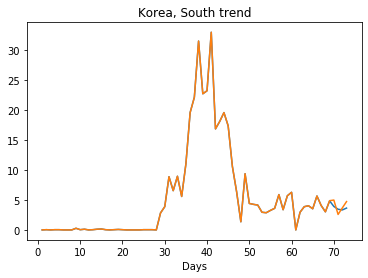

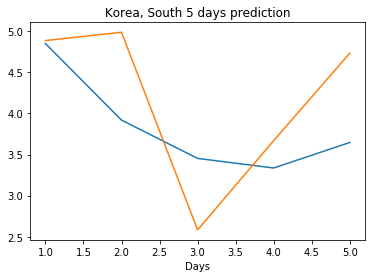

Creating directory ./offline6/Japan/training/
Japan
Saving the best model weights at Epoch [1], Best Valid Loss: 0.7736
Saving the best model weights at Epoch [2], Best Valid Loss: 0.7141


/space/home/nzhang/anaconda3/envs/neuralnet/lib/python3.7/site-packages/torch/nn/modules/loss.py:431: UserWarning: Using a target size (torch.Size([1, 1, 5])) that is different to the input size (torch.Size([5])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/space/home/nzhang/anaconda3/envs/neuralnet/lib/python3.7/site-packages/torch/nn/modules/loss.py:431: UserWarning: Using a target size (torch.Size([1, 5])) that is different to the input size (torch.Size([5])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Saving the best model weights at Epoch [3], Best Valid Loss: 0.7100
Saving the best model weights at Epoch [4], Best Valid Loss: 0.7025
Saving the best model weights at Epoch [5], Best Valid Loss: 0.6964
Saving the best model weights at Epoch [6], Best Valid Loss: 0.6648
Saving the best model weights at Epoch [8], Best Valid Loss: 0.6641
Saving the best model weights at Epoch [10], Best Valid Loss: 0.6563
Saving the best model weights at Epoch [11], Best Valid Loss: 0.6475
Saving the best model weights at Epoch [12], Best Valid Loss: 0.6367
Saving the best model weights at Epoch [14], Best Valid Loss: 0.6182
Saving the best model weights at Epoch [15], Best Valid Loss: 0.6174
Saving the best model weights at Epoch [16], Best Valid Loss: 0.5839
Saving the best model weights at Epoch [17], Best Valid Loss: 0.5762
Saving the best model weights at Epoch [20], Best Valid Loss: 0.5743
Saving the best model weights at Epoch [21], Best Valid Loss: 0.5572
Saving the best model weights at Epoch 

Saving the best model weights at Epoch [4], Best Valid Loss: 0.6784
Saving the best model weights at Epoch [9], Best Valid Loss: 0.6437
Saving the best model weights at Epoch [10], Best Valid Loss: 0.6403
Saving the best model weights at Epoch [11], Best Valid Loss: 0.5836
Saving the best model weights at Epoch [13], Best Valid Loss: 0.5517
Saving the best model weights at Epoch [15], Best Valid Loss: 0.5511
Saving the best model weights at Epoch [16], Best Valid Loss: 0.5397
Saving the best model weights at Epoch [17], Best Valid Loss: 0.5385
Saving the best model weights at Epoch [18], Best Valid Loss: 0.5303
Saving the best model weights at Epoch [19], Best Valid Loss: 0.5292
Saving the best model weights at Epoch [25], Best Valid Loss: 0.5225
Saving the best model weights at Epoch [26], Best Valid Loss: 0.5205
Saving the best model weights at Epoch [27], Best Valid Loss: 0.5166
Saving the best model weights at Epoch [38], Best Valid Loss: 0.5087
Saving the best model weights at Epo

Saving the best model weights at Epoch [31], Best Valid Loss: 0.7033
Saving the best model weights at Epoch [39], Best Valid Loss: 0.6994
Saving the best model weights at Epoch [45], Best Valid Loss: 0.6967
Saving the best model weights at Epoch [46], Best Valid Loss: 0.6769
train error: 0.07278551575482677
0.6768750548362732
Saving the best model weights at Epoch [1], Best Valid Loss: 0.7117
Saving the best model weights at Epoch [4], Best Valid Loss: 0.7098
Saving the best model weights at Epoch [13], Best Valid Loss: 0.7006
Saving the best model weights at Epoch [19], Best Valid Loss: 0.6785
Saving the best model weights at Epoch [29], Best Valid Loss: 0.6748
Saving the best model weights at Epoch [30], Best Valid Loss: 0.6528
Saving the best model weights at Epoch [37], Best Valid Loss: 0.6460
Saving the best model weights at Epoch [39], Best Valid Loss: 0.6322
Saving the best model weights at Epoch [40], Best Valid Loss: 0.6322
Saving the best model weights at Epoch [42], Best Val

Saving the best model weights at Epoch [8], Best Valid Loss: 0.5607
Saving the best model weights at Epoch [21], Best Valid Loss: 0.5524
Saving the best model weights at Epoch [30], Best Valid Loss: 0.4861
train error: 0.09455876943263176
0.4860747456550598
Saving the best model weights at Epoch [1], Best Valid Loss: 0.7260
Saving the best model weights at Epoch [4], Best Valid Loss: 0.7147
Saving the best model weights at Epoch [12], Best Valid Loss: 0.7072
train error: 0.07767600906816752
0.7071542739868164
Saving the best model weights at Epoch [1], Best Valid Loss: 0.7398
Saving the best model weights at Epoch [3], Best Valid Loss: 0.7166
Saving the best model weights at Epoch [7], Best Valid Loss: 0.6609
Saving the best model weights at Epoch [22], Best Valid Loss: 0.6536
train error: 0.0800489387720039
0.6535916924476624
Saving the best model weights at Epoch [1], Best Valid Loss: 0.8038
Saving the best model weights at Epoch [2], Best Valid Loss: 0.5959
train error: 0.0975356852

train error: 0.07779770293027947
0.655117928981781
Saving the best model weights at Epoch [1], Best Valid Loss: 0.8807
Saving the best model weights at Epoch [2], Best Valid Loss: 0.7998
Saving the best model weights at Epoch [6], Best Valid Loss: 0.5700
train error: 0.09363839542493224
0.570033609867096
Saving the best model weights at Epoch [1], Best Valid Loss: 0.7852
Saving the best model weights at Epoch [2], Best Valid Loss: 0.7749
Saving the best model weights at Epoch [3], Best Valid Loss: 0.7442
Saving the best model weights at Epoch [5], Best Valid Loss: 0.7400
Saving the best model weights at Epoch [10], Best Valid Loss: 0.7152
Saving the best model weights at Epoch [25], Best Valid Loss: 0.7102
Saving the best model weights at Epoch [28], Best Valid Loss: 0.6979
train error: 0.07797152079690836
0.6979064345359802
Saving the best model weights at Epoch [1], Best Valid Loss: 0.7098
Saving the best model weights at Epoch [4], Best Valid Loss: 0.6846
Saving the best model weigh

Saving the best model weights at Epoch [25], Best Valid Loss: 0.6181
Saving the best model weights at Epoch [27], Best Valid Loss: 0.6002
Saving the best model weights at Epoch [28], Best Valid Loss: 0.5996
Saving the best model weights at Epoch [29], Best Valid Loss: 0.5924
Saving the best model weights at Epoch [30], Best Valid Loss: 0.5821
Saving the best model weights at Epoch [31], Best Valid Loss: 0.5689
Saving the best model weights at Epoch [33], Best Valid Loss: 0.5590
Saving the best model weights at Epoch [35], Best Valid Loss: 0.5527
Saving the best model weights at Epoch [36], Best Valid Loss: 0.5447
Saving the best model weights at Epoch [37], Best Valid Loss: 0.5429
Saving the best model weights at Epoch [38], Best Valid Loss: 0.5428
Saving the best model weights at Epoch [39], Best Valid Loss: 0.5421
Saving the best model weights at Epoch [40], Best Valid Loss: 0.5353
Saving the best model weights at Epoch [41], Best Valid Loss: 0.5242
Saving the best model weights at E

Saving the best model weights at Epoch [19], Best Valid Loss: 0.6434
Saving the best model weights at Epoch [20], Best Valid Loss: 0.6346
Saving the best model weights at Epoch [22], Best Valid Loss: 0.6198
Saving the best model weights at Epoch [23], Best Valid Loss: 0.6146
Saving the best model weights at Epoch [24], Best Valid Loss: 0.6067
Saving the best model weights at Epoch [26], Best Valid Loss: 0.5940
Saving the best model weights at Epoch [27], Best Valid Loss: 0.5835
Saving the best model weights at Epoch [30], Best Valid Loss: 0.5773
Saving the best model weights at Epoch [31], Best Valid Loss: 0.5672
Saving the best model weights at Epoch [32], Best Valid Loss: 0.5664
Saving the best model weights at Epoch [33], Best Valid Loss: 0.5609
Saving the best model weights at Epoch [34], Best Valid Loss: 0.5527
Saving the best model weights at Epoch [36], Best Valid Loss: 0.5459
Saving the best model weights at Epoch [42], Best Valid Loss: 0.5436
Saving the best model weights at E

Saving the best model weights at Epoch [20], Best Valid Loss: 0.5768
Saving the best model weights at Epoch [23], Best Valid Loss: 0.5707
Saving the best model weights at Epoch [24], Best Valid Loss: 0.5581
Saving the best model weights at Epoch [25], Best Valid Loss: 0.5469
Saving the best model weights at Epoch [28], Best Valid Loss: 0.5469
Saving the best model weights at Epoch [29], Best Valid Loss: 0.5428
Saving the best model weights at Epoch [30], Best Valid Loss: 0.5348
Saving the best model weights at Epoch [31], Best Valid Loss: 0.5256
Saving the best model weights at Epoch [35], Best Valid Loss: 0.5189
Saving the best model weights at Epoch [41], Best Valid Loss: 0.5088
train error: 0.03788038124146528
0.5087783932685852
Saving the best model weights at Epoch [1], Best Valid Loss: 1.0832
Saving the best model weights at Epoch [2], Best Valid Loss: 1.0074
Saving the best model weights at Epoch [3], Best Valid Loss: 0.9472
Saving the best model weights at Epoch [4], Best Valid

Saving the best model weights at Epoch [22], Best Valid Loss: 0.5766
Saving the best model weights at Epoch [24], Best Valid Loss: 0.5613
Saving the best model weights at Epoch [26], Best Valid Loss: 0.5474
Saving the best model weights at Epoch [29], Best Valid Loss: 0.5371
Saving the best model weights at Epoch [32], Best Valid Loss: 0.5323
Saving the best model weights at Epoch [33], Best Valid Loss: 0.5296
Saving the best model weights at Epoch [36], Best Valid Loss: 0.5258
Saving the best model weights at Epoch [37], Best Valid Loss: 0.5200
Saving the best model weights at Epoch [38], Best Valid Loss: 0.5175
Saving the best model weights at Epoch [41], Best Valid Loss: 0.5068
Saving the best model weights at Epoch [43], Best Valid Loss: 0.5065
Saving the best model weights at Epoch [50], Best Valid Loss: 0.5043
train error: 0.038477810626653466
0.5043255090713501
Saving the best model weights at Epoch [1], Best Valid Loss: 0.9802
Saving the best model weights at Epoch [2], Best Va

Saving the best model weights at Epoch [3], Best Valid Loss: 0.7389
Saving the best model weights at Epoch [4], Best Valid Loss: 0.7319
Saving the best model weights at Epoch [7], Best Valid Loss: 0.7169
Saving the best model weights at Epoch [28], Best Valid Loss: 0.7141
Saving the best model weights at Epoch [41], Best Valid Loss: 0.7077
train error: 0.07293866334581062
0.7077044248580933
Saving the best model weights at Epoch [1], Best Valid Loss: 1.1827
Saving the best model weights at Epoch [2], Best Valid Loss: 1.0971
Saving the best model weights at Epoch [3], Best Valid Loss: 1.0288
Saving the best model weights at Epoch [4], Best Valid Loss: 0.9743
Saving the best model weights at Epoch [5], Best Valid Loss: 0.9307
Saving the best model weights at Epoch [6], Best Valid Loss: 0.8950
Saving the best model weights at Epoch [7], Best Valid Loss: 0.8671
Saving the best model weights at Epoch [8], Best Valid Loss: 0.8434
Saving the best model weights at Epoch [9], Best Valid Loss: 0

Saving the best model weights at Epoch [12], Best Valid Loss: 0.7431
Saving the best model weights at Epoch [13], Best Valid Loss: 0.7409
Saving the best model weights at Epoch [14], Best Valid Loss: 0.7388
Saving the best model weights at Epoch [15], Best Valid Loss: 0.7363
Saving the best model weights at Epoch [34], Best Valid Loss: 0.7358
Saving the best model weights at Epoch [35], Best Valid Loss: 0.7355
Saving the best model weights at Epoch [50], Best Valid Loss: 0.7342
train error: 0.07480439644208864
0.7341837286949158
Saving the best model weights at Epoch [1], Best Valid Loss: 0.8081
Saving the best model weights at Epoch [2], Best Valid Loss: 0.7362
Saving the best model weights at Epoch [4], Best Valid Loss: 0.7294
Saving the best model weights at Epoch [5], Best Valid Loss: 0.7251
Saving the best model weights at Epoch [9], Best Valid Loss: 0.7233
Saving the best model weights at Epoch [12], Best Valid Loss: 0.7126
Saving the best model weights at Epoch [44], Best Valid 

Saving the best model weights at Epoch [42], Best Valid Loss: 0.7382
Saving the best model weights at Epoch [43], Best Valid Loss: 0.7380
train error: 0.07500027773264599
0.7380236983299255
Saving the best model weights at Epoch [1], Best Valid Loss: 1.1215
Saving the best model weights at Epoch [2], Best Valid Loss: 0.9997
Saving the best model weights at Epoch [3], Best Valid Loss: 0.9186
Saving the best model weights at Epoch [4], Best Valid Loss: 0.8636
Saving the best model weights at Epoch [5], Best Valid Loss: 0.8241
Saving the best model weights at Epoch [6], Best Valid Loss: 0.7983
Saving the best model weights at Epoch [7], Best Valid Loss: 0.7786
Saving the best model weights at Epoch [8], Best Valid Loss: 0.7652
Saving the best model weights at Epoch [9], Best Valid Loss: 0.7567
Saving the best model weights at Epoch [10], Best Valid Loss: 0.7522
Saving the best model weights at Epoch [11], Best Valid Loss: 0.7492
Saving the best model weights at Epoch [12], Best Valid Loss

Saving the best model weights at Epoch [4], Best Valid Loss: 0.8384
Saving the best model weights at Epoch [5], Best Valid Loss: 0.8108
Saving the best model weights at Epoch [6], Best Valid Loss: 0.7885
Saving the best model weights at Epoch [7], Best Valid Loss: 0.7749
Saving the best model weights at Epoch [8], Best Valid Loss: 0.7634
Saving the best model weights at Epoch [9], Best Valid Loss: 0.7571
Saving the best model weights at Epoch [10], Best Valid Loss: 0.7520
Saving the best model weights at Epoch [11], Best Valid Loss: 0.7487
Saving the best model weights at Epoch [12], Best Valid Loss: 0.7457
Saving the best model weights at Epoch [13], Best Valid Loss: 0.7447
Saving the best model weights at Epoch [14], Best Valid Loss: 0.7423
Saving the best model weights at Epoch [19], Best Valid Loss: 0.7423
Saving the best model weights at Epoch [20], Best Valid Loss: 0.7405
Saving the best model weights at Epoch [21], Best Valid Loss: 0.7384
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [28], Best Valid Loss: 0.7417
Saving the best model weights at Epoch [29], Best Valid Loss: 0.7411
Saving the best model weights at Epoch [30], Best Valid Loss: 0.7408
Saving the best model weights at Epoch [31], Best Valid Loss: 0.7403
Saving the best model weights at Epoch [32], Best Valid Loss: 0.7393
Saving the best model weights at Epoch [33], Best Valid Loss: 0.7390
Saving the best model weights at Epoch [34], Best Valid Loss: 0.7389
Saving the best model weights at Epoch [35], Best Valid Loss: 0.7385
Saving the best model weights at Epoch [37], Best Valid Loss: 0.7382
Saving the best model weights at Epoch [39], Best Valid Loss: 0.7381
Saving the best model weights at Epoch [40], Best Valid Loss: 0.7380
Saving the best model weights at Epoch [41], Best Valid Loss: 0.7379
Saving the best model weights at Epoch [42], Best Valid Loss: 0.7378
Saving the best model weights at Epoch [48], Best Valid Loss: 0.7378
Saving the best model weights at E

Saving the best model weights at Epoch [16], Best Valid Loss: 0.7542
Saving the best model weights at Epoch [17], Best Valid Loss: 0.7522
Saving the best model weights at Epoch [18], Best Valid Loss: 0.7497
Saving the best model weights at Epoch [19], Best Valid Loss: 0.7475
Saving the best model weights at Epoch [20], Best Valid Loss: 0.7456
Saving the best model weights at Epoch [21], Best Valid Loss: 0.7446
Saving the best model weights at Epoch [22], Best Valid Loss: 0.7433
Saving the best model weights at Epoch [23], Best Valid Loss: 0.7424
Saving the best model weights at Epoch [24], Best Valid Loss: 0.7417
Saving the best model weights at Epoch [25], Best Valid Loss: 0.7414
Saving the best model weights at Epoch [26], Best Valid Loss: 0.7407
Saving the best model weights at Epoch [28], Best Valid Loss: 0.7405
Saving the best model weights at Epoch [29], Best Valid Loss: 0.7401
Saving the best model weights at Epoch [30], Best Valid Loss: 0.7400
Saving the best model weights at E

Saving the best model weights at Epoch [14], Best Valid Loss: 0.7607
Saving the best model weights at Epoch [15], Best Valid Loss: 0.7565
Saving the best model weights at Epoch [16], Best Valid Loss: 0.7530
Saving the best model weights at Epoch [17], Best Valid Loss: 0.7507
Saving the best model weights at Epoch [18], Best Valid Loss: 0.7487
Saving the best model weights at Epoch [19], Best Valid Loss: 0.7471
Saving the best model weights at Epoch [20], Best Valid Loss: 0.7462
Saving the best model weights at Epoch [21], Best Valid Loss: 0.7450
Saving the best model weights at Epoch [22], Best Valid Loss: 0.7444
Saving the best model weights at Epoch [23], Best Valid Loss: 0.7436
Saving the best model weights at Epoch [24], Best Valid Loss: 0.7427
Saving the best model weights at Epoch [25], Best Valid Loss: 0.7420
Saving the best model weights at Epoch [26], Best Valid Loss: 0.7417
Saving the best model weights at Epoch [27], Best Valid Loss: 0.7411
Saving the best model weights at E

Saving the best model weights at Epoch [18], Best Valid Loss: 0.7511
Saving the best model weights at Epoch [19], Best Valid Loss: 0.7487
Saving the best model weights at Epoch [20], Best Valid Loss: 0.7471
Saving the best model weights at Epoch [21], Best Valid Loss: 0.7457
Saving the best model weights at Epoch [22], Best Valid Loss: 0.7442
Saving the best model weights at Epoch [23], Best Valid Loss: 0.7439
Saving the best model weights at Epoch [24], Best Valid Loss: 0.7428
Saving the best model weights at Epoch [25], Best Valid Loss: 0.7423
Saving the best model weights at Epoch [26], Best Valid Loss: 0.7415
Saving the best model weights at Epoch [27], Best Valid Loss: 0.7411
Saving the best model weights at Epoch [28], Best Valid Loss: 0.7407
Saving the best model weights at Epoch [29], Best Valid Loss: 0.7402
Saving the best model weights at Epoch [31], Best Valid Loss: 0.7402
Saving the best model weights at Epoch [32], Best Valid Loss: 0.7398
Saving the best model weights at E

Saving the best model weights at Epoch [24], Best Valid Loss: 1.0715
Saving the best model weights at Epoch [25], Best Valid Loss: 1.0596
Saving the best model weights at Epoch [26], Best Valid Loss: 1.0482
Saving the best model weights at Epoch [27], Best Valid Loss: 1.0375
Saving the best model weights at Epoch [28], Best Valid Loss: 1.0268
Saving the best model weights at Epoch [29], Best Valid Loss: 1.0166
Saving the best model weights at Epoch [30], Best Valid Loss: 1.0069
Saving the best model weights at Epoch [31], Best Valid Loss: 0.9975
Saving the best model weights at Epoch [32], Best Valid Loss: 0.9884
Saving the best model weights at Epoch [33], Best Valid Loss: 0.9798
Saving the best model weights at Epoch [34], Best Valid Loss: 0.9716
Saving the best model weights at Epoch [35], Best Valid Loss: 0.9636
Saving the best model weights at Epoch [36], Best Valid Loss: 0.9558
Saving the best model weights at Epoch [37], Best Valid Loss: 0.9485
Saving the best model weights at E

Saving the best model weights at Epoch [6], Best Valid Loss: 1.0689
Saving the best model weights at Epoch [7], Best Valid Loss: 1.0536
Saving the best model weights at Epoch [8], Best Valid Loss: 1.0398
Saving the best model weights at Epoch [9], Best Valid Loss: 1.0259
Saving the best model weights at Epoch [10], Best Valid Loss: 1.0125
Saving the best model weights at Epoch [11], Best Valid Loss: 1.0004
Saving the best model weights at Epoch [12], Best Valid Loss: 0.9885
Saving the best model weights at Epoch [13], Best Valid Loss: 0.9771
Saving the best model weights at Epoch [14], Best Valid Loss: 0.9667
Saving the best model weights at Epoch [15], Best Valid Loss: 0.9568
Saving the best model weights at Epoch [16], Best Valid Loss: 0.9463
Saving the best model weights at Epoch [17], Best Valid Loss: 0.9368
Saving the best model weights at Epoch [18], Best Valid Loss: 0.9283
Saving the best model weights at Epoch [19], Best Valid Loss: 0.9193
Saving the best model weights at Epoch

Saving the best model weights at Epoch [38], Best Valid Loss: 1.0035
Saving the best model weights at Epoch [39], Best Valid Loss: 0.9979
Saving the best model weights at Epoch [40], Best Valid Loss: 0.9923
Saving the best model weights at Epoch [41], Best Valid Loss: 0.9869
Saving the best model weights at Epoch [42], Best Valid Loss: 0.9817
Saving the best model weights at Epoch [43], Best Valid Loss: 0.9765
Saving the best model weights at Epoch [44], Best Valid Loss: 0.9715
Saving the best model weights at Epoch [45], Best Valid Loss: 0.9666
Saving the best model weights at Epoch [46], Best Valid Loss: 0.9618
Saving the best model weights at Epoch [47], Best Valid Loss: 0.9570
Saving the best model weights at Epoch [48], Best Valid Loss: 0.9524
Saving the best model weights at Epoch [49], Best Valid Loss: 0.9480
Saving the best model weights at Epoch [50], Best Valid Loss: 0.9436
train error: 0.09487197054611322
0.9435829520225525
Saving the best model weights at Epoch [1], Best Va

Saving the best model weights at Epoch [19], Best Valid Loss: 1.0535
Saving the best model weights at Epoch [20], Best Valid Loss: 1.0465
Saving the best model weights at Epoch [21], Best Valid Loss: 1.0398
Saving the best model weights at Epoch [22], Best Valid Loss: 1.0331
Saving the best model weights at Epoch [23], Best Valid Loss: 1.0266
Saving the best model weights at Epoch [24], Best Valid Loss: 1.0203
Saving the best model weights at Epoch [25], Best Valid Loss: 1.0141
Saving the best model weights at Epoch [26], Best Valid Loss: 1.0081
Saving the best model weights at Epoch [27], Best Valid Loss: 1.0022
Saving the best model weights at Epoch [28], Best Valid Loss: 0.9964
Saving the best model weights at Epoch [29], Best Valid Loss: 0.9908
Saving the best model weights at Epoch [30], Best Valid Loss: 0.9853
Saving the best model weights at Epoch [31], Best Valid Loss: 0.9799
Saving the best model weights at Epoch [32], Best Valid Loss: 0.9747
Saving the best model weights at E

Saving the best model weights at Epoch [49], Best Valid Loss: 0.6813
train error: 0.06724130749506385
0.6813181638717651
Saving the best model weights at Epoch [1], Best Valid Loss: 1.2239
Saving the best model weights at Epoch [2], Best Valid Loss: 1.2124
Saving the best model weights at Epoch [3], Best Valid Loss: 1.2013
Saving the best model weights at Epoch [4], Best Valid Loss: 1.1904
Saving the best model weights at Epoch [5], Best Valid Loss: 1.1798
Saving the best model weights at Epoch [6], Best Valid Loss: 1.1695
Saving the best model weights at Epoch [7], Best Valid Loss: 1.1595
Saving the best model weights at Epoch [8], Best Valid Loss: 1.1497
Saving the best model weights at Epoch [9], Best Valid Loss: 1.1401
Saving the best model weights at Epoch [10], Best Valid Loss: 1.1309
Saving the best model weights at Epoch [11], Best Valid Loss: 1.1218
Saving the best model weights at Epoch [12], Best Valid Loss: 1.1130
Saving the best model weights at Epoch [13], Best Valid Loss

Saving the best model weights at Epoch [18], Best Valid Loss: 0.7611
Saving the best model weights at Epoch [19], Best Valid Loss: 0.7546
Saving the best model weights at Epoch [21], Best Valid Loss: 0.7513
Saving the best model weights at Epoch [22], Best Valid Loss: 0.7483
Saving the best model weights at Epoch [24], Best Valid Loss: 0.7459
Saving the best model weights at Epoch [25], Best Valid Loss: 0.7454
Saving the best model weights at Epoch [27], Best Valid Loss: 0.7429
Saving the best model weights at Epoch [28], Best Valid Loss: 0.7409
Saving the best model weights at Epoch [30], Best Valid Loss: 0.7389
Saving the best model weights at Epoch [36], Best Valid Loss: 0.7388
Saving the best model weights at Epoch [38], Best Valid Loss: 0.7377
Saving the best model weights at Epoch [45], Best Valid Loss: 0.7375
Saving the best model weights at Epoch [48], Best Valid Loss: 0.7374
train error: 0.07494717555757809
0.7374459505081177
Saving the best model weights at Epoch [1], Best Va

Saving the best model weights at Epoch [5], Best Valid Loss: 0.8922
Saving the best model weights at Epoch [6], Best Valid Loss: 0.8647
Saving the best model weights at Epoch [7], Best Valid Loss: 0.8472
Saving the best model weights at Epoch [8], Best Valid Loss: 0.8279
Saving the best model weights at Epoch [9], Best Valid Loss: 0.8138
Saving the best model weights at Epoch [10], Best Valid Loss: 0.7996
Saving the best model weights at Epoch [11], Best Valid Loss: 0.7906
Saving the best model weights at Epoch [12], Best Valid Loss: 0.7868
Saving the best model weights at Epoch [13], Best Valid Loss: 0.7778
Saving the best model weights at Epoch [14], Best Valid Loss: 0.7697
Saving the best model weights at Epoch [15], Best Valid Loss: 0.7655
Saving the best model weights at Epoch [16], Best Valid Loss: 0.7614
Saving the best model weights at Epoch [17], Best Valid Loss: 0.7561
Saving the best model weights at Epoch [18], Best Valid Loss: 0.7536
Saving the best model weights at Epoch 

Saving the best model weights at Epoch [45], Best Valid Loss: 0.7977
Saving the best model weights at Epoch [46], Best Valid Loss: 0.7957
Saving the best model weights at Epoch [47], Best Valid Loss: 0.7941
Saving the best model weights at Epoch [48], Best Valid Loss: 0.7914
Saving the best model weights at Epoch [49], Best Valid Loss: 0.7896
Saving the best model weights at Epoch [50], Best Valid Loss: 0.7879
train error: 0.07773912775232211
0.7878591418266296
Saving the best model weights at Epoch [1], Best Valid Loss: 1.1168
Saving the best model weights at Epoch [2], Best Valid Loss: 1.0495
Saving the best model weights at Epoch [3], Best Valid Loss: 0.9924
Saving the best model weights at Epoch [4], Best Valid Loss: 0.9468
Saving the best model weights at Epoch [5], Best Valid Loss: 0.9111
Saving the best model weights at Epoch [6], Best Valid Loss: 0.8807
Saving the best model weights at Epoch [7], Best Valid Loss: 0.8551
Saving the best model weights at Epoch [8], Best Valid Los

Saving the best model weights at Epoch [30], Best Valid Loss: 0.9016
Saving the best model weights at Epoch [31], Best Valid Loss: 0.8960
Saving the best model weights at Epoch [32], Best Valid Loss: 0.8908
Saving the best model weights at Epoch [33], Best Valid Loss: 0.8851
Saving the best model weights at Epoch [34], Best Valid Loss: 0.8799
Saving the best model weights at Epoch [35], Best Valid Loss: 0.8751
Saving the best model weights at Epoch [36], Best Valid Loss: 0.8708
Saving the best model weights at Epoch [37], Best Valid Loss: 0.8658
Saving the best model weights at Epoch [38], Best Valid Loss: 0.8616
Saving the best model weights at Epoch [39], Best Valid Loss: 0.8570
Saving the best model weights at Epoch [40], Best Valid Loss: 0.8529
Saving the best model weights at Epoch [41], Best Valid Loss: 0.8491
Saving the best model weights at Epoch [42], Best Valid Loss: 0.8453
Saving the best model weights at Epoch [43], Best Valid Loss: 0.8416
Saving the best model weights at E

Saving the best model weights at Epoch [22], Best Valid Loss: 0.9971
Saving the best model weights at Epoch [23], Best Valid Loss: 0.9868
Saving the best model weights at Epoch [24], Best Valid Loss: 0.9769
Saving the best model weights at Epoch [25], Best Valid Loss: 0.9679
Saving the best model weights at Epoch [26], Best Valid Loss: 0.9587
Saving the best model weights at Epoch [27], Best Valid Loss: 0.9502
Saving the best model weights at Epoch [28], Best Valid Loss: 0.9425
Saving the best model weights at Epoch [29], Best Valid Loss: 0.9342
Saving the best model weights at Epoch [30], Best Valid Loss: 0.9265
Saving the best model weights at Epoch [31], Best Valid Loss: 0.9194
Saving the best model weights at Epoch [32], Best Valid Loss: 0.9125
Saving the best model weights at Epoch [33], Best Valid Loss: 0.9062
Saving the best model weights at Epoch [34], Best Valid Loss: 0.8996
Saving the best model weights at Epoch [35], Best Valid Loss: 0.8934
Saving the best model weights at E

Saving the best model weights at Epoch [5], Best Valid Loss: 0.9728
Saving the best model weights at Epoch [6], Best Valid Loss: 0.9634
Saving the best model weights at Epoch [7], Best Valid Loss: 0.9542
Saving the best model weights at Epoch [8], Best Valid Loss: 0.9454
Saving the best model weights at Epoch [9], Best Valid Loss: 0.9374
Saving the best model weights at Epoch [10], Best Valid Loss: 0.9291
Saving the best model weights at Epoch [11], Best Valid Loss: 0.9217
Saving the best model weights at Epoch [12], Best Valid Loss: 0.9145
Saving the best model weights at Epoch [13], Best Valid Loss: 0.9075
Saving the best model weights at Epoch [14], Best Valid Loss: 0.9009
Saving the best model weights at Epoch [15], Best Valid Loss: 0.8948
Saving the best model weights at Epoch [16], Best Valid Loss: 0.8883
Saving the best model weights at Epoch [17], Best Valid Loss: 0.8825
Saving the best model weights at Epoch [18], Best Valid Loss: 0.8770
Saving the best model weights at Epoch 

Saving the best model weights at Epoch [44], Best Valid Loss: 0.9338
Saving the best model weights at Epoch [45], Best Valid Loss: 0.9299
Saving the best model weights at Epoch [46], Best Valid Loss: 0.9260
Saving the best model weights at Epoch [47], Best Valid Loss: 0.9223
Saving the best model weights at Epoch [48], Best Valid Loss: 0.9186
Saving the best model weights at Epoch [49], Best Valid Loss: 0.9150
Saving the best model weights at Epoch [50], Best Valid Loss: 0.9114
train error: 0.09409797077349044
0.9114387631416321
Saving the best model weights at Epoch [1], Best Valid Loss: 1.2662
Saving the best model weights at Epoch [2], Best Valid Loss: 1.2447
Saving the best model weights at Epoch [3], Best Valid Loss: 1.2251
Saving the best model weights at Epoch [4], Best Valid Loss: 1.2057
Saving the best model weights at Epoch [5], Best Valid Loss: 1.1874
Saving the best model weights at Epoch [6], Best Valid Loss: 1.1694
Saving the best model weights at Epoch [7], Best Valid Lo

Saving the best model weights at Epoch [32], Best Valid Loss: 0.9924
Saving the best model weights at Epoch [33], Best Valid Loss: 0.9872
Saving the best model weights at Epoch [34], Best Valid Loss: 0.9821
Saving the best model weights at Epoch [35], Best Valid Loss: 0.9771
Saving the best model weights at Epoch [36], Best Valid Loss: 0.9722
Saving the best model weights at Epoch [37], Best Valid Loss: 0.9674
Saving the best model weights at Epoch [38], Best Valid Loss: 0.9628
Saving the best model weights at Epoch [39], Best Valid Loss: 0.9582
Saving the best model weights at Epoch [40], Best Valid Loss: 0.9537
Saving the best model weights at Epoch [41], Best Valid Loss: 0.9494
Saving the best model weights at Epoch [42], Best Valid Loss: 0.9451
Saving the best model weights at Epoch [43], Best Valid Loss: 0.9409
Saving the best model weights at Epoch [44], Best Valid Loss: 0.9368
Saving the best model weights at Epoch [45], Best Valid Loss: 0.9328
Saving the best model weights at E

Saving the best model weights at Epoch [24], Best Valid Loss: 1.1561
Saving the best model weights at Epoch [25], Best Valid Loss: 1.1474
Saving the best model weights at Epoch [26], Best Valid Loss: 1.1388
Saving the best model weights at Epoch [27], Best Valid Loss: 1.1304
Saving the best model weights at Epoch [28], Best Valid Loss: 1.1222
Saving the best model weights at Epoch [29], Best Valid Loss: 1.1142
Saving the best model weights at Epoch [30], Best Valid Loss: 1.1063
Saving the best model weights at Epoch [31], Best Valid Loss: 1.0987
Saving the best model weights at Epoch [32], Best Valid Loss: 1.0912
Saving the best model weights at Epoch [33], Best Valid Loss: 1.0838
Saving the best model weights at Epoch [34], Best Valid Loss: 1.0767
Saving the best model weights at Epoch [35], Best Valid Loss: 1.0697
Saving the best model weights at Epoch [36], Best Valid Loss: 1.0629
Saving the best model weights at Epoch [37], Best Valid Loss: 1.0562
Saving the best model weights at E

Saving the best model weights at Epoch [12], Best Valid Loss: 0.9879
Saving the best model weights at Epoch [13], Best Valid Loss: 0.9822
Saving the best model weights at Epoch [14], Best Valid Loss: 0.9766
Saving the best model weights at Epoch [15], Best Valid Loss: 0.9713
Saving the best model weights at Epoch [16], Best Valid Loss: 0.9660
Saving the best model weights at Epoch [17], Best Valid Loss: 0.9609
Saving the best model weights at Epoch [18], Best Valid Loss: 0.9559
Saving the best model weights at Epoch [19], Best Valid Loss: 0.9510
Saving the best model weights at Epoch [20], Best Valid Loss: 0.9463
Saving the best model weights at Epoch [21], Best Valid Loss: 0.9417
Saving the best model weights at Epoch [22], Best Valid Loss: 0.9372
Saving the best model weights at Epoch [23], Best Valid Loss: 0.9328
Saving the best model weights at Epoch [24], Best Valid Loss: 0.9285
Saving the best model weights at Epoch [25], Best Valid Loss: 0.9243
Saving the best model weights at E

train error: 0.07480110089588714
0.7362821698188782
Saving the best model weights at Epoch [1], Best Valid Loss: 1.2370
Saving the best model weights at Epoch [2], Best Valid Loss: 1.2259
Saving the best model weights at Epoch [3], Best Valid Loss: 1.2151
Saving the best model weights at Epoch [4], Best Valid Loss: 1.2045
Saving the best model weights at Epoch [5], Best Valid Loss: 1.1942
Saving the best model weights at Epoch [6], Best Valid Loss: 1.1841
Saving the best model weights at Epoch [7], Best Valid Loss: 1.1743
Saving the best model weights at Epoch [8], Best Valid Loss: 1.1648
Saving the best model weights at Epoch [9], Best Valid Loss: 1.1554
Saving the best model weights at Epoch [10], Best Valid Loss: 1.1463
Saving the best model weights at Epoch [11], Best Valid Loss: 1.1374
Saving the best model weights at Epoch [12], Best Valid Loss: 1.1288
Saving the best model weights at Epoch [13], Best Valid Loss: 1.1203
Saving the best model weights at Epoch [14], Best Valid Loss

Saving the best model weights at Epoch [18], Best Valid Loss: 0.7576
Saving the best model weights at Epoch [19], Best Valid Loss: 0.7546
Saving the best model weights at Epoch [20], Best Valid Loss: 0.7536
Saving the best model weights at Epoch [21], Best Valid Loss: 0.7475
Saving the best model weights at Epoch [23], Best Valid Loss: 0.7441
Saving the best model weights at Epoch [25], Best Valid Loss: 0.7419
Saving the best model weights at Epoch [27], Best Valid Loss: 0.7416
Saving the best model weights at Epoch [28], Best Valid Loss: 0.7407
Saving the best model weights at Epoch [29], Best Valid Loss: 0.7400
Saving the best model weights at Epoch [35], Best Valid Loss: 0.7366
Saving the best model weights at Epoch [41], Best Valid Loss: 0.7364
Saving the best model weights at Epoch [48], Best Valid Loss: 0.7359
train error: 0.07474388787522912
0.7358622550964355
Saving the best model weights at Epoch [1], Best Valid Loss: 1.2516
Saving the best model weights at Epoch [2], Best Val

Saving the best model weights at Epoch [6], Best Valid Loss: 0.8727
Saving the best model weights at Epoch [7], Best Valid Loss: 0.8528
Saving the best model weights at Epoch [8], Best Valid Loss: 0.8319
Saving the best model weights at Epoch [9], Best Valid Loss: 0.8163
Saving the best model weights at Epoch [10], Best Valid Loss: 0.8027
Saving the best model weights at Epoch [11], Best Valid Loss: 0.7904
Saving the best model weights at Epoch [12], Best Valid Loss: 0.7853
Saving the best model weights at Epoch [13], Best Valid Loss: 0.7786
Saving the best model weights at Epoch [14], Best Valid Loss: 0.7726
Saving the best model weights at Epoch [15], Best Valid Loss: 0.7642
Saving the best model weights at Epoch [16], Best Valid Loss: 0.7619
Saving the best model weights at Epoch [17], Best Valid Loss: 0.7561
Saving the best model weights at Epoch [18], Best Valid Loss: 0.7536
Saving the best model weights at Epoch [19], Best Valid Loss: 0.7488
Saving the best model weights at Epoch

Saving the best model weights at Epoch [47], Best Valid Loss: 0.7751
Saving the best model weights at Epoch [48], Best Valid Loss: 0.7738
Saving the best model weights at Epoch [49], Best Valid Loss: 0.7726
Saving the best model weights at Epoch [50], Best Valid Loss: 0.7716
train error: 0.07727408279223662
0.7715656161308289
Saving the best model weights at Epoch [1], Best Valid Loss: 1.2329
Saving the best model weights at Epoch [2], Best Valid Loss: 1.1424
Saving the best model weights at Epoch [3], Best Valid Loss: 1.0649
Saving the best model weights at Epoch [4], Best Valid Loss: 1.0010
Saving the best model weights at Epoch [5], Best Valid Loss: 0.9560
Saving the best model weights at Epoch [6], Best Valid Loss: 0.9170
Saving the best model weights at Epoch [7], Best Valid Loss: 0.8863
Saving the best model weights at Epoch [8], Best Valid Loss: 0.8659
Saving the best model weights at Epoch [9], Best Valid Loss: 0.8413
Saving the best model weights at Epoch [10], Best Valid Loss

Saving the best model weights at Epoch [34], Best Valid Loss: 0.8788
Saving the best model weights at Epoch [35], Best Valid Loss: 0.8737
Saving the best model weights at Epoch [36], Best Valid Loss: 0.8691
Saving the best model weights at Epoch [37], Best Valid Loss: 0.8644
Saving the best model weights at Epoch [38], Best Valid Loss: 0.8601
Saving the best model weights at Epoch [39], Best Valid Loss: 0.8557
Saving the best model weights at Epoch [40], Best Valid Loss: 0.8517
Saving the best model weights at Epoch [41], Best Valid Loss: 0.8479
Saving the best model weights at Epoch [42], Best Valid Loss: 0.8439
Saving the best model weights at Epoch [43], Best Valid Loss: 0.8402
Saving the best model weights at Epoch [44], Best Valid Loss: 0.8370
Saving the best model weights at Epoch [45], Best Valid Loss: 0.8332
Saving the best model weights at Epoch [46], Best Valid Loss: 0.8300
Saving the best model weights at Epoch [47], Best Valid Loss: 0.8267
Saving the best model weights at E

Saving the best model weights at Epoch [22], Best Valid Loss: 0.9137
Saving the best model weights at Epoch [23], Best Valid Loss: 0.9075
Saving the best model weights at Epoch [24], Best Valid Loss: 0.9013
Saving the best model weights at Epoch [25], Best Valid Loss: 0.8957
Saving the best model weights at Epoch [26], Best Valid Loss: 0.8901
Saving the best model weights at Epoch [27], Best Valid Loss: 0.8846
Saving the best model weights at Epoch [28], Best Valid Loss: 0.8794
Saving the best model weights at Epoch [29], Best Valid Loss: 0.8743
Saving the best model weights at Epoch [30], Best Valid Loss: 0.8696
Saving the best model weights at Epoch [31], Best Valid Loss: 0.8648
Saving the best model weights at Epoch [32], Best Valid Loss: 0.8604
Saving the best model weights at Epoch [33], Best Valid Loss: 0.8561
Saving the best model weights at Epoch [34], Best Valid Loss: 0.8522
Saving the best model weights at Epoch [35], Best Valid Loss: 0.8479
Saving the best model weights at E

Saving the best model weights at Epoch [12], Best Valid Loss: 1.0104
Saving the best model weights at Epoch [13], Best Valid Loss: 1.0004
Saving the best model weights at Epoch [14], Best Valid Loss: 0.9909
Saving the best model weights at Epoch [15], Best Valid Loss: 0.9820
Saving the best model weights at Epoch [16], Best Valid Loss: 0.9729
Saving the best model weights at Epoch [17], Best Valid Loss: 0.9639
Saving the best model weights at Epoch [18], Best Valid Loss: 0.9560
Saving the best model weights at Epoch [19], Best Valid Loss: 0.9479
Saving the best model weights at Epoch [20], Best Valid Loss: 0.9403
Saving the best model weights at Epoch [21], Best Valid Loss: 0.9331
Saving the best model weights at Epoch [22], Best Valid Loss: 0.9264
Saving the best model weights at Epoch [23], Best Valid Loss: 0.9196
Saving the best model weights at Epoch [24], Best Valid Loss: 0.9131
Saving the best model weights at Epoch [25], Best Valid Loss: 0.9069
Saving the best model weights at E

Saving the best model weights at Epoch [49], Best Valid Loss: 1.2290
Saving the best model weights at Epoch [50], Best Valid Loss: 1.2279
train error: 0.17013646319116416
1.2278581857681274
Saving the best model weights at Epoch [1], Best Valid Loss: 1.1998
Saving the best model weights at Epoch [2], Best Valid Loss: 1.1978
Saving the best model weights at Epoch [3], Best Valid Loss: 1.1958
Saving the best model weights at Epoch [4], Best Valid Loss: 1.1937
Saving the best model weights at Epoch [5], Best Valid Loss: 1.1917
Saving the best model weights at Epoch [6], Best Valid Loss: 1.1898
Saving the best model weights at Epoch [7], Best Valid Loss: 1.1878
Saving the best model weights at Epoch [8], Best Valid Loss: 1.1858
Saving the best model weights at Epoch [9], Best Valid Loss: 1.1838
Saving the best model weights at Epoch [10], Best Valid Loss: 1.1819
Saving the best model weights at Epoch [11], Best Valid Loss: 1.1799
Saving the best model weights at Epoch [12], Best Valid Loss

Saving the best model weights at Epoch [16], Best Valid Loss: 1.0189
Saving the best model weights at Epoch [17], Best Valid Loss: 1.0181
Saving the best model weights at Epoch [18], Best Valid Loss: 1.0173
Saving the best model weights at Epoch [19], Best Valid Loss: 1.0166
Saving the best model weights at Epoch [20], Best Valid Loss: 1.0158
Saving the best model weights at Epoch [21], Best Valid Loss: 1.0150
Saving the best model weights at Epoch [22], Best Valid Loss: 1.0143
Saving the best model weights at Epoch [23], Best Valid Loss: 1.0135
Saving the best model weights at Epoch [24], Best Valid Loss: 1.0128
Saving the best model weights at Epoch [25], Best Valid Loss: 1.0120
Saving the best model weights at Epoch [26], Best Valid Loss: 1.0112
Saving the best model weights at Epoch [27], Best Valid Loss: 1.0105
Saving the best model weights at Epoch [28], Best Valid Loss: 1.0097
Saving the best model weights at Epoch [29], Best Valid Loss: 1.0090
Saving the best model weights at E

Saving the best model weights at Epoch [36], Best Valid Loss: 0.9840
Saving the best model weights at Epoch [37], Best Valid Loss: 0.9794
Saving the best model weights at Epoch [38], Best Valid Loss: 0.9746
Saving the best model weights at Epoch [39], Best Valid Loss: 0.9698
Saving the best model weights at Epoch [40], Best Valid Loss: 0.9653
Saving the best model weights at Epoch [41], Best Valid Loss: 0.9608
Saving the best model weights at Epoch [42], Best Valid Loss: 0.9562
Saving the best model weights at Epoch [43], Best Valid Loss: 0.9518
Saving the best model weights at Epoch [44], Best Valid Loss: 0.9476
Saving the best model weights at Epoch [45], Best Valid Loss: 0.9434
Saving the best model weights at Epoch [46], Best Valid Loss: 0.9395
Saving the best model weights at Epoch [47], Best Valid Loss: 0.9357
Saving the best model weights at Epoch [48], Best Valid Loss: 0.9319
Saving the best model weights at Epoch [49], Best Valid Loss: 0.9276
Saving the best model weights at E

Saving the best model weights at Epoch [3], Best Valid Loss: 1.0746
Saving the best model weights at Epoch [4], Best Valid Loss: 1.0675
Saving the best model weights at Epoch [5], Best Valid Loss: 1.0604
Saving the best model weights at Epoch [6], Best Valid Loss: 1.0541
Saving the best model weights at Epoch [7], Best Valid Loss: 1.0472
Saving the best model weights at Epoch [8], Best Valid Loss: 1.0408
Saving the best model weights at Epoch [9], Best Valid Loss: 1.0349
Saving the best model weights at Epoch [10], Best Valid Loss: 1.0286
Saving the best model weights at Epoch [11], Best Valid Loss: 1.0228
Saving the best model weights at Epoch [12], Best Valid Loss: 1.0171
Saving the best model weights at Epoch [13], Best Valid Loss: 1.0113
Saving the best model weights at Epoch [14], Best Valid Loss: 1.0060
Saving the best model weights at Epoch [15], Best Valid Loss: 1.0012
Saving the best model weights at Epoch [16], Best Valid Loss: 0.9951
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [22], Best Valid Loss: 1.1016
Saving the best model weights at Epoch [23], Best Valid Loss: 1.1000
Saving the best model weights at Epoch [24], Best Valid Loss: 1.0984
Saving the best model weights at Epoch [25], Best Valid Loss: 1.0968
Saving the best model weights at Epoch [26], Best Valid Loss: 1.0953
Saving the best model weights at Epoch [27], Best Valid Loss: 1.0937
Saving the best model weights at Epoch [28], Best Valid Loss: 1.0921
Saving the best model weights at Epoch [29], Best Valid Loss: 1.0906
Saving the best model weights at Epoch [30], Best Valid Loss: 1.0890
Saving the best model weights at Epoch [31], Best Valid Loss: 1.0875
Saving the best model weights at Epoch [32], Best Valid Loss: 1.0860
Saving the best model weights at Epoch [33], Best Valid Loss: 1.0845
Saving the best model weights at Epoch [34], Best Valid Loss: 1.0829
Saving the best model weights at Epoch [35], Best Valid Loss: 1.0814
Saving the best model weights at E

Saving the best model weights at Epoch [40], Best Valid Loss: 0.9340
Saving the best model weights at Epoch [41], Best Valid Loss: 0.9336
Saving the best model weights at Epoch [42], Best Valid Loss: 0.9331
Saving the best model weights at Epoch [43], Best Valid Loss: 0.9327
Saving the best model weights at Epoch [44], Best Valid Loss: 0.9322
Saving the best model weights at Epoch [45], Best Valid Loss: 0.9318
Saving the best model weights at Epoch [46], Best Valid Loss: 0.9314
Saving the best model weights at Epoch [47], Best Valid Loss: 0.9309
Saving the best model weights at Epoch [48], Best Valid Loss: 0.9305
Saving the best model weights at Epoch [49], Best Valid Loss: 0.9301
Saving the best model weights at Epoch [50], Best Valid Loss: 0.9296
train error: 0.12090248004288266
0.929637610912323
Saving the best model weights at Epoch [1], Best Valid Loss: 1.2668
Saving the best model weights at Epoch [2], Best Valid Loss: 1.2648
Saving the best model weights at Epoch [3], Best Valid

Saving the best model weights at Epoch [8], Best Valid Loss: 1.1461
Saving the best model weights at Epoch [9], Best Valid Loss: 1.1452
Saving the best model weights at Epoch [10], Best Valid Loss: 1.1444
Saving the best model weights at Epoch [11], Best Valid Loss: 1.1435
Saving the best model weights at Epoch [12], Best Valid Loss: 1.1426
Saving the best model weights at Epoch [13], Best Valid Loss: 1.1417
Saving the best model weights at Epoch [14], Best Valid Loss: 1.1408
Saving the best model weights at Epoch [15], Best Valid Loss: 1.1400
Saving the best model weights at Epoch [16], Best Valid Loss: 1.1391
Saving the best model weights at Epoch [17], Best Valid Loss: 1.1382
Saving the best model weights at Epoch [18], Best Valid Loss: 1.1374
Saving the best model weights at Epoch [19], Best Valid Loss: 1.1365
Saving the best model weights at Epoch [20], Best Valid Loss: 1.1356
Saving the best model weights at Epoch [21], Best Valid Loss: 1.1348
Saving the best model weights at Epo

Saving the best model weights at Epoch [26], Best Valid Loss: 0.9714
Saving the best model weights at Epoch [27], Best Valid Loss: 0.9673
Saving the best model weights at Epoch [28], Best Valid Loss: 0.9627
Saving the best model weights at Epoch [29], Best Valid Loss: 0.9585
Saving the best model weights at Epoch [30], Best Valid Loss: 0.9546
Saving the best model weights at Epoch [31], Best Valid Loss: 0.9507
Saving the best model weights at Epoch [32], Best Valid Loss: 0.9466
Saving the best model weights at Epoch [33], Best Valid Loss: 0.9427
Saving the best model weights at Epoch [34], Best Valid Loss: 0.9392
Saving the best model weights at Epoch [35], Best Valid Loss: 0.9350
Saving the best model weights at Epoch [36], Best Valid Loss: 0.9316
Saving the best model weights at Epoch [37], Best Valid Loss: 0.9280
Saving the best model weights at Epoch [38], Best Valid Loss: 0.9245
Saving the best model weights at Epoch [39], Best Valid Loss: 0.9209
Saving the best model weights at E

Saving the best model weights at Epoch [46], Best Valid Loss: 0.9866
Saving the best model weights at Epoch [47], Best Valid Loss: 0.9856
Saving the best model weights at Epoch [48], Best Valid Loss: 0.9846
Saving the best model weights at Epoch [49], Best Valid Loss: 0.9837
Saving the best model weights at Epoch [50], Best Valid Loss: 0.9828
train error: 0.11592105138084949
0.9827591776847839
Saving the best model weights at Epoch [1], Best Valid Loss: 1.1012
Saving the best model weights at Epoch [2], Best Valid Loss: 1.0944
Saving the best model weights at Epoch [3], Best Valid Loss: 1.0869
Saving the best model weights at Epoch [4], Best Valid Loss: 1.0799
Saving the best model weights at Epoch [5], Best Valid Loss: 1.0730
Saving the best model weights at Epoch [6], Best Valid Loss: 1.0667
Saving the best model weights at Epoch [7], Best Valid Loss: 1.0602
Saving the best model weights at Epoch [8], Best Valid Loss: 1.0543
Saving the best model weights at Epoch [9], Best Valid Loss

Saving the best model weights at Epoch [14], Best Valid Loss: 1.2811
Saving the best model weights at Epoch [15], Best Valid Loss: 1.2790
Saving the best model weights at Epoch [16], Best Valid Loss: 1.2768
Saving the best model weights at Epoch [17], Best Valid Loss: 1.2747
Saving the best model weights at Epoch [18], Best Valid Loss: 1.2725
Saving the best model weights at Epoch [19], Best Valid Loss: 1.2704
Saving the best model weights at Epoch [20], Best Valid Loss: 1.2683
Saving the best model weights at Epoch [21], Best Valid Loss: 1.2661
Saving the best model weights at Epoch [22], Best Valid Loss: 1.2641
Saving the best model weights at Epoch [23], Best Valid Loss: 1.2620
Saving the best model weights at Epoch [24], Best Valid Loss: 1.2599
Saving the best model weights at Epoch [25], Best Valid Loss: 1.2578
Saving the best model weights at Epoch [26], Best Valid Loss: 1.2558
Saving the best model weights at Epoch [27], Best Valid Loss: 1.2537
Saving the best model weights at E

Saving the best model weights at Epoch [32], Best Valid Loss: 1.0801
Saving the best model weights at Epoch [33], Best Valid Loss: 1.0793
Saving the best model weights at Epoch [34], Best Valid Loss: 1.0785
Saving the best model weights at Epoch [35], Best Valid Loss: 1.0776
Saving the best model weights at Epoch [36], Best Valid Loss: 1.0768
Saving the best model weights at Epoch [37], Best Valid Loss: 1.0760
Saving the best model weights at Epoch [38], Best Valid Loss: 1.0751
Saving the best model weights at Epoch [39], Best Valid Loss: 1.0743
Saving the best model weights at Epoch [40], Best Valid Loss: 1.0735
Saving the best model weights at Epoch [41], Best Valid Loss: 1.0727
Saving the best model weights at Epoch [42], Best Valid Loss: 1.0718
Saving the best model weights at Epoch [43], Best Valid Loss: 1.0710
Saving the best model weights at Epoch [44], Best Valid Loss: 1.0702
Saving the best model weights at Epoch [45], Best Valid Loss: 1.0694
Saving the best model weights at E

Saving the best model weights at Epoch [50], Best Valid Loss: 1.0051
train error: 0.11608004147848605
1.0050888061523438
Saving the best model weights at Epoch [1], Best Valid Loss: 1.2313
Saving the best model weights at Epoch [2], Best Valid Loss: 1.2303
Saving the best model weights at Epoch [3], Best Valid Loss: 1.2292
Saving the best model weights at Epoch [4], Best Valid Loss: 1.2282
Saving the best model weights at Epoch [5], Best Valid Loss: 1.2272
Saving the best model weights at Epoch [6], Best Valid Loss: 1.2261
Saving the best model weights at Epoch [7], Best Valid Loss: 1.2251
Saving the best model weights at Epoch [8], Best Valid Loss: 1.2240
Saving the best model weights at Epoch [9], Best Valid Loss: 1.2230
Saving the best model weights at Epoch [10], Best Valid Loss: 1.2220
Saving the best model weights at Epoch [11], Best Valid Loss: 1.2209
Saving the best model weights at Epoch [12], Best Valid Loss: 1.2199
Saving the best model weights at Epoch [13], Best Valid Loss

Saving the best model weights at Epoch [18], Best Valid Loss: 0.9941
Saving the best model weights at Epoch [19], Best Valid Loss: 0.9895
Saving the best model weights at Epoch [20], Best Valid Loss: 0.9848
Saving the best model weights at Epoch [21], Best Valid Loss: 0.9805
Saving the best model weights at Epoch [22], Best Valid Loss: 0.9755
Saving the best model weights at Epoch [23], Best Valid Loss: 0.9713
Saving the best model weights at Epoch [24], Best Valid Loss: 0.9670
Saving the best model weights at Epoch [25], Best Valid Loss: 0.9629
Saving the best model weights at Epoch [26], Best Valid Loss: 0.9589
Saving the best model weights at Epoch [27], Best Valid Loss: 0.9550
Saving the best model weights at Epoch [28], Best Valid Loss: 0.9506
Saving the best model weights at Epoch [29], Best Valid Loss: 0.9467
Saving the best model weights at Epoch [30], Best Valid Loss: 0.9431
Saving the best model weights at Epoch [31], Best Valid Loss: 0.9394
Saving the best model weights at E

Saving the best model weights at Epoch [37], Best Valid Loss: 1.1378
Saving the best model weights at Epoch [38], Best Valid Loss: 1.1362
Saving the best model weights at Epoch [39], Best Valid Loss: 1.1345
Saving the best model weights at Epoch [40], Best Valid Loss: 1.1329
Saving the best model weights at Epoch [41], Best Valid Loss: 1.1313
Saving the best model weights at Epoch [42], Best Valid Loss: 1.1296
Saving the best model weights at Epoch [43], Best Valid Loss: 1.1280
Saving the best model weights at Epoch [44], Best Valid Loss: 1.1264
Saving the best model weights at Epoch [45], Best Valid Loss: 1.1248
Saving the best model weights at Epoch [46], Best Valid Loss: 1.1233
Saving the best model weights at Epoch [47], Best Valid Loss: 1.1216
Saving the best model weights at Epoch [48], Best Valid Loss: 1.1201
Saving the best model weights at Epoch [49], Best Valid Loss: 1.1185
Saving the best model weights at Epoch [50], Best Valid Loss: 1.1169
train error: 0.16246398956220792
1

Saving the best model weights at Epoch [5], Best Valid Loss: 1.0855
Saving the best model weights at Epoch [6], Best Valid Loss: 1.0841
Saving the best model weights at Epoch [7], Best Valid Loss: 1.0828
Saving the best model weights at Epoch [8], Best Valid Loss: 1.0814
Saving the best model weights at Epoch [9], Best Valid Loss: 1.0801
Saving the best model weights at Epoch [10], Best Valid Loss: 1.0788
Saving the best model weights at Epoch [11], Best Valid Loss: 1.0775
Saving the best model weights at Epoch [12], Best Valid Loss: 1.0762
Saving the best model weights at Epoch [13], Best Valid Loss: 1.0749
Saving the best model weights at Epoch [14], Best Valid Loss: 1.0736
Saving the best model weights at Epoch [15], Best Valid Loss: 1.0723
Saving the best model weights at Epoch [16], Best Valid Loss: 1.0710
Saving the best model weights at Epoch [17], Best Valid Loss: 1.0697
Saving the best model weights at Epoch [18], Best Valid Loss: 1.0684
Saving the best model weights at Epoch 

Saving the best model weights at Epoch [23], Best Valid Loss: 1.5106
Saving the best model weights at Epoch [24], Best Valid Loss: 1.5088
Saving the best model weights at Epoch [25], Best Valid Loss: 1.5070
Saving the best model weights at Epoch [26], Best Valid Loss: 1.5053
Saving the best model weights at Epoch [27], Best Valid Loss: 1.5035
Saving the best model weights at Epoch [28], Best Valid Loss: 1.5017
Saving the best model weights at Epoch [29], Best Valid Loss: 1.5000
Saving the best model weights at Epoch [30], Best Valid Loss: 1.4982
Saving the best model weights at Epoch [31], Best Valid Loss: 1.4965
Saving the best model weights at Epoch [32], Best Valid Loss: 1.4947
Saving the best model weights at Epoch [33], Best Valid Loss: 1.4930
Saving the best model weights at Epoch [34], Best Valid Loss: 1.4913
Saving the best model weights at Epoch [35], Best Valid Loss: 1.4895
Saving the best model weights at Epoch [36], Best Valid Loss: 1.4878
Saving the best model weights at E

Saving the best model weights at Epoch [41], Best Valid Loss: 0.8057
Saving the best model weights at Epoch [42], Best Valid Loss: 0.8041
Saving the best model weights at Epoch [43], Best Valid Loss: 0.8032
Saving the best model weights at Epoch [44], Best Valid Loss: 0.8020
Saving the best model weights at Epoch [45], Best Valid Loss: 0.8004
Saving the best model weights at Epoch [46], Best Valid Loss: 0.7994
Saving the best model weights at Epoch [47], Best Valid Loss: 0.7977
Saving the best model weights at Epoch [48], Best Valid Loss: 0.7966
Saving the best model weights at Epoch [49], Best Valid Loss: 0.7955
Saving the best model weights at Epoch [50], Best Valid Loss: 0.7942
train error: 0.08727073832415044
0.7942104339599609
Saving the best model weights at Epoch [1], Best Valid Loss: 1.1835
Saving the best model weights at Epoch [2], Best Valid Loss: 1.1825
Saving the best model weights at Epoch [3], Best Valid Loss: 1.1816
Saving the best model weights at Epoch [4], Best Valid

Saving the best model weights at Epoch [9], Best Valid Loss: 1.0011
Saving the best model weights at Epoch [10], Best Valid Loss: 0.9955
Saving the best model weights at Epoch [11], Best Valid Loss: 0.9897
Saving the best model weights at Epoch [12], Best Valid Loss: 0.9845
Saving the best model weights at Epoch [13], Best Valid Loss: 0.9799
Saving the best model weights at Epoch [14], Best Valid Loss: 0.9745
Saving the best model weights at Epoch [15], Best Valid Loss: 0.9700
Saving the best model weights at Epoch [16], Best Valid Loss: 0.9653
Saving the best model weights at Epoch [17], Best Valid Loss: 0.9608
Saving the best model weights at Epoch [18], Best Valid Loss: 0.9564
Saving the best model weights at Epoch [19], Best Valid Loss: 0.9518
Saving the best model weights at Epoch [20], Best Valid Loss: 0.9474
Saving the best model weights at Epoch [21], Best Valid Loss: 0.9435
Saving the best model weights at Epoch [22], Best Valid Loss: 0.9390
Saving the best model weights at Ep

Saving the best model weights at Epoch [27], Best Valid Loss: 1.0999
Saving the best model weights at Epoch [28], Best Valid Loss: 1.0984
Saving the best model weights at Epoch [29], Best Valid Loss: 1.0970
Saving the best model weights at Epoch [30], Best Valid Loss: 1.0955
Saving the best model weights at Epoch [31], Best Valid Loss: 1.0941
Saving the best model weights at Epoch [32], Best Valid Loss: 1.0927
Saving the best model weights at Epoch [33], Best Valid Loss: 1.0912
Saving the best model weights at Epoch [34], Best Valid Loss: 1.0898
Saving the best model weights at Epoch [35], Best Valid Loss: 1.0884
Saving the best model weights at Epoch [36], Best Valid Loss: 1.0869
Saving the best model weights at Epoch [37], Best Valid Loss: 1.0855
Saving the best model weights at Epoch [38], Best Valid Loss: 1.0842
Saving the best model weights at Epoch [39], Best Valid Loss: 1.0827
Saving the best model weights at Epoch [40], Best Valid Loss: 1.0813
Saving the best model weights at E

Saving the best model weights at Epoch [45], Best Valid Loss: 1.1395
Saving the best model weights at Epoch [46], Best Valid Loss: 1.1386
Saving the best model weights at Epoch [47], Best Valid Loss: 1.1377
Saving the best model weights at Epoch [48], Best Valid Loss: 1.1368
Saving the best model weights at Epoch [49], Best Valid Loss: 1.1359
Saving the best model weights at Epoch [50], Best Valid Loss: 1.1350
train error: 0.16993675753474236
1.1349689960479736
Saving the best model weights at Epoch [1], Best Valid Loss: 1.2094
Saving the best model weights at Epoch [2], Best Valid Loss: 1.2075
Saving the best model weights at Epoch [3], Best Valid Loss: 1.2055
Saving the best model weights at Epoch [4], Best Valid Loss: 1.2036
Saving the best model weights at Epoch [5], Best Valid Loss: 1.2018
Saving the best model weights at Epoch [6], Best Valid Loss: 1.1999
Saving the best model weights at Epoch [7], Best Valid Loss: 1.1980
Saving the best model weights at Epoch [8], Best Valid Los

Saving the best model weights at Epoch [13], Best Valid Loss: 1.3668
Saving the best model weights at Epoch [14], Best Valid Loss: 1.3654
Saving the best model weights at Epoch [15], Best Valid Loss: 1.3640
Saving the best model weights at Epoch [16], Best Valid Loss: 1.3626
Saving the best model weights at Epoch [17], Best Valid Loss: 1.3612
Saving the best model weights at Epoch [18], Best Valid Loss: 1.3598
Saving the best model weights at Epoch [19], Best Valid Loss: 1.3585
Saving the best model weights at Epoch [20], Best Valid Loss: 1.3571
Saving the best model weights at Epoch [21], Best Valid Loss: 1.3557
Saving the best model weights at Epoch [22], Best Valid Loss: 1.3543
Saving the best model weights at Epoch [23], Best Valid Loss: 1.3530
Saving the best model weights at Epoch [24], Best Valid Loss: 1.3516
Saving the best model weights at Epoch [25], Best Valid Loss: 1.3502
Saving the best model weights at Epoch [26], Best Valid Loss: 1.3489
Saving the best model weights at E

Saving the best model weights at Epoch [31], Best Valid Loss: 0.9457
Saving the best model weights at Epoch [32], Best Valid Loss: 0.9416
Saving the best model weights at Epoch [33], Best Valid Loss: 0.9381
Saving the best model weights at Epoch [34], Best Valid Loss: 0.9343
Saving the best model weights at Epoch [35], Best Valid Loss: 0.9306
Saving the best model weights at Epoch [36], Best Valid Loss: 0.9277
Saving the best model weights at Epoch [37], Best Valid Loss: 0.9238
Saving the best model weights at Epoch [38], Best Valid Loss: 0.9204
Saving the best model weights at Epoch [39], Best Valid Loss: 0.9169
Saving the best model weights at Epoch [40], Best Valid Loss: 0.9138
Saving the best model weights at Epoch [41], Best Valid Loss: 0.9106
Saving the best model weights at Epoch [42], Best Valid Loss: 0.9074
Saving the best model weights at Epoch [43], Best Valid Loss: 0.9044
Saving the best model weights at Epoch [44], Best Valid Loss: 0.9014
Saving the best model weights at E

Saving the best model weights at Epoch [49], Best Valid Loss: 1.0981
Saving the best model weights at Epoch [50], Best Valid Loss: 1.0966
train error: 0.1648492457247094
1.0966047048568726
Saving the best model weights at Epoch [1], Best Valid Loss: 1.2752
Saving the best model weights at Epoch [2], Best Valid Loss: 1.2645
Saving the best model weights at Epoch [3], Best Valid Loss: 1.2537
Saving the best model weights at Epoch [4], Best Valid Loss: 1.2437
Saving the best model weights at Epoch [5], Best Valid Loss: 1.2334
Saving the best model weights at Epoch [6], Best Valid Loss: 1.2237
Saving the best model weights at Epoch [7], Best Valid Loss: 1.2140
Saving the best model weights at Epoch [8], Best Valid Loss: 1.2048
Saving the best model weights at Epoch [9], Best Valid Loss: 1.1955
Saving the best model weights at Epoch [10], Best Valid Loss: 1.1863
Saving the best model weights at Epoch [11], Best Valid Loss: 1.1777
Saving the best model weights at Epoch [12], Best Valid Loss:

Saving the best model weights at Epoch [17], Best Valid Loss: 1.2218
Saving the best model weights at Epoch [18], Best Valid Loss: 1.2197
Saving the best model weights at Epoch [19], Best Valid Loss: 1.2178
Saving the best model weights at Epoch [20], Best Valid Loss: 1.2158
Saving the best model weights at Epoch [21], Best Valid Loss: 1.2138
Saving the best model weights at Epoch [22], Best Valid Loss: 1.2119
Saving the best model weights at Epoch [23], Best Valid Loss: 1.2100
Saving the best model weights at Epoch [24], Best Valid Loss: 1.2080
Saving the best model weights at Epoch [25], Best Valid Loss: 1.2061
Saving the best model weights at Epoch [26], Best Valid Loss: 1.2042
Saving the best model weights at Epoch [27], Best Valid Loss: 1.2023
Saving the best model weights at Epoch [28], Best Valid Loss: 1.2004
Saving the best model weights at Epoch [29], Best Valid Loss: 1.1985
Saving the best model weights at Epoch [30], Best Valid Loss: 1.1966
Saving the best model weights at E

Saving the best model weights at Epoch [35], Best Valid Loss: 1.0588
Saving the best model weights at Epoch [36], Best Valid Loss: 1.0580
Saving the best model weights at Epoch [37], Best Valid Loss: 1.0573
Saving the best model weights at Epoch [38], Best Valid Loss: 1.0566
Saving the best model weights at Epoch [39], Best Valid Loss: 1.0559
Saving the best model weights at Epoch [40], Best Valid Loss: 1.0552
Saving the best model weights at Epoch [41], Best Valid Loss: 1.0545
Saving the best model weights at Epoch [42], Best Valid Loss: 1.0538
Saving the best model weights at Epoch [43], Best Valid Loss: 1.0531
Saving the best model weights at Epoch [44], Best Valid Loss: 1.0524
Saving the best model weights at Epoch [45], Best Valid Loss: 1.0517
Saving the best model weights at Epoch [46], Best Valid Loss: 1.0510
Saving the best model weights at Epoch [47], Best Valid Loss: 1.0503
Saving the best model weights at Epoch [48], Best Valid Loss: 1.0496
Saving the best model weights at E

Saving the best model weights at Epoch [4], Best Valid Loss: 1.4602
Saving the best model weights at Epoch [5], Best Valid Loss: 1.4601
Saving the best model weights at Epoch [6], Best Valid Loss: 1.4599
Saving the best model weights at Epoch [7], Best Valid Loss: 1.4597
Saving the best model weights at Epoch [8], Best Valid Loss: 1.4596
Saving the best model weights at Epoch [9], Best Valid Loss: 1.4594
Saving the best model weights at Epoch [10], Best Valid Loss: 1.4592
Saving the best model weights at Epoch [11], Best Valid Loss: 1.4591
Saving the best model weights at Epoch [12], Best Valid Loss: 1.4589
Saving the best model weights at Epoch [13], Best Valid Loss: 1.4587
Saving the best model weights at Epoch [14], Best Valid Loss: 1.4586
Saving the best model weights at Epoch [15], Best Valid Loss: 1.4584
Saving the best model weights at Epoch [16], Best Valid Loss: 1.4582
Saving the best model weights at Epoch [17], Best Valid Loss: 1.4581
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [24], Best Valid Loss: 1.4969
Saving the best model weights at Epoch [25], Best Valid Loss: 1.4954
Saving the best model weights at Epoch [26], Best Valid Loss: 1.4938
Saving the best model weights at Epoch [27], Best Valid Loss: 1.4921
Saving the best model weights at Epoch [28], Best Valid Loss: 1.4906
Saving the best model weights at Epoch [29], Best Valid Loss: 1.4889
Saving the best model weights at Epoch [30], Best Valid Loss: 1.4873
Saving the best model weights at Epoch [31], Best Valid Loss: 1.4857
Saving the best model weights at Epoch [32], Best Valid Loss: 1.4842
Saving the best model weights at Epoch [33], Best Valid Loss: 1.4826
Saving the best model weights at Epoch [34], Best Valid Loss: 1.4810
Saving the best model weights at Epoch [35], Best Valid Loss: 1.4794
Saving the best model weights at Epoch [36], Best Valid Loss: 1.4779
Saving the best model weights at Epoch [37], Best Valid Loss: 1.4763
Saving the best model weights at E

Saving the best model weights at Epoch [44], Best Valid Loss: 1.2298
Saving the best model weights at Epoch [45], Best Valid Loss: 1.2296
Saving the best model weights at Epoch [46], Best Valid Loss: 1.2294
Saving the best model weights at Epoch [47], Best Valid Loss: 1.2292
Saving the best model weights at Epoch [48], Best Valid Loss: 1.2289
Saving the best model weights at Epoch [49], Best Valid Loss: 1.2287
Saving the best model weights at Epoch [50], Best Valid Loss: 1.2285
train error: 0.22055049147456884
1.2284923791885376
Saving the best model weights at Epoch [1], Best Valid Loss: 1.2724
Saving the best model weights at Epoch [2], Best Valid Loss: 1.2713
Saving the best model weights at Epoch [3], Best Valid Loss: 1.2702
Saving the best model weights at Epoch [4], Best Valid Loss: 1.2691
Saving the best model weights at Epoch [5], Best Valid Loss: 1.2680
Saving the best model weights at Epoch [6], Best Valid Loss: 1.2670
Saving the best model weights at Epoch [7], Best Valid Lo

Saving the best model weights at Epoch [11], Best Valid Loss: 1.1016
Saving the best model weights at Epoch [12], Best Valid Loss: 1.1014
Saving the best model weights at Epoch [13], Best Valid Loss: 1.1013
Saving the best model weights at Epoch [14], Best Valid Loss: 1.1012
Saving the best model weights at Epoch [15], Best Valid Loss: 1.1010
Saving the best model weights at Epoch [16], Best Valid Loss: 1.1009
Saving the best model weights at Epoch [17], Best Valid Loss: 1.1007
Saving the best model weights at Epoch [18], Best Valid Loss: 1.1006
Saving the best model weights at Epoch [19], Best Valid Loss: 1.1004
Saving the best model weights at Epoch [20], Best Valid Loss: 1.1003
Saving the best model weights at Epoch [21], Best Valid Loss: 1.1001
Saving the best model weights at Epoch [22], Best Valid Loss: 1.1000
Saving the best model weights at Epoch [23], Best Valid Loss: 1.0998
Saving the best model weights at Epoch [24], Best Valid Loss: 1.0997
Saving the best model weights at E

Saving the best model weights at Epoch [29], Best Valid Loss: 1.1676
Saving the best model weights at Epoch [30], Best Valid Loss: 1.1675
Saving the best model weights at Epoch [31], Best Valid Loss: 1.1674
Saving the best model weights at Epoch [32], Best Valid Loss: 1.1673
Saving the best model weights at Epoch [33], Best Valid Loss: 1.1672
Saving the best model weights at Epoch [34], Best Valid Loss: 1.1671
Saving the best model weights at Epoch [35], Best Valid Loss: 1.1670
Saving the best model weights at Epoch [36], Best Valid Loss: 1.1669
Saving the best model weights at Epoch [37], Best Valid Loss: 1.1668
Saving the best model weights at Epoch [38], Best Valid Loss: 1.1666
Saving the best model weights at Epoch [39], Best Valid Loss: 1.1665
Saving the best model weights at Epoch [40], Best Valid Loss: 1.1664
Saving the best model weights at Epoch [41], Best Valid Loss: 1.1663
Saving the best model weights at Epoch [42], Best Valid Loss: 1.1662
Saving the best model weights at E

Saving the best model weights at Epoch [49], Best Valid Loss: 1.0901
Saving the best model weights at Epoch [50], Best Valid Loss: 1.0894
train error: 0.1605177742404569
1.0893551111221313
Saving the best model weights at Epoch [1], Best Valid Loss: 1.3044
Saving the best model weights at Epoch [2], Best Valid Loss: 1.3043
Saving the best model weights at Epoch [3], Best Valid Loss: 1.3042
Saving the best model weights at Epoch [4], Best Valid Loss: 1.3040
Saving the best model weights at Epoch [5], Best Valid Loss: 1.3039
Saving the best model weights at Epoch [6], Best Valid Loss: 1.3038
Saving the best model weights at Epoch [7], Best Valid Loss: 1.3036
Saving the best model weights at Epoch [8], Best Valid Loss: 1.3035
Saving the best model weights at Epoch [9], Best Valid Loss: 1.3034
Saving the best model weights at Epoch [10], Best Valid Loss: 1.3033
Saving the best model weights at Epoch [11], Best Valid Loss: 1.3031
Saving the best model weights at Epoch [12], Best Valid Loss:

Saving the best model weights at Epoch [17], Best Valid Loss: 1.1481
Saving the best model weights at Epoch [18], Best Valid Loss: 1.1474
Saving the best model weights at Epoch [19], Best Valid Loss: 1.1466
Saving the best model weights at Epoch [20], Best Valid Loss: 1.1458
Saving the best model weights at Epoch [21], Best Valid Loss: 1.1450
Saving the best model weights at Epoch [22], Best Valid Loss: 1.1443
Saving the best model weights at Epoch [23], Best Valid Loss: 1.1435
Saving the best model weights at Epoch [24], Best Valid Loss: 1.1427
Saving the best model weights at Epoch [25], Best Valid Loss: 1.1419
Saving the best model weights at Epoch [26], Best Valid Loss: 1.1412
Saving the best model weights at Epoch [27], Best Valid Loss: 1.1404
Saving the best model weights at Epoch [28], Best Valid Loss: 1.1396
Saving the best model weights at Epoch [29], Best Valid Loss: 1.1388
Saving the best model weights at Epoch [30], Best Valid Loss: 1.1380
Saving the best model weights at E

Saving the best model weights at Epoch [37], Best Valid Loss: 1.1116
Saving the best model weights at Epoch [38], Best Valid Loss: 1.1114
Saving the best model weights at Epoch [39], Best Valid Loss: 1.1113
Saving the best model weights at Epoch [40], Best Valid Loss: 1.1111
Saving the best model weights at Epoch [41], Best Valid Loss: 1.1110
Saving the best model weights at Epoch [42], Best Valid Loss: 1.1108
Saving the best model weights at Epoch [43], Best Valid Loss: 1.1107
Saving the best model weights at Epoch [44], Best Valid Loss: 1.1106
Saving the best model weights at Epoch [45], Best Valid Loss: 1.1104
Saving the best model weights at Epoch [46], Best Valid Loss: 1.1103
Saving the best model weights at Epoch [47], Best Valid Loss: 1.1101
Saving the best model weights at Epoch [48], Best Valid Loss: 1.1100
Saving the best model weights at Epoch [49], Best Valid Loss: 1.1098
Saving the best model weights at Epoch [50], Best Valid Loss: 1.1097
train error: 0.14638728984190444
1

Saving the best model weights at Epoch [4], Best Valid Loss: 1.2797
Saving the best model weights at Epoch [5], Best Valid Loss: 1.2795
Saving the best model weights at Epoch [6], Best Valid Loss: 1.2793
Saving the best model weights at Epoch [7], Best Valid Loss: 1.2791
Saving the best model weights at Epoch [8], Best Valid Loss: 1.2788
Saving the best model weights at Epoch [9], Best Valid Loss: 1.2786
Saving the best model weights at Epoch [10], Best Valid Loss: 1.2784
Saving the best model weights at Epoch [11], Best Valid Loss: 1.2782
Saving the best model weights at Epoch [12], Best Valid Loss: 1.2780
Saving the best model weights at Epoch [13], Best Valid Loss: 1.2777
Saving the best model weights at Epoch [14], Best Valid Loss: 1.2775
Saving the best model weights at Epoch [15], Best Valid Loss: 1.2773
Saving the best model weights at Epoch [16], Best Valid Loss: 1.2771
Saving the best model weights at Epoch [17], Best Valid Loss: 1.2769
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [24], Best Valid Loss: 1.2181
Saving the best model weights at Epoch [25], Best Valid Loss: 1.2180
Saving the best model weights at Epoch [26], Best Valid Loss: 1.2179
Saving the best model weights at Epoch [27], Best Valid Loss: 1.2178
Saving the best model weights at Epoch [28], Best Valid Loss: 1.2177
Saving the best model weights at Epoch [29], Best Valid Loss: 1.2176
Saving the best model weights at Epoch [30], Best Valid Loss: 1.2175
Saving the best model weights at Epoch [31], Best Valid Loss: 1.2174
Saving the best model weights at Epoch [32], Best Valid Loss: 1.2172
Saving the best model weights at Epoch [33], Best Valid Loss: 1.2171
Saving the best model weights at Epoch [34], Best Valid Loss: 1.2170
Saving the best model weights at Epoch [35], Best Valid Loss: 1.2169
Saving the best model weights at Epoch [36], Best Valid Loss: 1.2168
Saving the best model weights at Epoch [37], Best Valid Loss: 1.2167
Saving the best model weights at E

Saving the best model weights at Epoch [43], Best Valid Loss: 1.1192
Saving the best model weights at Epoch [44], Best Valid Loss: 1.1184
Saving the best model weights at Epoch [45], Best Valid Loss: 1.1177
Saving the best model weights at Epoch [46], Best Valid Loss: 1.1170
Saving the best model weights at Epoch [47], Best Valid Loss: 1.1162
Saving the best model weights at Epoch [48], Best Valid Loss: 1.1155
Saving the best model weights at Epoch [49], Best Valid Loss: 1.1147
Saving the best model weights at Epoch [50], Best Valid Loss: 1.1140
train error: 0.14785499124493645
1.1140245199203491
Saving the best model weights at Epoch [1], Best Valid Loss: 1.2534
Saving the best model weights at Epoch [2], Best Valid Loss: 1.2533
Saving the best model weights at Epoch [3], Best Valid Loss: 1.2532
Saving the best model weights at Epoch [4], Best Valid Loss: 1.2530
Saving the best model weights at Epoch [5], Best Valid Loss: 1.2529
Saving the best model weights at Epoch [6], Best Valid L

Saving the best model weights at Epoch [11], Best Valid Loss: 1.0346
Saving the best model weights at Epoch [12], Best Valid Loss: 1.0341
Saving the best model weights at Epoch [13], Best Valid Loss: 1.0334
Saving the best model weights at Epoch [14], Best Valid Loss: 1.0328
Saving the best model weights at Epoch [15], Best Valid Loss: 1.0323
Saving the best model weights at Epoch [16], Best Valid Loss: 1.0317
Saving the best model weights at Epoch [17], Best Valid Loss: 1.0311
Saving the best model weights at Epoch [18], Best Valid Loss: 1.0305
Saving the best model weights at Epoch [19], Best Valid Loss: 1.0299
Saving the best model weights at Epoch [20], Best Valid Loss: 1.0294
Saving the best model weights at Epoch [21], Best Valid Loss: 1.0288
Saving the best model weights at Epoch [22], Best Valid Loss: 1.0282
Saving the best model weights at Epoch [23], Best Valid Loss: 1.0276
Saving the best model weights at Epoch [24], Best Valid Loss: 1.0271
Saving the best model weights at E

Saving the best model weights at Epoch [29], Best Valid Loss: 1.2591
Saving the best model weights at Epoch [30], Best Valid Loss: 1.2589
Saving the best model weights at Epoch [31], Best Valid Loss: 1.2587
Saving the best model weights at Epoch [32], Best Valid Loss: 1.2585
Saving the best model weights at Epoch [33], Best Valid Loss: 1.2583
Saving the best model weights at Epoch [34], Best Valid Loss: 1.2581
Saving the best model weights at Epoch [35], Best Valid Loss: 1.2579
Saving the best model weights at Epoch [36], Best Valid Loss: 1.2577
Saving the best model weights at Epoch [37], Best Valid Loss: 1.2575
Saving the best model weights at Epoch [38], Best Valid Loss: 1.2572
Saving the best model weights at Epoch [39], Best Valid Loss: 1.2570
Saving the best model weights at Epoch [40], Best Valid Loss: 1.2568
Saving the best model weights at Epoch [41], Best Valid Loss: 1.2566
Saving the best model weights at Epoch [42], Best Valid Loss: 1.2564
Saving the best model weights at E

Saving the best model weights at Epoch [47], Best Valid Loss: 1.2073
Saving the best model weights at Epoch [48], Best Valid Loss: 1.2072
Saving the best model weights at Epoch [49], Best Valid Loss: 1.2071
Saving the best model weights at Epoch [50], Best Valid Loss: 1.2070
train error: 0.17099290512698262
1.2070379257202148
Saving the best model weights at Epoch [1], Best Valid Loss: 1.0955
Saving the best model weights at Epoch [2], Best Valid Loss: 1.0954
Saving the best model weights at Epoch [3], Best Valid Loss: 1.0952
Saving the best model weights at Epoch [4], Best Valid Loss: 1.0951
Saving the best model weights at Epoch [5], Best Valid Loss: 1.0949
Saving the best model weights at Epoch [6], Best Valid Loss: 1.0948
Saving the best model weights at Epoch [7], Best Valid Loss: 1.0946
Saving the best model weights at Epoch [8], Best Valid Loss: 1.0945
Saving the best model weights at Epoch [9], Best Valid Loss: 1.0943
Saving the best model weights at Epoch [10], Best Valid Loss

Saving the best model weights at Epoch [15], Best Valid Loss: 1.1830
Saving the best model weights at Epoch [16], Best Valid Loss: 1.1829
Saving the best model weights at Epoch [17], Best Valid Loss: 1.1828
Saving the best model weights at Epoch [18], Best Valid Loss: 1.1827
Saving the best model weights at Epoch [19], Best Valid Loss: 1.1826
Saving the best model weights at Epoch [20], Best Valid Loss: 1.1825
Saving the best model weights at Epoch [21], Best Valid Loss: 1.1824
Saving the best model weights at Epoch [22], Best Valid Loss: 1.1823
Saving the best model weights at Epoch [23], Best Valid Loss: 1.1822
Saving the best model weights at Epoch [24], Best Valid Loss: 1.1821
Saving the best model weights at Epoch [25], Best Valid Loss: 1.1820
Saving the best model weights at Epoch [26], Best Valid Loss: 1.1819
Saving the best model weights at Epoch [27], Best Valid Loss: 1.1818
Saving the best model weights at Epoch [28], Best Valid Loss: 1.1817
Saving the best model weights at E

Saving the best model weights at Epoch [33], Best Valid Loss: 1.2241
Saving the best model weights at Epoch [34], Best Valid Loss: 1.2231
Saving the best model weights at Epoch [35], Best Valid Loss: 1.2222
Saving the best model weights at Epoch [36], Best Valid Loss: 1.2213
Saving the best model weights at Epoch [37], Best Valid Loss: 1.2203
Saving the best model weights at Epoch [38], Best Valid Loss: 1.2193
Saving the best model weights at Epoch [39], Best Valid Loss: 1.2184
Saving the best model weights at Epoch [40], Best Valid Loss: 1.2174
Saving the best model weights at Epoch [41], Best Valid Loss: 1.2166
Saving the best model weights at Epoch [42], Best Valid Loss: 1.2156
Saving the best model weights at Epoch [43], Best Valid Loss: 1.2146
Saving the best model weights at Epoch [44], Best Valid Loss: 1.2137
Saving the best model weights at Epoch [45], Best Valid Loss: 1.2128
Saving the best model weights at Epoch [46], Best Valid Loss: 1.2118
Saving the best model weights at E

Saving the best model weights at Epoch [1], Best Valid Loss: 1.1531
Saving the best model weights at Epoch [2], Best Valid Loss: 1.1524
Saving the best model weights at Epoch [3], Best Valid Loss: 1.1515
Saving the best model weights at Epoch [4], Best Valid Loss: 1.1508
Saving the best model weights at Epoch [5], Best Valid Loss: 1.1499
Saving the best model weights at Epoch [6], Best Valid Loss: 1.1492
Saving the best model weights at Epoch [7], Best Valid Loss: 1.1484
Saving the best model weights at Epoch [8], Best Valid Loss: 1.1476
Saving the best model weights at Epoch [9], Best Valid Loss: 1.1468
Saving the best model weights at Epoch [10], Best Valid Loss: 1.1460
Saving the best model weights at Epoch [11], Best Valid Loss: 1.1452
Saving the best model weights at Epoch [12], Best Valid Loss: 1.1444
Saving the best model weights at Epoch [13], Best Valid Loss: 1.1437
Saving the best model weights at Epoch [14], Best Valid Loss: 1.1429
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [19], Best Valid Loss: 1.3015
Saving the best model weights at Epoch [20], Best Valid Loss: 1.3012
Saving the best model weights at Epoch [21], Best Valid Loss: 1.3010
Saving the best model weights at Epoch [22], Best Valid Loss: 1.3008
Saving the best model weights at Epoch [23], Best Valid Loss: 1.3005
Saving the best model weights at Epoch [24], Best Valid Loss: 1.3003
Saving the best model weights at Epoch [25], Best Valid Loss: 1.3001
Saving the best model weights at Epoch [26], Best Valid Loss: 1.2999
Saving the best model weights at Epoch [27], Best Valid Loss: 1.2996
Saving the best model weights at Epoch [28], Best Valid Loss: 1.2994
Saving the best model weights at Epoch [29], Best Valid Loss: 1.2992
Saving the best model weights at Epoch [30], Best Valid Loss: 1.2990
Saving the best model weights at Epoch [31], Best Valid Loss: 1.2987
Saving the best model weights at Epoch [32], Best Valid Loss: 1.2985
Saving the best model weights at E

Saving the best model weights at Epoch [37], Best Valid Loss: 1.1297
Saving the best model weights at Epoch [38], Best Valid Loss: 1.1296
Saving the best model weights at Epoch [39], Best Valid Loss: 1.1295
Saving the best model weights at Epoch [40], Best Valid Loss: 1.1294
Saving the best model weights at Epoch [41], Best Valid Loss: 1.1293
Saving the best model weights at Epoch [42], Best Valid Loss: 1.1292
Saving the best model weights at Epoch [43], Best Valid Loss: 1.1291
Saving the best model weights at Epoch [44], Best Valid Loss: 1.1290
Saving the best model weights at Epoch [45], Best Valid Loss: 1.1289
Saving the best model weights at Epoch [46], Best Valid Loss: 1.1288
Saving the best model weights at Epoch [47], Best Valid Loss: 1.1288
Saving the best model weights at Epoch [48], Best Valid Loss: 1.1287
Saving the best model weights at Epoch [49], Best Valid Loss: 1.1286
Saving the best model weights at Epoch [50], Best Valid Loss: 1.1285
train error: 0.17909334565659887
1

Saving the best model weights at Epoch [5], Best Valid Loss: 1.2523
Saving the best model weights at Epoch [6], Best Valid Loss: 1.2521
Saving the best model weights at Epoch [7], Best Valid Loss: 1.2520
Saving the best model weights at Epoch [8], Best Valid Loss: 1.2519
Saving the best model weights at Epoch [9], Best Valid Loss: 1.2518
Saving the best model weights at Epoch [10], Best Valid Loss: 1.2517
Saving the best model weights at Epoch [11], Best Valid Loss: 1.2516
Saving the best model weights at Epoch [12], Best Valid Loss: 1.2514
Saving the best model weights at Epoch [13], Best Valid Loss: 1.2513
Saving the best model weights at Epoch [14], Best Valid Loss: 1.2512
Saving the best model weights at Epoch [15], Best Valid Loss: 1.2511
Saving the best model weights at Epoch [16], Best Valid Loss: 1.2510
Saving the best model weights at Epoch [17], Best Valid Loss: 1.2509
Saving the best model weights at Epoch [18], Best Valid Loss: 1.2508
Saving the best model weights at Epoch 

Saving the best model weights at Epoch [23], Best Valid Loss: 1.1289
Saving the best model weights at Epoch [24], Best Valid Loss: 1.1281
Saving the best model weights at Epoch [25], Best Valid Loss: 1.1274
Saving the best model weights at Epoch [26], Best Valid Loss: 1.1266
Saving the best model weights at Epoch [27], Best Valid Loss: 1.1258
Saving the best model weights at Epoch [28], Best Valid Loss: 1.1250
Saving the best model weights at Epoch [29], Best Valid Loss: 1.1242
Saving the best model weights at Epoch [30], Best Valid Loss: 1.1234
Saving the best model weights at Epoch [31], Best Valid Loss: 1.1226
Saving the best model weights at Epoch [32], Best Valid Loss: 1.1219
Saving the best model weights at Epoch [33], Best Valid Loss: 1.1211
Saving the best model weights at Epoch [34], Best Valid Loss: 1.1203
Saving the best model weights at Epoch [35], Best Valid Loss: 1.1196
Saving the best model weights at Epoch [36], Best Valid Loss: 1.1188
Saving the best model weights at E

Saving the best model weights at Epoch [41], Best Valid Loss: 1.3980
Saving the best model weights at Epoch [42], Best Valid Loss: 1.3977
Saving the best model weights at Epoch [43], Best Valid Loss: 1.3975
Saving the best model weights at Epoch [44], Best Valid Loss: 1.3972
Saving the best model weights at Epoch [45], Best Valid Loss: 1.3969
Saving the best model weights at Epoch [46], Best Valid Loss: 1.3966
Saving the best model weights at Epoch [47], Best Valid Loss: 1.3964
Saving the best model weights at Epoch [48], Best Valid Loss: 1.3961
Saving the best model weights at Epoch [49], Best Valid Loss: 1.3958
Saving the best model weights at Epoch [50], Best Valid Loss: 1.3955
train error: 0.2815655188536958
1.3955236673355103
Saving the best model weights at Epoch [1], Best Valid Loss: 0.8341
Saving the best model weights at Epoch [2], Best Valid Loss: 0.8340
Saving the best model weights at Epoch [3], Best Valid Loss: 0.8338
Saving the best model weights at Epoch [4], Best Valid 

Saving the best model weights at Epoch [9], Best Valid Loss: 1.1669
Saving the best model weights at Epoch [10], Best Valid Loss: 1.1667
Saving the best model weights at Epoch [11], Best Valid Loss: 1.1666
Saving the best model weights at Epoch [12], Best Valid Loss: 1.1664
Saving the best model weights at Epoch [13], Best Valid Loss: 1.1662
Saving the best model weights at Epoch [14], Best Valid Loss: 1.1660
Saving the best model weights at Epoch [15], Best Valid Loss: 1.1659
Saving the best model weights at Epoch [16], Best Valid Loss: 1.1657
Saving the best model weights at Epoch [17], Best Valid Loss: 1.1655
Saving the best model weights at Epoch [18], Best Valid Loss: 1.1653
Saving the best model weights at Epoch [19], Best Valid Loss: 1.1652
Saving the best model weights at Epoch [20], Best Valid Loss: 1.1650
Saving the best model weights at Epoch [21], Best Valid Loss: 1.1648
Saving the best model weights at Epoch [22], Best Valid Loss: 1.1646
Saving the best model weights at Ep

Saving the best model weights at Epoch [27], Best Valid Loss: 1.0069
Saving the best model weights at Epoch [28], Best Valid Loss: 1.0069
Saving the best model weights at Epoch [29], Best Valid Loss: 1.0068
Saving the best model weights at Epoch [30], Best Valid Loss: 1.0068
Saving the best model weights at Epoch [31], Best Valid Loss: 1.0067
Saving the best model weights at Epoch [32], Best Valid Loss: 1.0067
Saving the best model weights at Epoch [33], Best Valid Loss: 1.0066
Saving the best model weights at Epoch [34], Best Valid Loss: 1.0065
Saving the best model weights at Epoch [35], Best Valid Loss: 1.0065
Saving the best model weights at Epoch [36], Best Valid Loss: 1.0064
Saving the best model weights at Epoch [37], Best Valid Loss: 1.0064
Saving the best model weights at Epoch [38], Best Valid Loss: 1.0063
Saving the best model weights at Epoch [39], Best Valid Loss: 1.0062
Saving the best model weights at Epoch [40], Best Valid Loss: 1.0062
Saving the best model weights at E

Saving the best model weights at Epoch [45], Best Valid Loss: 1.1508
Saving the best model weights at Epoch [46], Best Valid Loss: 1.1501
Saving the best model weights at Epoch [47], Best Valid Loss: 1.1492
Saving the best model weights at Epoch [48], Best Valid Loss: 1.1484
Saving the best model weights at Epoch [49], Best Valid Loss: 1.1477
Saving the best model weights at Epoch [50], Best Valid Loss: 1.1468
train error: 0.1534808365456564
1.146823763847351
Saving the best model weights at Epoch [1], Best Valid Loss: 1.2128
Saving the best model weights at Epoch [2], Best Valid Loss: 1.2126
Saving the best model weights at Epoch [3], Best Valid Loss: 1.2125
Saving the best model weights at Epoch [4], Best Valid Loss: 1.2124
Saving the best model weights at Epoch [5], Best Valid Loss: 1.2123
Saving the best model weights at Epoch [6], Best Valid Loss: 1.2122
Saving the best model weights at Epoch [7], Best Valid Loss: 1.2121
Saving the best model weights at Epoch [8], Best Valid Loss:

Saving the best model weights at Epoch [13], Best Valid Loss: 1.1501
Saving the best model weights at Epoch [14], Best Valid Loss: 1.1493
Saving the best model weights at Epoch [15], Best Valid Loss: 1.1484
Saving the best model weights at Epoch [16], Best Valid Loss: 1.1476
Saving the best model weights at Epoch [17], Best Valid Loss: 1.1468
Saving the best model weights at Epoch [18], Best Valid Loss: 1.1459
Saving the best model weights at Epoch [19], Best Valid Loss: 1.1451
Saving the best model weights at Epoch [20], Best Valid Loss: 1.1443
Saving the best model weights at Epoch [21], Best Valid Loss: 1.1434
Saving the best model weights at Epoch [22], Best Valid Loss: 1.1426
Saving the best model weights at Epoch [23], Best Valid Loss: 1.1417
Saving the best model weights at Epoch [24], Best Valid Loss: 1.1409
Saving the best model weights at Epoch [25], Best Valid Loss: 1.1401
Saving the best model weights at Epoch [26], Best Valid Loss: 1.1393
Saving the best model weights at E

Saving the best model weights at Epoch [32], Best Valid Loss: 1.2476
Saving the best model weights at Epoch [33], Best Valid Loss: 1.2476
Saving the best model weights at Epoch [34], Best Valid Loss: 1.2476
Saving the best model weights at Epoch [35], Best Valid Loss: 1.2476
Saving the best model weights at Epoch [36], Best Valid Loss: 1.2475
Saving the best model weights at Epoch [37], Best Valid Loss: 1.2475
Saving the best model weights at Epoch [38], Best Valid Loss: 1.2475
Saving the best model weights at Epoch [39], Best Valid Loss: 1.2475
Saving the best model weights at Epoch [40], Best Valid Loss: 1.2474
Saving the best model weights at Epoch [41], Best Valid Loss: 1.2474
Saving the best model weights at Epoch [42], Best Valid Loss: 1.2474
Saving the best model weights at Epoch [43], Best Valid Loss: 1.2474
Saving the best model weights at Epoch [44], Best Valid Loss: 1.2474
Saving the best model weights at Epoch [45], Best Valid Loss: 1.2473
Saving the best model weights at E

Saving the best model weights at Epoch [2], Best Valid Loss: 1.1115
Saving the best model weights at Epoch [3], Best Valid Loss: 1.1115
Saving the best model weights at Epoch [4], Best Valid Loss: 1.1115
Saving the best model weights at Epoch [5], Best Valid Loss: 1.1115
Saving the best model weights at Epoch [6], Best Valid Loss: 1.1114
Saving the best model weights at Epoch [7], Best Valid Loss: 1.1114
Saving the best model weights at Epoch [8], Best Valid Loss: 1.1114
Saving the best model weights at Epoch [9], Best Valid Loss: 1.1114
Saving the best model weights at Epoch [10], Best Valid Loss: 1.1114
Saving the best model weights at Epoch [11], Best Valid Loss: 1.1114
Saving the best model weights at Epoch [12], Best Valid Loss: 1.1113
Saving the best model weights at Epoch [13], Best Valid Loss: 1.1113
Saving the best model weights at Epoch [14], Best Valid Loss: 1.1113
Saving the best model weights at Epoch [15], Best Valid Loss: 1.1113
Saving the best model weights at Epoch [16

Saving the best model weights at Epoch [22], Best Valid Loss: 1.1268
Saving the best model weights at Epoch [23], Best Valid Loss: 1.1268
Saving the best model weights at Epoch [24], Best Valid Loss: 1.1268
Saving the best model weights at Epoch [25], Best Valid Loss: 1.1268
Saving the best model weights at Epoch [26], Best Valid Loss: 1.1268
Saving the best model weights at Epoch [27], Best Valid Loss: 1.1268
Saving the best model weights at Epoch [28], Best Valid Loss: 1.1268
Saving the best model weights at Epoch [29], Best Valid Loss: 1.1268
Saving the best model weights at Epoch [30], Best Valid Loss: 1.1268
Saving the best model weights at Epoch [31], Best Valid Loss: 1.1268
Saving the best model weights at Epoch [32], Best Valid Loss: 1.1268
Saving the best model weights at Epoch [33], Best Valid Loss: 1.1267
Saving the best model weights at Epoch [34], Best Valid Loss: 1.1267
Saving the best model weights at Epoch [35], Best Valid Loss: 1.1267
Saving the best model weights at E

Saving the best model weights at Epoch [42], Best Valid Loss: 1.2352
Saving the best model weights at Epoch [43], Best Valid Loss: 1.2351
Saving the best model weights at Epoch [44], Best Valid Loss: 1.2350
Saving the best model weights at Epoch [45], Best Valid Loss: 1.2349
Saving the best model weights at Epoch [46], Best Valid Loss: 1.2348
Saving the best model weights at Epoch [47], Best Valid Loss: 1.2347
Saving the best model weights at Epoch [48], Best Valid Loss: 1.2346
Saving the best model weights at Epoch [49], Best Valid Loss: 1.2345
Saving the best model weights at Epoch [50], Best Valid Loss: 1.2344
train error: 0.15969848804371922
1.234388828277588
Saving the best model weights at Epoch [1], Best Valid Loss: 1.1476
Saving the best model weights at Epoch [2], Best Valid Loss: 1.1476
Saving the best model weights at Epoch [3], Best Valid Loss: 1.1476
Saving the best model weights at Epoch [4], Best Valid Loss: 1.1476
Saving the best model weights at Epoch [5], Best Valid L

Saving the best model weights at Epoch [9], Best Valid Loss: 1.2245
Saving the best model weights at Epoch [10], Best Valid Loss: 1.2244
Saving the best model weights at Epoch [11], Best Valid Loss: 1.2243
Saving the best model weights at Epoch [12], Best Valid Loss: 1.2242
Saving the best model weights at Epoch [13], Best Valid Loss: 1.2241
Saving the best model weights at Epoch [14], Best Valid Loss: 1.2240
Saving the best model weights at Epoch [15], Best Valid Loss: 1.2239
Saving the best model weights at Epoch [16], Best Valid Loss: 1.2238
Saving the best model weights at Epoch [17], Best Valid Loss: 1.2237
Saving the best model weights at Epoch [18], Best Valid Loss: 1.2236
Saving the best model weights at Epoch [19], Best Valid Loss: 1.2235
Saving the best model weights at Epoch [20], Best Valid Loss: 1.2234
Saving the best model weights at Epoch [21], Best Valid Loss: 1.2233
Saving the best model weights at Epoch [22], Best Valid Loss: 1.2232
Saving the best model weights at Ep

Saving the best model weights at Epoch [28], Best Valid Loss: 1.2507
Saving the best model weights at Epoch [29], Best Valid Loss: 1.2507
Saving the best model weights at Epoch [30], Best Valid Loss: 1.2507
Saving the best model weights at Epoch [31], Best Valid Loss: 1.2506
Saving the best model weights at Epoch [32], Best Valid Loss: 1.2506
Saving the best model weights at Epoch [33], Best Valid Loss: 1.2506
Saving the best model weights at Epoch [34], Best Valid Loss: 1.2506
Saving the best model weights at Epoch [35], Best Valid Loss: 1.2506
Saving the best model weights at Epoch [36], Best Valid Loss: 1.2505
Saving the best model weights at Epoch [37], Best Valid Loss: 1.2505
Saving the best model weights at Epoch [38], Best Valid Loss: 1.2505
Saving the best model weights at Epoch [39], Best Valid Loss: 1.2505
Saving the best model weights at Epoch [40], Best Valid Loss: 1.2504
Saving the best model weights at Epoch [41], Best Valid Loss: 1.2504
Saving the best model weights at E

Saving the best model weights at Epoch [47], Best Valid Loss: 1.0820
Saving the best model weights at Epoch [48], Best Valid Loss: 1.0820
Saving the best model weights at Epoch [49], Best Valid Loss: 1.0820
Saving the best model weights at Epoch [50], Best Valid Loss: 1.0820
train error: 0.1598230383211845
1.082009196281433
Saving the best model weights at Epoch [1], Best Valid Loss: 1.1101
Saving the best model weights at Epoch [2], Best Valid Loss: 1.1101
Saving the best model weights at Epoch [3], Best Valid Loss: 1.1101
Saving the best model weights at Epoch [4], Best Valid Loss: 1.1101
Saving the best model weights at Epoch [5], Best Valid Loss: 1.1101
Saving the best model weights at Epoch [6], Best Valid Loss: 1.1101
Saving the best model weights at Epoch [7], Best Valid Loss: 1.1100
Saving the best model weights at Epoch [8], Best Valid Loss: 1.1100
Saving the best model weights at Epoch [9], Best Valid Loss: 1.1100
Saving the best model weights at Epoch [10], Best Valid Loss: 

Saving the best model weights at Epoch [14], Best Valid Loss: 1.2859
Saving the best model weights at Epoch [15], Best Valid Loss: 1.2859
Saving the best model weights at Epoch [16], Best Valid Loss: 1.2859
Saving the best model weights at Epoch [17], Best Valid Loss: 1.2859
Saving the best model weights at Epoch [18], Best Valid Loss: 1.2859
Saving the best model weights at Epoch [19], Best Valid Loss: 1.2859
Saving the best model weights at Epoch [20], Best Valid Loss: 1.2859
Saving the best model weights at Epoch [21], Best Valid Loss: 1.2859
Saving the best model weights at Epoch [22], Best Valid Loss: 1.2858
Saving the best model weights at Epoch [23], Best Valid Loss: 1.2858
Saving the best model weights at Epoch [24], Best Valid Loss: 1.2858
Saving the best model weights at Epoch [25], Best Valid Loss: 1.2858
Saving the best model weights at Epoch [26], Best Valid Loss: 1.2858
Saving the best model weights at Epoch [27], Best Valid Loss: 1.2858
Saving the best model weights at E

Saving the best model weights at Epoch [34], Best Valid Loss: 1.1356
Saving the best model weights at Epoch [35], Best Valid Loss: 1.1355
Saving the best model weights at Epoch [36], Best Valid Loss: 1.1354
Saving the best model weights at Epoch [37], Best Valid Loss: 1.1353
Saving the best model weights at Epoch [38], Best Valid Loss: 1.1352
Saving the best model weights at Epoch [39], Best Valid Loss: 1.1352
Saving the best model weights at Epoch [40], Best Valid Loss: 1.1351
Saving the best model weights at Epoch [41], Best Valid Loss: 1.1350
Saving the best model weights at Epoch [42], Best Valid Loss: 1.1349
Saving the best model weights at Epoch [43], Best Valid Loss: 1.1348
Saving the best model weights at Epoch [44], Best Valid Loss: 1.1347
Saving the best model weights at Epoch [45], Best Valid Loss: 1.1346
Saving the best model weights at Epoch [46], Best Valid Loss: 1.1346
Saving the best model weights at Epoch [47], Best Valid Loss: 1.1345
Saving the best model weights at E

Saving the best model weights at Epoch [1], Best Valid Loss: 1.1847
Saving the best model weights at Epoch [2], Best Valid Loss: 1.1846
Saving the best model weights at Epoch [3], Best Valid Loss: 1.1845
Saving the best model weights at Epoch [4], Best Valid Loss: 1.1844
Saving the best model weights at Epoch [5], Best Valid Loss: 1.1843
Saving the best model weights at Epoch [6], Best Valid Loss: 1.1843
Saving the best model weights at Epoch [7], Best Valid Loss: 1.1842
Saving the best model weights at Epoch [8], Best Valid Loss: 1.1841
Saving the best model weights at Epoch [9], Best Valid Loss: 1.1840
Saving the best model weights at Epoch [10], Best Valid Loss: 1.1839
Saving the best model weights at Epoch [11], Best Valid Loss: 1.1838
Saving the best model weights at Epoch [12], Best Valid Loss: 1.1837
Saving the best model weights at Epoch [13], Best Valid Loss: 1.1836
Saving the best model weights at Epoch [14], Best Valid Loss: 1.1835
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [19], Best Valid Loss: 0.8597
Saving the best model weights at Epoch [20], Best Valid Loss: 0.8597
Saving the best model weights at Epoch [21], Best Valid Loss: 0.8597
Saving the best model weights at Epoch [22], Best Valid Loss: 0.8597
Saving the best model weights at Epoch [23], Best Valid Loss: 0.8597
Saving the best model weights at Epoch [24], Best Valid Loss: 0.8597
Saving the best model weights at Epoch [25], Best Valid Loss: 0.8597
Saving the best model weights at Epoch [26], Best Valid Loss: 0.8597
Saving the best model weights at Epoch [27], Best Valid Loss: 0.8597
Saving the best model weights at Epoch [28], Best Valid Loss: 0.8596
Saving the best model weights at Epoch [29], Best Valid Loss: 0.8596
Saving the best model weights at Epoch [30], Best Valid Loss: 0.8596
Saving the best model weights at Epoch [31], Best Valid Loss: 0.8596
Saving the best model weights at Epoch [32], Best Valid Loss: 0.8596
Saving the best model weights at E

Saving the best model weights at Epoch [37], Best Valid Loss: 1.1117
Saving the best model weights at Epoch [38], Best Valid Loss: 1.1117
Saving the best model weights at Epoch [39], Best Valid Loss: 1.1117
Saving the best model weights at Epoch [40], Best Valid Loss: 1.1117
Saving the best model weights at Epoch [41], Best Valid Loss: 1.1117
Saving the best model weights at Epoch [42], Best Valid Loss: 1.1117
Saving the best model weights at Epoch [43], Best Valid Loss: 1.1117
Saving the best model weights at Epoch [44], Best Valid Loss: 1.1117
Saving the best model weights at Epoch [45], Best Valid Loss: 1.1117
Saving the best model weights at Epoch [46], Best Valid Loss: 1.1117
Saving the best model weights at Epoch [47], Best Valid Loss: 1.1117
Saving the best model weights at Epoch [48], Best Valid Loss: 1.1116
Saving the best model weights at Epoch [49], Best Valid Loss: 1.1116
Saving the best model weights at Epoch [50], Best Valid Loss: 1.1116
train error: 0.16850894841512568
1

Saving the best model weights at Epoch [5], Best Valid Loss: 1.1536
Saving the best model weights at Epoch [6], Best Valid Loss: 1.1536
Saving the best model weights at Epoch [7], Best Valid Loss: 1.1536
Saving the best model weights at Epoch [8], Best Valid Loss: 1.1536
Saving the best model weights at Epoch [9], Best Valid Loss: 1.1536
Saving the best model weights at Epoch [10], Best Valid Loss: 1.1535
Saving the best model weights at Epoch [11], Best Valid Loss: 1.1535
Saving the best model weights at Epoch [12], Best Valid Loss: 1.1535
Saving the best model weights at Epoch [13], Best Valid Loss: 1.1535
Saving the best model weights at Epoch [14], Best Valid Loss: 1.1535
Saving the best model weights at Epoch [15], Best Valid Loss: 1.1535
Saving the best model weights at Epoch [16], Best Valid Loss: 1.1535
Saving the best model weights at Epoch [17], Best Valid Loss: 1.1535
Saving the best model weights at Epoch [18], Best Valid Loss: 1.1535
Saving the best model weights at Epoch 

Saving the best model weights at Epoch [23], Best Valid Loss: 1.2067
Saving the best model weights at Epoch [24], Best Valid Loss: 1.2066
Saving the best model weights at Epoch [25], Best Valid Loss: 1.2065
Saving the best model weights at Epoch [26], Best Valid Loss: 1.2064
Saving the best model weights at Epoch [27], Best Valid Loss: 1.2063
Saving the best model weights at Epoch [28], Best Valid Loss: 1.2062
Saving the best model weights at Epoch [29], Best Valid Loss: 1.2061
Saving the best model weights at Epoch [30], Best Valid Loss: 1.2060
Saving the best model weights at Epoch [31], Best Valid Loss: 1.2059
Saving the best model weights at Epoch [32], Best Valid Loss: 1.2058
Saving the best model weights at Epoch [33], Best Valid Loss: 1.2057
Saving the best model weights at Epoch [34], Best Valid Loss: 1.2056
Saving the best model weights at Epoch [35], Best Valid Loss: 1.2055
Saving the best model weights at Epoch [36], Best Valid Loss: 1.2055
Saving the best model weights at E

Saving the best model weights at Epoch [41], Best Valid Loss: 1.2410
Saving the best model weights at Epoch [42], Best Valid Loss: 1.2410
Saving the best model weights at Epoch [43], Best Valid Loss: 1.2409
Saving the best model weights at Epoch [44], Best Valid Loss: 1.2409
Saving the best model weights at Epoch [45], Best Valid Loss: 1.2409
Saving the best model weights at Epoch [46], Best Valid Loss: 1.2409
Saving the best model weights at Epoch [47], Best Valid Loss: 1.2409
Saving the best model weights at Epoch [48], Best Valid Loss: 1.2408
Saving the best model weights at Epoch [49], Best Valid Loss: 1.2408
Saving the best model weights at Epoch [50], Best Valid Loss: 1.2408
train error: 0.19573702128898157
1.240790605545044
Saving the best model weights at Epoch [1], Best Valid Loss: 1.2054
Saving the best model weights at Epoch [2], Best Valid Loss: 1.2053
Saving the best model weights at Epoch [3], Best Valid Loss: 1.2052
Saving the best model weights at Epoch [4], Best Valid 

Saving the best model weights at Epoch [9], Best Valid Loss: 1.3453
Saving the best model weights at Epoch [10], Best Valid Loss: 1.3452
Saving the best model weights at Epoch [11], Best Valid Loss: 1.3452
Saving the best model weights at Epoch [12], Best Valid Loss: 1.3452
Saving the best model weights at Epoch [13], Best Valid Loss: 1.3452
Saving the best model weights at Epoch [14], Best Valid Loss: 1.3451
Saving the best model weights at Epoch [15], Best Valid Loss: 1.3451
Saving the best model weights at Epoch [16], Best Valid Loss: 1.3451
Saving the best model weights at Epoch [17], Best Valid Loss: 1.3451
Saving the best model weights at Epoch [18], Best Valid Loss: 1.3451
Saving the best model weights at Epoch [19], Best Valid Loss: 1.3450
Saving the best model weights at Epoch [20], Best Valid Loss: 1.3450
Saving the best model weights at Epoch [21], Best Valid Loss: 1.3450
Saving the best model weights at Epoch [22], Best Valid Loss: 1.3450
Saving the best model weights at Ep

Saving the best model weights at Epoch [27], Best Valid Loss: 1.0532
Saving the best model weights at Epoch [28], Best Valid Loss: 1.0532
Saving the best model weights at Epoch [29], Best Valid Loss: 1.0532
Saving the best model weights at Epoch [30], Best Valid Loss: 1.0532
Saving the best model weights at Epoch [31], Best Valid Loss: 1.0532
Saving the best model weights at Epoch [32], Best Valid Loss: 1.0531
Saving the best model weights at Epoch [33], Best Valid Loss: 1.0531
Saving the best model weights at Epoch [34], Best Valid Loss: 1.0531
Saving the best model weights at Epoch [35], Best Valid Loss: 1.0531
Saving the best model weights at Epoch [36], Best Valid Loss: 1.0531
Saving the best model weights at Epoch [37], Best Valid Loss: 1.0531
Saving the best model weights at Epoch [38], Best Valid Loss: 1.0531
Saving the best model weights at Epoch [39], Best Valid Loss: 1.0531
Saving the best model weights at Epoch [40], Best Valid Loss: 1.0531
Saving the best model weights at E

Saving the best model weights at Epoch [45], Best Valid Loss: 1.2887
Saving the best model weights at Epoch [46], Best Valid Loss: 1.2886
Saving the best model weights at Epoch [47], Best Valid Loss: 1.2885
Saving the best model weights at Epoch [48], Best Valid Loss: 1.2883
Saving the best model weights at Epoch [49], Best Valid Loss: 1.2882
Saving the best model weights at Epoch [50], Best Valid Loss: 1.2881
train error: 0.21530741634533593
1.2881124019622803
Saving the best model weights at Epoch [1], Best Valid Loss: 1.1398
Saving the best model weights at Epoch [2], Best Valid Loss: 1.1398
Saving the best model weights at Epoch [3], Best Valid Loss: 1.1398
Saving the best model weights at Epoch [4], Best Valid Loss: 1.1398
Saving the best model weights at Epoch [5], Best Valid Loss: 1.1398
Saving the best model weights at Epoch [6], Best Valid Loss: 1.1398
Saving the best model weights at Epoch [7], Best Valid Loss: 1.1397
Saving the best model weights at Epoch [8], Best Valid Los

Saving the best model weights at Epoch [13], Best Valid Loss: 1.3048
Saving the best model weights at Epoch [14], Best Valid Loss: 1.3046
Saving the best model weights at Epoch [15], Best Valid Loss: 1.3045
Saving the best model weights at Epoch [16], Best Valid Loss: 1.3044
Saving the best model weights at Epoch [17], Best Valid Loss: 1.3043
Saving the best model weights at Epoch [18], Best Valid Loss: 1.3042
Saving the best model weights at Epoch [19], Best Valid Loss: 1.3041
Saving the best model weights at Epoch [20], Best Valid Loss: 1.3040
Saving the best model weights at Epoch [21], Best Valid Loss: 1.3039
Saving the best model weights at Epoch [22], Best Valid Loss: 1.3037
Saving the best model weights at Epoch [23], Best Valid Loss: 1.3036
Saving the best model weights at Epoch [24], Best Valid Loss: 1.3035
Saving the best model weights at Epoch [25], Best Valid Loss: 1.3034
Saving the best model weights at Epoch [26], Best Valid Loss: 1.3033
Saving the best model weights at E

Saving the best model weights at Epoch [31], Best Valid Loss: 1.1562
Saving the best model weights at Epoch [32], Best Valid Loss: 1.1562
Saving the best model weights at Epoch [33], Best Valid Loss: 1.1562
Saving the best model weights at Epoch [34], Best Valid Loss: 1.1562
Saving the best model weights at Epoch [35], Best Valid Loss: 1.1561
Saving the best model weights at Epoch [36], Best Valid Loss: 1.1561
Saving the best model weights at Epoch [37], Best Valid Loss: 1.1561
Saving the best model weights at Epoch [38], Best Valid Loss: 1.1561
Saving the best model weights at Epoch [39], Best Valid Loss: 1.1561
Saving the best model weights at Epoch [40], Best Valid Loss: 1.1561
Saving the best model weights at Epoch [41], Best Valid Loss: 1.1560
Saving the best model weights at Epoch [42], Best Valid Loss: 1.1560
Saving the best model weights at Epoch [43], Best Valid Loss: 1.1560
Saving the best model weights at Epoch [44], Best Valid Loss: 1.1560
Saving the best model weights at E

Saving the best model weights at Epoch [49], Best Valid Loss: 1.0126
Saving the best model weights at Epoch [50], Best Valid Loss: 1.0126
train error: 0.22509068515347808
1.0126179456710815
Saving the best model weights at Epoch [1], Best Valid Loss: 1.3972
Saving the best model weights at Epoch [2], Best Valid Loss: 1.3972
Saving the best model weights at Epoch [3], Best Valid Loss: 1.3972
Saving the best model weights at Epoch [4], Best Valid Loss: 1.3971
Saving the best model weights at Epoch [5], Best Valid Loss: 1.3971
Saving the best model weights at Epoch [6], Best Valid Loss: 1.3971
Saving the best model weights at Epoch [7], Best Valid Loss: 1.3971
Saving the best model weights at Epoch [8], Best Valid Loss: 1.3970
Saving the best model weights at Epoch [9], Best Valid Loss: 1.3970
Saving the best model weights at Epoch [10], Best Valid Loss: 1.3970
Saving the best model weights at Epoch [11], Best Valid Loss: 1.3970
Saving the best model weights at Epoch [12], Best Valid Loss

Saving the best model weights at Epoch [17], Best Valid Loss: 1.1541
Saving the best model weights at Epoch [18], Best Valid Loss: 1.1541
Saving the best model weights at Epoch [19], Best Valid Loss: 1.1541
Saving the best model weights at Epoch [20], Best Valid Loss: 1.1541
Saving the best model weights at Epoch [21], Best Valid Loss: 1.1540
Saving the best model weights at Epoch [22], Best Valid Loss: 1.1540
Saving the best model weights at Epoch [23], Best Valid Loss: 1.1540
Saving the best model weights at Epoch [24], Best Valid Loss: 1.1540
Saving the best model weights at Epoch [25], Best Valid Loss: 1.1540
Saving the best model weights at Epoch [26], Best Valid Loss: 1.1540
Saving the best model weights at Epoch [27], Best Valid Loss: 1.1540
Saving the best model weights at Epoch [28], Best Valid Loss: 1.1540
Saving the best model weights at Epoch [29], Best Valid Loss: 1.1540
Saving the best model weights at Epoch [30], Best Valid Loss: 1.1540
Saving the best model weights at E

Saving the best model weights at Epoch [35], Best Valid Loss: 1.2484
Saving the best model weights at Epoch [36], Best Valid Loss: 1.2483
Saving the best model weights at Epoch [37], Best Valid Loss: 1.2481
Saving the best model weights at Epoch [38], Best Valid Loss: 1.2480
Saving the best model weights at Epoch [39], Best Valid Loss: 1.2479
Saving the best model weights at Epoch [40], Best Valid Loss: 1.2478
Saving the best model weights at Epoch [41], Best Valid Loss: 1.2477
Saving the best model weights at Epoch [42], Best Valid Loss: 1.2476
Saving the best model weights at Epoch [43], Best Valid Loss: 1.2475
Saving the best model weights at Epoch [44], Best Valid Loss: 1.2474
Saving the best model weights at Epoch [45], Best Valid Loss: 1.2473
Saving the best model weights at Epoch [46], Best Valid Loss: 1.2472
Saving the best model weights at Epoch [47], Best Valid Loss: 1.2471
Saving the best model weights at Epoch [48], Best Valid Loss: 1.2470
Saving the best model weights at E

Saving the best model weights at Epoch [3], Best Valid Loss: 1.1806
Saving the best model weights at Epoch [4], Best Valid Loss: 1.1805
Saving the best model weights at Epoch [5], Best Valid Loss: 1.1804
Saving the best model weights at Epoch [6], Best Valid Loss: 1.1803
Saving the best model weights at Epoch [7], Best Valid Loss: 1.1802
Saving the best model weights at Epoch [8], Best Valid Loss: 1.1802
Saving the best model weights at Epoch [9], Best Valid Loss: 1.1801
Saving the best model weights at Epoch [10], Best Valid Loss: 1.1800
Saving the best model weights at Epoch [11], Best Valid Loss: 1.1799
Saving the best model weights at Epoch [12], Best Valid Loss: 1.1798
Saving the best model weights at Epoch [13], Best Valid Loss: 1.1797
Saving the best model weights at Epoch [14], Best Valid Loss: 1.1796
Saving the best model weights at Epoch [15], Best Valid Loss: 1.1796
Saving the best model weights at Epoch [16], Best Valid Loss: 1.1795
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [21], Best Valid Loss: 1.2125
Saving the best model weights at Epoch [22], Best Valid Loss: 1.2125
Saving the best model weights at Epoch [23], Best Valid Loss: 1.2125
Saving the best model weights at Epoch [24], Best Valid Loss: 1.2125
Saving the best model weights at Epoch [25], Best Valid Loss: 1.2124
Saving the best model weights at Epoch [26], Best Valid Loss: 1.2124
Saving the best model weights at Epoch [27], Best Valid Loss: 1.2124
Saving the best model weights at Epoch [28], Best Valid Loss: 1.2124
Saving the best model weights at Epoch [29], Best Valid Loss: 1.2124
Saving the best model weights at Epoch [30], Best Valid Loss: 1.2123
Saving the best model weights at Epoch [31], Best Valid Loss: 1.2123
Saving the best model weights at Epoch [32], Best Valid Loss: 1.2123
Saving the best model weights at Epoch [33], Best Valid Loss: 1.2123
Saving the best model weights at Epoch [34], Best Valid Loss: 1.2123
Saving the best model weights at E

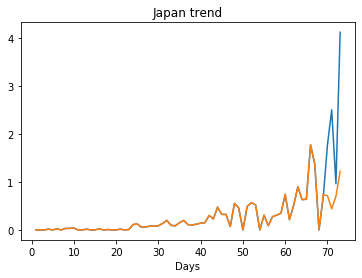

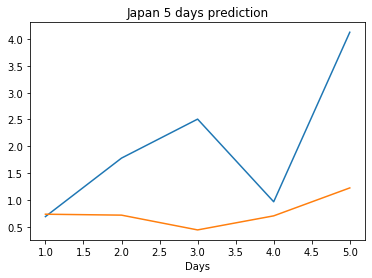

Creating directory ./offline6/Cambodia/training/
Cambodia
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0144
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0144


/space/home/nzhang/anaconda3/envs/neuralnet/lib/python3.7/site-packages/torch/nn/modules/loss.py:431: UserWarning: Using a target size (torch.Size([1, 1, 5])) that is different to the input size (torch.Size([5])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/space/home/nzhang/anaconda3/envs/neuralnet/lib/python3.7/site-packages/torch/nn/modules/loss.py:431: UserWarning: Using a target size (torch.Size([1, 5])) that is different to the input size (torch.Size([5])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


train error: 0.12861546857113187
0.01439260970801115
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0190
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0122
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0084
train error: 0.11453995060979981
0.008376209996640682
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0653
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0182
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0084
train error: 0.07389348300851205
0.008368072099983692
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0141
train error: 0.13636779378760944
0.014104530215263367
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0097
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0067
train error: 0.10239109098487957
0.0067336829379200935
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0402
Saving the best model weights at Epoch [3], Best V

train error: 0.18665117227161923
0.009124545380473137
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0346
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0262
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0137
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0089
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0067
train error: 0.2320395325395194
0.006740953307598829
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0133
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0086
train error: 0.18223544557324864
0.008570299483835697
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0171
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0144
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0134
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0133
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0056
train error: 0.1881409

Saving the best model weights at Epoch [19], Best Valid Loss: 0.0094
train error: 0.1993175807521876
0.009411541745066643
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0098
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0098
train error: 0.18396163110931715
0.009824923239648342
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0170
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0119
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0082
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0078
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0059
train error: 0.18488273676484823
0.005933976266533136
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0148
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0085
train error: 0.20529348813491224
0.008459665812551975
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0118
Saving the best model weights at 

Saving the best model weights at Epoch [14], Best Valid Loss: 0.0125
train error: 0.17114797728418402
0.012483665719628334
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0509
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0349
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0261
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0207
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0177
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0158
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0148
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0141
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0139
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0134
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0133
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0126
train error: 0.16704405344684015
0.012622669339179993
Savi

train error: 0.17985737007675748
0.010128125548362732
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0235
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0215
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0198
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0185
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0176
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0168
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0161
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0156
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0152
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0150
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0148
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0146
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0145
Saving the best model weights at Epoch [14], Best Valid Lo

Saving the best model weights at Epoch [14], Best Valid Loss: 0.0153
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0150
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0147
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0145
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0144
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0143
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0142
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0141
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0140
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0140
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0139
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0139
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0137
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0137
Saving the best model weights at E

Saving the best model weights at Epoch [4], Best Valid Loss: 0.0137
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0121
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0110
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0103
train error: 0.1769846138741934
0.01029827818274498
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0385
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0288
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0237
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0198
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0175
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0164
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0156
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0149
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0

Saving the best model weights at Epoch [21], Best Valid Loss: 0.0631
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0615
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0601
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0587
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0574
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0562
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0549
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0539
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0528
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0518
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0509
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0498
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0491
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0482
Saving the best model weights at E

Saving the best model weights at Epoch [27], Best Valid Loss: 0.0198
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0193
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0189
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0185
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0182
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0179
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0176
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0173
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0170
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0168
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0166
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0164
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0163
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0161
Saving the best model weights at E

Saving the best model weights at Epoch [34], Best Valid Loss: 0.0247
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0245
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0243
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0241
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0240
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0238
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0237
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0235
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0234
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0232
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0231
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0230
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0228
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0228
Saving the best model weights at E

Saving the best model weights at Epoch [38], Best Valid Loss: 0.0137
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0135
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0134
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0132
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0131
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0130
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0128
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0126
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0126
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0125
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0124
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0123
train error: 0.1780627312872446
0.012346453033387661
Saving the best model weights at Epoch [1], Best V

Saving the best model weights at Epoch [43], Best Valid Loss: 0.0155
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0153
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0152
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0151
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0150
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0148
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0147
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0147
train error: 0.17919515617982004
0.014657882042229176
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0093
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0089
train error: 0.17655029923965534
0.008915729820728302
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0275
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0268
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0261


Saving the best model weights at Epoch [3], Best Valid Loss: 0.0479
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0468
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0457
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0446
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0436
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0426
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0416
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0407
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0398
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0389
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0381
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0373
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0365
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0357
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [15], Best Valid Loss: 0.0376
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0366
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0356
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0347
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0338
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0329
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0321
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0313
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0305
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0297
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0290
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0283
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0276
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0270
Saving the best model weights at E

Saving the best model weights at Epoch [26], Best Valid Loss: 0.0318
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0311
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0305
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0299
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0293
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0287
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0282
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0276
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0271
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0266
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0261
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0257
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0252
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0248
Saving the best model weights at E

Saving the best model weights at Epoch [26], Best Valid Loss: 0.0062
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0062
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0062
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0062
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0061
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0061
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0061
train error: 0.18058469785716047
0.006131818983703852
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0199
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0192
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0185
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0178
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0173
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0168
Saving the best model weights at Epoch [7], Best Valid 

Saving the best model weights at Epoch [16], Best Valid Loss: 0.0270
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0260
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0252
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0244
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0236
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0229
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0222
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0216
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0210
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0204
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0200
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0194
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0190
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0186
Saving the best model weights at E

Saving the best model weights at Epoch [28], Best Valid Loss: 0.0148
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0145
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0141
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0139
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0136
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0134
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0132
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0130
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0128
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0125
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0123
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0122
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0121
Saving the best model weights at E

Saving the best model weights at Epoch [35], Best Valid Loss: 0.0069
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0063
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0060
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0058
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0056
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0055
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0053
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0052
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0051
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0051
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0050
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0050
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0049
Saving the best model weights at E

Saving the best model weights at Epoch [39], Best Valid Loss: 0.0126
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0125
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0125
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0125
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0124
train error: 0.1772047932344404
0.012437674216926098
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0286
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0256
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0227
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0205
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0193
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0187
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0173
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0168
Saving the best model weights at Epoch [9], Best Valid Los

Saving the best model weights at Epoch [44], Best Valid Loss: 0.0112
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0112
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0112
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0111
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0111
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0111
train error: 0.17908773112647008
0.01110406406223774
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0446
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0340
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0270
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0209
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0176
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0154
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0138
Saving the best model weights at Epoch [8], Best Valid Lo

Saving the best model weights at Epoch [9], Best Valid Loss: 0.0116
train error: 0.17654394008445018
0.011625825427472591
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0491
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0477
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0463
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0450
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0437
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0425
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0413
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0401
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0390
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0379
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0369
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0359
Saving the best model weights at Epoch [13], Best Valid Los

Saving the best model weights at Epoch [6], Best Valid Loss: 0.0336
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0328
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0319
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0311
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0303
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0296
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0288
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0281
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0274
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0268
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0262
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0256
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0250
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0244
Saving the best model weights at Epoch

Saving the best model weights at Epoch [24], Best Valid Loss: 0.0271
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0266
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0261
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0257
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0253
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0249
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0245
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0241
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0237
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0234
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0230
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0227
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0224
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0221
Saving the best model weights at E

Saving the best model weights at Epoch [36], Best Valid Loss: 0.0223
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0220
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0217
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0214
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0211
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0208
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0206
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0203
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0200
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0198
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0196
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0193
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0191
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0189
Saving the best model weights at E

Saving the best model weights at Epoch [46], Best Valid Loss: 0.1163
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1160
Saving the best model weights at Epoch [48], Best Valid Loss: 0.1158
Saving the best model weights at Epoch [49], Best Valid Loss: 0.1155
Saving the best model weights at Epoch [50], Best Valid Loss: 0.1152
train error: 0.25757739263953583
0.11524926871061325
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0848
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0843
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0839
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0835
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0830
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0826
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0822
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0817
Saving the best model weights at Epoch [9], Best Valid Los

Saving the best model weights at Epoch [13], Best Valid Loss: 0.0190
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0189
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0189
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0188
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0188
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0187
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0187
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0187
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0185
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0185
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0185
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0184
Saving the best model weights at E

Saving the best model weights at Epoch [32], Best Valid Loss: 0.0256
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0248
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0242
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0236
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0229
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0224
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0218
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0213
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0208
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0203
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0198
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0193
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0188
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0183
Saving the best model weights at E

Saving the best model weights at Epoch [1], Best Valid Loss: 0.0492
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0482
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0469
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0460
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0451
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0443
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0433
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0424
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0416
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0407
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0399
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0392
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0385
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0377
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [21], Best Valid Loss: 0.0296
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0294
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0292
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0290
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0289
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0287
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0285
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0284
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0282
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0280
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0279
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0277
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0276
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0274
Saving the best model weights at E

Saving the best model weights at Epoch [41], Best Valid Loss: 0.0366
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0365
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0364
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0363
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0362
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0361
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0360
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0359
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0359
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0358
train error: 0.20948959906783068
0.035768941044807434
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0545
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0543
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0542
Saving the best model weights at Epoch [4], Best Val

Saving the best model weights at Epoch [8], Best Valid Loss: 0.0309
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0308
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0307
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0305
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0304
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0303
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0302
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0301
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0299
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0298
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0297
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0296
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0295
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0293
Saving the best model weights at Epo

Saving the best model weights at Epoch [28], Best Valid Loss: 0.0311
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0305
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0301
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0294
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0289
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0284
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0279
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0274
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0269
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0265
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0259
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0255
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0251
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0248
Saving the best model weights at E

Saving the best model weights at Epoch [48], Best Valid Loss: 0.0334
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0332
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0331
train error: 0.2067228699258218
0.03308212012052536
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0495
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0483
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0474
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0461
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0452
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0441
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0432
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0423
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0413
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0404
Saving the best model weights at Epoch [11], Best Valid Loss

Saving the best model weights at Epoch [15], Best Valid Loss: 0.0304
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0303
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0301
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0299
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0298
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0296
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0294
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0293
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0291
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0290
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0288
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0286
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0285
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0283
Saving the best model weights at E

Saving the best model weights at Epoch [34], Best Valid Loss: 0.1291
Saving the best model weights at Epoch [35], Best Valid Loss: 0.1287
Saving the best model weights at Epoch [36], Best Valid Loss: 0.1283
Saving the best model weights at Epoch [37], Best Valid Loss: 0.1279
Saving the best model weights at Epoch [38], Best Valid Loss: 0.1275
Saving the best model weights at Epoch [39], Best Valid Loss: 0.1271
Saving the best model weights at Epoch [40], Best Valid Loss: 0.1268
Saving the best model weights at Epoch [41], Best Valid Loss: 0.1264
Saving the best model weights at Epoch [42], Best Valid Loss: 0.1260
Saving the best model weights at Epoch [43], Best Valid Loss: 0.1256
Saving the best model weights at Epoch [44], Best Valid Loss: 0.1253
Saving the best model weights at Epoch [45], Best Valid Loss: 0.1249
Saving the best model weights at Epoch [46], Best Valid Loss: 0.1245
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1241
Saving the best model weights at E

Saving the best model weights at Epoch [1], Best Valid Loss: 0.0106
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0105
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0105
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0103
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0103
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0103
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0102
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0102
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0102
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0101
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0101
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [21], Best Valid Loss: 0.0222
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0218
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0213
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0209
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0204
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0200
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0197
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0193
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0189
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0182
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0179
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0176
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0173
Saving the best model weights at E

Saving the best model weights at Epoch [39], Best Valid Loss: 0.0303
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0301
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0300
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0299
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0298
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0297
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0295
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0294
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0293
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0292
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0291
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0290
train error: 0.2010144000047479
0.028971374034881592
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0542
Saving the best model weights at Epoch [2], Best Va

Saving the best model weights at Epoch [7], Best Valid Loss: 0.0214
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0213
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0211
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0210
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0209
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0208
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0207
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0206
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0205
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0204
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0203
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0202
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0201
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0200
Saving the best model weights at Epoc

Saving the best model weights at Epoch [25], Best Valid Loss: 0.0813
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0811
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0809
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0807
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0805
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0803
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0801
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0799
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0797
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0795
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0793
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0791
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0789
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0788
Saving the best model weights at E

Saving the best model weights at Epoch [44], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0065
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0064
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0062
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0061
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0060
train error: 0.19187369857999412
0.005979334004223347
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0580
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0579
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0577
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0575
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0574
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0572
Saving the best model weights at Epoch [7], Best Valid 

Saving the best model weights at Epoch [11], Best Valid Loss: 0.0375
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0368
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0363
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0356
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0350
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0344
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0339
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0333
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0327
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0323
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0317
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0312
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0307
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0303
Saving the best model weights at E

Saving the best model weights at Epoch [29], Best Valid Loss: 0.0423
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0421
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0419
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0417
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0415
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0413
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0411
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0409
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0407
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0405
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0403
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0401
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0399
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0397
Saving the best model weights at E

Saving the best model weights at Epoch [48], Best Valid Loss: 0.0259
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0258
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0258
train error: 0.20636065513826907
0.025781607255339622
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0246
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0245
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0244
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0242
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0241
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0240
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0239
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0238
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0236
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0235
Saving the best model weights at Epoch [11], Best Valid Lo

Saving the best model weights at Epoch [18], Best Valid Loss: 0.0241
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0240
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0239
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0237
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0236
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0235
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0234
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0233
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0232
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0230
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0229
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0228
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0227
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0226
Saving the best model weights at E

Saving the best model weights at Epoch [36], Best Valid Loss: 0.0267
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0262
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0257
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0251
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0247
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0242
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0239
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0234
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0230
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0225
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0222
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0218
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0214
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0211
Saving the best model weights at E

Saving the best model weights at Epoch [4], Best Valid Loss: 0.0350
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0343
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0336
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0330
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0324
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0319
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0312
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0308
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0302
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0296
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0291
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0286
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0282
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0277
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [22], Best Valid Loss: 0.0128
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0126
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0125
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0125
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0124
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0124
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0124
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0123
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0123
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0122
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0122
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0121
Saving the best model weights at E

Saving the best model weights at Epoch [40], Best Valid Loss: 0.0240
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0240
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0239
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0238
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0237
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0237
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0236
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0235
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0234
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0234
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0233
train error: 0.21147218691608446
0.023295750841498375
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0368
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0366
Saving the best model weights at Epoch [3], Best Va

Saving the best model weights at Epoch [9], Best Valid Loss: 0.0621
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0621
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0621
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0621
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0621
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0620
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0620
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0620
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0620
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0620
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0620
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0620
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0620
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0619
Saving the best model weights at Ep

Saving the best model weights at Epoch [29], Best Valid Loss: 0.0250
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0249
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0248
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0247
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0247
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0246
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0246
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0245
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0244
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0244
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0243
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0242
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0242
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0241
Saving the best model weights at E

Saving the best model weights at Epoch [49], Best Valid Loss: 0.0377
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0377
train error: 0.2100818647622046
0.03770194575190544
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0908
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0906
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0904
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0902
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0899
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0898
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0895
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0893
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0891
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0889
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0887
Saving the best model weights at Epoch [12], Best Valid Loss

Saving the best model weights at Epoch [17], Best Valid Loss: 0.0569
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0568
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0568
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0568
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0567
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0567
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0567
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0567
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0566
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0566
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0566
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0565
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0565
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0565
Saving the best model weights at E

Saving the best model weights at Epoch [35], Best Valid Loss: 0.0375
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0375
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0375
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0375
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0375
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0374
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0374
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0374
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0374
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0374
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0374
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0374
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0374
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0374
Saving the best model weights at E

Saving the best model weights at Epoch [3], Best Valid Loss: 0.0458
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0458
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0458
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0458
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0458
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0457
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0457
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0457
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0457
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0457
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0457
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0456
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0456
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0456
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [23], Best Valid Loss: 0.0443
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0442
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0441
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0440
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0439
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0438
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0437
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0436
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0436
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0435
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0434
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0433
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0432
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0431
Saving the best model weights at E

Saving the best model weights at Epoch [43], Best Valid Loss: 0.0400
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0400
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0400
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0399
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0399
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0399
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0399
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0398
train error: 0.22756441257837595
0.03984580561518669
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0468
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0467
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0466
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0465
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0464
Saving the best model weights at Epoch [6], Best Valid 

Saving the best model weights at Epoch [10], Best Valid Loss: 0.0501
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0500
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0500
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0500
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0500
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0499
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0499
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0499
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0499
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0499
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0498
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0498
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0498
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0498
Saving the best model weights at E

Saving the best model weights at Epoch [30], Best Valid Loss: 0.0309
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0309
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0308
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0308
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0308
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0308
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0308
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0308
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0308
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0308
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0308
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0308
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0308
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0308
Saving the best model weights at E

Saving the best model weights at Epoch [50], Best Valid Loss: 0.0289
train error: 0.20987148443942494
0.02894626557826996
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0646
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0646
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0646
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0646
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0646
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0646
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0645
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0645
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0645
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0645
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0645
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0644
Saving the best model weights at Epoch [13], Best Valid Los

Saving the best model weights at Epoch [19], Best Valid Loss: 0.1004
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1002
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1000
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0998
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0995
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0993
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0991
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0989
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0986
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0984
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0982
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0980
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0978
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0976
Saving the best model weights at E

Saving the best model weights at Epoch [39], Best Valid Loss: 0.0566
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0565
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0565
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0565
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0565
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0564
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0564
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0564
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0564
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0563
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0563
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0563
train error: 0.21882966722389965
0.05628354474902153
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0524
Saving the best model weights at Epoch [2], Best Va

Saving the best model weights at Epoch [6], Best Valid Loss: 0.0220
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0220
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0220
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0220
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0220
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0220
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0220
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0219
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0219
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0219
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0219
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0219
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0219
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0219
Saving the best model weights at Epoch

Saving the best model weights at Epoch [24], Best Valid Loss: 0.0287
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0287
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0287
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0287
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0287
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0287
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0287
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0287
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0287
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0287
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0286
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0286
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0286
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0286
Saving the best model weights at E

Saving the best model weights at Epoch [42], Best Valid Loss: 0.0351
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0350
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0349
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0348
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0348
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0347
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0346
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0345
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0344
train error: 0.21583379828371108
0.03440043330192566
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0413
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0413
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0413
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0413
Saving the best model weights at Epoch [5], Best Valid

Saving the best model weights at Epoch [10], Best Valid Loss: 0.0997
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0994
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0992
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0989
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0987
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0984
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0981
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0979
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0976
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0974
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0971
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0969
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0966
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0963
Saving the best model weights at E

Saving the best model weights at Epoch [28], Best Valid Loss: 0.0177
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0177
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0177
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0177
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0177
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0176
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0176
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0176
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0176
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0176
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0176
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0176
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0176
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0176
Saving the best model weights at E

Saving the best model weights at Epoch [47], Best Valid Loss: 0.0325
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0325
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0325
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0325
train error: 0.2221885072631818
0.03251156210899353
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0263
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0263
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0263
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0263
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0263
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0263
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0262
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0262
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0262
Saving the best model weights at Epoch [10], Best Valid Loss

Saving the best model weights at Epoch [14], Best Valid Loss: 0.0384
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0384
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0384
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0384
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0384
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0384
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0383
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0383
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0383
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0383
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0383
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0383
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0383
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0383
Saving the best model weights at E

Saving the best model weights at Epoch [32], Best Valid Loss: 0.0405
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0404
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0403
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0402
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0401
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0401
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0400
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0399
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0398
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0397
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0396
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0395
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0395
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0394
Saving the best model weights at E

Saving the best model weights at Epoch [50], Best Valid Loss: 0.0906
train error: 0.2598179814151742
0.09060494601726532
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0743
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0741
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0739
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0737
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0735
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0733
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0731
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0729
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0727
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0725
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0724
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0722
Saving the best model weights at Epoch [13], Best Valid Loss

Saving the best model weights at Epoch [18], Best Valid Loss: 0.0568
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0568
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0568
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0567
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0567
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0567
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0566
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0566
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0566
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0565
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0565
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0565
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0565
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0564
Saving the best model weights at E

Saving the best model weights at Epoch [36], Best Valid Loss: 0.0396
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0396
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0396
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0395
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0395
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0395
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0395
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0395
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0395
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0395
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0395
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0395
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0394
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0394
Saving the best model weights at E

Saving the best model weights at Epoch [4], Best Valid Loss: 0.0327
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0327
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0327
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0327
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0327
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0327
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0327
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0327
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0327
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0326
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0326
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0326
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0326
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0326
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [22], Best Valid Loss: 0.0386
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0385
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0384
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0383
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0382
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0381
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0380
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0379
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0378
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0377
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0376
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0375
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0374
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0373
Saving the best model weights at E

Saving the best model weights at Epoch [40], Best Valid Loss: 0.0934
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0934
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0934
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0934
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0934
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0934
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0934
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0934
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0934
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0934
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0934
train error: 0.23045867419039662
0.09337056428194046
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0709
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0709
Saving the best model weights at Epoch [3], Best Val

Saving the best model weights at Epoch [9], Best Valid Loss: 0.0147
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0147
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0147
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0147
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0147
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0147
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0147
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0147
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0147
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0147
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0147
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0147
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0147
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0147
Saving the best model weights at Ep

Saving the best model weights at Epoch [29], Best Valid Loss: 0.0603
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0603
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0603
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0603
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0603
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0603
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0603
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0603
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0603
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0603
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0603
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0603
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0603
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0603
Saving the best model weights at E

Saving the best model weights at Epoch [49], Best Valid Loss: 0.0494
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0494
train error: 0.2186237516615427
0.04943692684173584
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0193
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0193
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0193
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0193
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0193
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0193
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0193
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0193
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0193
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0193
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0193
Saving the best model weights at Epoch [12], Best Valid Loss

Saving the best model weights at Epoch [18], Best Valid Loss: 0.0386
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0386
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0385
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0385
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0385
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0385
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0385
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0385
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0385
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0385
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0385
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0385
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0385
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0385
Saving the best model weights at E

Saving the best model weights at Epoch [38], Best Valid Loss: 0.0442
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0442
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0442
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0442
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0442
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0442
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0442
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0442
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0442
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0442
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0442
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0442
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0442
train error: 0.22730416691664493
0.044157080352306366
Saving the best model weights at Epoch [1], Best 

Saving the best model weights at Epoch [5], Best Valid Loss: 0.0201
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0201
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0201
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0201
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0201
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0201
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0201
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0201
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0201
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0201
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0201
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0201
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0201
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0201
Saving the best model weights at Epoch 

Saving the best model weights at Epoch [25], Best Valid Loss: 0.0494
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0494
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0494
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0494
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0494
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0494
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0494
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0494
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0494
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0494
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0494
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0494
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0494
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0494
Saving the best model weights at E

Saving the best model weights at Epoch [45], Best Valid Loss: 0.0317
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0317
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0317
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0317
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0317
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0317
train error: 0.21780815407295118
0.03167225793004036
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0440
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0440
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0440
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0440
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0440
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0440
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0440
Saving the best model weights at Epoch [8], Best Valid Lo

Saving the best model weights at Epoch [12], Best Valid Loss: 0.0156
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0156
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0156
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0155
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0155
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0155
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0155
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0155
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0155
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0155
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0155
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0155
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0155
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0155
Saving the best model weights at E

Saving the best model weights at Epoch [32], Best Valid Loss: 0.0803
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0803
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0803
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0803
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0803
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0803
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0803
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0802
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0802
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0802
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0802
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0802
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0802
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0802
Saving the best model weights at E

Saving the best model weights at Epoch [1], Best Valid Loss: 0.0591
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0591
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0591
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0591
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0591
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0591
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0591
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0591
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0591
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0591
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0591
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0591
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0591
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0591
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [20], Best Valid Loss: 0.0377
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0377
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0377
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0377
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0377
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0377
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0377
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0377
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0377
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0377
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0377
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0377
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0377
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0377
Saving the best model weights at E

Saving the best model weights at Epoch [38], Best Valid Loss: 0.0239
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0239
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0239
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0239
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0239
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0239
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0239
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0239
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0239
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0239
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0238
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0238
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0238
train error: 0.19363071253720784
0.023840920999646187
Saving the best model weights at Epoch [1], Best 

Saving the best model weights at Epoch [5], Best Valid Loss: 0.0311
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0311
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0311
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0311
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0311
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0311
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0311
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0311
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0310
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0310
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0310
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0310
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0310
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0310
Saving the best model weights at Epoch 

Saving the best model weights at Epoch [24], Best Valid Loss: 0.0107
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0107
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0107
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0107
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0107
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0107
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0107
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0107
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0107
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0107
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0107
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0107
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0107
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0107
Saving the best model weights at E

Saving the best model weights at Epoch [42], Best Valid Loss: 0.0107
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0107
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0107
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0107
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0107
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0107
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0107
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0107
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0107
train error: 0.1943011585072699
0.010737483389675617
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0367
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0367
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0367
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0367
Saving the best model weights at Epoch [5], Best Valid

Saving the best model weights at Epoch [9], Best Valid Loss: 0.0309
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0309
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0309
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0309
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0309
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0309
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0309
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0309
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0309
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0309
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0309
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0309
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0309
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0309
Saving the best model weights at Ep

Saving the best model weights at Epoch [28], Best Valid Loss: 0.0366
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0366
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0366
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0366
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0366
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0366
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0365
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0365
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0365
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0365
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0365
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0365
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0365
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0365
Saving the best model weights at E

Saving the best model weights at Epoch [46], Best Valid Loss: 0.0374
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0374
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0374
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0374
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0373
train error: 0.22609044337701617
0.037347979843616486
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0398
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0397
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0397
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0397
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0397
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0397
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0397
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0397
Saving the best model weights at Epoch [9], Best Valid Lo

Saving the best model weights at Epoch [14], Best Valid Loss: 0.0748
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0748
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0748
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0748
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0748
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0748
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0748
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0748
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0748
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0748
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0748
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0748
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0748
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0748
Saving the best model weights at E

Saving the best model weights at Epoch [32], Best Valid Loss: 0.0101
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0101
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0101
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0101
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0101
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0101
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0101
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0101
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0101
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0101
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0101
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0101
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0101
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0101
Saving the best model weights at E

Saving the best model weights at Epoch [50], Best Valid Loss: 0.0530
train error: 0.23041926442899488
0.05297049507498741
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0141
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0141
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0141
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0141
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0141
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0141
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0141
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0141
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0141
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0141
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0141
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0141
Saving the best model weights at Epoch [13], Best Valid Los

Saving the best model weights at Epoch [18], Best Valid Loss: 0.0462
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0462
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0462
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0462
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0462
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0462
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0461
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0461
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0461
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0461
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0461
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0461
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0461
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0461
Saving the best model weights at E

Saving the best model weights at Epoch [36], Best Valid Loss: 0.0357
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0357
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0357
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0357
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0356
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0356
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0356
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0356
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0356
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0356
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0356
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0356
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0356
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0356
Saving the best model weights at E

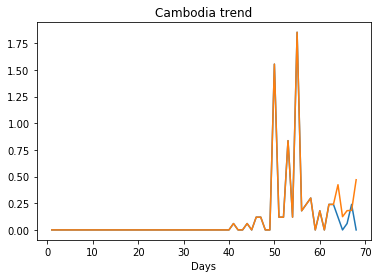

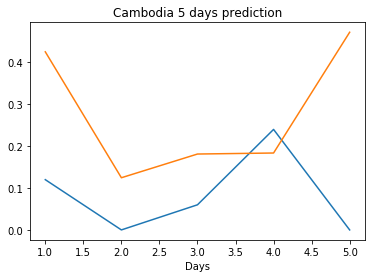

Creating directory ./offline6/Malaysia/training/
Malaysia
Saving the best model weights at Epoch [1], Best Valid Loss: 3.5809
Saving the best model weights at Epoch [2], Best Valid Loss: 2.3704


/space/home/nzhang/anaconda3/envs/neuralnet/lib/python3.7/site-packages/torch/nn/modules/loss.py:431: UserWarning: Using a target size (torch.Size([1, 1, 5])) that is different to the input size (torch.Size([5])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/space/home/nzhang/anaconda3/envs/neuralnet/lib/python3.7/site-packages/torch/nn/modules/loss.py:431: UserWarning: Using a target size (torch.Size([1, 5])) that is different to the input size (torch.Size([5])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Saving the best model weights at Epoch [5], Best Valid Loss: 1.8871
Saving the best model weights at Epoch [8], Best Valid Loss: 1.8811
Saving the best model weights at Epoch [9], Best Valid Loss: 1.8238
Saving the best model weights at Epoch [10], Best Valid Loss: 1.7563
train error: 0.2425313017730202
1.756325602531433
Saving the best model weights at Epoch [1], Best Valid Loss: 2.4161
Saving the best model weights at Epoch [2], Best Valid Loss: 1.5468
Saving the best model weights at Epoch [4], Best Valid Loss: 1.4294
Saving the best model weights at Epoch [7], Best Valid Loss: 1.2190
Saving the best model weights at Epoch [14], Best Valid Loss: 1.0822
Saving the best model weights at Epoch [26], Best Valid Loss: 0.6488
train error: 0.10988887947584902
0.6487858891487122
Saving the best model weights at Epoch [1], Best Valid Loss: 3.2078
Saving the best model weights at Epoch [3], Best Valid Loss: 1.2290
Saving the best model weights at Epoch [9], Best Valid Loss: 1.1949
Saving the 

Saving the best model weights at Epoch [6], Best Valid Loss: 1.6481
Saving the best model weights at Epoch [18], Best Valid Loss: 1.0431
train error: 0.7542808451822826
1.0430506467819214
Saving the best model weights at Epoch [1], Best Valid Loss: 8.9437
Saving the best model weights at Epoch [2], Best Valid Loss: 1.6753
Saving the best model weights at Epoch [8], Best Valid Loss: 1.6258
Saving the best model weights at Epoch [12], Best Valid Loss: 1.1595
train error: 0.6437743119097181
1.1594914197921753
Saving the best model weights at Epoch [1], Best Valid Loss: 2.6640
Saving the best model weights at Epoch [2], Best Valid Loss: 1.9915
Saving the best model weights at Epoch [3], Best Valid Loss: 1.8572
Saving the best model weights at Epoch [4], Best Valid Loss: 1.3092
Saving the best model weights at Epoch [20], Best Valid Loss: 1.1614
Saving the best model weights at Epoch [36], Best Valid Loss: 1.0395
train error: 0.5891468997712114
1.0394799709320068
Saving the best model weigh

Saving the best model weights at Epoch [2], Best Valid Loss: 10.7247
Saving the best model weights at Epoch [3], Best Valid Loss: 8.8424
Saving the best model weights at Epoch [4], Best Valid Loss: 2.8137
Saving the best model weights at Epoch [5], Best Valid Loss: 2.2717
Saving the best model weights at Epoch [10], Best Valid Loss: 1.3545
Saving the best model weights at Epoch [27], Best Valid Loss: 1.2738
Saving the best model weights at Epoch [40], Best Valid Loss: 1.2724
train error: 0.7043968443825309
1.2723501920700073
Saving the best model weights at Epoch [1], Best Valid Loss: 17.5329
Saving the best model weights at Epoch [2], Best Valid Loss: 2.9230
Saving the best model weights at Epoch [5], Best Valid Loss: 1.9918
Saving the best model weights at Epoch [6], Best Valid Loss: 1.8129
Saving the best model weights at Epoch [9], Best Valid Loss: 1.2274
train error: 0.6775703763323171
1.2273820638656616
Saving the best model weights at Epoch [1], Best Valid Loss: 13.3094
Saving t

Saving the best model weights at Epoch [4], Best Valid Loss: 11.7929
Saving the best model weights at Epoch [5], Best Valid Loss: 10.1774
Saving the best model weights at Epoch [10], Best Valid Loss: 10.0680
Saving the best model weights at Epoch [22], Best Valid Loss: 8.6387
train error: 5.106021496227809
8.638727188110352
Saving the best model weights at Epoch [1], Best Valid Loss: 4.5606
Saving the best model weights at Epoch [7], Best Valid Loss: 4.4003
Saving the best model weights at Epoch [31], Best Valid Loss: 2.3677
train error: 7.2176780270678655
2.367711305618286
Saving the best model weights at Epoch [1], Best Valid Loss: 10.6785
Saving the best model weights at Epoch [8], Best Valid Loss: 10.2347
train error: 5.0243477582931515
10.234731674194336
Saving the best model weights at Epoch [1], Best Valid Loss: 12.2947
Saving the best model weights at Epoch [2], Best Valid Loss: 11.6395
Saving the best model weights at Epoch [7], Best Valid Loss: 11.3735
Saving the best model w

Saving the best model weights at Epoch [3], Best Valid Loss: 1.7032
Saving the best model weights at Epoch [6], Best Valid Loss: 1.6976
Saving the best model weights at Epoch [7], Best Valid Loss: 1.6686
Saving the best model weights at Epoch [18], Best Valid Loss: 1.2714
train error: 0.1148827383959932
1.2713841199874878
Saving the best model weights at Epoch [1], Best Valid Loss: 19.9089
Saving the best model weights at Epoch [2], Best Valid Loss: 11.1895
Saving the best model weights at Epoch [3], Best Valid Loss: 4.8925
Saving the best model weights at Epoch [4], Best Valid Loss: 2.3505
Saving the best model weights at Epoch [5], Best Valid Loss: 1.7699
Saving the best model weights at Epoch [6], Best Valid Loss: 1.6827
train error: 0.9210253613069653
1.6826937198638916
Saving the best model weights at Epoch [1], Best Valid Loss: 12.6351
Saving the best model weights at Epoch [2], Best Valid Loss: 3.6215
Saving the best model weights at Epoch [3], Best Valid Loss: 2.0019
Saving the

Saving the best model weights at Epoch [15], Best Valid Loss: 1.7322
Saving the best model weights at Epoch [16], Best Valid Loss: 1.7085
Saving the best model weights at Epoch [20], Best Valid Loss: 1.6030
Saving the best model weights at Epoch [24], Best Valid Loss: 1.5033
Saving the best model weights at Epoch [34], Best Valid Loss: 1.4700
Saving the best model weights at Epoch [43], Best Valid Loss: 1.3939
train error: 0.6413424572242158
1.3938829898834229
Saving the best model weights at Epoch [1], Best Valid Loss: 25.3664
Saving the best model weights at Epoch [2], Best Valid Loss: 22.7714
Saving the best model weights at Epoch [3], Best Valid Loss: 20.6188
Saving the best model weights at Epoch [4], Best Valid Loss: 18.8026
Saving the best model weights at Epoch [5], Best Valid Loss: 17.2497
Saving the best model weights at Epoch [6], Best Valid Loss: 15.9101
Saving the best model weights at Epoch [7], Best Valid Loss: 14.6717
Saving the best model weights at Epoch [8], Best Val

Saving the best model weights at Epoch [9], Best Valid Loss: 8.7164
Saving the best model weights at Epoch [10], Best Valid Loss: 6.9698
Saving the best model weights at Epoch [11], Best Valid Loss: 5.2765
Saving the best model weights at Epoch [12], Best Valid Loss: 3.9670
Saving the best model weights at Epoch [13], Best Valid Loss: 3.0064
Saving the best model weights at Epoch [14], Best Valid Loss: 2.3881
Saving the best model weights at Epoch [15], Best Valid Loss: 2.0381
Saving the best model weights at Epoch [16], Best Valid Loss: 1.8805
Saving the best model weights at Epoch [17], Best Valid Loss: 1.8440
Saving the best model weights at Epoch [18], Best Valid Loss: 1.8176
Saving the best model weights at Epoch [19], Best Valid Loss: 1.7840
Saving the best model weights at Epoch [21], Best Valid Loss: 1.7794
Saving the best model weights at Epoch [22], Best Valid Loss: 1.7642
Saving the best model weights at Epoch [29], Best Valid Loss: 1.7617
train error: 0.9991199866469417
1.7

Saving the best model weights at Epoch [2], Best Valid Loss: 10.8931
Saving the best model weights at Epoch [11], Best Valid Loss: 9.6730
Saving the best model weights at Epoch [12], Best Valid Loss: 5.0501
Saving the best model weights at Epoch [13], Best Valid Loss: 2.2673
Saving the best model weights at Epoch [17], Best Valid Loss: 2.0857
Saving the best model weights at Epoch [18], Best Valid Loss: 2.0509
Saving the best model weights at Epoch [19], Best Valid Loss: 2.0502
Saving the best model weights at Epoch [20], Best Valid Loss: 1.9824
Saving the best model weights at Epoch [22], Best Valid Loss: 1.9370
Saving the best model weights at Epoch [23], Best Valid Loss: 1.7650
Saving the best model weights at Epoch [24], Best Valid Loss: 1.7632
Saving the best model weights at Epoch [26], Best Valid Loss: 1.5858
Saving the best model weights at Epoch [30], Best Valid Loss: 1.5006
Saving the best model weights at Epoch [36], Best Valid Loss: 1.4248
Saving the best model weights at E

Saving the best model weights at Epoch [6], Best Valid Loss: 16.2771
Saving the best model weights at Epoch [7], Best Valid Loss: 15.4185
Saving the best model weights at Epoch [8], Best Valid Loss: 14.7538
Saving the best model weights at Epoch [9], Best Valid Loss: 14.2198
Saving the best model weights at Epoch [10], Best Valid Loss: 13.7636
Saving the best model weights at Epoch [11], Best Valid Loss: 13.4155
Saving the best model weights at Epoch [12], Best Valid Loss: 13.1675
Saving the best model weights at Epoch [13], Best Valid Loss: 12.9224
Saving the best model weights at Epoch [14], Best Valid Loss: 12.7200
Saving the best model weights at Epoch [15], Best Valid Loss: 12.5107
Saving the best model weights at Epoch [16], Best Valid Loss: 12.3710
Saving the best model weights at Epoch [17], Best Valid Loss: 12.2697
Saving the best model weights at Epoch [18], Best Valid Loss: 12.2019
Saving the best model weights at Epoch [19], Best Valid Loss: 12.1435
Saving the best model we

Saving the best model weights at Epoch [36], Best Valid Loss: 5.1606
Saving the best model weights at Epoch [37], Best Valid Loss: 4.1829
Saving the best model weights at Epoch [38], Best Valid Loss: 3.3071
Saving the best model weights at Epoch [39], Best Valid Loss: 2.6365
Saving the best model weights at Epoch [40], Best Valid Loss: 2.2467
Saving the best model weights at Epoch [41], Best Valid Loss: 2.0116
Saving the best model weights at Epoch [42], Best Valid Loss: 1.8887
Saving the best model weights at Epoch [43], Best Valid Loss: 1.8289
Saving the best model weights at Epoch [44], Best Valid Loss: 1.8044
Saving the best model weights at Epoch [45], Best Valid Loss: 1.7951
Saving the best model weights at Epoch [46], Best Valid Loss: 1.7895
Saving the best model weights at Epoch [47], Best Valid Loss: 1.7780
Saving the best model weights at Epoch [49], Best Valid Loss: 1.7750
train error: 1.1051080593041012
1.7749782800674438
Saving the best model weights at Epoch [1], Best Val

Saving the best model weights at Epoch [14], Best Valid Loss: 12.8690
Saving the best model weights at Epoch [15], Best Valid Loss: 12.7500
Saving the best model weights at Epoch [16], Best Valid Loss: 12.6263
Saving the best model weights at Epoch [17], Best Valid Loss: 12.4937
Saving the best model weights at Epoch [18], Best Valid Loss: 12.3944
Saving the best model weights at Epoch [19], Best Valid Loss: 12.3223
Saving the best model weights at Epoch [20], Best Valid Loss: 12.3133
Saving the best model weights at Epoch [21], Best Valid Loss: 12.2587
Saving the best model weights at Epoch [22], Best Valid Loss: 12.2175
Saving the best model weights at Epoch [23], Best Valid Loss: 12.1854
Saving the best model weights at Epoch [25], Best Valid Loss: 12.1304
Saving the best model weights at Epoch [26], Best Valid Loss: 12.1078
Saving the best model weights at Epoch [27], Best Valid Loss: 12.0789
train error: 4.863133641651698
12.078895568847656
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [13], Best Valid Loss: 13.0348
Saving the best model weights at Epoch [14], Best Valid Loss: 12.8086
Saving the best model weights at Epoch [15], Best Valid Loss: 12.6774
Saving the best model weights at Epoch [16], Best Valid Loss: 12.5797
Saving the best model weights at Epoch [17], Best Valid Loss: 12.4758
Saving the best model weights at Epoch [18], Best Valid Loss: 12.4038
Saving the best model weights at Epoch [19], Best Valid Loss: 12.3556
Saving the best model weights at Epoch [20], Best Valid Loss: 12.3029
Saving the best model weights at Epoch [21], Best Valid Loss: 12.2492
Saving the best model weights at Epoch [22], Best Valid Loss: 12.2247
Saving the best model weights at Epoch [23], Best Valid Loss: 12.1611
Saving the best model weights at Epoch [25], Best Valid Loss: 12.1537
Saving the best model weights at Epoch [27], Best Valid Loss: 12.1434
Saving the best model weights at Epoch [28], Best Valid Loss: 12.1208
Saving the best mode

Saving the best model weights at Epoch [18], Best Valid Loss: 12.3998
Saving the best model weights at Epoch [19], Best Valid Loss: 12.3700
Saving the best model weights at Epoch [20], Best Valid Loss: 12.3437
Saving the best model weights at Epoch [22], Best Valid Loss: 12.2955
Saving the best model weights at Epoch [23], Best Valid Loss: 12.2144
Saving the best model weights at Epoch [24], Best Valid Loss: 12.1470
Saving the best model weights at Epoch [25], Best Valid Loss: 12.1271
Saving the best model weights at Epoch [38], Best Valid Loss: 12.0971
train error: 4.864343418393816
12.097073554992676
Saving the best model weights at Epoch [1], Best Valid Loss: 23.3688
Saving the best model weights at Epoch [2], Best Valid Loss: 20.0161
Saving the best model weights at Epoch [3], Best Valid Loss: 17.5276
Saving the best model weights at Epoch [4], Best Valid Loss: 15.8936
Saving the best model weights at Epoch [5], Best Valid Loss: 14.6376
Saving the best model weights at Epoch [6], B

Saving the best model weights at Epoch [2], Best Valid Loss: 19.6904
Saving the best model weights at Epoch [3], Best Valid Loss: 17.3912
Saving the best model weights at Epoch [4], Best Valid Loss: 15.7811
Saving the best model weights at Epoch [5], Best Valid Loss: 14.4237
Saving the best model weights at Epoch [6], Best Valid Loss: 13.6008
Saving the best model weights at Epoch [7], Best Valid Loss: 13.1866
Saving the best model weights at Epoch [8], Best Valid Loss: 12.8443
Saving the best model weights at Epoch [9], Best Valid Loss: 12.6344
Saving the best model weights at Epoch [10], Best Valid Loss: 12.3833
Saving the best model weights at Epoch [11], Best Valid Loss: 12.3016
Saving the best model weights at Epoch [12], Best Valid Loss: 12.1602
Saving the best model weights at Epoch [13], Best Valid Loss: 12.1235
Saving the best model weights at Epoch [15], Best Valid Loss: 12.0780
Saving the best model weights at Epoch [17], Best Valid Loss: 12.0192
Saving the best model weight

Saving the best model weights at Epoch [46], Best Valid Loss: 4.3425
Saving the best model weights at Epoch [47], Best Valid Loss: 4.1973
Saving the best model weights at Epoch [48], Best Valid Loss: 4.0740
Saving the best model weights at Epoch [49], Best Valid Loss: 3.9558
Saving the best model weights at Epoch [50], Best Valid Loss: 3.8508
train error: 1.7556405910423825
3.8508083820343018
Saving the best model weights at Epoch [1], Best Valid Loss: 24.9262
Saving the best model weights at Epoch [2], Best Valid Loss: 21.4066
Saving the best model weights at Epoch [3], Best Valid Loss: 17.0236
Saving the best model weights at Epoch [4], Best Valid Loss: 12.9445
Saving the best model weights at Epoch [5], Best Valid Loss: 9.7082
Saving the best model weights at Epoch [6], Best Valid Loss: 7.1003
Saving the best model weights at Epoch [7], Best Valid Loss: 5.4032
Saving the best model weights at Epoch [8], Best Valid Loss: 4.2259
Saving the best model weights at Epoch [9], Best Valid L

Saving the best model weights at Epoch [42], Best Valid Loss: 1.9026
Saving the best model weights at Epoch [43], Best Valid Loss: 1.8857
Saving the best model weights at Epoch [44], Best Valid Loss: 1.8714
Saving the best model weights at Epoch [45], Best Valid Loss: 1.8630
Saving the best model weights at Epoch [46], Best Valid Loss: 1.8544
Saving the best model weights at Epoch [47], Best Valid Loss: 1.8425
Saving the best model weights at Epoch [48], Best Valid Loss: 1.8363
Saving the best model weights at Epoch [49], Best Valid Loss: 1.8300
Saving the best model weights at Epoch [50], Best Valid Loss: 1.8256
train error: 1.3224737031119211
1.8255952596664429
Saving the best model weights at Epoch [1], Best Valid Loss: 24.7811
Saving the best model weights at Epoch [2], Best Valid Loss: 18.8478
Saving the best model weights at Epoch [3], Best Valid Loss: 13.2165
Saving the best model weights at Epoch [4], Best Valid Loss: 7.5822
Saving the best model weights at Epoch [5], Best Vali

Saving the best model weights at Epoch [15], Best Valid Loss: 1.7840
Saving the best model weights at Epoch [18], Best Valid Loss: 1.7348
Saving the best model weights at Epoch [22], Best Valid Loss: 1.7166
Saving the best model weights at Epoch [33], Best Valid Loss: 1.6762
train error: 0.9586152890164937
1.6762304306030273
Saving the best model weights at Epoch [1], Best Valid Loss: 26.5790
Saving the best model weights at Epoch [2], Best Valid Loss: 25.5068
Saving the best model weights at Epoch [3], Best Valid Loss: 24.4849
Saving the best model weights at Epoch [4], Best Valid Loss: 23.4844
Saving the best model weights at Epoch [5], Best Valid Loss: 22.4951
Saving the best model weights at Epoch [6], Best Valid Loss: 21.4897
Saving the best model weights at Epoch [7], Best Valid Loss: 20.4748
Saving the best model weights at Epoch [8], Best Valid Loss: 19.4514
Saving the best model weights at Epoch [9], Best Valid Loss: 18.4005
Saving the best model weights at Epoch [10], Best Va

Saving the best model weights at Epoch [30], Best Valid Loss: 20.4607
Saving the best model weights at Epoch [31], Best Valid Loss: 20.2839
Saving the best model weights at Epoch [32], Best Valid Loss: 20.1128
Saving the best model weights at Epoch [33], Best Valid Loss: 19.9400
Saving the best model weights at Epoch [34], Best Valid Loss: 19.7726
Saving the best model weights at Epoch [35], Best Valid Loss: 19.6088
Saving the best model weights at Epoch [36], Best Valid Loss: 19.4482
Saving the best model weights at Epoch [37], Best Valid Loss: 19.2910
Saving the best model weights at Epoch [38], Best Valid Loss: 19.1371
Saving the best model weights at Epoch [39], Best Valid Loss: 18.9862
Saving the best model weights at Epoch [40], Best Valid Loss: 18.8369
Saving the best model weights at Epoch [41], Best Valid Loss: 18.6895
Saving the best model weights at Epoch [42], Best Valid Loss: 18.5464
Saving the best model weights at Epoch [43], Best Valid Loss: 18.4058
Saving the best mode

Saving the best model weights at Epoch [50], Best Valid Loss: 2.0254
train error: 0.873974101085748
2.0254080295562744
Saving the best model weights at Epoch [1], Best Valid Loss: 27.7038
Saving the best model weights at Epoch [2], Best Valid Loss: 27.3750
Saving the best model weights at Epoch [3], Best Valid Loss: 27.0558
Saving the best model weights at Epoch [4], Best Valid Loss: 26.7397
Saving the best model weights at Epoch [5], Best Valid Loss: 26.4323
Saving the best model weights at Epoch [6], Best Valid Loss: 26.1323
Saving the best model weights at Epoch [7], Best Valid Loss: 25.8383
Saving the best model weights at Epoch [8], Best Valid Loss: 25.5519
Saving the best model weights at Epoch [9], Best Valid Loss: 25.2684
Saving the best model weights at Epoch [10], Best Valid Loss: 24.9916
Saving the best model weights at Epoch [11], Best Valid Loss: 24.7225
Saving the best model weights at Epoch [12], Best Valid Loss: 24.4545
Saving the best model weights at Epoch [13], Best 

Saving the best model weights at Epoch [17], Best Valid Loss: 4.8478
Saving the best model weights at Epoch [18], Best Valid Loss: 3.8776
Saving the best model weights at Epoch [19], Best Valid Loss: 3.1910
Saving the best model weights at Epoch [20], Best Valid Loss: 2.7961
Saving the best model weights at Epoch [21], Best Valid Loss: 2.4072
Saving the best model weights at Epoch [22], Best Valid Loss: 2.2115
Saving the best model weights at Epoch [23], Best Valid Loss: 2.0882
Saving the best model weights at Epoch [24], Best Valid Loss: 1.9204
Saving the best model weights at Epoch [25], Best Valid Loss: 1.9056
Saving the best model weights at Epoch [26], Best Valid Loss: 1.8602
Saving the best model weights at Epoch [27], Best Valid Loss: 1.8178
Saving the best model weights at Epoch [31], Best Valid Loss: 1.7792
train error: 0.9279320625322206
1.7791661024093628
Saving the best model weights at Epoch [1], Best Valid Loss: 27.2820
Saving the best model weights at Epoch [2], Best Val

Saving the best model weights at Epoch [5], Best Valid Loss: 17.5513
Saving the best model weights at Epoch [6], Best Valid Loss: 16.0956
Saving the best model weights at Epoch [7], Best Valid Loss: 14.7278
Saving the best model weights at Epoch [8], Best Valid Loss: 13.4518
Saving the best model weights at Epoch [9], Best Valid Loss: 12.0569
Saving the best model weights at Epoch [10], Best Valid Loss: 11.0022
Saving the best model weights at Epoch [11], Best Valid Loss: 9.6634
Saving the best model weights at Epoch [12], Best Valid Loss: 8.6228
Saving the best model weights at Epoch [13], Best Valid Loss: 7.0344
Saving the best model weights at Epoch [14], Best Valid Loss: 6.0384
Saving the best model weights at Epoch [15], Best Valid Loss: 5.0086
Saving the best model weights at Epoch [16], Best Valid Loss: 3.8021
Saving the best model weights at Epoch [17], Best Valid Loss: 3.1619
Saving the best model weights at Epoch [18], Best Valid Loss: 2.4862
Saving the best model weights at 

Saving the best model weights at Epoch [49], Best Valid Loss: 8.2014
Saving the best model weights at Epoch [50], Best Valid Loss: 7.8267
train error: 3.5266283120427815
7.826669216156006
Saving the best model weights at Epoch [1], Best Valid Loss: 24.7507
Saving the best model weights at Epoch [2], Best Valid Loss: 22.5965
Saving the best model weights at Epoch [3], Best Valid Loss: 20.4028
Saving the best model weights at Epoch [4], Best Valid Loss: 18.8567
Saving the best model weights at Epoch [5], Best Valid Loss: 16.7629
Saving the best model weights at Epoch [6], Best Valid Loss: 15.4871
Saving the best model weights at Epoch [7], Best Valid Loss: 13.7499
Saving the best model weights at Epoch [8], Best Valid Loss: 12.3201
Saving the best model weights at Epoch [9], Best Valid Loss: 10.6041
Saving the best model weights at Epoch [10], Best Valid Loss: 8.8824
Saving the best model weights at Epoch [11], Best Valid Loss: 7.3968
Saving the best model weights at Epoch [12], Best Val

Saving the best model weights at Epoch [43], Best Valid Loss: 15.0685
Saving the best model weights at Epoch [44], Best Valid Loss: 14.9572
Saving the best model weights at Epoch [45], Best Valid Loss: 14.8564
Saving the best model weights at Epoch [46], Best Valid Loss: 14.7521
Saving the best model weights at Epoch [47], Best Valid Loss: 14.6615
Saving the best model weights at Epoch [48], Best Valid Loss: 14.5607
Saving the best model weights at Epoch [49], Best Valid Loss: 14.4865
Saving the best model weights at Epoch [50], Best Valid Loss: 14.3912
train error: 4.968666848114559
14.391244888305664
Saving the best model weights at Epoch [1], Best Valid Loss: 25.8516
Saving the best model weights at Epoch [2], Best Valid Loss: 23.4899
Saving the best model weights at Epoch [3], Best Valid Loss: 21.2912
Saving the best model weights at Epoch [4], Best Valid Loss: 19.7458
Saving the best model weights at Epoch [5], Best Valid Loss: 18.3998
Saving the best model weights at Epoch [6], B

Saving the best model weights at Epoch [34], Best Valid Loss: 16.2966
Saving the best model weights at Epoch [35], Best Valid Loss: 16.1208
Saving the best model weights at Epoch [36], Best Valid Loss: 15.9764
Saving the best model weights at Epoch [37], Best Valid Loss: 15.8268
Saving the best model weights at Epoch [38], Best Valid Loss: 15.6579
Saving the best model weights at Epoch [39], Best Valid Loss: 15.5195
Saving the best model weights at Epoch [40], Best Valid Loss: 15.3824
Saving the best model weights at Epoch [41], Best Valid Loss: 15.2469
Saving the best model weights at Epoch [42], Best Valid Loss: 15.1230
Saving the best model weights at Epoch [43], Best Valid Loss: 15.0082
Saving the best model weights at Epoch [44], Best Valid Loss: 14.8892
Saving the best model weights at Epoch [45], Best Valid Loss: 14.7789
Saving the best model weights at Epoch [46], Best Valid Loss: 14.6731
Saving the best model weights at Epoch [47], Best Valid Loss: 14.5741
Saving the best mode

Saving the best model weights at Epoch [11], Best Valid Loss: 22.6599
Saving the best model weights at Epoch [12], Best Valid Loss: 22.2920
Saving the best model weights at Epoch [13], Best Valid Loss: 21.9167
Saving the best model weights at Epoch [14], Best Valid Loss: 21.5533
Saving the best model weights at Epoch [15], Best Valid Loss: 21.2193
Saving the best model weights at Epoch [16], Best Valid Loss: 20.8987
Saving the best model weights at Epoch [17], Best Valid Loss: 20.5677
Saving the best model weights at Epoch [18], Best Valid Loss: 20.2655
Saving the best model weights at Epoch [19], Best Valid Loss: 19.9619
Saving the best model weights at Epoch [20], Best Valid Loss: 19.6730
Saving the best model weights at Epoch [21], Best Valid Loss: 19.4025
Saving the best model weights at Epoch [22], Best Valid Loss: 19.1362
Saving the best model weights at Epoch [23], Best Valid Loss: 18.8676
Saving the best model weights at Epoch [24], Best Valid Loss: 18.6379
Saving the best mode

Saving the best model weights at Epoch [43], Best Valid Loss: 18.4487
Saving the best model weights at Epoch [44], Best Valid Loss: 18.3166
Saving the best model weights at Epoch [45], Best Valid Loss: 18.1882
Saving the best model weights at Epoch [46], Best Valid Loss: 18.0615
Saving the best model weights at Epoch [47], Best Valid Loss: 17.9360
Saving the best model weights at Epoch [48], Best Valid Loss: 17.8130
Saving the best model weights at Epoch [49], Best Valid Loss: 17.6923
Saving the best model weights at Epoch [50], Best Valid Loss: 17.5750
train error: 5.4599476558821545
17.575031280517578
Saving the best model weights at Epoch [1], Best Valid Loss: 27.2685
Saving the best model weights at Epoch [2], Best Valid Loss: 26.7093
Saving the best model weights at Epoch [3], Best Valid Loss: 26.1838
Saving the best model weights at Epoch [4], Best Valid Loss: 25.6727
Saving the best model weights at Epoch [5], Best Valid Loss: 25.1743
Saving the best model weights at Epoch [6], 

Saving the best model weights at Epoch [15], Best Valid Loss: 23.1161
Saving the best model weights at Epoch [16], Best Valid Loss: 22.9001
Saving the best model weights at Epoch [17], Best Valid Loss: 22.6911
Saving the best model weights at Epoch [18], Best Valid Loss: 22.4827
Saving the best model weights at Epoch [19], Best Valid Loss: 22.2825
Saving the best model weights at Epoch [20], Best Valid Loss: 22.0842
Saving the best model weights at Epoch [21], Best Valid Loss: 21.8895
Saving the best model weights at Epoch [22], Best Valid Loss: 21.6981
Saving the best model weights at Epoch [23], Best Valid Loss: 21.5133
Saving the best model weights at Epoch [24], Best Valid Loss: 21.3307
Saving the best model weights at Epoch [25], Best Valid Loss: 21.1505
Saving the best model weights at Epoch [26], Best Valid Loss: 20.9764
Saving the best model weights at Epoch [27], Best Valid Loss: 20.8037
Saving the best model weights at Epoch [28], Best Valid Loss: 20.6359
Saving the best mode

Saving the best model weights at Epoch [4], Best Valid Loss: 26.6660
Saving the best model weights at Epoch [5], Best Valid Loss: 26.3730
Saving the best model weights at Epoch [6], Best Valid Loss: 26.0848
Saving the best model weights at Epoch [7], Best Valid Loss: 25.8051
Saving the best model weights at Epoch [8], Best Valid Loss: 25.5292
Saving the best model weights at Epoch [9], Best Valid Loss: 25.2599
Saving the best model weights at Epoch [10], Best Valid Loss: 24.9972
Saving the best model weights at Epoch [11], Best Valid Loss: 24.7382
Saving the best model weights at Epoch [12], Best Valid Loss: 24.4855
Saving the best model weights at Epoch [13], Best Valid Loss: 24.2382
Saving the best model weights at Epoch [14], Best Valid Loss: 23.9976
Saving the best model weights at Epoch [15], Best Valid Loss: 23.7604
Saving the best model weights at Epoch [16], Best Valid Loss: 23.5254
Saving the best model weights at Epoch [17], Best Valid Loss: 23.2995
Saving the best model weig

Saving the best model weights at Epoch [22], Best Valid Loss: 12.3902
Saving the best model weights at Epoch [24], Best Valid Loss: 12.3717
Saving the best model weights at Epoch [25], Best Valid Loss: 12.3324
Saving the best model weights at Epoch [27], Best Valid Loss: 12.2344
Saving the best model weights at Epoch [28], Best Valid Loss: 12.1038
Saving the best model weights at Epoch [29], Best Valid Loss: 12.0211
Saving the best model weights at Epoch [33], Best Valid Loss: 12.0138
Saving the best model weights at Epoch [39], Best Valid Loss: 11.9169
train error: 4.848953805650983
11.916908264160156
Saving the best model weights at Epoch [1], Best Valid Loss: 26.6673
Saving the best model weights at Epoch [2], Best Valid Loss: 26.3718
Saving the best model weights at Epoch [3], Best Valid Loss: 26.0838
Saving the best model weights at Epoch [4], Best Valid Loss: 25.8017
Saving the best model weights at Epoch [5], Best Valid Loss: 25.5256
Saving the best model weights at Epoch [6], B

Saving the best model weights at Epoch [9], Best Valid Loss: 14.9867
Saving the best model weights at Epoch [10], Best Valid Loss: 14.4456
Saving the best model weights at Epoch [11], Best Valid Loss: 13.9797
Saving the best model weights at Epoch [12], Best Valid Loss: 13.7481
Saving the best model weights at Epoch [13], Best Valid Loss: 13.2520
Saving the best model weights at Epoch [14], Best Valid Loss: 13.1625
Saving the best model weights at Epoch [15], Best Valid Loss: 12.9791
Saving the best model weights at Epoch [16], Best Valid Loss: 12.8576
Saving the best model weights at Epoch [17], Best Valid Loss: 12.6786
Saving the best model weights at Epoch [18], Best Valid Loss: 12.6059
Saving the best model weights at Epoch [19], Best Valid Loss: 12.4485
Saving the best model weights at Epoch [20], Best Valid Loss: 12.4107
Saving the best model weights at Epoch [21], Best Valid Loss: 12.3902
Saving the best model weights at Epoch [23], Best Valid Loss: 12.3065
Saving the best model

Saving the best model weights at Epoch [48], Best Valid Loss: 14.6679
Saving the best model weights at Epoch [49], Best Valid Loss: 14.5793
Saving the best model weights at Epoch [50], Best Valid Loss: 14.4666
train error: 4.977045806816646
14.466641426086426
Saving the best model weights at Epoch [1], Best Valid Loss: 25.6692
Saving the best model weights at Epoch [2], Best Valid Loss: 23.4837
Saving the best model weights at Epoch [3], Best Valid Loss: 21.4644
Saving the best model weights at Epoch [4], Best Valid Loss: 19.7715
Saving the best model weights at Epoch [5], Best Valid Loss: 18.4301
Saving the best model weights at Epoch [6], Best Valid Loss: 17.3317
Saving the best model weights at Epoch [7], Best Valid Loss: 16.3650
Saving the best model weights at Epoch [8], Best Valid Loss: 15.6479
Saving the best model weights at Epoch [9], Best Valid Loss: 14.9999
Saving the best model weights at Epoch [10], Best Valid Loss: 14.5240
Saving the best model weights at Epoch [11], Best

Saving the best model weights at Epoch [42], Best Valid Loss: 15.0189
Saving the best model weights at Epoch [43], Best Valid Loss: 14.8915
Saving the best model weights at Epoch [44], Best Valid Loss: 14.7964
Saving the best model weights at Epoch [45], Best Valid Loss: 14.7028
Saving the best model weights at Epoch [46], Best Valid Loss: 14.6001
Saving the best model weights at Epoch [47], Best Valid Loss: 14.5115
Saving the best model weights at Epoch [48], Best Valid Loss: 14.3986
Saving the best model weights at Epoch [49], Best Valid Loss: 14.3121
Saving the best model weights at Epoch [50], Best Valid Loss: 14.2381
train error: 4.962943977969033
14.238107681274414
Saving the best model weights at Epoch [1], Best Valid Loss: 25.5889
Saving the best model weights at Epoch [2], Best Valid Loss: 23.3723
Saving the best model weights at Epoch [3], Best Valid Loss: 21.3035
Saving the best model weights at Epoch [4], Best Valid Loss: 19.7090
Saving the best model weights at Epoch [5], 

Saving the best model weights at Epoch [34], Best Valid Loss: 16.5618
Saving the best model weights at Epoch [35], Best Valid Loss: 16.3961
Saving the best model weights at Epoch [36], Best Valid Loss: 16.2500
Saving the best model weights at Epoch [37], Best Valid Loss: 16.0800
Saving the best model weights at Epoch [38], Best Valid Loss: 15.9287
Saving the best model weights at Epoch [39], Best Valid Loss: 15.8012
Saving the best model weights at Epoch [40], Best Valid Loss: 15.6501
Saving the best model weights at Epoch [41], Best Valid Loss: 15.5158
Saving the best model weights at Epoch [42], Best Valid Loss: 15.3884
Saving the best model weights at Epoch [43], Best Valid Loss: 15.2557
Saving the best model weights at Epoch [44], Best Valid Loss: 15.1590
Saving the best model weights at Epoch [45], Best Valid Loss: 15.0320
Saving the best model weights at Epoch [46], Best Valid Loss: 14.9280
Saving the best model weights at Epoch [47], Best Valid Loss: 14.8019
Saving the best mode

Saving the best model weights at Epoch [24], Best Valid Loss: 18.4019
Saving the best model weights at Epoch [25], Best Valid Loss: 18.1494
Saving the best model weights at Epoch [26], Best Valid Loss: 17.9382
Saving the best model weights at Epoch [27], Best Valid Loss: 17.7047
Saving the best model weights at Epoch [28], Best Valid Loss: 17.4896
Saving the best model weights at Epoch [29], Best Valid Loss: 17.3089
Saving the best model weights at Epoch [30], Best Valid Loss: 17.1161
Saving the best model weights at Epoch [31], Best Valid Loss: 16.9053
Saving the best model weights at Epoch [32], Best Valid Loss: 16.7281
Saving the best model weights at Epoch [33], Best Valid Loss: 16.5808
Saving the best model weights at Epoch [34], Best Valid Loss: 16.3794
Saving the best model weights at Epoch [35], Best Valid Loss: 16.2322
Saving the best model weights at Epoch [36], Best Valid Loss: 16.0711
Saving the best model weights at Epoch [37], Best Valid Loss: 15.9168
Saving the best mode

Saving the best model weights at Epoch [18], Best Valid Loss: 20.0080
Saving the best model weights at Epoch [19], Best Valid Loss: 19.6998
Saving the best model weights at Epoch [20], Best Valid Loss: 19.4408
Saving the best model weights at Epoch [21], Best Valid Loss: 19.1569
Saving the best model weights at Epoch [22], Best Valid Loss: 18.8988
Saving the best model weights at Epoch [23], Best Valid Loss: 18.6325
Saving the best model weights at Epoch [24], Best Valid Loss: 18.3945
Saving the best model weights at Epoch [25], Best Valid Loss: 18.1569
Saving the best model weights at Epoch [26], Best Valid Loss: 17.9257
Saving the best model weights at Epoch [27], Best Valid Loss: 17.7116
Saving the best model weights at Epoch [28], Best Valid Loss: 17.5040
Saving the best model weights at Epoch [29], Best Valid Loss: 17.2993
Saving the best model weights at Epoch [30], Best Valid Loss: 17.1043
Saving the best model weights at Epoch [31], Best Valid Loss: 16.9046
Saving the best mode

Saving the best model weights at Epoch [15], Best Valid Loss: 24.7903
Saving the best model weights at Epoch [16], Best Valid Loss: 24.7095
Saving the best model weights at Epoch [17], Best Valid Loss: 24.6319
Saving the best model weights at Epoch [18], Best Valid Loss: 24.5546
Saving the best model weights at Epoch [19], Best Valid Loss: 24.4783
Saving the best model weights at Epoch [20], Best Valid Loss: 24.3976
Saving the best model weights at Epoch [21], Best Valid Loss: 24.3185
Saving the best model weights at Epoch [22], Best Valid Loss: 24.2404
Saving the best model weights at Epoch [23], Best Valid Loss: 24.1616
Saving the best model weights at Epoch [24], Best Valid Loss: 24.0860
Saving the best model weights at Epoch [25], Best Valid Loss: 24.0067
Saving the best model weights at Epoch [26], Best Valid Loss: 23.9298
Saving the best model weights at Epoch [27], Best Valid Loss: 23.8521
Saving the best model weights at Epoch [28], Best Valid Loss: 23.7770
Saving the best mode

Saving the best model weights at Epoch [32], Best Valid Loss: 25.1714
Saving the best model weights at Epoch [33], Best Valid Loss: 25.1111
Saving the best model weights at Epoch [34], Best Valid Loss: 25.0496
Saving the best model weights at Epoch [35], Best Valid Loss: 24.9890
Saving the best model weights at Epoch [36], Best Valid Loss: 24.9280
Saving the best model weights at Epoch [37], Best Valid Loss: 24.8676
Saving the best model weights at Epoch [38], Best Valid Loss: 24.8063
Saving the best model weights at Epoch [39], Best Valid Loss: 24.7457
Saving the best model weights at Epoch [40], Best Valid Loss: 24.6845
Saving the best model weights at Epoch [41], Best Valid Loss: 24.6236
Saving the best model weights at Epoch [42], Best Valid Loss: 24.5627
Saving the best model weights at Epoch [43], Best Valid Loss: 24.5019
Saving the best model weights at Epoch [44], Best Valid Loss: 24.4405
Saving the best model weights at Epoch [45], Best Valid Loss: 24.3794
Saving the best mode

Saving the best model weights at Epoch [49], Best Valid Loss: 4.6482
Saving the best model weights at Epoch [50], Best Valid Loss: 4.4621
train error: 2.1205611118248533
4.462123870849609
Saving the best model weights at Epoch [1], Best Valid Loss: 27.5581
Saving the best model weights at Epoch [2], Best Valid Loss: 27.4558
Saving the best model weights at Epoch [3], Best Valid Loss: 27.3530
Saving the best model weights at Epoch [4], Best Valid Loss: 27.2509
Saving the best model weights at Epoch [5], Best Valid Loss: 27.1495
Saving the best model weights at Epoch [6], Best Valid Loss: 27.0482
Saving the best model weights at Epoch [7], Best Valid Loss: 26.9461
Saving the best model weights at Epoch [8], Best Valid Loss: 26.8446
Saving the best model weights at Epoch [9], Best Valid Loss: 26.7434
Saving the best model weights at Epoch [10], Best Valid Loss: 26.6423
Saving the best model weights at Epoch [11], Best Valid Loss: 26.5413
Saving the best model weights at Epoch [12], Best V

Saving the best model weights at Epoch [16], Best Valid Loss: 15.4233
Saving the best model weights at Epoch [17], Best Valid Loss: 14.4728
Saving the best model weights at Epoch [18], Best Valid Loss: 13.6216
Saving the best model weights at Epoch [19], Best Valid Loss: 12.7896
Saving the best model weights at Epoch [20], Best Valid Loss: 11.9566
Saving the best model weights at Epoch [21], Best Valid Loss: 11.1256
Saving the best model weights at Epoch [22], Best Valid Loss: 10.3457
Saving the best model weights at Epoch [23], Best Valid Loss: 9.6421
Saving the best model weights at Epoch [24], Best Valid Loss: 9.0213
Saving the best model weights at Epoch [25], Best Valid Loss: 8.3230
Saving the best model weights at Epoch [26], Best Valid Loss: 7.7265
Saving the best model weights at Epoch [27], Best Valid Loss: 7.1421
Saving the best model weights at Epoch [28], Best Valid Loss: 6.6757
Saving the best model weights at Epoch [29], Best Valid Loss: 6.1675
Saving the best model weigh

Saving the best model weights at Epoch [34], Best Valid Loss: 22.4629
Saving the best model weights at Epoch [35], Best Valid Loss: 22.2536
Saving the best model weights at Epoch [36], Best Valid Loss: 22.0587
Saving the best model weights at Epoch [37], Best Valid Loss: 21.8666
Saving the best model weights at Epoch [38], Best Valid Loss: 21.6635
Saving the best model weights at Epoch [39], Best Valid Loss: 21.4667
Saving the best model weights at Epoch [40], Best Valid Loss: 21.2650
Saving the best model weights at Epoch [41], Best Valid Loss: 21.0669
Saving the best model weights at Epoch [42], Best Valid Loss: 20.8629
Saving the best model weights at Epoch [43], Best Valid Loss: 20.6518
Saving the best model weights at Epoch [44], Best Valid Loss: 20.4451
Saving the best model weights at Epoch [45], Best Valid Loss: 20.2421
Saving the best model weights at Epoch [46], Best Valid Loss: 20.0328
Saving the best model weights at Epoch [47], Best Valid Loss: 19.8204
Saving the best mode

Saving the best model weights at Epoch [6], Best Valid Loss: 27.0254
Saving the best model weights at Epoch [7], Best Valid Loss: 26.9721
Saving the best model weights at Epoch [8], Best Valid Loss: 26.9149
Saving the best model weights at Epoch [9], Best Valid Loss: 26.8592
Saving the best model weights at Epoch [10], Best Valid Loss: 26.8036
Saving the best model weights at Epoch [11], Best Valid Loss: 26.7473
Saving the best model weights at Epoch [12], Best Valid Loss: 26.6945
Saving the best model weights at Epoch [13], Best Valid Loss: 26.6402
Saving the best model weights at Epoch [14], Best Valid Loss: 26.5840
Saving the best model weights at Epoch [15], Best Valid Loss: 26.5313
Saving the best model weights at Epoch [16], Best Valid Loss: 26.4769
Saving the best model weights at Epoch [17], Best Valid Loss: 26.4233
Saving the best model weights at Epoch [18], Best Valid Loss: 26.3696
Saving the best model weights at Epoch [19], Best Valid Loss: 26.3167
Saving the best model we

Saving the best model weights at Epoch [23], Best Valid Loss: 26.3077
Saving the best model weights at Epoch [24], Best Valid Loss: 26.2768
Saving the best model weights at Epoch [25], Best Valid Loss: 26.2462
Saving the best model weights at Epoch [26], Best Valid Loss: 26.2153
Saving the best model weights at Epoch [27], Best Valid Loss: 26.1848
Saving the best model weights at Epoch [28], Best Valid Loss: 26.1540
Saving the best model weights at Epoch [29], Best Valid Loss: 26.1237
Saving the best model weights at Epoch [30], Best Valid Loss: 26.0933
Saving the best model weights at Epoch [31], Best Valid Loss: 26.0627
Saving the best model weights at Epoch [32], Best Valid Loss: 26.0323
Saving the best model weights at Epoch [33], Best Valid Loss: 26.0023
Saving the best model weights at Epoch [34], Best Valid Loss: 25.9721
Saving the best model weights at Epoch [35], Best Valid Loss: 25.9417
Saving the best model weights at Epoch [36], Best Valid Loss: 25.9120
Saving the best mode

Saving the best model weights at Epoch [40], Best Valid Loss: 18.9546
Saving the best model weights at Epoch [41], Best Valid Loss: 18.7759
Saving the best model weights at Epoch [42], Best Valid Loss: 18.5989
Saving the best model weights at Epoch [43], Best Valid Loss: 18.4249
Saving the best model weights at Epoch [44], Best Valid Loss: 18.2688
Saving the best model weights at Epoch [45], Best Valid Loss: 18.0868
Saving the best model weights at Epoch [46], Best Valid Loss: 17.9353
Saving the best model weights at Epoch [47], Best Valid Loss: 17.8122
Saving the best model weights at Epoch [48], Best Valid Loss: 17.6116
Saving the best model weights at Epoch [49], Best Valid Loss: 17.4804
Saving the best model weights at Epoch [50], Best Valid Loss: 17.2856
train error: 5.431090756825038
17.285581588745117
Saving the best model weights at Epoch [1], Best Valid Loss: 27.3189
Saving the best model weights at Epoch [2], Best Valid Loss: 27.2868
Saving the best model weights at Epoch [3]

Saving the best model weights at Epoch [7], Best Valid Loss: 25.2313
Saving the best model weights at Epoch [8], Best Valid Loss: 24.9964
Saving the best model weights at Epoch [9], Best Valid Loss: 24.7571
Saving the best model weights at Epoch [10], Best Valid Loss: 24.5107
Saving the best model weights at Epoch [11], Best Valid Loss: 24.2350
Saving the best model weights at Epoch [12], Best Valid Loss: 24.0398
Saving the best model weights at Epoch [13], Best Valid Loss: 23.7943
Saving the best model weights at Epoch [14], Best Valid Loss: 23.5803
Saving the best model weights at Epoch [15], Best Valid Loss: 23.3494
Saving the best model weights at Epoch [16], Best Valid Loss: 23.1523
Saving the best model weights at Epoch [17], Best Valid Loss: 22.9549
Saving the best model weights at Epoch [18], Best Valid Loss: 22.7371
Saving the best model weights at Epoch [19], Best Valid Loss: 22.5244
Saving the best model weights at Epoch [20], Best Valid Loss: 22.3250
Saving the best model w

Saving the best model weights at Epoch [24], Best Valid Loss: 26.2907
Saving the best model weights at Epoch [25], Best Valid Loss: 26.2352
Saving the best model weights at Epoch [26], Best Valid Loss: 26.1796
Saving the best model weights at Epoch [27], Best Valid Loss: 26.1250
Saving the best model weights at Epoch [28], Best Valid Loss: 26.0693
Saving the best model weights at Epoch [29], Best Valid Loss: 26.0148
Saving the best model weights at Epoch [30], Best Valid Loss: 25.9613
Saving the best model weights at Epoch [31], Best Valid Loss: 25.9074
Saving the best model weights at Epoch [32], Best Valid Loss: 25.8514
Saving the best model weights at Epoch [33], Best Valid Loss: 25.7999
Saving the best model weights at Epoch [34], Best Valid Loss: 25.7471
Saving the best model weights at Epoch [35], Best Valid Loss: 25.6911
Saving the best model weights at Epoch [36], Best Valid Loss: 25.6372
Saving the best model weights at Epoch [37], Best Valid Loss: 25.5849
Saving the best mode

Saving the best model weights at Epoch [41], Best Valid Loss: 27.2643
Saving the best model weights at Epoch [42], Best Valid Loss: 27.2334
Saving the best model weights at Epoch [43], Best Valid Loss: 27.2027
Saving the best model weights at Epoch [44], Best Valid Loss: 27.1718
Saving the best model weights at Epoch [45], Best Valid Loss: 27.1409
Saving the best model weights at Epoch [46], Best Valid Loss: 27.1102
Saving the best model weights at Epoch [47], Best Valid Loss: 27.0796
Saving the best model weights at Epoch [48], Best Valid Loss: 27.0491
Saving the best model weights at Epoch [49], Best Valid Loss: 27.0187
Saving the best model weights at Epoch [50], Best Valid Loss: 26.9882
train error: 8.210892018303275
26.988187789916992
Saving the best model weights at Epoch [1], Best Valid Loss: 27.6659
Saving the best model weights at Epoch [2], Best Valid Loss: 27.6073
Saving the best model weights at Epoch [3], Best Valid Loss: 27.5509
Saving the best model weights at Epoch [4],

Saving the best model weights at Epoch [7], Best Valid Loss: 26.7317
Saving the best model weights at Epoch [8], Best Valid Loss: 26.7007
Saving the best model weights at Epoch [9], Best Valid Loss: 26.6699
Saving the best model weights at Epoch [10], Best Valid Loss: 26.6390
Saving the best model weights at Epoch [11], Best Valid Loss: 26.6081
Saving the best model weights at Epoch [12], Best Valid Loss: 26.5773
Saving the best model weights at Epoch [13], Best Valid Loss: 26.5469
Saving the best model weights at Epoch [14], Best Valid Loss: 26.5160
Saving the best model weights at Epoch [15], Best Valid Loss: 26.4855
Saving the best model weights at Epoch [16], Best Valid Loss: 26.4552
Saving the best model weights at Epoch [17], Best Valid Loss: 26.4246
Saving the best model weights at Epoch [18], Best Valid Loss: 26.3942
Saving the best model weights at Epoch [19], Best Valid Loss: 26.3640
Saving the best model weights at Epoch [20], Best Valid Loss: 26.3338
Saving the best model w

Saving the best model weights at Epoch [23], Best Valid Loss: 21.6746
Saving the best model weights at Epoch [24], Best Valid Loss: 21.4996
Saving the best model weights at Epoch [25], Best Valid Loss: 21.3086
Saving the best model weights at Epoch [26], Best Valid Loss: 21.1592
Saving the best model weights at Epoch [27], Best Valid Loss: 20.9909
Saving the best model weights at Epoch [28], Best Valid Loss: 20.8214
Saving the best model weights at Epoch [29], Best Valid Loss: 20.6617
Saving the best model weights at Epoch [30], Best Valid Loss: 20.5389
Saving the best model weights at Epoch [31], Best Valid Loss: 20.3446
Saving the best model weights at Epoch [32], Best Valid Loss: 20.1972
Saving the best model weights at Epoch [33], Best Valid Loss: 20.0609
Saving the best model weights at Epoch [34], Best Valid Loss: 19.8819
Saving the best model weights at Epoch [35], Best Valid Loss: 19.7368
Saving the best model weights at Epoch [36], Best Valid Loss: 19.6050
Saving the best mode

Saving the best model weights at Epoch [39], Best Valid Loss: 25.1542
Saving the best model weights at Epoch [40], Best Valid Loss: 25.1075
Saving the best model weights at Epoch [41], Best Valid Loss: 25.0571
Saving the best model weights at Epoch [42], Best Valid Loss: 25.0079
Saving the best model weights at Epoch [43], Best Valid Loss: 24.9610
Saving the best model weights at Epoch [44], Best Valid Loss: 24.9114
Saving the best model weights at Epoch [45], Best Valid Loss: 24.8640
Saving the best model weights at Epoch [46], Best Valid Loss: 24.8178
Saving the best model weights at Epoch [47], Best Valid Loss: 24.7680
Saving the best model weights at Epoch [48], Best Valid Loss: 24.7217
Saving the best model weights at Epoch [49], Best Valid Loss: 24.6738
Saving the best model weights at Epoch [50], Best Valid Loss: 24.6267
train error: 7.406942840931671
24.626659393310547
Saving the best model weights at Epoch [1], Best Valid Loss: 28.3256
Saving the best model weights at Epoch [2

Saving the best model weights at Epoch [5], Best Valid Loss: 27.1249
Saving the best model weights at Epoch [6], Best Valid Loss: 27.0690
Saving the best model weights at Epoch [7], Best Valid Loss: 27.0128
Saving the best model weights at Epoch [8], Best Valid Loss: 26.9557
Saving the best model weights at Epoch [9], Best Valid Loss: 26.9021
Saving the best model weights at Epoch [10], Best Valid Loss: 26.8469
Saving the best model weights at Epoch [11], Best Valid Loss: 26.7903
Saving the best model weights at Epoch [12], Best Valid Loss: 26.7365
Saving the best model weights at Epoch [13], Best Valid Loss: 26.6814
Saving the best model weights at Epoch [14], Best Valid Loss: 26.6261
Saving the best model weights at Epoch [15], Best Valid Loss: 26.5733
Saving the best model weights at Epoch [16], Best Valid Loss: 26.5174
Saving the best model weights at Epoch [17], Best Valid Loss: 26.4631
Saving the best model weights at Epoch [18], Best Valid Loss: 26.4089
Saving the best model wei

Saving the best model weights at Epoch [21], Best Valid Loss: 26.6031
Saving the best model weights at Epoch [22], Best Valid Loss: 26.5727
Saving the best model weights at Epoch [23], Best Valid Loss: 26.5425
Saving the best model weights at Epoch [24], Best Valid Loss: 26.5120
Saving the best model weights at Epoch [25], Best Valid Loss: 26.4818
Saving the best model weights at Epoch [26], Best Valid Loss: 26.4516
Saving the best model weights at Epoch [27], Best Valid Loss: 26.4216
Saving the best model weights at Epoch [28], Best Valid Loss: 26.3915
Saving the best model weights at Epoch [29], Best Valid Loss: 26.3617
Saving the best model weights at Epoch [30], Best Valid Loss: 26.3319
Saving the best model weights at Epoch [31], Best Valid Loss: 26.3018
Saving the best model weights at Epoch [32], Best Valid Loss: 26.2720
Saving the best model weights at Epoch [33], Best Valid Loss: 26.2423
Saving the best model weights at Epoch [34], Best Valid Loss: 26.2129
Saving the best mode

Saving the best model weights at Epoch [38], Best Valid Loss: 19.7817
Saving the best model weights at Epoch [39], Best Valid Loss: 19.6532
Saving the best model weights at Epoch [40], Best Valid Loss: 19.5289
Saving the best model weights at Epoch [41], Best Valid Loss: 19.4004
Saving the best model weights at Epoch [42], Best Valid Loss: 19.2873
Saving the best model weights at Epoch [43], Best Valid Loss: 19.1481
Saving the best model weights at Epoch [44], Best Valid Loss: 19.0271
Saving the best model weights at Epoch [45], Best Valid Loss: 18.8962
Saving the best model weights at Epoch [46], Best Valid Loss: 18.7895
Saving the best model weights at Epoch [47], Best Valid Loss: 18.6788
Saving the best model weights at Epoch [48], Best Valid Loss: 18.5657
Saving the best model weights at Epoch [49], Best Valid Loss: 18.4401
Saving the best model weights at Epoch [50], Best Valid Loss: 18.3435
train error: 5.625898119381496
18.34345054626465
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [5], Best Valid Loss: 26.3731
Saving the best model weights at Epoch [6], Best Valid Loss: 26.0853
Saving the best model weights at Epoch [7], Best Valid Loss: 25.8362
Saving the best model weights at Epoch [8], Best Valid Loss: 25.6053
Saving the best model weights at Epoch [9], Best Valid Loss: 25.3236
Saving the best model weights at Epoch [10], Best Valid Loss: 25.0907
Saving the best model weights at Epoch [11], Best Valid Loss: 24.8340
Saving the best model weights at Epoch [12], Best Valid Loss: 24.6179
Saving the best model weights at Epoch [13], Best Valid Loss: 24.3741
Saving the best model weights at Epoch [14], Best Valid Loss: 24.1220
Saving the best model weights at Epoch [15], Best Valid Loss: 23.9305
Saving the best model weights at Epoch [16], Best Valid Loss: 23.7169
Saving the best model weights at Epoch [17], Best Valid Loss: 23.4736
Saving the best model weights at Epoch [18], Best Valid Loss: 23.2985
Saving the best model wei

Saving the best model weights at Epoch [21], Best Valid Loss: 25.8774
Saving the best model weights at Epoch [22], Best Valid Loss: 25.8273
Saving the best model weights at Epoch [23], Best Valid Loss: 25.7772
Saving the best model weights at Epoch [24], Best Valid Loss: 25.7263
Saving the best model weights at Epoch [25], Best Valid Loss: 25.6740
Saving the best model weights at Epoch [26], Best Valid Loss: 25.6244
Saving the best model weights at Epoch [27], Best Valid Loss: 25.5714
Saving the best model weights at Epoch [28], Best Valid Loss: 25.5215
Saving the best model weights at Epoch [29], Best Valid Loss: 25.4702
Saving the best model weights at Epoch [30], Best Valid Loss: 25.4202
Saving the best model weights at Epoch [31], Best Valid Loss: 25.3703
Saving the best model weights at Epoch [32], Best Valid Loss: 25.3232
Saving the best model weights at Epoch [33], Best Valid Loss: 25.2727
Saving the best model weights at Epoch [34], Best Valid Loss: 25.2235
Saving the best mode

Saving the best model weights at Epoch [37], Best Valid Loss: 26.0881
Saving the best model weights at Epoch [38], Best Valid Loss: 26.0593
Saving the best model weights at Epoch [39], Best Valid Loss: 26.0307
Saving the best model weights at Epoch [40], Best Valid Loss: 26.0020
Saving the best model weights at Epoch [41], Best Valid Loss: 25.9734
Saving the best model weights at Epoch [42], Best Valid Loss: 25.9449
Saving the best model weights at Epoch [43], Best Valid Loss: 25.9165
Saving the best model weights at Epoch [44], Best Valid Loss: 25.8882
Saving the best model weights at Epoch [45], Best Valid Loss: 25.8600
Saving the best model weights at Epoch [46], Best Valid Loss: 25.8316
Saving the best model weights at Epoch [47], Best Valid Loss: 25.8034
Saving the best model weights at Epoch [48], Best Valid Loss: 25.7753
Saving the best model weights at Epoch [49], Best Valid Loss: 25.7475
Saving the best model weights at Epoch [50], Best Valid Loss: 25.7195
train error: 7.76062

Saving the best model weights at Epoch [3], Best Valid Loss: 29.1268
Saving the best model weights at Epoch [4], Best Valid Loss: 29.0916
Saving the best model weights at Epoch [5], Best Valid Loss: 29.0566
Saving the best model weights at Epoch [6], Best Valid Loss: 29.0219
Saving the best model weights at Epoch [7], Best Valid Loss: 28.9869
Saving the best model weights at Epoch [8], Best Valid Loss: 28.9522
Saving the best model weights at Epoch [9], Best Valid Loss: 28.9175
Saving the best model weights at Epoch [10], Best Valid Loss: 28.8832
Saving the best model weights at Epoch [11], Best Valid Loss: 28.8485
Saving the best model weights at Epoch [12], Best Valid Loss: 28.8141
Saving the best model weights at Epoch [13], Best Valid Loss: 28.7798
Saving the best model weights at Epoch [14], Best Valid Loss: 28.7458
Saving the best model weights at Epoch [15], Best Valid Loss: 28.7114
Saving the best model weights at Epoch [16], Best Valid Loss: 28.6774
Saving the best model weigh

Saving the best model weights at Epoch [19], Best Valid Loss: 23.5735
Saving the best model weights at Epoch [20], Best Valid Loss: 23.3467
Saving the best model weights at Epoch [21], Best Valid Loss: 23.1395
Saving the best model weights at Epoch [22], Best Valid Loss: 22.9449
Saving the best model weights at Epoch [23], Best Valid Loss: 22.7306
Saving the best model weights at Epoch [24], Best Valid Loss: 22.5560
Saving the best model weights at Epoch [25], Best Valid Loss: 22.3551
Saving the best model weights at Epoch [26], Best Valid Loss: 22.1633
Saving the best model weights at Epoch [27], Best Valid Loss: 21.9582
Saving the best model weights at Epoch [28], Best Valid Loss: 21.7821
Saving the best model weights at Epoch [29], Best Valid Loss: 21.6008
Saving the best model weights at Epoch [30], Best Valid Loss: 21.4325
Saving the best model weights at Epoch [31], Best Valid Loss: 21.2547
Saving the best model weights at Epoch [32], Best Valid Loss: 21.1056
Saving the best mode

Saving the best model weights at Epoch [35], Best Valid Loss: 25.7032
Saving the best model weights at Epoch [36], Best Valid Loss: 25.6517
Saving the best model weights at Epoch [37], Best Valid Loss: 25.5996
Saving the best model weights at Epoch [38], Best Valid Loss: 25.5504
Saving the best model weights at Epoch [39], Best Valid Loss: 25.5026
Saving the best model weights at Epoch [40], Best Valid Loss: 25.4517
Saving the best model weights at Epoch [41], Best Valid Loss: 25.4040
Saving the best model weights at Epoch [42], Best Valid Loss: 25.3556
Saving the best model weights at Epoch [43], Best Valid Loss: 25.3064
Saving the best model weights at Epoch [44], Best Valid Loss: 25.2553
Saving the best model weights at Epoch [45], Best Valid Loss: 25.2066
Saving the best model weights at Epoch [46], Best Valid Loss: 25.1589
Saving the best model weights at Epoch [47], Best Valid Loss: 25.1101
Saving the best model weights at Epoch [48], Best Valid Loss: 25.0629
Saving the best mode

Saving the best model weights at Epoch [1], Best Valid Loss: 27.7386
Saving the best model weights at Epoch [2], Best Valid Loss: 27.6814
Saving the best model weights at Epoch [3], Best Valid Loss: 27.6205
Saving the best model weights at Epoch [4], Best Valid Loss: 27.5634
Saving the best model weights at Epoch [5], Best Valid Loss: 27.5065
Saving the best model weights at Epoch [6], Best Valid Loss: 27.4485
Saving the best model weights at Epoch [7], Best Valid Loss: 27.3910
Saving the best model weights at Epoch [8], Best Valid Loss: 27.3341
Saving the best model weights at Epoch [9], Best Valid Loss: 27.2791
Saving the best model weights at Epoch [10], Best Valid Loss: 27.2224
Saving the best model weights at Epoch [11], Best Valid Loss: 27.1656
Saving the best model weights at Epoch [12], Best Valid Loss: 27.1117
Saving the best model weights at Epoch [13], Best Valid Loss: 27.0546
Saving the best model weights at Epoch [14], Best Valid Loss: 26.9982
Saving the best model weights

Saving the best model weights at Epoch [19], Best Valid Loss: 27.0238
Saving the best model weights at Epoch [20], Best Valid Loss: 26.9930
Saving the best model weights at Epoch [21], Best Valid Loss: 26.9622
Saving the best model weights at Epoch [22], Best Valid Loss: 26.9316
Saving the best model weights at Epoch [23], Best Valid Loss: 26.9011
Saving the best model weights at Epoch [24], Best Valid Loss: 26.8705
Saving the best model weights at Epoch [25], Best Valid Loss: 26.8400
Saving the best model weights at Epoch [26], Best Valid Loss: 26.8097
Saving the best model weights at Epoch [27], Best Valid Loss: 26.7792
Saving the best model weights at Epoch [28], Best Valid Loss: 26.7490
Saving the best model weights at Epoch [29], Best Valid Loss: 26.7190
Saving the best model weights at Epoch [30], Best Valid Loss: 26.6889
Saving the best model weights at Epoch [31], Best Valid Loss: 26.6588
Saving the best model weights at Epoch [32], Best Valid Loss: 26.6286
Saving the best mode

Saving the best model weights at Epoch [35], Best Valid Loss: 20.2795
Saving the best model weights at Epoch [36], Best Valid Loss: 20.1664
Saving the best model weights at Epoch [37], Best Valid Loss: 19.9960
Saving the best model weights at Epoch [38], Best Valid Loss: 19.8829
Saving the best model weights at Epoch [39], Best Valid Loss: 19.7309
Saving the best model weights at Epoch [40], Best Valid Loss: 19.6137
Saving the best model weights at Epoch [41], Best Valid Loss: 19.4475
Saving the best model weights at Epoch [42], Best Valid Loss: 19.3438
Saving the best model weights at Epoch [43], Best Valid Loss: 19.2008
Saving the best model weights at Epoch [44], Best Valid Loss: 19.0440
Saving the best model weights at Epoch [45], Best Valid Loss: 18.9265
Saving the best model weights at Epoch [46], Best Valid Loss: 18.7891
Saving the best model weights at Epoch [47], Best Valid Loss: 18.6864
Saving the best model weights at Epoch [48], Best Valid Loss: 18.5770
Saving the best mode

Saving the best model weights at Epoch [3], Best Valid Loss: 27.3564
Saving the best model weights at Epoch [4], Best Valid Loss: 27.3278
Saving the best model weights at Epoch [5], Best Valid Loss: 27.3030
Saving the best model weights at Epoch [6], Best Valid Loss: 27.2774
Saving the best model weights at Epoch [7], Best Valid Loss: 27.2516
Saving the best model weights at Epoch [8], Best Valid Loss: 27.2248
Saving the best model weights at Epoch [9], Best Valid Loss: 27.2000
Saving the best model weights at Epoch [10], Best Valid Loss: 27.1744
Saving the best model weights at Epoch [11], Best Valid Loss: 27.1477
Saving the best model weights at Epoch [12], Best Valid Loss: 27.1219
Saving the best model weights at Epoch [13], Best Valid Loss: 27.0957
Saving the best model weights at Epoch [14], Best Valid Loss: 27.0684
Saving the best model weights at Epoch [15], Best Valid Loss: 27.0443
Saving the best model weights at Epoch [16], Best Valid Loss: 27.0160
Saving the best model weigh

Saving the best model weights at Epoch [20], Best Valid Loss: 27.0702
Saving the best model weights at Epoch [21], Best Valid Loss: 27.0582
Saving the best model weights at Epoch [22], Best Valid Loss: 27.0468
Saving the best model weights at Epoch [23], Best Valid Loss: 27.0346
Saving the best model weights at Epoch [24], Best Valid Loss: 27.0224
Saving the best model weights at Epoch [25], Best Valid Loss: 27.0110
Saving the best model weights at Epoch [26], Best Valid Loss: 26.9987
Saving the best model weights at Epoch [27], Best Valid Loss: 26.9870
Saving the best model weights at Epoch [28], Best Valid Loss: 26.9755
Saving the best model weights at Epoch [29], Best Valid Loss: 26.9632
Saving the best model weights at Epoch [30], Best Valid Loss: 26.9515
Saving the best model weights at Epoch [31], Best Valid Loss: 26.9396
Saving the best model weights at Epoch [32], Best Valid Loss: 26.9281
Saving the best model weights at Epoch [33], Best Valid Loss: 26.9165
Saving the best mode

Saving the best model weights at Epoch [37], Best Valid Loss: 27.6205
Saving the best model weights at Epoch [38], Best Valid Loss: 27.6133
Saving the best model weights at Epoch [39], Best Valid Loss: 27.6060
Saving the best model weights at Epoch [40], Best Valid Loss: 27.5987
Saving the best model weights at Epoch [41], Best Valid Loss: 27.5915
Saving the best model weights at Epoch [42], Best Valid Loss: 27.5843
Saving the best model weights at Epoch [43], Best Valid Loss: 27.5770
Saving the best model weights at Epoch [44], Best Valid Loss: 27.5697
Saving the best model weights at Epoch [45], Best Valid Loss: 27.5625
Saving the best model weights at Epoch [46], Best Valid Loss: 27.5553
Saving the best model weights at Epoch [47], Best Valid Loss: 27.5480
Saving the best model weights at Epoch [48], Best Valid Loss: 27.5407
Saving the best model weights at Epoch [49], Best Valid Loss: 27.5335
Saving the best model weights at Epoch [50], Best Valid Loss: 27.5262
train error: 8.38640

Saving the best model weights at Epoch [4], Best Valid Loss: 27.7048
Saving the best model weights at Epoch [5], Best Valid Loss: 27.6945
Saving the best model weights at Epoch [6], Best Valid Loss: 27.6842
Saving the best model weights at Epoch [7], Best Valid Loss: 27.6739
Saving the best model weights at Epoch [8], Best Valid Loss: 27.6636
Saving the best model weights at Epoch [9], Best Valid Loss: 27.6533
Saving the best model weights at Epoch [10], Best Valid Loss: 27.6431
Saving the best model weights at Epoch [11], Best Valid Loss: 27.6328
Saving the best model weights at Epoch [12], Best Valid Loss: 27.6225
Saving the best model weights at Epoch [13], Best Valid Loss: 27.6123
Saving the best model weights at Epoch [14], Best Valid Loss: 27.6020
Saving the best model weights at Epoch [15], Best Valid Loss: 27.5918
Saving the best model weights at Epoch [16], Best Valid Loss: 27.5815
Saving the best model weights at Epoch [17], Best Valid Loss: 27.5713
Saving the best model weig

Saving the best model weights at Epoch [21], Best Valid Loss: 26.1293
Saving the best model weights at Epoch [22], Best Valid Loss: 26.0467
Saving the best model weights at Epoch [23], Best Valid Loss: 25.9496
Saving the best model weights at Epoch [24], Best Valid Loss: 25.8541
Saving the best model weights at Epoch [25], Best Valid Loss: 25.7695
Saving the best model weights at Epoch [26], Best Valid Loss: 25.6975
Saving the best model weights at Epoch [27], Best Valid Loss: 25.5940
Saving the best model weights at Epoch [28], Best Valid Loss: 25.5023
Saving the best model weights at Epoch [29], Best Valid Loss: 25.4062
Saving the best model weights at Epoch [30], Best Valid Loss: 25.3297
Saving the best model weights at Epoch [31], Best Valid Loss: 25.2353
Saving the best model weights at Epoch [32], Best Valid Loss: 25.1392
Saving the best model weights at Epoch [33], Best Valid Loss: 25.0583
Saving the best model weights at Epoch [34], Best Valid Loss: 24.9641
Saving the best mode

Saving the best model weights at Epoch [38], Best Valid Loss: 27.9057
Saving the best model weights at Epoch [39], Best Valid Loss: 27.8998
Saving the best model weights at Epoch [40], Best Valid Loss: 27.8937
Saving the best model weights at Epoch [41], Best Valid Loss: 27.8878
Saving the best model weights at Epoch [42], Best Valid Loss: 27.8818
Saving the best model weights at Epoch [43], Best Valid Loss: 27.8758
Saving the best model weights at Epoch [44], Best Valid Loss: 27.8700
Saving the best model weights at Epoch [45], Best Valid Loss: 27.8640
Saving the best model weights at Epoch [46], Best Valid Loss: 27.8579
Saving the best model weights at Epoch [47], Best Valid Loss: 27.8520
Saving the best model weights at Epoch [48], Best Valid Loss: 27.8462
Saving the best model weights at Epoch [49], Best Valid Loss: 27.8401
Saving the best model weights at Epoch [50], Best Valid Loss: 27.8342
train error: 8.654990642677461
27.83418083190918
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [5], Best Valid Loss: 27.1709
Saving the best model weights at Epoch [6], Best Valid Loss: 27.1648
Saving the best model weights at Epoch [7], Best Valid Loss: 27.1590
Saving the best model weights at Epoch [8], Best Valid Loss: 27.1530
Saving the best model weights at Epoch [9], Best Valid Loss: 27.1470
Saving the best model weights at Epoch [10], Best Valid Loss: 27.1411
Saving the best model weights at Epoch [11], Best Valid Loss: 27.1353
Saving the best model weights at Epoch [12], Best Valid Loss: 27.1290
Saving the best model weights at Epoch [13], Best Valid Loss: 27.1230
Saving the best model weights at Epoch [14], Best Valid Loss: 27.1171
Saving the best model weights at Epoch [15], Best Valid Loss: 27.1114
Saving the best model weights at Epoch [16], Best Valid Loss: 27.1052
Saving the best model weights at Epoch [17], Best Valid Loss: 27.0993
Saving the best model weights at Epoch [18], Best Valid Loss: 27.0932
Saving the best model wei

Saving the best model weights at Epoch [22], Best Valid Loss: 27.7053
Saving the best model weights at Epoch [23], Best Valid Loss: 27.7020
Saving the best model weights at Epoch [24], Best Valid Loss: 27.6987
Saving the best model weights at Epoch [25], Best Valid Loss: 27.6953
Saving the best model weights at Epoch [26], Best Valid Loss: 27.6920
Saving the best model weights at Epoch [27], Best Valid Loss: 27.6887
Saving the best model weights at Epoch [28], Best Valid Loss: 27.6854
Saving the best model weights at Epoch [29], Best Valid Loss: 27.6821
Saving the best model weights at Epoch [30], Best Valid Loss: 27.6788
Saving the best model weights at Epoch [31], Best Valid Loss: 27.6755
Saving the best model weights at Epoch [32], Best Valid Loss: 27.6722
Saving the best model weights at Epoch [33], Best Valid Loss: 27.6688
Saving the best model weights at Epoch [34], Best Valid Loss: 27.6655
Saving the best model weights at Epoch [35], Best Valid Loss: 27.6622
Saving the best mode

Saving the best model weights at Epoch [39], Best Valid Loss: 26.7342
Saving the best model weights at Epoch [40], Best Valid Loss: 26.7062
Saving the best model weights at Epoch [41], Best Valid Loss: 26.6781
Saving the best model weights at Epoch [42], Best Valid Loss: 26.6492
Saving the best model weights at Epoch [43], Best Valid Loss: 26.6223
Saving the best model weights at Epoch [44], Best Valid Loss: 26.5936
Saving the best model weights at Epoch [45], Best Valid Loss: 26.5629
Saving the best model weights at Epoch [46], Best Valid Loss: 26.5344
Saving the best model weights at Epoch [47], Best Valid Loss: 26.5072
Saving the best model weights at Epoch [48], Best Valid Loss: 26.4796
Saving the best model weights at Epoch [49], Best Valid Loss: 26.4499
Saving the best model weights at Epoch [50], Best Valid Loss: 26.4225
train error: 7.9956580580877405
26.422500610351562
Saving the best model weights at Epoch [1], Best Valid Loss: 27.5449
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [6], Best Valid Loss: 27.2502
Saving the best model weights at Epoch [7], Best Valid Loss: 27.2178
Saving the best model weights at Epoch [8], Best Valid Loss: 27.1876
Saving the best model weights at Epoch [9], Best Valid Loss: 27.1574
Saving the best model weights at Epoch [10], Best Valid Loss: 27.1262
Saving the best model weights at Epoch [11], Best Valid Loss: 27.0967
Saving the best model weights at Epoch [12], Best Valid Loss: 27.0670
Saving the best model weights at Epoch [13], Best Valid Loss: 27.0375
Saving the best model weights at Epoch [14], Best Valid Loss: 27.0068
Saving the best model weights at Epoch [15], Best Valid Loss: 26.9736
Saving the best model weights at Epoch [16], Best Valid Loss: 26.9467
Saving the best model weights at Epoch [17], Best Valid Loss: 26.9151
Saving the best model weights at Epoch [18], Best Valid Loss: 26.8846
Saving the best model weights at Epoch [19], Best Valid Loss: 26.8570
Saving the best model we

Saving the best model weights at Epoch [23], Best Valid Loss: 26.5972
Saving the best model weights at Epoch [24], Best Valid Loss: 26.5920
Saving the best model weights at Epoch [25], Best Valid Loss: 26.5868
Saving the best model weights at Epoch [26], Best Valid Loss: 26.5813
Saving the best model weights at Epoch [27], Best Valid Loss: 26.5761
Saving the best model weights at Epoch [28], Best Valid Loss: 26.5708
Saving the best model weights at Epoch [29], Best Valid Loss: 26.5655
Saving the best model weights at Epoch [30], Best Valid Loss: 26.5604
Saving the best model weights at Epoch [31], Best Valid Loss: 26.5552
Saving the best model weights at Epoch [32], Best Valid Loss: 26.5497
Saving the best model weights at Epoch [33], Best Valid Loss: 26.5444
Saving the best model weights at Epoch [34], Best Valid Loss: 26.5393
Saving the best model weights at Epoch [35], Best Valid Loss: 26.5342
Saving the best model weights at Epoch [36], Best Valid Loss: 26.5289
Saving the best mode

Saving the best model weights at Epoch [39], Best Valid Loss: 26.6255
Saving the best model weights at Epoch [40], Best Valid Loss: 26.6225
Saving the best model weights at Epoch [41], Best Valid Loss: 26.6195
Saving the best model weights at Epoch [42], Best Valid Loss: 26.6165
Saving the best model weights at Epoch [43], Best Valid Loss: 26.6135
Saving the best model weights at Epoch [44], Best Valid Loss: 26.6105
Saving the best model weights at Epoch [45], Best Valid Loss: 26.6075
Saving the best model weights at Epoch [46], Best Valid Loss: 26.6045
Saving the best model weights at Epoch [47], Best Valid Loss: 26.6015
Saving the best model weights at Epoch [48], Best Valid Loss: 26.5985
Saving the best model weights at Epoch [49], Best Valid Loss: 26.5955
Saving the best model weights at Epoch [50], Best Valid Loss: 26.5925
train error: 8.08203926623932
26.592548370361328
Saving the best model weights at Epoch [1], Best Valid Loss: 28.2468
Saving the best model weights at Epoch [2]

Saving the best model weights at Epoch [6], Best Valid Loss: 26.6613
Saving the best model weights at Epoch [7], Best Valid Loss: 26.6583
Saving the best model weights at Epoch [8], Best Valid Loss: 26.6553
Saving the best model weights at Epoch [9], Best Valid Loss: 26.6522
Saving the best model weights at Epoch [10], Best Valid Loss: 26.6492
Saving the best model weights at Epoch [11], Best Valid Loss: 26.6462
Saving the best model weights at Epoch [12], Best Valid Loss: 26.6432
Saving the best model weights at Epoch [13], Best Valid Loss: 26.6402
Saving the best model weights at Epoch [14], Best Valid Loss: 26.6372
Saving the best model weights at Epoch [15], Best Valid Loss: 26.6342
Saving the best model weights at Epoch [16], Best Valid Loss: 26.6312
Saving the best model weights at Epoch [17], Best Valid Loss: 26.6282
Saving the best model weights at Epoch [18], Best Valid Loss: 26.6252
Saving the best model weights at Epoch [19], Best Valid Loss: 26.6221
Saving the best model we

Saving the best model weights at Epoch [22], Best Valid Loss: 26.3455
Saving the best model weights at Epoch [23], Best Valid Loss: 26.3191
Saving the best model weights at Epoch [24], Best Valid Loss: 26.2934
Saving the best model weights at Epoch [25], Best Valid Loss: 26.2656
Saving the best model weights at Epoch [26], Best Valid Loss: 26.2357
Saving the best model weights at Epoch [27], Best Valid Loss: 26.2119
Saving the best model weights at Epoch [28], Best Valid Loss: 26.1856
Saving the best model weights at Epoch [29], Best Valid Loss: 26.1581
Saving the best model weights at Epoch [30], Best Valid Loss: 26.1330
Saving the best model weights at Epoch [31], Best Valid Loss: 26.1052
Saving the best model weights at Epoch [32], Best Valid Loss: 26.0807
Saving the best model weights at Epoch [33], Best Valid Loss: 26.0542
Saving the best model weights at Epoch [34], Best Valid Loss: 26.0254
Saving the best model weights at Epoch [35], Best Valid Loss: 25.9983
Saving the best mode

Saving the best model weights at Epoch [38], Best Valid Loss: 27.4059
Saving the best model weights at Epoch [39], Best Valid Loss: 27.4002
Saving the best model weights at Epoch [40], Best Valid Loss: 27.3945
Saving the best model weights at Epoch [41], Best Valid Loss: 27.3888
Saving the best model weights at Epoch [42], Best Valid Loss: 27.3831
Saving the best model weights at Epoch [43], Best Valid Loss: 27.3776
Saving the best model weights at Epoch [44], Best Valid Loss: 27.3719
Saving the best model weights at Epoch [45], Best Valid Loss: 27.3663
Saving the best model weights at Epoch [46], Best Valid Loss: 27.3608
Saving the best model weights at Epoch [47], Best Valid Loss: 27.3551
Saving the best model weights at Epoch [48], Best Valid Loss: 27.3495
Saving the best model weights at Epoch [49], Best Valid Loss: 27.3439
Saving the best model weights at Epoch [50], Best Valid Loss: 27.3382
train error: 8.296805832036105
27.338180541992188
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [4], Best Valid Loss: 26.7285
Saving the best model weights at Epoch [5], Best Valid Loss: 26.7232
Saving the best model weights at Epoch [6], Best Valid Loss: 26.7176
Saving the best model weights at Epoch [7], Best Valid Loss: 26.7122
Saving the best model weights at Epoch [8], Best Valid Loss: 26.7067
Saving the best model weights at Epoch [9], Best Valid Loss: 26.7013
Saving the best model weights at Epoch [10], Best Valid Loss: 26.6961
Saving the best model weights at Epoch [11], Best Valid Loss: 26.6905
Saving the best model weights at Epoch [12], Best Valid Loss: 26.6851
Saving the best model weights at Epoch [13], Best Valid Loss: 26.6795
Saving the best model weights at Epoch [14], Best Valid Loss: 26.6741
Saving the best model weights at Epoch [15], Best Valid Loss: 26.6689
Saving the best model weights at Epoch [16], Best Valid Loss: 26.6632
Saving the best model weights at Epoch [17], Best Valid Loss: 26.6578
Saving the best model weig

Saving the best model weights at Epoch [20], Best Valid Loss: 28.1278
Saving the best model weights at Epoch [21], Best Valid Loss: 28.1244
Saving the best model weights at Epoch [22], Best Valid Loss: 28.1211
Saving the best model weights at Epoch [23], Best Valid Loss: 28.1178
Saving the best model weights at Epoch [24], Best Valid Loss: 28.1144
Saving the best model weights at Epoch [25], Best Valid Loss: 28.1111
Saving the best model weights at Epoch [26], Best Valid Loss: 28.1077
Saving the best model weights at Epoch [27], Best Valid Loss: 28.1044
Saving the best model weights at Epoch [28], Best Valid Loss: 28.1010
Saving the best model weights at Epoch [29], Best Valid Loss: 28.0977
Saving the best model weights at Epoch [30], Best Valid Loss: 28.0943
Saving the best model weights at Epoch [31], Best Valid Loss: 28.0910
Saving the best model weights at Epoch [32], Best Valid Loss: 28.0876
Saving the best model weights at Epoch [33], Best Valid Loss: 28.0843
Saving the best mode

Saving the best model weights at Epoch [37], Best Valid Loss: 25.8448
Saving the best model weights at Epoch [38], Best Valid Loss: 25.8170
Saving the best model weights at Epoch [39], Best Valid Loss: 25.7914
Saving the best model weights at Epoch [40], Best Valid Loss: 25.7675
Saving the best model weights at Epoch [41], Best Valid Loss: 25.7421
Saving the best model weights at Epoch [42], Best Valid Loss: 25.7162
Saving the best model weights at Epoch [43], Best Valid Loss: 25.6879
Saving the best model weights at Epoch [44], Best Valid Loss: 25.6638
Saving the best model weights at Epoch [45], Best Valid Loss: 25.6373
Saving the best model weights at Epoch [46], Best Valid Loss: 25.6106
Saving the best model weights at Epoch [47], Best Valid Loss: 25.5871
Saving the best model weights at Epoch [48], Best Valid Loss: 25.5623
Saving the best model weights at Epoch [49], Best Valid Loss: 25.5356
Saving the best model weights at Epoch [50], Best Valid Loss: 25.5118
train error: 7.75557

Saving the best model weights at Epoch [3], Best Valid Loss: 27.1509
Saving the best model weights at Epoch [4], Best Valid Loss: 27.1212
Saving the best model weights at Epoch [5], Best Valid Loss: 27.0919
Saving the best model weights at Epoch [6], Best Valid Loss: 27.0658
Saving the best model weights at Epoch [7], Best Valid Loss: 27.0394
Saving the best model weights at Epoch [8], Best Valid Loss: 27.0109
Saving the best model weights at Epoch [9], Best Valid Loss: 26.9853
Saving the best model weights at Epoch [10], Best Valid Loss: 26.9535
Saving the best model weights at Epoch [11], Best Valid Loss: 26.9289
Saving the best model weights at Epoch [12], Best Valid Loss: 26.8994
Saving the best model weights at Epoch [13], Best Valid Loss: 26.8728
Saving the best model weights at Epoch [14], Best Valid Loss: 26.8469
Saving the best model weights at Epoch [15], Best Valid Loss: 26.8202
Saving the best model weights at Epoch [16], Best Valid Loss: 26.7939
Saving the best model weigh

Saving the best model weights at Epoch [20], Best Valid Loss: 27.5032
Saving the best model weights at Epoch [21], Best Valid Loss: 27.4976
Saving the best model weights at Epoch [22], Best Valid Loss: 27.4918
Saving the best model weights at Epoch [23], Best Valid Loss: 27.4861
Saving the best model weights at Epoch [24], Best Valid Loss: 27.4806
Saving the best model weights at Epoch [25], Best Valid Loss: 27.4750
Saving the best model weights at Epoch [26], Best Valid Loss: 27.4690
Saving the best model weights at Epoch [27], Best Valid Loss: 27.4637
Saving the best model weights at Epoch [28], Best Valid Loss: 27.4578
Saving the best model weights at Epoch [29], Best Valid Loss: 27.4521
Saving the best model weights at Epoch [30], Best Valid Loss: 27.4464
Saving the best model weights at Epoch [31], Best Valid Loss: 27.4409
Saving the best model weights at Epoch [32], Best Valid Loss: 27.4353
Saving the best model weights at Epoch [33], Best Valid Loss: 27.4294
Saving the best mode

Saving the best model weights at Epoch [36], Best Valid Loss: 29.8514
Saving the best model weights at Epoch [37], Best Valid Loss: 29.8476
Saving the best model weights at Epoch [38], Best Valid Loss: 29.8437
Saving the best model weights at Epoch [39], Best Valid Loss: 29.8398
Saving the best model weights at Epoch [40], Best Valid Loss: 29.8359
Saving the best model weights at Epoch [41], Best Valid Loss: 29.8320
Saving the best model weights at Epoch [42], Best Valid Loss: 29.8281
Saving the best model weights at Epoch [43], Best Valid Loss: 29.8242
Saving the best model weights at Epoch [44], Best Valid Loss: 29.8204
Saving the best model weights at Epoch [45], Best Valid Loss: 29.8165
Saving the best model weights at Epoch [46], Best Valid Loss: 29.8126
Saving the best model weights at Epoch [47], Best Valid Loss: 29.8087
Saving the best model weights at Epoch [48], Best Valid Loss: 29.8049
Saving the best model weights at Epoch [49], Best Valid Loss: 29.8010
Saving the best mode

Saving the best model weights at Epoch [2], Best Valid Loss: 27.6301
Saving the best model weights at Epoch [3], Best Valid Loss: 27.6268
Saving the best model weights at Epoch [4], Best Valid Loss: 27.6236
Saving the best model weights at Epoch [5], Best Valid Loss: 27.6203
Saving the best model weights at Epoch [6], Best Valid Loss: 27.6170
Saving the best model weights at Epoch [7], Best Valid Loss: 27.6138
Saving the best model weights at Epoch [8], Best Valid Loss: 27.6105
Saving the best model weights at Epoch [9], Best Valid Loss: 27.6073
Saving the best model weights at Epoch [10], Best Valid Loss: 27.6040
Saving the best model weights at Epoch [11], Best Valid Loss: 27.6007
Saving the best model weights at Epoch [12], Best Valid Loss: 27.5975
Saving the best model weights at Epoch [13], Best Valid Loss: 27.5942
Saving the best model weights at Epoch [14], Best Valid Loss: 27.5910
Saving the best model weights at Epoch [15], Best Valid Loss: 27.5877
Saving the best model weight

Saving the best model weights at Epoch [18], Best Valid Loss: 26.9347
Saving the best model weights at Epoch [19], Best Valid Loss: 26.9083
Saving the best model weights at Epoch [20], Best Valid Loss: 26.8822
Saving the best model weights at Epoch [21], Best Valid Loss: 26.8544
Saving the best model weights at Epoch [22], Best Valid Loss: 26.8261
Saving the best model weights at Epoch [23], Best Valid Loss: 26.8003
Saving the best model weights at Epoch [24], Best Valid Loss: 26.7702
Saving the best model weights at Epoch [25], Best Valid Loss: 26.7437
Saving the best model weights at Epoch [26], Best Valid Loss: 26.7162
Saving the best model weights at Epoch [27], Best Valid Loss: 26.6900
Saving the best model weights at Epoch [28], Best Valid Loss: 26.6659
Saving the best model weights at Epoch [29], Best Valid Loss: 26.6356
Saving the best model weights at Epoch [30], Best Valid Loss: 26.6119
Saving the best model weights at Epoch [31], Best Valid Loss: 26.5833
Saving the best mode

Saving the best model weights at Epoch [34], Best Valid Loss: 27.1807
Saving the best model weights at Epoch [35], Best Valid Loss: 27.1752
Saving the best model weights at Epoch [36], Best Valid Loss: 27.1695
Saving the best model weights at Epoch [37], Best Valid Loss: 27.1639
Saving the best model weights at Epoch [38], Best Valid Loss: 27.1583
Saving the best model weights at Epoch [39], Best Valid Loss: 27.1526
Saving the best model weights at Epoch [40], Best Valid Loss: 27.1470
Saving the best model weights at Epoch [41], Best Valid Loss: 27.1413
Saving the best model weights at Epoch [42], Best Valid Loss: 27.1358
Saving the best model weights at Epoch [43], Best Valid Loss: 27.1302
Saving the best model weights at Epoch [44], Best Valid Loss: 27.1247
Saving the best model weights at Epoch [45], Best Valid Loss: 27.1189
Saving the best model weights at Epoch [46], Best Valid Loss: 27.1134
Saving the best model weights at Epoch [47], Best Valid Loss: 27.1077
Saving the best mode

Saving the best model weights at Epoch [50], Best Valid Loss: 27.6540
train error: 8.431581392711294
27.65400505065918
Saving the best model weights at Epoch [1], Best Valid Loss: 27.5904
Saving the best model weights at Epoch [2], Best Valid Loss: 27.5847
Saving the best model weights at Epoch [3], Best Valid Loss: 27.5789
Saving the best model weights at Epoch [4], Best Valid Loss: 27.5733
Saving the best model weights at Epoch [5], Best Valid Loss: 27.5675
Saving the best model weights at Epoch [6], Best Valid Loss: 27.5616
Saving the best model weights at Epoch [7], Best Valid Loss: 27.5561
Saving the best model weights at Epoch [8], Best Valid Loss: 27.5502
Saving the best model weights at Epoch [9], Best Valid Loss: 27.5446
Saving the best model weights at Epoch [10], Best Valid Loss: 27.5386
Saving the best model weights at Epoch [11], Best Valid Loss: 27.5328
Saving the best model weights at Epoch [12], Best Valid Loss: 27.5272
Saving the best model weights at Epoch [13], Best 

Saving the best model weights at Epoch [18], Best Valid Loss: 27.3340
Saving the best model weights at Epoch [19], Best Valid Loss: 27.3336
Saving the best model weights at Epoch [20], Best Valid Loss: 27.3332
Saving the best model weights at Epoch [21], Best Valid Loss: 27.3327
Saving the best model weights at Epoch [22], Best Valid Loss: 27.3323
Saving the best model weights at Epoch [23], Best Valid Loss: 27.3319
Saving the best model weights at Epoch [24], Best Valid Loss: 27.3315
Saving the best model weights at Epoch [25], Best Valid Loss: 27.3311
Saving the best model weights at Epoch [26], Best Valid Loss: 27.3307
Saving the best model weights at Epoch [27], Best Valid Loss: 27.3303
Saving the best model weights at Epoch [28], Best Valid Loss: 27.3298
Saving the best model weights at Epoch [29], Best Valid Loss: 27.3294
Saving the best model weights at Epoch [30], Best Valid Loss: 27.3290
Saving the best model weights at Epoch [31], Best Valid Loss: 27.3286
Saving the best mode

Saving the best model weights at Epoch [35], Best Valid Loss: 27.0271
Saving the best model weights at Epoch [36], Best Valid Loss: 27.0219
Saving the best model weights at Epoch [37], Best Valid Loss: 27.0170
Saving the best model weights at Epoch [38], Best Valid Loss: 27.0115
Saving the best model weights at Epoch [39], Best Valid Loss: 27.0072
Saving the best model weights at Epoch [40], Best Valid Loss: 27.0020
Saving the best model weights at Epoch [41], Best Valid Loss: 26.9968
Saving the best model weights at Epoch [42], Best Valid Loss: 26.9919
Saving the best model weights at Epoch [43], Best Valid Loss: 26.9877
Saving the best model weights at Epoch [44], Best Valid Loss: 26.9829
Saving the best model weights at Epoch [45], Best Valid Loss: 26.9777
Saving the best model weights at Epoch [46], Best Valid Loss: 26.9726
Saving the best model weights at Epoch [47], Best Valid Loss: 26.9676
Saving the best model weights at Epoch [48], Best Valid Loss: 26.9632
Saving the best mode

Saving the best model weights at Epoch [2], Best Valid Loss: 26.9945
Saving the best model weights at Epoch [3], Best Valid Loss: 26.9869
Saving the best model weights at Epoch [4], Best Valid Loss: 26.9805
Saving the best model weights at Epoch [5], Best Valid Loss: 26.9741
Saving the best model weights at Epoch [6], Best Valid Loss: 26.9675
Saving the best model weights at Epoch [7], Best Valid Loss: 26.9613
Saving the best model weights at Epoch [8], Best Valid Loss: 26.9557
Saving the best model weights at Epoch [9], Best Valid Loss: 26.9483
Saving the best model weights at Epoch [10], Best Valid Loss: 26.9424
Saving the best model weights at Epoch [11], Best Valid Loss: 26.9354
Saving the best model weights at Epoch [12], Best Valid Loss: 26.9285
Saving the best model weights at Epoch [13], Best Valid Loss: 26.9224
Saving the best model weights at Epoch [14], Best Valid Loss: 26.9167
Saving the best model weights at Epoch [15], Best Valid Loss: 26.9091
Saving the best model weight

Saving the best model weights at Epoch [19], Best Valid Loss: 27.4946
Saving the best model weights at Epoch [20], Best Valid Loss: 27.4932
Saving the best model weights at Epoch [21], Best Valid Loss: 27.4917
Saving the best model weights at Epoch [22], Best Valid Loss: 27.4902
Saving the best model weights at Epoch [23], Best Valid Loss: 27.4888
Saving the best model weights at Epoch [24], Best Valid Loss: 27.4874
Saving the best model weights at Epoch [25], Best Valid Loss: 27.4859
Saving the best model weights at Epoch [26], Best Valid Loss: 27.4844
Saving the best model weights at Epoch [27], Best Valid Loss: 27.4830
Saving the best model weights at Epoch [28], Best Valid Loss: 27.4815
Saving the best model weights at Epoch [29], Best Valid Loss: 27.4802
Saving the best model weights at Epoch [30], Best Valid Loss: 27.4787
Saving the best model weights at Epoch [31], Best Valid Loss: 27.4772
Saving the best model weights at Epoch [32], Best Valid Loss: 27.4758
Saving the best mode

Saving the best model weights at Epoch [36], Best Valid Loss: 27.8871
Saving the best model weights at Epoch [37], Best Valid Loss: 27.8862
Saving the best model weights at Epoch [38], Best Valid Loss: 27.8853
Saving the best model weights at Epoch [39], Best Valid Loss: 27.8843
Saving the best model weights at Epoch [40], Best Valid Loss: 27.8834
Saving the best model weights at Epoch [41], Best Valid Loss: 27.8825
Saving the best model weights at Epoch [42], Best Valid Loss: 27.8816
Saving the best model weights at Epoch [43], Best Valid Loss: 27.8807
Saving the best model weights at Epoch [44], Best Valid Loss: 27.8798
Saving the best model weights at Epoch [45], Best Valid Loss: 27.8788
Saving the best model weights at Epoch [46], Best Valid Loss: 27.8779
Saving the best model weights at Epoch [47], Best Valid Loss: 27.8770
Saving the best model weights at Epoch [48], Best Valid Loss: 27.8761
Saving the best model weights at Epoch [49], Best Valid Loss: 27.8752
Saving the best mode

Saving the best model weights at Epoch [4], Best Valid Loss: 26.5663
Saving the best model weights at Epoch [5], Best Valid Loss: 26.5660
Saving the best model weights at Epoch [6], Best Valid Loss: 26.5657
Saving the best model weights at Epoch [7], Best Valid Loss: 26.5653
Saving the best model weights at Epoch [8], Best Valid Loss: 26.5650
Saving the best model weights at Epoch [9], Best Valid Loss: 26.5647
Saving the best model weights at Epoch [10], Best Valid Loss: 26.5644
Saving the best model weights at Epoch [11], Best Valid Loss: 26.5641
Saving the best model weights at Epoch [12], Best Valid Loss: 26.5638
Saving the best model weights at Epoch [13], Best Valid Loss: 26.5635
Saving the best model weights at Epoch [14], Best Valid Loss: 26.5632
Saving the best model weights at Epoch [15], Best Valid Loss: 26.5629
Saving the best model weights at Epoch [16], Best Valid Loss: 26.5626
Saving the best model weights at Epoch [17], Best Valid Loss: 26.5623
Saving the best model weig

Saving the best model weights at Epoch [21], Best Valid Loss: 26.0589
Saving the best model weights at Epoch [22], Best Valid Loss: 26.0563
Saving the best model weights at Epoch [23], Best Valid Loss: 26.0538
Saving the best model weights at Epoch [24], Best Valid Loss: 26.0514
Saving the best model weights at Epoch [25], Best Valid Loss: 26.0485
Saving the best model weights at Epoch [26], Best Valid Loss: 26.0462
Saving the best model weights at Epoch [27], Best Valid Loss: 26.0437
Saving the best model weights at Epoch [28], Best Valid Loss: 26.0410
Saving the best model weights at Epoch [29], Best Valid Loss: 26.0384
Saving the best model weights at Epoch [30], Best Valid Loss: 26.0356
Saving the best model weights at Epoch [31], Best Valid Loss: 26.0334
Saving the best model weights at Epoch [32], Best Valid Loss: 26.0309
Saving the best model weights at Epoch [33], Best Valid Loss: 26.0283
Saving the best model weights at Epoch [34], Best Valid Loss: 26.0255
Saving the best mode

Saving the best model weights at Epoch [38], Best Valid Loss: 27.6423
Saving the best model weights at Epoch [39], Best Valid Loss: 27.6417
Saving the best model weights at Epoch [40], Best Valid Loss: 27.6411
Saving the best model weights at Epoch [41], Best Valid Loss: 27.6405
Saving the best model weights at Epoch [42], Best Valid Loss: 27.6399
Saving the best model weights at Epoch [43], Best Valid Loss: 27.6392
Saving the best model weights at Epoch [44], Best Valid Loss: 27.6386
Saving the best model weights at Epoch [45], Best Valid Loss: 27.6380
Saving the best model weights at Epoch [46], Best Valid Loss: 27.6374
Saving the best model weights at Epoch [47], Best Valid Loss: 27.6368
Saving the best model weights at Epoch [48], Best Valid Loss: 27.6362
Saving the best model weights at Epoch [49], Best Valid Loss: 27.6355
Saving the best model weights at Epoch [50], Best Valid Loss: 27.6349
train error: 8.576104801334441
27.63494873046875
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [5], Best Valid Loss: 28.1753
Saving the best model weights at Epoch [6], Best Valid Loss: 28.1747
Saving the best model weights at Epoch [7], Best Valid Loss: 28.1741
Saving the best model weights at Epoch [8], Best Valid Loss: 28.1734
Saving the best model weights at Epoch [9], Best Valid Loss: 28.1728
Saving the best model weights at Epoch [10], Best Valid Loss: 28.1722
Saving the best model weights at Epoch [11], Best Valid Loss: 28.1715
Saving the best model weights at Epoch [12], Best Valid Loss: 28.1709
Saving the best model weights at Epoch [13], Best Valid Loss: 28.1703
Saving the best model weights at Epoch [14], Best Valid Loss: 28.1696
Saving the best model weights at Epoch [15], Best Valid Loss: 28.1690
Saving the best model weights at Epoch [16], Best Valid Loss: 28.1684
Saving the best model weights at Epoch [17], Best Valid Loss: 28.1678
Saving the best model weights at Epoch [18], Best Valid Loss: 28.1672
Saving the best model wei

Saving the best model weights at Epoch [22], Best Valid Loss: 27.7886
Saving the best model weights at Epoch [23], Best Valid Loss: 27.7883
Saving the best model weights at Epoch [24], Best Valid Loss: 27.7879
Saving the best model weights at Epoch [25], Best Valid Loss: 27.7876
Saving the best model weights at Epoch [26], Best Valid Loss: 27.7872
Saving the best model weights at Epoch [27], Best Valid Loss: 27.7869
Saving the best model weights at Epoch [28], Best Valid Loss: 27.7865
Saving the best model weights at Epoch [29], Best Valid Loss: 27.7862
Saving the best model weights at Epoch [30], Best Valid Loss: 27.7858
Saving the best model weights at Epoch [31], Best Valid Loss: 27.7855
Saving the best model weights at Epoch [32], Best Valid Loss: 27.7852
Saving the best model weights at Epoch [33], Best Valid Loss: 27.7848
Saving the best model weights at Epoch [34], Best Valid Loss: 27.7845
Saving the best model weights at Epoch [35], Best Valid Loss: 27.7841
Saving the best mode

Saving the best model weights at Epoch [39], Best Valid Loss: 27.1348
Saving the best model weights at Epoch [40], Best Valid Loss: 27.1317
Saving the best model weights at Epoch [41], Best Valid Loss: 27.1291
Saving the best model weights at Epoch [42], Best Valid Loss: 27.1260
Saving the best model weights at Epoch [43], Best Valid Loss: 27.1230
Saving the best model weights at Epoch [44], Best Valid Loss: 27.1200
Saving the best model weights at Epoch [45], Best Valid Loss: 27.1172
Saving the best model weights at Epoch [46], Best Valid Loss: 27.1143
Saving the best model weights at Epoch [47], Best Valid Loss: 27.1112
Saving the best model weights at Epoch [48], Best Valid Loss: 27.1083
Saving the best model weights at Epoch [49], Best Valid Loss: 27.1054
Saving the best model weights at Epoch [50], Best Valid Loss: 27.1026
train error: 8.273349295064275
27.10259437561035
Saving the best model weights at Epoch [1], Best Valid Loss: 27.9783
Saving the best model weights at Epoch [2]

Saving the best model weights at Epoch [5], Best Valid Loss: 27.0189
Saving the best model weights at Epoch [6], Best Valid Loss: 27.0164
Saving the best model weights at Epoch [7], Best Valid Loss: 27.0135
Saving the best model weights at Epoch [8], Best Valid Loss: 27.0105
Saving the best model weights at Epoch [9], Best Valid Loss: 27.0077
Saving the best model weights at Epoch [10], Best Valid Loss: 27.0048
Saving the best model weights at Epoch [11], Best Valid Loss: 27.0020
Saving the best model weights at Epoch [12], Best Valid Loss: 26.9994
Saving the best model weights at Epoch [13], Best Valid Loss: 26.9962
Saving the best model weights at Epoch [14], Best Valid Loss: 26.9934
Saving the best model weights at Epoch [15], Best Valid Loss: 26.9906
Saving the best model weights at Epoch [16], Best Valid Loss: 26.9879
Saving the best model weights at Epoch [17], Best Valid Loss: 26.9849
Saving the best model weights at Epoch [18], Best Valid Loss: 26.9821
Saving the best model wei

Saving the best model weights at Epoch [21], Best Valid Loss: 27.7937
Saving the best model weights at Epoch [22], Best Valid Loss: 27.7931
Saving the best model weights at Epoch [23], Best Valid Loss: 27.7925
Saving the best model weights at Epoch [24], Best Valid Loss: 27.7919
Saving the best model weights at Epoch [25], Best Valid Loss: 27.7913
Saving the best model weights at Epoch [26], Best Valid Loss: 27.7908
Saving the best model weights at Epoch [27], Best Valid Loss: 27.7902
Saving the best model weights at Epoch [28], Best Valid Loss: 27.7895
Saving the best model weights at Epoch [29], Best Valid Loss: 27.7890
Saving the best model weights at Epoch [30], Best Valid Loss: 27.7884
Saving the best model weights at Epoch [31], Best Valid Loss: 27.7878
Saving the best model weights at Epoch [32], Best Valid Loss: 27.7872
Saving the best model weights at Epoch [33], Best Valid Loss: 27.7866
Saving the best model weights at Epoch [34], Best Valid Loss: 27.7860
Saving the best mode

Saving the best model weights at Epoch [37], Best Valid Loss: 28.3910
Saving the best model weights at Epoch [38], Best Valid Loss: 28.3907
Saving the best model weights at Epoch [39], Best Valid Loss: 28.3904
Saving the best model weights at Epoch [40], Best Valid Loss: 28.3900
Saving the best model weights at Epoch [41], Best Valid Loss: 28.3897
Saving the best model weights at Epoch [42], Best Valid Loss: 28.3893
Saving the best model weights at Epoch [43], Best Valid Loss: 28.3890
Saving the best model weights at Epoch [44], Best Valid Loss: 28.3887
Saving the best model weights at Epoch [45], Best Valid Loss: 28.3883
Saving the best model weights at Epoch [46], Best Valid Loss: 28.3880
Saving the best model weights at Epoch [47], Best Valid Loss: 28.3876
Saving the best model weights at Epoch [48], Best Valid Loss: 28.3873
Saving the best model weights at Epoch [49], Best Valid Loss: 28.3870
Saving the best model weights at Epoch [50], Best Valid Loss: 28.3866
train error: 8.70228

Saving the best model weights at Epoch [3], Best Valid Loss: 27.0304
Saving the best model weights at Epoch [4], Best Valid Loss: 27.0301
Saving the best model weights at Epoch [5], Best Valid Loss: 27.0298
Saving the best model weights at Epoch [6], Best Valid Loss: 27.0295
Saving the best model weights at Epoch [7], Best Valid Loss: 27.0292
Saving the best model weights at Epoch [8], Best Valid Loss: 27.0289
Saving the best model weights at Epoch [9], Best Valid Loss: 27.0286
Saving the best model weights at Epoch [10], Best Valid Loss: 27.0283
Saving the best model weights at Epoch [11], Best Valid Loss: 27.0280
Saving the best model weights at Epoch [12], Best Valid Loss: 27.0276
Saving the best model weights at Epoch [13], Best Valid Loss: 27.0273
Saving the best model weights at Epoch [14], Best Valid Loss: 27.0270
Saving the best model weights at Epoch [15], Best Valid Loss: 27.0267
Saving the best model weights at Epoch [16], Best Valid Loss: 27.0264
Saving the best model weigh

Saving the best model weights at Epoch [21], Best Valid Loss: 27.7255
Saving the best model weights at Epoch [22], Best Valid Loss: 27.7229
Saving the best model weights at Epoch [23], Best Valid Loss: 27.7198
Saving the best model weights at Epoch [24], Best Valid Loss: 27.7171
Saving the best model weights at Epoch [25], Best Valid Loss: 27.7140
Saving the best model weights at Epoch [26], Best Valid Loss: 27.7112
Saving the best model weights at Epoch [27], Best Valid Loss: 27.7082
Saving the best model weights at Epoch [28], Best Valid Loss: 27.7052
Saving the best model weights at Epoch [29], Best Valid Loss: 27.7024
Saving the best model weights at Epoch [30], Best Valid Loss: 27.6992
Saving the best model weights at Epoch [31], Best Valid Loss: 27.6966
Saving the best model weights at Epoch [32], Best Valid Loss: 27.6936
Saving the best model weights at Epoch [33], Best Valid Loss: 27.6909
Saving the best model weights at Epoch [34], Best Valid Loss: 27.6876
Saving the best mode

Saving the best model weights at Epoch [37], Best Valid Loss: 27.4362
Saving the best model weights at Epoch [38], Best Valid Loss: 27.4356
Saving the best model weights at Epoch [39], Best Valid Loss: 27.4351
Saving the best model weights at Epoch [40], Best Valid Loss: 27.4345
Saving the best model weights at Epoch [41], Best Valid Loss: 27.4340
Saving the best model weights at Epoch [42], Best Valid Loss: 27.4334
Saving the best model weights at Epoch [43], Best Valid Loss: 27.4329
Saving the best model weights at Epoch [44], Best Valid Loss: 27.4323
Saving the best model weights at Epoch [45], Best Valid Loss: 27.4318
Saving the best model weights at Epoch [46], Best Valid Loss: 27.4312
Saving the best model weights at Epoch [47], Best Valid Loss: 27.4307
Saving the best model weights at Epoch [48], Best Valid Loss: 27.4301
Saving the best model weights at Epoch [49], Best Valid Loss: 27.4296
Saving the best model weights at Epoch [50], Best Valid Loss: 27.4290
train error: 8.23412

Saving the best model weights at Epoch [3], Best Valid Loss: 27.3546
Saving the best model weights at Epoch [4], Best Valid Loss: 27.3540
Saving the best model weights at Epoch [5], Best Valid Loss: 27.3535
Saving the best model weights at Epoch [6], Best Valid Loss: 27.3529
Saving the best model weights at Epoch [7], Best Valid Loss: 27.3523
Saving the best model weights at Epoch [8], Best Valid Loss: 27.3518
Saving the best model weights at Epoch [9], Best Valid Loss: 27.3512
Saving the best model weights at Epoch [10], Best Valid Loss: 27.3506
Saving the best model weights at Epoch [11], Best Valid Loss: 27.3501
Saving the best model weights at Epoch [12], Best Valid Loss: 27.3495
Saving the best model weights at Epoch [13], Best Valid Loss: 27.3489
Saving the best model weights at Epoch [14], Best Valid Loss: 27.3484
Saving the best model weights at Epoch [15], Best Valid Loss: 27.3478
Saving the best model weights at Epoch [16], Best Valid Loss: 27.3472
Saving the best model weigh

Saving the best model weights at Epoch [19], Best Valid Loss: 28.1447
Saving the best model weights at Epoch [20], Best Valid Loss: 28.1444
Saving the best model weights at Epoch [21], Best Valid Loss: 28.1441
Saving the best model weights at Epoch [22], Best Valid Loss: 28.1437
Saving the best model weights at Epoch [23], Best Valid Loss: 28.1434
Saving the best model weights at Epoch [24], Best Valid Loss: 28.1431
Saving the best model weights at Epoch [25], Best Valid Loss: 28.1427
Saving the best model weights at Epoch [26], Best Valid Loss: 28.1424
Saving the best model weights at Epoch [27], Best Valid Loss: 28.1420
Saving the best model weights at Epoch [28], Best Valid Loss: 28.1417
Saving the best model weights at Epoch [29], Best Valid Loss: 28.1414
Saving the best model weights at Epoch [30], Best Valid Loss: 28.1410
Saving the best model weights at Epoch [31], Best Valid Loss: 28.1407
Saving the best model weights at Epoch [32], Best Valid Loss: 28.1404
Saving the best mode

Saving the best model weights at Epoch [35], Best Valid Loss: 27.0005
Saving the best model weights at Epoch [36], Best Valid Loss: 26.9976
Saving the best model weights at Epoch [37], Best Valid Loss: 26.9948
Saving the best model weights at Epoch [38], Best Valid Loss: 26.9919
Saving the best model weights at Epoch [39], Best Valid Loss: 26.9893
Saving the best model weights at Epoch [40], Best Valid Loss: 26.9864
Saving the best model weights at Epoch [41], Best Valid Loss: 26.9836
Saving the best model weights at Epoch [42], Best Valid Loss: 26.9804
Saving the best model weights at Epoch [43], Best Valid Loss: 26.9778
Saving the best model weights at Epoch [44], Best Valid Loss: 26.9747
Saving the best model weights at Epoch [45], Best Valid Loss: 26.9719
Saving the best model weights at Epoch [46], Best Valid Loss: 26.9695
Saving the best model weights at Epoch [47], Best Valid Loss: 26.9663
Saving the best model weights at Epoch [48], Best Valid Loss: 26.9637
Saving the best mode

Saving the best model weights at Epoch [1], Best Valid Loss: 27.3664
Saving the best model weights at Epoch [2], Best Valid Loss: 27.3635
Saving the best model weights at Epoch [3], Best Valid Loss: 27.3608
Saving the best model weights at Epoch [4], Best Valid Loss: 27.3579
Saving the best model weights at Epoch [5], Best Valid Loss: 27.3552
Saving the best model weights at Epoch [6], Best Valid Loss: 27.3521
Saving the best model weights at Epoch [7], Best Valid Loss: 27.3493
Saving the best model weights at Epoch [8], Best Valid Loss: 27.3464
Saving the best model weights at Epoch [9], Best Valid Loss: 27.3437
Saving the best model weights at Epoch [10], Best Valid Loss: 27.3404
Saving the best model weights at Epoch [11], Best Valid Loss: 27.3379
Saving the best model weights at Epoch [12], Best Valid Loss: 27.3346
Saving the best model weights at Epoch [13], Best Valid Loss: 27.3318
Saving the best model weights at Epoch [14], Best Valid Loss: 27.3291
Saving the best model weights

Saving the best model weights at Epoch [19], Best Valid Loss: 26.5423
Saving the best model weights at Epoch [20], Best Valid Loss: 26.5418
Saving the best model weights at Epoch [21], Best Valid Loss: 26.5412
Saving the best model weights at Epoch [22], Best Valid Loss: 26.5407
Saving the best model weights at Epoch [23], Best Valid Loss: 26.5401
Saving the best model weights at Epoch [24], Best Valid Loss: 26.5396
Saving the best model weights at Epoch [25], Best Valid Loss: 26.5391
Saving the best model weights at Epoch [26], Best Valid Loss: 26.5385
Saving the best model weights at Epoch [27], Best Valid Loss: 26.5380
Saving the best model weights at Epoch [28], Best Valid Loss: 26.5375
Saving the best model weights at Epoch [29], Best Valid Loss: 26.5369
Saving the best model weights at Epoch [30], Best Valid Loss: 26.5364
Saving the best model weights at Epoch [31], Best Valid Loss: 26.5358
Saving the best model weights at Epoch [32], Best Valid Loss: 26.5353
Saving the best mode

Saving the best model weights at Epoch [35], Best Valid Loss: 27.7903
Saving the best model weights at Epoch [36], Best Valid Loss: 27.7899
Saving the best model weights at Epoch [37], Best Valid Loss: 27.7896
Saving the best model weights at Epoch [38], Best Valid Loss: 27.7893
Saving the best model weights at Epoch [39], Best Valid Loss: 27.7889
Saving the best model weights at Epoch [40], Best Valid Loss: 27.7886
Saving the best model weights at Epoch [41], Best Valid Loss: 27.7883
Saving the best model weights at Epoch [42], Best Valid Loss: 27.7879
Saving the best model weights at Epoch [43], Best Valid Loss: 27.7876
Saving the best model weights at Epoch [44], Best Valid Loss: 27.7873
Saving the best model weights at Epoch [45], Best Valid Loss: 27.7869
Saving the best model weights at Epoch [46], Best Valid Loss: 27.7866
Saving the best model weights at Epoch [47], Best Valid Loss: 27.7863
Saving the best model weights at Epoch [48], Best Valid Loss: 27.7859
Saving the best mode

Saving the best model weights at Epoch [1], Best Valid Loss: 27.1563
Saving the best model weights at Epoch [2], Best Valid Loss: 27.1560
Saving the best model weights at Epoch [3], Best Valid Loss: 27.1557
Saving the best model weights at Epoch [4], Best Valid Loss: 27.1553
Saving the best model weights at Epoch [5], Best Valid Loss: 27.1550
Saving the best model weights at Epoch [6], Best Valid Loss: 27.1547
Saving the best model weights at Epoch [7], Best Valid Loss: 27.1544
Saving the best model weights at Epoch [8], Best Valid Loss: 27.1541
Saving the best model weights at Epoch [9], Best Valid Loss: 27.1538
Saving the best model weights at Epoch [10], Best Valid Loss: 27.1535
Saving the best model weights at Epoch [11], Best Valid Loss: 27.1532
Saving the best model weights at Epoch [12], Best Valid Loss: 27.1528
Saving the best model weights at Epoch [13], Best Valid Loss: 27.1525
Saving the best model weights at Epoch [14], Best Valid Loss: 27.1522
Saving the best model weights

Saving the best model weights at Epoch [19], Best Valid Loss: 27.6120
Saving the best model weights at Epoch [20], Best Valid Loss: 27.6093
Saving the best model weights at Epoch [21], Best Valid Loss: 27.6064
Saving the best model weights at Epoch [22], Best Valid Loss: 27.6032
Saving the best model weights at Epoch [23], Best Valid Loss: 27.6006
Saving the best model weights at Epoch [24], Best Valid Loss: 27.5974
Saving the best model weights at Epoch [25], Best Valid Loss: 27.5945
Saving the best model weights at Epoch [26], Best Valid Loss: 27.5918
Saving the best model weights at Epoch [27], Best Valid Loss: 27.5888
Saving the best model weights at Epoch [28], Best Valid Loss: 27.5861
Saving the best model weights at Epoch [29], Best Valid Loss: 27.5830
Saving the best model weights at Epoch [30], Best Valid Loss: 27.5803
Saving the best model weights at Epoch [31], Best Valid Loss: 27.5774
Saving the best model weights at Epoch [32], Best Valid Loss: 27.5743
Saving the best mode

Saving the best model weights at Epoch [35], Best Valid Loss: 27.4907
Saving the best model weights at Epoch [36], Best Valid Loss: 27.4902
Saving the best model weights at Epoch [37], Best Valid Loss: 27.4896
Saving the best model weights at Epoch [38], Best Valid Loss: 27.4890
Saving the best model weights at Epoch [39], Best Valid Loss: 27.4884
Saving the best model weights at Epoch [40], Best Valid Loss: 27.4879
Saving the best model weights at Epoch [41], Best Valid Loss: 27.4873
Saving the best model weights at Epoch [42], Best Valid Loss: 27.4867
Saving the best model weights at Epoch [43], Best Valid Loss: 27.4861
Saving the best model weights at Epoch [44], Best Valid Loss: 27.4856
Saving the best model weights at Epoch [45], Best Valid Loss: 27.4850
Saving the best model weights at Epoch [46], Best Valid Loss: 27.4844
Saving the best model weights at Epoch [47], Best Valid Loss: 27.4839
Saving the best model weights at Epoch [48], Best Valid Loss: 27.4833
Saving the best mode

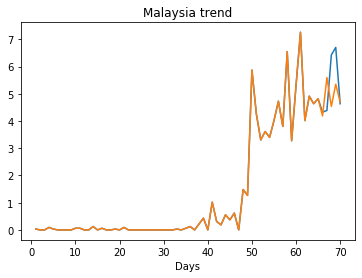

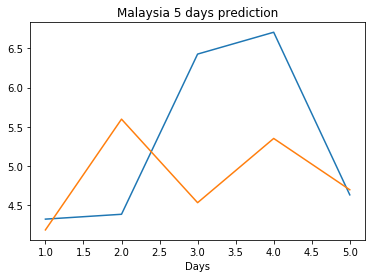

Creating directory ./offline6/Philippines/training/
Philippines
Saving the best model weights at Epoch [1], Best Valid Loss: 2.8800
Saving the best model weights at Epoch [2], Best Valid Loss: 2.8254


/space/home/nzhang/anaconda3/envs/neuralnet/lib/python3.7/site-packages/torch/nn/modules/loss.py:431: UserWarning: Using a target size (torch.Size([1, 1, 5])) that is different to the input size (torch.Size([5])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/space/home/nzhang/anaconda3/envs/neuralnet/lib/python3.7/site-packages/torch/nn/modules/loss.py:431: UserWarning: Using a target size (torch.Size([1, 5])) that is different to the input size (torch.Size([5])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Saving the best model weights at Epoch [4], Best Valid Loss: 2.7134
Saving the best model weights at Epoch [8], Best Valid Loss: 2.5472
Saving the best model weights at Epoch [10], Best Valid Loss: 2.3933
Saving the best model weights at Epoch [11], Best Valid Loss: 2.3135
Saving the best model weights at Epoch [12], Best Valid Loss: 2.2663
Saving the best model weights at Epoch [13], Best Valid Loss: 2.1173
Saving the best model weights at Epoch [14], Best Valid Loss: 1.9726
Saving the best model weights at Epoch [15], Best Valid Loss: 1.7994
Saving the best model weights at Epoch [16], Best Valid Loss: 1.7638
Saving the best model weights at Epoch [17], Best Valid Loss: 1.6477
Saving the best model weights at Epoch [18], Best Valid Loss: 1.5335
Saving the best model weights at Epoch [19], Best Valid Loss: 1.4456
Saving the best model weights at Epoch [20], Best Valid Loss: 1.4178
Saving the best model weights at Epoch [21], Best Valid Loss: 1.3796
Saving the best model weights at Epo

Saving the best model weights at Epoch [9], Best Valid Loss: 1.5091
Saving the best model weights at Epoch [10], Best Valid Loss: 1.3437
Saving the best model weights at Epoch [11], Best Valid Loss: 1.2342
Saving the best model weights at Epoch [12], Best Valid Loss: 1.2061
Saving the best model weights at Epoch [13], Best Valid Loss: 1.1550
Saving the best model weights at Epoch [15], Best Valid Loss: 1.1220
train error: 0.026951445875844606
1.1220145225524902
Saving the best model weights at Epoch [1], Best Valid Loss: 2.8246
Saving the best model weights at Epoch [2], Best Valid Loss: 1.8250
Saving the best model weights at Epoch [3], Best Valid Loss: 1.3781
Saving the best model weights at Epoch [4], Best Valid Loss: 1.1625
train error: 0.01571493117759625
1.1625386476516724
Saving the best model weights at Epoch [1], Best Valid Loss: 2.9503
Saving the best model weights at Epoch [2], Best Valid Loss: 2.7683
Saving the best model weights at Epoch [3], Best Valid Loss: 2.6679
Saving

Saving the best model weights at Epoch [37], Best Valid Loss: 2.1335
Saving the best model weights at Epoch [38], Best Valid Loss: 2.0045
Saving the best model weights at Epoch [39], Best Valid Loss: 1.7317
Saving the best model weights at Epoch [40], Best Valid Loss: 1.6669
Saving the best model weights at Epoch [41], Best Valid Loss: 1.5072
Saving the best model weights at Epoch [42], Best Valid Loss: 1.3878
Saving the best model weights at Epoch [43], Best Valid Loss: 1.3262
Saving the best model weights at Epoch [44], Best Valid Loss: 1.2902
Saving the best model weights at Epoch [45], Best Valid Loss: 1.2723
Saving the best model weights at Epoch [46], Best Valid Loss: 1.2530
Saving the best model weights at Epoch [47], Best Valid Loss: 1.2262
Saving the best model weights at Epoch [48], Best Valid Loss: 1.2228
Saving the best model weights at Epoch [49], Best Valid Loss: 1.2124
train error: 0.04468194795772433
1.2124263048171997
Saving the best model weights at Epoch [1], Best Va

Saving the best model weights at Epoch [3], Best Valid Loss: 2.1331
Saving the best model weights at Epoch [6], Best Valid Loss: 1.8129
train error: 0.23876407062634825
1.8128947019577026
Saving the best model weights at Epoch [1], Best Valid Loss: 2.8123
Saving the best model weights at Epoch [4], Best Valid Loss: 2.7468
Saving the best model weights at Epoch [19], Best Valid Loss: 2.7429
Saving the best model weights at Epoch [23], Best Valid Loss: 2.7151
Saving the best model weights at Epoch [27], Best Valid Loss: 2.7012
Saving the best model weights at Epoch [33], Best Valid Loss: 2.6690
train error: 0.20334742746005455
2.668991804122925
Saving the best model weights at Epoch [1], Best Valid Loss: 2.9162
Saving the best model weights at Epoch [2], Best Valid Loss: 2.7662
Saving the best model weights at Epoch [3], Best Valid Loss: 2.6076
Saving the best model weights at Epoch [44], Best Valid Loss: 2.5926
Saving the best model weights at Epoch [50], Best Valid Loss: 2.5884
train e

Saving the best model weights at Epoch [2], Best Valid Loss: 2.9329
Saving the best model weights at Epoch [3], Best Valid Loss: 2.7602
Saving the best model weights at Epoch [11], Best Valid Loss: 2.7284
Saving the best model weights at Epoch [15], Best Valid Loss: 2.6867
train error: 0.20436405744403602
2.6867475509643555
Saving the best model weights at Epoch [1], Best Valid Loss: 2.9497
Saving the best model weights at Epoch [2], Best Valid Loss: 2.9419
Saving the best model weights at Epoch [3], Best Valid Loss: 2.8248
Saving the best model weights at Epoch [6], Best Valid Loss: 2.7959
Saving the best model weights at Epoch [7], Best Valid Loss: 2.7631
Saving the best model weights at Epoch [12], Best Valid Loss: 2.6479
Saving the best model weights at Epoch [19], Best Valid Loss: 2.5480
train error: 0.2107618940062821
2.54795241355896
Saving the best model weights at Epoch [1], Best Valid Loss: 2.5293
Saving the best model weights at Epoch [13], Best Valid Loss: 2.1213
train erro

Saving the best model weights at Epoch [44], Best Valid Loss: 2.5845
Saving the best model weights at Epoch [45], Best Valid Loss: 2.5799
Saving the best model weights at Epoch [46], Best Valid Loss: 2.5749
Saving the best model weights at Epoch [47], Best Valid Loss: 2.5702
Saving the best model weights at Epoch [48], Best Valid Loss: 2.5648
Saving the best model weights at Epoch [49], Best Valid Loss: 2.5617
Saving the best model weights at Epoch [50], Best Valid Loss: 2.5578
train error: 0.1828333184743921
2.5577585697174072
Saving the best model weights at Epoch [1], Best Valid Loss: 3.1521
Saving the best model weights at Epoch [2], Best Valid Loss: 3.0703
Saving the best model weights at Epoch [3], Best Valid Loss: 3.0099
Saving the best model weights at Epoch [4], Best Valid Loss: 2.9715
Saving the best model weights at Epoch [5], Best Valid Loss: 2.9311
Saving the best model weights at Epoch [6], Best Valid Loss: 2.9022
Saving the best model weights at Epoch [7], Best Valid Los

Saving the best model weights at Epoch [48], Best Valid Loss: 2.7042
Saving the best model weights at Epoch [49], Best Valid Loss: 2.6992
Saving the best model weights at Epoch [50], Best Valid Loss: 2.6959
train error: 0.18542283847928048
2.6959099769592285
Saving the best model weights at Epoch [1], Best Valid Loss: 3.3824
Saving the best model weights at Epoch [2], Best Valid Loss: 3.2091
Saving the best model weights at Epoch [3], Best Valid Loss: 3.0905
Saving the best model weights at Epoch [4], Best Valid Loss: 2.9884
Saving the best model weights at Epoch [5], Best Valid Loss: 2.9047
Saving the best model weights at Epoch [6], Best Valid Loss: 2.8475
Saving the best model weights at Epoch [7], Best Valid Loss: 2.8112
Saving the best model weights at Epoch [8], Best Valid Loss: 2.7730
Saving the best model weights at Epoch [9], Best Valid Loss: 2.7460
Saving the best model weights at Epoch [10], Best Valid Loss: 2.7213
Saving the best model weights at Epoch [11], Best Valid Loss

Saving the best model weights at Epoch [44], Best Valid Loss: 2.6886
Saving the best model weights at Epoch [45], Best Valid Loss: 2.6825
Saving the best model weights at Epoch [46], Best Valid Loss: 2.6774
Saving the best model weights at Epoch [47], Best Valid Loss: 2.6721
Saving the best model weights at Epoch [48], Best Valid Loss: 2.6688
Saving the best model weights at Epoch [49], Best Valid Loss: 2.6649
Saving the best model weights at Epoch [50], Best Valid Loss: 2.6594
train error: 0.18348735701292754
2.6593680381774902
Saving the best model weights at Epoch [1], Best Valid Loss: 3.5140
Saving the best model weights at Epoch [2], Best Valid Loss: 3.3140
Saving the best model weights at Epoch [3], Best Valid Loss: 3.1748
Saving the best model weights at Epoch [4], Best Valid Loss: 3.0687
Saving the best model weights at Epoch [5], Best Valid Loss: 2.9870
Saving the best model weights at Epoch [6], Best Valid Loss: 2.9299
Saving the best model weights at Epoch [7], Best Valid Lo

Saving the best model weights at Epoch [37], Best Valid Loss: 2.6951
Saving the best model weights at Epoch [38], Best Valid Loss: 2.6901
Saving the best model weights at Epoch [39], Best Valid Loss: 2.6850
Saving the best model weights at Epoch [40], Best Valid Loss: 2.6807
Saving the best model weights at Epoch [41], Best Valid Loss: 2.6753
Saving the best model weights at Epoch [42], Best Valid Loss: 2.6703
Saving the best model weights at Epoch [43], Best Valid Loss: 2.6655
Saving the best model weights at Epoch [44], Best Valid Loss: 2.6604
Saving the best model weights at Epoch [45], Best Valid Loss: 2.6554
Saving the best model weights at Epoch [46], Best Valid Loss: 2.6496
Saving the best model weights at Epoch [47], Best Valid Loss: 2.6450
Saving the best model weights at Epoch [48], Best Valid Loss: 2.6416
Saving the best model weights at Epoch [49], Best Valid Loss: 2.6381
Saving the best model weights at Epoch [50], Best Valid Loss: 2.6321
train error: 0.1806357509146134
2.

Saving the best model weights at Epoch [26], Best Valid Loss: 2.8289
Saving the best model weights at Epoch [27], Best Valid Loss: 2.8262
Saving the best model weights at Epoch [28], Best Valid Loss: 2.8222
Saving the best model weights at Epoch [29], Best Valid Loss: 2.8197
Saving the best model weights at Epoch [30], Best Valid Loss: 2.8167
Saving the best model weights at Epoch [31], Best Valid Loss: 2.8156
Saving the best model weights at Epoch [32], Best Valid Loss: 2.8133
Saving the best model weights at Epoch [34], Best Valid Loss: 2.8122
Saving the best model weights at Epoch [35], Best Valid Loss: 2.8116
Saving the best model weights at Epoch [36], Best Valid Loss: 2.8097
Saving the best model weights at Epoch [37], Best Valid Loss: 2.8079
Saving the best model weights at Epoch [39], Best Valid Loss: 2.8070
Saving the best model weights at Epoch [42], Best Valid Loss: 2.8063
Saving the best model weights at Epoch [44], Best Valid Loss: 2.8050
Saving the best model weights at E

Saving the best model weights at Epoch [37], Best Valid Loss: 2.6565
Saving the best model weights at Epoch [41], Best Valid Loss: 2.6429
Saving the best model weights at Epoch [44], Best Valid Loss: 2.6420
Saving the best model weights at Epoch [49], Best Valid Loss: 2.5627
train error: 0.17997322169442972
2.562695026397705
Saving the best model weights at Epoch [1], Best Valid Loss: 3.2811
Saving the best model weights at Epoch [2], Best Valid Loss: 3.2157
Saving the best model weights at Epoch [3], Best Valid Loss: 3.1588
Saving the best model weights at Epoch [4], Best Valid Loss: 3.1103
Saving the best model weights at Epoch [5], Best Valid Loss: 3.0687
Saving the best model weights at Epoch [6], Best Valid Loss: 3.0350
Saving the best model weights at Epoch [7], Best Valid Loss: 3.0014
Saving the best model weights at Epoch [8], Best Valid Loss: 2.9760
Saving the best model weights at Epoch [9], Best Valid Loss: 2.9545
Saving the best model weights at Epoch [10], Best Valid Loss:

Saving the best model weights at Epoch [4], Best Valid Loss: 3.1109
Saving the best model weights at Epoch [5], Best Valid Loss: 3.0306
Saving the best model weights at Epoch [6], Best Valid Loss: 2.9808
Saving the best model weights at Epoch [7], Best Valid Loss: 2.9395
Saving the best model weights at Epoch [8], Best Valid Loss: 2.9121
Saving the best model weights at Epoch [9], Best Valid Loss: 2.8857
Saving the best model weights at Epoch [10], Best Valid Loss: 2.8652
Saving the best model weights at Epoch [11], Best Valid Loss: 2.8580
Saving the best model weights at Epoch [12], Best Valid Loss: 2.8499
Saving the best model weights at Epoch [13], Best Valid Loss: 2.8430
Saving the best model weights at Epoch [14], Best Valid Loss: 2.8312
Saving the best model weights at Epoch [15], Best Valid Loss: 2.8232
Saving the best model weights at Epoch [16], Best Valid Loss: 2.8164
Saving the best model weights at Epoch [17], Best Valid Loss: 2.8109
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [34], Best Valid Loss: 2.8164
Saving the best model weights at Epoch [35], Best Valid Loss: 2.8150
Saving the best model weights at Epoch [36], Best Valid Loss: 2.8141
Saving the best model weights at Epoch [38], Best Valid Loss: 2.8141
Saving the best model weights at Epoch [39], Best Valid Loss: 2.8119
Saving the best model weights at Epoch [42], Best Valid Loss: 2.8117
Saving the best model weights at Epoch [43], Best Valid Loss: 2.8113
train error: 0.19792468634744484
2.811328887939453
Saving the best model weights at Epoch [1], Best Valid Loss: 3.4904
Saving the best model weights at Epoch [2], Best Valid Loss: 3.3193
Saving the best model weights at Epoch [3], Best Valid Loss: 3.1894
Saving the best model weights at Epoch [4], Best Valid Loss: 3.0997
Saving the best model weights at Epoch [5], Best Valid Loss: 3.0281
Saving the best model weights at Epoch [6], Best Valid Loss: 2.9674
Saving the best model weights at Epoch [7], Best Valid Los

Saving the best model weights at Epoch [9], Best Valid Loss: 3.0149
Saving the best model weights at Epoch [10], Best Valid Loss: 2.9851
Saving the best model weights at Epoch [11], Best Valid Loss: 2.9602
Saving the best model weights at Epoch [12], Best Valid Loss: 2.9387
Saving the best model weights at Epoch [13], Best Valid Loss: 2.9219
Saving the best model weights at Epoch [14], Best Valid Loss: 2.9079
Saving the best model weights at Epoch [15], Best Valid Loss: 2.8960
Saving the best model weights at Epoch [16], Best Valid Loss: 2.8831
Saving the best model weights at Epoch [17], Best Valid Loss: 2.8731
Saving the best model weights at Epoch [18], Best Valid Loss: 2.8650
Saving the best model weights at Epoch [19], Best Valid Loss: 2.8597
Saving the best model weights at Epoch [20], Best Valid Loss: 2.8532
Saving the best model weights at Epoch [21], Best Valid Loss: 2.8488
Saving the best model weights at Epoch [22], Best Valid Loss: 2.8414
Saving the best model weights at Ep

Saving the best model weights at Epoch [15], Best Valid Loss: 2.8255
Saving the best model weights at Epoch [17], Best Valid Loss: 2.8228
Saving the best model weights at Epoch [18], Best Valid Loss: 2.8191
Saving the best model weights at Epoch [21], Best Valid Loss: 2.8170
Saving the best model weights at Epoch [27], Best Valid Loss: 2.8141
Saving the best model weights at Epoch [28], Best Valid Loss: 2.8111
Saving the best model weights at Epoch [29], Best Valid Loss: 2.8101
Saving the best model weights at Epoch [31], Best Valid Loss: 2.8060
Saving the best model weights at Epoch [32], Best Valid Loss: 2.8052
Saving the best model weights at Epoch [39], Best Valid Loss: 2.8041
train error: 0.19854974399010342
2.804131507873535
Saving the best model weights at Epoch [1], Best Valid Loss: 2.9863
Saving the best model weights at Epoch [2], Best Valid Loss: 2.8308
Saving the best model weights at Epoch [3], Best Valid Loss: 2.8066
Saving the best model weights at Epoch [4], Best Valid 

Saving the best model weights at Epoch [37], Best Valid Loss: 2.8139
Saving the best model weights at Epoch [40], Best Valid Loss: 2.8136
Saving the best model weights at Epoch [41], Best Valid Loss: 2.8128
Saving the best model weights at Epoch [42], Best Valid Loss: 2.8125
train error: 0.1979394445816676
2.8125014305114746
Saving the best model weights at Epoch [1], Best Valid Loss: 3.7190
Saving the best model weights at Epoch [2], Best Valid Loss: 3.4953
Saving the best model weights at Epoch [3], Best Valid Loss: 3.3247
Saving the best model weights at Epoch [4], Best Valid Loss: 3.1981
Saving the best model weights at Epoch [5], Best Valid Loss: 3.1121
Saving the best model weights at Epoch [6], Best Valid Loss: 3.0288
Saving the best model weights at Epoch [7], Best Valid Loss: 2.9789
Saving the best model weights at Epoch [8], Best Valid Loss: 2.9422
Saving the best model weights at Epoch [9], Best Valid Loss: 2.9038
Saving the best model weights at Epoch [10], Best Valid Loss:

Saving the best model weights at Epoch [26], Best Valid Loss: 2.8271
Saving the best model weights at Epoch [28], Best Valid Loss: 2.8244
Saving the best model weights at Epoch [29], Best Valid Loss: 2.8228
Saving the best model weights at Epoch [30], Best Valid Loss: 2.8213
Saving the best model weights at Epoch [31], Best Valid Loss: 2.8205
Saving the best model weights at Epoch [32], Best Valid Loss: 2.8179
Saving the best model weights at Epoch [33], Best Valid Loss: 2.8175
Saving the best model weights at Epoch [34], Best Valid Loss: 2.8175
Saving the best model weights at Epoch [35], Best Valid Loss: 2.8161
Saving the best model weights at Epoch [39], Best Valid Loss: 2.8160
Saving the best model weights at Epoch [42], Best Valid Loss: 2.8148
Saving the best model weights at Epoch [43], Best Valid Loss: 2.8143
Saving the best model weights at Epoch [49], Best Valid Loss: 2.8137
train error: 0.19794732046624025
2.8137032985687256
Saving the best model weights at Epoch [1], Best Va

Saving the best model weights at Epoch [10], Best Valid Loss: 3.0126
Saving the best model weights at Epoch [11], Best Valid Loss: 2.9858
Saving the best model weights at Epoch [12], Best Valid Loss: 2.9609
Saving the best model weights at Epoch [13], Best Valid Loss: 2.9407
Saving the best model weights at Epoch [14], Best Valid Loss: 2.9225
Saving the best model weights at Epoch [15], Best Valid Loss: 2.9086
Saving the best model weights at Epoch [16], Best Valid Loss: 2.8958
Saving the best model weights at Epoch [17], Best Valid Loss: 2.8844
Saving the best model weights at Epoch [18], Best Valid Loss: 2.8738
Saving the best model weights at Epoch [19], Best Valid Loss: 2.8670
Saving the best model weights at Epoch [20], Best Valid Loss: 2.8587
Saving the best model weights at Epoch [21], Best Valid Loss: 2.8510
Saving the best model weights at Epoch [22], Best Valid Loss: 2.8430
Saving the best model weights at Epoch [23], Best Valid Loss: 2.8394
Saving the best model weights at E

Saving the best model weights at Epoch [33], Best Valid Loss: 2.8046
Saving the best model weights at Epoch [35], Best Valid Loss: 2.8036
train error: 0.19835966328779855
2.803598403930664
Saving the best model weights at Epoch [1], Best Valid Loss: 3.1128
Saving the best model weights at Epoch [2], Best Valid Loss: 2.8033
Saving the best model weights at Epoch [5], Best Valid Loss: 2.7317
Saving the best model weights at Epoch [27], Best Valid Loss: 2.7294
train error: 0.20140721605469783
2.7294020652770996
Saving the best model weights at Epoch [1], Best Valid Loss: 3.5849
Saving the best model weights at Epoch [2], Best Valid Loss: 3.5714
Saving the best model weights at Epoch [3], Best Valid Loss: 3.5582
Saving the best model weights at Epoch [4], Best Valid Loss: 3.5450
Saving the best model weights at Epoch [5], Best Valid Loss: 3.5322
Saving the best model weights at Epoch [6], Best Valid Loss: 3.5196
Saving the best model weights at Epoch [7], Best Valid Loss: 3.5072
Saving the

Saving the best model weights at Epoch [12], Best Valid Loss: 2.8893
Saving the best model weights at Epoch [13], Best Valid Loss: 2.8568
Saving the best model weights at Epoch [14], Best Valid Loss: 2.8308
Saving the best model weights at Epoch [15], Best Valid Loss: 2.8219
Saving the best model weights at Epoch [16], Best Valid Loss: 2.8016
Saving the best model weights at Epoch [17], Best Valid Loss: 2.7895
Saving the best model weights at Epoch [18], Best Valid Loss: 2.7770
Saving the best model weights at Epoch [19], Best Valid Loss: 2.7465
Saving the best model weights at Epoch [20], Best Valid Loss: 2.7336
Saving the best model weights at Epoch [21], Best Valid Loss: 2.7297
Saving the best model weights at Epoch [22], Best Valid Loss: 2.7215
Saving the best model weights at Epoch [23], Best Valid Loss: 2.7052
Saving the best model weights at Epoch [25], Best Valid Loss: 2.6974
Saving the best model weights at Epoch [26], Best Valid Loss: 2.6918
Saving the best model weights at E

Saving the best model weights at Epoch [42], Best Valid Loss: 3.1674
Saving the best model weights at Epoch [43], Best Valid Loss: 3.1574
Saving the best model weights at Epoch [44], Best Valid Loss: 3.1457
Saving the best model weights at Epoch [45], Best Valid Loss: 3.1356
Saving the best model weights at Epoch [46], Best Valid Loss: 3.1243
Saving the best model weights at Epoch [47], Best Valid Loss: 3.1149
Saving the best model weights at Epoch [48], Best Valid Loss: 3.1052
Saving the best model weights at Epoch [49], Best Valid Loss: 3.0961
Saving the best model weights at Epoch [50], Best Valid Loss: 3.0896
train error: 0.20480522623596092
3.089573621749878
Saving the best model weights at Epoch [1], Best Valid Loss: 3.5915
Saving the best model weights at Epoch [2], Best Valid Loss: 3.4749
Saving the best model weights at Epoch [3], Best Valid Loss: 3.3793
Saving the best model weights at Epoch [4], Best Valid Loss: 3.3022
Saving the best model weights at Epoch [5], Best Valid L

Saving the best model weights at Epoch [21], Best Valid Loss: 3.4011
Saving the best model weights at Epoch [22], Best Valid Loss: 3.3836
Saving the best model weights at Epoch [23], Best Valid Loss: 3.3652
Saving the best model weights at Epoch [24], Best Valid Loss: 3.3483
Saving the best model weights at Epoch [25], Best Valid Loss: 3.3320
Saving the best model weights at Epoch [26], Best Valid Loss: 3.3161
Saving the best model weights at Epoch [27], Best Valid Loss: 3.3007
Saving the best model weights at Epoch [28], Best Valid Loss: 3.2856
Saving the best model weights at Epoch [29], Best Valid Loss: 3.2712
Saving the best model weights at Epoch [30], Best Valid Loss: 3.2567
Saving the best model weights at Epoch [31], Best Valid Loss: 3.2450
Saving the best model weights at Epoch [32], Best Valid Loss: 3.2300
Saving the best model weights at Epoch [33], Best Valid Loss: 3.2169
Saving the best model weights at Epoch [34], Best Valid Loss: 3.2035
Saving the best model weights at E

Saving the best model weights at Epoch [4], Best Valid Loss: 3.5610
Saving the best model weights at Epoch [5], Best Valid Loss: 3.5377
Saving the best model weights at Epoch [6], Best Valid Loss: 3.5158
Saving the best model weights at Epoch [7], Best Valid Loss: 3.4943
Saving the best model weights at Epoch [8], Best Valid Loss: 3.4732
Saving the best model weights at Epoch [9], Best Valid Loss: 3.4528
Saving the best model weights at Epoch [10], Best Valid Loss: 3.4333
Saving the best model weights at Epoch [11], Best Valid Loss: 3.4137
Saving the best model weights at Epoch [12], Best Valid Loss: 3.3956
Saving the best model weights at Epoch [13], Best Valid Loss: 3.3784
Saving the best model weights at Epoch [14], Best Valid Loss: 3.3608
Saving the best model weights at Epoch [15], Best Valid Loss: 3.3428
Saving the best model weights at Epoch [16], Best Valid Loss: 3.3264
Saving the best model weights at Epoch [17], Best Valid Loss: 3.3104
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [34], Best Valid Loss: 3.0132
Saving the best model weights at Epoch [35], Best Valid Loss: 3.0100
Saving the best model weights at Epoch [36], Best Valid Loss: 3.0066
Saving the best model weights at Epoch [37], Best Valid Loss: 3.0035
Saving the best model weights at Epoch [38], Best Valid Loss: 3.0001
Saving the best model weights at Epoch [39], Best Valid Loss: 2.9970
Saving the best model weights at Epoch [40], Best Valid Loss: 2.9939
Saving the best model weights at Epoch [41], Best Valid Loss: 2.9909
Saving the best model weights at Epoch [42], Best Valid Loss: 2.9878
Saving the best model weights at Epoch [43], Best Valid Loss: 2.9849
Saving the best model weights at Epoch [44], Best Valid Loss: 2.9820
Saving the best model weights at Epoch [45], Best Valid Loss: 2.9793
Saving the best model weights at Epoch [46], Best Valid Loss: 2.9765
Saving the best model weights at Epoch [47], Best Valid Loss: 2.9735
Saving the best model weights at E

Saving the best model weights at Epoch [24], Best Valid Loss: 3.7413
Saving the best model weights at Epoch [25], Best Valid Loss: 3.7269
Saving the best model weights at Epoch [26], Best Valid Loss: 3.7128
Saving the best model weights at Epoch [27], Best Valid Loss: 3.6988
Saving the best model weights at Epoch [28], Best Valid Loss: 3.6852
Saving the best model weights at Epoch [29], Best Valid Loss: 3.6717
Saving the best model weights at Epoch [30], Best Valid Loss: 3.6585
Saving the best model weights at Epoch [31], Best Valid Loss: 3.6454
Saving the best model weights at Epoch [32], Best Valid Loss: 3.6327
Saving the best model weights at Epoch [33], Best Valid Loss: 3.6201
Saving the best model weights at Epoch [34], Best Valid Loss: 3.6077
Saving the best model weights at Epoch [35], Best Valid Loss: 3.5955
Saving the best model weights at Epoch [36], Best Valid Loss: 3.5835
Saving the best model weights at Epoch [37], Best Valid Loss: 3.5717
Saving the best model weights at E

Saving the best model weights at Epoch [9], Best Valid Loss: 3.3688
Saving the best model weights at Epoch [10], Best Valid Loss: 3.3600
Saving the best model weights at Epoch [11], Best Valid Loss: 3.3516
Saving the best model weights at Epoch [12], Best Valid Loss: 3.3432
Saving the best model weights at Epoch [13], Best Valid Loss: 3.3351
Saving the best model weights at Epoch [14], Best Valid Loss: 3.3271
Saving the best model weights at Epoch [15], Best Valid Loss: 3.3191
Saving the best model weights at Epoch [16], Best Valid Loss: 3.3113
Saving the best model weights at Epoch [17], Best Valid Loss: 3.3036
Saving the best model weights at Epoch [18], Best Valid Loss: 3.2960
Saving the best model weights at Epoch [19], Best Valid Loss: 3.2886
Saving the best model weights at Epoch [20], Best Valid Loss: 3.2813
Saving the best model weights at Epoch [21], Best Valid Loss: 3.2741
Saving the best model weights at Epoch [22], Best Valid Loss: 3.2670
Saving the best model weights at Ep

Saving the best model weights at Epoch [34], Best Valid Loss: 2.8139
Saving the best model weights at Epoch [35], Best Valid Loss: 2.8118
Saving the best model weights at Epoch [36], Best Valid Loss: 2.8115
Saving the best model weights at Epoch [45], Best Valid Loss: 2.8114
Saving the best model weights at Epoch [47], Best Valid Loss: 2.8100
train error: 0.1973268646125992
2.810027599334717
Saving the best model weights at Epoch [1], Best Valid Loss: 3.8780
Saving the best model weights at Epoch [2], Best Valid Loss: 3.8611
Saving the best model weights at Epoch [3], Best Valid Loss: 3.8445
Saving the best model weights at Epoch [4], Best Valid Loss: 3.8283
Saving the best model weights at Epoch [5], Best Valid Loss: 3.8124
Saving the best model weights at Epoch [6], Best Valid Loss: 3.7965
Saving the best model weights at Epoch [7], Best Valid Loss: 3.7813
Saving the best model weights at Epoch [8], Best Valid Loss: 3.7659
Saving the best model weights at Epoch [9], Best Valid Loss: 

Saving the best model weights at Epoch [14], Best Valid Loss: 2.9272
Saving the best model weights at Epoch [15], Best Valid Loss: 2.9180
Saving the best model weights at Epoch [16], Best Valid Loss: 2.9119
Saving the best model weights at Epoch [17], Best Valid Loss: 2.8815
Saving the best model weights at Epoch [18], Best Valid Loss: 2.8728
Saving the best model weights at Epoch [20], Best Valid Loss: 2.8647
Saving the best model weights at Epoch [21], Best Valid Loss: 2.8454
Saving the best model weights at Epoch [25], Best Valid Loss: 2.8433
Saving the best model weights at Epoch [26], Best Valid Loss: 2.8319
Saving the best model weights at Epoch [27], Best Valid Loss: 2.8197
Saving the best model weights at Epoch [30], Best Valid Loss: 2.8186
Saving the best model weights at Epoch [34], Best Valid Loss: 2.8162
Saving the best model weights at Epoch [36], Best Valid Loss: 2.8112
Saving the best model weights at Epoch [39], Best Valid Loss: 2.8002
train error: 0.1969846899310748
2.

Saving the best model weights at Epoch [5], Best Valid Loss: 3.2774
Saving the best model weights at Epoch [6], Best Valid Loss: 3.2053
Saving the best model weights at Epoch [7], Best Valid Loss: 3.1539
Saving the best model weights at Epoch [8], Best Valid Loss: 3.1015
Saving the best model weights at Epoch [9], Best Valid Loss: 3.0739
Saving the best model weights at Epoch [10], Best Valid Loss: 3.0317
Saving the best model weights at Epoch [11], Best Valid Loss: 3.0126
Saving the best model weights at Epoch [12], Best Valid Loss: 2.9802
Saving the best model weights at Epoch [13], Best Valid Loss: 2.9662
Saving the best model weights at Epoch [14], Best Valid Loss: 2.9390
Saving the best model weights at Epoch [15], Best Valid Loss: 2.9235
Saving the best model weights at Epoch [16], Best Valid Loss: 2.9130
Saving the best model weights at Epoch [17], Best Valid Loss: 2.8939
Saving the best model weights at Epoch [18], Best Valid Loss: 2.8905
Saving the best model weights at Epoch 

Saving the best model weights at Epoch [46], Best Valid Loss: 2.9804
Saving the best model weights at Epoch [47], Best Valid Loss: 2.9759
Saving the best model weights at Epoch [48], Best Valid Loss: 2.9724
Saving the best model weights at Epoch [49], Best Valid Loss: 2.9683
Saving the best model weights at Epoch [50], Best Valid Loss: 2.9635
train error: 0.20072050004576644
2.9635090827941895
Saving the best model weights at Epoch [1], Best Valid Loss: 3.3903
Saving the best model weights at Epoch [2], Best Valid Loss: 3.3104
Saving the best model weights at Epoch [3], Best Valid Loss: 3.2450
Saving the best model weights at Epoch [4], Best Valid Loss: 3.1859
Saving the best model weights at Epoch [5], Best Valid Loss: 3.1411
Saving the best model weights at Epoch [6], Best Valid Loss: 3.1051
Saving the best model weights at Epoch [7], Best Valid Loss: 3.0603
Saving the best model weights at Epoch [8], Best Valid Loss: 3.0228
Saving the best model weights at Epoch [9], Best Valid Loss

Saving the best model weights at Epoch [40], Best Valid Loss: 3.0839
Saving the best model weights at Epoch [41], Best Valid Loss: 3.0767
Saving the best model weights at Epoch [42], Best Valid Loss: 3.0704
Saving the best model weights at Epoch [43], Best Valid Loss: 3.0627
Saving the best model weights at Epoch [44], Best Valid Loss: 3.0564
Saving the best model weights at Epoch [45], Best Valid Loss: 3.0492
Saving the best model weights at Epoch [46], Best Valid Loss: 3.0435
Saving the best model weights at Epoch [47], Best Valid Loss: 3.0375
Saving the best model weights at Epoch [48], Best Valid Loss: 3.0301
Saving the best model weights at Epoch [49], Best Valid Loss: 3.0246
Saving the best model weights at Epoch [50], Best Valid Loss: 3.0186
train error: 0.2057386179144184
3.0185654163360596
Saving the best model weights at Epoch [1], Best Valid Loss: 3.6513
Saving the best model weights at Epoch [2], Best Valid Loss: 3.5398
Saving the best model weights at Epoch [3], Best Valid

Saving the best model weights at Epoch [28], Best Valid Loss: 3.2836
Saving the best model weights at Epoch [29], Best Valid Loss: 3.2705
Saving the best model weights at Epoch [30], Best Valid Loss: 3.2582
Saving the best model weights at Epoch [31], Best Valid Loss: 3.2464
Saving the best model weights at Epoch [32], Best Valid Loss: 3.2349
Saving the best model weights at Epoch [33], Best Valid Loss: 3.2236
Saving the best model weights at Epoch [34], Best Valid Loss: 3.2135
Saving the best model weights at Epoch [35], Best Valid Loss: 3.2015
Saving the best model weights at Epoch [36], Best Valid Loss: 3.1902
Saving the best model weights at Epoch [37], Best Valid Loss: 3.1814
Saving the best model weights at Epoch [38], Best Valid Loss: 3.1707
Saving the best model weights at Epoch [39], Best Valid Loss: 3.1608
Saving the best model weights at Epoch [40], Best Valid Loss: 3.1519
Saving the best model weights at Epoch [41], Best Valid Loss: 3.1416
Saving the best model weights at E

Saving the best model weights at Epoch [14], Best Valid Loss: 3.5464
Saving the best model weights at Epoch [15], Best Valid Loss: 3.5256
Saving the best model weights at Epoch [16], Best Valid Loss: 3.5041
Saving the best model weights at Epoch [17], Best Valid Loss: 3.4850
Saving the best model weights at Epoch [18], Best Valid Loss: 3.4662
Saving the best model weights at Epoch [19], Best Valid Loss: 3.4476
Saving the best model weights at Epoch [20], Best Valid Loss: 3.4288
Saving the best model weights at Epoch [21], Best Valid Loss: 3.4127
Saving the best model weights at Epoch [22], Best Valid Loss: 3.3945
Saving the best model weights at Epoch [23], Best Valid Loss: 3.3785
Saving the best model weights at Epoch [24], Best Valid Loss: 3.3635
Saving the best model weights at Epoch [25], Best Valid Loss: 3.3474
Saving the best model weights at Epoch [26], Best Valid Loss: 3.3323
Saving the best model weights at Epoch [27], Best Valid Loss: 3.3189
Saving the best model weights at E

Saving the best model weights at Epoch [1], Best Valid Loss: 3.8000
Saving the best model weights at Epoch [2], Best Valid Loss: 3.7724
Saving the best model weights at Epoch [3], Best Valid Loss: 3.7443
Saving the best model weights at Epoch [4], Best Valid Loss: 3.7165
Saving the best model weights at Epoch [5], Best Valid Loss: 3.6906
Saving the best model weights at Epoch [6], Best Valid Loss: 3.6662
Saving the best model weights at Epoch [7], Best Valid Loss: 3.6419
Saving the best model weights at Epoch [8], Best Valid Loss: 3.6178
Saving the best model weights at Epoch [9], Best Valid Loss: 3.5950
Saving the best model weights at Epoch [10], Best Valid Loss: 3.5719
Saving the best model weights at Epoch [11], Best Valid Loss: 3.5501
Saving the best model weights at Epoch [12], Best Valid Loss: 3.5296
Saving the best model weights at Epoch [13], Best Valid Loss: 3.5094
Saving the best model weights at Epoch [14], Best Valid Loss: 3.4889
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [40], Best Valid Loss: 3.2792
Saving the best model weights at Epoch [41], Best Valid Loss: 3.2723
Saving the best model weights at Epoch [42], Best Valid Loss: 3.2651
Saving the best model weights at Epoch [43], Best Valid Loss: 3.2583
Saving the best model weights at Epoch [44], Best Valid Loss: 3.2515
Saving the best model weights at Epoch [45], Best Valid Loss: 3.2448
Saving the best model weights at Epoch [46], Best Valid Loss: 3.2382
Saving the best model weights at Epoch [47], Best Valid Loss: 3.2317
Saving the best model weights at Epoch [48], Best Valid Loss: 3.2254
Saving the best model weights at Epoch [49], Best Valid Loss: 3.2192
Saving the best model weights at Epoch [50], Best Valid Loss: 3.2132
train error: 0.22142154693137855
3.213165760040283
Saving the best model weights at Epoch [1], Best Valid Loss: 3.8791
Saving the best model weights at Epoch [2], Best Valid Loss: 3.8496
Saving the best model weights at Epoch [3], Best Valid

Saving the best model weights at Epoch [30], Best Valid Loss: 3.2898
Saving the best model weights at Epoch [31], Best Valid Loss: 3.2824
Saving the best model weights at Epoch [32], Best Valid Loss: 3.2752
Saving the best model weights at Epoch [33], Best Valid Loss: 3.2681
Saving the best model weights at Epoch [34], Best Valid Loss: 3.2612
Saving the best model weights at Epoch [35], Best Valid Loss: 3.2543
Saving the best model weights at Epoch [36], Best Valid Loss: 3.2476
Saving the best model weights at Epoch [37], Best Valid Loss: 3.2410
Saving the best model weights at Epoch [38], Best Valid Loss: 3.2344
Saving the best model weights at Epoch [39], Best Valid Loss: 3.2280
Saving the best model weights at Epoch [40], Best Valid Loss: 3.2217
Saving the best model weights at Epoch [41], Best Valid Loss: 3.2154
Saving the best model weights at Epoch [42], Best Valid Loss: 3.2093
Saving the best model weights at Epoch [43], Best Valid Loss: 3.2033
Saving the best model weights at E

Saving the best model weights at Epoch [16], Best Valid Loss: 4.0636
Saving the best model weights at Epoch [17], Best Valid Loss: 4.0435
Saving the best model weights at Epoch [18], Best Valid Loss: 4.0238
Saving the best model weights at Epoch [19], Best Valid Loss: 4.0044
Saving the best model weights at Epoch [20], Best Valid Loss: 3.9854
Saving the best model weights at Epoch [21], Best Valid Loss: 3.9667
Saving the best model weights at Epoch [22], Best Valid Loss: 3.9484
Saving the best model weights at Epoch [23], Best Valid Loss: 3.9302
Saving the best model weights at Epoch [24], Best Valid Loss: 3.9125
Saving the best model weights at Epoch [25], Best Valid Loss: 3.8951
Saving the best model weights at Epoch [26], Best Valid Loss: 3.8779
Saving the best model weights at Epoch [27], Best Valid Loss: 3.8611
Saving the best model weights at Epoch [28], Best Valid Loss: 3.8448
Saving the best model weights at Epoch [29], Best Valid Loss: 3.8283
Saving the best model weights at E

Saving the best model weights at Epoch [8], Best Valid Loss: 3.7617
Saving the best model weights at Epoch [9], Best Valid Loss: 3.7466
Saving the best model weights at Epoch [10], Best Valid Loss: 3.7319
Saving the best model weights at Epoch [11], Best Valid Loss: 3.7175
Saving the best model weights at Epoch [12], Best Valid Loss: 3.7032
Saving the best model weights at Epoch [13], Best Valid Loss: 3.6892
Saving the best model weights at Epoch [14], Best Valid Loss: 3.6753
Saving the best model weights at Epoch [15], Best Valid Loss: 3.6617
Saving the best model weights at Epoch [16], Best Valid Loss: 3.6484
Saving the best model weights at Epoch [17], Best Valid Loss: 3.6355
Saving the best model weights at Epoch [18], Best Valid Loss: 3.6224
Saving the best model weights at Epoch [19], Best Valid Loss: 3.6097
Saving the best model weights at Epoch [20], Best Valid Loss: 3.5973
Saving the best model weights at Epoch [21], Best Valid Loss: 3.5851
Saving the best model weights at Epo

Saving the best model weights at Epoch [28], Best Valid Loss: 2.8343
Saving the best model weights at Epoch [30], Best Valid Loss: 2.8237
Saving the best model weights at Epoch [33], Best Valid Loss: 2.8200
Saving the best model weights at Epoch [35], Best Valid Loss: 2.8194
Saving the best model weights at Epoch [36], Best Valid Loss: 2.8186
Saving the best model weights at Epoch [37], Best Valid Loss: 2.8180
Saving the best model weights at Epoch [38], Best Valid Loss: 2.8157
Saving the best model weights at Epoch [39], Best Valid Loss: 2.8144
Saving the best model weights at Epoch [41], Best Valid Loss: 2.8104
Saving the best model weights at Epoch [42], Best Valid Loss: 2.8069
Saving the best model weights at Epoch [50], Best Valid Loss: 2.8040
train error: 0.19774902928620577
2.804047107696533
Saving the best model weights at Epoch [1], Best Valid Loss: 3.9415
Saving the best model weights at Epoch [2], Best Valid Loss: 3.9234
Saving the best model weights at Epoch [3], Best Valid

Saving the best model weights at Epoch [8], Best Valid Loss: 3.1105
Saving the best model weights at Epoch [9], Best Valid Loss: 3.0878
Saving the best model weights at Epoch [10], Best Valid Loss: 3.0440
Saving the best model weights at Epoch [11], Best Valid Loss: 3.0055
Saving the best model weights at Epoch [12], Best Valid Loss: 2.9849
Saving the best model weights at Epoch [13], Best Valid Loss: 2.9633
Saving the best model weights at Epoch [14], Best Valid Loss: 2.9395
Saving the best model weights at Epoch [15], Best Valid Loss: 2.9329
Saving the best model weights at Epoch [16], Best Valid Loss: 2.9199
Saving the best model weights at Epoch [17], Best Valid Loss: 2.8990
Saving the best model weights at Epoch [18], Best Valid Loss: 2.8897
Saving the best model weights at Epoch [19], Best Valid Loss: 2.8727
Saving the best model weights at Epoch [20], Best Valid Loss: 2.8643
Saving the best model weights at Epoch [21], Best Valid Loss: 2.8478
Saving the best model weights at Epo

Saving the best model weights at Epoch [46], Best Valid Loss: 3.0081
Saving the best model weights at Epoch [47], Best Valid Loss: 3.0031
Saving the best model weights at Epoch [48], Best Valid Loss: 2.9984
Saving the best model weights at Epoch [49], Best Valid Loss: 2.9928
Saving the best model weights at Epoch [50], Best Valid Loss: 2.9893
train error: 0.20176089340820907
2.9893391132354736
Saving the best model weights at Epoch [1], Best Valid Loss: 3.7404
Saving the best model weights at Epoch [2], Best Valid Loss: 3.6180
Saving the best model weights at Epoch [3], Best Valid Loss: 3.5098
Saving the best model weights at Epoch [4], Best Valid Loss: 3.4075
Saving the best model weights at Epoch [5], Best Valid Loss: 3.3279
Saving the best model weights at Epoch [6], Best Valid Loss: 3.2613
Saving the best model weights at Epoch [7], Best Valid Loss: 3.2058
Saving the best model weights at Epoch [8], Best Valid Loss: 3.1546
Saving the best model weights at Epoch [9], Best Valid Loss

Saving the best model weights at Epoch [32], Best Valid Loss: 4.0014
Saving the best model weights at Epoch [33], Best Valid Loss: 3.9977
Saving the best model weights at Epoch [34], Best Valid Loss: 3.9937
Saving the best model weights at Epoch [35], Best Valid Loss: 3.9900
Saving the best model weights at Epoch [36], Best Valid Loss: 3.9860
Saving the best model weights at Epoch [37], Best Valid Loss: 3.9823
Saving the best model weights at Epoch [38], Best Valid Loss: 3.9784
Saving the best model weights at Epoch [39], Best Valid Loss: 3.9746
Saving the best model weights at Epoch [40], Best Valid Loss: 3.9709
Saving the best model weights at Epoch [41], Best Valid Loss: 3.9672
Saving the best model weights at Epoch [42], Best Valid Loss: 3.9635
Saving the best model weights at Epoch [43], Best Valid Loss: 3.9597
Saving the best model weights at Epoch [44], Best Valid Loss: 3.9559
Saving the best model weights at Epoch [45], Best Valid Loss: 3.9522
Saving the best model weights at E

Saving the best model weights at Epoch [1], Best Valid Loss: 3.8521
Saving the best model weights at Epoch [2], Best Valid Loss: 3.8491
Saving the best model weights at Epoch [3], Best Valid Loss: 3.8460
Saving the best model weights at Epoch [4], Best Valid Loss: 3.8430
Saving the best model weights at Epoch [5], Best Valid Loss: 3.8398
Saving the best model weights at Epoch [6], Best Valid Loss: 3.8368
Saving the best model weights at Epoch [7], Best Valid Loss: 3.8338
Saving the best model weights at Epoch [8], Best Valid Loss: 3.8307
Saving the best model weights at Epoch [9], Best Valid Loss: 3.8279
Saving the best model weights at Epoch [10], Best Valid Loss: 3.8246
Saving the best model weights at Epoch [11], Best Valid Loss: 3.8217
Saving the best model weights at Epoch [12], Best Valid Loss: 3.8187
Saving the best model weights at Epoch [13], Best Valid Loss: 3.8157
Saving the best model weights at Epoch [14], Best Valid Loss: 3.8127
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [21], Best Valid Loss: 3.5575
Saving the best model weights at Epoch [22], Best Valid Loss: 3.5563
Saving the best model weights at Epoch [23], Best Valid Loss: 3.5550
Saving the best model weights at Epoch [24], Best Valid Loss: 3.5537
Saving the best model weights at Epoch [25], Best Valid Loss: 3.5525
Saving the best model weights at Epoch [26], Best Valid Loss: 3.5512
Saving the best model weights at Epoch [27], Best Valid Loss: 3.5500
Saving the best model weights at Epoch [28], Best Valid Loss: 3.5487
Saving the best model weights at Epoch [29], Best Valid Loss: 3.5474
Saving the best model weights at Epoch [30], Best Valid Loss: 3.5462
Saving the best model weights at Epoch [31], Best Valid Loss: 3.5449
Saving the best model weights at Epoch [32], Best Valid Loss: 3.5437
Saving the best model weights at Epoch [33], Best Valid Loss: 3.5425
Saving the best model weights at Epoch [34], Best Valid Loss: 3.5412
Saving the best model weights at E

Saving the best model weights at Epoch [41], Best Valid Loss: 3.1776
Saving the best model weights at Epoch [42], Best Valid Loss: 3.1717
Saving the best model weights at Epoch [43], Best Valid Loss: 3.1668
Saving the best model weights at Epoch [44], Best Valid Loss: 3.1586
Saving the best model weights at Epoch [45], Best Valid Loss: 3.1532
Saving the best model weights at Epoch [46], Best Valid Loss: 3.1478
Saving the best model weights at Epoch [47], Best Valid Loss: 3.1429
Saving the best model weights at Epoch [48], Best Valid Loss: 3.1365
Saving the best model weights at Epoch [49], Best Valid Loss: 3.1310
Saving the best model weights at Epoch [50], Best Valid Loss: 3.1269
train error: 0.21259438931010663
3.1269431114196777
Saving the best model weights at Epoch [1], Best Valid Loss: 3.7094
Saving the best model weights at Epoch [2], Best Valid Loss: 3.7079
Saving the best model weights at Epoch [3], Best Valid Loss: 3.7064
Saving the best model weights at Epoch [4], Best Valid

Saving the best model weights at Epoch [11], Best Valid Loss: 3.5148
Saving the best model weights at Epoch [12], Best Valid Loss: 3.5039
Saving the best model weights at Epoch [13], Best Valid Loss: 3.4924
Saving the best model weights at Epoch [14], Best Valid Loss: 3.4842
Saving the best model weights at Epoch [15], Best Valid Loss: 3.4756
Saving the best model weights at Epoch [16], Best Valid Loss: 3.4650
Saving the best model weights at Epoch [17], Best Valid Loss: 3.4574
Saving the best model weights at Epoch [18], Best Valid Loss: 3.4488
Saving the best model weights at Epoch [19], Best Valid Loss: 3.4378
Saving the best model weights at Epoch [20], Best Valid Loss: 3.4295
Saving the best model weights at Epoch [21], Best Valid Loss: 3.4219
Saving the best model weights at Epoch [22], Best Valid Loss: 3.4114
Saving the best model weights at Epoch [23], Best Valid Loss: 3.4045
Saving the best model weights at Epoch [24], Best Valid Loss: 3.3952
Saving the best model weights at E

Saving the best model weights at Epoch [31], Best Valid Loss: 3.2071
Saving the best model weights at Epoch [32], Best Valid Loss: 3.2059
Saving the best model weights at Epoch [33], Best Valid Loss: 3.2048
Saving the best model weights at Epoch [34], Best Valid Loss: 3.2038
Saving the best model weights at Epoch [35], Best Valid Loss: 3.2025
Saving the best model weights at Epoch [36], Best Valid Loss: 3.2013
Saving the best model weights at Epoch [37], Best Valid Loss: 3.2002
Saving the best model weights at Epoch [38], Best Valid Loss: 3.1991
Saving the best model weights at Epoch [39], Best Valid Loss: 3.1980
Saving the best model weights at Epoch [40], Best Valid Loss: 3.1968
Saving the best model weights at Epoch [41], Best Valid Loss: 3.1957
Saving the best model weights at Epoch [42], Best Valid Loss: 3.1946
Saving the best model weights at Epoch [43], Best Valid Loss: 3.1935
Saving the best model weights at Epoch [44], Best Valid Loss: 3.1924
Saving the best model weights at E

Saving the best model weights at Epoch [1], Best Valid Loss: 3.6690
Saving the best model weights at Epoch [2], Best Valid Loss: 3.6668
Saving the best model weights at Epoch [3], Best Valid Loss: 3.6641
Saving the best model weights at Epoch [4], Best Valid Loss: 3.6616
Saving the best model weights at Epoch [5], Best Valid Loss: 3.6592
Saving the best model weights at Epoch [6], Best Valid Loss: 3.6569
Saving the best model weights at Epoch [7], Best Valid Loss: 3.6544
Saving the best model weights at Epoch [8], Best Valid Loss: 3.6521
Saving the best model weights at Epoch [9], Best Valid Loss: 3.6496
Saving the best model weights at Epoch [10], Best Valid Loss: 3.6472
Saving the best model weights at Epoch [11], Best Valid Loss: 3.6449
Saving the best model weights at Epoch [12], Best Valid Loss: 3.6425
Saving the best model weights at Epoch [13], Best Valid Loss: 3.6400
Saving the best model weights at Epoch [14], Best Valid Loss: 3.6378
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [20], Best Valid Loss: 3.7447
Saving the best model weights at Epoch [21], Best Valid Loss: 3.7432
Saving the best model weights at Epoch [22], Best Valid Loss: 3.7418
Saving the best model weights at Epoch [23], Best Valid Loss: 3.7404
Saving the best model weights at Epoch [24], Best Valid Loss: 3.7389
Saving the best model weights at Epoch [25], Best Valid Loss: 3.7375
Saving the best model weights at Epoch [26], Best Valid Loss: 3.7361
Saving the best model weights at Epoch [27], Best Valid Loss: 3.7347
Saving the best model weights at Epoch [28], Best Valid Loss: 3.7333
Saving the best model weights at Epoch [29], Best Valid Loss: 3.7319
Saving the best model weights at Epoch [30], Best Valid Loss: 3.7304
Saving the best model weights at Epoch [31], Best Valid Loss: 3.7290
Saving the best model weights at Epoch [32], Best Valid Loss: 3.7276
Saving the best model weights at Epoch [33], Best Valid Loss: 3.7262
Saving the best model weights at E

Saving the best model weights at Epoch [38], Best Valid Loss: 3.2757
Saving the best model weights at Epoch [39], Best Valid Loss: 3.2692
Saving the best model weights at Epoch [40], Best Valid Loss: 3.2618
Saving the best model weights at Epoch [41], Best Valid Loss: 3.2544
Saving the best model weights at Epoch [42], Best Valid Loss: 3.2493
Saving the best model weights at Epoch [43], Best Valid Loss: 3.2442
Saving the best model weights at Epoch [44], Best Valid Loss: 3.2373
Saving the best model weights at Epoch [45], Best Valid Loss: 3.2307
Saving the best model weights at Epoch [46], Best Valid Loss: 3.2254
Saving the best model weights at Epoch [47], Best Valid Loss: 3.2209
Saving the best model weights at Epoch [48], Best Valid Loss: 3.2144
Saving the best model weights at Epoch [49], Best Valid Loss: 3.2094
Saving the best model weights at Epoch [50], Best Valid Loss: 3.2021
train error: 0.22163748944488665
3.202127456665039
Saving the best model weights at Epoch [1], Best Val

Saving the best model weights at Epoch [6], Best Valid Loss: 3.5826
Saving the best model weights at Epoch [7], Best Valid Loss: 3.5711
Saving the best model weights at Epoch [8], Best Valid Loss: 3.5608
Saving the best model weights at Epoch [9], Best Valid Loss: 3.5485
Saving the best model weights at Epoch [10], Best Valid Loss: 3.5395
Saving the best model weights at Epoch [11], Best Valid Loss: 3.5293
Saving the best model weights at Epoch [12], Best Valid Loss: 3.5191
Saving the best model weights at Epoch [13], Best Valid Loss: 3.5093
Saving the best model weights at Epoch [14], Best Valid Loss: 3.4989
Saving the best model weights at Epoch [15], Best Valid Loss: 3.4895
Saving the best model weights at Epoch [16], Best Valid Loss: 3.4783
Saving the best model weights at Epoch [17], Best Valid Loss: 3.4715
Saving the best model weights at Epoch [18], Best Valid Loss: 3.4621
Saving the best model weights at Epoch [19], Best Valid Loss: 3.4524
Saving the best model weights at Epoch

Saving the best model weights at Epoch [25], Best Valid Loss: 3.6393
Saving the best model weights at Epoch [26], Best Valid Loss: 3.6370
Saving the best model weights at Epoch [27], Best Valid Loss: 3.6348
Saving the best model weights at Epoch [28], Best Valid Loss: 3.6326
Saving the best model weights at Epoch [29], Best Valid Loss: 3.6304
Saving the best model weights at Epoch [30], Best Valid Loss: 3.6281
Saving the best model weights at Epoch [31], Best Valid Loss: 3.6259
Saving the best model weights at Epoch [32], Best Valid Loss: 3.6237
Saving the best model weights at Epoch [33], Best Valid Loss: 3.6215
Saving the best model weights at Epoch [34], Best Valid Loss: 3.6193
Saving the best model weights at Epoch [35], Best Valid Loss: 3.6170
Saving the best model weights at Epoch [36], Best Valid Loss: 3.6149
Saving the best model weights at Epoch [37], Best Valid Loss: 3.6127
Saving the best model weights at Epoch [38], Best Valid Loss: 3.6105
Saving the best model weights at E

Saving the best model weights at Epoch [45], Best Valid Loss: 3.5635
Saving the best model weights at Epoch [46], Best Valid Loss: 3.5623
Saving the best model weights at Epoch [47], Best Valid Loss: 3.5610
Saving the best model weights at Epoch [48], Best Valid Loss: 3.5598
Saving the best model weights at Epoch [49], Best Valid Loss: 3.5586
Saving the best model weights at Epoch [50], Best Valid Loss: 3.5573
train error: 0.28468113591273625
3.557342290878296
Saving the best model weights at Epoch [1], Best Valid Loss: 3.6826
Saving the best model weights at Epoch [2], Best Valid Loss: 3.6801
Saving the best model weights at Epoch [3], Best Valid Loss: 3.6774
Saving the best model weights at Epoch [4], Best Valid Loss: 3.6750
Saving the best model weights at Epoch [5], Best Valid Loss: 3.6724
Saving the best model weights at Epoch [6], Best Valid Loss: 3.6699
Saving the best model weights at Epoch [7], Best Valid Loss: 3.6674
Saving the best model weights at Epoch [8], Best Valid Loss

Saving the best model weights at Epoch [12], Best Valid Loss: 3.6468
Saving the best model weights at Epoch [13], Best Valid Loss: 3.6455
Saving the best model weights at Epoch [14], Best Valid Loss: 3.6442
Saving the best model weights at Epoch [15], Best Valid Loss: 3.6429
Saving the best model weights at Epoch [16], Best Valid Loss: 3.6416
Saving the best model weights at Epoch [17], Best Valid Loss: 3.6403
Saving the best model weights at Epoch [18], Best Valid Loss: 3.6390
Saving the best model weights at Epoch [19], Best Valid Loss: 3.6377
Saving the best model weights at Epoch [20], Best Valid Loss: 3.6364
Saving the best model weights at Epoch [21], Best Valid Loss: 3.6351
Saving the best model weights at Epoch [22], Best Valid Loss: 3.6338
Saving the best model weights at Epoch [23], Best Valid Loss: 3.6325
Saving the best model weights at Epoch [24], Best Valid Loss: 3.6312
Saving the best model weights at Epoch [25], Best Valid Loss: 3.6299
Saving the best model weights at E

Saving the best model weights at Epoch [32], Best Valid Loss: 3.2625
Saving the best model weights at Epoch [33], Best Valid Loss: 3.2564
Saving the best model weights at Epoch [34], Best Valid Loss: 3.2496
Saving the best model weights at Epoch [35], Best Valid Loss: 3.2433
Saving the best model weights at Epoch [36], Best Valid Loss: 3.2375
Saving the best model weights at Epoch [37], Best Valid Loss: 3.2325
Saving the best model weights at Epoch [38], Best Valid Loss: 3.2261
Saving the best model weights at Epoch [39], Best Valid Loss: 3.2205
Saving the best model weights at Epoch [40], Best Valid Loss: 3.2145
Saving the best model weights at Epoch [41], Best Valid Loss: 3.2090
Saving the best model weights at Epoch [42], Best Valid Loss: 3.2036
Saving the best model weights at Epoch [43], Best Valid Loss: 3.1978
Saving the best model weights at Epoch [44], Best Valid Loss: 3.1918
Saving the best model weights at Epoch [45], Best Valid Loss: 3.1874
Saving the best model weights at E

Saving the best model weights at Epoch [1], Best Valid Loss: 3.5327
Saving the best model weights at Epoch [2], Best Valid Loss: 3.5219
Saving the best model weights at Epoch [3], Best Valid Loss: 3.5131
Saving the best model weights at Epoch [4], Best Valid Loss: 3.5031
Saving the best model weights at Epoch [5], Best Valid Loss: 3.4946
Saving the best model weights at Epoch [6], Best Valid Loss: 3.4837
Saving the best model weights at Epoch [7], Best Valid Loss: 3.4747
Saving the best model weights at Epoch [8], Best Valid Loss: 3.4637
Saving the best model weights at Epoch [9], Best Valid Loss: 3.4546
Saving the best model weights at Epoch [10], Best Valid Loss: 3.4452
Saving the best model weights at Epoch [11], Best Valid Loss: 3.4372
Saving the best model weights at Epoch [12], Best Valid Loss: 3.4278
Saving the best model weights at Epoch [13], Best Valid Loss: 3.4194
Saving the best model weights at Epoch [14], Best Valid Loss: 3.4104
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [19], Best Valid Loss: 4.5964
Saving the best model weights at Epoch [20], Best Valid Loss: 4.5908
Saving the best model weights at Epoch [21], Best Valid Loss: 4.5854
Saving the best model weights at Epoch [22], Best Valid Loss: 4.5796
Saving the best model weights at Epoch [23], Best Valid Loss: 4.5740
Saving the best model weights at Epoch [24], Best Valid Loss: 4.5684
Saving the best model weights at Epoch [25], Best Valid Loss: 4.5627
Saving the best model weights at Epoch [26], Best Valid Loss: 4.5574
Saving the best model weights at Epoch [27], Best Valid Loss: 4.5517
Saving the best model weights at Epoch [28], Best Valid Loss: 4.5465
Saving the best model weights at Epoch [29], Best Valid Loss: 4.5407
Saving the best model weights at Epoch [30], Best Valid Loss: 4.5352
Saving the best model weights at Epoch [31], Best Valid Loss: 4.5298
Saving the best model weights at Epoch [32], Best Valid Loss: 4.5245
Saving the best model weights at E

Saving the best model weights at Epoch [37], Best Valid Loss: 3.6976
Saving the best model weights at Epoch [38], Best Valid Loss: 3.6961
Saving the best model weights at Epoch [39], Best Valid Loss: 3.6946
Saving the best model weights at Epoch [40], Best Valid Loss: 3.6931
Saving the best model weights at Epoch [41], Best Valid Loss: 3.6917
Saving the best model weights at Epoch [42], Best Valid Loss: 3.6902
Saving the best model weights at Epoch [43], Best Valid Loss: 3.6888
Saving the best model weights at Epoch [44], Best Valid Loss: 3.6873
Saving the best model weights at Epoch [45], Best Valid Loss: 3.6859
Saving the best model weights at Epoch [46], Best Valid Loss: 3.6844
Saving the best model weights at Epoch [47], Best Valid Loss: 3.6830
Saving the best model weights at Epoch [48], Best Valid Loss: 3.6815
Saving the best model weights at Epoch [49], Best Valid Loss: 3.6801
Saving the best model weights at Epoch [50], Best Valid Loss: 3.6786
train error: 0.3003810000916322
3.

Saving the best model weights at Epoch [5], Best Valid Loss: 3.8381
Saving the best model weights at Epoch [6], Best Valid Loss: 3.8365
Saving the best model weights at Epoch [7], Best Valid Loss: 3.8348
Saving the best model weights at Epoch [8], Best Valid Loss: 3.8332
Saving the best model weights at Epoch [9], Best Valid Loss: 3.8316
Saving the best model weights at Epoch [10], Best Valid Loss: 3.8300
Saving the best model weights at Epoch [11], Best Valid Loss: 3.8284
Saving the best model weights at Epoch [12], Best Valid Loss: 3.8268
Saving the best model weights at Epoch [13], Best Valid Loss: 3.8253
Saving the best model weights at Epoch [14], Best Valid Loss: 3.8237
Saving the best model weights at Epoch [15], Best Valid Loss: 3.8221
Saving the best model weights at Epoch [16], Best Valid Loss: 3.8205
Saving the best model weights at Epoch [17], Best Valid Loss: 3.8189
Saving the best model weights at Epoch [18], Best Valid Loss: 3.8173
Saving the best model weights at Epoch 

Saving the best model weights at Epoch [23], Best Valid Loss: 3.5487
Saving the best model weights at Epoch [24], Best Valid Loss: 3.5391
Saving the best model weights at Epoch [25], Best Valid Loss: 3.5276
Saving the best model weights at Epoch [26], Best Valid Loss: 3.5176
Saving the best model weights at Epoch [27], Best Valid Loss: 3.5085
Saving the best model weights at Epoch [28], Best Valid Loss: 3.4990
Saving the best model weights at Epoch [29], Best Valid Loss: 3.4896
Saving the best model weights at Epoch [30], Best Valid Loss: 3.4792
Saving the best model weights at Epoch [31], Best Valid Loss: 3.4700
Saving the best model weights at Epoch [32], Best Valid Loss: 3.4616
Saving the best model weights at Epoch [33], Best Valid Loss: 3.4526
Saving the best model weights at Epoch [34], Best Valid Loss: 3.4421
Saving the best model weights at Epoch [35], Best Valid Loss: 3.4342
Saving the best model weights at Epoch [36], Best Valid Loss: 3.4260
Saving the best model weights at E

Saving the best model weights at Epoch [41], Best Valid Loss: 3.6751
Saving the best model weights at Epoch [42], Best Valid Loss: 3.6727
Saving the best model weights at Epoch [43], Best Valid Loss: 3.6703
Saving the best model weights at Epoch [44], Best Valid Loss: 3.6679
Saving the best model weights at Epoch [45], Best Valid Loss: 3.6655
Saving the best model weights at Epoch [46], Best Valid Loss: 3.6631
Saving the best model weights at Epoch [47], Best Valid Loss: 3.6607
Saving the best model weights at Epoch [48], Best Valid Loss: 3.6583
Saving the best model weights at Epoch [49], Best Valid Loss: 3.6560
Saving the best model weights at Epoch [50], Best Valid Loss: 3.6536
train error: 0.26131665273569527
3.6535897254943848
Saving the best model weights at Epoch [1], Best Valid Loss: 3.8291
Saving the best model weights at Epoch [2], Best Valid Loss: 3.8131
Saving the best model weights at Epoch [3], Best Valid Loss: 3.7982
Saving the best model weights at Epoch [4], Best Valid

Saving the best model weights at Epoch [9], Best Valid Loss: 4.0918
Saving the best model weights at Epoch [10], Best Valid Loss: 4.0882
Saving the best model weights at Epoch [11], Best Valid Loss: 4.0848
Saving the best model weights at Epoch [12], Best Valid Loss: 4.0812
Saving the best model weights at Epoch [13], Best Valid Loss: 4.0777
Saving the best model weights at Epoch [14], Best Valid Loss: 4.0741
Saving the best model weights at Epoch [15], Best Valid Loss: 4.0705
Saving the best model weights at Epoch [16], Best Valid Loss: 4.0670
Saving the best model weights at Epoch [17], Best Valid Loss: 4.0637
Saving the best model weights at Epoch [18], Best Valid Loss: 4.0601
Saving the best model weights at Epoch [19], Best Valid Loss: 4.0567
Saving the best model weights at Epoch [20], Best Valid Loss: 4.0532
Saving the best model weights at Epoch [21], Best Valid Loss: 4.0497
Saving the best model weights at Epoch [22], Best Valid Loss: 4.0464
Saving the best model weights at Ep

Saving the best model weights at Epoch [27], Best Valid Loss: 3.5729
Saving the best model weights at Epoch [28], Best Valid Loss: 3.5717
Saving the best model weights at Epoch [29], Best Valid Loss: 3.5705
Saving the best model weights at Epoch [30], Best Valid Loss: 3.5693
Saving the best model weights at Epoch [31], Best Valid Loss: 3.5681
Saving the best model weights at Epoch [32], Best Valid Loss: 3.5669
Saving the best model weights at Epoch [33], Best Valid Loss: 3.5657
Saving the best model weights at Epoch [34], Best Valid Loss: 3.5645
Saving the best model weights at Epoch [35], Best Valid Loss: 3.5633
Saving the best model weights at Epoch [36], Best Valid Loss: 3.5621
Saving the best model weights at Epoch [37], Best Valid Loss: 3.5609
Saving the best model weights at Epoch [38], Best Valid Loss: 3.5598
Saving the best model weights at Epoch [39], Best Valid Loss: 3.5586
Saving the best model weights at Epoch [40], Best Valid Loss: 3.5574
Saving the best model weights at E

Saving the best model weights at Epoch [45], Best Valid Loss: 3.1563
Saving the best model weights at Epoch [46], Best Valid Loss: 3.1503
Saving the best model weights at Epoch [47], Best Valid Loss: 3.1461
Saving the best model weights at Epoch [48], Best Valid Loss: 3.1420
Saving the best model weights at Epoch [49], Best Valid Loss: 3.1389
Saving the best model weights at Epoch [50], Best Valid Loss: 3.1326
train error: 0.21485190919289987
3.1326472759246826
Saving the best model weights at Epoch [1], Best Valid Loss: 3.5264
Saving the best model weights at Epoch [2], Best Valid Loss: 3.5253
Saving the best model weights at Epoch [3], Best Valid Loss: 3.5241
Saving the best model weights at Epoch [4], Best Valid Loss: 3.5230
Saving the best model weights at Epoch [5], Best Valid Loss: 3.5218
Saving the best model weights at Epoch [6], Best Valid Loss: 3.5207
Saving the best model weights at Epoch [7], Best Valid Loss: 3.5196
Saving the best model weights at Epoch [8], Best Valid Los

Saving the best model weights at Epoch [13], Best Valid Loss: 3.7095
Saving the best model weights at Epoch [14], Best Valid Loss: 3.6962
Saving the best model weights at Epoch [15], Best Valid Loss: 3.6830
Saving the best model weights at Epoch [16], Best Valid Loss: 3.6705
Saving the best model weights at Epoch [17], Best Valid Loss: 3.6586
Saving the best model weights at Epoch [18], Best Valid Loss: 3.6464
Saving the best model weights at Epoch [19], Best Valid Loss: 3.6344
Saving the best model weights at Epoch [20], Best Valid Loss: 3.6219
Saving the best model weights at Epoch [21], Best Valid Loss: 3.6114
Saving the best model weights at Epoch [22], Best Valid Loss: 3.6004
Saving the best model weights at Epoch [23], Best Valid Loss: 3.5896
Saving the best model weights at Epoch [24], Best Valid Loss: 3.5783
Saving the best model weights at Epoch [25], Best Valid Loss: 3.5669
Saving the best model weights at Epoch [26], Best Valid Loss: 3.5567
Saving the best model weights at E

Saving the best model weights at Epoch [32], Best Valid Loss: 3.8076
Saving the best model weights at Epoch [33], Best Valid Loss: 3.8048
Saving the best model weights at Epoch [34], Best Valid Loss: 3.8019
Saving the best model weights at Epoch [35], Best Valid Loss: 3.7990
Saving the best model weights at Epoch [36], Best Valid Loss: 3.7963
Saving the best model weights at Epoch [37], Best Valid Loss: 3.7935
Saving the best model weights at Epoch [38], Best Valid Loss: 3.7907
Saving the best model weights at Epoch [39], Best Valid Loss: 3.7880
Saving the best model weights at Epoch [40], Best Valid Loss: 3.7852
Saving the best model weights at Epoch [41], Best Valid Loss: 3.7825
Saving the best model weights at Epoch [42], Best Valid Loss: 3.7798
Saving the best model weights at Epoch [43], Best Valid Loss: 3.7770
Saving the best model weights at Epoch [44], Best Valid Loss: 3.7744
Saving the best model weights at Epoch [45], Best Valid Loss: 3.7716
Saving the best model weights at E

Saving the best model weights at Epoch [2], Best Valid Loss: 3.7180
Saving the best model weights at Epoch [3], Best Valid Loss: 3.7178
Saving the best model weights at Epoch [4], Best Valid Loss: 3.7175
Saving the best model weights at Epoch [5], Best Valid Loss: 3.7173
Saving the best model weights at Epoch [6], Best Valid Loss: 3.7170
Saving the best model weights at Epoch [7], Best Valid Loss: 3.7168
Saving the best model weights at Epoch [8], Best Valid Loss: 3.7165
Saving the best model weights at Epoch [9], Best Valid Loss: 3.7163
Saving the best model weights at Epoch [10], Best Valid Loss: 3.7160
Saving the best model weights at Epoch [11], Best Valid Loss: 3.7158
Saving the best model weights at Epoch [12], Best Valid Loss: 3.7155
Saving the best model weights at Epoch [13], Best Valid Loss: 3.7153
Saving the best model weights at Epoch [14], Best Valid Loss: 3.7150
Saving the best model weights at Epoch [15], Best Valid Loss: 3.7148
Saving the best model weights at Epoch [16

Saving the best model weights at Epoch [22], Best Valid Loss: 3.7488
Saving the best model weights at Epoch [23], Best Valid Loss: 3.7487
Saving the best model weights at Epoch [24], Best Valid Loss: 3.7485
Saving the best model weights at Epoch [25], Best Valid Loss: 3.7483
Saving the best model weights at Epoch [26], Best Valid Loss: 3.7482
Saving the best model weights at Epoch [27], Best Valid Loss: 3.7480
Saving the best model weights at Epoch [28], Best Valid Loss: 3.7478
Saving the best model weights at Epoch [29], Best Valid Loss: 3.7477
Saving the best model weights at Epoch [30], Best Valid Loss: 3.7475
Saving the best model weights at Epoch [31], Best Valid Loss: 3.7473
Saving the best model weights at Epoch [32], Best Valid Loss: 3.7472
Saving the best model weights at Epoch [33], Best Valid Loss: 3.7470
Saving the best model weights at Epoch [34], Best Valid Loss: 3.7469
Saving the best model weights at Epoch [35], Best Valid Loss: 3.7467
Saving the best model weights at E

Saving the best model weights at Epoch [41], Best Valid Loss: 3.8241
Saving the best model weights at Epoch [42], Best Valid Loss: 3.8226
Saving the best model weights at Epoch [43], Best Valid Loss: 3.8210
Saving the best model weights at Epoch [44], Best Valid Loss: 3.8196
Saving the best model weights at Epoch [45], Best Valid Loss: 3.8181
Saving the best model weights at Epoch [46], Best Valid Loss: 3.8166
Saving the best model weights at Epoch [47], Best Valid Loss: 3.8151
Saving the best model weights at Epoch [48], Best Valid Loss: 3.8137
Saving the best model weights at Epoch [49], Best Valid Loss: 3.8121
Saving the best model weights at Epoch [50], Best Valid Loss: 3.8106
train error: 0.2912967120219643
3.8105709552764893
Saving the best model weights at Epoch [1], Best Valid Loss: 3.8083
Saving the best model weights at Epoch [2], Best Valid Loss: 3.8081
Saving the best model weights at Epoch [3], Best Valid Loss: 3.8080
Saving the best model weights at Epoch [4], Best Valid 

Saving the best model weights at Epoch [11], Best Valid Loss: 3.5005
Saving the best model weights at Epoch [12], Best Valid Loss: 3.4993
Saving the best model weights at Epoch [13], Best Valid Loss: 3.4982
Saving the best model weights at Epoch [14], Best Valid Loss: 3.4972
Saving the best model weights at Epoch [15], Best Valid Loss: 3.4960
Saving the best model weights at Epoch [16], Best Valid Loss: 3.4949
Saving the best model weights at Epoch [17], Best Valid Loss: 3.4940
Saving the best model weights at Epoch [18], Best Valid Loss: 3.4927
Saving the best model weights at Epoch [19], Best Valid Loss: 3.4917
Saving the best model weights at Epoch [20], Best Valid Loss: 3.4906
Saving the best model weights at Epoch [21], Best Valid Loss: 3.4895
Saving the best model weights at Epoch [22], Best Valid Loss: 3.4886
Saving the best model weights at Epoch [23], Best Valid Loss: 3.4875
Saving the best model weights at Epoch [24], Best Valid Loss: 3.4864
Saving the best model weights at E

Saving the best model weights at Epoch [31], Best Valid Loss: 3.6320
Saving the best model weights at Epoch [32], Best Valid Loss: 3.6318
Saving the best model weights at Epoch [33], Best Valid Loss: 3.6315
Saving the best model weights at Epoch [34], Best Valid Loss: 3.6313
Saving the best model weights at Epoch [35], Best Valid Loss: 3.6310
Saving the best model weights at Epoch [36], Best Valid Loss: 3.6308
Saving the best model weights at Epoch [37], Best Valid Loss: 3.6305
Saving the best model weights at Epoch [38], Best Valid Loss: 3.6303
Saving the best model weights at Epoch [39], Best Valid Loss: 3.6300
Saving the best model weights at Epoch [40], Best Valid Loss: 3.6298
Saving the best model weights at Epoch [41], Best Valid Loss: 3.6296
Saving the best model weights at Epoch [42], Best Valid Loss: 3.6293
Saving the best model weights at Epoch [43], Best Valid Loss: 3.6291
Saving the best model weights at Epoch [44], Best Valid Loss: 3.6288
Saving the best model weights at E

Saving the best model weights at Epoch [50], Best Valid Loss: 3.3552
train error: 0.35708739471932255
3.3551979064941406
Saving the best model weights at Epoch [1], Best Valid Loss: 3.5840
Saving the best model weights at Epoch [2], Best Valid Loss: 3.5837
Saving the best model weights at Epoch [3], Best Valid Loss: 3.5835
Saving the best model weights at Epoch [4], Best Valid Loss: 3.5833
Saving the best model weights at Epoch [5], Best Valid Loss: 3.5830
Saving the best model weights at Epoch [6], Best Valid Loss: 3.5828
Saving the best model weights at Epoch [7], Best Valid Loss: 3.5826
Saving the best model weights at Epoch [8], Best Valid Loss: 3.5824
Saving the best model weights at Epoch [9], Best Valid Loss: 3.5822
Saving the best model weights at Epoch [10], Best Valid Loss: 3.5819
Saving the best model weights at Epoch [11], Best Valid Loss: 3.5817
Saving the best model weights at Epoch [12], Best Valid Loss: 3.5815
Saving the best model weights at Epoch [13], Best Valid Loss

Saving the best model weights at Epoch [17], Best Valid Loss: 3.5215
Saving the best model weights at Epoch [18], Best Valid Loss: 3.5214
Saving the best model weights at Epoch [19], Best Valid Loss: 3.5213
Saving the best model weights at Epoch [20], Best Valid Loss: 3.5212
Saving the best model weights at Epoch [21], Best Valid Loss: 3.5210
Saving the best model weights at Epoch [22], Best Valid Loss: 3.5209
Saving the best model weights at Epoch [23], Best Valid Loss: 3.5208
Saving the best model weights at Epoch [24], Best Valid Loss: 3.5207
Saving the best model weights at Epoch [25], Best Valid Loss: 3.5206
Saving the best model weights at Epoch [26], Best Valid Loss: 3.5205
Saving the best model weights at Epoch [27], Best Valid Loss: 3.5204
Saving the best model weights at Epoch [28], Best Valid Loss: 3.5202
Saving the best model weights at Epoch [29], Best Valid Loss: 3.5201
Saving the best model weights at Epoch [30], Best Valid Loss: 3.5200
Saving the best model weights at E

Saving the best model weights at Epoch [37], Best Valid Loss: 3.9676
Saving the best model weights at Epoch [38], Best Valid Loss: 3.9658
Saving the best model weights at Epoch [39], Best Valid Loss: 3.9644
Saving the best model weights at Epoch [40], Best Valid Loss: 3.9625
Saving the best model weights at Epoch [41], Best Valid Loss: 3.9607
Saving the best model weights at Epoch [42], Best Valid Loss: 3.9591
Saving the best model weights at Epoch [43], Best Valid Loss: 3.9575
Saving the best model weights at Epoch [44], Best Valid Loss: 3.9559
Saving the best model weights at Epoch [45], Best Valid Loss: 3.9541
Saving the best model weights at Epoch [46], Best Valid Loss: 3.9524
Saving the best model weights at Epoch [47], Best Valid Loss: 3.9508
Saving the best model weights at Epoch [48], Best Valid Loss: 3.9493
Saving the best model weights at Epoch [49], Best Valid Loss: 3.9474
Saving the best model weights at Epoch [50], Best Valid Loss: 3.9457
train error: 0.3217271987659236
3.

Saving the best model weights at Epoch [4], Best Valid Loss: 3.6890
Saving the best model weights at Epoch [5], Best Valid Loss: 3.6878
Saving the best model weights at Epoch [6], Best Valid Loss: 3.6864
Saving the best model weights at Epoch [7], Best Valid Loss: 3.6853
Saving the best model weights at Epoch [8], Best Valid Loss: 3.6839
Saving the best model weights at Epoch [9], Best Valid Loss: 3.6826
Saving the best model weights at Epoch [10], Best Valid Loss: 3.6815
Saving the best model weights at Epoch [11], Best Valid Loss: 3.6802
Saving the best model weights at Epoch [12], Best Valid Loss: 3.6789
Saving the best model weights at Epoch [13], Best Valid Loss: 3.6777
Saving the best model weights at Epoch [14], Best Valid Loss: 3.6766
Saving the best model weights at Epoch [15], Best Valid Loss: 3.6754
Saving the best model weights at Epoch [16], Best Valid Loss: 3.6739
Saving the best model weights at Epoch [17], Best Valid Loss: 3.6727
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [24], Best Valid Loss: 3.8104
Saving the best model weights at Epoch [25], Best Valid Loss: 3.8101
Saving the best model weights at Epoch [26], Best Valid Loss: 3.8098
Saving the best model weights at Epoch [27], Best Valid Loss: 3.8095
Saving the best model weights at Epoch [28], Best Valid Loss: 3.8092
Saving the best model weights at Epoch [29], Best Valid Loss: 3.8089
Saving the best model weights at Epoch [30], Best Valid Loss: 3.8086
Saving the best model weights at Epoch [31], Best Valid Loss: 3.8084
Saving the best model weights at Epoch [32], Best Valid Loss: 3.8081
Saving the best model weights at Epoch [33], Best Valid Loss: 3.8078
Saving the best model weights at Epoch [34], Best Valid Loss: 3.8075
Saving the best model weights at Epoch [35], Best Valid Loss: 3.8072
Saving the best model weights at Epoch [36], Best Valid Loss: 3.8069
Saving the best model weights at Epoch [37], Best Valid Loss: 3.8066
Saving the best model weights at E

Saving the best model weights at Epoch [44], Best Valid Loss: 4.0176
Saving the best model weights at Epoch [45], Best Valid Loss: 4.0174
Saving the best model weights at Epoch [46], Best Valid Loss: 4.0172
Saving the best model weights at Epoch [47], Best Valid Loss: 4.0170
Saving the best model weights at Epoch [48], Best Valid Loss: 4.0168
Saving the best model weights at Epoch [49], Best Valid Loss: 4.0166
Saving the best model weights at Epoch [50], Best Valid Loss: 4.0164
train error: 0.3237866779168447
4.016412258148193
Saving the best model weights at Epoch [1], Best Valid Loss: 3.6710
Saving the best model weights at Epoch [2], Best Valid Loss: 3.6707
Saving the best model weights at Epoch [3], Best Valid Loss: 3.6705
Saving the best model weights at Epoch [4], Best Valid Loss: 3.6702
Saving the best model weights at Epoch [5], Best Valid Loss: 3.6699
Saving the best model weights at Epoch [6], Best Valid Loss: 3.6697
Saving the best model weights at Epoch [7], Best Valid Loss

Saving the best model weights at Epoch [11], Best Valid Loss: 3.3940
Saving the best model weights at Epoch [12], Best Valid Loss: 3.3939
Saving the best model weights at Epoch [13], Best Valid Loss: 3.3938
Saving the best model weights at Epoch [14], Best Valid Loss: 3.3938
Saving the best model weights at Epoch [15], Best Valid Loss: 3.3937
Saving the best model weights at Epoch [16], Best Valid Loss: 3.3936
Saving the best model weights at Epoch [17], Best Valid Loss: 3.3935
Saving the best model weights at Epoch [18], Best Valid Loss: 3.3934
Saving the best model weights at Epoch [19], Best Valid Loss: 3.3933
Saving the best model weights at Epoch [20], Best Valid Loss: 3.3932
Saving the best model weights at Epoch [21], Best Valid Loss: 3.3931
Saving the best model weights at Epoch [22], Best Valid Loss: 3.3930
Saving the best model weights at Epoch [23], Best Valid Loss: 3.3929
Saving the best model weights at Epoch [24], Best Valid Loss: 3.3929
Saving the best model weights at E

Saving the best model weights at Epoch [31], Best Valid Loss: 3.6205
Saving the best model weights at Epoch [32], Best Valid Loss: 3.6194
Saving the best model weights at Epoch [33], Best Valid Loss: 3.6182
Saving the best model weights at Epoch [34], Best Valid Loss: 3.6170
Saving the best model weights at Epoch [35], Best Valid Loss: 3.6160
Saving the best model weights at Epoch [36], Best Valid Loss: 3.6148
Saving the best model weights at Epoch [37], Best Valid Loss: 3.6137
Saving the best model weights at Epoch [38], Best Valid Loss: 3.6124
Saving the best model weights at Epoch [39], Best Valid Loss: 3.6114
Saving the best model weights at Epoch [40], Best Valid Loss: 3.6103
Saving the best model weights at Epoch [41], Best Valid Loss: 3.6091
Saving the best model weights at Epoch [42], Best Valid Loss: 3.6080
Saving the best model weights at Epoch [43], Best Valid Loss: 3.6069
Saving the best model weights at Epoch [44], Best Valid Loss: 3.6058
Saving the best model weights at E

Saving the best model weights at Epoch [1], Best Valid Loss: 3.6125
Saving the best model weights at Epoch [2], Best Valid Loss: 3.6115
Saving the best model weights at Epoch [3], Best Valid Loss: 3.6104
Saving the best model weights at Epoch [4], Best Valid Loss: 3.6092
Saving the best model weights at Epoch [5], Best Valid Loss: 3.6081
Saving the best model weights at Epoch [6], Best Valid Loss: 3.6070
Saving the best model weights at Epoch [7], Best Valid Loss: 3.6058
Saving the best model weights at Epoch [8], Best Valid Loss: 3.6047
Saving the best model weights at Epoch [9], Best Valid Loss: 3.6036
Saving the best model weights at Epoch [10], Best Valid Loss: 3.6024
Saving the best model weights at Epoch [11], Best Valid Loss: 3.6014
Saving the best model weights at Epoch [12], Best Valid Loss: 3.6002
Saving the best model weights at Epoch [13], Best Valid Loss: 3.5991
Saving the best model weights at Epoch [14], Best Valid Loss: 3.5979
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [21], Best Valid Loss: 3.9251
Saving the best model weights at Epoch [22], Best Valid Loss: 3.9248
Saving the best model weights at Epoch [23], Best Valid Loss: 3.9245
Saving the best model weights at Epoch [24], Best Valid Loss: 3.9242
Saving the best model weights at Epoch [25], Best Valid Loss: 3.9239
Saving the best model weights at Epoch [26], Best Valid Loss: 3.9235
Saving the best model weights at Epoch [27], Best Valid Loss: 3.9232
Saving the best model weights at Epoch [28], Best Valid Loss: 3.9229
Saving the best model weights at Epoch [29], Best Valid Loss: 3.9226
Saving the best model weights at Epoch [30], Best Valid Loss: 3.9222
Saving the best model weights at Epoch [31], Best Valid Loss: 3.9219
Saving the best model weights at Epoch [32], Best Valid Loss: 3.9216
Saving the best model weights at Epoch [33], Best Valid Loss: 3.9213
Saving the best model weights at Epoch [34], Best Valid Loss: 3.9210
Saving the best model weights at E

Saving the best model weights at Epoch [39], Best Valid Loss: 3.8931
Saving the best model weights at Epoch [40], Best Valid Loss: 3.8929
Saving the best model weights at Epoch [41], Best Valid Loss: 3.8927
Saving the best model weights at Epoch [42], Best Valid Loss: 3.8926
Saving the best model weights at Epoch [43], Best Valid Loss: 3.8924
Saving the best model weights at Epoch [44], Best Valid Loss: 3.8922
Saving the best model weights at Epoch [45], Best Valid Loss: 3.8921
Saving the best model weights at Epoch [46], Best Valid Loss: 3.8919
Saving the best model weights at Epoch [47], Best Valid Loss: 3.8917
Saving the best model weights at Epoch [48], Best Valid Loss: 3.8915
Saving the best model weights at Epoch [49], Best Valid Loss: 3.8914
Saving the best model weights at Epoch [50], Best Valid Loss: 3.8912
train error: 0.32376690053691465
3.8912010192871094
Saving the best model weights at Epoch [1], Best Valid Loss: 3.9815
Saving the best model weights at Epoch [2], Best Val

Saving the best model weights at Epoch [7], Best Valid Loss: 3.4380
Saving the best model weights at Epoch [8], Best Valid Loss: 3.4379
Saving the best model weights at Epoch [9], Best Valid Loss: 3.4379
Saving the best model weights at Epoch [10], Best Valid Loss: 3.4378
Saving the best model weights at Epoch [11], Best Valid Loss: 3.4377
Saving the best model weights at Epoch [12], Best Valid Loss: 3.4376
Saving the best model weights at Epoch [13], Best Valid Loss: 3.4375
Saving the best model weights at Epoch [14], Best Valid Loss: 3.4374
Saving the best model weights at Epoch [15], Best Valid Loss: 3.4373
Saving the best model weights at Epoch [16], Best Valid Loss: 3.4372
Saving the best model weights at Epoch [17], Best Valid Loss: 3.4371
Saving the best model weights at Epoch [18], Best Valid Loss: 3.4370
Saving the best model weights at Epoch [19], Best Valid Loss: 3.4369
Saving the best model weights at Epoch [20], Best Valid Loss: 3.4368
Saving the best model weights at Epoc

Saving the best model weights at Epoch [25], Best Valid Loss: 3.4789
Saving the best model weights at Epoch [26], Best Valid Loss: 3.4779
Saving the best model weights at Epoch [27], Best Valid Loss: 3.4771
Saving the best model weights at Epoch [28], Best Valid Loss: 3.4761
Saving the best model weights at Epoch [29], Best Valid Loss: 3.4753
Saving the best model weights at Epoch [30], Best Valid Loss: 3.4744
Saving the best model weights at Epoch [31], Best Valid Loss: 3.4735
Saving the best model weights at Epoch [32], Best Valid Loss: 3.4725
Saving the best model weights at Epoch [33], Best Valid Loss: 3.4716
Saving the best model weights at Epoch [34], Best Valid Loss: 3.4706
Saving the best model weights at Epoch [35], Best Valid Loss: 3.4698
Saving the best model weights at Epoch [36], Best Valid Loss: 3.4690
Saving the best model weights at Epoch [37], Best Valid Loss: 3.4679
Saving the best model weights at Epoch [38], Best Valid Loss: 3.4671
Saving the best model weights at E

Saving the best model weights at Epoch [43], Best Valid Loss: 3.8764
Saving the best model weights at Epoch [44], Best Valid Loss: 3.8761
Saving the best model weights at Epoch [45], Best Valid Loss: 3.8758
Saving the best model weights at Epoch [46], Best Valid Loss: 3.8755
Saving the best model weights at Epoch [47], Best Valid Loss: 3.8752
Saving the best model weights at Epoch [48], Best Valid Loss: 3.8749
Saving the best model weights at Epoch [49], Best Valid Loss: 3.8746
Saving the best model weights at Epoch [50], Best Valid Loss: 3.8743
train error: 0.3084361236387243
3.8742942810058594
Saving the best model weights at Epoch [1], Best Valid Loss: 3.6677
Saving the best model weights at Epoch [2], Best Valid Loss: 3.6667
Saving the best model weights at Epoch [3], Best Valid Loss: 3.6654
Saving the best model weights at Epoch [4], Best Valid Loss: 3.6642
Saving the best model weights at Epoch [5], Best Valid Loss: 3.6628
Saving the best model weights at Epoch [6], Best Valid Lo

Saving the best model weights at Epoch [11], Best Valid Loss: 3.6753
Saving the best model weights at Epoch [12], Best Valid Loss: 3.6751
Saving the best model weights at Epoch [13], Best Valid Loss: 3.6749
Saving the best model weights at Epoch [14], Best Valid Loss: 3.6746
Saving the best model weights at Epoch [15], Best Valid Loss: 3.6744
Saving the best model weights at Epoch [16], Best Valid Loss: 3.6741
Saving the best model weights at Epoch [17], Best Valid Loss: 3.6739
Saving the best model weights at Epoch [18], Best Valid Loss: 3.6736
Saving the best model weights at Epoch [19], Best Valid Loss: 3.6734
Saving the best model weights at Epoch [20], Best Valid Loss: 3.6732
Saving the best model weights at Epoch [21], Best Valid Loss: 3.6729
Saving the best model weights at Epoch [22], Best Valid Loss: 3.6727
Saving the best model weights at Epoch [23], Best Valid Loss: 3.6724
Saving the best model weights at Epoch [24], Best Valid Loss: 3.6722
Saving the best model weights at E

Saving the best model weights at Epoch [29], Best Valid Loss: 3.7653
Saving the best model weights at Epoch [30], Best Valid Loss: 3.7651
Saving the best model weights at Epoch [31], Best Valid Loss: 3.7650
Saving the best model weights at Epoch [32], Best Valid Loss: 3.7648
Saving the best model weights at Epoch [33], Best Valid Loss: 3.7647
Saving the best model weights at Epoch [34], Best Valid Loss: 3.7645
Saving the best model weights at Epoch [35], Best Valid Loss: 3.7643
Saving the best model weights at Epoch [36], Best Valid Loss: 3.7642
Saving the best model weights at Epoch [37], Best Valid Loss: 3.7640
Saving the best model weights at Epoch [38], Best Valid Loss: 3.7639
Saving the best model weights at Epoch [39], Best Valid Loss: 3.7637
Saving the best model weights at Epoch [40], Best Valid Loss: 3.7636
Saving the best model weights at Epoch [41], Best Valid Loss: 3.7634
Saving the best model weights at Epoch [42], Best Valid Loss: 3.7633
Saving the best model weights at E

Saving the best model weights at Epoch [47], Best Valid Loss: 4.2040
Saving the best model weights at Epoch [48], Best Valid Loss: 4.2022
Saving the best model weights at Epoch [49], Best Valid Loss: 4.2001
Saving the best model weights at Epoch [50], Best Valid Loss: 4.1984
train error: 0.3560184234132369
4.198375225067139
Saving the best model weights at Epoch [1], Best Valid Loss: 3.8605
Saving the best model weights at Epoch [2], Best Valid Loss: 3.8603
Saving the best model weights at Epoch [3], Best Valid Loss: 3.8601
Saving the best model weights at Epoch [4], Best Valid Loss: 3.8600
Saving the best model weights at Epoch [5], Best Valid Loss: 3.8598
Saving the best model weights at Epoch [6], Best Valid Loss: 3.8596
Saving the best model weights at Epoch [7], Best Valid Loss: 3.8595
Saving the best model weights at Epoch [8], Best Valid Loss: 3.8593
Saving the best model weights at Epoch [9], Best Valid Loss: 3.8591
Saving the best model weights at Epoch [10], Best Valid Loss: 

Saving the best model weights at Epoch [15], Best Valid Loss: 3.5196
Saving the best model weights at Epoch [16], Best Valid Loss: 3.5186
Saving the best model weights at Epoch [17], Best Valid Loss: 3.5176
Saving the best model weights at Epoch [18], Best Valid Loss: 3.5165
Saving the best model weights at Epoch [19], Best Valid Loss: 3.5154
Saving the best model weights at Epoch [20], Best Valid Loss: 3.5144
Saving the best model weights at Epoch [21], Best Valid Loss: 3.5133
Saving the best model weights at Epoch [22], Best Valid Loss: 3.5125
Saving the best model weights at Epoch [23], Best Valid Loss: 3.5112
Saving the best model weights at Epoch [24], Best Valid Loss: 3.5101
Saving the best model weights at Epoch [25], Best Valid Loss: 3.5091
Saving the best model weights at Epoch [26], Best Valid Loss: 3.5080
Saving the best model weights at Epoch [27], Best Valid Loss: 3.5071
Saving the best model weights at Epoch [28], Best Valid Loss: 3.5062
Saving the best model weights at E

Saving the best model weights at Epoch [33], Best Valid Loss: 3.6500
Saving the best model weights at Epoch [34], Best Valid Loss: 3.6498
Saving the best model weights at Epoch [35], Best Valid Loss: 3.6495
Saving the best model weights at Epoch [36], Best Valid Loss: 3.6492
Saving the best model weights at Epoch [37], Best Valid Loss: 3.6490
Saving the best model weights at Epoch [38], Best Valid Loss: 3.6488
Saving the best model weights at Epoch [39], Best Valid Loss: 3.6485
Saving the best model weights at Epoch [40], Best Valid Loss: 3.6483
Saving the best model weights at Epoch [41], Best Valid Loss: 3.6480
Saving the best model weights at Epoch [42], Best Valid Loss: 3.6478
Saving the best model weights at Epoch [43], Best Valid Loss: 3.6475
Saving the best model weights at Epoch [44], Best Valid Loss: 3.6473
Saving the best model weights at Epoch [45], Best Valid Loss: 3.6470
Saving the best model weights at Epoch [46], Best Valid Loss: 3.6468
Saving the best model weights at E

Saving the best model weights at Epoch [1], Best Valid Loss: 3.5994
Saving the best model weights at Epoch [2], Best Valid Loss: 3.5992
Saving the best model weights at Epoch [3], Best Valid Loss: 3.5990
Saving the best model weights at Epoch [4], Best Valid Loss: 3.5988
Saving the best model weights at Epoch [5], Best Valid Loss: 3.5985
Saving the best model weights at Epoch [6], Best Valid Loss: 3.5983
Saving the best model weights at Epoch [7], Best Valid Loss: 3.5981
Saving the best model weights at Epoch [8], Best Valid Loss: 3.5979
Saving the best model weights at Epoch [9], Best Valid Loss: 3.5976
Saving the best model weights at Epoch [10], Best Valid Loss: 3.5974
Saving the best model weights at Epoch [11], Best Valid Loss: 3.5972
Saving the best model weights at Epoch [12], Best Valid Loss: 3.5970
Saving the best model weights at Epoch [13], Best Valid Loss: 3.5967
Saving the best model weights at Epoch [14], Best Valid Loss: 3.5965
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [22], Best Valid Loss: 3.6478
Saving the best model weights at Epoch [23], Best Valid Loss: 3.6478
Saving the best model weights at Epoch [24], Best Valid Loss: 3.6478
Saving the best model weights at Epoch [25], Best Valid Loss: 3.6478
Saving the best model weights at Epoch [26], Best Valid Loss: 3.6477
Saving the best model weights at Epoch [27], Best Valid Loss: 3.6477
Saving the best model weights at Epoch [28], Best Valid Loss: 3.6477
Saving the best model weights at Epoch [29], Best Valid Loss: 3.6477
Saving the best model weights at Epoch [30], Best Valid Loss: 3.6477
Saving the best model weights at Epoch [31], Best Valid Loss: 3.6477
Saving the best model weights at Epoch [32], Best Valid Loss: 3.6477
Saving the best model weights at Epoch [33], Best Valid Loss: 3.6476
Saving the best model weights at Epoch [34], Best Valid Loss: 3.6476
Saving the best model weights at Epoch [35], Best Valid Loss: 3.6476
Saving the best model weights at E

Saving the best model weights at Epoch [42], Best Valid Loss: 3.8338
Saving the best model weights at Epoch [43], Best Valid Loss: 3.8337
Saving the best model weights at Epoch [44], Best Valid Loss: 3.8335
Saving the best model weights at Epoch [45], Best Valid Loss: 3.8333
Saving the best model weights at Epoch [46], Best Valid Loss: 3.8332
Saving the best model weights at Epoch [47], Best Valid Loss: 3.8330
Saving the best model weights at Epoch [48], Best Valid Loss: 3.8329
Saving the best model weights at Epoch [49], Best Valid Loss: 3.8327
Saving the best model weights at Epoch [50], Best Valid Loss: 3.8326
train error: 0.35494477624694504
3.8325555324554443
Saving the best model weights at Epoch [1], Best Valid Loss: 3.5220
Saving the best model weights at Epoch [2], Best Valid Loss: 3.5220
Saving the best model weights at Epoch [3], Best Valid Loss: 3.5220
Saving the best model weights at Epoch [4], Best Valid Loss: 3.5220
Saving the best model weights at Epoch [5], Best Valid 

Saving the best model weights at Epoch [12], Best Valid Loss: 3.5153
Saving the best model weights at Epoch [13], Best Valid Loss: 3.5152
Saving the best model weights at Epoch [14], Best Valid Loss: 3.5151
Saving the best model weights at Epoch [15], Best Valid Loss: 3.5150
Saving the best model weights at Epoch [16], Best Valid Loss: 3.5149
Saving the best model weights at Epoch [17], Best Valid Loss: 3.5148
Saving the best model weights at Epoch [18], Best Valid Loss: 3.5147
Saving the best model weights at Epoch [19], Best Valid Loss: 3.5146
Saving the best model weights at Epoch [20], Best Valid Loss: 3.5145
Saving the best model weights at Epoch [21], Best Valid Loss: 3.5144
Saving the best model weights at Epoch [22], Best Valid Loss: 3.5143
Saving the best model weights at Epoch [23], Best Valid Loss: 3.5142
Saving the best model weights at Epoch [24], Best Valid Loss: 3.5141
Saving the best model weights at Epoch [25], Best Valid Loss: 3.5140
Saving the best model weights at E

Saving the best model weights at Epoch [32], Best Valid Loss: 3.7711
Saving the best model weights at Epoch [33], Best Valid Loss: 3.7710
Saving the best model weights at Epoch [34], Best Valid Loss: 3.7710
Saving the best model weights at Epoch [35], Best Valid Loss: 3.7710
Saving the best model weights at Epoch [36], Best Valid Loss: 3.7709
Saving the best model weights at Epoch [37], Best Valid Loss: 3.7709
Saving the best model weights at Epoch [38], Best Valid Loss: 3.7709
Saving the best model weights at Epoch [39], Best Valid Loss: 3.7709
Saving the best model weights at Epoch [40], Best Valid Loss: 3.7708
Saving the best model weights at Epoch [41], Best Valid Loss: 3.7708
Saving the best model weights at Epoch [42], Best Valid Loss: 3.7708
Saving the best model weights at Epoch [43], Best Valid Loss: 3.7707
Saving the best model weights at Epoch [44], Best Valid Loss: 3.7707
Saving the best model weights at Epoch [45], Best Valid Loss: 3.7707
Saving the best model weights at E

Saving the best model weights at Epoch [2], Best Valid Loss: 3.6771
Saving the best model weights at Epoch [3], Best Valid Loss: 3.6771
Saving the best model weights at Epoch [4], Best Valid Loss: 3.6770
Saving the best model weights at Epoch [5], Best Valid Loss: 3.6770
Saving the best model weights at Epoch [6], Best Valid Loss: 3.6770
Saving the best model weights at Epoch [7], Best Valid Loss: 3.6770
Saving the best model weights at Epoch [8], Best Valid Loss: 3.6769
Saving the best model weights at Epoch [9], Best Valid Loss: 3.6769
Saving the best model weights at Epoch [10], Best Valid Loss: 3.6769
Saving the best model weights at Epoch [11], Best Valid Loss: 3.6768
Saving the best model weights at Epoch [12], Best Valid Loss: 3.6768
Saving the best model weights at Epoch [13], Best Valid Loss: 3.6768
Saving the best model weights at Epoch [14], Best Valid Loss: 3.6768
Saving the best model weights at Epoch [15], Best Valid Loss: 3.6767
Saving the best model weights at Epoch [16

Saving the best model weights at Epoch [22], Best Valid Loss: 3.6294
Saving the best model weights at Epoch [23], Best Valid Loss: 3.6294
Saving the best model weights at Epoch [24], Best Valid Loss: 3.6294
Saving the best model weights at Epoch [25], Best Valid Loss: 3.6293
Saving the best model weights at Epoch [26], Best Valid Loss: 3.6293
Saving the best model weights at Epoch [27], Best Valid Loss: 3.6293
Saving the best model weights at Epoch [28], Best Valid Loss: 3.6293
Saving the best model weights at Epoch [29], Best Valid Loss: 3.6293
Saving the best model weights at Epoch [30], Best Valid Loss: 3.6293
Saving the best model weights at Epoch [31], Best Valid Loss: 3.6293
Saving the best model weights at Epoch [32], Best Valid Loss: 3.6293
Saving the best model weights at Epoch [33], Best Valid Loss: 3.6292
Saving the best model weights at Epoch [34], Best Valid Loss: 3.6292
Saving the best model weights at Epoch [35], Best Valid Loss: 3.6292
Saving the best model weights at E

Saving the best model weights at Epoch [42], Best Valid Loss: 3.2320
Saving the best model weights at Epoch [43], Best Valid Loss: 3.2320
Saving the best model weights at Epoch [44], Best Valid Loss: 3.2319
Saving the best model weights at Epoch [45], Best Valid Loss: 3.2318
Saving the best model weights at Epoch [46], Best Valid Loss: 3.2318
Saving the best model weights at Epoch [47], Best Valid Loss: 3.2317
Saving the best model weights at Epoch [48], Best Valid Loss: 3.2317
Saving the best model weights at Epoch [49], Best Valid Loss: 3.2316
Saving the best model weights at Epoch [50], Best Valid Loss: 3.2315
train error: 0.2583478702853123
3.2315354347229004
Saving the best model weights at Epoch [1], Best Valid Loss: 3.4841
Saving the best model weights at Epoch [2], Best Valid Loss: 3.4841
Saving the best model weights at Epoch [3], Best Valid Loss: 3.4841
Saving the best model weights at Epoch [4], Best Valid Loss: 3.4841
Saving the best model weights at Epoch [5], Best Valid L

Saving the best model weights at Epoch [9], Best Valid Loss: 4.2116
Saving the best model weights at Epoch [10], Best Valid Loss: 4.2114
Saving the best model weights at Epoch [11], Best Valid Loss: 4.2112
Saving the best model weights at Epoch [12], Best Valid Loss: 4.2110
Saving the best model weights at Epoch [13], Best Valid Loss: 4.2107
Saving the best model weights at Epoch [14], Best Valid Loss: 4.2105
Saving the best model weights at Epoch [15], Best Valid Loss: 4.2103
Saving the best model weights at Epoch [16], Best Valid Loss: 4.2101
Saving the best model weights at Epoch [17], Best Valid Loss: 4.2099
Saving the best model weights at Epoch [18], Best Valid Loss: 4.2097
Saving the best model weights at Epoch [19], Best Valid Loss: 4.2095
Saving the best model weights at Epoch [20], Best Valid Loss: 4.2093
Saving the best model weights at Epoch [21], Best Valid Loss: 4.2091
Saving the best model weights at Epoch [22], Best Valid Loss: 4.2089
Saving the best model weights at Ep

Saving the best model weights at Epoch [27], Best Valid Loss: 3.8639
Saving the best model weights at Epoch [28], Best Valid Loss: 3.8639
Saving the best model weights at Epoch [29], Best Valid Loss: 3.8638
Saving the best model weights at Epoch [30], Best Valid Loss: 3.8638
Saving the best model weights at Epoch [31], Best Valid Loss: 3.8638
Saving the best model weights at Epoch [32], Best Valid Loss: 3.8637
Saving the best model weights at Epoch [33], Best Valid Loss: 3.8637
Saving the best model weights at Epoch [34], Best Valid Loss: 3.8637
Saving the best model weights at Epoch [35], Best Valid Loss: 3.8636
Saving the best model weights at Epoch [36], Best Valid Loss: 3.8636
Saving the best model weights at Epoch [37], Best Valid Loss: 3.8636
Saving the best model weights at Epoch [38], Best Valid Loss: 3.8636
Saving the best model weights at Epoch [39], Best Valid Loss: 3.8635
Saving the best model weights at Epoch [40], Best Valid Loss: 3.8635
Saving the best model weights at E

Saving the best model weights at Epoch [47], Best Valid Loss: 3.5621
Saving the best model weights at Epoch [48], Best Valid Loss: 3.5621
Saving the best model weights at Epoch [49], Best Valid Loss: 3.5621
Saving the best model weights at Epoch [50], Best Valid Loss: 3.5621
train error: 0.27448097926874954
3.5621049404144287
Saving the best model weights at Epoch [1], Best Valid Loss: 3.8169
Saving the best model weights at Epoch [2], Best Valid Loss: 3.8168
Saving the best model weights at Epoch [3], Best Valid Loss: 3.8168
Saving the best model weights at Epoch [4], Best Valid Loss: 3.8168
Saving the best model weights at Epoch [5], Best Valid Loss: 3.8167
Saving the best model weights at Epoch [6], Best Valid Loss: 3.8167
Saving the best model weights at Epoch [7], Best Valid Loss: 3.8167
Saving the best model weights at Epoch [8], Best Valid Loss: 3.8167
Saving the best model weights at Epoch [9], Best Valid Loss: 3.8166
Saving the best model weights at Epoch [10], Best Valid Loss

Saving the best model weights at Epoch [15], Best Valid Loss: 3.9876
Saving the best model weights at Epoch [16], Best Valid Loss: 3.9876
Saving the best model weights at Epoch [17], Best Valid Loss: 3.9876
Saving the best model weights at Epoch [18], Best Valid Loss: 3.9875
Saving the best model weights at Epoch [19], Best Valid Loss: 3.9875
Saving the best model weights at Epoch [20], Best Valid Loss: 3.9875
Saving the best model weights at Epoch [21], Best Valid Loss: 3.9875
Saving the best model weights at Epoch [22], Best Valid Loss: 3.9875
Saving the best model weights at Epoch [23], Best Valid Loss: 3.9875
Saving the best model weights at Epoch [24], Best Valid Loss: 3.9874
Saving the best model weights at Epoch [25], Best Valid Loss: 3.9874
Saving the best model weights at Epoch [26], Best Valid Loss: 3.9874
Saving the best model weights at Epoch [27], Best Valid Loss: 3.9874
Saving the best model weights at Epoch [28], Best Valid Loss: 3.9874
Saving the best model weights at E

Saving the best model weights at Epoch [35], Best Valid Loss: 3.3905
Saving the best model weights at Epoch [36], Best Valid Loss: 3.3904
Saving the best model weights at Epoch [37], Best Valid Loss: 3.3903
Saving the best model weights at Epoch [38], Best Valid Loss: 3.3902
Saving the best model weights at Epoch [39], Best Valid Loss: 3.3902
Saving the best model weights at Epoch [40], Best Valid Loss: 3.3901
Saving the best model weights at Epoch [41], Best Valid Loss: 3.3900
Saving the best model weights at Epoch [42], Best Valid Loss: 3.3899
Saving the best model weights at Epoch [43], Best Valid Loss: 3.3898
Saving the best model weights at Epoch [44], Best Valid Loss: 3.3897
Saving the best model weights at Epoch [45], Best Valid Loss: 3.3897
Saving the best model weights at Epoch [46], Best Valid Loss: 3.3896
Saving the best model weights at Epoch [47], Best Valid Loss: 3.3895
Saving the best model weights at Epoch [48], Best Valid Loss: 3.3894
Saving the best model weights at E

Saving the best model weights at Epoch [2], Best Valid Loss: 3.8473
Saving the best model weights at Epoch [3], Best Valid Loss: 3.8471
Saving the best model weights at Epoch [4], Best Valid Loss: 3.8470
Saving the best model weights at Epoch [5], Best Valid Loss: 3.8468
Saving the best model weights at Epoch [6], Best Valid Loss: 3.8467
Saving the best model weights at Epoch [7], Best Valid Loss: 3.8465
Saving the best model weights at Epoch [8], Best Valid Loss: 3.8464
Saving the best model weights at Epoch [9], Best Valid Loss: 3.8462
Saving the best model weights at Epoch [10], Best Valid Loss: 3.8461
Saving the best model weights at Epoch [11], Best Valid Loss: 3.8459
Saving the best model weights at Epoch [12], Best Valid Loss: 3.8458
Saving the best model weights at Epoch [13], Best Valid Loss: 3.8456
Saving the best model weights at Epoch [14], Best Valid Loss: 3.8455
Saving the best model weights at Epoch [15], Best Valid Loss: 3.8453
Saving the best model weights at Epoch [16

Saving the best model weights at Epoch [22], Best Valid Loss: 3.4937
Saving the best model weights at Epoch [23], Best Valid Loss: 3.4937
Saving the best model weights at Epoch [24], Best Valid Loss: 3.4937
Saving the best model weights at Epoch [25], Best Valid Loss: 3.4937
Saving the best model weights at Epoch [26], Best Valid Loss: 3.4937
Saving the best model weights at Epoch [27], Best Valid Loss: 3.4936
Saving the best model weights at Epoch [28], Best Valid Loss: 3.4936
Saving the best model weights at Epoch [29], Best Valid Loss: 3.4936
Saving the best model weights at Epoch [30], Best Valid Loss: 3.4936
Saving the best model weights at Epoch [31], Best Valid Loss: 3.4936
Saving the best model weights at Epoch [32], Best Valid Loss: 3.4935
Saving the best model weights at Epoch [33], Best Valid Loss: 3.4935
Saving the best model weights at Epoch [34], Best Valid Loss: 3.4935
Saving the best model weights at Epoch [35], Best Valid Loss: 3.4935
Saving the best model weights at E

Saving the best model weights at Epoch [42], Best Valid Loss: 3.8266
Saving the best model weights at Epoch [43], Best Valid Loss: 3.8266
Saving the best model weights at Epoch [44], Best Valid Loss: 3.8265
Saving the best model weights at Epoch [45], Best Valid Loss: 3.8265
Saving the best model weights at Epoch [46], Best Valid Loss: 3.8265
Saving the best model weights at Epoch [47], Best Valid Loss: 3.8265
Saving the best model weights at Epoch [48], Best Valid Loss: 3.8265
Saving the best model weights at Epoch [49], Best Valid Loss: 3.8265
Saving the best model weights at Epoch [50], Best Valid Loss: 3.8264
train error: 0.3028065050952137
3.8264377117156982
Saving the best model weights at Epoch [1], Best Valid Loss: 3.7581
Saving the best model weights at Epoch [2], Best Valid Loss: 3.7581
Saving the best model weights at Epoch [3], Best Valid Loss: 3.7580
Saving the best model weights at Epoch [4], Best Valid Loss: 3.7580
Saving the best model weights at Epoch [5], Best Valid L

Saving the best model weights at Epoch [10], Best Valid Loss: 3.6569
Saving the best model weights at Epoch [11], Best Valid Loss: 3.6569
Saving the best model weights at Epoch [12], Best Valid Loss: 3.6568
Saving the best model weights at Epoch [13], Best Valid Loss: 3.6568
Saving the best model weights at Epoch [14], Best Valid Loss: 3.6568
Saving the best model weights at Epoch [15], Best Valid Loss: 3.6568
Saving the best model weights at Epoch [16], Best Valid Loss: 3.6568
Saving the best model weights at Epoch [17], Best Valid Loss: 3.6568
Saving the best model weights at Epoch [18], Best Valid Loss: 3.6568
Saving the best model weights at Epoch [19], Best Valid Loss: 3.6568
Saving the best model weights at Epoch [20], Best Valid Loss: 3.6567
Saving the best model weights at Epoch [21], Best Valid Loss: 3.6567
Saving the best model weights at Epoch [22], Best Valid Loss: 3.6567
Saving the best model weights at Epoch [23], Best Valid Loss: 3.6567
Saving the best model weights at E

Saving the best model weights at Epoch [28], Best Valid Loss: 4.1161
Saving the best model weights at Epoch [29], Best Valid Loss: 4.1159
Saving the best model weights at Epoch [30], Best Valid Loss: 4.1157
Saving the best model weights at Epoch [31], Best Valid Loss: 4.1156
Saving the best model weights at Epoch [32], Best Valid Loss: 4.1154
Saving the best model weights at Epoch [33], Best Valid Loss: 4.1152
Saving the best model weights at Epoch [34], Best Valid Loss: 4.1150
Saving the best model weights at Epoch [35], Best Valid Loss: 4.1148
Saving the best model weights at Epoch [36], Best Valid Loss: 4.1146
Saving the best model weights at Epoch [37], Best Valid Loss: 4.1144
Saving the best model weights at Epoch [38], Best Valid Loss: 4.1143
Saving the best model weights at Epoch [39], Best Valid Loss: 4.1141
Saving the best model weights at Epoch [40], Best Valid Loss: 4.1139
Saving the best model weights at Epoch [41], Best Valid Loss: 4.1137
Saving the best model weights at E

Saving the best model weights at Epoch [46], Best Valid Loss: 3.3830
Saving the best model weights at Epoch [47], Best Valid Loss: 3.3830
Saving the best model weights at Epoch [48], Best Valid Loss: 3.3829
Saving the best model weights at Epoch [49], Best Valid Loss: 3.3829
Saving the best model weights at Epoch [50], Best Valid Loss: 3.3829
train error: 0.23100344764534383
3.3829174041748047
Saving the best model weights at Epoch [1], Best Valid Loss: 3.8000
Saving the best model weights at Epoch [2], Best Valid Loss: 3.7998
Saving the best model weights at Epoch [3], Best Valid Loss: 3.7997
Saving the best model weights at Epoch [4], Best Valid Loss: 3.7995
Saving the best model weights at Epoch [5], Best Valid Loss: 3.7994
Saving the best model weights at Epoch [6], Best Valid Loss: 3.7992
Saving the best model weights at Epoch [7], Best Valid Loss: 3.7991
Saving the best model weights at Epoch [8], Best Valid Loss: 3.7989
Saving the best model weights at Epoch [9], Best Valid Loss

Saving the best model weights at Epoch [14], Best Valid Loss: 3.8934
Saving the best model weights at Epoch [15], Best Valid Loss: 3.8934
Saving the best model weights at Epoch [16], Best Valid Loss: 3.8934
Saving the best model weights at Epoch [17], Best Valid Loss: 3.8933
Saving the best model weights at Epoch [18], Best Valid Loss: 3.8933
Saving the best model weights at Epoch [19], Best Valid Loss: 3.8933
Saving the best model weights at Epoch [20], Best Valid Loss: 3.8932
Saving the best model weights at Epoch [21], Best Valid Loss: 3.8932
Saving the best model weights at Epoch [22], Best Valid Loss: 3.8932
Saving the best model weights at Epoch [23], Best Valid Loss: 3.8931
Saving the best model weights at Epoch [24], Best Valid Loss: 3.8931
Saving the best model weights at Epoch [25], Best Valid Loss: 3.8931
Saving the best model weights at Epoch [26], Best Valid Loss: 3.8931
Saving the best model weights at Epoch [27], Best Valid Loss: 3.8930
Saving the best model weights at E

Saving the best model weights at Epoch [33], Best Valid Loss: 3.6716
Saving the best model weights at Epoch [34], Best Valid Loss: 3.6716
Saving the best model weights at Epoch [35], Best Valid Loss: 3.6716
Saving the best model weights at Epoch [36], Best Valid Loss: 3.6716
Saving the best model weights at Epoch [37], Best Valid Loss: 3.6716
Saving the best model weights at Epoch [38], Best Valid Loss: 3.6715
Saving the best model weights at Epoch [39], Best Valid Loss: 3.6715
Saving the best model weights at Epoch [40], Best Valid Loss: 3.6715
Saving the best model weights at Epoch [41], Best Valid Loss: 3.6715
Saving the best model weights at Epoch [42], Best Valid Loss: 3.6715
Saving the best model weights at Epoch [43], Best Valid Loss: 3.6715
Saving the best model weights at Epoch [44], Best Valid Loss: 3.6715
Saving the best model weights at Epoch [45], Best Valid Loss: 3.6715
Saving the best model weights at Epoch [46], Best Valid Loss: 3.6714
Saving the best model weights at E

Saving the best model weights at Epoch [2], Best Valid Loss: 3.9227
Saving the best model weights at Epoch [3], Best Valid Loss: 3.9227
Saving the best model weights at Epoch [4], Best Valid Loss: 3.9226
Saving the best model weights at Epoch [5], Best Valid Loss: 3.9226
Saving the best model weights at Epoch [6], Best Valid Loss: 3.9226
Saving the best model weights at Epoch [7], Best Valid Loss: 3.9226
Saving the best model weights at Epoch [8], Best Valid Loss: 3.9226
Saving the best model weights at Epoch [9], Best Valid Loss: 3.9226
Saving the best model weights at Epoch [10], Best Valid Loss: 3.9225
Saving the best model weights at Epoch [11], Best Valid Loss: 3.9225
Saving the best model weights at Epoch [12], Best Valid Loss: 3.9225
Saving the best model weights at Epoch [13], Best Valid Loss: 3.9225
Saving the best model weights at Epoch [14], Best Valid Loss: 3.9225
Saving the best model weights at Epoch [15], Best Valid Loss: 3.9224
Saving the best model weights at Epoch [16

Saving the best model weights at Epoch [20], Best Valid Loss: 3.6968
Saving the best model weights at Epoch [21], Best Valid Loss: 3.6967
Saving the best model weights at Epoch [22], Best Valid Loss: 3.6966
Saving the best model weights at Epoch [23], Best Valid Loss: 3.6964
Saving the best model weights at Epoch [24], Best Valid Loss: 3.6963
Saving the best model weights at Epoch [25], Best Valid Loss: 3.6962
Saving the best model weights at Epoch [26], Best Valid Loss: 3.6960
Saving the best model weights at Epoch [27], Best Valid Loss: 3.6959
Saving the best model weights at Epoch [28], Best Valid Loss: 3.6958
Saving the best model weights at Epoch [29], Best Valid Loss: 3.6956
Saving the best model weights at Epoch [30], Best Valid Loss: 3.6955
Saving the best model weights at Epoch [31], Best Valid Loss: 3.6954
Saving the best model weights at Epoch [32], Best Valid Loss: 3.6952
Saving the best model weights at Epoch [33], Best Valid Loss: 3.6951
Saving the best model weights at E

Saving the best model weights at Epoch [38], Best Valid Loss: 3.7324
Saving the best model weights at Epoch [39], Best Valid Loss: 3.7324
Saving the best model weights at Epoch [40], Best Valid Loss: 3.7323
Saving the best model weights at Epoch [41], Best Valid Loss: 3.7323
Saving the best model weights at Epoch [42], Best Valid Loss: 3.7323
Saving the best model weights at Epoch [43], Best Valid Loss: 3.7322
Saving the best model weights at Epoch [44], Best Valid Loss: 3.7322
Saving the best model weights at Epoch [45], Best Valid Loss: 3.7322
Saving the best model weights at Epoch [46], Best Valid Loss: 3.7322
Saving the best model weights at Epoch [47], Best Valid Loss: 3.7321
Saving the best model weights at Epoch [48], Best Valid Loss: 3.7321
Saving the best model weights at Epoch [49], Best Valid Loss: 3.7321
Saving the best model weights at Epoch [50], Best Valid Loss: 3.7321
train error: 0.2879070902864138
3.7320637702941895
Saving the best model weights at Epoch [1], Best Val

Saving the best model weights at Epoch [6], Best Valid Loss: 3.7301
Saving the best model weights at Epoch [7], Best Valid Loss: 3.7301
Saving the best model weights at Epoch [8], Best Valid Loss: 3.7300
Saving the best model weights at Epoch [9], Best Valid Loss: 3.7300
Saving the best model weights at Epoch [10], Best Valid Loss: 3.7300
Saving the best model weights at Epoch [11], Best Valid Loss: 3.7300
Saving the best model weights at Epoch [12], Best Valid Loss: 3.7299
Saving the best model weights at Epoch [13], Best Valid Loss: 3.7299
Saving the best model weights at Epoch [14], Best Valid Loss: 3.7299
Saving the best model weights at Epoch [15], Best Valid Loss: 3.7299
Saving the best model weights at Epoch [16], Best Valid Loss: 3.7298
Saving the best model weights at Epoch [17], Best Valid Loss: 3.7298
Saving the best model weights at Epoch [18], Best Valid Loss: 3.7298
Saving the best model weights at Epoch [19], Best Valid Loss: 3.7298
Saving the best model weights at Epoch

Saving the best model weights at Epoch [25], Best Valid Loss: 3.6862
Saving the best model weights at Epoch [26], Best Valid Loss: 3.6862
Saving the best model weights at Epoch [27], Best Valid Loss: 3.6862
Saving the best model weights at Epoch [28], Best Valid Loss: 3.6862
Saving the best model weights at Epoch [29], Best Valid Loss: 3.6862
Saving the best model weights at Epoch [30], Best Valid Loss: 3.6861
Saving the best model weights at Epoch [31], Best Valid Loss: 3.6861
Saving the best model weights at Epoch [32], Best Valid Loss: 3.6861
Saving the best model weights at Epoch [33], Best Valid Loss: 3.6861
Saving the best model weights at Epoch [34], Best Valid Loss: 3.6861
Saving the best model weights at Epoch [35], Best Valid Loss: 3.6861
Saving the best model weights at Epoch [36], Best Valid Loss: 3.6861
Saving the best model weights at Epoch [37], Best Valid Loss: 3.6860
Saving the best model weights at Epoch [38], Best Valid Loss: 3.6860
Saving the best model weights at E

Saving the best model weights at Epoch [43], Best Valid Loss: 3.5714
Saving the best model weights at Epoch [44], Best Valid Loss: 3.5713
Saving the best model weights at Epoch [45], Best Valid Loss: 3.5712
Saving the best model weights at Epoch [46], Best Valid Loss: 3.5711
Saving the best model weights at Epoch [47], Best Valid Loss: 3.5710
Saving the best model weights at Epoch [48], Best Valid Loss: 3.5709
Saving the best model weights at Epoch [49], Best Valid Loss: 3.5708
Saving the best model weights at Epoch [50], Best Valid Loss: 3.5707
train error: 0.26944443557877096
3.5706937313079834
tensor([[4.9096, 2.0715, 2.9385, 3.5134, 0.6936]], device='cuda:0')
tensor([1.6014, 1.6661, 1.3639, 2.8153, 5.9710], device='cuda:0')
test loss:  8.385340690612793


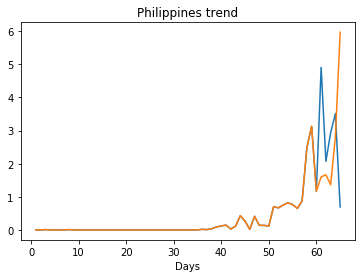

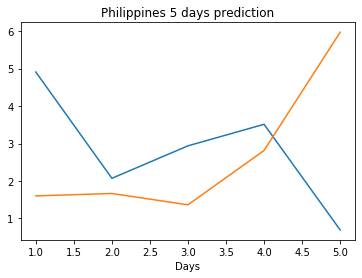

Creating directory ./offline6/Singapore/training/
Singapore
Saving the best model weights at Epoch [1], Best Valid Loss: 18.4853
Saving the best model weights at Epoch [2], Best Valid Loss: 10.4451


/space/home/nzhang/anaconda3/envs/neuralnet/lib/python3.7/site-packages/torch/nn/modules/loss.py:431: UserWarning: Using a target size (torch.Size([1, 1, 5])) that is different to the input size (torch.Size([5])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/space/home/nzhang/anaconda3/envs/neuralnet/lib/python3.7/site-packages/torch/nn/modules/loss.py:431: UserWarning: Using a target size (torch.Size([1, 5])) that is different to the input size (torch.Size([5])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Saving the best model weights at Epoch [6], Best Valid Loss: 10.1325
Saving the best model weights at Epoch [7], Best Valid Loss: 7.2305
Saving the best model weights at Epoch [10], Best Valid Loss: 6.0366
Saving the best model weights at Epoch [21], Best Valid Loss: 5.7517
Saving the best model weights at Epoch [38], Best Valid Loss: 5.4680
train error: 2.6114441540998383
5.4679765701293945
Saving the best model weights at Epoch [1], Best Valid Loss: 18.3399
Saving the best model weights at Epoch [2], Best Valid Loss: 18.1777
Saving the best model weights at Epoch [3], Best Valid Loss: 7.6927
Saving the best model weights at Epoch [8], Best Valid Loss: 6.6221
Saving the best model weights at Epoch [9], Best Valid Loss: 6.4502
Saving the best model weights at Epoch [16], Best Valid Loss: 5.3767
train error: 4.0810906552785156
5.376653671264648
Saving the best model weights at Epoch [1], Best Valid Loss: 31.3846
Saving the best model weights at Epoch [6], Best Valid Loss: 24.9560
Saving

Saving the best model weights at Epoch [10], Best Valid Loss: 6.5877
Saving the best model weights at Epoch [13], Best Valid Loss: 6.4676
Saving the best model weights at Epoch [15], Best Valid Loss: 5.5167
train error: 3.718868626734695
5.516739845275879
Saving the best model weights at Epoch [1], Best Valid Loss: 14.0814
Saving the best model weights at Epoch [9], Best Valid Loss: 3.8384
train error: 30.78604780661093
3.8384292125701904
Saving the best model weights at Epoch [1], Best Valid Loss: 38.6562
Saving the best model weights at Epoch [2], Best Valid Loss: 25.4929
Saving the best model weights at Epoch [6], Best Valid Loss: 10.2597
Saving the best model weights at Epoch [17], Best Valid Loss: 9.1544
Saving the best model weights at Epoch [23], Best Valid Loss: 9.0627
Saving the best model weights at Epoch [25], Best Valid Loss: 8.8103
Saving the best model weights at Epoch [26], Best Valid Loss: 6.7363
train error: 8.506383378763456
6.736344337463379
Saving the best model wei

Saving the best model weights at Epoch [45], Best Valid Loss: 16.9710
train error: 11.550727505941648
16.970956802368164
Saving the best model weights at Epoch [1], Best Valid Loss: 16.8059
Saving the best model weights at Epoch [3], Best Valid Loss: 14.1948
Saving the best model weights at Epoch [18], Best Valid Loss: 10.4498
train error: 16.738874275942106
10.44983959197998
Saving the best model weights at Epoch [1], Best Valid Loss: 33.5213
Saving the best model weights at Epoch [5], Best Valid Loss: 31.6053
Saving the best model weights at Epoch [13], Best Valid Loss: 21.7697
Saving the best model weights at Epoch [14], Best Valid Loss: 13.4787
Saving the best model weights at Epoch [29], Best Valid Loss: 8.6110
Saving the best model weights at Epoch [30], Best Valid Loss: 6.8153
Saving the best model weights at Epoch [33], Best Valid Loss: 6.7390
Saving the best model weights at Epoch [34], Best Valid Loss: 6.3367
Saving the best model weights at Epoch [35], Best Valid Loss: 6.191

Saving the best model weights at Epoch [4], Best Valid Loss: 30.0770
Saving the best model weights at Epoch [7], Best Valid Loss: 29.2190
Saving the best model weights at Epoch [11], Best Valid Loss: 23.8873
train error: 12.282912665122264
23.88732147216797
Saving the best model weights at Epoch [1], Best Valid Loss: 60.2827
Saving the best model weights at Epoch [2], Best Valid Loss: 13.1037
train error: 14.133976545688268
13.103723526000977
Saving the best model weights at Epoch [1], Best Valid Loss: 58.9726
Saving the best model weights at Epoch [2], Best Valid Loss: 41.5979
Saving the best model weights at Epoch [3], Best Valid Loss: 28.2141
Saving the best model weights at Epoch [4], Best Valid Loss: 20.7727
Saving the best model weights at Epoch [5], Best Valid Loss: 15.8396
Saving the best model weights at Epoch [6], Best Valid Loss: 12.4983
Saving the best model weights at Epoch [7], Best Valid Loss: 10.6373
Saving the best model weights at Epoch [8], Best Valid Loss: 9.3596
Sa

train error: 0.4433335783715184
4.847728252410889
Saving the best model weights at Epoch [1], Best Valid Loss: 7.2516
Saving the best model weights at Epoch [2], Best Valid Loss: 6.0874
Saving the best model weights at Epoch [43], Best Valid Loss: 6.0011
Saving the best model weights at Epoch [44], Best Valid Loss: 5.6575
train error: 0.27564552610085624
5.657472133636475
Saving the best model weights at Epoch [1], Best Valid Loss: 20.1885
Saving the best model weights at Epoch [2], Best Valid Loss: 4.2405
train error: 0.02209711934571985
4.240533351898193
Saving the best model weights at Epoch [1], Best Valid Loss: 68.4753
Saving the best model weights at Epoch [2], Best Valid Loss: 61.6655
Saving the best model weights at Epoch [3], Best Valid Loss: 55.9424
Saving the best model weights at Epoch [4], Best Valid Loss: 51.1210
Saving the best model weights at Epoch [5], Best Valid Loss: 47.0768
Saving the best model weights at Epoch [6], Best Valid Loss: 43.6879
Saving the best model w

Saving the best model weights at Epoch [6], Best Valid Loss: 6.4348
Saving the best model weights at Epoch [7], Best Valid Loss: 6.4171
Saving the best model weights at Epoch [8], Best Valid Loss: 5.9971
Saving the best model weights at Epoch [25], Best Valid Loss: 5.8329
train error: 1.3780661253510296
5.832868576049805
Saving the best model weights at Epoch [1], Best Valid Loss: 24.4541
Saving the best model weights at Epoch [2], Best Valid Loss: 6.4873
Saving the best model weights at Epoch [6], Best Valid Loss: 5.9142
Saving the best model weights at Epoch [17], Best Valid Loss: 5.6986
Saving the best model weights at Epoch [20], Best Valid Loss: 5.3749
Saving the best model weights at Epoch [21], Best Valid Loss: 5.3681
Saving the best model weights at Epoch [31], Best Valid Loss: 5.2602
Saving the best model weights at Epoch [35], Best Valid Loss: 4.5671
Saving the best model weights at Epoch [46], Best Valid Loss: 3.8645
train error: 1.265809411938126
3.8645286560058594
Saving t

Saving the best model weights at Epoch [12], Best Valid Loss: 22.1109
Saving the best model weights at Epoch [14], Best Valid Loss: 12.1531
Saving the best model weights at Epoch [17], Best Valid Loss: 11.7351
Saving the best model weights at Epoch [18], Best Valid Loss: 9.9273
Saving the best model weights at Epoch [19], Best Valid Loss: 8.9070
Saving the best model weights at Epoch [26], Best Valid Loss: 8.5091
Saving the best model weights at Epoch [27], Best Valid Loss: 7.8228
Saving the best model weights at Epoch [28], Best Valid Loss: 7.1203
Saving the best model weights at Epoch [30], Best Valid Loss: 6.5942
Saving the best model weights at Epoch [39], Best Valid Loss: 6.4166
train error: 3.03094316455158
6.4166436195373535
Saving the best model weights at Epoch [1], Best Valid Loss: 67.6442
Saving the best model weights at Epoch [2], Best Valid Loss: 60.8185
Saving the best model weights at Epoch [3], Best Valid Loss: 54.9641
Saving the best model weights at Epoch [4], Best Va

Saving the best model weights at Epoch [10], Best Valid Loss: 26.8374
Saving the best model weights at Epoch [11], Best Valid Loss: 19.5139
Saving the best model weights at Epoch [12], Best Valid Loss: 10.6259
Saving the best model weights at Epoch [13], Best Valid Loss: 7.5955
Saving the best model weights at Epoch [14], Best Valid Loss: 6.2607
Saving the best model weights at Epoch [15], Best Valid Loss: 6.1828
Saving the best model weights at Epoch [18], Best Valid Loss: 5.9992
train error: 1.679951390704593
5.999172210693359
Saving the best model weights at Epoch [1], Best Valid Loss: 40.3603
Saving the best model weights at Epoch [2], Best Valid Loss: 32.6475
Saving the best model weights at Epoch [3], Best Valid Loss: 30.6889
Saving the best model weights at Epoch [4], Best Valid Loss: 20.1799
Saving the best model weights at Epoch [5], Best Valid Loss: 7.0156
Saving the best model weights at Epoch [7], Best Valid Loss: 6.8704
Saving the best model weights at Epoch [8], Best Vali

Saving the best model weights at Epoch [4], Best Valid Loss: 51.8656
Saving the best model weights at Epoch [5], Best Valid Loss: 48.0387
Saving the best model weights at Epoch [6], Best Valid Loss: 44.9533
Saving the best model weights at Epoch [7], Best Valid Loss: 42.4576
Saving the best model weights at Epoch [8], Best Valid Loss: 40.4925
Saving the best model weights at Epoch [9], Best Valid Loss: 39.1159
Saving the best model weights at Epoch [10], Best Valid Loss: 37.9423
Saving the best model weights at Epoch [11], Best Valid Loss: 37.3629
Saving the best model weights at Epoch [12], Best Valid Loss: 36.5463
Saving the best model weights at Epoch [13], Best Valid Loss: 36.3431
Saving the best model weights at Epoch [14], Best Valid Loss: 35.9687
Saving the best model weights at Epoch [15], Best Valid Loss: 35.5333
Saving the best model weights at Epoch [16], Best Valid Loss: 35.2710
Saving the best model weights at Epoch [17], Best Valid Loss: 35.0195
Saving the best model weig

Saving the best model weights at Epoch [2], Best Valid Loss: 61.4559
Saving the best model weights at Epoch [3], Best Valid Loss: 55.8093
Saving the best model weights at Epoch [4], Best Valid Loss: 51.2703
Saving the best model weights at Epoch [5], Best Valid Loss: 47.3933
Saving the best model weights at Epoch [6], Best Valid Loss: 44.4057
Saving the best model weights at Epoch [7], Best Valid Loss: 41.9043
Saving the best model weights at Epoch [8], Best Valid Loss: 40.0718
Saving the best model weights at Epoch [9], Best Valid Loss: 38.9530
Saving the best model weights at Epoch [10], Best Valid Loss: 38.0823
Saving the best model weights at Epoch [11], Best Valid Loss: 36.9923
Saving the best model weights at Epoch [12], Best Valid Loss: 36.0144
Saving the best model weights at Epoch [13], Best Valid Loss: 35.3992
Saving the best model weights at Epoch [14], Best Valid Loss: 35.1270
Saving the best model weights at Epoch [15], Best Valid Loss: 34.8288
Saving the best model weight

Saving the best model weights at Epoch [10], Best Valid Loss: 37.6355
Saving the best model weights at Epoch [11], Best Valid Loss: 36.7776
Saving the best model weights at Epoch [12], Best Valid Loss: 36.4785
Saving the best model weights at Epoch [13], Best Valid Loss: 35.9769
Saving the best model weights at Epoch [14], Best Valid Loss: 35.6258
Saving the best model weights at Epoch [15], Best Valid Loss: 35.3503
Saving the best model weights at Epoch [16], Best Valid Loss: 35.1266
Saving the best model weights at Epoch [17], Best Valid Loss: 35.0253
Saving the best model weights at Epoch [18], Best Valid Loss: 34.8157
Saving the best model weights at Epoch [20], Best Valid Loss: 34.6594
Saving the best model weights at Epoch [39], Best Valid Loss: 34.5531
Saving the best model weights at Epoch [41], Best Valid Loss: 34.4744
Saving the best model weights at Epoch [42], Best Valid Loss: 34.4280
train error: 11.91935387334308
34.428009033203125
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [34], Best Valid Loss: 31.3939
train error: 12.295365037144842
31.3939208984375
Saving the best model weights at Epoch [1], Best Valid Loss: 76.3563
Saving the best model weights at Epoch [2], Best Valid Loss: 73.9566
Saving the best model weights at Epoch [3], Best Valid Loss: 70.9017
Saving the best model weights at Epoch [4], Best Valid Loss: 68.7813
Saving the best model weights at Epoch [5], Best Valid Loss: 66.9287
Saving the best model weights at Epoch [6], Best Valid Loss: 65.1077
Saving the best model weights at Epoch [7], Best Valid Loss: 63.2204
Saving the best model weights at Epoch [8], Best Valid Loss: 61.1819
Saving the best model weights at Epoch [9], Best Valid Loss: 58.9112
Saving the best model weights at Epoch [10], Best Valid Loss: 56.4739
Saving the best model weights at Epoch [11], Best Valid Loss: 54.0991
Saving the best model weights at Epoch [12], Best Valid Loss: 51.8028
Saving the best model weights at Epoch [13], Best 

Saving the best model weights at Epoch [18], Best Valid Loss: 6.5042
Saving the best model weights at Epoch [19], Best Valid Loss: 6.4994
Saving the best model weights at Epoch [20], Best Valid Loss: 6.2520
Saving the best model weights at Epoch [24], Best Valid Loss: 6.1948
Saving the best model weights at Epoch [27], Best Valid Loss: 6.0647
Saving the best model weights at Epoch [28], Best Valid Loss: 5.9831
Saving the best model weights at Epoch [29], Best Valid Loss: 5.8878
Saving the best model weights at Epoch [32], Best Valid Loss: 5.8755
Saving the best model weights at Epoch [37], Best Valid Loss: 5.8106
Saving the best model weights at Epoch [41], Best Valid Loss: 5.7617
Saving the best model weights at Epoch [42], Best Valid Loss: 5.7268
Saving the best model weights at Epoch [43], Best Valid Loss: 5.5543
Saving the best model weights at Epoch [44], Best Valid Loss: 5.4904
Saving the best model weights at Epoch [46], Best Valid Loss: 5.4886
Saving the best model weights at E

Saving the best model weights at Epoch [6], Best Valid Loss: 51.0357
Saving the best model weights at Epoch [7], Best Valid Loss: 46.2583
Saving the best model weights at Epoch [8], Best Valid Loss: 41.5824
Saving the best model weights at Epoch [9], Best Valid Loss: 37.2016
Saving the best model weights at Epoch [10], Best Valid Loss: 33.2175
Saving the best model weights at Epoch [11], Best Valid Loss: 29.6020
Saving the best model weights at Epoch [12], Best Valid Loss: 26.4281
Saving the best model weights at Epoch [13], Best Valid Loss: 23.6437
Saving the best model weights at Epoch [14], Best Valid Loss: 21.2337
Saving the best model weights at Epoch [15], Best Valid Loss: 19.1485
Saving the best model weights at Epoch [16], Best Valid Loss: 17.3510
Saving the best model weights at Epoch [17], Best Valid Loss: 15.7978
Saving the best model weights at Epoch [18], Best Valid Loss: 14.4667
Saving the best model weights at Epoch [19], Best Valid Loss: 13.2920
Saving the best model we

Saving the best model weights at Epoch [33], Best Valid Loss: 5.6404
train error: 0.4777045782554794
5.640387058258057
Saving the best model weights at Epoch [1], Best Valid Loss: 72.3432
Saving the best model weights at Epoch [2], Best Valid Loss: 71.5255
Saving the best model weights at Epoch [3], Best Valid Loss: 70.7283
Saving the best model weights at Epoch [4], Best Valid Loss: 69.9524
Saving the best model weights at Epoch [5], Best Valid Loss: 69.1872
Saving the best model weights at Epoch [6], Best Valid Loss: 68.4352
Saving the best model weights at Epoch [7], Best Valid Loss: 67.7034
Saving the best model weights at Epoch [8], Best Valid Loss: 66.9900
Saving the best model weights at Epoch [9], Best Valid Loss: 66.2820
Saving the best model weights at Epoch [10], Best Valid Loss: 65.5898
Saving the best model weights at Epoch [11], Best Valid Loss: 64.9130
Saving the best model weights at Epoch [12], Best Valid Loss: 64.2498
Saving the best model weights at Epoch [13], Best 

Saving the best model weights at Epoch [17], Best Valid Loss: 13.6749
Saving the best model weights at Epoch [18], Best Valid Loss: 12.1774
Saving the best model weights at Epoch [19], Best Valid Loss: 10.2387
Saving the best model weights at Epoch [20], Best Valid Loss: 9.2542
Saving the best model weights at Epoch [21], Best Valid Loss: 8.5236
Saving the best model weights at Epoch [22], Best Valid Loss: 8.0306
Saving the best model weights at Epoch [23], Best Valid Loss: 7.6249
Saving the best model weights at Epoch [24], Best Valid Loss: 7.2834
Saving the best model weights at Epoch [25], Best Valid Loss: 7.2250
Saving the best model weights at Epoch [26], Best Valid Loss: 7.0345
Saving the best model weights at Epoch [27], Best Valid Loss: 6.7716
Saving the best model weights at Epoch [31], Best Valid Loss: 6.6701
Saving the best model weights at Epoch [32], Best Valid Loss: 6.5886
Saving the best model weights at Epoch [33], Best Valid Loss: 6.4873
Saving the best model weights a

Saving the best model weights at Epoch [49], Best Valid Loss: 13.8233
Saving the best model weights at Epoch [50], Best Valid Loss: 13.0244
train error: 4.364114292570062
13.024371147155762
Saving the best model weights at Epoch [1], Best Valid Loss: 68.5714
Saving the best model weights at Epoch [2], Best Valid Loss: 62.4606
Saving the best model weights at Epoch [3], Best Valid Loss: 55.7378
Saving the best model weights at Epoch [4], Best Valid Loss: 50.7414
Saving the best model weights at Epoch [5], Best Valid Loss: 45.7535
Saving the best model weights at Epoch [6], Best Valid Loss: 39.8378
Saving the best model weights at Epoch [7], Best Valid Loss: 34.8670
Saving the best model weights at Epoch [8], Best Valid Loss: 30.0500
Saving the best model weights at Epoch [9], Best Valid Loss: 25.4027
Saving the best model weights at Epoch [10], Best Valid Loss: 18.9837
Saving the best model weights at Epoch [11], Best Valid Loss: 13.1810
Saving the best model weights at Epoch [12], Best

Saving the best model weights at Epoch [46], Best Valid Loss: 8.0584
Saving the best model weights at Epoch [47], Best Valid Loss: 7.6789
Saving the best model weights at Epoch [48], Best Valid Loss: 7.3636
Saving the best model weights at Epoch [49], Best Valid Loss: 7.1295
Saving the best model weights at Epoch [50], Best Valid Loss: 6.9564
train error: 2.386050030991838
6.956437587738037
Saving the best model weights at Epoch [1], Best Valid Loss: 69.7914
Saving the best model weights at Epoch [2], Best Valid Loss: 62.8577
Saving the best model weights at Epoch [3], Best Valid Loss: 54.7371
Saving the best model weights at Epoch [4], Best Valid Loss: 45.3382
Saving the best model weights at Epoch [5], Best Valid Loss: 37.6061
Saving the best model weights at Epoch [6], Best Valid Loss: 28.2890
Saving the best model weights at Epoch [7], Best Valid Loss: 20.3899
Saving the best model weights at Epoch [8], Best Valid Loss: 13.3727
Saving the best model weights at Epoch [9], Best Valid

Saving the best model weights at Epoch [8], Best Valid Loss: 6.3935
Saving the best model weights at Epoch [9], Best Valid Loss: 5.9507
train error: 1.5965684885914262
5.950657844543457
Saving the best model weights at Epoch [1], Best Valid Loss: 74.4056
Saving the best model weights at Epoch [2], Best Valid Loss: 73.5403
Saving the best model weights at Epoch [3], Best Valid Loss: 72.6953
Saving the best model weights at Epoch [4], Best Valid Loss: 71.8668
Saving the best model weights at Epoch [5], Best Valid Loss: 71.0545
Saving the best model weights at Epoch [6], Best Valid Loss: 70.2586
Saving the best model weights at Epoch [7], Best Valid Loss: 69.4804
Saving the best model weights at Epoch [8], Best Valid Loss: 68.7139
Saving the best model weights at Epoch [9], Best Valid Loss: 67.9685
Saving the best model weights at Epoch [10], Best Valid Loss: 67.2286
Saving the best model weights at Epoch [11], Best Valid Loss: 66.5053
Saving the best model weights at Epoch [12], Best Val

Saving the best model weights at Epoch [17], Best Valid Loss: 35.5671
Saving the best model weights at Epoch [18], Best Valid Loss: 35.4016
Saving the best model weights at Epoch [19], Best Valid Loss: 35.1931
Saving the best model weights at Epoch [20], Best Valid Loss: 34.8705
Saving the best model weights at Epoch [23], Best Valid Loss: 34.5622
Saving the best model weights at Epoch [26], Best Valid Loss: 34.4312
Saving the best model weights at Epoch [27], Best Valid Loss: 34.3189
Saving the best model weights at Epoch [28], Best Valid Loss: 34.1708
Saving the best model weights at Epoch [31], Best Valid Loss: 34.0109
Saving the best model weights at Epoch [34], Best Valid Loss: 33.9901
Saving the best model weights at Epoch [36], Best Valid Loss: 33.8797
Saving the best model weights at Epoch [38], Best Valid Loss: 33.3261
Saving the best model weights at Epoch [40], Best Valid Loss: 33.2085
Saving the best model weights at Epoch [42], Best Valid Loss: 33.1993
Saving the best mode

Saving the best model weights at Epoch [46], Best Valid Loss: 39.1930
Saving the best model weights at Epoch [47], Best Valid Loss: 38.9239
Saving the best model weights at Epoch [48], Best Valid Loss: 38.6698
Saving the best model weights at Epoch [49], Best Valid Loss: 38.3967
Saving the best model weights at Epoch [50], Best Valid Loss: 38.1529
train error: 11.919836669354826
38.152862548828125
Saving the best model weights at Epoch [1], Best Valid Loss: 69.6296
Saving the best model weights at Epoch [2], Best Valid Loss: 63.2558
Saving the best model weights at Epoch [3], Best Valid Loss: 57.6926
Saving the best model weights at Epoch [4], Best Valid Loss: 52.8940
Saving the best model weights at Epoch [5], Best Valid Loss: 48.8919
Saving the best model weights at Epoch [6], Best Valid Loss: 46.1855
Saving the best model weights at Epoch [7], Best Valid Loss: 43.0533
Saving the best model weights at Epoch [8], Best Valid Loss: 41.4194
Saving the best model weights at Epoch [9], Bes

Saving the best model weights at Epoch [24], Best Valid Loss: 49.8515
Saving the best model weights at Epoch [25], Best Valid Loss: 49.1343
Saving the best model weights at Epoch [26], Best Valid Loss: 48.4339
Saving the best model weights at Epoch [27], Best Valid Loss: 47.7255
Saving the best model weights at Epoch [28], Best Valid Loss: 47.0305
Saving the best model weights at Epoch [29], Best Valid Loss: 46.4378
Saving the best model weights at Epoch [30], Best Valid Loss: 45.8027
Saving the best model weights at Epoch [31], Best Valid Loss: 45.2278
Saving the best model weights at Epoch [32], Best Valid Loss: 44.6509
Saving the best model weights at Epoch [33], Best Valid Loss: 44.0995
Saving the best model weights at Epoch [34], Best Valid Loss: 43.6768
Saving the best model weights at Epoch [35], Best Valid Loss: 43.0720
Saving the best model weights at Epoch [36], Best Valid Loss: 42.6276
Saving the best model weights at Epoch [37], Best Valid Loss: 42.1638
Saving the best mode

Saving the best model weights at Epoch [12], Best Valid Loss: 60.3377
Saving the best model weights at Epoch [13], Best Valid Loss: 59.2383
Saving the best model weights at Epoch [14], Best Valid Loss: 58.2511
Saving the best model weights at Epoch [15], Best Valid Loss: 57.3071
Saving the best model weights at Epoch [16], Best Valid Loss: 56.3265
Saving the best model weights at Epoch [17], Best Valid Loss: 55.4232
Saving the best model weights at Epoch [18], Best Valid Loss: 54.5066
Saving the best model weights at Epoch [19], Best Valid Loss: 53.7094
Saving the best model weights at Epoch [20], Best Valid Loss: 52.8405
Saving the best model weights at Epoch [21], Best Valid Loss: 52.0262
Saving the best model weights at Epoch [22], Best Valid Loss: 51.2479
Saving the best model weights at Epoch [23], Best Valid Loss: 50.4236
Saving the best model weights at Epoch [24], Best Valid Loss: 49.6971
Saving the best model weights at Epoch [25], Best Valid Loss: 48.9388
Saving the best mode

Saving the best model weights at Epoch [4], Best Valid Loss: 71.6583
Saving the best model weights at Epoch [5], Best Valid Loss: 70.3364
Saving the best model weights at Epoch [6], Best Valid Loss: 68.8952
Saving the best model weights at Epoch [7], Best Valid Loss: 67.6079
Saving the best model weights at Epoch [8], Best Valid Loss: 66.3520
Saving the best model weights at Epoch [9], Best Valid Loss: 65.1039
Saving the best model weights at Epoch [10], Best Valid Loss: 63.9697
Saving the best model weights at Epoch [11], Best Valid Loss: 62.8688
Saving the best model weights at Epoch [12], Best Valid Loss: 61.6982
Saving the best model weights at Epoch [13], Best Valid Loss: 60.6609
Saving the best model weights at Epoch [14], Best Valid Loss: 59.5987
Saving the best model weights at Epoch [15], Best Valid Loss: 58.6510
Saving the best model weights at Epoch [16], Best Valid Loss: 57.6624
Saving the best model weights at Epoch [17], Best Valid Loss: 56.7863
Saving the best model weig

Saving the best model weights at Epoch [48], Best Valid Loss: 48.2397
Saving the best model weights at Epoch [49], Best Valid Loss: 47.8895
Saving the best model weights at Epoch [50], Best Valid Loss: 47.5402
train error: 13.095818102359772
47.540191650390625
Saving the best model weights at Epoch [1], Best Valid Loss: 73.8111
Saving the best model weights at Epoch [2], Best Valid Loss: 72.3042
Saving the best model weights at Epoch [3], Best Valid Loss: 70.8584
Saving the best model weights at Epoch [4], Best Valid Loss: 69.5392
Saving the best model weights at Epoch [5], Best Valid Loss: 68.1560
Saving the best model weights at Epoch [6], Best Valid Loss: 66.8531
Saving the best model weights at Epoch [7], Best Valid Loss: 65.6229
Saving the best model weights at Epoch [8], Best Valid Loss: 64.4339
Saving the best model weights at Epoch [9], Best Valid Loss: 63.2927
Saving the best model weights at Epoch [10], Best Valid Loss: 62.1383
Saving the best model weights at Epoch [11], Bes

Saving the best model weights at Epoch [46], Best Valid Loss: 49.3702
Saving the best model weights at Epoch [47], Best Valid Loss: 49.0048
Saving the best model weights at Epoch [48], Best Valid Loss: 48.6488
Saving the best model weights at Epoch [49], Best Valid Loss: 48.3043
Saving the best model weights at Epoch [50], Best Valid Loss: 47.9562
train error: 13.179417347585833
47.956233978271484
Saving the best model weights at Epoch [1], Best Valid Loss: 74.3166
Saving the best model weights at Epoch [2], Best Valid Loss: 72.7795
Saving the best model weights at Epoch [3], Best Valid Loss: 71.2956
Saving the best model weights at Epoch [4], Best Valid Loss: 69.9409
Saving the best model weights at Epoch [5], Best Valid Loss: 68.5701
Saving the best model weights at Epoch [6], Best Valid Loss: 67.2160
Saving the best model weights at Epoch [7], Best Valid Loss: 65.9658
Saving the best model weights at Epoch [8], Best Valid Loss: 64.7483
Saving the best model weights at Epoch [9], Bes

Saving the best model weights at Epoch [42], Best Valid Loss: 49.4248
Saving the best model weights at Epoch [43], Best Valid Loss: 49.0213
Saving the best model weights at Epoch [44], Best Valid Loss: 48.6294
Saving the best model weights at Epoch [45], Best Valid Loss: 48.2428
Saving the best model weights at Epoch [46], Best Valid Loss: 47.8682
Saving the best model weights at Epoch [47], Best Valid Loss: 47.4971
Saving the best model weights at Epoch [48], Best Valid Loss: 47.1335
Saving the best model weights at Epoch [49], Best Valid Loss: 46.7794
Saving the best model weights at Epoch [50], Best Valid Loss: 46.4308
train error: 12.925764768510252
46.4307861328125
Saving the best model weights at Epoch [1], Best Valid Loss: 74.7173
Saving the best model weights at Epoch [2], Best Valid Loss: 73.1062
Saving the best model weights at Epoch [3], Best Valid Loss: 71.6761
Saving the best model weights at Epoch [4], Best Valid Loss: 70.1666
Saving the best model weights at Epoch [5], B

Saving the best model weights at Epoch [40], Best Valid Loss: 52.2525
Saving the best model weights at Epoch [41], Best Valid Loss: 51.8523
Saving the best model weights at Epoch [42], Best Valid Loss: 51.4506
Saving the best model weights at Epoch [43], Best Valid Loss: 51.0577
Saving the best model weights at Epoch [44], Best Valid Loss: 50.6741
Saving the best model weights at Epoch [45], Best Valid Loss: 50.2977
Saving the best model weights at Epoch [46], Best Valid Loss: 49.9336
Saving the best model weights at Epoch [47], Best Valid Loss: 49.5719
Saving the best model weights at Epoch [48], Best Valid Loss: 49.2145
Saving the best model weights at Epoch [49], Best Valid Loss: 48.8729
Saving the best model weights at Epoch [50], Best Valid Loss: 48.5314
train error: 13.320100492722279
48.5313835144043
Saving the best model weights at Epoch [1], Best Valid Loss: 75.8684
Saving the best model weights at Epoch [2], Best Valid Loss: 74.2660
Saving the best model weights at Epoch [3],

Saving the best model weights at Epoch [34], Best Valid Loss: 54.6895
Saving the best model weights at Epoch [35], Best Valid Loss: 54.2310
Saving the best model weights at Epoch [36], Best Valid Loss: 53.7841
Saving the best model weights at Epoch [37], Best Valid Loss: 53.3441
Saving the best model weights at Epoch [38], Best Valid Loss: 52.9114
Saving the best model weights at Epoch [39], Best Valid Loss: 52.4857
Saving the best model weights at Epoch [40], Best Valid Loss: 52.0683
Saving the best model weights at Epoch [41], Best Valid Loss: 51.6589
Saving the best model weights at Epoch [42], Best Valid Loss: 51.2576
Saving the best model weights at Epoch [43], Best Valid Loss: 50.8671
Saving the best model weights at Epoch [44], Best Valid Loss: 50.4827
Saving the best model weights at Epoch [45], Best Valid Loss: 50.0979
Saving the best model weights at Epoch [46], Best Valid Loss: 49.7249
Saving the best model weights at Epoch [47], Best Valid Loss: 49.3643
Saving the best mode

Saving the best model weights at Epoch [30], Best Valid Loss: 55.5742
Saving the best model weights at Epoch [31], Best Valid Loss: 55.0583
Saving the best model weights at Epoch [32], Best Valid Loss: 54.5518
Saving the best model weights at Epoch [33], Best Valid Loss: 54.0554
Saving the best model weights at Epoch [34], Best Valid Loss: 53.5669
Saving the best model weights at Epoch [35], Best Valid Loss: 53.0885
Saving the best model weights at Epoch [36], Best Valid Loss: 52.6209
Saving the best model weights at Epoch [37], Best Valid Loss: 52.1605
Saving the best model weights at Epoch [38], Best Valid Loss: 51.7061
Saving the best model weights at Epoch [39], Best Valid Loss: 51.2630
Saving the best model weights at Epoch [40], Best Valid Loss: 50.8296
Saving the best model weights at Epoch [41], Best Valid Loss: 50.4044
Saving the best model weights at Epoch [42], Best Valid Loss: 49.9862
Saving the best model weights at Epoch [43], Best Valid Loss: 49.5806
Saving the best mode

Saving the best model weights at Epoch [28], Best Valid Loss: 56.6620
Saving the best model weights at Epoch [29], Best Valid Loss: 56.1600
Saving the best model weights at Epoch [30], Best Valid Loss: 55.6665
Saving the best model weights at Epoch [31], Best Valid Loss: 55.1735
Saving the best model weights at Epoch [32], Best Valid Loss: 54.7013
Saving the best model weights at Epoch [33], Best Valid Loss: 54.2342
Saving the best model weights at Epoch [34], Best Valid Loss: 53.7739
Saving the best model weights at Epoch [35], Best Valid Loss: 53.3161
Saving the best model weights at Epoch [36], Best Valid Loss: 52.8719
Saving the best model weights at Epoch [37], Best Valid Loss: 52.4357
Saving the best model weights at Epoch [38], Best Valid Loss: 52.0084
Saving the best model weights at Epoch [39], Best Valid Loss: 51.5873
Saving the best model weights at Epoch [40], Best Valid Loss: 51.1732
Saving the best model weights at Epoch [41], Best Valid Loss: 50.7719
Saving the best mode

Saving the best model weights at Epoch [28], Best Valid Loss: 65.9936
Saving the best model weights at Epoch [29], Best Valid Loss: 65.8252
Saving the best model weights at Epoch [30], Best Valid Loss: 65.6568
Saving the best model weights at Epoch [31], Best Valid Loss: 65.4885
Saving the best model weights at Epoch [32], Best Valid Loss: 65.3223
Saving the best model weights at Epoch [33], Best Valid Loss: 65.1515
Saving the best model weights at Epoch [34], Best Valid Loss: 64.9843
Saving the best model weights at Epoch [35], Best Valid Loss: 64.8156
Saving the best model weights at Epoch [36], Best Valid Loss: 64.6453
Saving the best model weights at Epoch [37], Best Valid Loss: 64.4765
Saving the best model weights at Epoch [38], Best Valid Loss: 64.3078
Saving the best model weights at Epoch [39], Best Valid Loss: 64.1386
Saving the best model weights at Epoch [40], Best Valid Loss: 63.9695
Saving the best model weights at Epoch [41], Best Valid Loss: 63.8007
Saving the best mode

Saving the best model weights at Epoch [45], Best Valid Loss: 31.8159
Saving the best model weights at Epoch [46], Best Valid Loss: 31.3137
Saving the best model weights at Epoch [47], Best Valid Loss: 30.6717
Saving the best model weights at Epoch [48], Best Valid Loss: 30.0052
Saving the best model weights at Epoch [49], Best Valid Loss: 29.2572
Saving the best model weights at Epoch [50], Best Valid Loss: 28.7234
train error: 8.02083806894921
28.72342300415039
Saving the best model weights at Epoch [1], Best Valid Loss: 74.5371
Saving the best model weights at Epoch [2], Best Valid Loss: 74.1749
Saving the best model weights at Epoch [3], Best Valid Loss: 73.8670
Saving the best model weights at Epoch [4], Best Valid Loss: 73.5875
Saving the best model weights at Epoch [5], Best Valid Loss: 73.3206
Saving the best model weights at Epoch [6], Best Valid Loss: 73.0601
Saving the best model weights at Epoch [7], Best Valid Loss: 72.8002
Saving the best model weights at Epoch [8], Best 

Saving the best model weights at Epoch [13], Best Valid Loss: 33.3297
Saving the best model weights at Epoch [14], Best Valid Loss: 30.9804
Saving the best model weights at Epoch [15], Best Valid Loss: 28.8707
Saving the best model weights at Epoch [16], Best Valid Loss: 26.8416
Saving the best model weights at Epoch [17], Best Valid Loss: 25.1776
Saving the best model weights at Epoch [18], Best Valid Loss: 23.5748
Saving the best model weights at Epoch [19], Best Valid Loss: 22.2137
Saving the best model weights at Epoch [20], Best Valid Loss: 20.9073
Saving the best model weights at Epoch [21], Best Valid Loss: 19.6723
Saving the best model weights at Epoch [22], Best Valid Loss: 18.4232
Saving the best model weights at Epoch [23], Best Valid Loss: 17.4888
Saving the best model weights at Epoch [24], Best Valid Loss: 16.5828
Saving the best model weights at Epoch [25], Best Valid Loss: 15.8859
Saving the best model weights at Epoch [26], Best Valid Loss: 14.9963
Saving the best mode

Saving the best model weights at Epoch [30], Best Valid Loss: 55.9584
Saving the best model weights at Epoch [31], Best Valid Loss: 55.1755
Saving the best model weights at Epoch [32], Best Valid Loss: 54.3245
Saving the best model weights at Epoch [33], Best Valid Loss: 53.5319
Saving the best model weights at Epoch [34], Best Valid Loss: 52.7355
Saving the best model weights at Epoch [35], Best Valid Loss: 51.9530
Saving the best model weights at Epoch [36], Best Valid Loss: 51.1462
Saving the best model weights at Epoch [37], Best Valid Loss: 50.3594
Saving the best model weights at Epoch [38], Best Valid Loss: 49.5384
Saving the best model weights at Epoch [39], Best Valid Loss: 48.7403
Saving the best model weights at Epoch [40], Best Valid Loss: 47.9709
Saving the best model weights at Epoch [41], Best Valid Loss: 47.1861
Saving the best model weights at Epoch [42], Best Valid Loss: 46.3601
Saving the best model weights at Epoch [43], Best Valid Loss: 45.5476
Saving the best mode

Saving the best model weights at Epoch [49], Best Valid Loss: 50.1549
Saving the best model weights at Epoch [50], Best Valid Loss: 49.5342
train error: 14.971914118608913
49.534236907958984
Saving the best model weights at Epoch [1], Best Valid Loss: 76.1247
Saving the best model weights at Epoch [2], Best Valid Loss: 75.0825
Saving the best model weights at Epoch [3], Best Valid Loss: 74.2134
Saving the best model weights at Epoch [4], Best Valid Loss: 73.2737
Saving the best model weights at Epoch [5], Best Valid Loss: 72.2889
Saving the best model weights at Epoch [6], Best Valid Loss: 71.3832
Saving the best model weights at Epoch [7], Best Valid Loss: 70.5048
Saving the best model weights at Epoch [8], Best Valid Loss: 69.5909
Saving the best model weights at Epoch [9], Best Valid Loss: 68.6908
Saving the best model weights at Epoch [10], Best Valid Loss: 67.8101
Saving the best model weights at Epoch [11], Best Valid Loss: 66.9122
Saving the best model weights at Epoch [12], Bes

Saving the best model weights at Epoch [42], Best Valid Loss: 73.8728
Saving the best model weights at Epoch [43], Best Valid Loss: 73.7868
Saving the best model weights at Epoch [44], Best Valid Loss: 73.7022
Saving the best model weights at Epoch [45], Best Valid Loss: 73.6165
Saving the best model weights at Epoch [46], Best Valid Loss: 73.5318
Saving the best model weights at Epoch [47], Best Valid Loss: 73.4480
Saving the best model weights at Epoch [48], Best Valid Loss: 73.3630
Saving the best model weights at Epoch [49], Best Valid Loss: 73.2788
Saving the best model weights at Epoch [50], Best Valid Loss: 73.1951
train error: 19.959356897988833
73.19509887695312
Saving the best model weights at Epoch [1], Best Valid Loss: 74.8691
Saving the best model weights at Epoch [2], Best Valid Loss: 74.7043
Saving the best model weights at Epoch [3], Best Valid Loss: 74.5441
Saving the best model weights at Epoch [4], Best Valid Loss: 74.3922
Saving the best model weights at Epoch [5], 

Saving the best model weights at Epoch [10], Best Valid Loss: 76.1774
Saving the best model weights at Epoch [11], Best Valid Loss: 76.0810
Saving the best model weights at Epoch [12], Best Valid Loss: 75.9846
Saving the best model weights at Epoch [13], Best Valid Loss: 75.8895
Saving the best model weights at Epoch [14], Best Valid Loss: 75.7942
Saving the best model weights at Epoch [15], Best Valid Loss: 75.6986
Saving the best model weights at Epoch [16], Best Valid Loss: 75.6040
Saving the best model weights at Epoch [17], Best Valid Loss: 75.5089
Saving the best model weights at Epoch [18], Best Valid Loss: 75.4143
Saving the best model weights at Epoch [19], Best Valid Loss: 75.3202
Saving the best model weights at Epoch [20], Best Valid Loss: 75.2261
Saving the best model weights at Epoch [21], Best Valid Loss: 75.1323
Saving the best model weights at Epoch [22], Best Valid Loss: 75.0386
Saving the best model weights at Epoch [23], Best Valid Loss: 74.9453
Saving the best mode

Saving the best model weights at Epoch [27], Best Valid Loss: 55.4884
Saving the best model weights at Epoch [28], Best Valid Loss: 54.7597
Saving the best model weights at Epoch [29], Best Valid Loss: 54.0169
Saving the best model weights at Epoch [30], Best Valid Loss: 53.4174
Saving the best model weights at Epoch [31], Best Valid Loss: 52.6210
Saving the best model weights at Epoch [32], Best Valid Loss: 51.8686
Saving the best model weights at Epoch [33], Best Valid Loss: 51.1122
Saving the best model weights at Epoch [34], Best Valid Loss: 50.5046
Saving the best model weights at Epoch [35], Best Valid Loss: 49.6993
Saving the best model weights at Epoch [36], Best Valid Loss: 49.0811
Saving the best model weights at Epoch [37], Best Valid Loss: 48.3231
Saving the best model weights at Epoch [38], Best Valid Loss: 47.5106
Saving the best model weights at Epoch [39], Best Valid Loss: 46.8907
Saving the best model weights at Epoch [40], Best Valid Loss: 46.2943
Saving the best mode

Saving the best model weights at Epoch [44], Best Valid Loss: 69.5134
Saving the best model weights at Epoch [45], Best Valid Loss: 69.3561
Saving the best model weights at Epoch [46], Best Valid Loss: 69.1925
Saving the best model weights at Epoch [47], Best Valid Loss: 69.0357
Saving the best model weights at Epoch [48], Best Valid Loss: 68.8755
Saving the best model weights at Epoch [49], Best Valid Loss: 68.7175
Saving the best model weights at Epoch [50], Best Valid Loss: 68.5588
train error: 18.52363989945199
68.55879211425781
Saving the best model weights at Epoch [1], Best Valid Loss: 75.3425
Saving the best model weights at Epoch [2], Best Valid Loss: 74.4959
Saving the best model weights at Epoch [3], Best Valid Loss: 73.6938
Saving the best model weights at Epoch [4], Best Valid Loss: 72.9144
Saving the best model weights at Epoch [5], Best Valid Loss: 72.0805
Saving the best model weights at Epoch [6], Best Valid Loss: 71.3394
Saving the best model weights at Epoch [7], Bes

Saving the best model weights at Epoch [11], Best Valid Loss: 73.8863
Saving the best model weights at Epoch [12], Best Valid Loss: 73.7132
Saving the best model weights at Epoch [13], Best Valid Loss: 73.5454
Saving the best model weights at Epoch [14], Best Valid Loss: 73.3789
Saving the best model weights at Epoch [15], Best Valid Loss: 73.1983
Saving the best model weights at Epoch [16], Best Valid Loss: 73.0232
Saving the best model weights at Epoch [17], Best Valid Loss: 72.8551
Saving the best model weights at Epoch [18], Best Valid Loss: 72.6812
Saving the best model weights at Epoch [19], Best Valid Loss: 72.5123
Saving the best model weights at Epoch [20], Best Valid Loss: 72.3417
Saving the best model weights at Epoch [21], Best Valid Loss: 72.1770
Saving the best model weights at Epoch [22], Best Valid Loss: 72.0018
Saving the best model weights at Epoch [23], Best Valid Loss: 71.8401
Saving the best model weights at Epoch [24], Best Valid Loss: 71.6710
Saving the best mode

Saving the best model weights at Epoch [27], Best Valid Loss: 75.5856
Saving the best model weights at Epoch [28], Best Valid Loss: 75.4986
Saving the best model weights at Epoch [29], Best Valid Loss: 75.4117
Saving the best model weights at Epoch [30], Best Valid Loss: 75.3257
Saving the best model weights at Epoch [31], Best Valid Loss: 75.2393
Saving the best model weights at Epoch [32], Best Valid Loss: 75.1526
Saving the best model weights at Epoch [33], Best Valid Loss: 75.0663
Saving the best model weights at Epoch [34], Best Valid Loss: 74.9804
Saving the best model weights at Epoch [35], Best Valid Loss: 74.8955
Saving the best model weights at Epoch [36], Best Valid Loss: 74.8094
Saving the best model weights at Epoch [37], Best Valid Loss: 74.7246
Saving the best model weights at Epoch [38], Best Valid Loss: 74.6391
Saving the best model weights at Epoch [39], Best Valid Loss: 74.5546
Saving the best model weights at Epoch [40], Best Valid Loss: 74.4694
Saving the best mode

Saving the best model weights at Epoch [44], Best Valid Loss: 52.7148
Saving the best model weights at Epoch [45], Best Valid Loss: 52.3576
Saving the best model weights at Epoch [46], Best Valid Loss: 52.0890
Saving the best model weights at Epoch [47], Best Valid Loss: 51.6717
Saving the best model weights at Epoch [48], Best Valid Loss: 51.3762
Saving the best model weights at Epoch [49], Best Valid Loss: 51.0145
Saving the best model weights at Epoch [50], Best Valid Loss: 50.6415
train error: 13.62942983330907
50.64147186279297
Saving the best model weights at Epoch [1], Best Valid Loss: 75.7626
Saving the best model weights at Epoch [2], Best Valid Loss: 75.6754
Saving the best model weights at Epoch [3], Best Valid Loss: 75.5892
Saving the best model weights at Epoch [4], Best Valid Loss: 75.5017
Saving the best model weights at Epoch [5], Best Valid Loss: 75.4159
Saving the best model weights at Epoch [6], Best Valid Loss: 75.3292
Saving the best model weights at Epoch [7], Bes

Saving the best model weights at Epoch [10], Best Valid Loss: 69.4695
Saving the best model weights at Epoch [11], Best Valid Loss: 68.7238
Saving the best model weights at Epoch [12], Best Valid Loss: 68.0766
Saving the best model weights at Epoch [13], Best Valid Loss: 67.3687
Saving the best model weights at Epoch [14], Best Valid Loss: 66.7374
Saving the best model weights at Epoch [15], Best Valid Loss: 66.1583
Saving the best model weights at Epoch [16], Best Valid Loss: 65.4517
Saving the best model weights at Epoch [17], Best Valid Loss: 64.7808
Saving the best model weights at Epoch [18], Best Valid Loss: 64.3252
Saving the best model weights at Epoch [19], Best Valid Loss: 63.6750
Saving the best model weights at Epoch [20], Best Valid Loss: 63.0360
Saving the best model weights at Epoch [21], Best Valid Loss: 62.4630
Saving the best model weights at Epoch [22], Best Valid Loss: 61.9344
Saving the best model weights at Epoch [23], Best Valid Loss: 61.3849
Saving the best mode

Saving the best model weights at Epoch [26], Best Valid Loss: 72.2447
Saving the best model weights at Epoch [27], Best Valid Loss: 72.0972
Saving the best model weights at Epoch [28], Best Valid Loss: 71.9527
Saving the best model weights at Epoch [29], Best Valid Loss: 71.8060
Saving the best model weights at Epoch [30], Best Valid Loss: 71.6674
Saving the best model weights at Epoch [31], Best Valid Loss: 71.5144
Saving the best model weights at Epoch [32], Best Valid Loss: 71.3739
Saving the best model weights at Epoch [33], Best Valid Loss: 71.2277
Saving the best model weights at Epoch [34], Best Valid Loss: 71.0830
Saving the best model weights at Epoch [35], Best Valid Loss: 70.9425
Saving the best model weights at Epoch [36], Best Valid Loss: 70.7991
Saving the best model weights at Epoch [37], Best Valid Loss: 70.6571
Saving the best model weights at Epoch [38], Best Valid Loss: 70.5183
Saving the best model weights at Epoch [39], Best Valid Loss: 70.3764
Saving the best mode

Saving the best model weights at Epoch [42], Best Valid Loss: 72.0964
Saving the best model weights at Epoch [43], Best Valid Loss: 72.0164
Saving the best model weights at Epoch [44], Best Valid Loss: 71.9351
Saving the best model weights at Epoch [45], Best Valid Loss: 71.8549
Saving the best model weights at Epoch [46], Best Valid Loss: 71.7744
Saving the best model weights at Epoch [47], Best Valid Loss: 71.6944
Saving the best model weights at Epoch [48], Best Valid Loss: 71.6144
Saving the best model weights at Epoch [49], Best Valid Loss: 71.5347
Saving the best model weights at Epoch [50], Best Valid Loss: 71.4554
train error: 19.510699419455754
71.45536804199219
Saving the best model weights at Epoch [1], Best Valid Loss: 75.0823
Saving the best model weights at Epoch [2], Best Valid Loss: 74.9235
Saving the best model weights at Epoch [3], Best Valid Loss: 74.7629
Saving the best model weights at Epoch [4], Best Valid Loss: 74.6062
Saving the best model weights at Epoch [5], 

Saving the best model weights at Epoch [8], Best Valid Loss: 74.7231
Saving the best model weights at Epoch [9], Best Valid Loss: 74.6335
Saving the best model weights at Epoch [10], Best Valid Loss: 74.5432
Saving the best model weights at Epoch [11], Best Valid Loss: 74.4534
Saving the best model weights at Epoch [12], Best Valid Loss: 74.3639
Saving the best model weights at Epoch [13], Best Valid Loss: 74.2749
Saving the best model weights at Epoch [14], Best Valid Loss: 74.1859
Saving the best model weights at Epoch [15], Best Valid Loss: 74.0968
Saving the best model weights at Epoch [16], Best Valid Loss: 74.0081
Saving the best model weights at Epoch [17], Best Valid Loss: 73.9198
Saving the best model weights at Epoch [18], Best Valid Loss: 73.8320
Saving the best model weights at Epoch [19], Best Valid Loss: 73.7434
Saving the best model weights at Epoch [20], Best Valid Loss: 73.6557
Saving the best model weights at Epoch [21], Best Valid Loss: 73.5686
Saving the best model 

Saving the best model weights at Epoch [24], Best Valid Loss: 60.4919
Saving the best model weights at Epoch [25], Best Valid Loss: 60.0244
Saving the best model weights at Epoch [26], Best Valid Loss: 59.5266
Saving the best model weights at Epoch [27], Best Valid Loss: 59.0765
Saving the best model weights at Epoch [28], Best Valid Loss: 58.6848
Saving the best model weights at Epoch [29], Best Valid Loss: 58.2536
Saving the best model weights at Epoch [30], Best Valid Loss: 57.7585
Saving the best model weights at Epoch [31], Best Valid Loss: 57.3841
Saving the best model weights at Epoch [32], Best Valid Loss: 56.9274
Saving the best model weights at Epoch [33], Best Valid Loss: 56.5483
Saving the best model weights at Epoch [34], Best Valid Loss: 56.0761
Saving the best model weights at Epoch [35], Best Valid Loss: 55.7336
Saving the best model weights at Epoch [36], Best Valid Loss: 55.3524
Saving the best model weights at Epoch [37], Best Valid Loss: 54.9332
Saving the best mode

Saving the best model weights at Epoch [40], Best Valid Loss: 69.9905
Saving the best model weights at Epoch [41], Best Valid Loss: 69.8477
Saving the best model weights at Epoch [42], Best Valid Loss: 69.7115
Saving the best model weights at Epoch [43], Best Valid Loss: 69.5709
Saving the best model weights at Epoch [44], Best Valid Loss: 69.4311
Saving the best model weights at Epoch [45], Best Valid Loss: 69.2955
Saving the best model weights at Epoch [46], Best Valid Loss: 69.1544
Saving the best model weights at Epoch [47], Best Valid Loss: 69.0215
Saving the best model weights at Epoch [48], Best Valid Loss: 68.8849
Saving the best model weights at Epoch [49], Best Valid Loss: 68.7539
Saving the best model weights at Epoch [50], Best Valid Loss: 68.6126
train error: 18.66963814662115
68.61258697509766
Saving the best model weights at Epoch [1], Best Valid Loss: 74.5916
Saving the best model weights at Epoch [2], Best Valid Loss: 73.7520
Saving the best model weights at Epoch [3],

Saving the best model weights at Epoch [6], Best Valid Loss: 74.4211
Saving the best model weights at Epoch [7], Best Valid Loss: 74.2716
Saving the best model weights at Epoch [8], Best Valid Loss: 74.1134
Saving the best model weights at Epoch [9], Best Valid Loss: 73.9626
Saving the best model weights at Epoch [10], Best Valid Loss: 73.8099
Saving the best model weights at Epoch [11], Best Valid Loss: 73.6570
Saving the best model weights at Epoch [12], Best Valid Loss: 73.5040
Saving the best model weights at Epoch [13], Best Valid Loss: 73.3486
Saving the best model weights at Epoch [14], Best Valid Loss: 73.2010
Saving the best model weights at Epoch [15], Best Valid Loss: 73.0484
Saving the best model weights at Epoch [16], Best Valid Loss: 72.8988
Saving the best model weights at Epoch [17], Best Valid Loss: 72.7489
Saving the best model weights at Epoch [18], Best Valid Loss: 72.6053
Saving the best model weights at Epoch [19], Best Valid Loss: 72.4567
Saving the best model we

Saving the best model weights at Epoch [22], Best Valid Loss: 74.1765
Saving the best model weights at Epoch [23], Best Valid Loss: 74.0890
Saving the best model weights at Epoch [24], Best Valid Loss: 74.0018
Saving the best model weights at Epoch [25], Best Valid Loss: 73.9149
Saving the best model weights at Epoch [26], Best Valid Loss: 73.8280
Saving the best model weights at Epoch [27], Best Valid Loss: 73.7414
Saving the best model weights at Epoch [28], Best Valid Loss: 73.6552
Saving the best model weights at Epoch [29], Best Valid Loss: 73.5689
Saving the best model weights at Epoch [30], Best Valid Loss: 73.4832
Saving the best model weights at Epoch [31], Best Valid Loss: 73.3970
Saving the best model weights at Epoch [32], Best Valid Loss: 73.3120
Saving the best model weights at Epoch [33], Best Valid Loss: 73.2259
Saving the best model weights at Epoch [34], Best Valid Loss: 73.1407
Saving the best model weights at Epoch [35], Best Valid Loss: 73.0558
Saving the best mode

Saving the best model weights at Epoch [38], Best Valid Loss: 53.6993
Saving the best model weights at Epoch [39], Best Valid Loss: 53.3077
Saving the best model weights at Epoch [40], Best Valid Loss: 52.8565
Saving the best model weights at Epoch [41], Best Valid Loss: 52.4053
Saving the best model weights at Epoch [42], Best Valid Loss: 52.0835
Saving the best model weights at Epoch [43], Best Valid Loss: 51.7033
Saving the best model weights at Epoch [44], Best Valid Loss: 51.2758
Saving the best model weights at Epoch [45], Best Valid Loss: 50.8721
Saving the best model weights at Epoch [46], Best Valid Loss: 50.4775
Saving the best model weights at Epoch [47], Best Valid Loss: 50.1042
Saving the best model weights at Epoch [48], Best Valid Loss: 49.6587
Saving the best model weights at Epoch [49], Best Valid Loss: 49.4704
Saving the best model weights at Epoch [50], Best Valid Loss: 49.0513
train error: 13.391266548955763
49.05134963989258
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [4], Best Valid Loss: 73.4855
Saving the best model weights at Epoch [5], Best Valid Loss: 72.6981
Saving the best model weights at Epoch [6], Best Valid Loss: 71.9925
Saving the best model weights at Epoch [7], Best Valid Loss: 71.2479
Saving the best model weights at Epoch [8], Best Valid Loss: 70.5829
Saving the best model weights at Epoch [9], Best Valid Loss: 69.8684
Saving the best model weights at Epoch [10], Best Valid Loss: 69.1104
Saving the best model weights at Epoch [11], Best Valid Loss: 68.4724
Saving the best model weights at Epoch [12], Best Valid Loss: 67.8322
Saving the best model weights at Epoch [13], Best Valid Loss: 67.1738
Saving the best model weights at Epoch [14], Best Valid Loss: 66.5272
Saving the best model weights at Epoch [15], Best Valid Loss: 65.9450
Saving the best model weights at Epoch [16], Best Valid Loss: 65.3194
Saving the best model weights at Epoch [17], Best Valid Loss: 64.6825
Saving the best model weig

Saving the best model weights at Epoch [20], Best Valid Loss: 72.4216
Saving the best model weights at Epoch [21], Best Valid Loss: 72.2746
Saving the best model weights at Epoch [22], Best Valid Loss: 72.1256
Saving the best model weights at Epoch [23], Best Valid Loss: 71.9868
Saving the best model weights at Epoch [24], Best Valid Loss: 71.8362
Saving the best model weights at Epoch [25], Best Valid Loss: 71.6944
Saving the best model weights at Epoch [26], Best Valid Loss: 71.5532
Saving the best model weights at Epoch [27], Best Valid Loss: 71.4081
Saving the best model weights at Epoch [28], Best Valid Loss: 71.2621
Saving the best model weights at Epoch [29], Best Valid Loss: 71.1213
Saving the best model weights at Epoch [30], Best Valid Loss: 70.9746
Saving the best model weights at Epoch [31], Best Valid Loss: 70.8388
Saving the best model weights at Epoch [32], Best Valid Loss: 70.6936
Saving the best model weights at Epoch [33], Best Valid Loss: 70.5529
Saving the best mode

Saving the best model weights at Epoch [36], Best Valid Loss: 72.6053
Saving the best model weights at Epoch [37], Best Valid Loss: 72.5215
Saving the best model weights at Epoch [38], Best Valid Loss: 72.4383
Saving the best model weights at Epoch [39], Best Valid Loss: 72.3555
Saving the best model weights at Epoch [40], Best Valid Loss: 72.2733
Saving the best model weights at Epoch [41], Best Valid Loss: 72.1902
Saving the best model weights at Epoch [42], Best Valid Loss: 72.1083
Saving the best model weights at Epoch [43], Best Valid Loss: 72.0254
Saving the best model weights at Epoch [44], Best Valid Loss: 71.9439
Saving the best model weights at Epoch [45], Best Valid Loss: 71.8615
Saving the best model weights at Epoch [46], Best Valid Loss: 71.7804
Saving the best model weights at Epoch [47], Best Valid Loss: 71.6984
Saving the best model weights at Epoch [48], Best Valid Loss: 71.6171
Saving the best model weights at Epoch [49], Best Valid Loss: 71.5360
Saving the best mode

Saving the best model weights at Epoch [2], Best Valid Loss: 76.6370
Saving the best model weights at Epoch [3], Best Valid Loss: 76.5443
Saving the best model weights at Epoch [4], Best Valid Loss: 76.4525
Saving the best model weights at Epoch [5], Best Valid Loss: 76.3598
Saving the best model weights at Epoch [6], Best Valid Loss: 76.2678
Saving the best model weights at Epoch [7], Best Valid Loss: 76.1768
Saving the best model weights at Epoch [8], Best Valid Loss: 76.0853
Saving the best model weights at Epoch [9], Best Valid Loss: 75.9933
Saving the best model weights at Epoch [10], Best Valid Loss: 75.9021
Saving the best model weights at Epoch [11], Best Valid Loss: 75.8111
Saving the best model weights at Epoch [12], Best Valid Loss: 75.7205
Saving the best model weights at Epoch [13], Best Valid Loss: 75.6304
Saving the best model weights at Epoch [14], Best Valid Loss: 75.5397
Saving the best model weights at Epoch [15], Best Valid Loss: 75.4497
Saving the best model weight

Saving the best model weights at Epoch [20], Best Valid Loss: 62.4933
Saving the best model weights at Epoch [21], Best Valid Loss: 62.0117
Saving the best model weights at Epoch [22], Best Valid Loss: 61.4481
Saving the best model weights at Epoch [23], Best Valid Loss: 60.9437
Saving the best model weights at Epoch [24], Best Valid Loss: 60.4411
Saving the best model weights at Epoch [25], Best Valid Loss: 59.8745
Saving the best model weights at Epoch [26], Best Valid Loss: 59.3701
Saving the best model weights at Epoch [27], Best Valid Loss: 58.8915
Saving the best model weights at Epoch [28], Best Valid Loss: 58.2990
Saving the best model weights at Epoch [29], Best Valid Loss: 57.8304
Saving the best model weights at Epoch [30], Best Valid Loss: 57.3613
Saving the best model weights at Epoch [31], Best Valid Loss: 56.9141
Saving the best model weights at Epoch [32], Best Valid Loss: 56.3986
Saving the best model weights at Epoch [33], Best Valid Loss: 55.9280
Saving the best mode

Saving the best model weights at Epoch [37], Best Valid Loss: 73.8285
Saving the best model weights at Epoch [38], Best Valid Loss: 73.8142
Saving the best model weights at Epoch [39], Best Valid Loss: 73.7993
Saving the best model weights at Epoch [40], Best Valid Loss: 73.7844
Saving the best model weights at Epoch [41], Best Valid Loss: 73.7699
Saving the best model weights at Epoch [42], Best Valid Loss: 73.7557
Saving the best model weights at Epoch [43], Best Valid Loss: 73.7410
Saving the best model weights at Epoch [44], Best Valid Loss: 73.7262
Saving the best model weights at Epoch [45], Best Valid Loss: 73.7116
Saving the best model weights at Epoch [46], Best Valid Loss: 73.6972
Saving the best model weights at Epoch [47], Best Valid Loss: 73.6823
Saving the best model weights at Epoch [48], Best Valid Loss: 73.6675
Saving the best model weights at Epoch [49], Best Valid Loss: 73.6533
Saving the best model weights at Epoch [50], Best Valid Loss: 73.6391
train error: 20.2131

Saving the best model weights at Epoch [4], Best Valid Loss: 76.0893
Saving the best model weights at Epoch [5], Best Valid Loss: 76.0211
Saving the best model weights at Epoch [6], Best Valid Loss: 75.9540
Saving the best model weights at Epoch [7], Best Valid Loss: 75.8896
Saving the best model weights at Epoch [8], Best Valid Loss: 75.8238
Saving the best model weights at Epoch [9], Best Valid Loss: 75.7561
Saving the best model weights at Epoch [10], Best Valid Loss: 75.6898
Saving the best model weights at Epoch [11], Best Valid Loss: 75.6272
Saving the best model weights at Epoch [12], Best Valid Loss: 75.5572
Saving the best model weights at Epoch [13], Best Valid Loss: 75.4962
Saving the best model weights at Epoch [14], Best Valid Loss: 75.4274
Saving the best model weights at Epoch [15], Best Valid Loss: 75.3630
Saving the best model weights at Epoch [16], Best Valid Loss: 75.2975
Saving the best model weights at Epoch [17], Best Valid Loss: 75.2322
Saving the best model weig

Saving the best model weights at Epoch [21], Best Valid Loss: 74.2579
Saving the best model weights at Epoch [22], Best Valid Loss: 74.2208
Saving the best model weights at Epoch [23], Best Valid Loss: 74.1838
Saving the best model weights at Epoch [24], Best Valid Loss: 74.1465
Saving the best model weights at Epoch [25], Best Valid Loss: 74.1094
Saving the best model weights at Epoch [26], Best Valid Loss: 74.0723
Saving the best model weights at Epoch [27], Best Valid Loss: 74.0357
Saving the best model weights at Epoch [28], Best Valid Loss: 73.9981
Saving the best model weights at Epoch [29], Best Valid Loss: 73.9612
Saving the best model weights at Epoch [30], Best Valid Loss: 73.9243
Saving the best model weights at Epoch [31], Best Valid Loss: 73.8868
Saving the best model weights at Epoch [32], Best Valid Loss: 73.8502
Saving the best model weights at Epoch [33], Best Valid Loss: 73.8127
Saving the best model weights at Epoch [34], Best Valid Loss: 73.7757
Saving the best mode

Saving the best model weights at Epoch [38], Best Valid Loss: 61.3697
Saving the best model weights at Epoch [39], Best Valid Loss: 61.0341
Saving the best model weights at Epoch [40], Best Valid Loss: 60.7134
Saving the best model weights at Epoch [41], Best Valid Loss: 60.2873
Saving the best model weights at Epoch [42], Best Valid Loss: 59.9149
Saving the best model weights at Epoch [43], Best Valid Loss: 59.5098
Saving the best model weights at Epoch [44], Best Valid Loss: 59.1962
Saving the best model weights at Epoch [45], Best Valid Loss: 58.7881
Saving the best model weights at Epoch [46], Best Valid Loss: 58.3875
Saving the best model weights at Epoch [47], Best Valid Loss: 58.0788
Saving the best model weights at Epoch [48], Best Valid Loss: 57.6867
Saving the best model weights at Epoch [49], Best Valid Loss: 57.2684
Saving the best model weights at Epoch [50], Best Valid Loss: 56.8432
train error: 16.371089925033015
56.84320068359375
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [5], Best Valid Loss: 74.7577
Saving the best model weights at Epoch [6], Best Valid Loss: 74.2858
Saving the best model weights at Epoch [7], Best Valid Loss: 73.8842
Saving the best model weights at Epoch [8], Best Valid Loss: 73.4185
Saving the best model weights at Epoch [9], Best Valid Loss: 72.8906
Saving the best model weights at Epoch [10], Best Valid Loss: 72.4381
Saving the best model weights at Epoch [11], Best Valid Loss: 71.9880
Saving the best model weights at Epoch [12], Best Valid Loss: 71.5805
Saving the best model weights at Epoch [13], Best Valid Loss: 71.1256
Saving the best model weights at Epoch [14], Best Valid Loss: 70.7448
Saving the best model weights at Epoch [15], Best Valid Loss: 70.3376
Saving the best model weights at Epoch [16], Best Valid Loss: 69.9255
Saving the best model weights at Epoch [17], Best Valid Loss: 69.5253
Saving the best model weights at Epoch [18], Best Valid Loss: 69.1870
Saving the best model wei

Saving the best model weights at Epoch [22], Best Valid Loss: 75.8453
Saving the best model weights at Epoch [23], Best Valid Loss: 75.8287
Saving the best model weights at Epoch [24], Best Valid Loss: 75.8122
Saving the best model weights at Epoch [25], Best Valid Loss: 75.7959
Saving the best model weights at Epoch [26], Best Valid Loss: 75.7795
Saving the best model weights at Epoch [27], Best Valid Loss: 75.7628
Saving the best model weights at Epoch [28], Best Valid Loss: 75.7465
Saving the best model weights at Epoch [29], Best Valid Loss: 75.7302
Saving the best model weights at Epoch [30], Best Valid Loss: 75.7138
Saving the best model weights at Epoch [31], Best Valid Loss: 75.6970
Saving the best model weights at Epoch [32], Best Valid Loss: 75.6811
Saving the best model weights at Epoch [33], Best Valid Loss: 75.6643
Saving the best model weights at Epoch [34], Best Valid Loss: 75.6482
Saving the best model weights at Epoch [35], Best Valid Loss: 75.6319
Saving the best mode

Saving the best model weights at Epoch [39], Best Valid Loss: 77.1210
Saving the best model weights at Epoch [40], Best Valid Loss: 77.1113
Saving the best model weights at Epoch [41], Best Valid Loss: 77.1016
Saving the best model weights at Epoch [42], Best Valid Loss: 77.0920
Saving the best model weights at Epoch [43], Best Valid Loss: 77.0823
Saving the best model weights at Epoch [44], Best Valid Loss: 77.0727
Saving the best model weights at Epoch [45], Best Valid Loss: 77.0630
Saving the best model weights at Epoch [46], Best Valid Loss: 77.0534
Saving the best model weights at Epoch [47], Best Valid Loss: 77.0438
Saving the best model weights at Epoch [48], Best Valid Loss: 77.0341
Saving the best model weights at Epoch [49], Best Valid Loss: 77.0245
Saving the best model weights at Epoch [50], Best Valid Loss: 77.0148
train error: 21.485926097913367
77.01482391357422
Saving the best model weights at Epoch [1], Best Valid Loss: 76.4971
Saving the best model weights at Epoch [2

Saving the best model weights at Epoch [6], Best Valid Loss: 76.2762
Saving the best model weights at Epoch [7], Best Valid Loss: 76.2662
Saving the best model weights at Epoch [8], Best Valid Loss: 76.2561
Saving the best model weights at Epoch [9], Best Valid Loss: 76.2461
Saving the best model weights at Epoch [10], Best Valid Loss: 76.2361
Saving the best model weights at Epoch [11], Best Valid Loss: 76.2260
Saving the best model weights at Epoch [12], Best Valid Loss: 76.2160
Saving the best model weights at Epoch [13], Best Valid Loss: 76.2060
Saving the best model weights at Epoch [14], Best Valid Loss: 76.1960
Saving the best model weights at Epoch [15], Best Valid Loss: 76.1860
Saving the best model weights at Epoch [16], Best Valid Loss: 76.1759
Saving the best model weights at Epoch [17], Best Valid Loss: 76.1659
Saving the best model weights at Epoch [18], Best Valid Loss: 76.1559
Saving the best model weights at Epoch [19], Best Valid Loss: 76.1460
Saving the best model we

Saving the best model weights at Epoch [23], Best Valid Loss: 73.4647
Saving the best model weights at Epoch [24], Best Valid Loss: 73.3865
Saving the best model weights at Epoch [25], Best Valid Loss: 73.3104
Saving the best model weights at Epoch [26], Best Valid Loss: 73.2245
Saving the best model weights at Epoch [27], Best Valid Loss: 73.1413
Saving the best model weights at Epoch [28], Best Valid Loss: 73.0703
Saving the best model weights at Epoch [29], Best Valid Loss: 72.9860
Saving the best model weights at Epoch [30], Best Valid Loss: 72.9090
Saving the best model weights at Epoch [31], Best Valid Loss: 72.8322
Saving the best model weights at Epoch [32], Best Valid Loss: 72.7433
Saving the best model weights at Epoch [33], Best Valid Loss: 72.6627
Saving the best model weights at Epoch [34], Best Valid Loss: 72.5916
Saving the best model weights at Epoch [35], Best Valid Loss: 72.5051
Saving the best model weights at Epoch [36], Best Valid Loss: 72.4220
Saving the best mode

Saving the best model weights at Epoch [40], Best Valid Loss: 75.1781
Saving the best model weights at Epoch [41], Best Valid Loss: 75.1589
Saving the best model weights at Epoch [42], Best Valid Loss: 75.1417
Saving the best model weights at Epoch [43], Best Valid Loss: 75.1224
Saving the best model weights at Epoch [44], Best Valid Loss: 75.1042
Saving the best model weights at Epoch [45], Best Valid Loss: 75.0854
Saving the best model weights at Epoch [46], Best Valid Loss: 75.0680
Saving the best model weights at Epoch [47], Best Valid Loss: 75.0486
Saving the best model weights at Epoch [48], Best Valid Loss: 75.0308
Saving the best model weights at Epoch [49], Best Valid Loss: 75.0119
Saving the best model weights at Epoch [50], Best Valid Loss: 74.9942
train error: 20.819791903064864
74.9941635131836
Saving the best model weights at Epoch [1], Best Valid Loss: 76.2629
Saving the best model weights at Epoch [2], Best Valid Loss: 76.1730
Saving the best model weights at Epoch [3],

Saving the best model weights at Epoch [6], Best Valid Loss: 76.2096
Saving the best model weights at Epoch [7], Best Valid Loss: 76.1934
Saving the best model weights at Epoch [8], Best Valid Loss: 76.1769
Saving the best model weights at Epoch [9], Best Valid Loss: 76.1606
Saving the best model weights at Epoch [10], Best Valid Loss: 76.1444
Saving the best model weights at Epoch [11], Best Valid Loss: 76.1285
Saving the best model weights at Epoch [12], Best Valid Loss: 76.1122
Saving the best model weights at Epoch [13], Best Valid Loss: 76.0961
Saving the best model weights at Epoch [14], Best Valid Loss: 76.0799
Saving the best model weights at Epoch [15], Best Valid Loss: 76.0637
Saving the best model weights at Epoch [16], Best Valid Loss: 76.0483
Saving the best model weights at Epoch [17], Best Valid Loss: 76.0316
Saving the best model weights at Epoch [18], Best Valid Loss: 76.0154
Saving the best model weights at Epoch [19], Best Valid Loss: 75.9999
Saving the best model we

Saving the best model weights at Epoch [23], Best Valid Loss: 76.3213
Saving the best model weights at Epoch [24], Best Valid Loss: 76.3122
Saving the best model weights at Epoch [25], Best Valid Loss: 76.3031
Saving the best model weights at Epoch [26], Best Valid Loss: 76.2940
Saving the best model weights at Epoch [27], Best Valid Loss: 76.2849
Saving the best model weights at Epoch [28], Best Valid Loss: 76.2758
Saving the best model weights at Epoch [29], Best Valid Loss: 76.2667
Saving the best model weights at Epoch [30], Best Valid Loss: 76.2576
Saving the best model weights at Epoch [31], Best Valid Loss: 76.2485
Saving the best model weights at Epoch [32], Best Valid Loss: 76.2394
Saving the best model weights at Epoch [33], Best Valid Loss: 76.2304
Saving the best model weights at Epoch [34], Best Valid Loss: 76.2212
Saving the best model weights at Epoch [35], Best Valid Loss: 76.2122
Saving the best model weights at Epoch [36], Best Valid Loss: 76.2030
Saving the best mode

Saving the best model weights at Epoch [39], Best Valid Loss: 72.9059
Saving the best model weights at Epoch [40], Best Valid Loss: 72.8330
Saving the best model weights at Epoch [41], Best Valid Loss: 72.7547
Saving the best model weights at Epoch [42], Best Valid Loss: 72.6864
Saving the best model weights at Epoch [43], Best Valid Loss: 72.6130
Saving the best model weights at Epoch [44], Best Valid Loss: 72.5361
Saving the best model weights at Epoch [45], Best Valid Loss: 72.4671
Saving the best model weights at Epoch [46], Best Valid Loss: 72.3899
Saving the best model weights at Epoch [47], Best Valid Loss: 72.3202
Saving the best model weights at Epoch [48], Best Valid Loss: 72.2493
Saving the best model weights at Epoch [49], Best Valid Loss: 72.1762
Saving the best model weights at Epoch [50], Best Valid Loss: 72.1034
train error: 19.925004770727575
72.10343933105469
Saving the best model weights at Epoch [1], Best Valid Loss: 76.4742
Saving the best model weights at Epoch [2

Saving the best model weights at Epoch [5], Best Valid Loss: 76.0706
Saving the best model weights at Epoch [6], Best Valid Loss: 75.9868
Saving the best model weights at Epoch [7], Best Valid Loss: 75.9079
Saving the best model weights at Epoch [8], Best Valid Loss: 75.8224
Saving the best model weights at Epoch [9], Best Valid Loss: 75.7453
Saving the best model weights at Epoch [10], Best Valid Loss: 75.6609
Saving the best model weights at Epoch [11], Best Valid Loss: 75.5763
Saving the best model weights at Epoch [12], Best Valid Loss: 75.4987
Saving the best model weights at Epoch [13], Best Valid Loss: 75.4180
Saving the best model weights at Epoch [14], Best Valid Loss: 75.3349
Saving the best model weights at Epoch [15], Best Valid Loss: 75.2588
Saving the best model weights at Epoch [16], Best Valid Loss: 75.1715
Saving the best model weights at Epoch [17], Best Valid Loss: 75.0908
Saving the best model weights at Epoch [18], Best Valid Loss: 75.0112
Saving the best model wei

Saving the best model weights at Epoch [22], Best Valid Loss: 75.2063
Saving the best model weights at Epoch [23], Best Valid Loss: 75.1900
Saving the best model weights at Epoch [24], Best Valid Loss: 75.1741
Saving the best model weights at Epoch [25], Best Valid Loss: 75.1581
Saving the best model weights at Epoch [26], Best Valid Loss: 75.1422
Saving the best model weights at Epoch [27], Best Valid Loss: 75.1266
Saving the best model weights at Epoch [28], Best Valid Loss: 75.1101
Saving the best model weights at Epoch [29], Best Valid Loss: 75.0941
Saving the best model weights at Epoch [30], Best Valid Loss: 75.0779
Saving the best model weights at Epoch [31], Best Valid Loss: 75.0619
Saving the best model weights at Epoch [32], Best Valid Loss: 75.0460
Saving the best model weights at Epoch [33], Best Valid Loss: 75.0304
Saving the best model weights at Epoch [34], Best Valid Loss: 75.0141
Saving the best model weights at Epoch [35], Best Valid Loss: 74.9984
Saving the best mode

Saving the best model weights at Epoch [38], Best Valid Loss: 76.2924
Saving the best model weights at Epoch [39], Best Valid Loss: 76.2833
Saving the best model weights at Epoch [40], Best Valid Loss: 76.2743
Saving the best model weights at Epoch [41], Best Valid Loss: 76.2652
Saving the best model weights at Epoch [42], Best Valid Loss: 76.2562
Saving the best model weights at Epoch [43], Best Valid Loss: 76.2471
Saving the best model weights at Epoch [44], Best Valid Loss: 76.2381
Saving the best model weights at Epoch [45], Best Valid Loss: 76.2291
Saving the best model weights at Epoch [46], Best Valid Loss: 76.2201
Saving the best model weights at Epoch [47], Best Valid Loss: 76.2110
Saving the best model weights at Epoch [48], Best Valid Loss: 76.2021
Saving the best model weights at Epoch [49], Best Valid Loss: 76.1930
Saving the best model weights at Epoch [50], Best Valid Loss: 76.1839
train error: 21.10060762593875
76.1839370727539
Saving the best model weights at Epoch [1]

Saving the best model weights at Epoch [4], Best Valid Loss: 75.5570
Saving the best model weights at Epoch [5], Best Valid Loss: 75.5481
Saving the best model weights at Epoch [6], Best Valid Loss: 75.5392
Saving the best model weights at Epoch [7], Best Valid Loss: 75.5303
Saving the best model weights at Epoch [8], Best Valid Loss: 75.5214
Saving the best model weights at Epoch [9], Best Valid Loss: 75.5126
Saving the best model weights at Epoch [10], Best Valid Loss: 75.5037
Saving the best model weights at Epoch [11], Best Valid Loss: 75.4948
Saving the best model weights at Epoch [12], Best Valid Loss: 75.4859
Saving the best model weights at Epoch [13], Best Valid Loss: 75.4770
Saving the best model weights at Epoch [14], Best Valid Loss: 75.4681
Saving the best model weights at Epoch [15], Best Valid Loss: 75.4593
Saving the best model weights at Epoch [16], Best Valid Loss: 75.4504
Saving the best model weights at Epoch [17], Best Valid Loss: 75.4415
Saving the best model weig

Saving the best model weights at Epoch [20], Best Valid Loss: 75.2201
Saving the best model weights at Epoch [21], Best Valid Loss: 75.1338
Saving the best model weights at Epoch [22], Best Valid Loss: 75.0627
Saving the best model weights at Epoch [23], Best Valid Loss: 74.9787
Saving the best model weights at Epoch [24], Best Valid Loss: 74.9001
Saving the best model weights at Epoch [25], Best Valid Loss: 74.8256
Saving the best model weights at Epoch [26], Best Valid Loss: 74.7375
Saving the best model weights at Epoch [27], Best Valid Loss: 74.6672
Saving the best model weights at Epoch [28], Best Valid Loss: 74.5894
Saving the best model weights at Epoch [29], Best Valid Loss: 74.5151
Saving the best model weights at Epoch [30], Best Valid Loss: 74.4325
Saving the best model weights at Epoch [31], Best Valid Loss: 74.3555
Saving the best model weights at Epoch [32], Best Valid Loss: 74.2777
Saving the best model weights at Epoch [33], Best Valid Loss: 74.1981
Saving the best mode

Saving the best model weights at Epoch [36], Best Valid Loss: 75.3553
Saving the best model weights at Epoch [37], Best Valid Loss: 75.3391
Saving the best model weights at Epoch [38], Best Valid Loss: 75.3232
Saving the best model weights at Epoch [39], Best Valid Loss: 75.3067
Saving the best model weights at Epoch [40], Best Valid Loss: 75.2914
Saving the best model weights at Epoch [41], Best Valid Loss: 75.2750
Saving the best model weights at Epoch [42], Best Valid Loss: 75.2589
Saving the best model weights at Epoch [43], Best Valid Loss: 75.2422
Saving the best model weights at Epoch [44], Best Valid Loss: 75.2262
Saving the best model weights at Epoch [45], Best Valid Loss: 75.2101
Saving the best model weights at Epoch [46], Best Valid Loss: 75.1938
Saving the best model weights at Epoch [47], Best Valid Loss: 75.1776
Saving the best model weights at Epoch [48], Best Valid Loss: 75.1623
Saving the best model weights at Epoch [49], Best Valid Loss: 75.1457
Saving the best mode

Saving the best model weights at Epoch [2], Best Valid Loss: 75.2339
Saving the best model weights at Epoch [3], Best Valid Loss: 75.2179
Saving the best model weights at Epoch [4], Best Valid Loss: 75.2024
Saving the best model weights at Epoch [5], Best Valid Loss: 75.1866
Saving the best model weights at Epoch [6], Best Valid Loss: 75.1704
Saving the best model weights at Epoch [7], Best Valid Loss: 75.1546
Saving the best model weights at Epoch [8], Best Valid Loss: 75.1386
Saving the best model weights at Epoch [9], Best Valid Loss: 75.1226
Saving the best model weights at Epoch [10], Best Valid Loss: 75.1074
Saving the best model weights at Epoch [11], Best Valid Loss: 75.0911
Saving the best model weights at Epoch [12], Best Valid Loss: 75.0752
Saving the best model weights at Epoch [13], Best Valid Loss: 75.0595
Saving the best model weights at Epoch [14], Best Valid Loss: 75.0440
Saving the best model weights at Epoch [15], Best Valid Loss: 75.0286
Saving the best model weight

Saving the best model weights at Epoch [20], Best Valid Loss: 77.5463
Saving the best model weights at Epoch [21], Best Valid Loss: 77.5365
Saving the best model weights at Epoch [22], Best Valid Loss: 77.5268
Saving the best model weights at Epoch [23], Best Valid Loss: 77.5170
Saving the best model weights at Epoch [24], Best Valid Loss: 77.5073
Saving the best model weights at Epoch [25], Best Valid Loss: 77.4976
Saving the best model weights at Epoch [26], Best Valid Loss: 77.4878
Saving the best model weights at Epoch [27], Best Valid Loss: 77.4781
Saving the best model weights at Epoch [28], Best Valid Loss: 77.4683
Saving the best model weights at Epoch [29], Best Valid Loss: 77.4587
Saving the best model weights at Epoch [30], Best Valid Loss: 77.4489
Saving the best model weights at Epoch [31], Best Valid Loss: 77.4392
Saving the best model weights at Epoch [32], Best Valid Loss: 77.4294
Saving the best model weights at Epoch [33], Best Valid Loss: 77.4197
Saving the best mode

Saving the best model weights at Epoch [36], Best Valid Loss: 71.8945
Saving the best model weights at Epoch [37], Best Valid Loss: 71.8164
Saving the best model weights at Epoch [38], Best Valid Loss: 71.7400
Saving the best model weights at Epoch [39], Best Valid Loss: 71.6656
Saving the best model weights at Epoch [40], Best Valid Loss: 71.5922
Saving the best model weights at Epoch [41], Best Valid Loss: 71.5186
Saving the best model weights at Epoch [42], Best Valid Loss: 71.4499
Saving the best model weights at Epoch [43], Best Valid Loss: 71.3760
Saving the best model weights at Epoch [44], Best Valid Loss: 71.2999
Saving the best model weights at Epoch [45], Best Valid Loss: 71.2321
Saving the best model weights at Epoch [46], Best Valid Loss: 71.1583
Saving the best model weights at Epoch [47], Best Valid Loss: 71.0842
Saving the best model weights at Epoch [48], Best Valid Loss: 71.0126
Saving the best model weights at Epoch [49], Best Valid Loss: 70.9399
Saving the best mode

Saving the best model weights at Epoch [2], Best Valid Loss: 75.5532
Saving the best model weights at Epoch [3], Best Valid Loss: 75.4799
Saving the best model weights at Epoch [4], Best Valid Loss: 75.4013
Saving the best model weights at Epoch [5], Best Valid Loss: 75.3148
Saving the best model weights at Epoch [6], Best Valid Loss: 75.2413
Saving the best model weights at Epoch [7], Best Valid Loss: 75.1637
Saving the best model weights at Epoch [8], Best Valid Loss: 75.0881
Saving the best model weights at Epoch [9], Best Valid Loss: 75.0055
Saving the best model weights at Epoch [10], Best Valid Loss: 74.9357
Saving the best model weights at Epoch [11], Best Valid Loss: 74.8598
Saving the best model weights at Epoch [12], Best Valid Loss: 74.7716
Saving the best model weights at Epoch [13], Best Valid Loss: 74.7038
Saving the best model weights at Epoch [14], Best Valid Loss: 74.6226
Saving the best model weights at Epoch [15], Best Valid Loss: 74.5506
Saving the best model weight

Saving the best model weights at Epoch [20], Best Valid Loss: 74.9520
Saving the best model weights at Epoch [21], Best Valid Loss: 74.9361
Saving the best model weights at Epoch [22], Best Valid Loss: 74.9194
Saving the best model weights at Epoch [23], Best Valid Loss: 74.9033
Saving the best model weights at Epoch [24], Best Valid Loss: 74.8867
Saving the best model weights at Epoch [25], Best Valid Loss: 74.8702
Saving the best model weights at Epoch [26], Best Valid Loss: 74.8544
Saving the best model weights at Epoch [27], Best Valid Loss: 74.8376
Saving the best model weights at Epoch [28], Best Valid Loss: 74.8219
Saving the best model weights at Epoch [29], Best Valid Loss: 74.8053
Saving the best model weights at Epoch [30], Best Valid Loss: 74.7891
Saving the best model weights at Epoch [31], Best Valid Loss: 74.7725
Saving the best model weights at Epoch [32], Best Valid Loss: 74.7568
Saving the best model weights at Epoch [33], Best Valid Loss: 74.7401
Saving the best mode

Saving the best model weights at Epoch [36], Best Valid Loss: 75.8353
Saving the best model weights at Epoch [37], Best Valid Loss: 75.8262
Saving the best model weights at Epoch [38], Best Valid Loss: 75.8173
Saving the best model weights at Epoch [39], Best Valid Loss: 75.8083
Saving the best model weights at Epoch [40], Best Valid Loss: 75.7994
Saving the best model weights at Epoch [41], Best Valid Loss: 75.7904
Saving the best model weights at Epoch [42], Best Valid Loss: 75.7814
Saving the best model weights at Epoch [43], Best Valid Loss: 75.7725
Saving the best model weights at Epoch [44], Best Valid Loss: 75.7635
Saving the best model weights at Epoch [45], Best Valid Loss: 75.7546
Saving the best model weights at Epoch [46], Best Valid Loss: 75.7456
Saving the best model weights at Epoch [47], Best Valid Loss: 75.7367
Saving the best model weights at Epoch [48], Best Valid Loss: 75.7277
Saving the best model weights at Epoch [49], Best Valid Loss: 75.7188
Saving the best mode

Saving the best model weights at Epoch [3], Best Valid Loss: 76.0257
Saving the best model weights at Epoch [4], Best Valid Loss: 76.0241
Saving the best model weights at Epoch [5], Best Valid Loss: 76.0225
Saving the best model weights at Epoch [6], Best Valid Loss: 76.0210
Saving the best model weights at Epoch [7], Best Valid Loss: 76.0194
Saving the best model weights at Epoch [8], Best Valid Loss: 76.0178
Saving the best model weights at Epoch [9], Best Valid Loss: 76.0163
Saving the best model weights at Epoch [10], Best Valid Loss: 76.0147
Saving the best model weights at Epoch [11], Best Valid Loss: 76.0131
Saving the best model weights at Epoch [12], Best Valid Loss: 76.0116
Saving the best model weights at Epoch [13], Best Valid Loss: 76.0100
Saving the best model weights at Epoch [14], Best Valid Loss: 76.0084
Saving the best model weights at Epoch [15], Best Valid Loss: 76.0068
Saving the best model weights at Epoch [16], Best Valid Loss: 76.0053
Saving the best model weigh

Saving the best model weights at Epoch [20], Best Valid Loss: 76.8944
Saving the best model weights at Epoch [21], Best Valid Loss: 76.8826
Saving the best model weights at Epoch [22], Best Valid Loss: 76.8696
Saving the best model weights at Epoch [23], Best Valid Loss: 76.8566
Saving the best model weights at Epoch [24], Best Valid Loss: 76.8438
Saving the best model weights at Epoch [25], Best Valid Loss: 76.8316
Saving the best model weights at Epoch [26], Best Valid Loss: 76.8180
Saving the best model weights at Epoch [27], Best Valid Loss: 76.8063
Saving the best model weights at Epoch [28], Best Valid Loss: 76.7935
Saving the best model weights at Epoch [29], Best Valid Loss: 76.7807
Saving the best model weights at Epoch [30], Best Valid Loss: 76.7682
Saving the best model weights at Epoch [31], Best Valid Loss: 76.7558
Saving the best model weights at Epoch [32], Best Valid Loss: 76.7430
Saving the best model weights at Epoch [33], Best Valid Loss: 76.7297
Saving the best mode

Saving the best model weights at Epoch [37], Best Valid Loss: 74.9553
Saving the best model weights at Epoch [38], Best Valid Loss: 74.9497
Saving the best model weights at Epoch [39], Best Valid Loss: 74.9437
Saving the best model weights at Epoch [40], Best Valid Loss: 74.9373
Saving the best model weights at Epoch [41], Best Valid Loss: 74.9312
Saving the best model weights at Epoch [42], Best Valid Loss: 74.9252
Saving the best model weights at Epoch [43], Best Valid Loss: 74.9196
Saving the best model weights at Epoch [44], Best Valid Loss: 74.9132
Saving the best model weights at Epoch [45], Best Valid Loss: 74.9072
Saving the best model weights at Epoch [46], Best Valid Loss: 74.9012
Saving the best model weights at Epoch [47], Best Valid Loss: 74.8954
Saving the best model weights at Epoch [48], Best Valid Loss: 74.8897
Saving the best model weights at Epoch [49], Best Valid Loss: 74.8833
Saving the best model weights at Epoch [50], Best Valid Loss: 74.8774
train error: 20.8615

Saving the best model weights at Epoch [4], Best Valid Loss: 77.6333
Saving the best model weights at Epoch [5], Best Valid Loss: 77.6269
Saving the best model weights at Epoch [6], Best Valid Loss: 77.6203
Saving the best model weights at Epoch [7], Best Valid Loss: 77.6136
Saving the best model weights at Epoch [8], Best Valid Loss: 77.6067
Saving the best model weights at Epoch [9], Best Valid Loss: 77.6001
Saving the best model weights at Epoch [10], Best Valid Loss: 77.5935
Saving the best model weights at Epoch [11], Best Valid Loss: 77.5871
Saving the best model weights at Epoch [12], Best Valid Loss: 77.5803
Saving the best model weights at Epoch [13], Best Valid Loss: 77.5738
Saving the best model weights at Epoch [14], Best Valid Loss: 77.5675
Saving the best model weights at Epoch [15], Best Valid Loss: 77.5606
Saving the best model weights at Epoch [16], Best Valid Loss: 77.5540
Saving the best model weights at Epoch [17], Best Valid Loss: 77.5474
Saving the best model weig

Saving the best model weights at Epoch [21], Best Valid Loss: 76.8266
Saving the best model weights at Epoch [22], Best Valid Loss: 76.8206
Saving the best model weights at Epoch [23], Best Valid Loss: 76.8146
Saving the best model weights at Epoch [24], Best Valid Loss: 76.8086
Saving the best model weights at Epoch [25], Best Valid Loss: 76.8026
Saving the best model weights at Epoch [26], Best Valid Loss: 76.7965
Saving the best model weights at Epoch [27], Best Valid Loss: 76.7905
Saving the best model weights at Epoch [28], Best Valid Loss: 76.7845
Saving the best model weights at Epoch [29], Best Valid Loss: 76.7784
Saving the best model weights at Epoch [30], Best Valid Loss: 76.7724
Saving the best model weights at Epoch [31], Best Valid Loss: 76.7664
Saving the best model weights at Epoch [32], Best Valid Loss: 76.7604
Saving the best model weights at Epoch [33], Best Valid Loss: 76.7544
Saving the best model weights at Epoch [34], Best Valid Loss: 76.7484
Saving the best mode

Saving the best model weights at Epoch [38], Best Valid Loss: 73.0510
Saving the best model weights at Epoch [39], Best Valid Loss: 73.0163
Saving the best model weights at Epoch [40], Best Valid Loss: 72.9802
Saving the best model weights at Epoch [41], Best Valid Loss: 72.9497
Saving the best model weights at Epoch [42], Best Valid Loss: 72.9092
Saving the best model weights at Epoch [43], Best Valid Loss: 72.8715
Saving the best model weights at Epoch [44], Best Valid Loss: 72.8366
Saving the best model weights at Epoch [45], Best Valid Loss: 72.8017
Saving the best model weights at Epoch [46], Best Valid Loss: 72.7611
Saving the best model weights at Epoch [47], Best Valid Loss: 72.7256
Saving the best model weights at Epoch [48], Best Valid Loss: 72.6912
Saving the best model weights at Epoch [49], Best Valid Loss: 72.6505
Saving the best model weights at Epoch [50], Best Valid Loss: 72.6130
train error: 20.386878413827837
72.61302947998047
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [5], Best Valid Loss: 76.6910
Saving the best model weights at Epoch [6], Best Valid Loss: 76.6830
Saving the best model weights at Epoch [7], Best Valid Loss: 76.6743
Saving the best model weights at Epoch [8], Best Valid Loss: 76.6663
Saving the best model weights at Epoch [9], Best Valid Loss: 76.6584
Saving the best model weights at Epoch [10], Best Valid Loss: 76.6496
Saving the best model weights at Epoch [11], Best Valid Loss: 76.6406
Saving the best model weights at Epoch [12], Best Valid Loss: 76.6323
Saving the best model weights at Epoch [13], Best Valid Loss: 76.6240
Saving the best model weights at Epoch [14], Best Valid Loss: 76.6160
Saving the best model weights at Epoch [15], Best Valid Loss: 76.6076
Saving the best model weights at Epoch [16], Best Valid Loss: 76.5991
Saving the best model weights at Epoch [17], Best Valid Loss: 76.5911
Saving the best model weights at Epoch [18], Best Valid Loss: 76.5827
Saving the best model wei

Saving the best model weights at Epoch [21], Best Valid Loss: 76.0947
Saving the best model weights at Epoch [22], Best Valid Loss: 76.0931
Saving the best model weights at Epoch [23], Best Valid Loss: 76.0913
Saving the best model weights at Epoch [24], Best Valid Loss: 76.0896
Saving the best model weights at Epoch [25], Best Valid Loss: 76.0879
Saving the best model weights at Epoch [26], Best Valid Loss: 76.0862
Saving the best model weights at Epoch [27], Best Valid Loss: 76.0844
Saving the best model weights at Epoch [28], Best Valid Loss: 76.0827
Saving the best model weights at Epoch [29], Best Valid Loss: 76.0810
Saving the best model weights at Epoch [30], Best Valid Loss: 76.0793
Saving the best model weights at Epoch [31], Best Valid Loss: 76.0776
Saving the best model weights at Epoch [32], Best Valid Loss: 76.0758
Saving the best model weights at Epoch [33], Best Valid Loss: 76.0741
Saving the best model weights at Epoch [34], Best Valid Loss: 76.0724
Saving the best mode

Saving the best model weights at Epoch [37], Best Valid Loss: 76.2597
Saving the best model weights at Epoch [38], Best Valid Loss: 76.2587
Saving the best model weights at Epoch [39], Best Valid Loss: 76.2577
Saving the best model weights at Epoch [40], Best Valid Loss: 76.2566
Saving the best model weights at Epoch [41], Best Valid Loss: 76.2556
Saving the best model weights at Epoch [42], Best Valid Loss: 76.2546
Saving the best model weights at Epoch [43], Best Valid Loss: 76.2535
Saving the best model weights at Epoch [44], Best Valid Loss: 76.2525
Saving the best model weights at Epoch [45], Best Valid Loss: 76.2515
Saving the best model weights at Epoch [46], Best Valid Loss: 76.2505
Saving the best model weights at Epoch [47], Best Valid Loss: 76.2494
Saving the best model weights at Epoch [48], Best Valid Loss: 76.2484
Saving the best model weights at Epoch [49], Best Valid Loss: 76.2474
Saving the best model weights at Epoch [50], Best Valid Loss: 76.2463
train error: 21.3384

Saving the best model weights at Epoch [3], Best Valid Loss: 76.1487
Saving the best model weights at Epoch [4], Best Valid Loss: 76.1477
Saving the best model weights at Epoch [5], Best Valid Loss: 76.1467
Saving the best model weights at Epoch [6], Best Valid Loss: 76.1456
Saving the best model weights at Epoch [7], Best Valid Loss: 76.1446
Saving the best model weights at Epoch [8], Best Valid Loss: 76.1436
Saving the best model weights at Epoch [9], Best Valid Loss: 76.1426
Saving the best model weights at Epoch [10], Best Valid Loss: 76.1416
Saving the best model weights at Epoch [11], Best Valid Loss: 76.1405
Saving the best model weights at Epoch [12], Best Valid Loss: 76.1395
Saving the best model weights at Epoch [13], Best Valid Loss: 76.1385
Saving the best model weights at Epoch [14], Best Valid Loss: 76.1375
Saving the best model weights at Epoch [15], Best Valid Loss: 76.1365
Saving the best model weights at Epoch [16], Best Valid Loss: 76.1355
Saving the best model weigh

Saving the best model weights at Epoch [20], Best Valid Loss: 75.3908
Saving the best model weights at Epoch [21], Best Valid Loss: 75.3815
Saving the best model weights at Epoch [22], Best Valid Loss: 75.3714
Saving the best model weights at Epoch [23], Best Valid Loss: 75.3624
Saving the best model weights at Epoch [24], Best Valid Loss: 75.3533
Saving the best model weights at Epoch [25], Best Valid Loss: 75.3438
Saving the best model weights at Epoch [26], Best Valid Loss: 75.3349
Saving the best model weights at Epoch [27], Best Valid Loss: 75.3265
Saving the best model weights at Epoch [28], Best Valid Loss: 75.3161
Saving the best model weights at Epoch [29], Best Valid Loss: 75.3058
Saving the best model weights at Epoch [30], Best Valid Loss: 75.2974
Saving the best model weights at Epoch [31], Best Valid Loss: 75.2880
Saving the best model weights at Epoch [32], Best Valid Loss: 75.2786
Saving the best model weights at Epoch [33], Best Valid Loss: 75.2706
Saving the best mode

Saving the best model weights at Epoch [36], Best Valid Loss: 77.4719
Saving the best model weights at Epoch [37], Best Valid Loss: 77.4702
Saving the best model weights at Epoch [38], Best Valid Loss: 77.4686
Saving the best model weights at Epoch [39], Best Valid Loss: 77.4670
Saving the best model weights at Epoch [40], Best Valid Loss: 77.4652
Saving the best model weights at Epoch [41], Best Valid Loss: 77.4636
Saving the best model weights at Epoch [42], Best Valid Loss: 77.4620
Saving the best model weights at Epoch [43], Best Valid Loss: 77.4603
Saving the best model weights at Epoch [44], Best Valid Loss: 77.4587
Saving the best model weights at Epoch [45], Best Valid Loss: 77.4570
Saving the best model weights at Epoch [46], Best Valid Loss: 77.4553
Saving the best model weights at Epoch [47], Best Valid Loss: 77.4538
Saving the best model weights at Epoch [48], Best Valid Loss: 77.4520
Saving the best model weights at Epoch [49], Best Valid Loss: 77.4504
Saving the best mode

Saving the best model weights at Epoch [2], Best Valid Loss: 76.7375
Saving the best model weights at Epoch [3], Best Valid Loss: 76.7359
Saving the best model weights at Epoch [4], Best Valid Loss: 76.7341
Saving the best model weights at Epoch [5], Best Valid Loss: 76.7324
Saving the best model weights at Epoch [6], Best Valid Loss: 76.7308
Saving the best model weights at Epoch [7], Best Valid Loss: 76.7290
Saving the best model weights at Epoch [8], Best Valid Loss: 76.7273
Saving the best model weights at Epoch [9], Best Valid Loss: 76.7256
Saving the best model weights at Epoch [10], Best Valid Loss: 76.7239
Saving the best model weights at Epoch [11], Best Valid Loss: 76.7222
Saving the best model weights at Epoch [12], Best Valid Loss: 76.7205
Saving the best model weights at Epoch [13], Best Valid Loss: 76.7188
Saving the best model weights at Epoch [14], Best Valid Loss: 76.7170
Saving the best model weights at Epoch [15], Best Valid Loss: 76.7153
Saving the best model weight

Saving the best model weights at Epoch [18], Best Valid Loss: 76.4795
Saving the best model weights at Epoch [19], Best Valid Loss: 76.4786
Saving the best model weights at Epoch [20], Best Valid Loss: 76.4777
Saving the best model weights at Epoch [21], Best Valid Loss: 76.4768
Saving the best model weights at Epoch [22], Best Valid Loss: 76.4759
Saving the best model weights at Epoch [23], Best Valid Loss: 76.4750
Saving the best model weights at Epoch [24], Best Valid Loss: 76.4740
Saving the best model weights at Epoch [25], Best Valid Loss: 76.4731
Saving the best model weights at Epoch [26], Best Valid Loss: 76.4722
Saving the best model weights at Epoch [27], Best Valid Loss: 76.4713
Saving the best model weights at Epoch [28], Best Valid Loss: 76.4704
Saving the best model weights at Epoch [29], Best Valid Loss: 76.4695
Saving the best model weights at Epoch [30], Best Valid Loss: 76.4685
Saving the best model weights at Epoch [31], Best Valid Loss: 76.4676
Saving the best mode

Saving the best model weights at Epoch [36], Best Valid Loss: 75.2468
Saving the best model weights at Epoch [37], Best Valid Loss: 75.2388
Saving the best model weights at Epoch [38], Best Valid Loss: 75.2315
Saving the best model weights at Epoch [39], Best Valid Loss: 75.2236
Saving the best model weights at Epoch [40], Best Valid Loss: 75.2148
Saving the best model weights at Epoch [41], Best Valid Loss: 75.2065
Saving the best model weights at Epoch [42], Best Valid Loss: 75.1988
Saving the best model weights at Epoch [43], Best Valid Loss: 75.1908
Saving the best model weights at Epoch [44], Best Valid Loss: 75.1836
Saving the best model weights at Epoch [45], Best Valid Loss: 75.1755
Saving the best model weights at Epoch [46], Best Valid Loss: 75.1664
Saving the best model weights at Epoch [47], Best Valid Loss: 75.1590
Saving the best model weights at Epoch [48], Best Valid Loss: 75.1515
Saving the best model weights at Epoch [49], Best Valid Loss: 75.1429
Saving the best mode

Saving the best model weights at Epoch [3], Best Valid Loss: 75.6680
Saving the best model weights at Epoch [4], Best Valid Loss: 75.6600
Saving the best model weights at Epoch [5], Best Valid Loss: 75.6516
Saving the best model weights at Epoch [6], Best Valid Loss: 75.6435
Saving the best model weights at Epoch [7], Best Valid Loss: 75.6357
Saving the best model weights at Epoch [8], Best Valid Loss: 75.6270
Saving the best model weights at Epoch [9], Best Valid Loss: 75.6189
Saving the best model weights at Epoch [10], Best Valid Loss: 75.6109
Saving the best model weights at Epoch [11], Best Valid Loss: 75.6028
Saving the best model weights at Epoch [12], Best Valid Loss: 75.5945
Saving the best model weights at Epoch [13], Best Valid Loss: 75.5863
Saving the best model weights at Epoch [14], Best Valid Loss: 75.5786
Saving the best model weights at Epoch [15], Best Valid Loss: 75.5700
Saving the best model weights at Epoch [16], Best Valid Loss: 75.5625
Saving the best model weigh

Saving the best model weights at Epoch [19], Best Valid Loss: 76.8355
Saving the best model weights at Epoch [20], Best Valid Loss: 76.8339
Saving the best model weights at Epoch [21], Best Valid Loss: 76.8323
Saving the best model weights at Epoch [22], Best Valid Loss: 76.8306
Saving the best model weights at Epoch [23], Best Valid Loss: 76.8289
Saving the best model weights at Epoch [24], Best Valid Loss: 76.8273
Saving the best model weights at Epoch [25], Best Valid Loss: 76.8257
Saving the best model weights at Epoch [26], Best Valid Loss: 76.8240
Saving the best model weights at Epoch [27], Best Valid Loss: 76.8223
Saving the best model weights at Epoch [28], Best Valid Loss: 76.8207
Saving the best model weights at Epoch [29], Best Valid Loss: 76.8191
Saving the best model weights at Epoch [30], Best Valid Loss: 76.8174
Saving the best model weights at Epoch [31], Best Valid Loss: 76.8157
Saving the best model weights at Epoch [32], Best Valid Loss: 76.8141
Saving the best mode

Saving the best model weights at Epoch [35], Best Valid Loss: 75.5741
Saving the best model weights at Epoch [36], Best Valid Loss: 75.5732
Saving the best model weights at Epoch [37], Best Valid Loss: 75.5723
Saving the best model weights at Epoch [38], Best Valid Loss: 75.5714
Saving the best model weights at Epoch [39], Best Valid Loss: 75.5705
Saving the best model weights at Epoch [40], Best Valid Loss: 75.5696
Saving the best model weights at Epoch [41], Best Valid Loss: 75.5687
Saving the best model weights at Epoch [42], Best Valid Loss: 75.5678
Saving the best model weights at Epoch [43], Best Valid Loss: 75.5669
Saving the best model weights at Epoch [44], Best Valid Loss: 75.5660
Saving the best model weights at Epoch [45], Best Valid Loss: 75.5651
Saving the best model weights at Epoch [46], Best Valid Loss: 75.5642
Saving the best model weights at Epoch [47], Best Valid Loss: 75.5633
Saving the best model weights at Epoch [48], Best Valid Loss: 75.5624
Saving the best mode

Saving the best model weights at Epoch [1], Best Valid Loss: 75.4106
Saving the best model weights at Epoch [2], Best Valid Loss: 75.4097
Saving the best model weights at Epoch [3], Best Valid Loss: 75.4088
Saving the best model weights at Epoch [4], Best Valid Loss: 75.4079
Saving the best model weights at Epoch [5], Best Valid Loss: 75.4070
Saving the best model weights at Epoch [6], Best Valid Loss: 75.4061
Saving the best model weights at Epoch [7], Best Valid Loss: 75.4052
Saving the best model weights at Epoch [8], Best Valid Loss: 75.4043
Saving the best model weights at Epoch [9], Best Valid Loss: 75.4034
Saving the best model weights at Epoch [10], Best Valid Loss: 75.4025
Saving the best model weights at Epoch [11], Best Valid Loss: 75.4016
Saving the best model weights at Epoch [12], Best Valid Loss: 75.4007
Saving the best model weights at Epoch [13], Best Valid Loss: 75.3999
Saving the best model weights at Epoch [14], Best Valid Loss: 75.3990
Saving the best model weights

Saving the best model weights at Epoch [19], Best Valid Loss: 74.2049
Saving the best model weights at Epoch [20], Best Valid Loss: 74.1970
Saving the best model weights at Epoch [21], Best Valid Loss: 74.1890
Saving the best model weights at Epoch [22], Best Valid Loss: 74.1816
Saving the best model weights at Epoch [23], Best Valid Loss: 74.1739
Saving the best model weights at Epoch [24], Best Valid Loss: 74.1669
Saving the best model weights at Epoch [25], Best Valid Loss: 74.1587
Saving the best model weights at Epoch [26], Best Valid Loss: 74.1506
Saving the best model weights at Epoch [27], Best Valid Loss: 74.1425
Saving the best model weights at Epoch [28], Best Valid Loss: 74.1344
Saving the best model weights at Epoch [29], Best Valid Loss: 74.1274
Saving the best model weights at Epoch [30], Best Valid Loss: 74.1199
Saving the best model weights at Epoch [31], Best Valid Loss: 74.1119
Saving the best model weights at Epoch [32], Best Valid Loss: 74.1039
Saving the best mode

Saving the best model weights at Epoch [35], Best Valid Loss: 75.9059
Saving the best model weights at Epoch [36], Best Valid Loss: 75.9043
Saving the best model weights at Epoch [37], Best Valid Loss: 75.9027
Saving the best model weights at Epoch [38], Best Valid Loss: 75.9010
Saving the best model weights at Epoch [39], Best Valid Loss: 75.8994
Saving the best model weights at Epoch [40], Best Valid Loss: 75.8978
Saving the best model weights at Epoch [41], Best Valid Loss: 75.8962
Saving the best model weights at Epoch [42], Best Valid Loss: 75.8946
Saving the best model weights at Epoch [43], Best Valid Loss: 75.8930
Saving the best model weights at Epoch [44], Best Valid Loss: 75.8914
Saving the best model weights at Epoch [45], Best Valid Loss: 75.8898
Saving the best model weights at Epoch [46], Best Valid Loss: 75.8881
Saving the best model weights at Epoch [47], Best Valid Loss: 75.8866
Saving the best model weights at Epoch [48], Best Valid Loss: 75.8849
Saving the best mode

Saving the best model weights at Epoch [1], Best Valid Loss: 77.0359
Saving the best model weights at Epoch [2], Best Valid Loss: 77.0342
Saving the best model weights at Epoch [3], Best Valid Loss: 77.0326
Saving the best model weights at Epoch [4], Best Valid Loss: 77.0308
Saving the best model weights at Epoch [5], Best Valid Loss: 77.0291
Saving the best model weights at Epoch [6], Best Valid Loss: 77.0274
Saving the best model weights at Epoch [7], Best Valid Loss: 77.0256
Saving the best model weights at Epoch [8], Best Valid Loss: 77.0240
Saving the best model weights at Epoch [9], Best Valid Loss: 77.0223
Saving the best model weights at Epoch [10], Best Valid Loss: 77.0205
Saving the best model weights at Epoch [11], Best Valid Loss: 77.0188
Saving the best model weights at Epoch [12], Best Valid Loss: 77.0171
Saving the best model weights at Epoch [13], Best Valid Loss: 77.0154
Saving the best model weights at Epoch [14], Best Valid Loss: 77.0137
Saving the best model weights

Saving the best model weights at Epoch [19], Best Valid Loss: 75.4271
Saving the best model weights at Epoch [20], Best Valid Loss: 75.4261
Saving the best model weights at Epoch [21], Best Valid Loss: 75.4252
Saving the best model weights at Epoch [22], Best Valid Loss: 75.4243
Saving the best model weights at Epoch [23], Best Valid Loss: 75.4234
Saving the best model weights at Epoch [24], Best Valid Loss: 75.4224
Saving the best model weights at Epoch [25], Best Valid Loss: 75.4215
Saving the best model weights at Epoch [26], Best Valid Loss: 75.4206
Saving the best model weights at Epoch [27], Best Valid Loss: 75.4197
Saving the best model weights at Epoch [28], Best Valid Loss: 75.4188
Saving the best model weights at Epoch [29], Best Valid Loss: 75.4178
Saving the best model weights at Epoch [30], Best Valid Loss: 75.4169
Saving the best model weights at Epoch [31], Best Valid Loss: 75.4160
Saving the best model weights at Epoch [32], Best Valid Loss: 75.4151
Saving the best mode

Saving the best model weights at Epoch [35], Best Valid Loss: 75.0843
Saving the best model weights at Epoch [36], Best Valid Loss: 75.0763
Saving the best model weights at Epoch [37], Best Valid Loss: 75.0688
Saving the best model weights at Epoch [38], Best Valid Loss: 75.0614
Saving the best model weights at Epoch [39], Best Valid Loss: 75.0536
Saving the best model weights at Epoch [40], Best Valid Loss: 75.0460
Saving the best model weights at Epoch [41], Best Valid Loss: 75.0376
Saving the best model weights at Epoch [42], Best Valid Loss: 75.0302
Saving the best model weights at Epoch [43], Best Valid Loss: 75.0221
Saving the best model weights at Epoch [44], Best Valid Loss: 75.0138
Saving the best model weights at Epoch [45], Best Valid Loss: 75.0065
Saving the best model weights at Epoch [46], Best Valid Loss: 74.9986
Saving the best model weights at Epoch [47], Best Valid Loss: 74.9912
Saving the best model weights at Epoch [48], Best Valid Loss: 74.9833
Saving the best mode

Saving the best model weights at Epoch [1], Best Valid Loss: 76.4773
Saving the best model weights at Epoch [2], Best Valid Loss: 76.4693
Saving the best model weights at Epoch [3], Best Valid Loss: 76.4609
Saving the best model weights at Epoch [4], Best Valid Loss: 76.4533
Saving the best model weights at Epoch [5], Best Valid Loss: 76.4438
Saving the best model weights at Epoch [6], Best Valid Loss: 76.4355
Saving the best model weights at Epoch [7], Best Valid Loss: 76.4275
Saving the best model weights at Epoch [8], Best Valid Loss: 76.4194
Saving the best model weights at Epoch [9], Best Valid Loss: 76.4109
Saving the best model weights at Epoch [10], Best Valid Loss: 76.4026
Saving the best model weights at Epoch [11], Best Valid Loss: 76.3940
Saving the best model weights at Epoch [12], Best Valid Loss: 76.3859
Saving the best model weights at Epoch [13], Best Valid Loss: 76.3770
Saving the best model weights at Epoch [14], Best Valid Loss: 76.3685
Saving the best model weights

Saving the best model weights at Epoch [19], Best Valid Loss: 75.3270
Saving the best model weights at Epoch [20], Best Valid Loss: 75.3255
Saving the best model weights at Epoch [21], Best Valid Loss: 75.3238
Saving the best model weights at Epoch [22], Best Valid Loss: 75.3222
Saving the best model weights at Epoch [23], Best Valid Loss: 75.3206
Saving the best model weights at Epoch [24], Best Valid Loss: 75.3190
Saving the best model weights at Epoch [25], Best Valid Loss: 75.3174
Saving the best model weights at Epoch [26], Best Valid Loss: 75.3158
Saving the best model weights at Epoch [27], Best Valid Loss: 75.3141
Saving the best model weights at Epoch [28], Best Valid Loss: 75.3126
Saving the best model weights at Epoch [29], Best Valid Loss: 75.3110
Saving the best model weights at Epoch [30], Best Valid Loss: 75.3093
Saving the best model weights at Epoch [31], Best Valid Loss: 75.3077
Saving the best model weights at Epoch [32], Best Valid Loss: 75.3061
Saving the best mode

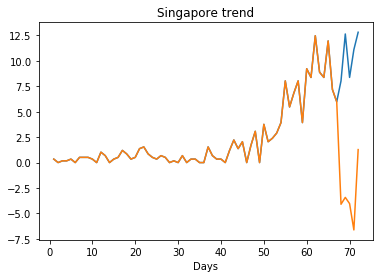

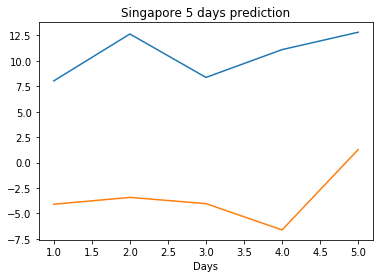

Creating directory ./offline6/Thailand/training/
Thailand
Saving the best model weights at Epoch [1], Best Valid Loss: 1.5782
Saving the best model weights at Epoch [2], Best Valid Loss: 1.3227


/space/home/nzhang/anaconda3/envs/neuralnet/lib/python3.7/site-packages/torch/nn/modules/loss.py:431: UserWarning: Using a target size (torch.Size([1, 1, 5])) that is different to the input size (torch.Size([5])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/space/home/nzhang/anaconda3/envs/neuralnet/lib/python3.7/site-packages/torch/nn/modules/loss.py:431: UserWarning: Using a target size (torch.Size([1, 5])) that is different to the input size (torch.Size([5])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Saving the best model weights at Epoch [3], Best Valid Loss: 0.8752
Saving the best model weights at Epoch [4], Best Valid Loss: 0.3602
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1333
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0638
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0588
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0571
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0565
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0442
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0357
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0344
train error: 0.053883309155169534
0.034429069608449936
Saving the best model weights at Epoch [1], Best Valid Loss: 1.2073
Saving the best model weights at Epoch [2], Best Valid Loss: 0.7885
Saving the best model weights at Epoch [3], Best Valid Loss: 0.2105
Saving the best model weights at Epoch [4], Best Valid 

train error: 0.0710431889004356
0.03729414567351341
Saving the best model weights at Epoch [1], Best Valid Loss: 1.7198
Saving the best model weights at Epoch [2], Best Valid Loss: 1.6815
Saving the best model weights at Epoch [3], Best Valid Loss: 1.4657
Saving the best model weights at Epoch [5], Best Valid Loss: 1.4102
Saving the best model weights at Epoch [7], Best Valid Loss: 0.8151
Saving the best model weights at Epoch [8], Best Valid Loss: 0.7417
Saving the best model weights at Epoch [9], Best Valid Loss: 0.2226
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0580
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0388
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0369
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0267
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0254
train error: 0.06661786883226964
0.025382671505212784
Saving the best model weights at Epoch [1], Best Valid Loss: 2.5618
Savin

train error: 0.0615432764362164
0.033043425530195236
Saving the best model weights at Epoch [1], Best Valid Loss: 2.7356
Saving the best model weights at Epoch [3], Best Valid Loss: 0.3396
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1231
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1045
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0802
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0433
train error: 0.05591862609511927
0.04330119118094444
Saving the best model weights at Epoch [1], Best Valid Loss: 1.8021
Saving the best model weights at Epoch [2], Best Valid Loss: 1.7510
Saving the best model weights at Epoch [3], Best Valid Loss: 1.6457
Saving the best model weights at Epoch [4], Best Valid Loss: 1.5568
Saving the best model weights at Epoch [5], Best Valid Loss: 1.4499
Saving the best model weights at Epoch [9], Best Valid Loss: 1.3528
train error: 0.46112621340312454
1.3527603149414062
Saving the best model wei

Saving the best model weights at Epoch [5], Best Valid Loss: 1.5369
Saving the best model weights at Epoch [12], Best Valid Loss: 1.3982
train error: 0.4582619324914719
1.3981980085372925
Saving the best model weights at Epoch [1], Best Valid Loss: 1.8104
Saving the best model weights at Epoch [2], Best Valid Loss: 1.5488
Saving the best model weights at Epoch [9], Best Valid Loss: 1.2556
Saving the best model weights at Epoch [14], Best Valid Loss: 1.1702
train error: 0.46474118133712755
1.1701830625534058
Saving the best model weights at Epoch [1], Best Valid Loss: 1.6917
Saving the best model weights at Epoch [2], Best Valid Loss: 1.4325
Saving the best model weights at Epoch [4], Best Valid Loss: 1.2331
Saving the best model weights at Epoch [7], Best Valid Loss: 1.1480
Saving the best model weights at Epoch [10], Best Valid Loss: 1.0014
Saving the best model weights at Epoch [20], Best Valid Loss: 0.6456
Saving the best model weights at Epoch [27], Best Valid Loss: 0.5284
train er

Saving the best model weights at Epoch [3], Best Valid Loss: 2.5860
Saving the best model weights at Epoch [4], Best Valid Loss: 2.4010
Saving the best model weights at Epoch [5], Best Valid Loss: 2.2515
Saving the best model weights at Epoch [6], Best Valid Loss: 2.1257
Saving the best model weights at Epoch [7], Best Valid Loss: 2.0226
Saving the best model weights at Epoch [8], Best Valid Loss: 1.9281
Saving the best model weights at Epoch [9], Best Valid Loss: 1.8514
Saving the best model weights at Epoch [10], Best Valid Loss: 1.7853
Saving the best model weights at Epoch [11], Best Valid Loss: 1.7262
Saving the best model weights at Epoch [12], Best Valid Loss: 1.6714
Saving the best model weights at Epoch [13], Best Valid Loss: 1.6243
Saving the best model weights at Epoch [14], Best Valid Loss: 1.5820
Saving the best model weights at Epoch [15], Best Valid Loss: 1.5433
Saving the best model weights at Epoch [16], Best Valid Loss: 1.5014
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [27], Best Valid Loss: 0.6830
Saving the best model weights at Epoch [28], Best Valid Loss: 0.6400
Saving the best model weights at Epoch [29], Best Valid Loss: 0.5960
Saving the best model weights at Epoch [30], Best Valid Loss: 0.5559
Saving the best model weights at Epoch [31], Best Valid Loss: 0.5136
Saving the best model weights at Epoch [32], Best Valid Loss: 0.4726
Saving the best model weights at Epoch [33], Best Valid Loss: 0.4325
Saving the best model weights at Epoch [34], Best Valid Loss: 0.3965
Saving the best model weights at Epoch [35], Best Valid Loss: 0.3620
Saving the best model weights at Epoch [36], Best Valid Loss: 0.3284
Saving the best model weights at Epoch [37], Best Valid Loss: 0.2972
Saving the best model weights at Epoch [38], Best Valid Loss: 0.2664
Saving the best model weights at Epoch [39], Best Valid Loss: 0.2377
Saving the best model weights at Epoch [40], Best Valid Loss: 0.2126
Saving the best model weights at E

Saving the best model weights at Epoch [48], Best Valid Loss: 0.0625
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0573
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0538
train error: 0.17547562350764087
0.053793441504240036
Saving the best model weights at Epoch [1], Best Valid Loss: 2.4575
Saving the best model weights at Epoch [2], Best Valid Loss: 2.1177
Saving the best model weights at Epoch [3], Best Valid Loss: 1.8671
Saving the best model weights at Epoch [4], Best Valid Loss: 1.6864
Saving the best model weights at Epoch [5], Best Valid Loss: 1.5265
Saving the best model weights at Epoch [6], Best Valid Loss: 1.4055
Saving the best model weights at Epoch [7], Best Valid Loss: 1.3030
Saving the best model weights at Epoch [8], Best Valid Loss: 1.1959
Saving the best model weights at Epoch [9], Best Valid Loss: 1.0947
Saving the best model weights at Epoch [10], Best Valid Loss: 1.0074
Saving the best model weights at Epoch [11], Best Valid Lo

train error: 0.12674397466655232
0.06052720546722412
Saving the best model weights at Epoch [1], Best Valid Loss: 1.6043
Saving the best model weights at Epoch [2], Best Valid Loss: 1.0536
Saving the best model weights at Epoch [3], Best Valid Loss: 0.7940
Saving the best model weights at Epoch [4], Best Valid Loss: 0.3520
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1128
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0711
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0673
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0648
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0546
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0493
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0455
train error: 0.05843508111674486
0.045540887862443924
Saving the best model weights at Epoch [1], Best Valid Loss: 3.1643
Saving the best model weights at Epoch [2], Best Valid Loss: 2.8757
Savi

Saving the best model weights at Epoch [24], Best Valid Loss: 1.6597
Saving the best model weights at Epoch [25], Best Valid Loss: 1.6558
Saving the best model weights at Epoch [26], Best Valid Loss: 1.6507
Saving the best model weights at Epoch [27], Best Valid Loss: 1.6486
Saving the best model weights at Epoch [30], Best Valid Loss: 1.6468
Saving the best model weights at Epoch [31], Best Valid Loss: 1.6455
Saving the best model weights at Epoch [32], Best Valid Loss: 1.6422
Saving the best model weights at Epoch [33], Best Valid Loss: 1.6389
Saving the best model weights at Epoch [35], Best Valid Loss: 1.6351
Saving the best model weights at Epoch [40], Best Valid Loss: 1.6349
Saving the best model weights at Epoch [41], Best Valid Loss: 1.6319
Saving the best model weights at Epoch [46], Best Valid Loss: 1.6296
Saving the best model weights at Epoch [48], Best Valid Loss: 1.6272
Saving the best model weights at Epoch [49], Best Valid Loss: 1.6254
Saving the best model weights at E

Saving the best model weights at Epoch [40], Best Valid Loss: 1.5798
Saving the best model weights at Epoch [41], Best Valid Loss: 1.5685
Saving the best model weights at Epoch [43], Best Valid Loss: 1.5661
Saving the best model weights at Epoch [45], Best Valid Loss: 1.5583
Saving the best model weights at Epoch [46], Best Valid Loss: 1.5459
Saving the best model weights at Epoch [47], Best Valid Loss: 1.5410
Saving the best model weights at Epoch [48], Best Valid Loss: 1.5232
Saving the best model weights at Epoch [49], Best Valid Loss: 1.5150
Saving the best model weights at Epoch [50], Best Valid Loss: 1.4974
train error: 0.4269079880935973
1.497389316558838
Saving the best model weights at Epoch [1], Best Valid Loss: 1.8040
Saving the best model weights at Epoch [2], Best Valid Loss: 1.5369
Saving the best model weights at Epoch [7], Best Valid Loss: 1.5252
Saving the best model weights at Epoch [9], Best Valid Loss: 1.3801
Saving the best model weights at Epoch [11], Best Valid L

Saving the best model weights at Epoch [16], Best Valid Loss: 0.4318
Saving the best model weights at Epoch [17], Best Valid Loss: 0.2196
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0713
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0523
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0481
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0417
train error: 0.06855249883895005
0.04169009253382683
Saving the best model weights at Epoch [1], Best Valid Loss: 2.5592
Saving the best model weights at Epoch [2], Best Valid Loss: 2.3922
Saving the best model weights at Epoch [3], Best Valid Loss: 2.2625
Saving the best model weights at Epoch [4], Best Valid Loss: 2.1578
Saving the best model weights at Epoch [5], Best Valid Loss: 2.0739
Saving the best model weights at Epoch [6], Best Valid Loss: 2.0024
Saving the best model weights at Epoch [7], Best Valid Loss: 1.9446
Saving the best model weights at Epoch [8], Best Valid Lo

Saving the best model weights at Epoch [42], Best Valid Loss: 1.5279
train error: 0.4500298730685915
1.5278699398040771
Saving the best model weights at Epoch [1], Best Valid Loss: 2.7821
Saving the best model weights at Epoch [2], Best Valid Loss: 2.5759
Saving the best model weights at Epoch [3], Best Valid Loss: 2.4088
Saving the best model weights at Epoch [4], Best Valid Loss: 2.2729
Saving the best model weights at Epoch [5], Best Valid Loss: 2.1614
Saving the best model weights at Epoch [6], Best Valid Loss: 2.0699
Saving the best model weights at Epoch [7], Best Valid Loss: 1.9969
Saving the best model weights at Epoch [8], Best Valid Loss: 1.9359
Saving the best model weights at Epoch [9], Best Valid Loss: 1.8898
Saving the best model weights at Epoch [10], Best Valid Loss: 1.8513
Saving the best model weights at Epoch [11], Best Valid Loss: 1.8200
Saving the best model weights at Epoch [12], Best Valid Loss: 1.7923
Saving the best model weights at Epoch [13], Best Valid Loss:

Saving the best model weights at Epoch [10], Best Valid Loss: 1.5518
Saving the best model weights at Epoch [13], Best Valid Loss: 1.5281
Saving the best model weights at Epoch [32], Best Valid Loss: 1.5154
train error: 0.4463405487568755
1.5154430866241455
Saving the best model weights at Epoch [1], Best Valid Loss: 2.9426
Saving the best model weights at Epoch [2], Best Valid Loss: 2.7029
Saving the best model weights at Epoch [3], Best Valid Loss: 2.5039
Saving the best model weights at Epoch [4], Best Valid Loss: 2.3530
Saving the best model weights at Epoch [5], Best Valid Loss: 2.2280
Saving the best model weights at Epoch [6], Best Valid Loss: 2.1262
Saving the best model weights at Epoch [7], Best Valid Loss: 2.0503
Saving the best model weights at Epoch [8], Best Valid Loss: 1.9808
Saving the best model weights at Epoch [9], Best Valid Loss: 1.9265
Saving the best model weights at Epoch [10], Best Valid Loss: 1.8819
Saving the best model weights at Epoch [11], Best Valid Loss:

Saving the best model weights at Epoch [18], Best Valid Loss: 1.5561
Saving the best model weights at Epoch [22], Best Valid Loss: 1.5537
Saving the best model weights at Epoch [27], Best Valid Loss: 1.5377
Saving the best model weights at Epoch [46], Best Valid Loss: 1.5353
train error: 0.4502449449837992
1.5353060960769653
Saving the best model weights at Epoch [1], Best Valid Loss: 2.6623
Saving the best model weights at Epoch [2], Best Valid Loss: 2.4774
Saving the best model weights at Epoch [3], Best Valid Loss: 2.3270
Saving the best model weights at Epoch [4], Best Valid Loss: 2.2095
Saving the best model weights at Epoch [5], Best Valid Loss: 2.1079
Saving the best model weights at Epoch [6], Best Valid Loss: 2.0310
Saving the best model weights at Epoch [7], Best Valid Loss: 1.9661
Saving the best model weights at Epoch [8], Best Valid Loss: 1.9155
Saving the best model weights at Epoch [9], Best Valid Loss: 1.8709
Saving the best model weights at Epoch [10], Best Valid Loss:

Saving the best model weights at Epoch [18], Best Valid Loss: 1.5012
train error: 0.46148110671262993
1.5011588335037231
Saving the best model weights at Epoch [1], Best Valid Loss: 2.5435
Saving the best model weights at Epoch [2], Best Valid Loss: 2.3837
Saving the best model weights at Epoch [3], Best Valid Loss: 2.2523
Saving the best model weights at Epoch [4], Best Valid Loss: 2.1485
Saving the best model weights at Epoch [5], Best Valid Loss: 2.0620
Saving the best model weights at Epoch [6], Best Valid Loss: 1.9902
Saving the best model weights at Epoch [7], Best Valid Loss: 1.9333
Saving the best model weights at Epoch [8], Best Valid Loss: 1.8865
Saving the best model weights at Epoch [9], Best Valid Loss: 1.8491
Saving the best model weights at Epoch [10], Best Valid Loss: 1.8223
Saving the best model weights at Epoch [11], Best Valid Loss: 1.7990
Saving the best model weights at Epoch [12], Best Valid Loss: 1.7768
Saving the best model weights at Epoch [13], Best Valid Loss

Saving the best model weights at Epoch [4], Best Valid Loss: 2.2905
Saving the best model weights at Epoch [5], Best Valid Loss: 2.1758
Saving the best model weights at Epoch [6], Best Valid Loss: 2.0862
Saving the best model weights at Epoch [7], Best Valid Loss: 2.0151
Saving the best model weights at Epoch [8], Best Valid Loss: 1.9530
Saving the best model weights at Epoch [9], Best Valid Loss: 1.9021
Saving the best model weights at Epoch [10], Best Valid Loss: 1.8631
Saving the best model weights at Epoch [11], Best Valid Loss: 1.8321
Saving the best model weights at Epoch [12], Best Valid Loss: 1.8019
Saving the best model weights at Epoch [13], Best Valid Loss: 1.7782
Saving the best model weights at Epoch [14], Best Valid Loss: 1.7643
Saving the best model weights at Epoch [15], Best Valid Loss: 1.7518
Saving the best model weights at Epoch [16], Best Valid Loss: 1.7387
Saving the best model weights at Epoch [17], Best Valid Loss: 1.7271
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [6], Best Valid Loss: 2.6598
Saving the best model weights at Epoch [7], Best Valid Loss: 2.6361
Saving the best model weights at Epoch [8], Best Valid Loss: 2.6131
Saving the best model weights at Epoch [9], Best Valid Loss: 2.5902
Saving the best model weights at Epoch [10], Best Valid Loss: 2.5679
Saving the best model weights at Epoch [11], Best Valid Loss: 2.5464
Saving the best model weights at Epoch [12], Best Valid Loss: 2.5250
Saving the best model weights at Epoch [13], Best Valid Loss: 2.5040
Saving the best model weights at Epoch [14], Best Valid Loss: 2.4835
Saving the best model weights at Epoch [15], Best Valid Loss: 2.4635
Saving the best model weights at Epoch [16], Best Valid Loss: 2.4441
Saving the best model weights at Epoch [17], Best Valid Loss: 2.4247
Saving the best model weights at Epoch [18], Best Valid Loss: 2.4059
Saving the best model weights at Epoch [19], Best Valid Loss: 2.3876
Saving the best model weights at Epoch

Saving the best model weights at Epoch [27], Best Valid Loss: 0.9101
Saving the best model weights at Epoch [28], Best Valid Loss: 0.8788
Saving the best model weights at Epoch [29], Best Valid Loss: 0.8304
Saving the best model weights at Epoch [30], Best Valid Loss: 0.8268
Saving the best model weights at Epoch [31], Best Valid Loss: 0.7612
Saving the best model weights at Epoch [32], Best Valid Loss: 0.7350
Saving the best model weights at Epoch [33], Best Valid Loss: 0.7073
Saving the best model weights at Epoch [34], Best Valid Loss: 0.6640
Saving the best model weights at Epoch [35], Best Valid Loss: 0.6226
Saving the best model weights at Epoch [36], Best Valid Loss: 0.5882
Saving the best model weights at Epoch [37], Best Valid Loss: 0.5556
Saving the best model weights at Epoch [38], Best Valid Loss: 0.5273
Saving the best model weights at Epoch [39], Best Valid Loss: 0.4903
Saving the best model weights at Epoch [40], Best Valid Loss: 0.4665
Saving the best model weights at E

Saving the best model weights at Epoch [46], Best Valid Loss: 1.7008
Saving the best model weights at Epoch [47], Best Valid Loss: 1.6872
Saving the best model weights at Epoch [48], Best Valid Loss: 1.6743
Saving the best model weights at Epoch [49], Best Valid Loss: 1.6650
Saving the best model weights at Epoch [50], Best Valid Loss: 1.6518
train error: 0.41675167565086957
1.6518429517745972
Saving the best model weights at Epoch [1], Best Valid Loss: 2.7829
Saving the best model weights at Epoch [2], Best Valid Loss: 2.5194
Saving the best model weights at Epoch [3], Best Valid Loss: 2.3195
Saving the best model weights at Epoch [4], Best Valid Loss: 2.1360
Saving the best model weights at Epoch [5], Best Valid Loss: 2.0006
Saving the best model weights at Epoch [6], Best Valid Loss: 1.9096
Saving the best model weights at Epoch [7], Best Valid Loss: 1.7618
Saving the best model weights at Epoch [8], Best Valid Loss: 1.6623
Saving the best model weights at Epoch [9], Best Valid Loss

Saving the best model weights at Epoch [14], Best Valid Loss: 2.4905
Saving the best model weights at Epoch [15], Best Valid Loss: 2.4492
Saving the best model weights at Epoch [16], Best Valid Loss: 2.4099
Saving the best model weights at Epoch [17], Best Valid Loss: 2.3741
Saving the best model weights at Epoch [18], Best Valid Loss: 2.3358
Saving the best model weights at Epoch [19], Best Valid Loss: 2.3011
Saving the best model weights at Epoch [20], Best Valid Loss: 2.2665
Saving the best model weights at Epoch [21], Best Valid Loss: 2.2338
Saving the best model weights at Epoch [22], Best Valid Loss: 2.2052
Saving the best model weights at Epoch [23], Best Valid Loss: 2.1718
Saving the best model weights at Epoch [24], Best Valid Loss: 2.1409
Saving the best model weights at Epoch [25], Best Valid Loss: 2.1116
Saving the best model weights at Epoch [26], Best Valid Loss: 2.0839
Saving the best model weights at Epoch [27], Best Valid Loss: 2.0568
Saving the best model weights at E

Saving the best model weights at Epoch [32], Best Valid Loss: 2.1134
Saving the best model weights at Epoch [33], Best Valid Loss: 2.0980
Saving the best model weights at Epoch [34], Best Valid Loss: 2.0832
Saving the best model weights at Epoch [35], Best Valid Loss: 2.0689
Saving the best model weights at Epoch [36], Best Valid Loss: 2.0543
Saving the best model weights at Epoch [37], Best Valid Loss: 2.0404
Saving the best model weights at Epoch [38], Best Valid Loss: 2.0263
Saving the best model weights at Epoch [39], Best Valid Loss: 2.0127
Saving the best model weights at Epoch [40], Best Valid Loss: 1.9994
Saving the best model weights at Epoch [41], Best Valid Loss: 1.9863
Saving the best model weights at Epoch [42], Best Valid Loss: 1.9734
Saving the best model weights at Epoch [43], Best Valid Loss: 1.9607
Saving the best model weights at Epoch [44], Best Valid Loss: 1.9482
Saving the best model weights at Epoch [45], Best Valid Loss: 1.9358
Saving the best model weights at E

Saving the best model weights at Epoch [2], Best Valid Loss: 2.8263
Saving the best model weights at Epoch [3], Best Valid Loss: 2.8023
Saving the best model weights at Epoch [4], Best Valid Loss: 2.7791
Saving the best model weights at Epoch [5], Best Valid Loss: 2.7565
Saving the best model weights at Epoch [6], Best Valid Loss: 2.7340
Saving the best model weights at Epoch [7], Best Valid Loss: 2.7122
Saving the best model weights at Epoch [8], Best Valid Loss: 2.6910
Saving the best model weights at Epoch [9], Best Valid Loss: 2.6702
Saving the best model weights at Epoch [10], Best Valid Loss: 2.6499
Saving the best model weights at Epoch [11], Best Valid Loss: 2.6300
Saving the best model weights at Epoch [12], Best Valid Loss: 2.6106
Saving the best model weights at Epoch [13], Best Valid Loss: 2.5916
Saving the best model weights at Epoch [14], Best Valid Loss: 2.5730
Saving the best model weights at Epoch [15], Best Valid Loss: 2.5548
Saving the best model weights at Epoch [16

Saving the best model weights at Epoch [24], Best Valid Loss: 1.6489
Saving the best model weights at Epoch [26], Best Valid Loss: 1.6385
Saving the best model weights at Epoch [30], Best Valid Loss: 1.6291
Saving the best model weights at Epoch [32], Best Valid Loss: 1.6248
Saving the best model weights at Epoch [36], Best Valid Loss: 1.6229
Saving the best model weights at Epoch [41], Best Valid Loss: 1.6124
Saving the best model weights at Epoch [48], Best Valid Loss: 1.6060
train error: 0.4374563197213176
1.6059712171554565
Saving the best model weights at Epoch [1], Best Valid Loss: 2.8710
Saving the best model weights at Epoch [2], Best Valid Loss: 2.8464
Saving the best model weights at Epoch [3], Best Valid Loss: 2.8223
Saving the best model weights at Epoch [4], Best Valid Loss: 2.7989
Saving the best model weights at Epoch [5], Best Valid Loss: 2.7761
Saving the best model weights at Epoch [6], Best Valid Loss: 2.7534
Saving the best model weights at Epoch [7], Best Valid Los

Saving the best model weights at Epoch [11], Best Valid Loss: 1.8494
Saving the best model weights at Epoch [12], Best Valid Loss: 1.8240
Saving the best model weights at Epoch [13], Best Valid Loss: 1.7736
Saving the best model weights at Epoch [14], Best Valid Loss: 1.7652
Saving the best model weights at Epoch [15], Best Valid Loss: 1.7527
Saving the best model weights at Epoch [17], Best Valid Loss: 1.7302
Saving the best model weights at Epoch [18], Best Valid Loss: 1.6998
Saving the best model weights at Epoch [19], Best Valid Loss: 1.6984
Saving the best model weights at Epoch [21], Best Valid Loss: 1.6791
Saving the best model weights at Epoch [22], Best Valid Loss: 1.6786
Saving the best model weights at Epoch [23], Best Valid Loss: 1.6759
Saving the best model weights at Epoch [25], Best Valid Loss: 1.6717
Saving the best model weights at Epoch [27], Best Valid Loss: 1.6591
Saving the best model weights at Epoch [32], Best Valid Loss: 1.6575
Saving the best model weights at E

Saving the best model weights at Epoch [49], Best Valid Loss: 1.9083
Saving the best model weights at Epoch [50], Best Valid Loss: 1.8984
train error: 0.4501539996678108
1.8983887434005737
Saving the best model weights at Epoch [1], Best Valid Loss: 2.7125
Saving the best model weights at Epoch [2], Best Valid Loss: 2.5363
Saving the best model weights at Epoch [3], Best Valid Loss: 2.3620
Saving the best model weights at Epoch [4], Best Valid Loss: 2.2459
Saving the best model weights at Epoch [5], Best Valid Loss: 2.1606
Saving the best model weights at Epoch [6], Best Valid Loss: 2.0716
Saving the best model weights at Epoch [7], Best Valid Loss: 2.0024
Saving the best model weights at Epoch [8], Best Valid Loss: 1.9327
Saving the best model weights at Epoch [9], Best Valid Loss: 1.8904
Saving the best model weights at Epoch [10], Best Valid Loss: 1.8604
Saving the best model weights at Epoch [11], Best Valid Loss: 1.8139
Saving the best model weights at Epoch [12], Best Valid Loss:

Saving the best model weights at Epoch [37], Best Valid Loss: 1.9744
Saving the best model weights at Epoch [38], Best Valid Loss: 1.9629
Saving the best model weights at Epoch [39], Best Valid Loss: 1.9533
Saving the best model weights at Epoch [40], Best Valid Loss: 1.9428
Saving the best model weights at Epoch [41], Best Valid Loss: 1.9342
Saving the best model weights at Epoch [42], Best Valid Loss: 1.9244
Saving the best model weights at Epoch [43], Best Valid Loss: 1.9148
Saving the best model weights at Epoch [44], Best Valid Loss: 1.9065
Saving the best model weights at Epoch [45], Best Valid Loss: 1.8980
Saving the best model weights at Epoch [46], Best Valid Loss: 1.8915
Saving the best model weights at Epoch [47], Best Valid Loss: 1.8819
Saving the best model weights at Epoch [48], Best Valid Loss: 1.8744
Saving the best model weights at Epoch [49], Best Valid Loss: 1.8674
Saving the best model weights at Epoch [50], Best Valid Loss: 1.8599
train error: 0.44711130127114684
1

Saving the best model weights at Epoch [26], Best Valid Loss: 2.0264
Saving the best model weights at Epoch [27], Best Valid Loss: 2.0132
Saving the best model weights at Epoch [28], Best Valid Loss: 2.0023
Saving the best model weights at Epoch [29], Best Valid Loss: 1.9917
Saving the best model weights at Epoch [30], Best Valid Loss: 1.9805
Saving the best model weights at Epoch [31], Best Valid Loss: 1.9701
Saving the best model weights at Epoch [32], Best Valid Loss: 1.9598
Saving the best model weights at Epoch [33], Best Valid Loss: 1.9491
Saving the best model weights at Epoch [34], Best Valid Loss: 1.9421
Saving the best model weights at Epoch [35], Best Valid Loss: 1.9322
Saving the best model weights at Epoch [36], Best Valid Loss: 1.9233
Saving the best model weights at Epoch [37], Best Valid Loss: 1.9145
Saving the best model weights at Epoch [38], Best Valid Loss: 1.9062
Saving the best model weights at Epoch [39], Best Valid Loss: 1.8982
Saving the best model weights at E

Saving the best model weights at Epoch [20], Best Valid Loss: 2.2166
Saving the best model weights at Epoch [21], Best Valid Loss: 2.1977
Saving the best model weights at Epoch [22], Best Valid Loss: 2.1781
Saving the best model weights at Epoch [23], Best Valid Loss: 2.1592
Saving the best model weights at Epoch [24], Best Valid Loss: 2.1416
Saving the best model weights at Epoch [25], Best Valid Loss: 2.1241
Saving the best model weights at Epoch [26], Best Valid Loss: 2.1080
Saving the best model weights at Epoch [27], Best Valid Loss: 2.0933
Saving the best model weights at Epoch [28], Best Valid Loss: 2.0774
Saving the best model weights at Epoch [29], Best Valid Loss: 2.0624
Saving the best model weights at Epoch [30], Best Valid Loss: 2.0494
Saving the best model weights at Epoch [31], Best Valid Loss: 2.0345
Saving the best model weights at Epoch [32], Best Valid Loss: 2.0240
Saving the best model weights at Epoch [33], Best Valid Loss: 2.0099
Saving the best model weights at E

Saving the best model weights at Epoch [14], Best Valid Loss: 2.4994
Saving the best model weights at Epoch [15], Best Valid Loss: 2.4711
Saving the best model weights at Epoch [16], Best Valid Loss: 2.4406
Saving the best model weights at Epoch [17], Best Valid Loss: 2.4145
Saving the best model weights at Epoch [18], Best Valid Loss: 2.3873
Saving the best model weights at Epoch [19], Best Valid Loss: 2.3605
Saving the best model weights at Epoch [20], Best Valid Loss: 2.3370
Saving the best model weights at Epoch [21], Best Valid Loss: 2.3134
Saving the best model weights at Epoch [22], Best Valid Loss: 2.2915
Saving the best model weights at Epoch [23], Best Valid Loss: 2.2682
Saving the best model weights at Epoch [24], Best Valid Loss: 2.2464
Saving the best model weights at Epoch [25], Best Valid Loss: 2.2271
Saving the best model weights at Epoch [26], Best Valid Loss: 2.2077
Saving the best model weights at Epoch [27], Best Valid Loss: 2.1894
Saving the best model weights at E

Saving the best model weights at Epoch [4], Best Valid Loss: 2.8403
Saving the best model weights at Epoch [5], Best Valid Loss: 2.7970
Saving the best model weights at Epoch [6], Best Valid Loss: 2.7549
Saving the best model weights at Epoch [7], Best Valid Loss: 2.7167
Saving the best model weights at Epoch [8], Best Valid Loss: 2.6764
Saving the best model weights at Epoch [9], Best Valid Loss: 2.6397
Saving the best model weights at Epoch [10], Best Valid Loss: 2.6049
Saving the best model weights at Epoch [11], Best Valid Loss: 2.5711
Saving the best model weights at Epoch [12], Best Valid Loss: 2.5378
Saving the best model weights at Epoch [13], Best Valid Loss: 2.5069
Saving the best model weights at Epoch [14], Best Valid Loss: 2.4768
Saving the best model weights at Epoch [15], Best Valid Loss: 2.4471
Saving the best model weights at Epoch [16], Best Valid Loss: 2.4197
Saving the best model weights at Epoch [17], Best Valid Loss: 2.3927
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [48], Best Valid Loss: 2.0632
Saving the best model weights at Epoch [49], Best Valid Loss: 2.0557
Saving the best model weights at Epoch [50], Best Valid Loss: 2.0483
train error: 0.46932335688095345
2.048276662826538
Saving the best model weights at Epoch [1], Best Valid Loss: 3.6205
Saving the best model weights at Epoch [2], Best Valid Loss: 3.5415
Saving the best model weights at Epoch [3], Best Valid Loss: 3.4647
Saving the best model weights at Epoch [4], Best Valid Loss: 3.3912
Saving the best model weights at Epoch [5], Best Valid Loss: 3.3216
Saving the best model weights at Epoch [6], Best Valid Loss: 3.2536
Saving the best model weights at Epoch [7], Best Valid Loss: 3.1907
Saving the best model weights at Epoch [8], Best Valid Loss: 3.1295
Saving the best model weights at Epoch [9], Best Valid Loss: 3.0712
Saving the best model weights at Epoch [10], Best Valid Loss: 3.0141
Saving the best model weights at Epoch [11], Best Valid Loss:

Saving the best model weights at Epoch [40], Best Valid Loss: 2.2815
Saving the best model weights at Epoch [41], Best Valid Loss: 2.2693
Saving the best model weights at Epoch [42], Best Valid Loss: 2.2573
Saving the best model weights at Epoch [43], Best Valid Loss: 2.2455
Saving the best model weights at Epoch [44], Best Valid Loss: 2.2341
Saving the best model weights at Epoch [45], Best Valid Loss: 2.2229
Saving the best model weights at Epoch [46], Best Valid Loss: 2.2119
Saving the best model weights at Epoch [47], Best Valid Loss: 2.2012
Saving the best model weights at Epoch [48], Best Valid Loss: 2.1907
Saving the best model weights at Epoch [49], Best Valid Loss: 2.1802
Saving the best model weights at Epoch [50], Best Valid Loss: 2.1701
train error: 0.47805919586435747
2.1701204776763916
Saving the best model weights at Epoch [1], Best Valid Loss: 2.6758
Saving the best model weights at Epoch [2], Best Valid Loss: 2.6398
Saving the best model weights at Epoch [3], Best Vali

Saving the best model weights at Epoch [32], Best Valid Loss: 2.2785
Saving the best model weights at Epoch [33], Best Valid Loss: 2.2663
Saving the best model weights at Epoch [34], Best Valid Loss: 2.2543
Saving the best model weights at Epoch [35], Best Valid Loss: 2.2425
Saving the best model weights at Epoch [36], Best Valid Loss: 2.2310
Saving the best model weights at Epoch [37], Best Valid Loss: 2.2199
Saving the best model weights at Epoch [38], Best Valid Loss: 2.2089
Saving the best model weights at Epoch [39], Best Valid Loss: 2.1984
Saving the best model weights at Epoch [40], Best Valid Loss: 2.1876
Saving the best model weights at Epoch [41], Best Valid Loss: 2.1773
Saving the best model weights at Epoch [42], Best Valid Loss: 2.1675
Saving the best model weights at Epoch [43], Best Valid Loss: 2.1574
Saving the best model weights at Epoch [44], Best Valid Loss: 2.1477
Saving the best model weights at Epoch [45], Best Valid Loss: 2.1382
Saving the best model weights at E

Saving the best model weights at Epoch [24], Best Valid Loss: 2.4636
Saving the best model weights at Epoch [25], Best Valid Loss: 2.4477
Saving the best model weights at Epoch [26], Best Valid Loss: 2.4322
Saving the best model weights at Epoch [27], Best Valid Loss: 2.4170
Saving the best model weights at Epoch [28], Best Valid Loss: 2.4022
Saving the best model weights at Epoch [29], Best Valid Loss: 2.3876
Saving the best model weights at Epoch [30], Best Valid Loss: 2.3734
Saving the best model weights at Epoch [31], Best Valid Loss: 2.3595
Saving the best model weights at Epoch [32], Best Valid Loss: 2.3458
Saving the best model weights at Epoch [33], Best Valid Loss: 2.3324
Saving the best model weights at Epoch [34], Best Valid Loss: 2.3194
Saving the best model weights at Epoch [35], Best Valid Loss: 2.3068
Saving the best model weights at Epoch [36], Best Valid Loss: 2.2941
Saving the best model weights at Epoch [37], Best Valid Loss: 2.2820
Saving the best model weights at E

Saving the best model weights at Epoch [12], Best Valid Loss: 2.6374
Saving the best model weights at Epoch [13], Best Valid Loss: 2.6181
Saving the best model weights at Epoch [14], Best Valid Loss: 2.5995
Saving the best model weights at Epoch [15], Best Valid Loss: 2.5807
Saving the best model weights at Epoch [16], Best Valid Loss: 2.5627
Saving the best model weights at Epoch [17], Best Valid Loss: 2.5450
Saving the best model weights at Epoch [18], Best Valid Loss: 2.5277
Saving the best model weights at Epoch [19], Best Valid Loss: 2.5108
Saving the best model weights at Epoch [20], Best Valid Loss: 2.4942
Saving the best model weights at Epoch [21], Best Valid Loss: 2.4781
Saving the best model weights at Epoch [22], Best Valid Loss: 2.4620
Saving the best model weights at Epoch [23], Best Valid Loss: 2.4465
Saving the best model weights at Epoch [24], Best Valid Loss: 2.4313
Saving the best model weights at Epoch [25], Best Valid Loss: 2.4163
Saving the best model weights at E

Saving the best model weights at Epoch [3], Best Valid Loss: 3.2033
Saving the best model weights at Epoch [4], Best Valid Loss: 3.1712
Saving the best model weights at Epoch [5], Best Valid Loss: 3.1398
Saving the best model weights at Epoch [6], Best Valid Loss: 3.1092
Saving the best model weights at Epoch [7], Best Valid Loss: 3.0791
Saving the best model weights at Epoch [8], Best Valid Loss: 3.0498
Saving the best model weights at Epoch [9], Best Valid Loss: 3.0211
Saving the best model weights at Epoch [10], Best Valid Loss: 2.9933
Saving the best model weights at Epoch [11], Best Valid Loss: 2.9659
Saving the best model weights at Epoch [12], Best Valid Loss: 2.9391
Saving the best model weights at Epoch [13], Best Valid Loss: 2.9129
Saving the best model weights at Epoch [14], Best Valid Loss: 2.8874
Saving the best model weights at Epoch [15], Best Valid Loss: 2.8623
Saving the best model weights at Epoch [16], Best Valid Loss: 2.8379
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [24], Best Valid Loss: 1.6818
Saving the best model weights at Epoch [26], Best Valid Loss: 1.6801
Saving the best model weights at Epoch [28], Best Valid Loss: 1.6754
Saving the best model weights at Epoch [29], Best Valid Loss: 1.6564
Saving the best model weights at Epoch [40], Best Valid Loss: 1.6537
train error: 0.44305041611292645
1.653702735900879
Saving the best model weights at Epoch [1], Best Valid Loss: 2.7567
Saving the best model weights at Epoch [2], Best Valid Loss: 2.7345
Saving the best model weights at Epoch [3], Best Valid Loss: 2.7129
Saving the best model weights at Epoch [4], Best Valid Loss: 2.6918
Saving the best model weights at Epoch [5], Best Valid Loss: 2.6711
Saving the best model weights at Epoch [6], Best Valid Loss: 2.6511
Saving the best model weights at Epoch [7], Best Valid Loss: 2.6310
Saving the best model weights at Epoch [8], Best Valid Loss: 2.6116
Saving the best model weights at Epoch [9], Best Valid Loss:

Saving the best model weights at Epoch [14], Best Valid Loss: 1.7495
Saving the best model weights at Epoch [15], Best Valid Loss: 1.7458
Saving the best model weights at Epoch [16], Best Valid Loss: 1.7422
Saving the best model weights at Epoch [17], Best Valid Loss: 1.7239
Saving the best model weights at Epoch [19], Best Valid Loss: 1.6998
Saving the best model weights at Epoch [20], Best Valid Loss: 1.6961
Saving the best model weights at Epoch [23], Best Valid Loss: 1.6703
Saving the best model weights at Epoch [26], Best Valid Loss: 1.6681
Saving the best model weights at Epoch [30], Best Valid Loss: 1.6491
train error: 0.4430381419676307
1.649056077003479
Saving the best model weights at Epoch [1], Best Valid Loss: 2.9045
Saving the best model weights at Epoch [2], Best Valid Loss: 2.8786
Saving the best model weights at Epoch [3], Best Valid Loss: 2.8535
Saving the best model weights at Epoch [4], Best Valid Loss: 2.8287
Saving the best model weights at Epoch [5], Best Valid Lo

Saving the best model weights at Epoch [10], Best Valid Loss: 1.8768
Saving the best model weights at Epoch [11], Best Valid Loss: 1.8516
Saving the best model weights at Epoch [12], Best Valid Loss: 1.8043
Saving the best model weights at Epoch [14], Best Valid Loss: 1.7804
Saving the best model weights at Epoch [15], Best Valid Loss: 1.7452
Saving the best model weights at Epoch [16], Best Valid Loss: 1.7183
Saving the best model weights at Epoch [18], Best Valid Loss: 1.7042
Saving the best model weights at Epoch [20], Best Valid Loss: 1.6948
Saving the best model weights at Epoch [21], Best Valid Loss: 1.6865
Saving the best model weights at Epoch [22], Best Valid Loss: 1.6796
Saving the best model weights at Epoch [25], Best Valid Loss: 1.6732
Saving the best model weights at Epoch [26], Best Valid Loss: 1.6726
Saving the best model weights at Epoch [27], Best Valid Loss: 1.6671
Saving the best model weights at Epoch [31], Best Valid Loss: 1.6644
Saving the best model weights at E

Saving the best model weights at Epoch [2], Best Valid Loss: 2.9929
Saving the best model weights at Epoch [3], Best Valid Loss: 2.9627
Saving the best model weights at Epoch [4], Best Valid Loss: 2.9346
Saving the best model weights at Epoch [5], Best Valid Loss: 2.9046
Saving the best model weights at Epoch [6], Best Valid Loss: 2.8781
Saving the best model weights at Epoch [7], Best Valid Loss: 2.8468
Saving the best model weights at Epoch [8], Best Valid Loss: 2.8218
Saving the best model weights at Epoch [9], Best Valid Loss: 2.7963
Saving the best model weights at Epoch [10], Best Valid Loss: 2.7706
Saving the best model weights at Epoch [11], Best Valid Loss: 2.7450
Saving the best model weights at Epoch [12], Best Valid Loss: 2.7190
Saving the best model weights at Epoch [13], Best Valid Loss: 2.6953
Saving the best model weights at Epoch [14], Best Valid Loss: 2.6703
Saving the best model weights at Epoch [15], Best Valid Loss: 2.6453
Saving the best model weights at Epoch [16

Saving the best model weights at Epoch [22], Best Valid Loss: 2.6125
Saving the best model weights at Epoch [23], Best Valid Loss: 2.6076
Saving the best model weights at Epoch [24], Best Valid Loss: 2.6027
Saving the best model weights at Epoch [25], Best Valid Loss: 2.5980
Saving the best model weights at Epoch [26], Best Valid Loss: 2.5931
Saving the best model weights at Epoch [27], Best Valid Loss: 2.5887
Saving the best model weights at Epoch [28], Best Valid Loss: 2.5835
Saving the best model weights at Epoch [29], Best Valid Loss: 2.5787
Saving the best model weights at Epoch [30], Best Valid Loss: 2.5740
Saving the best model weights at Epoch [31], Best Valid Loss: 2.5697
Saving the best model weights at Epoch [32], Best Valid Loss: 2.5646
Saving the best model weights at Epoch [33], Best Valid Loss: 2.5601
Saving the best model weights at Epoch [34], Best Valid Loss: 2.5554
Saving the best model weights at Epoch [35], Best Valid Loss: 2.5506
Saving the best model weights at E

Saving the best model weights at Epoch [41], Best Valid Loss: 2.8732
Saving the best model weights at Epoch [42], Best Valid Loss: 2.8703
Saving the best model weights at Epoch [43], Best Valid Loss: 2.8673
Saving the best model weights at Epoch [44], Best Valid Loss: 2.8644
Saving the best model weights at Epoch [45], Best Valid Loss: 2.8615
Saving the best model weights at Epoch [46], Best Valid Loss: 2.8586
Saving the best model weights at Epoch [47], Best Valid Loss: 2.8557
Saving the best model weights at Epoch [48], Best Valid Loss: 2.8528
Saving the best model weights at Epoch [49], Best Valid Loss: 2.8499
Saving the best model weights at Epoch [50], Best Valid Loss: 2.8470
train error: 0.5989391188746882
2.847032308578491
Saving the best model weights at Epoch [1], Best Valid Loss: 3.0191
Saving the best model weights at Epoch [2], Best Valid Loss: 3.0125
Saving the best model weights at Epoch [3], Best Valid Loss: 3.0063
Saving the best model weights at Epoch [4], Best Valid L

Saving the best model weights at Epoch [8], Best Valid Loss: 3.0359
Saving the best model weights at Epoch [9], Best Valid Loss: 3.0324
Saving the best model weights at Epoch [10], Best Valid Loss: 3.0289
Saving the best model weights at Epoch [11], Best Valid Loss: 3.0254
Saving the best model weights at Epoch [12], Best Valid Loss: 3.0219
Saving the best model weights at Epoch [13], Best Valid Loss: 3.0185
Saving the best model weights at Epoch [14], Best Valid Loss: 3.0150
Saving the best model weights at Epoch [15], Best Valid Loss: 3.0115
Saving the best model weights at Epoch [16], Best Valid Loss: 3.0081
Saving the best model weights at Epoch [17], Best Valid Loss: 3.0046
Saving the best model weights at Epoch [18], Best Valid Loss: 3.0012
Saving the best model weights at Epoch [19], Best Valid Loss: 2.9978
Saving the best model weights at Epoch [20], Best Valid Loss: 2.9943
Saving the best model weights at Epoch [21], Best Valid Loss: 2.9909
Saving the best model weights at Epo

Saving the best model weights at Epoch [28], Best Valid Loss: 2.2679
Saving the best model weights at Epoch [29], Best Valid Loss: 2.2512
Saving the best model weights at Epoch [30], Best Valid Loss: 2.2320
Saving the best model weights at Epoch [31], Best Valid Loss: 2.2193
Saving the best model weights at Epoch [32], Best Valid Loss: 2.2001
Saving the best model weights at Epoch [33], Best Valid Loss: 2.1835
Saving the best model weights at Epoch [34], Best Valid Loss: 2.1691
Saving the best model weights at Epoch [35], Best Valid Loss: 2.1535
Saving the best model weights at Epoch [36], Best Valid Loss: 2.1405
Saving the best model weights at Epoch [37], Best Valid Loss: 2.1224
Saving the best model weights at Epoch [38], Best Valid Loss: 2.1091
Saving the best model weights at Epoch [39], Best Valid Loss: 2.0955
Saving the best model weights at Epoch [40], Best Valid Loss: 2.0793
Saving the best model weights at Epoch [41], Best Valid Loss: 2.0646
Saving the best model weights at E

Saving the best model weights at Epoch [48], Best Valid Loss: 2.8036
Saving the best model weights at Epoch [49], Best Valid Loss: 2.7995
Saving the best model weights at Epoch [50], Best Valid Loss: 2.7955
train error: 0.593060929720339
2.7955169677734375
Saving the best model weights at Epoch [1], Best Valid Loss: 3.0030
Saving the best model weights at Epoch [2], Best Valid Loss: 2.9789
Saving the best model weights at Epoch [3], Best Valid Loss: 2.9541
Saving the best model weights at Epoch [4], Best Valid Loss: 2.9289
Saving the best model weights at Epoch [5], Best Valid Loss: 2.9029
Saving the best model weights at Epoch [6], Best Valid Loss: 2.8771
Saving the best model weights at Epoch [7], Best Valid Loss: 2.8510
Saving the best model weights at Epoch [8], Best Valid Loss: 2.8301
Saving the best model weights at Epoch [9], Best Valid Loss: 2.8089
Saving the best model weights at Epoch [10], Best Valid Loss: 2.7856
Saving the best model weights at Epoch [11], Best Valid Loss: 

Saving the best model weights at Epoch [17], Best Valid Loss: 2.8102
Saving the best model weights at Epoch [18], Best Valid Loss: 2.8058
Saving the best model weights at Epoch [19], Best Valid Loss: 2.8016
Saving the best model weights at Epoch [20], Best Valid Loss: 2.7973
Saving the best model weights at Epoch [21], Best Valid Loss: 2.7928
Saving the best model weights at Epoch [22], Best Valid Loss: 2.7885
Saving the best model weights at Epoch [23], Best Valid Loss: 2.7843
Saving the best model weights at Epoch [24], Best Valid Loss: 2.7802
Saving the best model weights at Epoch [25], Best Valid Loss: 2.7758
Saving the best model weights at Epoch [26], Best Valid Loss: 2.7715
Saving the best model weights at Epoch [27], Best Valid Loss: 2.7674
Saving the best model weights at Epoch [28], Best Valid Loss: 2.7632
Saving the best model weights at Epoch [29], Best Valid Loss: 2.7590
Saving the best model weights at Epoch [30], Best Valid Loss: 2.7549
Saving the best model weights at E

Saving the best model weights at Epoch [36], Best Valid Loss: 2.8663
Saving the best model weights at Epoch [37], Best Valid Loss: 2.8637
Saving the best model weights at Epoch [38], Best Valid Loss: 2.8612
Saving the best model weights at Epoch [39], Best Valid Loss: 2.8586
Saving the best model weights at Epoch [40], Best Valid Loss: 2.8561
Saving the best model weights at Epoch [41], Best Valid Loss: 2.8536
Saving the best model weights at Epoch [42], Best Valid Loss: 2.8510
Saving the best model weights at Epoch [43], Best Valid Loss: 2.8485
Saving the best model weights at Epoch [44], Best Valid Loss: 2.8460
Saving the best model weights at Epoch [45], Best Valid Loss: 2.8435
Saving the best model weights at Epoch [46], Best Valid Loss: 2.8410
Saving the best model weights at Epoch [47], Best Valid Loss: 2.8385
Saving the best model weights at Epoch [48], Best Valid Loss: 2.8360
Saving the best model weights at Epoch [49], Best Valid Loss: 2.8335
Saving the best model weights at E

Saving the best model weights at Epoch [5], Best Valid Loss: 2.9832
Saving the best model weights at Epoch [6], Best Valid Loss: 2.9804
Saving the best model weights at Epoch [7], Best Valid Loss: 2.9776
Saving the best model weights at Epoch [8], Best Valid Loss: 2.9749
Saving the best model weights at Epoch [9], Best Valid Loss: 2.9722
Saving the best model weights at Epoch [10], Best Valid Loss: 2.9694
Saving the best model weights at Epoch [11], Best Valid Loss: 2.9667
Saving the best model weights at Epoch [12], Best Valid Loss: 2.9639
Saving the best model weights at Epoch [13], Best Valid Loss: 2.9612
Saving the best model weights at Epoch [14], Best Valid Loss: 2.9585
Saving the best model weights at Epoch [15], Best Valid Loss: 2.9558
Saving the best model weights at Epoch [16], Best Valid Loss: 2.9531
Saving the best model weights at Epoch [17], Best Valid Loss: 2.9504
Saving the best model weights at Epoch [18], Best Valid Loss: 2.9477
Saving the best model weights at Epoch 

Saving the best model weights at Epoch [25], Best Valid Loss: 2.4925
Saving the best model weights at Epoch [26], Best Valid Loss: 2.4788
Saving the best model weights at Epoch [27], Best Valid Loss: 2.4642
Saving the best model weights at Epoch [28], Best Valid Loss: 2.4487
Saving the best model weights at Epoch [29], Best Valid Loss: 2.4331
Saving the best model weights at Epoch [30], Best Valid Loss: 2.4183
Saving the best model weights at Epoch [31], Best Valid Loss: 2.4061
Saving the best model weights at Epoch [32], Best Valid Loss: 2.3918
Saving the best model weights at Epoch [33], Best Valid Loss: 2.3791
Saving the best model weights at Epoch [34], Best Valid Loss: 2.3628
Saving the best model weights at Epoch [35], Best Valid Loss: 2.3503
Saving the best model weights at Epoch [36], Best Valid Loss: 2.3374
Saving the best model weights at Epoch [37], Best Valid Loss: 2.3242
Saving the best model weights at Epoch [38], Best Valid Loss: 2.3146
Saving the best model weights at E

Saving the best model weights at Epoch [43], Best Valid Loss: 2.9478
Saving the best model weights at Epoch [44], Best Valid Loss: 2.9431
Saving the best model weights at Epoch [45], Best Valid Loss: 2.9385
Saving the best model weights at Epoch [46], Best Valid Loss: 2.9340
Saving the best model weights at Epoch [47], Best Valid Loss: 2.9293
Saving the best model weights at Epoch [48], Best Valid Loss: 2.9249
Saving the best model weights at Epoch [49], Best Valid Loss: 2.9202
Saving the best model weights at Epoch [50], Best Valid Loss: 2.9156
train error: 0.6169889483012652
2.915609836578369
Saving the best model weights at Epoch [1], Best Valid Loss: 3.1541
Saving the best model weights at Epoch [2], Best Valid Loss: 3.1276
Saving the best model weights at Epoch [3], Best Valid Loss: 3.0998
Saving the best model weights at Epoch [4], Best Valid Loss: 3.0724
Saving the best model weights at Epoch [5], Best Valid Loss: 3.0433
Saving the best model weights at Epoch [6], Best Valid Los

Saving the best model weights at Epoch [11], Best Valid Loss: 2.7952
Saving the best model weights at Epoch [12], Best Valid Loss: 2.7910
Saving the best model weights at Epoch [13], Best Valid Loss: 2.7870
Saving the best model weights at Epoch [14], Best Valid Loss: 2.7828
Saving the best model weights at Epoch [15], Best Valid Loss: 2.7787
Saving the best model weights at Epoch [16], Best Valid Loss: 2.7747
Saving the best model weights at Epoch [17], Best Valid Loss: 2.7707
Saving the best model weights at Epoch [18], Best Valid Loss: 2.7667
Saving the best model weights at Epoch [19], Best Valid Loss: 2.7625
Saving the best model weights at Epoch [20], Best Valid Loss: 2.7586
Saving the best model weights at Epoch [21], Best Valid Loss: 2.7546
Saving the best model weights at Epoch [22], Best Valid Loss: 2.7508
Saving the best model weights at Epoch [23], Best Valid Loss: 2.7466
Saving the best model weights at Epoch [24], Best Valid Loss: 2.7425
Saving the best model weights at E

Saving the best model weights at Epoch [29], Best Valid Loss: 3.0162
Saving the best model weights at Epoch [30], Best Valid Loss: 3.0133
Saving the best model weights at Epoch [31], Best Valid Loss: 3.0105
Saving the best model weights at Epoch [32], Best Valid Loss: 3.0077
Saving the best model weights at Epoch [33], Best Valid Loss: 3.0048
Saving the best model weights at Epoch [34], Best Valid Loss: 3.0020
Saving the best model weights at Epoch [35], Best Valid Loss: 2.9992
Saving the best model weights at Epoch [36], Best Valid Loss: 2.9963
Saving the best model weights at Epoch [37], Best Valid Loss: 2.9936
Saving the best model weights at Epoch [38], Best Valid Loss: 2.9907
Saving the best model weights at Epoch [39], Best Valid Loss: 2.9879
Saving the best model weights at Epoch [40], Best Valid Loss: 2.9851
Saving the best model weights at Epoch [41], Best Valid Loss: 2.9824
Saving the best model weights at Epoch [42], Best Valid Loss: 2.9796
Saving the best model weights at E

Saving the best model weights at Epoch [47], Best Valid Loss: 2.2592
Saving the best model weights at Epoch [48], Best Valid Loss: 2.2457
Saving the best model weights at Epoch [49], Best Valid Loss: 2.2373
Saving the best model weights at Epoch [50], Best Valid Loss: 2.2255
train error: 0.4830367964888482
2.225459098815918
Saving the best model weights at Epoch [1], Best Valid Loss: 2.8701
Saving the best model weights at Epoch [2], Best Valid Loss: 2.8677
Saving the best model weights at Epoch [3], Best Valid Loss: 2.8652
Saving the best model weights at Epoch [4], Best Valid Loss: 2.8627
Saving the best model weights at Epoch [5], Best Valid Loss: 2.8602
Saving the best model weights at Epoch [6], Best Valid Loss: 2.8577
Saving the best model weights at Epoch [7], Best Valid Loss: 2.8553
Saving the best model weights at Epoch [8], Best Valid Loss: 2.8528
Saving the best model weights at Epoch [9], Best Valid Loss: 2.8504
Saving the best model weights at Epoch [10], Best Valid Loss: 

Saving the best model weights at Epoch [14], Best Valid Loss: 2.6459
Saving the best model weights at Epoch [15], Best Valid Loss: 2.6260
Saving the best model weights at Epoch [16], Best Valid Loss: 2.6119
Saving the best model weights at Epoch [17], Best Valid Loss: 2.5943
Saving the best model weights at Epoch [18], Best Valid Loss: 2.5765
Saving the best model weights at Epoch [19], Best Valid Loss: 2.5600
Saving the best model weights at Epoch [20], Best Valid Loss: 2.5450
Saving the best model weights at Epoch [21], Best Valid Loss: 2.5267
Saving the best model weights at Epoch [22], Best Valid Loss: 2.5121
Saving the best model weights at Epoch [23], Best Valid Loss: 2.4972
Saving the best model weights at Epoch [24], Best Valid Loss: 2.4823
Saving the best model weights at Epoch [25], Best Valid Loss: 2.4678
Saving the best model weights at Epoch [26], Best Valid Loss: 2.4544
Saving the best model weights at Epoch [27], Best Valid Loss: 2.4403
Saving the best model weights at E

Saving the best model weights at Epoch [32], Best Valid Loss: 2.8221
Saving the best model weights at Epoch [33], Best Valid Loss: 2.8178
Saving the best model weights at Epoch [34], Best Valid Loss: 2.8135
Saving the best model weights at Epoch [35], Best Valid Loss: 2.8092
Saving the best model weights at Epoch [36], Best Valid Loss: 2.8050
Saving the best model weights at Epoch [37], Best Valid Loss: 2.8009
Saving the best model weights at Epoch [38], Best Valid Loss: 2.7968
Saving the best model weights at Epoch [39], Best Valid Loss: 2.7926
Saving the best model weights at Epoch [40], Best Valid Loss: 2.7885
Saving the best model weights at Epoch [41], Best Valid Loss: 2.7845
Saving the best model weights at Epoch [42], Best Valid Loss: 2.7804
Saving the best model weights at Epoch [43], Best Valid Loss: 2.7764
Saving the best model weights at Epoch [44], Best Valid Loss: 2.7724
Saving the best model weights at Epoch [45], Best Valid Loss: 2.7684
Saving the best model weights at E

Saving the best model weights at Epoch [50], Best Valid Loss: 2.7988
train error: 0.591429253182325
2.798764705657959
Saving the best model weights at Epoch [1], Best Valid Loss: 2.7397
Saving the best model weights at Epoch [2], Best Valid Loss: 2.7357
Saving the best model weights at Epoch [3], Best Valid Loss: 2.7319
Saving the best model weights at Epoch [4], Best Valid Loss: 2.7280
Saving the best model weights at Epoch [5], Best Valid Loss: 2.7239
Saving the best model weights at Epoch [6], Best Valid Loss: 2.7200
Saving the best model weights at Epoch [7], Best Valid Loss: 2.7160
Saving the best model weights at Epoch [8], Best Valid Loss: 2.7123
Saving the best model weights at Epoch [9], Best Valid Loss: 2.7083
Saving the best model weights at Epoch [10], Best Valid Loss: 2.7043
Saving the best model weights at Epoch [11], Best Valid Loss: 2.7007
Saving the best model weights at Epoch [12], Best Valid Loss: 2.6969
Saving the best model weights at Epoch [13], Best Valid Loss: 2

Saving the best model weights at Epoch [18], Best Valid Loss: 2.7879
Saving the best model weights at Epoch [19], Best Valid Loss: 2.7855
Saving the best model weights at Epoch [20], Best Valid Loss: 2.7832
Saving the best model weights at Epoch [21], Best Valid Loss: 2.7809
Saving the best model weights at Epoch [22], Best Valid Loss: 2.7786
Saving the best model weights at Epoch [23], Best Valid Loss: 2.7763
Saving the best model weights at Epoch [24], Best Valid Loss: 2.7740
Saving the best model weights at Epoch [25], Best Valid Loss: 2.7717
Saving the best model weights at Epoch [26], Best Valid Loss: 2.7694
Saving the best model weights at Epoch [27], Best Valid Loss: 2.7672
Saving the best model weights at Epoch [28], Best Valid Loss: 2.7649
Saving the best model weights at Epoch [29], Best Valid Loss: 2.7626
Saving the best model weights at Epoch [30], Best Valid Loss: 2.7604
Saving the best model weights at Epoch [31], Best Valid Loss: 2.7581
Saving the best model weights at E

Saving the best model weights at Epoch [36], Best Valid Loss: 2.2096
Saving the best model weights at Epoch [37], Best Valid Loss: 2.2024
Saving the best model weights at Epoch [38], Best Valid Loss: 2.1933
Saving the best model weights at Epoch [39], Best Valid Loss: 2.1838
Saving the best model weights at Epoch [40], Best Valid Loss: 2.1763
Saving the best model weights at Epoch [41], Best Valid Loss: 2.1637
Saving the best model weights at Epoch [42], Best Valid Loss: 2.1553
Saving the best model weights at Epoch [43], Best Valid Loss: 2.1483
Saving the best model weights at Epoch [44], Best Valid Loss: 2.1397
Saving the best model weights at Epoch [45], Best Valid Loss: 2.1328
Saving the best model weights at Epoch [46], Best Valid Loss: 2.1202
Saving the best model weights at Epoch [47], Best Valid Loss: 2.1146
Saving the best model weights at Epoch [48], Best Valid Loss: 2.1061
Saving the best model weights at Epoch [49], Best Valid Loss: 2.0993
Saving the best model weights at E

Saving the best model weights at Epoch [4], Best Valid Loss: 2.9413
Saving the best model weights at Epoch [5], Best Valid Loss: 2.9159
Saving the best model weights at Epoch [6], Best Valid Loss: 2.8946
Saving the best model weights at Epoch [7], Best Valid Loss: 2.8729
Saving the best model weights at Epoch [8], Best Valid Loss: 2.8476
Saving the best model weights at Epoch [9], Best Valid Loss: 2.8287
Saving the best model weights at Epoch [10], Best Valid Loss: 2.8051
Saving the best model weights at Epoch [11], Best Valid Loss: 2.7829
Saving the best model weights at Epoch [12], Best Valid Loss: 2.7628
Saving the best model weights at Epoch [13], Best Valid Loss: 2.7426
Saving the best model weights at Epoch [14], Best Valid Loss: 2.7264
Saving the best model weights at Epoch [15], Best Valid Loss: 2.7058
Saving the best model weights at Epoch [16], Best Valid Loss: 2.6865
Saving the best model weights at Epoch [17], Best Valid Loss: 2.6681
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [22], Best Valid Loss: 2.3959
Saving the best model weights at Epoch [23], Best Valid Loss: 2.3931
Saving the best model weights at Epoch [24], Best Valid Loss: 2.3906
Saving the best model weights at Epoch [25], Best Valid Loss: 2.3880
Saving the best model weights at Epoch [26], Best Valid Loss: 2.3854
Saving the best model weights at Epoch [27], Best Valid Loss: 2.3830
Saving the best model weights at Epoch [28], Best Valid Loss: 2.3802
Saving the best model weights at Epoch [29], Best Valid Loss: 2.3777
Saving the best model weights at Epoch [30], Best Valid Loss: 2.3751
Saving the best model weights at Epoch [31], Best Valid Loss: 2.3726
Saving the best model weights at Epoch [32], Best Valid Loss: 2.3700
Saving the best model weights at Epoch [33], Best Valid Loss: 2.3675
Saving the best model weights at Epoch [34], Best Valid Loss: 2.3650
Saving the best model weights at Epoch [35], Best Valid Loss: 2.3626
Saving the best model weights at E

Saving the best model weights at Epoch [40], Best Valid Loss: 2.9208
Saving the best model weights at Epoch [41], Best Valid Loss: 2.9182
Saving the best model weights at Epoch [42], Best Valid Loss: 2.9157
Saving the best model weights at Epoch [43], Best Valid Loss: 2.9131
Saving the best model weights at Epoch [44], Best Valid Loss: 2.9106
Saving the best model weights at Epoch [45], Best Valid Loss: 2.9080
Saving the best model weights at Epoch [46], Best Valid Loss: 2.9054
Saving the best model weights at Epoch [47], Best Valid Loss: 2.9029
Saving the best model weights at Epoch [48], Best Valid Loss: 2.9004
Saving the best model weights at Epoch [49], Best Valid Loss: 2.8978
Saving the best model weights at Epoch [50], Best Valid Loss: 2.8953
train error: 0.6186623473308588
2.895310640335083
Saving the best model weights at Epoch [1], Best Valid Loss: 3.3458
Saving the best model weights at Epoch [2], Best Valid Loss: 3.3392
Saving the best model weights at Epoch [3], Best Valid 

Saving the best model weights at Epoch [8], Best Valid Loss: 2.8265
Saving the best model weights at Epoch [9], Best Valid Loss: 2.8241
Saving the best model weights at Epoch [10], Best Valid Loss: 2.8217
Saving the best model weights at Epoch [11], Best Valid Loss: 2.8193
Saving the best model weights at Epoch [12], Best Valid Loss: 2.8169
Saving the best model weights at Epoch [13], Best Valid Loss: 2.8145
Saving the best model weights at Epoch [14], Best Valid Loss: 2.8122
Saving the best model weights at Epoch [15], Best Valid Loss: 2.8098
Saving the best model weights at Epoch [16], Best Valid Loss: 2.8074
Saving the best model weights at Epoch [17], Best Valid Loss: 2.8050
Saving the best model weights at Epoch [18], Best Valid Loss: 2.8027
Saving the best model weights at Epoch [19], Best Valid Loss: 2.8003
Saving the best model weights at Epoch [20], Best Valid Loss: 2.7980
Saving the best model weights at Epoch [21], Best Valid Loss: 2.7956
Saving the best model weights at Epo

Saving the best model weights at Epoch [26], Best Valid Loss: 2.4285
Saving the best model weights at Epoch [27], Best Valid Loss: 2.4134
Saving the best model weights at Epoch [28], Best Valid Loss: 2.4029
Saving the best model weights at Epoch [29], Best Valid Loss: 2.3875
Saving the best model weights at Epoch [30], Best Valid Loss: 2.3766
Saving the best model weights at Epoch [31], Best Valid Loss: 2.3636
Saving the best model weights at Epoch [32], Best Valid Loss: 2.3526
Saving the best model weights at Epoch [33], Best Valid Loss: 2.3406
Saving the best model weights at Epoch [34], Best Valid Loss: 2.3289
Saving the best model weights at Epoch [35], Best Valid Loss: 2.3152
Saving the best model weights at Epoch [36], Best Valid Loss: 2.3034
Saving the best model weights at Epoch [37], Best Valid Loss: 2.2959
Saving the best model weights at Epoch [38], Best Valid Loss: 2.2830
Saving the best model weights at Epoch [39], Best Valid Loss: 2.2728
Saving the best model weights at E

Saving the best model weights at Epoch [44], Best Valid Loss: 2.7171
Saving the best model weights at Epoch [45], Best Valid Loss: 2.7131
Saving the best model weights at Epoch [46], Best Valid Loss: 2.7092
Saving the best model weights at Epoch [47], Best Valid Loss: 2.7055
Saving the best model weights at Epoch [48], Best Valid Loss: 2.7014
Saving the best model weights at Epoch [49], Best Valid Loss: 2.6976
Saving the best model weights at Epoch [50], Best Valid Loss: 2.6938
train error: 0.5704478010631743
2.693842649459839
Saving the best model weights at Epoch [1], Best Valid Loss: 2.8632
Saving the best model weights at Epoch [2], Best Valid Loss: 2.8407
Saving the best model weights at Epoch [3], Best Valid Loss: 2.8195
Saving the best model weights at Epoch [4], Best Valid Loss: 2.8019
Saving the best model weights at Epoch [5], Best Valid Loss: 2.7792
Saving the best model weights at Epoch [6], Best Valid Loss: 2.7559
Saving the best model weights at Epoch [7], Best Valid Loss

Saving the best model weights at Epoch [13], Best Valid Loss: 3.1676
Saving the best model weights at Epoch [14], Best Valid Loss: 3.1670
Saving the best model weights at Epoch [15], Best Valid Loss: 3.1664
Saving the best model weights at Epoch [16], Best Valid Loss: 3.1658
Saving the best model weights at Epoch [17], Best Valid Loss: 3.1652
Saving the best model weights at Epoch [18], Best Valid Loss: 3.1646
Saving the best model weights at Epoch [19], Best Valid Loss: 3.1640
Saving the best model weights at Epoch [20], Best Valid Loss: 3.1634
Saving the best model weights at Epoch [21], Best Valid Loss: 3.1628
Saving the best model weights at Epoch [22], Best Valid Loss: 3.1622
Saving the best model weights at Epoch [23], Best Valid Loss: 3.1615
Saving the best model weights at Epoch [24], Best Valid Loss: 3.1609
Saving the best model weights at Epoch [25], Best Valid Loss: 3.1603
Saving the best model weights at Epoch [26], Best Valid Loss: 3.1597
Saving the best model weights at E

Saving the best model weights at Epoch [33], Best Valid Loss: 2.7939
Saving the best model weights at Epoch [34], Best Valid Loss: 2.7936
Saving the best model weights at Epoch [35], Best Valid Loss: 2.7933
Saving the best model weights at Epoch [36], Best Valid Loss: 2.7930
Saving the best model weights at Epoch [37], Best Valid Loss: 2.7927
Saving the best model weights at Epoch [38], Best Valid Loss: 2.7925
Saving the best model weights at Epoch [39], Best Valid Loss: 2.7922
Saving the best model weights at Epoch [40], Best Valid Loss: 2.7919
Saving the best model weights at Epoch [41], Best Valid Loss: 2.7916
Saving the best model weights at Epoch [42], Best Valid Loss: 2.7914
Saving the best model weights at Epoch [43], Best Valid Loss: 2.7911
Saving the best model weights at Epoch [44], Best Valid Loss: 2.7908
Saving the best model weights at Epoch [45], Best Valid Loss: 2.7905
Saving the best model weights at Epoch [46], Best Valid Loss: 2.7902
Saving the best model weights at E

Saving the best model weights at Epoch [3], Best Valid Loss: 2.9802
Saving the best model weights at Epoch [4], Best Valid Loss: 2.9799
Saving the best model weights at Epoch [5], Best Valid Loss: 2.9796
Saving the best model weights at Epoch [6], Best Valid Loss: 2.9793
Saving the best model weights at Epoch [7], Best Valid Loss: 2.9790
Saving the best model weights at Epoch [8], Best Valid Loss: 2.9787
Saving the best model weights at Epoch [9], Best Valid Loss: 2.9784
Saving the best model weights at Epoch [10], Best Valid Loss: 2.9781
Saving the best model weights at Epoch [11], Best Valid Loss: 2.9778
Saving the best model weights at Epoch [12], Best Valid Loss: 2.9775
Saving the best model weights at Epoch [13], Best Valid Loss: 2.9772
Saving the best model weights at Epoch [14], Best Valid Loss: 2.9769
Saving the best model weights at Epoch [15], Best Valid Loss: 2.9765
Saving the best model weights at Epoch [16], Best Valid Loss: 2.9762
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [23], Best Valid Loss: 3.0456
Saving the best model weights at Epoch [24], Best Valid Loss: 3.0428
Saving the best model weights at Epoch [25], Best Valid Loss: 3.0399
Saving the best model weights at Epoch [26], Best Valid Loss: 3.0367
Saving the best model weights at Epoch [27], Best Valid Loss: 3.0336
Saving the best model weights at Epoch [28], Best Valid Loss: 3.0305
Saving the best model weights at Epoch [29], Best Valid Loss: 3.0276
Saving the best model weights at Epoch [30], Best Valid Loss: 3.0247
Saving the best model weights at Epoch [31], Best Valid Loss: 3.0216
Saving the best model weights at Epoch [32], Best Valid Loss: 3.0185
Saving the best model weights at Epoch [33], Best Valid Loss: 3.0157
Saving the best model weights at Epoch [34], Best Valid Loss: 3.0127
Saving the best model weights at Epoch [35], Best Valid Loss: 3.0094
Saving the best model weights at Epoch [36], Best Valid Loss: 3.0063
Saving the best model weights at E

Saving the best model weights at Epoch [43], Best Valid Loss: 2.9178
Saving the best model weights at Epoch [44], Best Valid Loss: 2.9172
Saving the best model weights at Epoch [45], Best Valid Loss: 2.9166
Saving the best model weights at Epoch [46], Best Valid Loss: 2.9160
Saving the best model weights at Epoch [47], Best Valid Loss: 2.9154
Saving the best model weights at Epoch [48], Best Valid Loss: 2.9149
Saving the best model weights at Epoch [49], Best Valid Loss: 2.9143
Saving the best model weights at Epoch [50], Best Valid Loss: 2.9137
train error: 0.6200497117028326
2.9137330055236816
Saving the best model weights at Epoch [1], Best Valid Loss: 2.9518
Saving the best model weights at Epoch [2], Best Valid Loss: 2.9493
Saving the best model weights at Epoch [3], Best Valid Loss: 2.9462
Saving the best model weights at Epoch [4], Best Valid Loss: 2.9436
Saving the best model weights at Epoch [5], Best Valid Loss: 2.9403
Saving the best model weights at Epoch [6], Best Valid Lo

Saving the best model weights at Epoch [10], Best Valid Loss: 3.0941
Saving the best model weights at Epoch [11], Best Valid Loss: 3.0936
Saving the best model weights at Epoch [12], Best Valid Loss: 3.0930
Saving the best model weights at Epoch [13], Best Valid Loss: 3.0925
Saving the best model weights at Epoch [14], Best Valid Loss: 3.0919
Saving the best model weights at Epoch [15], Best Valid Loss: 3.0914
Saving the best model weights at Epoch [16], Best Valid Loss: 3.0908
Saving the best model weights at Epoch [17], Best Valid Loss: 3.0903
Saving the best model weights at Epoch [18], Best Valid Loss: 3.0897
Saving the best model weights at Epoch [19], Best Valid Loss: 3.0892
Saving the best model weights at Epoch [20], Best Valid Loss: 3.0887
Saving the best model weights at Epoch [21], Best Valid Loss: 3.0881
Saving the best model weights at Epoch [22], Best Valid Loss: 3.0876
Saving the best model weights at Epoch [23], Best Valid Loss: 3.0870
Saving the best model weights at E

Saving the best model weights at Epoch [30], Best Valid Loss: 3.0648
Saving the best model weights at Epoch [31], Best Valid Loss: 3.0645
Saving the best model weights at Epoch [32], Best Valid Loss: 3.0642
Saving the best model weights at Epoch [33], Best Valid Loss: 3.0639
Saving the best model weights at Epoch [34], Best Valid Loss: 3.0637
Saving the best model weights at Epoch [35], Best Valid Loss: 3.0634
Saving the best model weights at Epoch [36], Best Valid Loss: 3.0631
Saving the best model weights at Epoch [37], Best Valid Loss: 3.0628
Saving the best model weights at Epoch [38], Best Valid Loss: 3.0625
Saving the best model weights at Epoch [39], Best Valid Loss: 3.0622
Saving the best model weights at Epoch [40], Best Valid Loss: 3.0619
Saving the best model weights at Epoch [41], Best Valid Loss: 3.0616
Saving the best model weights at Epoch [42], Best Valid Loss: 3.0613
Saving the best model weights at Epoch [43], Best Valid Loss: 3.0610
Saving the best model weights at E

Saving the best model weights at Epoch [49], Best Valid Loss: 2.7379
Saving the best model weights at Epoch [50], Best Valid Loss: 2.7361
train error: 0.5849191169989737
2.7360646724700928
Saving the best model weights at Epoch [1], Best Valid Loss: 2.7895
Saving the best model weights at Epoch [2], Best Valid Loss: 2.7893
Saving the best model weights at Epoch [3], Best Valid Loss: 2.7890
Saving the best model weights at Epoch [4], Best Valid Loss: 2.7888
Saving the best model weights at Epoch [5], Best Valid Loss: 2.7885
Saving the best model weights at Epoch [6], Best Valid Loss: 2.7883
Saving the best model weights at Epoch [7], Best Valid Loss: 2.7880
Saving the best model weights at Epoch [8], Best Valid Loss: 2.7878
Saving the best model weights at Epoch [9], Best Valid Loss: 2.7876
Saving the best model weights at Epoch [10], Best Valid Loss: 2.7873
Saving the best model weights at Epoch [11], Best Valid Loss: 2.7871
Saving the best model weights at Epoch [12], Best Valid Loss:

Saving the best model weights at Epoch [18], Best Valid Loss: 2.9053
Saving the best model weights at Epoch [19], Best Valid Loss: 2.9030
Saving the best model weights at Epoch [20], Best Valid Loss: 2.9006
Saving the best model weights at Epoch [21], Best Valid Loss: 2.8982
Saving the best model weights at Epoch [22], Best Valid Loss: 2.8960
Saving the best model weights at Epoch [23], Best Valid Loss: 2.8934
Saving the best model weights at Epoch [24], Best Valid Loss: 2.8911
Saving the best model weights at Epoch [25], Best Valid Loss: 2.8889
Saving the best model weights at Epoch [26], Best Valid Loss: 2.8864
Saving the best model weights at Epoch [27], Best Valid Loss: 2.8841
Saving the best model weights at Epoch [28], Best Valid Loss: 2.8817
Saving the best model weights at Epoch [29], Best Valid Loss: 2.8794
Saving the best model weights at Epoch [30], Best Valid Loss: 2.8770
Saving the best model weights at Epoch [31], Best Valid Loss: 2.8747
Saving the best model weights at E

Saving the best model weights at Epoch [37], Best Valid Loss: 2.7755
Saving the best model weights at Epoch [38], Best Valid Loss: 2.7751
Saving the best model weights at Epoch [39], Best Valid Loss: 2.7747
Saving the best model weights at Epoch [40], Best Valid Loss: 2.7742
Saving the best model weights at Epoch [41], Best Valid Loss: 2.7738
Saving the best model weights at Epoch [42], Best Valid Loss: 2.7734
Saving the best model weights at Epoch [43], Best Valid Loss: 2.7730
Saving the best model weights at Epoch [44], Best Valid Loss: 2.7726
Saving the best model weights at Epoch [45], Best Valid Loss: 2.7721
Saving the best model weights at Epoch [46], Best Valid Loss: 2.7718
Saving the best model weights at Epoch [47], Best Valid Loss: 2.7713
Saving the best model weights at Epoch [48], Best Valid Loss: 2.7709
Saving the best model weights at Epoch [49], Best Valid Loss: 2.7705
Saving the best model weights at Epoch [50], Best Valid Loss: 2.7701
train error: 0.5846708807910449
2.

Saving the best model weights at Epoch [4], Best Valid Loss: 3.2952
Saving the best model weights at Epoch [5], Best Valid Loss: 3.2946
Saving the best model weights at Epoch [6], Best Valid Loss: 3.2939
Saving the best model weights at Epoch [7], Best Valid Loss: 3.2933
Saving the best model weights at Epoch [8], Best Valid Loss: 3.2927
Saving the best model weights at Epoch [9], Best Valid Loss: 3.2920
Saving the best model weights at Epoch [10], Best Valid Loss: 3.2914
Saving the best model weights at Epoch [11], Best Valid Loss: 3.2907
Saving the best model weights at Epoch [12], Best Valid Loss: 3.2901
Saving the best model weights at Epoch [13], Best Valid Loss: 3.2894
Saving the best model weights at Epoch [14], Best Valid Loss: 3.2888
Saving the best model weights at Epoch [15], Best Valid Loss: 3.2881
Saving the best model weights at Epoch [16], Best Valid Loss: 3.2875
Saving the best model weights at Epoch [17], Best Valid Loss: 3.2869
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [22], Best Valid Loss: 2.9450
Saving the best model weights at Epoch [23], Best Valid Loss: 2.9447
Saving the best model weights at Epoch [24], Best Valid Loss: 2.9444
Saving the best model weights at Epoch [25], Best Valid Loss: 2.9442
Saving the best model weights at Epoch [26], Best Valid Loss: 2.9439
Saving the best model weights at Epoch [27], Best Valid Loss: 2.9436
Saving the best model weights at Epoch [28], Best Valid Loss: 2.9434
Saving the best model weights at Epoch [29], Best Valid Loss: 2.9431
Saving the best model weights at Epoch [30], Best Valid Loss: 2.9428
Saving the best model weights at Epoch [31], Best Valid Loss: 2.9426
Saving the best model weights at Epoch [32], Best Valid Loss: 2.9423
Saving the best model weights at Epoch [33], Best Valid Loss: 2.9420
Saving the best model weights at Epoch [34], Best Valid Loss: 2.9418
Saving the best model weights at Epoch [35], Best Valid Loss: 2.9415
Saving the best model weights at E

Saving the best model weights at Epoch [40], Best Valid Loss: 2.6411
Saving the best model weights at Epoch [41], Best Valid Loss: 2.6392
Saving the best model weights at Epoch [42], Best Valid Loss: 2.6376
Saving the best model weights at Epoch [43], Best Valid Loss: 2.6358
Saving the best model weights at Epoch [44], Best Valid Loss: 2.6339
Saving the best model weights at Epoch [45], Best Valid Loss: 2.6323
Saving the best model weights at Epoch [46], Best Valid Loss: 2.6303
Saving the best model weights at Epoch [47], Best Valid Loss: 2.6286
Saving the best model weights at Epoch [48], Best Valid Loss: 2.6269
Saving the best model weights at Epoch [49], Best Valid Loss: 2.6249
Saving the best model weights at Epoch [50], Best Valid Loss: 2.6233
train error: 0.5596052684061426
2.623296022415161
Saving the best model weights at Epoch [1], Best Valid Loss: 3.1860
Saving the best model weights at Epoch [2], Best Valid Loss: 3.1857
Saving the best model weights at Epoch [3], Best Valid 

Saving the best model weights at Epoch [8], Best Valid Loss: 3.0425
Saving the best model weights at Epoch [9], Best Valid Loss: 3.0400
Saving the best model weights at Epoch [10], Best Valid Loss: 3.0374
Saving the best model weights at Epoch [11], Best Valid Loss: 3.0346
Saving the best model weights at Epoch [12], Best Valid Loss: 3.0322
Saving the best model weights at Epoch [13], Best Valid Loss: 3.0296
Saving the best model weights at Epoch [14], Best Valid Loss: 3.0271
Saving the best model weights at Epoch [15], Best Valid Loss: 3.0243
Saving the best model weights at Epoch [16], Best Valid Loss: 3.0220
Saving the best model weights at Epoch [17], Best Valid Loss: 3.0193
Saving the best model weights at Epoch [18], Best Valid Loss: 3.0166
Saving the best model weights at Epoch [19], Best Valid Loss: 3.0140
Saving the best model weights at Epoch [20], Best Valid Loss: 3.0114
Saving the best model weights at Epoch [21], Best Valid Loss: 3.0091
Saving the best model weights at Epo

Saving the best model weights at Epoch [26], Best Valid Loss: 2.9608
Saving the best model weights at Epoch [27], Best Valid Loss: 2.9603
Saving the best model weights at Epoch [28], Best Valid Loss: 2.9598
Saving the best model weights at Epoch [29], Best Valid Loss: 2.9593
Saving the best model weights at Epoch [30], Best Valid Loss: 2.9588
Saving the best model weights at Epoch [31], Best Valid Loss: 2.9583
Saving the best model weights at Epoch [32], Best Valid Loss: 2.9578
Saving the best model weights at Epoch [33], Best Valid Loss: 2.9573
Saving the best model weights at Epoch [34], Best Valid Loss: 2.9568
Saving the best model weights at Epoch [35], Best Valid Loss: 2.9563
Saving the best model weights at Epoch [36], Best Valid Loss: 2.9559
Saving the best model weights at Epoch [37], Best Valid Loss: 2.9554
Saving the best model weights at Epoch [38], Best Valid Loss: 2.9549
Saving the best model weights at Epoch [39], Best Valid Loss: 2.9544
Saving the best model weights at E

Saving the best model weights at Epoch [44], Best Valid Loss: 3.0120
Saving the best model weights at Epoch [45], Best Valid Loss: 3.0117
Saving the best model weights at Epoch [46], Best Valid Loss: 3.0114
Saving the best model weights at Epoch [47], Best Valid Loss: 3.0112
Saving the best model weights at Epoch [48], Best Valid Loss: 3.0109
Saving the best model weights at Epoch [49], Best Valid Loss: 3.0106
Saving the best model weights at Epoch [50], Best Valid Loss: 3.0103
train error: 0.656174718647411
3.0103137493133545
Saving the best model weights at Epoch [1], Best Valid Loss: 3.2217
Saving the best model weights at Epoch [2], Best Valid Loss: 3.2210
Saving the best model weights at Epoch [3], Best Valid Loss: 3.2205
Saving the best model weights at Epoch [4], Best Valid Loss: 3.2199
Saving the best model weights at Epoch [5], Best Valid Loss: 3.2193
Saving the best model weights at Epoch [6], Best Valid Loss: 3.2187
Saving the best model weights at Epoch [7], Best Valid Loss

Saving the best model weights at Epoch [12], Best Valid Loss: 3.0218
Saving the best model weights at Epoch [13], Best Valid Loss: 3.0215
Saving the best model weights at Epoch [14], Best Valid Loss: 3.0212
Saving the best model weights at Epoch [15], Best Valid Loss: 3.0209
Saving the best model weights at Epoch [16], Best Valid Loss: 3.0206
Saving the best model weights at Epoch [17], Best Valid Loss: 3.0203
Saving the best model weights at Epoch [18], Best Valid Loss: 3.0200
Saving the best model weights at Epoch [19], Best Valid Loss: 3.0197
Saving the best model weights at Epoch [20], Best Valid Loss: 3.0195
Saving the best model weights at Epoch [21], Best Valid Loss: 3.0192
Saving the best model weights at Epoch [22], Best Valid Loss: 3.0189
Saving the best model weights at Epoch [23], Best Valid Loss: 3.0186
Saving the best model weights at Epoch [24], Best Valid Loss: 3.0183
Saving the best model weights at Epoch [25], Best Valid Loss: 3.0180
Saving the best model weights at E

Saving the best model weights at Epoch [30], Best Valid Loss: 2.7670
Saving the best model weights at Epoch [31], Best Valid Loss: 2.7652
Saving the best model weights at Epoch [32], Best Valid Loss: 2.7630
Saving the best model weights at Epoch [33], Best Valid Loss: 2.7607
Saving the best model weights at Epoch [34], Best Valid Loss: 2.7588
Saving the best model weights at Epoch [35], Best Valid Loss: 2.7569
Saving the best model weights at Epoch [36], Best Valid Loss: 2.7546
Saving the best model weights at Epoch [37], Best Valid Loss: 2.7526
Saving the best model weights at Epoch [38], Best Valid Loss: 2.7509
Saving the best model weights at Epoch [39], Best Valid Loss: 2.7486
Saving the best model weights at Epoch [40], Best Valid Loss: 2.7467
Saving the best model weights at Epoch [41], Best Valid Loss: 2.7447
Saving the best model weights at Epoch [42], Best Valid Loss: 2.7428
Saving the best model weights at Epoch [43], Best Valid Loss: 2.7405
Saving the best model weights at E

Saving the best model weights at Epoch [48], Best Valid Loss: 3.0667
Saving the best model weights at Epoch [49], Best Valid Loss: 3.0662
Saving the best model weights at Epoch [50], Best Valid Loss: 3.0656
train error: 0.6568463516274565
3.065631628036499
Saving the best model weights at Epoch [1], Best Valid Loss: 2.8843
Saving the best model weights at Epoch [2], Best Valid Loss: 2.8820
Saving the best model weights at Epoch [3], Best Valid Loss: 2.8797
Saving the best model weights at Epoch [4], Best Valid Loss: 2.8774
Saving the best model weights at Epoch [5], Best Valid Loss: 2.8752
Saving the best model weights at Epoch [6], Best Valid Loss: 2.8728
Saving the best model weights at Epoch [7], Best Valid Loss: 2.8705
Saving the best model weights at Epoch [8], Best Valid Loss: 2.8685
Saving the best model weights at Epoch [9], Best Valid Loss: 2.8659
Saving the best model weights at Epoch [10], Best Valid Loss: 2.8639
Saving the best model weights at Epoch [11], Best Valid Loss: 

Saving the best model weights at Epoch [16], Best Valid Loss: 2.9049
Saving the best model weights at Epoch [17], Best Valid Loss: 2.9045
Saving the best model weights at Epoch [18], Best Valid Loss: 2.9040
Saving the best model weights at Epoch [19], Best Valid Loss: 2.9036
Saving the best model weights at Epoch [20], Best Valid Loss: 2.9031
Saving the best model weights at Epoch [21], Best Valid Loss: 2.9026
Saving the best model weights at Epoch [22], Best Valid Loss: 2.9021
Saving the best model weights at Epoch [23], Best Valid Loss: 2.9017
Saving the best model weights at Epoch [24], Best Valid Loss: 2.9012
Saving the best model weights at Epoch [25], Best Valid Loss: 2.9007
Saving the best model weights at Epoch [26], Best Valid Loss: 2.9003
Saving the best model weights at Epoch [27], Best Valid Loss: 2.8998
Saving the best model weights at Epoch [28], Best Valid Loss: 2.8994
Saving the best model weights at Epoch [29], Best Valid Loss: 2.8989
Saving the best model weights at E

Saving the best model weights at Epoch [34], Best Valid Loss: 2.7713
Saving the best model weights at Epoch [35], Best Valid Loss: 2.7710
Saving the best model weights at Epoch [36], Best Valid Loss: 2.7708
Saving the best model weights at Epoch [37], Best Valid Loss: 2.7706
Saving the best model weights at Epoch [38], Best Valid Loss: 2.7703
Saving the best model weights at Epoch [39], Best Valid Loss: 2.7701
Saving the best model weights at Epoch [40], Best Valid Loss: 2.7699
Saving the best model weights at Epoch [41], Best Valid Loss: 2.7696
Saving the best model weights at Epoch [42], Best Valid Loss: 2.7694
Saving the best model weights at Epoch [43], Best Valid Loss: 2.7692
Saving the best model weights at Epoch [44], Best Valid Loss: 2.7689
Saving the best model weights at Epoch [45], Best Valid Loss: 2.7687
Saving the best model weights at Epoch [46], Best Valid Loss: 2.7685
Saving the best model weights at Epoch [47], Best Valid Loss: 2.7682
Saving the best model weights at E

Saving the best model weights at Epoch [2], Best Valid Loss: 2.9349
Saving the best model weights at Epoch [3], Best Valid Loss: 2.9347
Saving the best model weights at Epoch [4], Best Valid Loss: 2.9344
Saving the best model weights at Epoch [5], Best Valid Loss: 2.9341
Saving the best model weights at Epoch [6], Best Valid Loss: 2.9339
Saving the best model weights at Epoch [7], Best Valid Loss: 2.9336
Saving the best model weights at Epoch [8], Best Valid Loss: 2.9333
Saving the best model weights at Epoch [9], Best Valid Loss: 2.9330
Saving the best model weights at Epoch [10], Best Valid Loss: 2.9328
Saving the best model weights at Epoch [11], Best Valid Loss: 2.9325
Saving the best model weights at Epoch [12], Best Valid Loss: 2.9322
Saving the best model weights at Epoch [13], Best Valid Loss: 2.9320
Saving the best model weights at Epoch [14], Best Valid Loss: 2.9317
Saving the best model weights at Epoch [15], Best Valid Loss: 2.9314
Saving the best model weights at Epoch [16

Saving the best model weights at Epoch [20], Best Valid Loss: 2.8290
Saving the best model weights at Epoch [21], Best Valid Loss: 2.8272
Saving the best model weights at Epoch [22], Best Valid Loss: 2.8246
Saving the best model weights at Epoch [23], Best Valid Loss: 2.8227
Saving the best model weights at Epoch [24], Best Valid Loss: 2.8205
Saving the best model weights at Epoch [25], Best Valid Loss: 2.8183
Saving the best model weights at Epoch [26], Best Valid Loss: 2.8160
Saving the best model weights at Epoch [27], Best Valid Loss: 2.8140
Saving the best model weights at Epoch [28], Best Valid Loss: 2.8119
Saving the best model weights at Epoch [29], Best Valid Loss: 2.8096
Saving the best model weights at Epoch [30], Best Valid Loss: 2.8077
Saving the best model weights at Epoch [31], Best Valid Loss: 2.8052
Saving the best model weights at Epoch [32], Best Valid Loss: 2.8033
Saving the best model weights at Epoch [33], Best Valid Loss: 2.8010
Saving the best model weights at E

Saving the best model weights at Epoch [38], Best Valid Loss: 2.8998
Saving the best model weights at Epoch [39], Best Valid Loss: 2.8994
Saving the best model weights at Epoch [40], Best Valid Loss: 2.8989
Saving the best model weights at Epoch [41], Best Valid Loss: 2.8984
Saving the best model weights at Epoch [42], Best Valid Loss: 2.8980
Saving the best model weights at Epoch [43], Best Valid Loss: 2.8975
Saving the best model weights at Epoch [44], Best Valid Loss: 2.8970
Saving the best model weights at Epoch [45], Best Valid Loss: 2.8966
Saving the best model weights at Epoch [46], Best Valid Loss: 2.8961
Saving the best model weights at Epoch [47], Best Valid Loss: 2.8956
Saving the best model weights at Epoch [48], Best Valid Loss: 2.8952
Saving the best model weights at Epoch [49], Best Valid Loss: 2.8947
Saving the best model weights at Epoch [50], Best Valid Loss: 2.8943
train error: 0.6139285484402391
2.8942577838897705
Saving the best model weights at Epoch [1], Best Val

Saving the best model weights at Epoch [6], Best Valid Loss: 2.8902
Saving the best model weights at Epoch [7], Best Valid Loss: 2.8897
Saving the best model weights at Epoch [8], Best Valid Loss: 2.8893
Saving the best model weights at Epoch [9], Best Valid Loss: 2.8888
Saving the best model weights at Epoch [10], Best Valid Loss: 2.8884
Saving the best model weights at Epoch [11], Best Valid Loss: 2.8879
Saving the best model weights at Epoch [12], Best Valid Loss: 2.8875
Saving the best model weights at Epoch [13], Best Valid Loss: 2.8870
Saving the best model weights at Epoch [14], Best Valid Loss: 2.8865
Saving the best model weights at Epoch [15], Best Valid Loss: 2.8861
Saving the best model weights at Epoch [16], Best Valid Loss: 2.8856
Saving the best model weights at Epoch [17], Best Valid Loss: 2.8852
Saving the best model weights at Epoch [18], Best Valid Loss: 2.8847
Saving the best model weights at Epoch [19], Best Valid Loss: 2.8843
Saving the best model weights at Epoch

Saving the best model weights at Epoch [24], Best Valid Loss: 2.4805
Saving the best model weights at Epoch [25], Best Valid Loss: 2.4805
Saving the best model weights at Epoch [26], Best Valid Loss: 2.4805
Saving the best model weights at Epoch [27], Best Valid Loss: 2.4805
Saving the best model weights at Epoch [28], Best Valid Loss: 2.4804
Saving the best model weights at Epoch [29], Best Valid Loss: 2.4804
Saving the best model weights at Epoch [30], Best Valid Loss: 2.4804
Saving the best model weights at Epoch [31], Best Valid Loss: 2.4804
Saving the best model weights at Epoch [32], Best Valid Loss: 2.4804
Saving the best model weights at Epoch [33], Best Valid Loss: 2.4803
Saving the best model weights at Epoch [34], Best Valid Loss: 2.4803
Saving the best model weights at Epoch [35], Best Valid Loss: 2.4803
Saving the best model weights at Epoch [36], Best Valid Loss: 2.4803
Saving the best model weights at Epoch [37], Best Valid Loss: 2.4803
Saving the best model weights at E

Saving the best model weights at Epoch [44], Best Valid Loss: 2.6639
Saving the best model weights at Epoch [45], Best Valid Loss: 2.6637
Saving the best model weights at Epoch [46], Best Valid Loss: 2.6635
Saving the best model weights at Epoch [47], Best Valid Loss: 2.6634
Saving the best model weights at Epoch [48], Best Valid Loss: 2.6632
Saving the best model weights at Epoch [49], Best Valid Loss: 2.6630
Saving the best model weights at Epoch [50], Best Valid Loss: 2.6628
train error: 0.5503556421271673
2.6628122329711914
Saving the best model weights at Epoch [1], Best Valid Loss: 3.2202
Saving the best model weights at Epoch [2], Best Valid Loss: 3.2202
Saving the best model weights at Epoch [3], Best Valid Loss: 3.2201
Saving the best model weights at Epoch [4], Best Valid Loss: 3.2201
Saving the best model weights at Epoch [5], Best Valid Loss: 3.2201
Saving the best model weights at Epoch [6], Best Valid Loss: 3.2200
Saving the best model weights at Epoch [7], Best Valid Los

Saving the best model weights at Epoch [11], Best Valid Loss: 2.8700
Saving the best model weights at Epoch [12], Best Valid Loss: 2.8697
Saving the best model weights at Epoch [13], Best Valid Loss: 2.8695
Saving the best model weights at Epoch [14], Best Valid Loss: 2.8693
Saving the best model weights at Epoch [15], Best Valid Loss: 2.8690
Saving the best model weights at Epoch [16], Best Valid Loss: 2.8687
Saving the best model weights at Epoch [17], Best Valid Loss: 2.8685
Saving the best model weights at Epoch [18], Best Valid Loss: 2.8682
Saving the best model weights at Epoch [19], Best Valid Loss: 2.8680
Saving the best model weights at Epoch [20], Best Valid Loss: 2.8678
Saving the best model weights at Epoch [21], Best Valid Loss: 2.8675
Saving the best model weights at Epoch [22], Best Valid Loss: 2.8672
Saving the best model weights at Epoch [23], Best Valid Loss: 2.8670
Saving the best model weights at Epoch [24], Best Valid Loss: 2.8668
Saving the best model weights at E

Saving the best model weights at Epoch [29], Best Valid Loss: 3.0064
Saving the best model weights at Epoch [30], Best Valid Loss: 3.0064
Saving the best model weights at Epoch [31], Best Valid Loss: 3.0063
Saving the best model weights at Epoch [32], Best Valid Loss: 3.0063
Saving the best model weights at Epoch [33], Best Valid Loss: 3.0062
Saving the best model weights at Epoch [34], Best Valid Loss: 3.0062
Saving the best model weights at Epoch [35], Best Valid Loss: 3.0061
Saving the best model weights at Epoch [36], Best Valid Loss: 3.0061
Saving the best model weights at Epoch [37], Best Valid Loss: 3.0060
Saving the best model weights at Epoch [38], Best Valid Loss: 3.0060
Saving the best model weights at Epoch [39], Best Valid Loss: 3.0059
Saving the best model weights at Epoch [40], Best Valid Loss: 3.0058
Saving the best model weights at Epoch [41], Best Valid Loss: 3.0058
Saving the best model weights at Epoch [42], Best Valid Loss: 3.0057
Saving the best model weights at E

Saving the best model weights at Epoch [49], Best Valid Loss: 3.1444
Saving the best model weights at Epoch [50], Best Valid Loss: 3.1444
train error: 0.6815095559914449
3.144381284713745
Saving the best model weights at Epoch [1], Best Valid Loss: 2.9060
Saving the best model weights at Epoch [2], Best Valid Loss: 2.9060
Saving the best model weights at Epoch [3], Best Valid Loss: 2.9059
Saving the best model weights at Epoch [4], Best Valid Loss: 2.9059
Saving the best model weights at Epoch [5], Best Valid Loss: 2.9058
Saving the best model weights at Epoch [6], Best Valid Loss: 2.9057
Saving the best model weights at Epoch [7], Best Valid Loss: 2.9057
Saving the best model weights at Epoch [8], Best Valid Loss: 2.9056
Saving the best model weights at Epoch [9], Best Valid Loss: 2.9056
Saving the best model weights at Epoch [10], Best Valid Loss: 2.9055
Saving the best model weights at Epoch [11], Best Valid Loss: 2.9055
Saving the best model weights at Epoch [12], Best Valid Loss: 

Saving the best model weights at Epoch [17], Best Valid Loss: 3.0928
Saving the best model weights at Epoch [18], Best Valid Loss: 3.0928
Saving the best model weights at Epoch [19], Best Valid Loss: 3.0928
Saving the best model weights at Epoch [20], Best Valid Loss: 3.0927
Saving the best model weights at Epoch [21], Best Valid Loss: 3.0927
Saving the best model weights at Epoch [22], Best Valid Loss: 3.0927
Saving the best model weights at Epoch [23], Best Valid Loss: 3.0927
Saving the best model weights at Epoch [24], Best Valid Loss: 3.0926
Saving the best model weights at Epoch [25], Best Valid Loss: 3.0926
Saving the best model weights at Epoch [26], Best Valid Loss: 3.0926
Saving the best model weights at Epoch [27], Best Valid Loss: 3.0925
Saving the best model weights at Epoch [28], Best Valid Loss: 3.0925
Saving the best model weights at Epoch [29], Best Valid Loss: 3.0925
Saving the best model weights at Epoch [30], Best Valid Loss: 3.0924
Saving the best model weights at E

Saving the best model weights at Epoch [37], Best Valid Loss: 3.1807
Saving the best model weights at Epoch [38], Best Valid Loss: 3.1804
Saving the best model weights at Epoch [39], Best Valid Loss: 3.1801
Saving the best model weights at Epoch [40], Best Valid Loss: 3.1799
Saving the best model weights at Epoch [41], Best Valid Loss: 3.1796
Saving the best model weights at Epoch [42], Best Valid Loss: 3.1793
Saving the best model weights at Epoch [43], Best Valid Loss: 3.1790
Saving the best model weights at Epoch [44], Best Valid Loss: 3.1787
Saving the best model weights at Epoch [45], Best Valid Loss: 3.1785
Saving the best model weights at Epoch [46], Best Valid Loss: 3.1782
Saving the best model weights at Epoch [47], Best Valid Loss: 3.1779
Saving the best model weights at Epoch [48], Best Valid Loss: 3.1776
Saving the best model weights at Epoch [49], Best Valid Loss: 3.1773
Saving the best model weights at Epoch [50], Best Valid Loss: 3.1770
train error: 0.6876271469028372
3.

Saving the best model weights at Epoch [4], Best Valid Loss: 2.9796
Saving the best model weights at Epoch [5], Best Valid Loss: 2.9794
Saving the best model weights at Epoch [6], Best Valid Loss: 2.9791
Saving the best model weights at Epoch [7], Best Valid Loss: 2.9789
Saving the best model weights at Epoch [8], Best Valid Loss: 2.9786
Saving the best model weights at Epoch [9], Best Valid Loss: 2.9784
Saving the best model weights at Epoch [10], Best Valid Loss: 2.9782
Saving the best model weights at Epoch [11], Best Valid Loss: 2.9779
Saving the best model weights at Epoch [12], Best Valid Loss: 2.9777
Saving the best model weights at Epoch [13], Best Valid Loss: 2.9774
Saving the best model weights at Epoch [14], Best Valid Loss: 2.9772
Saving the best model weights at Epoch [15], Best Valid Loss: 2.9769
Saving the best model weights at Epoch [16], Best Valid Loss: 2.9767
Saving the best model weights at Epoch [17], Best Valid Loss: 2.9764
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [23], Best Valid Loss: 3.0920
Saving the best model weights at Epoch [24], Best Valid Loss: 3.0919
Saving the best model weights at Epoch [25], Best Valid Loss: 3.0919
Saving the best model weights at Epoch [26], Best Valid Loss: 3.0918
Saving the best model weights at Epoch [27], Best Valid Loss: 3.0917
Saving the best model weights at Epoch [28], Best Valid Loss: 3.0917
Saving the best model weights at Epoch [29], Best Valid Loss: 3.0916
Saving the best model weights at Epoch [30], Best Valid Loss: 3.0916
Saving the best model weights at Epoch [31], Best Valid Loss: 3.0915
Saving the best model weights at Epoch [32], Best Valid Loss: 3.0915
Saving the best model weights at Epoch [33], Best Valid Loss: 3.0914
Saving the best model weights at Epoch [34], Best Valid Loss: 3.0914
Saving the best model weights at Epoch [35], Best Valid Loss: 3.0913
Saving the best model weights at Epoch [36], Best Valid Loss: 3.0913
Saving the best model weights at E

Saving the best model weights at Epoch [43], Best Valid Loss: 2.8062
Saving the best model weights at Epoch [44], Best Valid Loss: 2.8062
Saving the best model weights at Epoch [45], Best Valid Loss: 2.8062
Saving the best model weights at Epoch [46], Best Valid Loss: 2.8062
Saving the best model weights at Epoch [47], Best Valid Loss: 2.8061
Saving the best model weights at Epoch [48], Best Valid Loss: 2.8061
Saving the best model weights at Epoch [49], Best Valid Loss: 2.8061
Saving the best model weights at Epoch [50], Best Valid Loss: 2.8061
train error: 0.5990599633905253
2.8060669898986816
Saving the best model weights at Epoch [1], Best Valid Loss: 2.9128
Saving the best model weights at Epoch [2], Best Valid Loss: 2.9127
Saving the best model weights at Epoch [3], Best Valid Loss: 2.9127
Saving the best model weights at Epoch [4], Best Valid Loss: 2.9126
Saving the best model weights at Epoch [5], Best Valid Loss: 2.9126
Saving the best model weights at Epoch [6], Best Valid Lo

Saving the best model weights at Epoch [11], Best Valid Loss: 2.8903
Saving the best model weights at Epoch [12], Best Valid Loss: 2.8903
Saving the best model weights at Epoch [13], Best Valid Loss: 2.8903
Saving the best model weights at Epoch [14], Best Valid Loss: 2.8903
Saving the best model weights at Epoch [15], Best Valid Loss: 2.8902
Saving the best model weights at Epoch [16], Best Valid Loss: 2.8902
Saving the best model weights at Epoch [17], Best Valid Loss: 2.8902
Saving the best model weights at Epoch [18], Best Valid Loss: 2.8902
Saving the best model weights at Epoch [19], Best Valid Loss: 2.8901
Saving the best model weights at Epoch [20], Best Valid Loss: 2.8901
Saving the best model weights at Epoch [21], Best Valid Loss: 2.8901
Saving the best model weights at Epoch [22], Best Valid Loss: 2.8901
Saving the best model weights at Epoch [23], Best Valid Loss: 2.8900
Saving the best model weights at Epoch [24], Best Valid Loss: 2.8900
Saving the best model weights at E

Saving the best model weights at Epoch [29], Best Valid Loss: 3.0465
Saving the best model weights at Epoch [30], Best Valid Loss: 3.0463
Saving the best model weights at Epoch [31], Best Valid Loss: 3.0460
Saving the best model weights at Epoch [32], Best Valid Loss: 3.0457
Saving the best model weights at Epoch [33], Best Valid Loss: 3.0455
Saving the best model weights at Epoch [34], Best Valid Loss: 3.0452
Saving the best model weights at Epoch [35], Best Valid Loss: 3.0449
Saving the best model weights at Epoch [36], Best Valid Loss: 3.0447
Saving the best model weights at Epoch [37], Best Valid Loss: 3.0444
Saving the best model weights at Epoch [38], Best Valid Loss: 3.0441
Saving the best model weights at Epoch [39], Best Valid Loss: 3.0439
Saving the best model weights at Epoch [40], Best Valid Loss: 3.0436
Saving the best model weights at Epoch [41], Best Valid Loss: 3.0434
Saving the best model weights at Epoch [42], Best Valid Loss: 3.0431
Saving the best model weights at E

Saving the best model weights at Epoch [47], Best Valid Loss: 3.0622
Saving the best model weights at Epoch [48], Best Valid Loss: 3.0621
Saving the best model weights at Epoch [49], Best Valid Loss: 3.0621
Saving the best model weights at Epoch [50], Best Valid Loss: 3.0620
train error: 0.6603472759506028
3.062037944793701
Saving the best model weights at Epoch [1], Best Valid Loss: 3.0735
Saving the best model weights at Epoch [2], Best Valid Loss: 3.0732
Saving the best model weights at Epoch [3], Best Valid Loss: 3.0729
Saving the best model weights at Epoch [4], Best Valid Loss: 3.0726
Saving the best model weights at Epoch [5], Best Valid Loss: 3.0724
Saving the best model weights at Epoch [6], Best Valid Loss: 3.0721
Saving the best model weights at Epoch [7], Best Valid Loss: 3.0718
Saving the best model weights at Epoch [8], Best Valid Loss: 3.0715
Saving the best model weights at Epoch [9], Best Valid Loss: 3.0712
Saving the best model weights at Epoch [10], Best Valid Loss: 

Saving the best model weights at Epoch [15], Best Valid Loss: 3.0892
Saving the best model weights at Epoch [16], Best Valid Loss: 3.0892
Saving the best model weights at Epoch [17], Best Valid Loss: 3.0891
Saving the best model weights at Epoch [18], Best Valid Loss: 3.0891
Saving the best model weights at Epoch [19], Best Valid Loss: 3.0890
Saving the best model weights at Epoch [20], Best Valid Loss: 3.0890
Saving the best model weights at Epoch [21], Best Valid Loss: 3.0889
Saving the best model weights at Epoch [22], Best Valid Loss: 3.0888
Saving the best model weights at Epoch [23], Best Valid Loss: 3.0888
Saving the best model weights at Epoch [24], Best Valid Loss: 3.0887
Saving the best model weights at Epoch [25], Best Valid Loss: 3.0887
Saving the best model weights at Epoch [26], Best Valid Loss: 3.0886
Saving the best model weights at Epoch [27], Best Valid Loss: 3.0886
Saving the best model weights at Epoch [28], Best Valid Loss: 3.0885
Saving the best model weights at E

Saving the best model weights at Epoch [34], Best Valid Loss: 3.0986
Saving the best model weights at Epoch [35], Best Valid Loss: 3.0985
Saving the best model weights at Epoch [36], Best Valid Loss: 3.0985
Saving the best model weights at Epoch [37], Best Valid Loss: 3.0985
Saving the best model weights at Epoch [38], Best Valid Loss: 3.0984
Saving the best model weights at Epoch [39], Best Valid Loss: 3.0984
Saving the best model weights at Epoch [40], Best Valid Loss: 3.0984
Saving the best model weights at Epoch [41], Best Valid Loss: 3.0983
Saving the best model weights at Epoch [42], Best Valid Loss: 3.0983
Saving the best model weights at Epoch [43], Best Valid Loss: 3.0983
Saving the best model weights at Epoch [44], Best Valid Loss: 3.0983
Saving the best model weights at Epoch [45], Best Valid Loss: 3.0982
Saving the best model weights at Epoch [46], Best Valid Loss: 3.0982
Saving the best model weights at Epoch [47], Best Valid Loss: 3.0982
Saving the best model weights at E

Saving the best model weights at Epoch [1], Best Valid Loss: 3.2329
Saving the best model weights at Epoch [2], Best Valid Loss: 3.2329
Saving the best model weights at Epoch [3], Best Valid Loss: 3.2329
Saving the best model weights at Epoch [4], Best Valid Loss: 3.2328
Saving the best model weights at Epoch [5], Best Valid Loss: 3.2328
Saving the best model weights at Epoch [6], Best Valid Loss: 3.2328
Saving the best model weights at Epoch [7], Best Valid Loss: 3.2327
Saving the best model weights at Epoch [8], Best Valid Loss: 3.2327
Saving the best model weights at Epoch [9], Best Valid Loss: 3.2327
Saving the best model weights at Epoch [10], Best Valid Loss: 3.2326
Saving the best model weights at Epoch [11], Best Valid Loss: 3.2326
Saving the best model weights at Epoch [12], Best Valid Loss: 3.2326
Saving the best model weights at Epoch [13], Best Valid Loss: 3.2325
Saving the best model weights at Epoch [14], Best Valid Loss: 3.2325
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [19], Best Valid Loss: 2.6569
Saving the best model weights at Epoch [20], Best Valid Loss: 2.6568
Saving the best model weights at Epoch [21], Best Valid Loss: 2.6566
Saving the best model weights at Epoch [22], Best Valid Loss: 2.6564
Saving the best model weights at Epoch [23], Best Valid Loss: 2.6562
Saving the best model weights at Epoch [24], Best Valid Loss: 2.6560
Saving the best model weights at Epoch [25], Best Valid Loss: 2.6558
Saving the best model weights at Epoch [26], Best Valid Loss: 2.6556
Saving the best model weights at Epoch [27], Best Valid Loss: 2.6555
Saving the best model weights at Epoch [28], Best Valid Loss: 2.6553
Saving the best model weights at Epoch [29], Best Valid Loss: 2.6551
Saving the best model weights at Epoch [30], Best Valid Loss: 2.6549
Saving the best model weights at Epoch [31], Best Valid Loss: 2.6547
Saving the best model weights at Epoch [32], Best Valid Loss: 2.6545
Saving the best model weights at E

Saving the best model weights at Epoch [37], Best Valid Loss: 2.8709
Saving the best model weights at Epoch [38], Best Valid Loss: 2.8708
Saving the best model weights at Epoch [39], Best Valid Loss: 2.8708
Saving the best model weights at Epoch [40], Best Valid Loss: 2.8707
Saving the best model weights at Epoch [41], Best Valid Loss: 2.8707
Saving the best model weights at Epoch [42], Best Valid Loss: 2.8706
Saving the best model weights at Epoch [43], Best Valid Loss: 2.8706
Saving the best model weights at Epoch [44], Best Valid Loss: 2.8705
Saving the best model weights at Epoch [45], Best Valid Loss: 2.8705
Saving the best model weights at Epoch [46], Best Valid Loss: 2.8704
Saving the best model weights at Epoch [47], Best Valid Loss: 2.8704
Saving the best model weights at Epoch [48], Best Valid Loss: 2.8704
Saving the best model weights at Epoch [49], Best Valid Loss: 2.8703
Saving the best model weights at Epoch [50], Best Valid Loss: 2.8703
train error: 0.6154028217210189
2.

Saving the best model weights at Epoch [5], Best Valid Loss: 2.9517
Saving the best model weights at Epoch [6], Best Valid Loss: 2.9517
Saving the best model weights at Epoch [7], Best Valid Loss: 2.9516
Saving the best model weights at Epoch [8], Best Valid Loss: 2.9516
Saving the best model weights at Epoch [9], Best Valid Loss: 2.9515
Saving the best model weights at Epoch [10], Best Valid Loss: 2.9515
Saving the best model weights at Epoch [11], Best Valid Loss: 2.9514
Saving the best model weights at Epoch [12], Best Valid Loss: 2.9514
Saving the best model weights at Epoch [13], Best Valid Loss: 2.9513
Saving the best model weights at Epoch [14], Best Valid Loss: 2.9513
Saving the best model weights at Epoch [15], Best Valid Loss: 2.9512
Saving the best model weights at Epoch [16], Best Valid Loss: 2.9512
Saving the best model weights at Epoch [17], Best Valid Loss: 2.9511
Saving the best model weights at Epoch [18], Best Valid Loss: 2.9511
Saving the best model weights at Epoch 

Saving the best model weights at Epoch [23], Best Valid Loss: 2.8742
Saving the best model weights at Epoch [24], Best Valid Loss: 2.8741
Saving the best model weights at Epoch [25], Best Valid Loss: 2.8741
Saving the best model weights at Epoch [26], Best Valid Loss: 2.8741
Saving the best model weights at Epoch [27], Best Valid Loss: 2.8741
Saving the best model weights at Epoch [28], Best Valid Loss: 2.8740
Saving the best model weights at Epoch [29], Best Valid Loss: 2.8740
Saving the best model weights at Epoch [30], Best Valid Loss: 2.8740
Saving the best model weights at Epoch [31], Best Valid Loss: 2.8740
Saving the best model weights at Epoch [32], Best Valid Loss: 2.8739
Saving the best model weights at Epoch [33], Best Valid Loss: 2.8739
Saving the best model weights at Epoch [34], Best Valid Loss: 2.8739
Saving the best model weights at Epoch [35], Best Valid Loss: 2.8739
Saving the best model weights at Epoch [36], Best Valid Loss: 2.8738
Saving the best model weights at E

Saving the best model weights at Epoch [41], Best Valid Loss: 2.9019
Saving the best model weights at Epoch [42], Best Valid Loss: 2.9016
Saving the best model weights at Epoch [43], Best Valid Loss: 2.9014
Saving the best model weights at Epoch [44], Best Valid Loss: 2.9011
Saving the best model weights at Epoch [45], Best Valid Loss: 2.9009
Saving the best model weights at Epoch [46], Best Valid Loss: 2.9007
Saving the best model weights at Epoch [47], Best Valid Loss: 2.9005
Saving the best model weights at Epoch [48], Best Valid Loss: 2.9002
Saving the best model weights at Epoch [49], Best Valid Loss: 2.9000
Saving the best model weights at Epoch [50], Best Valid Loss: 2.8998
train error: 0.6194017766974866
2.899766683578491
Saving the best model weights at Epoch [1], Best Valid Loss: 3.0761
Saving the best model weights at Epoch [2], Best Valid Loss: 3.0760
Saving the best model weights at Epoch [3], Best Valid Loss: 3.0760
Saving the best model weights at Epoch [4], Best Valid L

Saving the best model weights at Epoch [9], Best Valid Loss: 2.8221
Saving the best model weights at Epoch [10], Best Valid Loss: 2.8219
Saving the best model weights at Epoch [11], Best Valid Loss: 2.8217
Saving the best model weights at Epoch [12], Best Valid Loss: 2.8215
Saving the best model weights at Epoch [13], Best Valid Loss: 2.8213
Saving the best model weights at Epoch [14], Best Valid Loss: 2.8210
Saving the best model weights at Epoch [15], Best Valid Loss: 2.8208
Saving the best model weights at Epoch [16], Best Valid Loss: 2.8206
Saving the best model weights at Epoch [17], Best Valid Loss: 2.8204
Saving the best model weights at Epoch [18], Best Valid Loss: 2.8202
Saving the best model weights at Epoch [19], Best Valid Loss: 2.8200
Saving the best model weights at Epoch [20], Best Valid Loss: 2.8197
Saving the best model weights at Epoch [21], Best Valid Loss: 2.8195
Saving the best model weights at Epoch [22], Best Valid Loss: 2.8193
Saving the best model weights at Ep

Saving the best model weights at Epoch [27], Best Valid Loss: 2.8377
Saving the best model weights at Epoch [28], Best Valid Loss: 2.8376
Saving the best model weights at Epoch [29], Best Valid Loss: 2.8376
Saving the best model weights at Epoch [30], Best Valid Loss: 2.8375
Saving the best model weights at Epoch [31], Best Valid Loss: 2.8375
Saving the best model weights at Epoch [32], Best Valid Loss: 2.8374
Saving the best model weights at Epoch [33], Best Valid Loss: 2.8374
Saving the best model weights at Epoch [34], Best Valid Loss: 2.8374
Saving the best model weights at Epoch [35], Best Valid Loss: 2.8373
Saving the best model weights at Epoch [36], Best Valid Loss: 2.8373
Saving the best model weights at Epoch [37], Best Valid Loss: 2.8372
Saving the best model weights at Epoch [38], Best Valid Loss: 2.8372
Saving the best model weights at Epoch [39], Best Valid Loss: 2.8371
Saving the best model weights at Epoch [40], Best Valid Loss: 2.8371
Saving the best model weights at E

Saving the best model weights at Epoch [45], Best Valid Loss: 2.9583
Saving the best model weights at Epoch [46], Best Valid Loss: 2.9583
Saving the best model weights at Epoch [47], Best Valid Loss: 2.9583
Saving the best model weights at Epoch [48], Best Valid Loss: 2.9583
Saving the best model weights at Epoch [49], Best Valid Loss: 2.9582
Saving the best model weights at Epoch [50], Best Valid Loss: 2.9582
train error: 0.6351212470326573
2.958197832107544
Saving the best model weights at Epoch [1], Best Valid Loss: 3.0631
Saving the best model weights at Epoch [2], Best Valid Loss: 3.0630
Saving the best model weights at Epoch [3], Best Valid Loss: 3.0630
Saving the best model weights at Epoch [4], Best Valid Loss: 3.0629
Saving the best model weights at Epoch [5], Best Valid Loss: 3.0629
Saving the best model weights at Epoch [6], Best Valid Loss: 3.0628
Saving the best model weights at Epoch [7], Best Valid Loss: 3.0628
Saving the best model weights at Epoch [8], Best Valid Loss:

Saving the best model weights at Epoch [13], Best Valid Loss: 2.8843
Saving the best model weights at Epoch [14], Best Valid Loss: 2.8843
Saving the best model weights at Epoch [15], Best Valid Loss: 2.8843
Saving the best model weights at Epoch [16], Best Valid Loss: 2.8843
Saving the best model weights at Epoch [17], Best Valid Loss: 2.8842
Saving the best model weights at Epoch [18], Best Valid Loss: 2.8842
Saving the best model weights at Epoch [19], Best Valid Loss: 2.8842
Saving the best model weights at Epoch [20], Best Valid Loss: 2.8842
Saving the best model weights at Epoch [21], Best Valid Loss: 2.8841
Saving the best model weights at Epoch [22], Best Valid Loss: 2.8841
Saving the best model weights at Epoch [23], Best Valid Loss: 2.8841
Saving the best model weights at Epoch [24], Best Valid Loss: 2.8841
Saving the best model weights at Epoch [25], Best Valid Loss: 2.8840
Saving the best model weights at Epoch [26], Best Valid Loss: 2.8840
Saving the best model weights at E

Saving the best model weights at Epoch [31], Best Valid Loss: 2.8480
Saving the best model weights at Epoch [32], Best Valid Loss: 2.8478
Saving the best model weights at Epoch [33], Best Valid Loss: 2.8476
Saving the best model weights at Epoch [34], Best Valid Loss: 2.8474
Saving the best model weights at Epoch [35], Best Valid Loss: 2.8472
Saving the best model weights at Epoch [36], Best Valid Loss: 2.8469
Saving the best model weights at Epoch [37], Best Valid Loss: 2.8467
Saving the best model weights at Epoch [38], Best Valid Loss: 2.8465
Saving the best model weights at Epoch [39], Best Valid Loss: 2.8463
Saving the best model weights at Epoch [40], Best Valid Loss: 2.8461
Saving the best model weights at Epoch [41], Best Valid Loss: 2.8458
Saving the best model weights at Epoch [42], Best Valid Loss: 2.8456
Saving the best model weights at Epoch [43], Best Valid Loss: 2.8454
Saving the best model weights at Epoch [44], Best Valid Loss: 2.8452
Saving the best model weights at E

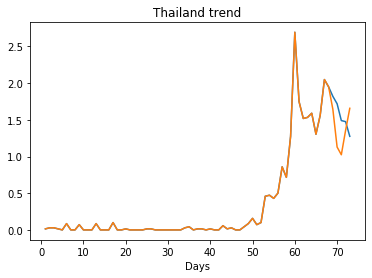

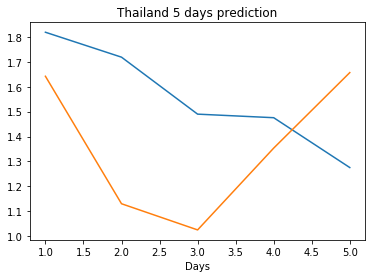

Creating directory ./offline6/Vietnam/training/
Vietnam
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0159
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0086


/space/home/nzhang/anaconda3/envs/neuralnet/lib/python3.7/site-packages/torch/nn/modules/loss.py:431: UserWarning: Using a target size (torch.Size([1, 1, 5])) that is different to the input size (torch.Size([5])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/space/home/nzhang/anaconda3/envs/neuralnet/lib/python3.7/site-packages/torch/nn/modules/loss.py:431: UserWarning: Using a target size (torch.Size([1, 5])) that is different to the input size (torch.Size([5])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Saving the best model weights at Epoch [3], Best Valid Loss: 0.0082
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0073
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0071
train error: 0.0027582720598533146
0.00713458051905036
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0083
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0063
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0053
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0053
train error: 0.0025241462957441203
0.0052517978474497795
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0040
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0027
train error: 0.002196589403792058
0.0026724697090685368
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0060
train error: 0.002450600328597215
0.005983798764646053
Saving the best model wei

Saving the best model weights at Epoch [29], Best Valid Loss: 0.0057
train error: 0.002678385265549091
0.0056642391718924046
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0040
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0033
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0015
train error: 0.0029783020766665906
0.0015261606313288212
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0098
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0088
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0078
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0075
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0070
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0070
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0069
Saving the best model weights at Epoch [24], Best Valid Loss: 0.006

train error: 0.002717223490361829
0.005765584763139486
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0146
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0098
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0081
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0076
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0036
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0027
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0024
train error: 0.002970768011338707
0.002374904230237007
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0079
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0075
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0071
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0069
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0068


Saving the best model weights at Epoch [2], Best Valid Loss: 0.0073
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0071
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0065
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0059
train error: 0.002626310898670675
0.0059248292818665504
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0124
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0089
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0077
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0046
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0038
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0036
train error: 0.0028815293760114423
0.0036141134332865477
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0206
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0167


Saving the best model weights at Epoch [16], Best Valid Loss: 0.0086
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0086
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0086
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0086
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0085
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0085
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0085
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0085
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0085
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0085
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0085
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0085
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0085
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0085
train error: 0.0025719580731379823

Saving the best model weights at Epoch [4], Best Valid Loss: 0.0125
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0113
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0098
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0093
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0089
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0087
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0085
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0083
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0082
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0081
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0081
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0080
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0080
Saving the best model weights at Epoch [

train error: 0.0025418338128302648
0.007080423180013895
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0284
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0236
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0200
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0173
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0153
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0137
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0124
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0115
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0108
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0102
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0097
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0094
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0091
Saving the best model weights at Epoch [14], Best Valid 

Saving the best model weights at Epoch [2], Best Valid Loss: 0.0077
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0073
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0071
train error: 0.0025473885408074065
0.007098314352333546
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0582
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0458
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0367
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0300
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0249
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0211
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0183
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0161
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0144
Saving the best model weights at Epoch [10], Best Valid Los

Saving the best model weights at Epoch [30], Best Valid Loss: 0.0077
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0077
train error: 0.0025305383731736926
0.00765572814270854
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0086
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0075
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0075
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0073
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0071
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0070
train error: 0.0025929533357329265
0.007016082294285297
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0261
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0219
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0187
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0163


Saving the best model weights at Epoch [31], Best Valid Loss: 0.0076
train error: 0.0025310481354166325
0.007649767678231001
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0091
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0079
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0075
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0070
train error: 0.0026675241580862248
0.0070106349885463715
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0158
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0120
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0095
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0079
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0070
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0065
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0062
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0061
tr

Saving the best model weights at Epoch [22], Best Valid Loss: 0.0080
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0079
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0079
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0078
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0078
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0078
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0078
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0078
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0078
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0078
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0078
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0078
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0077
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0077
Saving the best model weights at E

Saving the best model weights at Epoch [2], Best Valid Loss: 0.0224
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0158
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0121
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0103
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0092
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0084
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0081
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0080
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0079
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0078
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0078
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0078
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0077
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0077
Saving the best model weights at Epoch [20

Saving the best model weights at Epoch [2], Best Valid Loss: 0.0069
train error: 0.00254862623704547
0.006942188832908869
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0284
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0240
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0205
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0179
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0159
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0143
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0131
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0120
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0112
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0106
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0101
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0097
Saving the best model weights at Epoch [13], Best Valid Los

Saving the best model weights at Epoch [10], Best Valid Loss: 0.0097
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0092
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0088
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0084
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0081
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0078
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0075
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0070
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0064
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0063
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0061
Saving the best model weights at E

Saving the best model weights at Epoch [25], Best Valid Loss: 0.0105
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0103
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0102
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0100
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0099
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0097
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0096
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0094
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0093
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0092
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0091
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0090
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0089
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0088
Saving the best model weights at E

Saving the best model weights at Epoch [7], Best Valid Loss: 0.0106
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0105
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0103
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0101
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0100
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0098
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0097
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0096
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0095
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0094
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0093
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0092
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0091
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0090
Saving the best model weights at Epoc

Saving the best model weights at Epoch [45], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0126
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0125
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0124
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0122
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0121
train error: 0.003922373706135093
0.012134569697082043
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0273
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0265
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0257
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0250
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0243
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0236
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0229
Saving the best model weights at Epoch [8], Best Valid 

Saving the best model weights at Epoch [38], Best Valid Loss: 0.0055
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0054
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0054
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0054
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0053
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0053
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0053
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0052
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0052
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0052
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0052
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0052
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0052
train error: 0.005379958830245242
0.005171406082808971
Saving the best model weights at Epoch [1], Best

Saving the best model weights at Epoch [23], Best Valid Loss: 0.0179
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0176
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0173
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0171
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0168
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0166
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0163
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0161
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0158
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0156
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0154
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0152
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0150
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0148
Saving the best model weights at E

Saving the best model weights at Epoch [9], Best Valid Loss: 0.0265
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0260
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0256
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0252
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0248
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0244
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0240
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0236
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0232
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0229
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0225
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0222
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0219
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0215
Saving the best model weights at Ep

Saving the best model weights at Epoch [32], Best Valid Loss: 0.0077
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0076
train error: 0.0025159171011575774
0.007621328812092543
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0223
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0220
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0216
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0213
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0210
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0206
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0203
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0200
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0197
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0194
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0191
Saving the best model weights at Epoch [12], Best Valid 

Saving the best model weights at Epoch [17], Best Valid Loss: 0.0082
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0080
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0079
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0078
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0078
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0077
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0077
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0077
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0077
train error: 0.0025204867659438706
0.007653625216335058
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0084
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0079
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0075
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0071
Saving the best model weights at Epoch [5], Best Va

Saving the best model weights at Epoch [16], Best Valid Loss: 0.0092
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0090
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0087
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0085
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0083
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0083
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0081
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0080
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0080
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0079
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0078
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0078
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0077
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0077
Saving the best model weights at E

Saving the best model weights at Epoch [3], Best Valid Loss: 0.0286
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0243
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0210
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0185
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0165
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0148
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0135
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0125
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0118
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0110
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0105
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0099
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0097
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0093
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [38], Best Valid Loss: 0.0126
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0124
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0122
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0121
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0119
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0117
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0116
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0114
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0113
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0112
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0110
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0108
train error: 0.003016036036864829
0.010789613239467144
Saving the best model weights at Epoch [1], Best

Saving the best model weights at Epoch [28], Best Valid Loss: 0.0112
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0111
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0108
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0107
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0106
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0105
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0103
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0102
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0102
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0100
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0100
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0099
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0098
Saving the best model weights at E

Saving the best model weights at Epoch [14], Best Valid Loss: 0.0256
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0243
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0231
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0219
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0208
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0198
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0189
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0180
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0172
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0164
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0157
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0151
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0145
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0139
Saving the best model weights at E

Saving the best model weights at Epoch [20], Best Valid Loss: 0.0105
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0103
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0101
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0099
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0098
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0096
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0094
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0093
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0092
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0090
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0089
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0088
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0087
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0086
Saving the best model weights at E

Saving the best model weights at Epoch [8], Best Valid Loss: 0.0124
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0122
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0119
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0117
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0115
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0113
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0111
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0110
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0108
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0106
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0105
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0102
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0101
Saving the best model weights at Epo

Saving the best model weights at Epoch [50], Best Valid Loss: 0.0099
train error: 0.002868210942471853
0.009926055558025837
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0232
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0226
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0220
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0214
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0209
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0204
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0199
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0194
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0190
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0185
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0181
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0177
Saving the best model weights at Epoch [13], Best Valid L

Saving the best model weights at Epoch [47], Best Valid Loss: 0.0335
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0328
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0321
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0315
train error: 0.016296346973929857
0.03148771449923515
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0295
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0282
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0270
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0259
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0248
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0238
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0228
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0219
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0211
Saving the best model weights at Epoch [10], Best Valid Lo

Saving the best model weights at Epoch [32], Best Valid Loss: 0.0258
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0254
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0250
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0246
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0242
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0238
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0235
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0231
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0228
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0224
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0221
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0218
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0215
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0212
Saving the best model weights at E

Saving the best model weights at Epoch [12], Best Valid Loss: 0.0175
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0170
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0166
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0162
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0158
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0154
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0151
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0147
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0144
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0141
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0138
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0135
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0133
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0130
Saving the best model weights at E

Saving the best model weights at Epoch [50], Best Valid Loss: 0.0125
train error: 0.0037208792196611897
0.012489436194300652
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0089
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0088
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0087
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0086
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0085
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0085
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0084
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0084
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0083
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0083
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0082
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0082
Saving the best model weights at Epoch [13], Best Valid 

Saving the best model weights at Epoch [42], Best Valid Loss: 0.0781
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0779
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0777
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0775
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0772
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0770
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0768
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0766
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0764
train error: 0.049974906484822966
0.0763997957110405
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0383
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0381
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0379
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0378
Saving the best model weights at Epoch [5], Best Valid

Saving the best model weights at Epoch [10], Best Valid Loss: 0.0426
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0425
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0424
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0423
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0422
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0421
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0421
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0420
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0419
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0418
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0417
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0416
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0415
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0414
Saving the best model weights at E

Saving the best model weights at Epoch [30], Best Valid Loss: 0.0183
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0180
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0177
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0174
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0171
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0168
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0166
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0163
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0160
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0158
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0156
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0153
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0151
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0149
Saving the best model weights at E

Saving the best model weights at Epoch [50], Best Valid Loss: 0.0183
train error: 0.00890758351699726
0.018295127898454666
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0194
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0191
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0188
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0183
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0181
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0178
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0176
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0173
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0171
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0169
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0167
Saving the best model weights at Epoch [13], Best Valid Lo

Saving the best model weights at Epoch [17], Best Valid Loss: 0.0178
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0177
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0177
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0176
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0176
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0175
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0175
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0175
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0174
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0174
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0173
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0173
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0173
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0172
Saving the best model weights at E

Saving the best model weights at Epoch [37], Best Valid Loss: 0.0448
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0446
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0445
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0444
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0442
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0441
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0440
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0438
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0437
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0436
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0435
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0433
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0432
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0431
train error: 0.03839357680565602
0

Saving the best model weights at Epoch [4], Best Valid Loss: 0.0331
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0330
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0329
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0329
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0328
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0327
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0326
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0326
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0325
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0324
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0323
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0323
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0322
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0321
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [24], Best Valid Loss: 0.0154
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0152
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0150
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0148
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0146
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0145
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0143
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0141
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0139
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0138
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0136
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0134
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0133
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0131
Saving the best model weights at E

Saving the best model weights at Epoch [44], Best Valid Loss: 0.0248
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0247
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0247
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0246
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0245
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0244
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0244
train error: 0.009714393058439364
0.024352824315428734
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0085
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0084
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0083
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0083
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0082
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0081
Saving the best model weights at Epoch [7], Best Valid

Saving the best model weights at Epoch [13], Best Valid Loss: 0.0253
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0252
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0252
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0251
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0250
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0249
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0249
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0248
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0247
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0246
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0246
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0245
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0244
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0243
Saving the best model weights at E

Saving the best model weights at Epoch [32], Best Valid Loss: 0.0441
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0439
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0437
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0436
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0434
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0432
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0431
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0429
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0427
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0426
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0424
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0422
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0421
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0419
Saving the best model weights at E

Saving the best model weights at Epoch [4], Best Valid Loss: 0.0409
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0408
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0407
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0406
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0405
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0404
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0403
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0402
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0402
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0401
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0400
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0399
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0398
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0397
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [22], Best Valid Loss: 0.0239
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0236
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0232
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0229
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0225
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0222
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0219
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0216
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0213
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0210
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0207
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0204
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0202
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0199
Saving the best model weights at E

Saving the best model weights at Epoch [41], Best Valid Loss: 0.0315
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0314
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0313
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0312
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0311
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0310
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0309
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0308
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0307
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0306
train error: 0.012849838988905822
0.030555278062820435
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0071
Saving the best model weights at Epoch [4], Best Va

Saving the best model weights at Epoch [28], Best Valid Loss: 0.0360
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0359
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0358
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0356
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0355
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0354
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0353
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0351
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0350
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0349
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0348
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0346
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0345
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0344
Saving the best model weights at E

Saving the best model weights at Epoch [46], Best Valid Loss: 0.0560
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0558
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0557
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0555
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0554
train error: 0.038299270276282285
0.055371638387441635
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0573
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0571
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0568
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0566
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0563
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0561
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0558
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0556
Saving the best model weights at Epoch [9], Best Valid L

Saving the best model weights at Epoch [14], Best Valid Loss: 0.0149
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0149
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0148
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0148
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0148
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0147
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0147
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0147
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0146
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0146
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0146
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0145
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0145
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0145
Saving the best model weights at E

Saving the best model weights at Epoch [32], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0103
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0103
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0102
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0102
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0101
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0101
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0100
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0100
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0099
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0099
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0098
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0098
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0097
Saving the best model weights at E

Saving the best model weights at Epoch [50], Best Valid Loss: 0.0271
train error: 0.010558287222945207
0.027119362726807594
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0051
train error: 0.002905498492386746
0.005107253324240446
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0204
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0204
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0204
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0203
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0203
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0203
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0202
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0202
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0202
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0201
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0201
Sav

Saving the best model weights at Epoch [16], Best Valid Loss: 0.0212
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0209
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0206
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0204
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0201
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0198
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0196
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0193
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0191
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0189
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0184
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0182
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0180
Saving the best model weights at E

Saving the best model weights at Epoch [34], Best Valid Loss: 0.0168
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0168
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0167
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0166
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0165
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0164
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0164
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0163
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0162
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0161
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0161
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0160
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0159
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0159
Saving the best model weights at E

Saving the best model weights at Epoch [2], Best Valid Loss: 0.0319
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0318
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0316
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0315
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0314
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0313
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0311
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0310
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0309
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0308
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0307
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0306
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0304
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0303
Saving the best model weights at Epoch [16

Saving the best model weights at Epoch [20], Best Valid Loss: 0.0417
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0417
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0416
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0415
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0414
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0413
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0412
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0411
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0410
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0409
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0408
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0408
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0407
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0406
Saving the best model weights at E

Saving the best model weights at Epoch [38], Best Valid Loss: 0.0135
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0134
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0133
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0132
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0130
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0129
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0129
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0126
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0126
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0125
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0124
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0123
train error: 0.003435085979101525
0.012276479974389076
Saving the best model weights at Epoch [1], Best

Saving the best model weights at Epoch [9], Best Valid Loss: 0.0071
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0071
train error: 0.002712014365258526
0.007070727180689573
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0689
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0688
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0688
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0688
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0688
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0688
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0687
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0687
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0687
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0687
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0687
Saving the best model weights at Epoch [12], Best Valid Lo

Saving the best model weights at Epoch [16], Best Valid Loss: 0.0484
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0482
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0481
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0479
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0478
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0477
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0475
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0474
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0473
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0471
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0470
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0469
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0467
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0466
Saving the best model weights at E

Saving the best model weights at Epoch [35], Best Valid Loss: 0.0091
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0091
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0091
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0091
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0091
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0091
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0091
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0091
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0091
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0091
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0091
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0091
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0091
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0091
Saving the best model weights at E

Saving the best model weights at Epoch [1], Best Valid Loss: 0.0125
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0124
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0124
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0124
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0124
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0124
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0124
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0124
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0124
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0124
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0123
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0123
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0123
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0123
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [21], Best Valid Loss: 0.0202
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0202
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0202
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0202
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0202
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0202
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0202
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0202
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0202
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0202
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0202
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0202
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0202
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0201
Saving the best model weights at E

Saving the best model weights at Epoch [41], Best Valid Loss: 0.0846
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0846
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0846
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0846
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0845
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0845
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0845
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0845
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0844
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0844
train error: 0.054529991101574256
0.08441491425037384
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0458
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0458
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0458
Saving the best model weights at Epoch [4], Best Val

Saving the best model weights at Epoch [8], Best Valid Loss: 0.0320
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0320
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0320
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0320
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0320
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0320
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0320
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0320
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0320
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0320
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0320
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0320
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0320
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0320
Saving the best model weights at Epo

Saving the best model weights at Epoch [28], Best Valid Loss: 0.0345
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0344
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0344
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0343
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0342
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0342
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0341
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0340
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0340
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0339
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0338
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0338
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0337
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0336
Saving the best model weights at E

Saving the best model weights at Epoch [47], Best Valid Loss: 0.0262
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0262
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0262
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0262
train error: 0.009806338269766924
0.02620123326778412
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0190
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0189
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0189
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0189
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0188
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0188
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0188
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0188
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0187
Saving the best model weights at Epoch [10], Best Valid Lo

Saving the best model weights at Epoch [16], Best Valid Loss: 0.0159
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0159
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0159
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0159
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0159
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0159
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0159
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0159
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0159
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0159
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0159
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0159
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0159
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0159
Saving the best model weights at E

Saving the best model weights at Epoch [35], Best Valid Loss: 0.0500
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0500
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0500
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0500
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0500
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0500
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0500
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0499
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0499
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0499
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0499
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0499
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0499
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0499
Saving the best model weights at E

Saving the best model weights at Epoch [3], Best Valid Loss: 0.0339
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0339
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0339
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0339
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0339
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0338
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0338
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0338
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0338
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0338
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0338
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0338
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0338
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0338
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [21], Best Valid Loss: 0.0128
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0128
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0128
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0126
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0126
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0126
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0126
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0125
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0125
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0125
Saving the best model weights at E

Saving the best model weights at Epoch [39], Best Valid Loss: 0.0200
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0200
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0200
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0200
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0200
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0199
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0199
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0199
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0199
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0199
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0199
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0199
train error: 0.01062299297317057
0.01990620791912079
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0157
Saving the best model weights at Epoch [2], Best Va

Saving the best model weights at Epoch [4], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0103
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0103
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0103
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0103
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0103
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0103
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [22], Best Valid Loss: 0.0535
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0535
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0534
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0534
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0534
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0534
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0533
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0533
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0533
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0533
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0532
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0532
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0532
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0531
Saving the best model weights at E

Saving the best model weights at Epoch [40], Best Valid Loss: 0.0345
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0345
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0345
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0345
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0345
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0345
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0344
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0344
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0344
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0344
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0344
train error: 0.016488788020167802
0.034419041126966476
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0214
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0214
Saving the best model weights at Epoch [3], Best V

Saving the best model weights at Epoch [8], Best Valid Loss: 0.0359
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0359
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0359
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0359
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0359
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0359
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0359
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0359
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0359
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0359
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0359
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0359
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0358
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0358
Saving the best model weights at Epo

Saving the best model weights at Epoch [26], Best Valid Loss: 0.0216
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0216
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0216
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0215
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0215
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0215
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0214
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0214
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0214
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0213
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0213
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0213
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0212
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0212
Saving the best model weights at E

Saving the best model weights at Epoch [44], Best Valid Loss: 0.0283
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0283
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0283
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0283
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0283
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0283
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0283
train error: 0.011564453497428346
0.02826407551765442
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0210
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0209
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0209
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0209
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0208
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0208
Saving the best model weights at Epoch [7], Best Valid 

Saving the best model weights at Epoch [12], Best Valid Loss: 0.0132
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0132
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0132
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0132
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0132
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0132
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0132
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0132
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0132
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0132
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0132
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0132
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0132
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0132
Saving the best model weights at E

Saving the best model weights at Epoch [30], Best Valid Loss: 0.0671
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0670
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0670
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0670
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0670
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0670
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0670
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0670
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0669
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0669
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0669
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0669
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0669
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0669
Saving the best model weights at E

Saving the best model weights at Epoch [48], Best Valid Loss: 0.0117
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0117
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0116
train error: 0.009223303531070013
0.01164040807634592
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0189
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0189
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0189
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0189
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0189
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0189
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0189
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0189
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0189
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0189
Saving the best model weights at Epoch [11], Best Valid Lo

Saving the best model weights at Epoch [16], Best Valid Loss: 0.0262
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0261
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0261
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0261
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0260
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0260
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0259
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0259
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0258
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0258
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0257
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0257
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0257
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0256
Saving the best model weights at E

Saving the best model weights at Epoch [34], Best Valid Loss: 0.0103
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0103
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0103
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0103
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0103
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0103
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0103
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0103
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0103
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0103
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0103
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0103
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0103
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0103
Saving the best model weights at E

Saving the best model weights at Epoch [1], Best Valid Loss: 0.1056
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1056
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1056
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1056
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1056
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1056
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1056
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1056
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1056
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1056
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1056
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1056
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1056
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1056
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [21], Best Valid Loss: 0.0340
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0340
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0340
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0340
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0340
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0340
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0340
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0340
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0340
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0340
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0340
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0340
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0340
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0340
Saving the best model weights at E

Saving the best model weights at Epoch [41], Best Valid Loss: 0.0341
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0341
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0341
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0341
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0341
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0341
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0341
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0341
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0341
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0341
train error: 0.01985924882260529
0.03405104950070381
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0320
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0320
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0320
Saving the best model weights at Epoch [4], Best Vali

Saving the best model weights at Epoch [11], Best Valid Loss: 0.0361
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0361
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0361
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0361
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0361
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0361
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0360
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0360
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0360
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0360
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0360
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0360
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0360
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0360
Saving the best model weights at E

Saving the best model weights at Epoch [29], Best Valid Loss: 0.0191
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0191
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0191
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0191
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0191
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0191
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0191
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0191
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0191
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0191
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0191
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0191
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0191
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0191
Saving the best model weights at E

Saving the best model weights at Epoch [49], Best Valid Loss: 0.0498
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0498
train error: 0.0415338366921689
0.04975896701216698
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0312
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0312
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0312
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0312
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0312
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0312
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0312
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0312
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0312
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0312
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0312
Saving the best model weights at Epoch [12], Best Valid Loss

Saving the best model weights at Epoch [16], Best Valid Loss: 0.0448
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0448
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0448
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0448
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0448
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0448
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0448
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0448
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0448
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0448
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0448
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0448
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0448
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0448
Saving the best model weights at E

Saving the best model weights at Epoch [36], Best Valid Loss: 0.0535
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0535
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0535
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0535
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0535
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0535
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0534
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0534
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0534
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0534
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0534
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0534
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0534
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0534
Saving the best model weights at E

Saving the best model weights at Epoch [3], Best Valid Loss: 0.0353
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0353
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0353
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0353
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0353
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0353
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0353
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0353
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0353
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0352
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0352
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0352
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0352
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0352
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [23], Best Valid Loss: 0.0223
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0223
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0223
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0223
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0223
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0223
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0223
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0223
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0223
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0223
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0223
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0223
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0223
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0223
Saving the best model weights at E

Saving the best model weights at Epoch [41], Best Valid Loss: 0.0147
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0147
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0147
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0147
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0147
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0147
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0147
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0147
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0147
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0147
train error: 0.01118841821428489
0.014719692058861256
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0648
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0648
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0648
Saving the best model weights at Epoch [4], Best Val

Saving the best model weights at Epoch [9], Best Valid Loss: 0.0171
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0171
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0171
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0171
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0171
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0171
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0171
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0171
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0171
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0171
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0171
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0171
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0171
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0171
Saving the best model weights at Ep

Saving the best model weights at Epoch [27], Best Valid Loss: 0.0154
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0154
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0154
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0154
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0154
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0154
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0154
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0154
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0154
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0154
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0154
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0154
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0154
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0154
Saving the best model weights at E

Saving the best model weights at Epoch [45], Best Valid Loss: 0.0310
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0310
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0310
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0310
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0310
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0310
train error: 0.014607439270696125
0.031034236773848534
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0267
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0266
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0266
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0266
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0266
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0266
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0266
Saving the best model weights at Epoch [8], Best Valid 

Saving the best model weights at Epoch [12], Best Valid Loss: 0.0347
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0347
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0347
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0347
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0347
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0347
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0347
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0347
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0347
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0347
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0347
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0347
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0347
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0347
Saving the best model weights at E

Saving the best model weights at Epoch [31], Best Valid Loss: 0.0359
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0359
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0359
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0359
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0359
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0359
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0359
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0359
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0359
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0359
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0359
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0359
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0359
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0359
Saving the best model weights at E

Saving the best model weights at Epoch [49], Best Valid Loss: 0.0967
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0967
train error: 0.0543119350599276
0.09666758030653
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0171
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0171
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0171
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0171
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0171
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0171
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0171
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0171
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0171
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0171
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0171
Saving the best model weights at Epoch [12], Best Valid Loss: 0

Saving the best model weights at Epoch [17], Best Valid Loss: 0.0267
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0267
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0267
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0267
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0267
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0267
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0267
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0267
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0267
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0267
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0267
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0267
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0267
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0267
Saving the best model weights at E

Saving the best model weights at Epoch [35], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0186
Saving the best model weights at E

Saving the best model weights at Epoch [3], Best Valid Loss: 0.0168
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0168
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0168
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0168
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0168
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0168
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0167
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0167
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0167
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0167
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0167
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0167
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0167
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0167
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [21], Best Valid Loss: 0.0358
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0358
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0358
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0358
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0358
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0358
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0358
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0358
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0358
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0358
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0358
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0358
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0358
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0358
Saving the best model weights at E

Saving the best model weights at Epoch [39], Best Valid Loss: 0.0330
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0330
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0329
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0329
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0329
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0329
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0329
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0329
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0329
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0329
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0329
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0329
train error: 0.03748976398964186
0.03285467252135277
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0206
Saving the best model weights at Epoch [2], Best Va

Saving the best model weights at Epoch [7], Best Valid Loss: 0.0243
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0243
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0243
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0243
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0243
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0243
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0243
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0243
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0243
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0243
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0243
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0243
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0243
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0243
Saving the best model weights at Epoc

Saving the best model weights at Epoch [25], Best Valid Loss: 0.0319
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0319
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0319
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0319
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0319
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0319
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0319
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0319
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0319
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0319
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0319
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0319
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0319
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0319
Saving the best model weights at E

Saving the best model weights at Epoch [43], Best Valid Loss: 0.0163
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0163
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0163
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0163
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0163
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0163
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0163
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0163
train error: 0.006768054876325501
0.016287129372358322
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0174
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0174
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0174
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0174
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0174
Saving the best model weights at Epoch [6], Best Vali

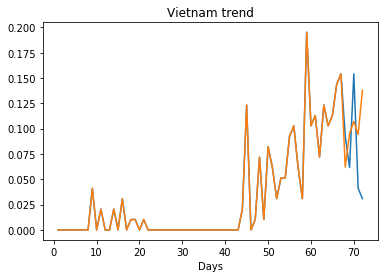

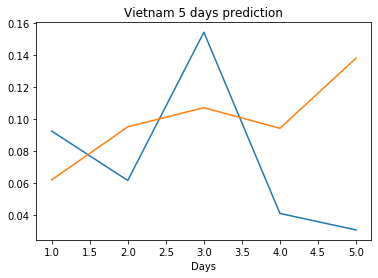

Creating directory ./offline6/Russia/training/
Russia
Saving the best model weights at Epoch [1], Best Valid Loss: 2.0334
Saving the best model weights at Epoch [2], Best Valid Loss: 1.9750
Saving the best model weights at Epoch [3], Best Valid Loss: 1.9369


/space/home/nzhang/anaconda3/envs/neuralnet/lib/python3.7/site-packages/torch/nn/modules/loss.py:431: UserWarning: Using a target size (torch.Size([1, 1, 5])) that is different to the input size (torch.Size([5])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/space/home/nzhang/anaconda3/envs/neuralnet/lib/python3.7/site-packages/torch/nn/modules/loss.py:431: UserWarning: Using a target size (torch.Size([1, 5])) that is different to the input size (torch.Size([5])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Saving the best model weights at Epoch [4], Best Valid Loss: 1.8434
Saving the best model weights at Epoch [5], Best Valid Loss: 1.7592
Saving the best model weights at Epoch [8], Best Valid Loss: 1.7379
Saving the best model weights at Epoch [9], Best Valid Loss: 1.6934
Saving the best model weights at Epoch [10], Best Valid Loss: 1.6219
Saving the best model weights at Epoch [11], Best Valid Loss: 1.4435
Saving the best model weights at Epoch [13], Best Valid Loss: 1.4331
Saving the best model weights at Epoch [14], Best Valid Loss: 1.3793
Saving the best model weights at Epoch [15], Best Valid Loss: 1.2557
Saving the best model weights at Epoch [16], Best Valid Loss: 1.0606
Saving the best model weights at Epoch [17], Best Valid Loss: 0.9623
Saving the best model weights at Epoch [18], Best Valid Loss: 0.8730
Saving the best model weights at Epoch [19], Best Valid Loss: 0.6599
Saving the best model weights at Epoch [20], Best Valid Loss: 0.6016
Saving the best model weights at Epoch

Saving the best model weights at Epoch [13], Best Valid Loss: 0.3427
Saving the best model weights at Epoch [14], Best Valid Loss: 0.2880
Saving the best model weights at Epoch [15], Best Valid Loss: 0.2008
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1196
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0948
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0659
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0634
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0519
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0365
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0296
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0289
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0269
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0247
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0235
Saving the best model weights at E

Saving the best model weights at Epoch [28], Best Valid Loss: 0.1870
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1354
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1229
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0991
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0831
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0616
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0528
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0500
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0447
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0348
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0334
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0329
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0298
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0286
Saving the best model weights at E

Saving the best model weights at Epoch [3], Best Valid Loss: 1.9862
Saving the best model weights at Epoch [10], Best Valid Loss: 1.2832
Saving the best model weights at Epoch [14], Best Valid Loss: 0.8876
Saving the best model weights at Epoch [15], Best Valid Loss: 0.5854
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1945
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0416
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0359
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0254
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0169
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0155
train error: 0.015260664268461024
0.015519536100327969
Saving the best model weights at Epoch [1], Best Valid Loss: 1.9771
Saving the best model weights at Epoch [3], Best Valid Loss: 1.9482
Saving the best model weights at Epoch [4], Best Valid Loss: 1.8868
Saving the best model weights at Epoch [6], Best Val

Saving the best model weights at Epoch [3], Best Valid Loss: 1.9716
Saving the best model weights at Epoch [5], Best Valid Loss: 1.8819
Saving the best model weights at Epoch [8], Best Valid Loss: 1.3841
Saving the best model weights at Epoch [9], Best Valid Loss: 1.1193
train error: 0.2030813942607171
1.1192549467086792
Saving the best model weights at Epoch [1], Best Valid Loss: 2.1345
Saving the best model weights at Epoch [2], Best Valid Loss: 2.0132
Saving the best model weights at Epoch [3], Best Valid Loss: 1.9694
Saving the best model weights at Epoch [5], Best Valid Loss: 1.8828
Saving the best model weights at Epoch [11], Best Valid Loss: 1.8664
Saving the best model weights at Epoch [12], Best Valid Loss: 1.8525
Saving the best model weights at Epoch [13], Best Valid Loss: 1.8361
Saving the best model weights at Epoch [14], Best Valid Loss: 1.8254
Saving the best model weights at Epoch [22], Best Valid Loss: 1.7885
Saving the best model weights at Epoch [38], Best Valid Loss

Saving the best model weights at Epoch [49], Best Valid Loss: 1.7768
train error: 0.1579727791089179
1.7768419981002808
Saving the best model weights at Epoch [1], Best Valid Loss: 1.8791
Saving the best model weights at Epoch [3], Best Valid Loss: 1.7944
Saving the best model weights at Epoch [4], Best Valid Loss: 1.7868
Saving the best model weights at Epoch [7], Best Valid Loss: 1.6396
train error: 0.15769030251700816
1.6395683288574219
Saving the best model weights at Epoch [1], Best Valid Loss: 1.9942
Saving the best model weights at Epoch [3], Best Valid Loss: 1.7850
Saving the best model weights at Epoch [6], Best Valid Loss: 1.5441
Saving the best model weights at Epoch [18], Best Valid Loss: 1.1773
train error: 0.1658889120364369
1.1772879362106323
Saving the best model weights at Epoch [1], Best Valid Loss: 2.1684
Saving the best model weights at Epoch [2], Best Valid Loss: 2.0150
Saving the best model weights at Epoch [3], Best Valid Loss: 1.9659
Saving the best model weight

Saving the best model weights at Epoch [6], Best Valid Loss: 2.0245
Saving the best model weights at Epoch [7], Best Valid Loss: 1.9919
Saving the best model weights at Epoch [8], Best Valid Loss: 1.9530
Saving the best model weights at Epoch [9], Best Valid Loss: 1.9279
Saving the best model weights at Epoch [10], Best Valid Loss: 1.9096
Saving the best model weights at Epoch [11], Best Valid Loss: 1.8977
Saving the best model weights at Epoch [12], Best Valid Loss: 1.8880
Saving the best model weights at Epoch [13], Best Valid Loss: 1.8867
Saving the best model weights at Epoch [14], Best Valid Loss: 1.8729
Saving the best model weights at Epoch [15], Best Valid Loss: 1.8638
Saving the best model weights at Epoch [17], Best Valid Loss: 1.8579
Saving the best model weights at Epoch [18], Best Valid Loss: 1.8559
Saving the best model weights at Epoch [20], Best Valid Loss: 1.8474
Saving the best model weights at Epoch [22], Best Valid Loss: 1.8333
Saving the best model weights at Epoch

Saving the best model weights at Epoch [44], Best Valid Loss: 1.8021
Saving the best model weights at Epoch [45], Best Valid Loss: 1.7994
Saving the best model weights at Epoch [46], Best Valid Loss: 1.7982
Saving the best model weights at Epoch [47], Best Valid Loss: 1.7959
Saving the best model weights at Epoch [48], Best Valid Loss: 1.7927
Saving the best model weights at Epoch [49], Best Valid Loss: 1.7906
Saving the best model weights at Epoch [50], Best Valid Loss: 1.7881
train error: 0.14141236708082003
1.7881191968917847
Saving the best model weights at Epoch [1], Best Valid Loss: 2.6303
Saving the best model weights at Epoch [2], Best Valid Loss: 2.4529
Saving the best model weights at Epoch [3], Best Valid Loss: 2.3023
Saving the best model weights at Epoch [4], Best Valid Loss: 2.1987
Saving the best model weights at Epoch [5], Best Valid Loss: 2.1209
Saving the best model weights at Epoch [6], Best Valid Loss: 2.0578
Saving the best model weights at Epoch [7], Best Valid Lo

Saving the best model weights at Epoch [30], Best Valid Loss: 1.8609
Saving the best model weights at Epoch [31], Best Valid Loss: 1.8575
Saving the best model weights at Epoch [32], Best Valid Loss: 1.8530
Saving the best model weights at Epoch [33], Best Valid Loss: 1.8517
Saving the best model weights at Epoch [34], Best Valid Loss: 1.8494
Saving the best model weights at Epoch [35], Best Valid Loss: 1.8469
Saving the best model weights at Epoch [36], Best Valid Loss: 1.8431
Saving the best model weights at Epoch [37], Best Valid Loss: 1.8398
Saving the best model weights at Epoch [38], Best Valid Loss: 1.8381
Saving the best model weights at Epoch [39], Best Valid Loss: 1.8356
Saving the best model weights at Epoch [40], Best Valid Loss: 1.8326
Saving the best model weights at Epoch [41], Best Valid Loss: 1.8299
Saving the best model weights at Epoch [42], Best Valid Loss: 1.8245
Saving the best model weights at Epoch [43], Best Valid Loss: 1.8213
Saving the best model weights at E

Saving the best model weights at Epoch [13], Best Valid Loss: 1.9785
Saving the best model weights at Epoch [14], Best Valid Loss: 1.9645
Saving the best model weights at Epoch [15], Best Valid Loss: 1.9522
Saving the best model weights at Epoch [16], Best Valid Loss: 1.9413
Saving the best model weights at Epoch [17], Best Valid Loss: 1.9300
Saving the best model weights at Epoch [18], Best Valid Loss: 1.9205
Saving the best model weights at Epoch [19], Best Valid Loss: 1.9094
Saving the best model weights at Epoch [20], Best Valid Loss: 1.9022
Saving the best model weights at Epoch [21], Best Valid Loss: 1.8948
Saving the best model weights at Epoch [22], Best Valid Loss: 1.8876
Saving the best model weights at Epoch [23], Best Valid Loss: 1.8794
Saving the best model weights at Epoch [24], Best Valid Loss: 1.8744
Saving the best model weights at Epoch [25], Best Valid Loss: 1.8706
Saving the best model weights at Epoch [26], Best Valid Loss: 1.8658
Saving the best model weights at E

Saving the best model weights at Epoch [44], Best Valid Loss: 0.0337
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0321
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0278
train error: 0.011608570090551251
0.027814209461212158
Saving the best model weights at Epoch [1], Best Valid Loss: 2.3181
Saving the best model weights at Epoch [2], Best Valid Loss: 2.2640
Saving the best model weights at Epoch [3], Best Valid Loss: 2.2190
Saving the best model weights at Epoch [4], Best Valid Loss: 2.1800
Saving the best model weights at Epoch [5], Best Valid Loss: 2.1481
Saving the best model weights at Epoch [6], Best Valid Loss: 2.1191
Saving the best model weights at Epoch [7], Best Valid Loss: 2.0940
Saving the best model weights at Epoch [8], Best Valid Loss: 2.0733
Saving the best model weights at Epoch [9], Best Valid Loss: 2.0537
Saving the best model weights at Epoch [10], Best Valid Loss: 2.0362
Saving the best model weights at Epoch [11], Best Valid L

Saving the best model weights at Epoch [48], Best Valid Loss: 1.9004
train error: 0.15085243432108184
1.9004032611846924
Saving the best model weights at Epoch [1], Best Valid Loss: 2.1994
Saving the best model weights at Epoch [2], Best Valid Loss: 1.8683
Saving the best model weights at Epoch [3], Best Valid Loss: 1.8583
Saving the best model weights at Epoch [8], Best Valid Loss: 1.8374
Saving the best model weights at Epoch [16], Best Valid Loss: 1.7976
Saving the best model weights at Epoch [42], Best Valid Loss: 1.7591
train error: 0.15050989979123375
1.7590833902359009
Saving the best model weights at Epoch [1], Best Valid Loss: 2.6886
Saving the best model weights at Epoch [2], Best Valid Loss: 2.5792
Saving the best model weights at Epoch [3], Best Valid Loss: 2.4842
Saving the best model weights at Epoch [4], Best Valid Loss: 2.4029
Saving the best model weights at Epoch [5], Best Valid Loss: 2.3352
Saving the best model weights at Epoch [6], Best Valid Loss: 2.2786
Saving th

Saving the best model weights at Epoch [3], Best Valid Loss: 2.2235
Saving the best model weights at Epoch [4], Best Valid Loss: 2.1566
Saving the best model weights at Epoch [5], Best Valid Loss: 2.0945
Saving the best model weights at Epoch [6], Best Valid Loss: 2.0533
Saving the best model weights at Epoch [7], Best Valid Loss: 2.0351
Saving the best model weights at Epoch [8], Best Valid Loss: 1.9903
Saving the best model weights at Epoch [9], Best Valid Loss: 1.9780
Saving the best model weights at Epoch [10], Best Valid Loss: 1.9626
Saving the best model weights at Epoch [11], Best Valid Loss: 1.9469
Saving the best model weights at Epoch [12], Best Valid Loss: 1.9427
Saving the best model weights at Epoch [13], Best Valid Loss: 1.9379
Saving the best model weights at Epoch [14], Best Valid Loss: 1.9162
Saving the best model weights at Epoch [15], Best Valid Loss: 1.9149
Saving the best model weights at Epoch [16], Best Valid Loss: 1.9146
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [24], Best Valid Loss: 1.9501
Saving the best model weights at Epoch [25], Best Valid Loss: 1.9454
Saving the best model weights at Epoch [26], Best Valid Loss: 1.9420
Saving the best model weights at Epoch [27], Best Valid Loss: 1.9404
Saving the best model weights at Epoch [28], Best Valid Loss: 1.9351
Saving the best model weights at Epoch [29], Best Valid Loss: 1.9326
Saving the best model weights at Epoch [30], Best Valid Loss: 1.9311
Saving the best model weights at Epoch [31], Best Valid Loss: 1.9279
Saving the best model weights at Epoch [32], Best Valid Loss: 1.9256
Saving the best model weights at Epoch [33], Best Valid Loss: 1.9243
Saving the best model weights at Epoch [34], Best Valid Loss: 1.9233
Saving the best model weights at Epoch [35], Best Valid Loss: 1.9213
Saving the best model weights at Epoch [36], Best Valid Loss: 1.9186
Saving the best model weights at Epoch [37], Best Valid Loss: 1.9162
Saving the best model weights at E

Saving the best model weights at Epoch [9], Best Valid Loss: 2.1420
Saving the best model weights at Epoch [10], Best Valid Loss: 2.1122
Saving the best model weights at Epoch [11], Best Valid Loss: 2.0862
Saving the best model weights at Epoch [12], Best Valid Loss: 2.0627
Saving the best model weights at Epoch [13], Best Valid Loss: 2.0420
Saving the best model weights at Epoch [14], Best Valid Loss: 2.0258
Saving the best model weights at Epoch [15], Best Valid Loss: 2.0106
Saving the best model weights at Epoch [16], Best Valid Loss: 1.9993
Saving the best model weights at Epoch [17], Best Valid Loss: 1.9872
Saving the best model weights at Epoch [18], Best Valid Loss: 1.9780
Saving the best model weights at Epoch [19], Best Valid Loss: 1.9696
Saving the best model weights at Epoch [20], Best Valid Loss: 1.9616
Saving the best model weights at Epoch [21], Best Valid Loss: 1.9562
Saving the best model weights at Epoch [22], Best Valid Loss: 1.9498
Saving the best model weights at Ep

Saving the best model weights at Epoch [21], Best Valid Loss: 1.9070
Saving the best model weights at Epoch [35], Best Valid Loss: 1.9036
Saving the best model weights at Epoch [36], Best Valid Loss: 1.9022
train error: 0.1510328855566231
1.9021679162979126
Saving the best model weights at Epoch [1], Best Valid Loss: 2.0874
Saving the best model weights at Epoch [2], Best Valid Loss: 1.9778
Saving the best model weights at Epoch [3], Best Valid Loss: 1.8743
Saving the best model weights at Epoch [5], Best Valid Loss: 1.8507
Saving the best model weights at Epoch [17], Best Valid Loss: 1.8165
train error: 0.15582033862552508
1.816451072692871
Saving the best model weights at Epoch [1], Best Valid Loss: 2.6080
Saving the best model weights at Epoch [2], Best Valid Loss: 2.5072
Saving the best model weights at Epoch [3], Best Valid Loss: 2.4216
Saving the best model weights at Epoch [4], Best Valid Loss: 2.3486
Saving the best model weights at Epoch [5], Best Valid Loss: 2.2868
Saving the

Saving the best model weights at Epoch [12], Best Valid Loss: 1.9441
Saving the best model weights at Epoch [13], Best Valid Loss: 1.9394
Saving the best model weights at Epoch [14], Best Valid Loss: 1.9300
Saving the best model weights at Epoch [16], Best Valid Loss: 1.9258
Saving the best model weights at Epoch [18], Best Valid Loss: 1.9249
Saving the best model weights at Epoch [19], Best Valid Loss: 1.9181
Saving the best model weights at Epoch [20], Best Valid Loss: 1.9174
Saving the best model weights at Epoch [21], Best Valid Loss: 1.9141
Saving the best model weights at Epoch [22], Best Valid Loss: 1.9081
Saving the best model weights at Epoch [38], Best Valid Loss: 1.8993
train error: 0.15113635002715706
1.899330973625183
Saving the best model weights at Epoch [1], Best Valid Loss: 2.0816
Saving the best model weights at Epoch [2], Best Valid Loss: 2.0337
Saving the best model weights at Epoch [3], Best Valid Loss: 1.8904
Saving the best model weights at Epoch [4], Best Valid 

Saving the best model weights at Epoch [50], Best Valid Loss: 1.9137
train error: 0.15069645197644574
1.9137130975723267
Saving the best model weights at Epoch [1], Best Valid Loss: 2.5353
Saving the best model weights at Epoch [2], Best Valid Loss: 2.3944
Saving the best model weights at Epoch [3], Best Valid Loss: 2.2831
Saving the best model weights at Epoch [4], Best Valid Loss: 2.1993
Saving the best model weights at Epoch [5], Best Valid Loss: 2.1311
Saving the best model weights at Epoch [6], Best Valid Loss: 2.0866
Saving the best model weights at Epoch [7], Best Valid Loss: 2.0420
Saving the best model weights at Epoch [8], Best Valid Loss: 2.0061
Saving the best model weights at Epoch [9], Best Valid Loss: 1.9840
Saving the best model weights at Epoch [10], Best Valid Loss: 1.9704
Saving the best model weights at Epoch [11], Best Valid Loss: 1.9548
Saving the best model weights at Epoch [12], Best Valid Loss: 1.9500
Saving the best model weights at Epoch [13], Best Valid Loss

Saving the best model weights at Epoch [24], Best Valid Loss: 1.9373
Saving the best model weights at Epoch [25], Best Valid Loss: 1.9344
Saving the best model weights at Epoch [26], Best Valid Loss: 1.9311
Saving the best model weights at Epoch [27], Best Valid Loss: 1.9280
Saving the best model weights at Epoch [28], Best Valid Loss: 1.9268
Saving the best model weights at Epoch [29], Best Valid Loss: 1.9254
Saving the best model weights at Epoch [30], Best Valid Loss: 1.9248
Saving the best model weights at Epoch [32], Best Valid Loss: 1.9235
Saving the best model weights at Epoch [33], Best Valid Loss: 1.9229
Saving the best model weights at Epoch [34], Best Valid Loss: 1.9205
Saving the best model weights at Epoch [37], Best Valid Loss: 1.9201
Saving the best model weights at Epoch [38], Best Valid Loss: 1.9187
Saving the best model weights at Epoch [40], Best Valid Loss: 1.9185
Saving the best model weights at Epoch [42], Best Valid Loss: 1.9179
Saving the best model weights at E

Saving the best model weights at Epoch [4], Best Valid Loss: 2.8857
Saving the best model weights at Epoch [5], Best Valid Loss: 2.8693
Saving the best model weights at Epoch [6], Best Valid Loss: 2.8533
Saving the best model weights at Epoch [7], Best Valid Loss: 2.8375
Saving the best model weights at Epoch [8], Best Valid Loss: 2.8217
Saving the best model weights at Epoch [9], Best Valid Loss: 2.8064
Saving the best model weights at Epoch [10], Best Valid Loss: 2.7913
Saving the best model weights at Epoch [11], Best Valid Loss: 2.7766
Saving the best model weights at Epoch [12], Best Valid Loss: 2.7618
Saving the best model weights at Epoch [13], Best Valid Loss: 2.7474
Saving the best model weights at Epoch [14], Best Valid Loss: 2.7333
Saving the best model weights at Epoch [15], Best Valid Loss: 2.7194
Saving the best model weights at Epoch [16], Best Valid Loss: 2.7056
Saving the best model weights at Epoch [17], Best Valid Loss: 2.6922
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [25], Best Valid Loss: 1.8295
Saving the best model weights at Epoch [29], Best Valid Loss: 1.8199
Saving the best model weights at Epoch [30], Best Valid Loss: 1.8145
Saving the best model weights at Epoch [31], Best Valid Loss: 1.8128
Saving the best model weights at Epoch [35], Best Valid Loss: 1.8040
Saving the best model weights at Epoch [36], Best Valid Loss: 1.7953
Saving the best model weights at Epoch [40], Best Valid Loss: 1.7936
Saving the best model weights at Epoch [42], Best Valid Loss: 1.7889
Saving the best model weights at Epoch [43], Best Valid Loss: 1.7812
Saving the best model weights at Epoch [45], Best Valid Loss: 1.7751
Saving the best model weights at Epoch [49], Best Valid Loss: 1.7664
train error: 0.14065779939871922
1.7664356231689453
Saving the best model weights at Epoch [1], Best Valid Loss: 2.8645
Saving the best model weights at Epoch [2], Best Valid Loss: 2.8503
Saving the best model weights at Epoch [3], Best Vali

Saving the best model weights at Epoch [7], Best Valid Loss: 2.2216
Saving the best model weights at Epoch [8], Best Valid Loss: 2.1739
Saving the best model weights at Epoch [9], Best Valid Loss: 2.1480
Saving the best model weights at Epoch [10], Best Valid Loss: 2.1103
Saving the best model weights at Epoch [11], Best Valid Loss: 2.0967
Saving the best model weights at Epoch [12], Best Valid Loss: 2.0715
Saving the best model weights at Epoch [13], Best Valid Loss: 2.0463
Saving the best model weights at Epoch [14], Best Valid Loss: 2.0172
Saving the best model weights at Epoch [15], Best Valid Loss: 1.9949
Saving the best model weights at Epoch [16], Best Valid Loss: 1.9851
Saving the best model weights at Epoch [17], Best Valid Loss: 1.9725
Saving the best model weights at Epoch [18], Best Valid Loss: 1.9571
Saving the best model weights at Epoch [20], Best Valid Loss: 1.9451
Saving the best model weights at Epoch [21], Best Valid Loss: 1.9383
Saving the best model weights at Epoc

Saving the best model weights at Epoch [40], Best Valid Loss: 2.1192
Saving the best model weights at Epoch [41], Best Valid Loss: 2.1115
Saving the best model weights at Epoch [42], Best Valid Loss: 2.1044
Saving the best model weights at Epoch [43], Best Valid Loss: 2.0980
Saving the best model weights at Epoch [44], Best Valid Loss: 2.0925
Saving the best model weights at Epoch [45], Best Valid Loss: 2.0853
Saving the best model weights at Epoch [46], Best Valid Loss: 2.0792
Saving the best model weights at Epoch [47], Best Valid Loss: 2.0738
Saving the best model weights at Epoch [48], Best Valid Loss: 2.0672
Saving the best model weights at Epoch [49], Best Valid Loss: 2.0606
Saving the best model weights at Epoch [50], Best Valid Loss: 2.0564
train error: 0.15417171637367072
2.056359052658081
Saving the best model weights at Epoch [1], Best Valid Loss: 2.4583
Saving the best model weights at Epoch [2], Best Valid Loss: 2.4001
Saving the best model weights at Epoch [3], Best Valid

Saving the best model weights at Epoch [27], Best Valid Loss: 2.2884
Saving the best model weights at Epoch [28], Best Valid Loss: 2.2794
Saving the best model weights at Epoch [29], Best Valid Loss: 2.2675
Saving the best model weights at Epoch [30], Best Valid Loss: 2.2576
Saving the best model weights at Epoch [31], Best Valid Loss: 2.2481
Saving the best model weights at Epoch [32], Best Valid Loss: 2.2389
Saving the best model weights at Epoch [33], Best Valid Loss: 2.2302
Saving the best model weights at Epoch [34], Best Valid Loss: 2.2209
Saving the best model weights at Epoch [35], Best Valid Loss: 2.2119
Saving the best model weights at Epoch [36], Best Valid Loss: 2.2026
Saving the best model weights at Epoch [37], Best Valid Loss: 2.1955
Saving the best model weights at Epoch [38], Best Valid Loss: 2.1865
Saving the best model weights at Epoch [39], Best Valid Loss: 2.1794
Saving the best model weights at Epoch [40], Best Valid Loss: 2.1710
Saving the best model weights at E

Saving the best model weights at Epoch [9], Best Valid Loss: 2.0661
Saving the best model weights at Epoch [10], Best Valid Loss: 2.0612
Saving the best model weights at Epoch [11], Best Valid Loss: 2.0567
Saving the best model weights at Epoch [12], Best Valid Loss: 2.0530
Saving the best model weights at Epoch [13], Best Valid Loss: 2.0490
Saving the best model weights at Epoch [14], Best Valid Loss: 2.0456
Saving the best model weights at Epoch [15], Best Valid Loss: 2.0420
Saving the best model weights at Epoch [16], Best Valid Loss: 2.0384
Saving the best model weights at Epoch [17], Best Valid Loss: 2.0351
Saving the best model weights at Epoch [18], Best Valid Loss: 2.0318
Saving the best model weights at Epoch [19], Best Valid Loss: 2.0287
Saving the best model weights at Epoch [20], Best Valid Loss: 2.0249
Saving the best model weights at Epoch [21], Best Valid Loss: 2.0218
Saving the best model weights at Epoch [22], Best Valid Loss: 2.0192
Saving the best model weights at Ep

Saving the best model weights at Epoch [48], Best Valid Loss: 2.3762
Saving the best model weights at Epoch [49], Best Valid Loss: 2.3693
Saving the best model weights at Epoch [50], Best Valid Loss: 2.3626
train error: 0.17634310090818026
2.3626010417938232
Saving the best model weights at Epoch [1], Best Valid Loss: 3.0181
Saving the best model weights at Epoch [2], Best Valid Loss: 2.9857
Saving the best model weights at Epoch [3], Best Valid Loss: 2.9565
Saving the best model weights at Epoch [4], Best Valid Loss: 2.9271
Saving the best model weights at Epoch [5], Best Valid Loss: 2.9006
Saving the best model weights at Epoch [6], Best Valid Loss: 2.8726
Saving the best model weights at Epoch [7], Best Valid Loss: 2.8454
Saving the best model weights at Epoch [8], Best Valid Loss: 2.8197
Saving the best model weights at Epoch [9], Best Valid Loss: 2.7945
Saving the best model weights at Epoch [10], Best Valid Loss: 2.7701
Saving the best model weights at Epoch [11], Best Valid Loss

Saving the best model weights at Epoch [34], Best Valid Loss: 2.2735
Saving the best model weights at Epoch [35], Best Valid Loss: 2.2683
Saving the best model weights at Epoch [36], Best Valid Loss: 2.2632
Saving the best model weights at Epoch [37], Best Valid Loss: 2.2582
Saving the best model weights at Epoch [38], Best Valid Loss: 2.2532
Saving the best model weights at Epoch [39], Best Valid Loss: 2.2483
Saving the best model weights at Epoch [40], Best Valid Loss: 2.2436
Saving the best model weights at Epoch [41], Best Valid Loss: 2.2388
Saving the best model weights at Epoch [42], Best Valid Loss: 2.2340
Saving the best model weights at Epoch [43], Best Valid Loss: 2.2296
Saving the best model weights at Epoch [44], Best Valid Loss: 2.2249
Saving the best model weights at Epoch [45], Best Valid Loss: 2.2205
Saving the best model weights at Epoch [46], Best Valid Loss: 2.2161
Saving the best model weights at Epoch [47], Best Valid Loss: 2.2118
Saving the best model weights at E

Saving the best model weights at Epoch [22], Best Valid Loss: 2.4807
Saving the best model weights at Epoch [23], Best Valid Loss: 2.4722
Saving the best model weights at Epoch [24], Best Valid Loss: 2.4639
Saving the best model weights at Epoch [25], Best Valid Loss: 2.4558
Saving the best model weights at Epoch [26], Best Valid Loss: 2.4476
Saving the best model weights at Epoch [27], Best Valid Loss: 2.4397
Saving the best model weights at Epoch [28], Best Valid Loss: 2.4319
Saving the best model weights at Epoch [29], Best Valid Loss: 2.4242
Saving the best model weights at Epoch [30], Best Valid Loss: 2.4167
Saving the best model weights at Epoch [31], Best Valid Loss: 2.4092
Saving the best model weights at Epoch [32], Best Valid Loss: 2.4019
Saving the best model weights at Epoch [33], Best Valid Loss: 2.3947
Saving the best model weights at Epoch [34], Best Valid Loss: 2.3876
Saving the best model weights at Epoch [35], Best Valid Loss: 2.3806
Saving the best model weights at E

Saving the best model weights at Epoch [13], Best Valid Loss: 2.6284
Saving the best model weights at Epoch [14], Best Valid Loss: 2.6172
Saving the best model weights at Epoch [15], Best Valid Loss: 2.6062
Saving the best model weights at Epoch [16], Best Valid Loss: 2.5954
Saving the best model weights at Epoch [17], Best Valid Loss: 2.5848
Saving the best model weights at Epoch [18], Best Valid Loss: 2.5742
Saving the best model weights at Epoch [19], Best Valid Loss: 2.5640
Saving the best model weights at Epoch [20], Best Valid Loss: 2.5540
Saving the best model weights at Epoch [21], Best Valid Loss: 2.5439
Saving the best model weights at Epoch [22], Best Valid Loss: 2.5340
Saving the best model weights at Epoch [23], Best Valid Loss: 2.5244
Saving the best model weights at Epoch [24], Best Valid Loss: 2.5149
Saving the best model weights at Epoch [25], Best Valid Loss: 2.5056
Saving the best model weights at Epoch [26], Best Valid Loss: 2.4965
Saving the best model weights at E

Saving the best model weights at Epoch [46], Best Valid Loss: 1.9079
Saving the best model weights at Epoch [47], Best Valid Loss: 1.9056
train error: 0.15014772890296219
1.9056482315063477
Saving the best model weights at Epoch [1], Best Valid Loss: 2.7039
Saving the best model weights at Epoch [2], Best Valid Loss: 2.6921
Saving the best model weights at Epoch [3], Best Valid Loss: 2.6805
Saving the best model weights at Epoch [4], Best Valid Loss: 2.6690
Saving the best model weights at Epoch [5], Best Valid Loss: 2.6578
Saving the best model weights at Epoch [6], Best Valid Loss: 2.6466
Saving the best model weights at Epoch [7], Best Valid Loss: 2.6357
Saving the best model weights at Epoch [8], Best Valid Loss: 2.6250
Saving the best model weights at Epoch [9], Best Valid Loss: 2.6144
Saving the best model weights at Epoch [10], Best Valid Loss: 2.6040
Saving the best model weights at Epoch [11], Best Valid Loss: 2.5938
Saving the best model weights at Epoch [12], Best Valid Loss

Saving the best model weights at Epoch [17], Best Valid Loss: 1.9964
Saving the best model weights at Epoch [18], Best Valid Loss: 1.9845
Saving the best model weights at Epoch [20], Best Valid Loss: 1.9729
Saving the best model weights at Epoch [21], Best Valid Loss: 1.9620
Saving the best model weights at Epoch [22], Best Valid Loss: 1.9512
Saving the best model weights at Epoch [23], Best Valid Loss: 1.9411
Saving the best model weights at Epoch [27], Best Valid Loss: 1.9371
Saving the best model weights at Epoch [28], Best Valid Loss: 1.9251
Saving the best model weights at Epoch [34], Best Valid Loss: 1.9137
Saving the best model weights at Epoch [38], Best Valid Loss: 1.9136
Saving the best model weights at Epoch [44], Best Valid Loss: 1.9068
Saving the best model weights at Epoch [45], Best Valid Loss: 1.9014
train error: 0.15027800456074805
1.9014424085617065
Saving the best model weights at Epoch [1], Best Valid Loss: 2.7241
Saving the best model weights at Epoch [2], Best Val

Saving the best model weights at Epoch [8], Best Valid Loss: 2.2413
Saving the best model weights at Epoch [9], Best Valid Loss: 2.2067
Saving the best model weights at Epoch [10], Best Valid Loss: 2.1563
Saving the best model weights at Epoch [11], Best Valid Loss: 2.1275
Saving the best model weights at Epoch [12], Best Valid Loss: 2.1115
Saving the best model weights at Epoch [13], Best Valid Loss: 2.0897
Saving the best model weights at Epoch [14], Best Valid Loss: 2.0622
Saving the best model weights at Epoch [15], Best Valid Loss: 2.0299
Saving the best model weights at Epoch [16], Best Valid Loss: 2.0141
Saving the best model weights at Epoch [17], Best Valid Loss: 2.0111
Saving the best model weights at Epoch [18], Best Valid Loss: 1.9912
Saving the best model weights at Epoch [19], Best Valid Loss: 1.9749
Saving the best model weights at Epoch [20], Best Valid Loss: 1.9667
Saving the best model weights at Epoch [23], Best Valid Loss: 1.9564
Saving the best model weights at Epo

Saving the best model weights at Epoch [46], Best Valid Loss: 2.1195
Saving the best model weights at Epoch [47], Best Valid Loss: 2.1142
Saving the best model weights at Epoch [48], Best Valid Loss: 2.1091
Saving the best model weights at Epoch [49], Best Valid Loss: 2.1039
Saving the best model weights at Epoch [50], Best Valid Loss: 2.0992
train error: 0.15530051873868395
2.0991928577423096
Saving the best model weights at Epoch [1], Best Valid Loss: 2.6386
Saving the best model weights at Epoch [2], Best Valid Loss: 2.5367
Saving the best model weights at Epoch [3], Best Valid Loss: 2.4500
Saving the best model weights at Epoch [4], Best Valid Loss: 2.3844
Saving the best model weights at Epoch [5], Best Valid Loss: 2.3510
Saving the best model weights at Epoch [6], Best Valid Loss: 2.2710
Saving the best model weights at Epoch [7], Best Valid Loss: 2.2307
Saving the best model weights at Epoch [8], Best Valid Loss: 2.1871
Saving the best model weights at Epoch [9], Best Valid Loss

Saving the best model weights at Epoch [34], Best Valid Loss: 2.3507
Saving the best model weights at Epoch [35], Best Valid Loss: 2.3404
Saving the best model weights at Epoch [36], Best Valid Loss: 2.3274
Saving the best model weights at Epoch [37], Best Valid Loss: 2.3167
Saving the best model weights at Epoch [38], Best Valid Loss: 2.3061
Saving the best model weights at Epoch [39], Best Valid Loss: 2.2963
Saving the best model weights at Epoch [40], Best Valid Loss: 2.2872
Saving the best model weights at Epoch [41], Best Valid Loss: 2.2770
Saving the best model weights at Epoch [42], Best Valid Loss: 2.2679
Saving the best model weights at Epoch [43], Best Valid Loss: 2.2574
Saving the best model weights at Epoch [44], Best Valid Loss: 2.2495
Saving the best model weights at Epoch [45], Best Valid Loss: 2.2400
Saving the best model weights at Epoch [46], Best Valid Loss: 2.2314
Saving the best model weights at Epoch [47], Best Valid Loss: 2.2230
Saving the best model weights at E

Saving the best model weights at Epoch [20], Best Valid Loss: 2.4353
Saving the best model weights at Epoch [21], Best Valid Loss: 2.4216
Saving the best model weights at Epoch [22], Best Valid Loss: 2.4081
Saving the best model weights at Epoch [23], Best Valid Loss: 2.3951
Saving the best model weights at Epoch [24], Best Valid Loss: 2.3821
Saving the best model weights at Epoch [25], Best Valid Loss: 2.3694
Saving the best model weights at Epoch [26], Best Valid Loss: 2.3573
Saving the best model weights at Epoch [27], Best Valid Loss: 2.3458
Saving the best model weights at Epoch [28], Best Valid Loss: 2.3348
Saving the best model weights at Epoch [29], Best Valid Loss: 2.3237
Saving the best model weights at Epoch [30], Best Valid Loss: 2.3123
Saving the best model weights at Epoch [31], Best Valid Loss: 2.3027
Saving the best model weights at Epoch [32], Best Valid Loss: 2.2916
Saving the best model weights at Epoch [33], Best Valid Loss: 2.2820
Saving the best model weights at E

Saving the best model weights at Epoch [7], Best Valid Loss: 2.4832
Saving the best model weights at Epoch [8], Best Valid Loss: 2.4672
Saving the best model weights at Epoch [9], Best Valid Loss: 2.4524
Saving the best model weights at Epoch [10], Best Valid Loss: 2.4371
Saving the best model weights at Epoch [11], Best Valid Loss: 2.4244
Saving the best model weights at Epoch [12], Best Valid Loss: 2.4089
Saving the best model weights at Epoch [13], Best Valid Loss: 2.3958
Saving the best model weights at Epoch [14], Best Valid Loss: 2.3829
Saving the best model weights at Epoch [15], Best Valid Loss: 2.3707
Saving the best model weights at Epoch [16], Best Valid Loss: 2.3571
Saving the best model weights at Epoch [17], Best Valid Loss: 2.3451
Saving the best model weights at Epoch [18], Best Valid Loss: 2.3338
Saving the best model weights at Epoch [19], Best Valid Loss: 2.3225
Saving the best model weights at Epoch [20], Best Valid Loss: 2.3110
Saving the best model weights at Epoc

Saving the best model weights at Epoch [47], Best Valid Loss: 2.3689
Saving the best model weights at Epoch [48], Best Valid Loss: 2.3621
Saving the best model weights at Epoch [49], Best Valid Loss: 2.3554
Saving the best model weights at Epoch [50], Best Valid Loss: 2.3489
train error: 0.17377622746701898
2.348902702331543
Saving the best model weights at Epoch [1], Best Valid Loss: 2.5894
Saving the best model weights at Epoch [2], Best Valid Loss: 2.5704
Saving the best model weights at Epoch [3], Best Valid Loss: 2.5522
Saving the best model weights at Epoch [4], Best Valid Loss: 2.5353
Saving the best model weights at Epoch [5], Best Valid Loss: 2.5180
Saving the best model weights at Epoch [6], Best Valid Loss: 2.5036
Saving the best model weights at Epoch [7], Best Valid Loss: 2.4859
Saving the best model weights at Epoch [8], Best Valid Loss: 2.4702
Saving the best model weights at Epoch [9], Best Valid Loss: 2.4551
Saving the best model weights at Epoch [10], Best Valid Loss:

Saving the best model weights at Epoch [36], Best Valid Loss: 2.3240
Saving the best model weights at Epoch [37], Best Valid Loss: 2.3178
Saving the best model weights at Epoch [38], Best Valid Loss: 2.3117
Saving the best model weights at Epoch [39], Best Valid Loss: 2.3058
Saving the best model weights at Epoch [40], Best Valid Loss: 2.2999
Saving the best model weights at Epoch [41], Best Valid Loss: 2.2941
Saving the best model weights at Epoch [42], Best Valid Loss: 2.2885
Saving the best model weights at Epoch [43], Best Valid Loss: 2.2830
Saving the best model weights at Epoch [44], Best Valid Loss: 2.2774
Saving the best model weights at Epoch [45], Best Valid Loss: 2.2720
Saving the best model weights at Epoch [46], Best Valid Loss: 2.2668
Saving the best model weights at Epoch [47], Best Valid Loss: 2.2613
Saving the best model weights at Epoch [48], Best Valid Loss: 2.2563
Saving the best model weights at Epoch [49], Best Valid Loss: 2.2511
Saving the best model weights at E

Saving the best model weights at Epoch [16], Best Valid Loss: 2.6292
Saving the best model weights at Epoch [17], Best Valid Loss: 2.6185
Saving the best model weights at Epoch [18], Best Valid Loss: 2.6078
Saving the best model weights at Epoch [19], Best Valid Loss: 2.5974
Saving the best model weights at Epoch [20], Best Valid Loss: 2.5871
Saving the best model weights at Epoch [21], Best Valid Loss: 2.5771
Saving the best model weights at Epoch [22], Best Valid Loss: 2.5671
Saving the best model weights at Epoch [23], Best Valid Loss: 2.5574
Saving the best model weights at Epoch [24], Best Valid Loss: 2.5478
Saving the best model weights at Epoch [25], Best Valid Loss: 2.5385
Saving the best model weights at Epoch [26], Best Valid Loss: 2.5291
Saving the best model weights at Epoch [27], Best Valid Loss: 2.5200
Saving the best model weights at Epoch [28], Best Valid Loss: 2.5111
Saving the best model weights at Epoch [29], Best Valid Loss: 2.5022
Saving the best model weights at E

train error: 0.150523583681708
1.9048889875411987
Saving the best model weights at Epoch [1], Best Valid Loss: 2.5437
Saving the best model weights at Epoch [2], Best Valid Loss: 2.5343
Saving the best model weights at Epoch [3], Best Valid Loss: 2.5249
Saving the best model weights at Epoch [4], Best Valid Loss: 2.5157
Saving the best model weights at Epoch [5], Best Valid Loss: 2.5068
Saving the best model weights at Epoch [6], Best Valid Loss: 2.4977
Saving the best model weights at Epoch [7], Best Valid Loss: 2.4889
Saving the best model weights at Epoch [8], Best Valid Loss: 2.4804
Saving the best model weights at Epoch [9], Best Valid Loss: 2.4718
Saving the best model weights at Epoch [10], Best Valid Loss: 2.4635
Saving the best model weights at Epoch [11], Best Valid Loss: 2.4553
Saving the best model weights at Epoch [12], Best Valid Loss: 2.4472
Saving the best model weights at Epoch [13], Best Valid Loss: 2.4391
Saving the best model weights at Epoch [14], Best Valid Loss: 

Saving the best model weights at Epoch [18], Best Valid Loss: 1.9735
Saving the best model weights at Epoch [19], Best Valid Loss: 1.9678
Saving the best model weights at Epoch [21], Best Valid Loss: 1.9637
Saving the best model weights at Epoch [22], Best Valid Loss: 1.9532
Saving the best model weights at Epoch [23], Best Valid Loss: 1.9363
Saving the best model weights at Epoch [26], Best Valid Loss: 1.9324
Saving the best model weights at Epoch [28], Best Valid Loss: 1.9227
Saving the best model weights at Epoch [30], Best Valid Loss: 1.9197
Saving the best model weights at Epoch [31], Best Valid Loss: 1.9113
Saving the best model weights at Epoch [38], Best Valid Loss: 1.9095
Saving the best model weights at Epoch [41], Best Valid Loss: 1.9066
train error: 0.1504366491832931
1.9065872430801392
Saving the best model weights at Epoch [1], Best Valid Loss: 2.5943
Saving the best model weights at Epoch [2], Best Valid Loss: 2.5842
Saving the best model weights at Epoch [3], Best Valid

Saving the best model weights at Epoch [8], Best Valid Loss: 2.2458
Saving the best model weights at Epoch [9], Best Valid Loss: 2.1927
Saving the best model weights at Epoch [10], Best Valid Loss: 2.1474
Saving the best model weights at Epoch [11], Best Valid Loss: 2.1240
Saving the best model weights at Epoch [12], Best Valid Loss: 2.1076
Saving the best model weights at Epoch [13], Best Valid Loss: 2.0782
Saving the best model weights at Epoch [14], Best Valid Loss: 2.0629
Saving the best model weights at Epoch [15], Best Valid Loss: 2.0370
Saving the best model weights at Epoch [16], Best Valid Loss: 2.0240
Saving the best model weights at Epoch [17], Best Valid Loss: 2.0007
Saving the best model weights at Epoch [18], Best Valid Loss: 1.9950
Saving the best model weights at Epoch [19], Best Valid Loss: 1.9830
Saving the best model weights at Epoch [20], Best Valid Loss: 1.9692
Saving the best model weights at Epoch [21], Best Valid Loss: 1.9680
Saving the best model weights at Epo

Saving the best model weights at Epoch [42], Best Valid Loss: 2.8205
Saving the best model weights at Epoch [43], Best Valid Loss: 2.8181
Saving the best model weights at Epoch [44], Best Valid Loss: 2.8158
Saving the best model weights at Epoch [45], Best Valid Loss: 2.8133
Saving the best model weights at Epoch [46], Best Valid Loss: 2.8108
Saving the best model weights at Epoch [47], Best Valid Loss: 2.8086
Saving the best model weights at Epoch [48], Best Valid Loss: 2.8062
Saving the best model weights at Epoch [49], Best Valid Loss: 2.8038
Saving the best model weights at Epoch [50], Best Valid Loss: 2.8014
train error: 0.2515380995926158
2.8014323711395264
Saving the best model weights at Epoch [1], Best Valid Loss: 2.7272
Saving the best model weights at Epoch [2], Best Valid Loss: 2.7146
Saving the best model weights at Epoch [3], Best Valid Loss: 2.7046
Saving the best model weights at Epoch [4], Best Valid Loss: 2.6907
Saving the best model weights at Epoch [5], Best Valid L

Saving the best model weights at Epoch [12], Best Valid Loss: 2.8103
Saving the best model weights at Epoch [13], Best Valid Loss: 2.8079
Saving the best model weights at Epoch [14], Best Valid Loss: 2.8054
Saving the best model weights at Epoch [15], Best Valid Loss: 2.8028
Saving the best model weights at Epoch [16], Best Valid Loss: 2.8004
Saving the best model weights at Epoch [17], Best Valid Loss: 2.7979
Saving the best model weights at Epoch [18], Best Valid Loss: 2.7955
Saving the best model weights at Epoch [19], Best Valid Loss: 2.7932
Saving the best model weights at Epoch [20], Best Valid Loss: 2.7907
Saving the best model weights at Epoch [21], Best Valid Loss: 2.7882
Saving the best model weights at Epoch [22], Best Valid Loss: 2.7858
Saving the best model weights at Epoch [23], Best Valid Loss: 2.7834
Saving the best model weights at Epoch [24], Best Valid Loss: 2.7810
Saving the best model weights at Epoch [25], Best Valid Loss: 2.7786
Saving the best model weights at E

Saving the best model weights at Epoch [32], Best Valid Loss: 2.4865
Saving the best model weights at Epoch [33], Best Valid Loss: 2.4855
Saving the best model weights at Epoch [34], Best Valid Loss: 2.4846
Saving the best model weights at Epoch [35], Best Valid Loss: 2.4837
Saving the best model weights at Epoch [36], Best Valid Loss: 2.4828
Saving the best model weights at Epoch [37], Best Valid Loss: 2.4818
Saving the best model weights at Epoch [38], Best Valid Loss: 2.4809
Saving the best model weights at Epoch [39], Best Valid Loss: 2.4800
Saving the best model weights at Epoch [40], Best Valid Loss: 2.4791
Saving the best model weights at Epoch [41], Best Valid Loss: 2.4782
Saving the best model weights at Epoch [42], Best Valid Loss: 2.4772
Saving the best model weights at Epoch [43], Best Valid Loss: 2.4763
Saving the best model weights at Epoch [44], Best Valid Loss: 2.4754
Saving the best model weights at Epoch [45], Best Valid Loss: 2.4745
Saving the best model weights at E

Saving the best model weights at Epoch [2], Best Valid Loss: 2.8553
Saving the best model weights at Epoch [3], Best Valid Loss: 2.8538
Saving the best model weights at Epoch [4], Best Valid Loss: 2.8523
Saving the best model weights at Epoch [5], Best Valid Loss: 2.8508
Saving the best model weights at Epoch [6], Best Valid Loss: 2.8493
Saving the best model weights at Epoch [7], Best Valid Loss: 2.8479
Saving the best model weights at Epoch [8], Best Valid Loss: 2.8464
Saving the best model weights at Epoch [9], Best Valid Loss: 2.8449
Saving the best model weights at Epoch [10], Best Valid Loss: 2.8435
Saving the best model weights at Epoch [11], Best Valid Loss: 2.8420
Saving the best model weights at Epoch [12], Best Valid Loss: 2.8406
Saving the best model weights at Epoch [13], Best Valid Loss: 2.8391
Saving the best model weights at Epoch [14], Best Valid Loss: 2.8376
Saving the best model weights at Epoch [15], Best Valid Loss: 2.8362
Saving the best model weights at Epoch [16

Saving the best model weights at Epoch [22], Best Valid Loss: 2.4238
Saving the best model weights at Epoch [23], Best Valid Loss: 2.4183
Saving the best model weights at Epoch [24], Best Valid Loss: 2.4092
Saving the best model weights at Epoch [25], Best Valid Loss: 2.4020
Saving the best model weights at Epoch [26], Best Valid Loss: 2.3959
Saving the best model weights at Epoch [27], Best Valid Loss: 2.3892
Saving the best model weights at Epoch [28], Best Valid Loss: 2.3824
Saving the best model weights at Epoch [29], Best Valid Loss: 2.3757
Saving the best model weights at Epoch [30], Best Valid Loss: 2.3692
Saving the best model weights at Epoch [31], Best Valid Loss: 2.3629
Saving the best model weights at Epoch [32], Best Valid Loss: 2.3564
Saving the best model weights at Epoch [33], Best Valid Loss: 2.3497
Saving the best model weights at Epoch [34], Best Valid Loss: 2.3433
Saving the best model weights at Epoch [35], Best Valid Loss: 2.3372
Saving the best model weights at E

Saving the best model weights at Epoch [41], Best Valid Loss: 2.6811
Saving the best model weights at Epoch [42], Best Valid Loss: 2.6791
Saving the best model weights at Epoch [43], Best Valid Loss: 2.6769
Saving the best model weights at Epoch [44], Best Valid Loss: 2.6747
Saving the best model weights at Epoch [45], Best Valid Loss: 2.6726
Saving the best model weights at Epoch [46], Best Valid Loss: 2.6705
Saving the best model weights at Epoch [47], Best Valid Loss: 2.6685
Saving the best model weights at Epoch [48], Best Valid Loss: 2.6664
Saving the best model weights at Epoch [49], Best Valid Loss: 2.6642
Saving the best model weights at Epoch [50], Best Valid Loss: 2.6621
train error: 0.24286261958808736
2.6621320247650146
Saving the best model weights at Epoch [1], Best Valid Loss: 3.2778
Saving the best model weights at Epoch [2], Best Valid Loss: 3.2596
Saving the best model weights at Epoch [3], Best Valid Loss: 3.2408
Saving the best model weights at Epoch [4], Best Valid

Saving the best model weights at Epoch [10], Best Valid Loss: 2.6089
Saving the best model weights at Epoch [11], Best Valid Loss: 2.6070
Saving the best model weights at Epoch [12], Best Valid Loss: 2.6052
Saving the best model weights at Epoch [13], Best Valid Loss: 2.6032
Saving the best model weights at Epoch [14], Best Valid Loss: 2.6013
Saving the best model weights at Epoch [15], Best Valid Loss: 2.5994
Saving the best model weights at Epoch [16], Best Valid Loss: 2.5975
Saving the best model weights at Epoch [17], Best Valid Loss: 2.5956
Saving the best model weights at Epoch [18], Best Valid Loss: 2.5939
Saving the best model weights at Epoch [19], Best Valid Loss: 2.5919
Saving the best model weights at Epoch [20], Best Valid Loss: 2.5901
Saving the best model weights at Epoch [21], Best Valid Loss: 2.5883
Saving the best model weights at Epoch [22], Best Valid Loss: 2.5864
Saving the best model weights at Epoch [23], Best Valid Loss: 2.5846
Saving the best model weights at E

Saving the best model weights at Epoch [28], Best Valid Loss: 2.5858
Saving the best model weights at Epoch [29], Best Valid Loss: 2.5848
Saving the best model weights at Epoch [30], Best Valid Loss: 2.5838
Saving the best model weights at Epoch [31], Best Valid Loss: 2.5828
Saving the best model weights at Epoch [32], Best Valid Loss: 2.5818
Saving the best model weights at Epoch [33], Best Valid Loss: 2.5808
Saving the best model weights at Epoch [34], Best Valid Loss: 2.5798
Saving the best model weights at Epoch [35], Best Valid Loss: 2.5789
Saving the best model weights at Epoch [36], Best Valid Loss: 2.5779
Saving the best model weights at Epoch [37], Best Valid Loss: 2.5769
Saving the best model weights at Epoch [38], Best Valid Loss: 2.5759
Saving the best model weights at Epoch [39], Best Valid Loss: 2.5749
Saving the best model weights at Epoch [40], Best Valid Loss: 2.5740
Saving the best model weights at Epoch [41], Best Valid Loss: 2.5730
Saving the best model weights at E

Saving the best model weights at Epoch [47], Best Valid Loss: 2.3401
Saving the best model weights at Epoch [48], Best Valid Loss: 2.3337
Saving the best model weights at Epoch [49], Best Valid Loss: 2.3271
Saving the best model weights at Epoch [50], Best Valid Loss: 2.3227
train error: 0.17173995202856845
2.3226914405822754
Saving the best model weights at Epoch [1], Best Valid Loss: 2.6508
Saving the best model weights at Epoch [2], Best Valid Loss: 2.6497
Saving the best model weights at Epoch [3], Best Valid Loss: 2.6486
Saving the best model weights at Epoch [4], Best Valid Loss: 2.6475
Saving the best model weights at Epoch [5], Best Valid Loss: 2.6464
Saving the best model weights at Epoch [6], Best Valid Loss: 2.6453
Saving the best model weights at Epoch [7], Best Valid Loss: 2.6441
Saving the best model weights at Epoch [8], Best Valid Loss: 2.6430
Saving the best model weights at Epoch [9], Best Valid Loss: 2.6420
Saving the best model weights at Epoch [10], Best Valid Loss

Saving the best model weights at Epoch [16], Best Valid Loss: 2.6067
Saving the best model weights at Epoch [17], Best Valid Loss: 2.5984
Saving the best model weights at Epoch [18], Best Valid Loss: 2.5893
Saving the best model weights at Epoch [19], Best Valid Loss: 2.5782
Saving the best model weights at Epoch [20], Best Valid Loss: 2.5690
Saving the best model weights at Epoch [21], Best Valid Loss: 2.5607
Saving the best model weights at Epoch [22], Best Valid Loss: 2.5508
Saving the best model weights at Epoch [23], Best Valid Loss: 2.5426
Saving the best model weights at Epoch [24], Best Valid Loss: 2.5333
Saving the best model weights at Epoch [25], Best Valid Loss: 2.5258
Saving the best model weights at Epoch [26], Best Valid Loss: 2.5173
Saving the best model weights at Epoch [27], Best Valid Loss: 2.5099
Saving the best model weights at Epoch [28], Best Valid Loss: 2.5023
Saving the best model weights at Epoch [29], Best Valid Loss: 2.4929
Saving the best model weights at E

Saving the best model weights at Epoch [36], Best Valid Loss: 2.4053
Saving the best model weights at Epoch [37], Best Valid Loss: 2.4038
Saving the best model weights at Epoch [38], Best Valid Loss: 2.4024
Saving the best model weights at Epoch [39], Best Valid Loss: 2.4012
Saving the best model weights at Epoch [40], Best Valid Loss: 2.3998
Saving the best model weights at Epoch [41], Best Valid Loss: 2.3984
Saving the best model weights at Epoch [42], Best Valid Loss: 2.3972
Saving the best model weights at Epoch [43], Best Valid Loss: 2.3958
Saving the best model weights at Epoch [44], Best Valid Loss: 2.3945
Saving the best model weights at Epoch [45], Best Valid Loss: 2.3931
Saving the best model weights at Epoch [46], Best Valid Loss: 2.3919
Saving the best model weights at Epoch [47], Best Valid Loss: 2.3905
Saving the best model weights at Epoch [48], Best Valid Loss: 2.3892
Saving the best model weights at Epoch [49], Best Valid Loss: 2.3879
Saving the best model weights at E

Saving the best model weights at Epoch [3], Best Valid Loss: 2.8699
Saving the best model weights at Epoch [4], Best Valid Loss: 2.8671
Saving the best model weights at Epoch [5], Best Valid Loss: 2.8645
Saving the best model weights at Epoch [6], Best Valid Loss: 2.8619
Saving the best model weights at Epoch [7], Best Valid Loss: 2.8593
Saving the best model weights at Epoch [8], Best Valid Loss: 2.8567
Saving the best model weights at Epoch [9], Best Valid Loss: 2.8540
Saving the best model weights at Epoch [10], Best Valid Loss: 2.8516
Saving the best model weights at Epoch [11], Best Valid Loss: 2.8488
Saving the best model weights at Epoch [12], Best Valid Loss: 2.8462
Saving the best model weights at Epoch [13], Best Valid Loss: 2.8436
Saving the best model weights at Epoch [14], Best Valid Loss: 2.8411
Saving the best model weights at Epoch [15], Best Valid Loss: 2.8386
Saving the best model weights at Epoch [16], Best Valid Loss: 2.8359
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [23], Best Valid Loss: 2.7084
Saving the best model weights at Epoch [24], Best Valid Loss: 2.7072
Saving the best model weights at Epoch [25], Best Valid Loss: 2.7060
Saving the best model weights at Epoch [26], Best Valid Loss: 2.7048
Saving the best model weights at Epoch [27], Best Valid Loss: 2.7035
Saving the best model weights at Epoch [28], Best Valid Loss: 2.7023
Saving the best model weights at Epoch [29], Best Valid Loss: 2.7011
Saving the best model weights at Epoch [30], Best Valid Loss: 2.6998
Saving the best model weights at Epoch [31], Best Valid Loss: 2.6986
Saving the best model weights at Epoch [32], Best Valid Loss: 2.6974
Saving the best model weights at Epoch [33], Best Valid Loss: 2.6962
Saving the best model weights at Epoch [34], Best Valid Loss: 2.6950
Saving the best model weights at Epoch [35], Best Valid Loss: 2.6938
Saving the best model weights at Epoch [36], Best Valid Loss: 2.6926
Saving the best model weights at E

Saving the best model weights at Epoch [43], Best Valid Loss: 2.4291
Saving the best model weights at Epoch [44], Best Valid Loss: 2.4242
Saving the best model weights at Epoch [45], Best Valid Loss: 2.4147
Saving the best model weights at Epoch [46], Best Valid Loss: 2.4096
Saving the best model weights at Epoch [47], Best Valid Loss: 2.4027
Saving the best model weights at Epoch [48], Best Valid Loss: 2.3956
Saving the best model weights at Epoch [49], Best Valid Loss: 2.3896
Saving the best model weights at Epoch [50], Best Valid Loss: 2.3833
train error: 0.1768804216388099
2.383345365524292
Saving the best model weights at Epoch [1], Best Valid Loss: 2.6056
Saving the best model weights at Epoch [2], Best Valid Loss: 2.6046
Saving the best model weights at Epoch [3], Best Valid Loss: 2.6036
Saving the best model weights at Epoch [4], Best Valid Loss: 2.6025
Saving the best model weights at Epoch [5], Best Valid Loss: 2.6015
Saving the best model weights at Epoch [6], Best Valid Los

Saving the best model weights at Epoch [10], Best Valid Loss: 2.6487
Saving the best model weights at Epoch [11], Best Valid Loss: 2.6415
Saving the best model weights at Epoch [12], Best Valid Loss: 2.6302
Saving the best model weights at Epoch [13], Best Valid Loss: 2.6205
Saving the best model weights at Epoch [14], Best Valid Loss: 2.6099
Saving the best model weights at Epoch [15], Best Valid Loss: 2.6005
Saving the best model weights at Epoch [16], Best Valid Loss: 2.5905
Saving the best model weights at Epoch [17], Best Valid Loss: 2.5817
Saving the best model weights at Epoch [18], Best Valid Loss: 2.5727
Saving the best model weights at Epoch [19], Best Valid Loss: 2.5640
Saving the best model weights at Epoch [20], Best Valid Loss: 2.5548
Saving the best model weights at Epoch [21], Best Valid Loss: 2.5467
Saving the best model weights at Epoch [22], Best Valid Loss: 2.5371
Saving the best model weights at Epoch [23], Best Valid Loss: 2.5289
Saving the best model weights at E

Saving the best model weights at Epoch [28], Best Valid Loss: 2.2391
Saving the best model weights at Epoch [29], Best Valid Loss: 2.2383
Saving the best model weights at Epoch [30], Best Valid Loss: 2.2373
Saving the best model weights at Epoch [31], Best Valid Loss: 2.2365
Saving the best model weights at Epoch [32], Best Valid Loss: 2.2358
Saving the best model weights at Epoch [33], Best Valid Loss: 2.2348
Saving the best model weights at Epoch [34], Best Valid Loss: 2.2340
Saving the best model weights at Epoch [35], Best Valid Loss: 2.2331
Saving the best model weights at Epoch [36], Best Valid Loss: 2.2323
Saving the best model weights at Epoch [37], Best Valid Loss: 2.2315
Saving the best model weights at Epoch [38], Best Valid Loss: 2.2307
Saving the best model weights at Epoch [39], Best Valid Loss: 2.2298
Saving the best model weights at Epoch [40], Best Valid Loss: 2.2290
Saving the best model weights at Epoch [41], Best Valid Loss: 2.2283
Saving the best model weights at E

Saving the best model weights at Epoch [46], Best Valid Loss: 2.5557
Saving the best model weights at Epoch [47], Best Valid Loss: 2.5547
Saving the best model weights at Epoch [48], Best Valid Loss: 2.5538
Saving the best model weights at Epoch [49], Best Valid Loss: 2.5529
Saving the best model weights at Epoch [50], Best Valid Loss: 2.5519
train error: 0.20003916375571862
2.551898717880249
Saving the best model weights at Epoch [1], Best Valid Loss: 2.7877
Saving the best model weights at Epoch [2], Best Valid Loss: 2.7853
Saving the best model weights at Epoch [3], Best Valid Loss: 2.7829
Saving the best model weights at Epoch [4], Best Valid Loss: 2.7804
Saving the best model weights at Epoch [5], Best Valid Loss: 2.7781
Saving the best model weights at Epoch [6], Best Valid Loss: 2.7757
Saving the best model weights at Epoch [7], Best Valid Loss: 2.7732
Saving the best model weights at Epoch [8], Best Valid Loss: 2.7709
Saving the best model weights at Epoch [9], Best Valid Loss:

Saving the best model weights at Epoch [14], Best Valid Loss: 2.8824
Saving the best model weights at Epoch [15], Best Valid Loss: 2.8809
Saving the best model weights at Epoch [16], Best Valid Loss: 2.8794
Saving the best model weights at Epoch [17], Best Valid Loss: 2.8779
Saving the best model weights at Epoch [18], Best Valid Loss: 2.8764
Saving the best model weights at Epoch [19], Best Valid Loss: 2.8749
Saving the best model weights at Epoch [20], Best Valid Loss: 2.8734
Saving the best model weights at Epoch [21], Best Valid Loss: 2.8719
Saving the best model weights at Epoch [22], Best Valid Loss: 2.8704
Saving the best model weights at Epoch [23], Best Valid Loss: 2.8690
Saving the best model weights at Epoch [24], Best Valid Loss: 2.8675
Saving the best model weights at Epoch [25], Best Valid Loss: 2.8660
Saving the best model weights at Epoch [26], Best Valid Loss: 2.8645
Saving the best model weights at Epoch [27], Best Valid Loss: 2.8630
Saving the best model weights at E

Saving the best model weights at Epoch [33], Best Valid Loss: 2.5086
Saving the best model weights at Epoch [34], Best Valid Loss: 2.5029
Saving the best model weights at Epoch [35], Best Valid Loss: 2.4957
Saving the best model weights at Epoch [36], Best Valid Loss: 2.4865
Saving the best model weights at Epoch [37], Best Valid Loss: 2.4784
Saving the best model weights at Epoch [38], Best Valid Loss: 2.4718
Saving the best model weights at Epoch [39], Best Valid Loss: 2.4648
Saving the best model weights at Epoch [40], Best Valid Loss: 2.4565
Saving the best model weights at Epoch [41], Best Valid Loss: 2.4487
Saving the best model weights at Epoch [42], Best Valid Loss: 2.4430
Saving the best model weights at Epoch [43], Best Valid Loss: 2.4345
Saving the best model weights at Epoch [44], Best Valid Loss: 2.4277
Saving the best model weights at Epoch [45], Best Valid Loss: 2.4214
Saving the best model weights at Epoch [46], Best Valid Loss: 2.4154
Saving the best model weights at E

Saving the best model weights at Epoch [1], Best Valid Loss: 2.7185
Saving the best model weights at Epoch [2], Best Valid Loss: 2.7089
Saving the best model weights at Epoch [3], Best Valid Loss: 2.6992
Saving the best model weights at Epoch [4], Best Valid Loss: 2.6877
Saving the best model weights at Epoch [5], Best Valid Loss: 2.6759
Saving the best model weights at Epoch [6], Best Valid Loss: 2.6659
Saving the best model weights at Epoch [7], Best Valid Loss: 2.6561
Saving the best model weights at Epoch [8], Best Valid Loss: 2.6455
Saving the best model weights at Epoch [9], Best Valid Loss: 2.6350
Saving the best model weights at Epoch [10], Best Valid Loss: 2.6266
Saving the best model weights at Epoch [11], Best Valid Loss: 2.6161
Saving the best model weights at Epoch [12], Best Valid Loss: 2.6070
Saving the best model weights at Epoch [13], Best Valid Loss: 2.5979
Saving the best model weights at Epoch [14], Best Valid Loss: 2.5889
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [20], Best Valid Loss: 2.8298
Saving the best model weights at Epoch [21], Best Valid Loss: 2.8273
Saving the best model weights at Epoch [22], Best Valid Loss: 2.8246
Saving the best model weights at Epoch [23], Best Valid Loss: 2.8222
Saving the best model weights at Epoch [24], Best Valid Loss: 2.8194
Saving the best model weights at Epoch [25], Best Valid Loss: 2.8168
Saving the best model weights at Epoch [26], Best Valid Loss: 2.8144
Saving the best model weights at Epoch [27], Best Valid Loss: 2.8117
Saving the best model weights at Epoch [28], Best Valid Loss: 2.8092
Saving the best model weights at Epoch [29], Best Valid Loss: 2.8066
Saving the best model weights at Epoch [30], Best Valid Loss: 2.8041
Saving the best model weights at Epoch [31], Best Valid Loss: 2.8015
Saving the best model weights at Epoch [32], Best Valid Loss: 2.7990
Saving the best model weights at Epoch [33], Best Valid Loss: 2.7965
Saving the best model weights at E

Saving the best model weights at Epoch [39], Best Valid Loss: 2.7082
Saving the best model weights at Epoch [40], Best Valid Loss: 2.7069
Saving the best model weights at Epoch [41], Best Valid Loss: 2.7057
Saving the best model weights at Epoch [42], Best Valid Loss: 2.7045
Saving the best model weights at Epoch [43], Best Valid Loss: 2.7033
Saving the best model weights at Epoch [44], Best Valid Loss: 2.7021
Saving the best model weights at Epoch [45], Best Valid Loss: 2.7009
Saving the best model weights at Epoch [46], Best Valid Loss: 2.6997
Saving the best model weights at Epoch [47], Best Valid Loss: 2.6985
Saving the best model weights at Epoch [48], Best Valid Loss: 2.6973
Saving the best model weights at Epoch [49], Best Valid Loss: 2.6961
Saving the best model weights at Epoch [50], Best Valid Loss: 2.6949
train error: 0.23363354156628766
2.694883346557617
Saving the best model weights at Epoch [1], Best Valid Loss: 2.9581
Saving the best model weights at Epoch [2], Best Vali

Saving the best model weights at Epoch [8], Best Valid Loss: 2.6270
Saving the best model weights at Epoch [9], Best Valid Loss: 2.6259
Saving the best model weights at Epoch [10], Best Valid Loss: 2.6248
Saving the best model weights at Epoch [11], Best Valid Loss: 2.6237
Saving the best model weights at Epoch [12], Best Valid Loss: 2.6226
Saving the best model weights at Epoch [13], Best Valid Loss: 2.6216
Saving the best model weights at Epoch [14], Best Valid Loss: 2.6205
Saving the best model weights at Epoch [15], Best Valid Loss: 2.6194
Saving the best model weights at Epoch [16], Best Valid Loss: 2.6183
Saving the best model weights at Epoch [17], Best Valid Loss: 2.6172
Saving the best model weights at Epoch [18], Best Valid Loss: 2.6162
Saving the best model weights at Epoch [19], Best Valid Loss: 2.6151
Saving the best model weights at Epoch [20], Best Valid Loss: 2.6140
Saving the best model weights at Epoch [21], Best Valid Loss: 2.6129
Saving the best model weights at Epo

Saving the best model weights at Epoch [26], Best Valid Loss: 2.4651
Saving the best model weights at Epoch [27], Best Valid Loss: 2.4563
Saving the best model weights at Epoch [28], Best Valid Loss: 2.4485
Saving the best model weights at Epoch [29], Best Valid Loss: 2.4413
Saving the best model weights at Epoch [30], Best Valid Loss: 2.4339
Saving the best model weights at Epoch [31], Best Valid Loss: 2.4266
Saving the best model weights at Epoch [32], Best Valid Loss: 2.4202
Saving the best model weights at Epoch [33], Best Valid Loss: 2.4144
Saving the best model weights at Epoch [34], Best Valid Loss: 2.4068
Saving the best model weights at Epoch [35], Best Valid Loss: 2.4007
Saving the best model weights at Epoch [36], Best Valid Loss: 2.3935
Saving the best model weights at Epoch [37], Best Valid Loss: 2.3868
Saving the best model weights at Epoch [38], Best Valid Loss: 2.3802
Saving the best model weights at Epoch [39], Best Valid Loss: 2.3741
Saving the best model weights at E

Saving the best model weights at Epoch [44], Best Valid Loss: 2.5473
Saving the best model weights at Epoch [45], Best Valid Loss: 2.5454
Saving the best model weights at Epoch [46], Best Valid Loss: 2.5437
Saving the best model weights at Epoch [47], Best Valid Loss: 2.5420
Saving the best model weights at Epoch [48], Best Valid Loss: 2.5402
Saving the best model weights at Epoch [49], Best Valid Loss: 2.5387
Saving the best model weights at Epoch [50], Best Valid Loss: 2.5369
train error: 0.1963271988306901
2.5368783473968506
Saving the best model weights at Epoch [1], Best Valid Loss: 2.6766
Saving the best model weights at Epoch [2], Best Valid Loss: 2.6669
Saving the best model weights at Epoch [3], Best Valid Loss: 2.6570
Saving the best model weights at Epoch [4], Best Valid Loss: 2.6459
Saving the best model weights at Epoch [5], Best Valid Loss: 2.6382
Saving the best model weights at Epoch [6], Best Valid Loss: 2.6267
Saving the best model weights at Epoch [7], Best Valid Los

Saving the best model weights at Epoch [14], Best Valid Loss: 3.0731
Saving the best model weights at Epoch [15], Best Valid Loss: 3.0728
Saving the best model weights at Epoch [16], Best Valid Loss: 3.0725
Saving the best model weights at Epoch [17], Best Valid Loss: 3.0722
Saving the best model weights at Epoch [18], Best Valid Loss: 3.0718
Saving the best model weights at Epoch [19], Best Valid Loss: 3.0715
Saving the best model weights at Epoch [20], Best Valid Loss: 3.0712
Saving the best model weights at Epoch [21], Best Valid Loss: 3.0709
Saving the best model weights at Epoch [22], Best Valid Loss: 3.0705
Saving the best model weights at Epoch [23], Best Valid Loss: 3.0702
Saving the best model weights at Epoch [24], Best Valid Loss: 3.0699
Saving the best model weights at Epoch [25], Best Valid Loss: 3.0696
Saving the best model weights at Epoch [26], Best Valid Loss: 3.0693
Saving the best model weights at Epoch [27], Best Valid Loss: 3.0689
Saving the best model weights at E

Saving the best model weights at Epoch [34], Best Valid Loss: 2.6524
Saving the best model weights at Epoch [35], Best Valid Loss: 2.6522
Saving the best model weights at Epoch [36], Best Valid Loss: 2.6521
Saving the best model weights at Epoch [37], Best Valid Loss: 2.6520
Saving the best model weights at Epoch [38], Best Valid Loss: 2.6519
Saving the best model weights at Epoch [39], Best Valid Loss: 2.6518
Saving the best model weights at Epoch [40], Best Valid Loss: 2.6517
Saving the best model weights at Epoch [41], Best Valid Loss: 2.6516
Saving the best model weights at Epoch [42], Best Valid Loss: 2.6514
Saving the best model weights at Epoch [43], Best Valid Loss: 2.6513
Saving the best model weights at Epoch [44], Best Valid Loss: 2.6512
Saving the best model weights at Epoch [45], Best Valid Loss: 2.6511
Saving the best model weights at Epoch [46], Best Valid Loss: 2.6510
Saving the best model weights at Epoch [47], Best Valid Loss: 2.6509
Saving the best model weights at E

Saving the best model weights at Epoch [4], Best Valid Loss: 2.7401
Saving the best model weights at Epoch [5], Best Valid Loss: 2.7400
Saving the best model weights at Epoch [6], Best Valid Loss: 2.7398
Saving the best model weights at Epoch [7], Best Valid Loss: 2.7397
Saving the best model weights at Epoch [8], Best Valid Loss: 2.7396
Saving the best model weights at Epoch [9], Best Valid Loss: 2.7395
Saving the best model weights at Epoch [10], Best Valid Loss: 2.7393
Saving the best model weights at Epoch [11], Best Valid Loss: 2.7392
Saving the best model weights at Epoch [12], Best Valid Loss: 2.7391
Saving the best model weights at Epoch [13], Best Valid Loss: 2.7389
Saving the best model weights at Epoch [14], Best Valid Loss: 2.7388
Saving the best model weights at Epoch [15], Best Valid Loss: 2.7387
Saving the best model weights at Epoch [16], Best Valid Loss: 2.7385
Saving the best model weights at Epoch [17], Best Valid Loss: 2.7384
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [24], Best Valid Loss: 2.9460
Saving the best model weights at Epoch [25], Best Valid Loss: 2.9445
Saving the best model weights at Epoch [26], Best Valid Loss: 2.9429
Saving the best model weights at Epoch [27], Best Valid Loss: 2.9414
Saving the best model weights at Epoch [28], Best Valid Loss: 2.9399
Saving the best model weights at Epoch [29], Best Valid Loss: 2.9384
Saving the best model weights at Epoch [30], Best Valid Loss: 2.9371
Saving the best model weights at Epoch [31], Best Valid Loss: 2.9355
Saving the best model weights at Epoch [32], Best Valid Loss: 2.9341
Saving the best model weights at Epoch [33], Best Valid Loss: 2.9327
Saving the best model weights at Epoch [34], Best Valid Loss: 2.9312
Saving the best model weights at Epoch [35], Best Valid Loss: 2.9299
Saving the best model weights at Epoch [36], Best Valid Loss: 2.9284
Saving the best model weights at Epoch [37], Best Valid Loss: 2.9267
Saving the best model weights at E

Saving the best model weights at Epoch [44], Best Valid Loss: 2.6707
Saving the best model weights at Epoch [45], Best Valid Loss: 2.6705
Saving the best model weights at Epoch [46], Best Valid Loss: 2.6703
Saving the best model weights at Epoch [47], Best Valid Loss: 2.6701
Saving the best model weights at Epoch [48], Best Valid Loss: 2.6699
Saving the best model weights at Epoch [49], Best Valid Loss: 2.6696
Saving the best model weights at Epoch [50], Best Valid Loss: 2.6694
train error: 0.21796716248680806
2.6694421768188477
Saving the best model weights at Epoch [1], Best Valid Loss: 2.7036
Saving the best model weights at Epoch [2], Best Valid Loss: 2.7025
Saving the best model weights at Epoch [3], Best Valid Loss: 2.7013
Saving the best model weights at Epoch [4], Best Valid Loss: 2.7002
Saving the best model weights at Epoch [5], Best Valid Loss: 2.6991
Saving the best model weights at Epoch [6], Best Valid Loss: 2.6980
Saving the best model weights at Epoch [7], Best Valid Lo

Saving the best model weights at Epoch [13], Best Valid Loss: 3.1229
Saving the best model weights at Epoch [14], Best Valid Loss: 3.1226
Saving the best model weights at Epoch [15], Best Valid Loss: 3.1222
Saving the best model weights at Epoch [16], Best Valid Loss: 3.1219
Saving the best model weights at Epoch [17], Best Valid Loss: 3.1216
Saving the best model weights at Epoch [18], Best Valid Loss: 3.1212
Saving the best model weights at Epoch [19], Best Valid Loss: 3.1209
Saving the best model weights at Epoch [20], Best Valid Loss: 3.1205
Saving the best model weights at Epoch [21], Best Valid Loss: 3.1202
Saving the best model weights at Epoch [22], Best Valid Loss: 3.1199
Saving the best model weights at Epoch [23], Best Valid Loss: 3.1195
Saving the best model weights at Epoch [24], Best Valid Loss: 3.1192
Saving the best model weights at Epoch [25], Best Valid Loss: 3.1188
Saving the best model weights at Epoch [26], Best Valid Loss: 3.1185
Saving the best model weights at E

Saving the best model weights at Epoch [34], Best Valid Loss: 2.7957
Saving the best model weights at Epoch [35], Best Valid Loss: 2.7955
Saving the best model weights at Epoch [36], Best Valid Loss: 2.7954
Saving the best model weights at Epoch [37], Best Valid Loss: 2.7952
Saving the best model weights at Epoch [38], Best Valid Loss: 2.7951
Saving the best model weights at Epoch [39], Best Valid Loss: 2.7950
Saving the best model weights at Epoch [40], Best Valid Loss: 2.7948
Saving the best model weights at Epoch [41], Best Valid Loss: 2.7947
Saving the best model weights at Epoch [42], Best Valid Loss: 2.7945
Saving the best model weights at Epoch [43], Best Valid Loss: 2.7944
Saving the best model weights at Epoch [44], Best Valid Loss: 2.7942
Saving the best model weights at Epoch [45], Best Valid Loss: 2.7941
Saving the best model weights at Epoch [46], Best Valid Loss: 2.7940
Saving the best model weights at Epoch [47], Best Valid Loss: 2.7938
Saving the best model weights at E

Saving the best model weights at Epoch [2], Best Valid Loss: 2.4725
Saving the best model weights at Epoch [3], Best Valid Loss: 2.4724
Saving the best model weights at Epoch [4], Best Valid Loss: 2.4724
Saving the best model weights at Epoch [5], Best Valid Loss: 2.4723
Saving the best model weights at Epoch [6], Best Valid Loss: 2.4722
Saving the best model weights at Epoch [7], Best Valid Loss: 2.4721
Saving the best model weights at Epoch [8], Best Valid Loss: 2.4720
Saving the best model weights at Epoch [9], Best Valid Loss: 2.4719
Saving the best model weights at Epoch [10], Best Valid Loss: 2.4718
Saving the best model weights at Epoch [11], Best Valid Loss: 2.4717
Saving the best model weights at Epoch [12], Best Valid Loss: 2.4717
Saving the best model weights at Epoch [13], Best Valid Loss: 2.4716
Saving the best model weights at Epoch [14], Best Valid Loss: 2.4715
Saving the best model weights at Epoch [15], Best Valid Loss: 2.4714
Saving the best model weights at Epoch [16

Saving the best model weights at Epoch [20], Best Valid Loss: 2.7344
Saving the best model weights at Epoch [21], Best Valid Loss: 2.7335
Saving the best model weights at Epoch [22], Best Valid Loss: 2.7323
Saving the best model weights at Epoch [23], Best Valid Loss: 2.7311
Saving the best model weights at Epoch [24], Best Valid Loss: 2.7301
Saving the best model weights at Epoch [25], Best Valid Loss: 2.7288
Saving the best model weights at Epoch [26], Best Valid Loss: 2.7279
Saving the best model weights at Epoch [27], Best Valid Loss: 2.7266
Saving the best model weights at Epoch [28], Best Valid Loss: 2.7256
Saving the best model weights at Epoch [29], Best Valid Loss: 2.7246
Saving the best model weights at Epoch [30], Best Valid Loss: 2.7233
Saving the best model weights at Epoch [31], Best Valid Loss: 2.7222
Saving the best model weights at Epoch [32], Best Valid Loss: 2.7211
Saving the best model weights at Epoch [33], Best Valid Loss: 2.7201
Saving the best model weights at E

Saving the best model weights at Epoch [40], Best Valid Loss: 2.6667
Saving the best model weights at Epoch [41], Best Valid Loss: 2.6665
Saving the best model weights at Epoch [42], Best Valid Loss: 2.6663
Saving the best model weights at Epoch [43], Best Valid Loss: 2.6661
Saving the best model weights at Epoch [44], Best Valid Loss: 2.6659
Saving the best model weights at Epoch [45], Best Valid Loss: 2.6657
Saving the best model weights at Epoch [46], Best Valid Loss: 2.6655
Saving the best model weights at Epoch [47], Best Valid Loss: 2.6653
Saving the best model weights at Epoch [48], Best Valid Loss: 2.6651
Saving the best model weights at Epoch [49], Best Valid Loss: 2.6649
Saving the best model weights at Epoch [50], Best Valid Loss: 2.6647
train error: 0.2135903014458218
2.664677858352661
Saving the best model weights at Epoch [1], Best Valid Loss: 2.7455
Saving the best model weights at Epoch [2], Best Valid Loss: 2.7445
Saving the best model weights at Epoch [3], Best Valid 

Saving the best model weights at Epoch [7], Best Valid Loss: 3.1828
Saving the best model weights at Epoch [8], Best Valid Loss: 3.1825
Saving the best model weights at Epoch [9], Best Valid Loss: 3.1821
Saving the best model weights at Epoch [10], Best Valid Loss: 3.1817
Saving the best model weights at Epoch [11], Best Valid Loss: 3.1814
Saving the best model weights at Epoch [12], Best Valid Loss: 3.1810
Saving the best model weights at Epoch [13], Best Valid Loss: 3.1807
Saving the best model weights at Epoch [14], Best Valid Loss: 3.1803
Saving the best model weights at Epoch [15], Best Valid Loss: 3.1799
Saving the best model weights at Epoch [16], Best Valid Loss: 3.1796
Saving the best model weights at Epoch [17], Best Valid Loss: 3.1792
Saving the best model weights at Epoch [18], Best Valid Loss: 3.1789
Saving the best model weights at Epoch [19], Best Valid Loss: 3.1785
Saving the best model weights at Epoch [20], Best Valid Loss: 3.1781
Saving the best model weights at Epoc

Saving the best model weights at Epoch [27], Best Valid Loss: 2.6589
Saving the best model weights at Epoch [28], Best Valid Loss: 2.6588
Saving the best model weights at Epoch [29], Best Valid Loss: 2.6587
Saving the best model weights at Epoch [30], Best Valid Loss: 2.6586
Saving the best model weights at Epoch [31], Best Valid Loss: 2.6585
Saving the best model weights at Epoch [32], Best Valid Loss: 2.6583
Saving the best model weights at Epoch [33], Best Valid Loss: 2.6582
Saving the best model weights at Epoch [34], Best Valid Loss: 2.6581
Saving the best model weights at Epoch [35], Best Valid Loss: 2.6580
Saving the best model weights at Epoch [36], Best Valid Loss: 2.6579
Saving the best model weights at Epoch [37], Best Valid Loss: 2.6578
Saving the best model weights at Epoch [38], Best Valid Loss: 2.6577
Saving the best model weights at Epoch [39], Best Valid Loss: 2.6575
Saving the best model weights at Epoch [40], Best Valid Loss: 2.6574
Saving the best model weights at E

Saving the best model weights at Epoch [47], Best Valid Loss: 2.7126
Saving the best model weights at Epoch [48], Best Valid Loss: 2.7115
Saving the best model weights at Epoch [49], Best Valid Loss: 2.7104
Saving the best model weights at Epoch [50], Best Valid Loss: 2.7093
train error: 0.2237352493684739
2.7092854976654053
Saving the best model weights at Epoch [1], Best Valid Loss: 2.9150
Saving the best model weights at Epoch [2], Best Valid Loss: 2.9149
Saving the best model weights at Epoch [3], Best Valid Loss: 2.9147
Saving the best model weights at Epoch [4], Best Valid Loss: 2.9146
Saving the best model weights at Epoch [5], Best Valid Loss: 2.9144
Saving the best model weights at Epoch [6], Best Valid Loss: 2.9142
Saving the best model weights at Epoch [7], Best Valid Loss: 2.9141
Saving the best model weights at Epoch [8], Best Valid Loss: 2.9139
Saving the best model weights at Epoch [9], Best Valid Loss: 2.9138
Saving the best model weights at Epoch [10], Best Valid Loss:

Saving the best model weights at Epoch [14], Best Valid Loss: 2.6025
Saving the best model weights at Epoch [15], Best Valid Loss: 2.6015
Saving the best model weights at Epoch [16], Best Valid Loss: 2.6007
Saving the best model weights at Epoch [17], Best Valid Loss: 2.5998
Saving the best model weights at Epoch [18], Best Valid Loss: 2.5988
Saving the best model weights at Epoch [19], Best Valid Loss: 2.5979
Saving the best model weights at Epoch [20], Best Valid Loss: 2.5969
Saving the best model weights at Epoch [21], Best Valid Loss: 2.5961
Saving the best model weights at Epoch [22], Best Valid Loss: 2.5950
Saving the best model weights at Epoch [23], Best Valid Loss: 2.5944
Saving the best model weights at Epoch [24], Best Valid Loss: 2.5932
Saving the best model weights at Epoch [25], Best Valid Loss: 2.5925
Saving the best model weights at Epoch [26], Best Valid Loss: 2.5915
Saving the best model weights at Epoch [27], Best Valid Loss: 2.5907
Saving the best model weights at E

Saving the best model weights at Epoch [34], Best Valid Loss: 2.8356
Saving the best model weights at Epoch [35], Best Valid Loss: 2.8353
Saving the best model weights at Epoch [36], Best Valid Loss: 2.8351
Saving the best model weights at Epoch [37], Best Valid Loss: 2.8348
Saving the best model weights at Epoch [38], Best Valid Loss: 2.8346
Saving the best model weights at Epoch [39], Best Valid Loss: 2.8343
Saving the best model weights at Epoch [40], Best Valid Loss: 2.8341
Saving the best model weights at Epoch [41], Best Valid Loss: 2.8338
Saving the best model weights at Epoch [42], Best Valid Loss: 2.8335
Saving the best model weights at Epoch [43], Best Valid Loss: 2.8333
Saving the best model weights at Epoch [44], Best Valid Loss: 2.8330
Saving the best model weights at Epoch [45], Best Valid Loss: 2.8328
Saving the best model weights at Epoch [46], Best Valid Loss: 2.8325
Saving the best model weights at Epoch [47], Best Valid Loss: 2.8322
Saving the best model weights at E

Saving the best model weights at Epoch [1], Best Valid Loss: 2.7376
Saving the best model weights at Epoch [2], Best Valid Loss: 2.7374
Saving the best model weights at Epoch [3], Best Valid Loss: 2.7372
Saving the best model weights at Epoch [4], Best Valid Loss: 2.7370
Saving the best model weights at Epoch [5], Best Valid Loss: 2.7367
Saving the best model weights at Epoch [6], Best Valid Loss: 2.7365
Saving the best model weights at Epoch [7], Best Valid Loss: 2.7363
Saving the best model weights at Epoch [8], Best Valid Loss: 2.7361
Saving the best model weights at Epoch [9], Best Valid Loss: 2.7358
Saving the best model weights at Epoch [10], Best Valid Loss: 2.7356
Saving the best model weights at Epoch [11], Best Valid Loss: 2.7354
Saving the best model weights at Epoch [12], Best Valid Loss: 2.7352
Saving the best model weights at Epoch [13], Best Valid Loss: 2.7350
Saving the best model weights at Epoch [14], Best Valid Loss: 2.7347
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [19], Best Valid Loss: 2.9507
Saving the best model weights at Epoch [20], Best Valid Loss: 2.9506
Saving the best model weights at Epoch [21], Best Valid Loss: 2.9504
Saving the best model weights at Epoch [22], Best Valid Loss: 2.9503
Saving the best model weights at Epoch [23], Best Valid Loss: 2.9501
Saving the best model weights at Epoch [24], Best Valid Loss: 2.9499
Saving the best model weights at Epoch [25], Best Valid Loss: 2.9498
Saving the best model weights at Epoch [26], Best Valid Loss: 2.9496
Saving the best model weights at Epoch [27], Best Valid Loss: 2.9495
Saving the best model weights at Epoch [28], Best Valid Loss: 2.9493
Saving the best model weights at Epoch [29], Best Valid Loss: 2.9491
Saving the best model weights at Epoch [30], Best Valid Loss: 2.9490
Saving the best model weights at Epoch [31], Best Valid Loss: 2.9488
Saving the best model weights at Epoch [32], Best Valid Loss: 2.9487
Saving the best model weights at E

Saving the best model weights at Epoch [37], Best Valid Loss: 2.7904
Saving the best model weights at Epoch [38], Best Valid Loss: 2.7894
Saving the best model weights at Epoch [39], Best Valid Loss: 2.7880
Saving the best model weights at Epoch [40], Best Valid Loss: 2.7869
Saving the best model weights at Epoch [41], Best Valid Loss: 2.7858
Saving the best model weights at Epoch [42], Best Valid Loss: 2.7846
Saving the best model weights at Epoch [43], Best Valid Loss: 2.7834
Saving the best model weights at Epoch [44], Best Valid Loss: 2.7821
Saving the best model weights at Epoch [45], Best Valid Loss: 2.7810
Saving the best model weights at Epoch [46], Best Valid Loss: 2.7798
Saving the best model weights at Epoch [47], Best Valid Loss: 2.7787
Saving the best model weights at Epoch [48], Best Valid Loss: 2.7774
Saving the best model weights at Epoch [49], Best Valid Loss: 2.7762
Saving the best model weights at Epoch [50], Best Valid Loss: 2.7750
train error: 0.2408219537344472
2.

Saving the best model weights at Epoch [5], Best Valid Loss: 2.8304
Saving the best model weights at Epoch [6], Best Valid Loss: 2.8291
Saving the best model weights at Epoch [7], Best Valid Loss: 2.8278
Saving the best model weights at Epoch [8], Best Valid Loss: 2.8265
Saving the best model weights at Epoch [9], Best Valid Loss: 2.8252
Saving the best model weights at Epoch [10], Best Valid Loss: 2.8239
Saving the best model weights at Epoch [11], Best Valid Loss: 2.8227
Saving the best model weights at Epoch [12], Best Valid Loss: 2.8214
Saving the best model weights at Epoch [13], Best Valid Loss: 2.8202
Saving the best model weights at Epoch [14], Best Valid Loss: 2.8190
Saving the best model weights at Epoch [15], Best Valid Loss: 2.8177
Saving the best model weights at Epoch [16], Best Valid Loss: 2.8166
Saving the best model weights at Epoch [17], Best Valid Loss: 2.8151
Saving the best model weights at Epoch [18], Best Valid Loss: 2.8140
Saving the best model weights at Epoch 

Saving the best model weights at Epoch [23], Best Valid Loss: 2.7577
Saving the best model weights at Epoch [24], Best Valid Loss: 2.7575
Saving the best model weights at Epoch [25], Best Valid Loss: 2.7573
Saving the best model weights at Epoch [26], Best Valid Loss: 2.7570
Saving the best model weights at Epoch [27], Best Valid Loss: 2.7568
Saving the best model weights at Epoch [28], Best Valid Loss: 2.7566
Saving the best model weights at Epoch [29], Best Valid Loss: 2.7563
Saving the best model weights at Epoch [30], Best Valid Loss: 2.7561
Saving the best model weights at Epoch [31], Best Valid Loss: 2.7559
Saving the best model weights at Epoch [32], Best Valid Loss: 2.7556
Saving the best model weights at Epoch [33], Best Valid Loss: 2.7554
Saving the best model weights at Epoch [34], Best Valid Loss: 2.7552
Saving the best model weights at Epoch [35], Best Valid Loss: 2.7549
Saving the best model weights at Epoch [36], Best Valid Loss: 2.7547
Saving the best model weights at E

Saving the best model weights at Epoch [41], Best Valid Loss: 2.4518
Saving the best model weights at Epoch [42], Best Valid Loss: 2.4517
Saving the best model weights at Epoch [43], Best Valid Loss: 2.4516
Saving the best model weights at Epoch [44], Best Valid Loss: 2.4515
Saving the best model weights at Epoch [45], Best Valid Loss: 2.4514
Saving the best model weights at Epoch [46], Best Valid Loss: 2.4514
Saving the best model weights at Epoch [47], Best Valid Loss: 2.4513
Saving the best model weights at Epoch [48], Best Valid Loss: 2.4512
Saving the best model weights at Epoch [49], Best Valid Loss: 2.4511
Saving the best model weights at Epoch [50], Best Valid Loss: 2.4510
train error: 0.18788736017324545
2.4510395526885986
Saving the best model weights at Epoch [1], Best Valid Loss: 2.4045
Saving the best model weights at Epoch [2], Best Valid Loss: 2.4043
Saving the best model weights at Epoch [3], Best Valid Loss: 2.4042
Saving the best model weights at Epoch [4], Best Valid

Saving the best model weights at Epoch [9], Best Valid Loss: 2.7337
Saving the best model weights at Epoch [10], Best Valid Loss: 2.7336
Saving the best model weights at Epoch [11], Best Valid Loss: 2.7334
Saving the best model weights at Epoch [12], Best Valid Loss: 2.7333
Saving the best model weights at Epoch [13], Best Valid Loss: 2.7332
Saving the best model weights at Epoch [14], Best Valid Loss: 2.7330
Saving the best model weights at Epoch [15], Best Valid Loss: 2.7329
Saving the best model weights at Epoch [16], Best Valid Loss: 2.7328
Saving the best model weights at Epoch [17], Best Valid Loss: 2.7327
Saving the best model weights at Epoch [18], Best Valid Loss: 2.7325
Saving the best model weights at Epoch [19], Best Valid Loss: 2.7324
Saving the best model weights at Epoch [20], Best Valid Loss: 2.7323
Saving the best model weights at Epoch [21], Best Valid Loss: 2.7321
Saving the best model weights at Epoch [22], Best Valid Loss: 2.7320
Saving the best model weights at Ep

Saving the best model weights at Epoch [28], Best Valid Loss: 2.7091
Saving the best model weights at Epoch [29], Best Valid Loss: 2.7081
Saving the best model weights at Epoch [30], Best Valid Loss: 2.7070
Saving the best model weights at Epoch [31], Best Valid Loss: 2.7059
Saving the best model weights at Epoch [32], Best Valid Loss: 2.7047
Saving the best model weights at Epoch [33], Best Valid Loss: 2.7037
Saving the best model weights at Epoch [34], Best Valid Loss: 2.7028
Saving the best model weights at Epoch [35], Best Valid Loss: 2.7016
Saving the best model weights at Epoch [36], Best Valid Loss: 2.7006
Saving the best model weights at Epoch [37], Best Valid Loss: 2.6994
Saving the best model weights at Epoch [38], Best Valid Loss: 2.6983
Saving the best model weights at Epoch [39], Best Valid Loss: 2.6973
Saving the best model weights at Epoch [40], Best Valid Loss: 2.6962
Saving the best model weights at Epoch [41], Best Valid Loss: 2.6951
Saving the best model weights at E

Saving the best model weights at Epoch [46], Best Valid Loss: 2.5649
Saving the best model weights at Epoch [47], Best Valid Loss: 2.5647
Saving the best model weights at Epoch [48], Best Valid Loss: 2.5645
Saving the best model weights at Epoch [49], Best Valid Loss: 2.5644
Saving the best model weights at Epoch [50], Best Valid Loss: 2.5642
train error: 0.20021313131818996
2.5641801357269287
Saving the best model weights at Epoch [1], Best Valid Loss: 2.5899
Saving the best model weights at Epoch [2], Best Valid Loss: 2.5891
Saving the best model weights at Epoch [3], Best Valid Loss: 2.5881
Saving the best model weights at Epoch [4], Best Valid Loss: 2.5872
Saving the best model weights at Epoch [5], Best Valid Loss: 2.5862
Saving the best model weights at Epoch [6], Best Valid Loss: 2.5853
Saving the best model weights at Epoch [7], Best Valid Loss: 2.5844
Saving the best model weights at Epoch [8], Best Valid Loss: 2.5835
Saving the best model weights at Epoch [9], Best Valid Loss

Saving the best model weights at Epoch [14], Best Valid Loss: 2.5873
Saving the best model weights at Epoch [15], Best Valid Loss: 2.5872
Saving the best model weights at Epoch [16], Best Valid Loss: 2.5870
Saving the best model weights at Epoch [17], Best Valid Loss: 2.5868
Saving the best model weights at Epoch [18], Best Valid Loss: 2.5866
Saving the best model weights at Epoch [19], Best Valid Loss: 2.5864
Saving the best model weights at Epoch [20], Best Valid Loss: 2.5862
Saving the best model weights at Epoch [21], Best Valid Loss: 2.5861
Saving the best model weights at Epoch [22], Best Valid Loss: 2.5859
Saving the best model weights at Epoch [23], Best Valid Loss: 2.5857
Saving the best model weights at Epoch [24], Best Valid Loss: 2.5855
Saving the best model weights at Epoch [25], Best Valid Loss: 2.5853
Saving the best model weights at Epoch [26], Best Valid Loss: 2.5851
Saving the best model weights at Epoch [27], Best Valid Loss: 2.5850
Saving the best model weights at E

Saving the best model weights at Epoch [34], Best Valid Loss: 2.8236
Saving the best model weights at Epoch [35], Best Valid Loss: 2.8236
Saving the best model weights at Epoch [36], Best Valid Loss: 2.8236
Saving the best model weights at Epoch [37], Best Valid Loss: 2.8236
Saving the best model weights at Epoch [38], Best Valid Loss: 2.8235
Saving the best model weights at Epoch [39], Best Valid Loss: 2.8235
Saving the best model weights at Epoch [40], Best Valid Loss: 2.8235
Saving the best model weights at Epoch [41], Best Valid Loss: 2.8235
Saving the best model weights at Epoch [42], Best Valid Loss: 2.8235
Saving the best model weights at Epoch [43], Best Valid Loss: 2.8235
Saving the best model weights at Epoch [44], Best Valid Loss: 2.8235
Saving the best model weights at Epoch [45], Best Valid Loss: 2.8235
Saving the best model weights at Epoch [46], Best Valid Loss: 2.8234
Saving the best model weights at Epoch [47], Best Valid Loss: 2.8234
Saving the best model weights at E

Saving the best model weights at Epoch [4], Best Valid Loss: 2.7245
Saving the best model weights at Epoch [5], Best Valid Loss: 2.7245
Saving the best model weights at Epoch [6], Best Valid Loss: 2.7245
Saving the best model weights at Epoch [7], Best Valid Loss: 2.7245
Saving the best model weights at Epoch [8], Best Valid Loss: 2.7245
Saving the best model weights at Epoch [9], Best Valid Loss: 2.7245
Saving the best model weights at Epoch [10], Best Valid Loss: 2.7245
Saving the best model weights at Epoch [11], Best Valid Loss: 2.7245
Saving the best model weights at Epoch [12], Best Valid Loss: 2.7244
Saving the best model weights at Epoch [13], Best Valid Loss: 2.7244
Saving the best model weights at Epoch [14], Best Valid Loss: 2.7244
Saving the best model weights at Epoch [15], Best Valid Loss: 2.7244
Saving the best model weights at Epoch [16], Best Valid Loss: 2.7244
Saving the best model weights at Epoch [17], Best Valid Loss: 2.7244
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [24], Best Valid Loss: 2.4992
Saving the best model weights at Epoch [25], Best Valid Loss: 2.4991
Saving the best model weights at Epoch [26], Best Valid Loss: 2.4990
Saving the best model weights at Epoch [27], Best Valid Loss: 2.4990
Saving the best model weights at Epoch [28], Best Valid Loss: 2.4989
Saving the best model weights at Epoch [29], Best Valid Loss: 2.4988
Saving the best model weights at Epoch [30], Best Valid Loss: 2.4987
Saving the best model weights at Epoch [31], Best Valid Loss: 2.4986
Saving the best model weights at Epoch [32], Best Valid Loss: 2.4985
Saving the best model weights at Epoch [33], Best Valid Loss: 2.4985
Saving the best model weights at Epoch [34], Best Valid Loss: 2.4984
Saving the best model weights at Epoch [35], Best Valid Loss: 2.4983
Saving the best model weights at Epoch [36], Best Valid Loss: 2.4982
Saving the best model weights at Epoch [37], Best Valid Loss: 2.4982
Saving the best model weights at E

Saving the best model weights at Epoch [44], Best Valid Loss: 2.7187
Saving the best model weights at Epoch [45], Best Valid Loss: 2.7186
Saving the best model weights at Epoch [46], Best Valid Loss: 2.7186
Saving the best model weights at Epoch [47], Best Valid Loss: 2.7186
Saving the best model weights at Epoch [48], Best Valid Loss: 2.7186
Saving the best model weights at Epoch [49], Best Valid Loss: 2.7185
Saving the best model weights at Epoch [50], Best Valid Loss: 2.7185
train error: 0.22574328577370736
2.7185144424438477
Saving the best model weights at Epoch [1], Best Valid Loss: 2.9570
Saving the best model weights at Epoch [2], Best Valid Loss: 2.9568
Saving the best model weights at Epoch [3], Best Valid Loss: 2.9567
Saving the best model weights at Epoch [4], Best Valid Loss: 2.9565
Saving the best model weights at Epoch [5], Best Valid Loss: 2.9564
Saving the best model weights at Epoch [6], Best Valid Loss: 2.9562
Saving the best model weights at Epoch [7], Best Valid Lo

Saving the best model weights at Epoch [14], Best Valid Loss: 2.7983
Saving the best model weights at Epoch [15], Best Valid Loss: 2.7982
Saving the best model weights at Epoch [16], Best Valid Loss: 2.7982
Saving the best model weights at Epoch [17], Best Valid Loss: 2.7982
Saving the best model weights at Epoch [18], Best Valid Loss: 2.7982
Saving the best model weights at Epoch [19], Best Valid Loss: 2.7981
Saving the best model weights at Epoch [20], Best Valid Loss: 2.7981
Saving the best model weights at Epoch [21], Best Valid Loss: 2.7981
Saving the best model weights at Epoch [22], Best Valid Loss: 2.7980
Saving the best model weights at Epoch [23], Best Valid Loss: 2.7980
Saving the best model weights at Epoch [24], Best Valid Loss: 2.7980
Saving the best model weights at Epoch [25], Best Valid Loss: 2.7980
Saving the best model weights at Epoch [26], Best Valid Loss: 2.7979
Saving the best model weights at Epoch [27], Best Valid Loss: 2.7979
Saving the best model weights at E

Saving the best model weights at Epoch [32], Best Valid Loss: 2.8319
Saving the best model weights at Epoch [33], Best Valid Loss: 2.8319
Saving the best model weights at Epoch [34], Best Valid Loss: 2.8319
Saving the best model weights at Epoch [35], Best Valid Loss: 2.8318
Saving the best model weights at Epoch [36], Best Valid Loss: 2.8318
Saving the best model weights at Epoch [37], Best Valid Loss: 2.8318
Saving the best model weights at Epoch [38], Best Valid Loss: 2.8318
Saving the best model weights at Epoch [39], Best Valid Loss: 2.8318
Saving the best model weights at Epoch [40], Best Valid Loss: 2.8318
Saving the best model weights at Epoch [41], Best Valid Loss: 2.8318
Saving the best model weights at Epoch [42], Best Valid Loss: 2.8317
Saving the best model weights at Epoch [43], Best Valid Loss: 2.8317
Saving the best model weights at Epoch [44], Best Valid Loss: 2.8317
Saving the best model weights at Epoch [45], Best Valid Loss: 2.8317
Saving the best model weights at E

Saving the best model weights at Epoch [2], Best Valid Loss: 2.6282
Saving the best model weights at Epoch [3], Best Valid Loss: 2.6282
Saving the best model weights at Epoch [4], Best Valid Loss: 2.6282
Saving the best model weights at Epoch [5], Best Valid Loss: 2.6282
Saving the best model weights at Epoch [6], Best Valid Loss: 2.6282
Saving the best model weights at Epoch [7], Best Valid Loss: 2.6282
Saving the best model weights at Epoch [8], Best Valid Loss: 2.6282
Saving the best model weights at Epoch [9], Best Valid Loss: 2.6282
Saving the best model weights at Epoch [10], Best Valid Loss: 2.6282
Saving the best model weights at Epoch [11], Best Valid Loss: 2.6282
Saving the best model weights at Epoch [12], Best Valid Loss: 2.6281
Saving the best model weights at Epoch [13], Best Valid Loss: 2.6281
Saving the best model weights at Epoch [14], Best Valid Loss: 2.6281
Saving the best model weights at Epoch [15], Best Valid Loss: 2.6281
Saving the best model weights at Epoch [16

Saving the best model weights at Epoch [22], Best Valid Loss: 3.0145
Saving the best model weights at Epoch [23], Best Valid Loss: 3.0144
Saving the best model weights at Epoch [24], Best Valid Loss: 3.0142
Saving the best model weights at Epoch [25], Best Valid Loss: 3.0141
Saving the best model weights at Epoch [26], Best Valid Loss: 3.0139
Saving the best model weights at Epoch [27], Best Valid Loss: 3.0138
Saving the best model weights at Epoch [28], Best Valid Loss: 3.0136
Saving the best model weights at Epoch [29], Best Valid Loss: 3.0134
Saving the best model weights at Epoch [30], Best Valid Loss: 3.0133
Saving the best model weights at Epoch [31], Best Valid Loss: 3.0131
Saving the best model weights at Epoch [32], Best Valid Loss: 3.0130
Saving the best model weights at Epoch [33], Best Valid Loss: 3.0128
Saving the best model weights at Epoch [34], Best Valid Loss: 3.0126
Saving the best model weights at Epoch [35], Best Valid Loss: 3.0125
Saving the best model weights at E

Saving the best model weights at Epoch [40], Best Valid Loss: 2.4275
Saving the best model weights at Epoch [41], Best Valid Loss: 2.4275
Saving the best model weights at Epoch [42], Best Valid Loss: 2.4274
Saving the best model weights at Epoch [43], Best Valid Loss: 2.4274
Saving the best model weights at Epoch [44], Best Valid Loss: 2.4274
Saving the best model weights at Epoch [45], Best Valid Loss: 2.4274
Saving the best model weights at Epoch [46], Best Valid Loss: 2.4274
Saving the best model weights at Epoch [47], Best Valid Loss: 2.4274
Saving the best model weights at Epoch [48], Best Valid Loss: 2.4273
Saving the best model weights at Epoch [49], Best Valid Loss: 2.4273
Saving the best model weights at Epoch [50], Best Valid Loss: 2.4273
train error: 0.18283285748952166
2.427321195602417
Saving the best model weights at Epoch [1], Best Valid Loss: 2.7397
Saving the best model weights at Epoch [2], Best Valid Loss: 2.7396
Saving the best model weights at Epoch [3], Best Valid

Saving the best model weights at Epoch [8], Best Valid Loss: 2.8711
Saving the best model weights at Epoch [9], Best Valid Loss: 2.8711
Saving the best model weights at Epoch [10], Best Valid Loss: 2.8710
Saving the best model weights at Epoch [11], Best Valid Loss: 2.8710
Saving the best model weights at Epoch [12], Best Valid Loss: 2.8710
Saving the best model weights at Epoch [13], Best Valid Loss: 2.8709
Saving the best model weights at Epoch [14], Best Valid Loss: 2.8709
Saving the best model weights at Epoch [15], Best Valid Loss: 2.8709
Saving the best model weights at Epoch [16], Best Valid Loss: 2.8709
Saving the best model weights at Epoch [17], Best Valid Loss: 2.8708
Saving the best model weights at Epoch [18], Best Valid Loss: 2.8708
Saving the best model weights at Epoch [19], Best Valid Loss: 2.8708
Saving the best model weights at Epoch [20], Best Valid Loss: 2.8708
Saving the best model weights at Epoch [21], Best Valid Loss: 2.8707
Saving the best model weights at Epo

Saving the best model weights at Epoch [27], Best Valid Loss: 3.1268
Saving the best model weights at Epoch [28], Best Valid Loss: 3.1268
Saving the best model weights at Epoch [29], Best Valid Loss: 3.1267
Saving the best model weights at Epoch [30], Best Valid Loss: 3.1267
Saving the best model weights at Epoch [31], Best Valid Loss: 3.1267
Saving the best model weights at Epoch [32], Best Valid Loss: 3.1267
Saving the best model weights at Epoch [33], Best Valid Loss: 3.1267
Saving the best model weights at Epoch [34], Best Valid Loss: 3.1266
Saving the best model weights at Epoch [35], Best Valid Loss: 3.1266
Saving the best model weights at Epoch [36], Best Valid Loss: 3.1266
Saving the best model weights at Epoch [37], Best Valid Loss: 3.1266
Saving the best model weights at Epoch [38], Best Valid Loss: 3.1266
Saving the best model weights at Epoch [39], Best Valid Loss: 3.1266
Saving the best model weights at Epoch [40], Best Valid Loss: 3.1265
Saving the best model weights at E

Saving the best model weights at Epoch [47], Best Valid Loss: 2.4465
Saving the best model weights at Epoch [48], Best Valid Loss: 2.4464
Saving the best model weights at Epoch [49], Best Valid Loss: 2.4463
Saving the best model weights at Epoch [50], Best Valid Loss: 2.4462
train error: 0.21891938015047846
2.4462409019470215
Saving the best model weights at Epoch [1], Best Valid Loss: 2.9980
Saving the best model weights at Epoch [2], Best Valid Loss: 2.9980
Saving the best model weights at Epoch [3], Best Valid Loss: 2.9980
Saving the best model weights at Epoch [4], Best Valid Loss: 2.9979
Saving the best model weights at Epoch [5], Best Valid Loss: 2.9979
Saving the best model weights at Epoch [6], Best Valid Loss: 2.9979
Saving the best model weights at Epoch [7], Best Valid Loss: 2.9979
Saving the best model weights at Epoch [8], Best Valid Loss: 2.9979
Saving the best model weights at Epoch [9], Best Valid Loss: 2.9979
Saving the best model weights at Epoch [10], Best Valid Loss

Saving the best model weights at Epoch [14], Best Valid Loss: 2.5681
Saving the best model weights at Epoch [15], Best Valid Loss: 2.5681
Saving the best model weights at Epoch [16], Best Valid Loss: 2.5680
Saving the best model weights at Epoch [17], Best Valid Loss: 2.5679
Saving the best model weights at Epoch [18], Best Valid Loss: 2.5678
Saving the best model weights at Epoch [19], Best Valid Loss: 2.5677
Saving the best model weights at Epoch [20], Best Valid Loss: 2.5676
Saving the best model weights at Epoch [21], Best Valid Loss: 2.5675
Saving the best model weights at Epoch [22], Best Valid Loss: 2.5674
Saving the best model weights at Epoch [23], Best Valid Loss: 2.5673
Saving the best model weights at Epoch [24], Best Valid Loss: 2.5672
Saving the best model weights at Epoch [25], Best Valid Loss: 2.5672
Saving the best model weights at Epoch [26], Best Valid Loss: 2.5671
Saving the best model weights at Epoch [27], Best Valid Loss: 2.5670
Saving the best model weights at E

Saving the best model weights at Epoch [34], Best Valid Loss: 2.9362
Saving the best model weights at Epoch [35], Best Valid Loss: 2.9362
Saving the best model weights at Epoch [36], Best Valid Loss: 2.9362
Saving the best model weights at Epoch [37], Best Valid Loss: 2.9361
Saving the best model weights at Epoch [38], Best Valid Loss: 2.9361
Saving the best model weights at Epoch [39], Best Valid Loss: 2.9361
Saving the best model weights at Epoch [40], Best Valid Loss: 2.9360
Saving the best model weights at Epoch [41], Best Valid Loss: 2.9360
Saving the best model weights at Epoch [42], Best Valid Loss: 2.9360
Saving the best model weights at Epoch [43], Best Valid Loss: 2.9360
Saving the best model weights at Epoch [44], Best Valid Loss: 2.9359
Saving the best model weights at Epoch [45], Best Valid Loss: 2.9359
Saving the best model weights at Epoch [46], Best Valid Loss: 2.9359
Saving the best model weights at Epoch [47], Best Valid Loss: 2.9358
Saving the best model weights at E

Saving the best model weights at Epoch [1], Best Valid Loss: 2.5896
Saving the best model weights at Epoch [2], Best Valid Loss: 2.5896
Saving the best model weights at Epoch [3], Best Valid Loss: 2.5896
Saving the best model weights at Epoch [4], Best Valid Loss: 2.5896
Saving the best model weights at Epoch [5], Best Valid Loss: 2.5896
Saving the best model weights at Epoch [6], Best Valid Loss: 2.5895
Saving the best model weights at Epoch [7], Best Valid Loss: 2.5895
Saving the best model weights at Epoch [8], Best Valid Loss: 2.5895
Saving the best model weights at Epoch [9], Best Valid Loss: 2.5895
Saving the best model weights at Epoch [10], Best Valid Loss: 2.5895
Saving the best model weights at Epoch [11], Best Valid Loss: 2.5895
Saving the best model weights at Epoch [12], Best Valid Loss: 2.5894
Saving the best model weights at Epoch [13], Best Valid Loss: 2.5894
Saving the best model weights at Epoch [14], Best Valid Loss: 2.5894
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [20], Best Valid Loss: 2.4934
Saving the best model weights at Epoch [21], Best Valid Loss: 2.4934
Saving the best model weights at Epoch [22], Best Valid Loss: 2.4934
Saving the best model weights at Epoch [23], Best Valid Loss: 2.4934
Saving the best model weights at Epoch [24], Best Valid Loss: 2.4934
Saving the best model weights at Epoch [25], Best Valid Loss: 2.4934
Saving the best model weights at Epoch [26], Best Valid Loss: 2.4934
Saving the best model weights at Epoch [27], Best Valid Loss: 2.4934
Saving the best model weights at Epoch [28], Best Valid Loss: 2.4934
Saving the best model weights at Epoch [29], Best Valid Loss: 2.4933
Saving the best model weights at Epoch [30], Best Valid Loss: 2.4933
Saving the best model weights at Epoch [31], Best Valid Loss: 2.4933
Saving the best model weights at Epoch [32], Best Valid Loss: 2.4933
Saving the best model weights at Epoch [33], Best Valid Loss: 2.4933
Saving the best model weights at E

Saving the best model weights at Epoch [39], Best Valid Loss: 2.8391
Saving the best model weights at Epoch [40], Best Valid Loss: 2.8389
Saving the best model weights at Epoch [41], Best Valid Loss: 2.8388
Saving the best model weights at Epoch [42], Best Valid Loss: 2.8387
Saving the best model weights at Epoch [43], Best Valid Loss: 2.8386
Saving the best model weights at Epoch [44], Best Valid Loss: 2.8384
Saving the best model weights at Epoch [45], Best Valid Loss: 2.8383
Saving the best model weights at Epoch [46], Best Valid Loss: 2.8382
Saving the best model weights at Epoch [47], Best Valid Loss: 2.8381
Saving the best model weights at Epoch [48], Best Valid Loss: 2.8379
Saving the best model weights at Epoch [49], Best Valid Loss: 2.8378
Saving the best model weights at Epoch [50], Best Valid Loss: 2.8377
train error: 0.2696412244233592
2.837655782699585
Saving the best model weights at Epoch [1], Best Valid Loss: 2.5752
Saving the best model weights at Epoch [2], Best Valid

Saving the best model weights at Epoch [7], Best Valid Loss: 2.5574
Saving the best model weights at Epoch [8], Best Valid Loss: 2.5573
Saving the best model weights at Epoch [9], Best Valid Loss: 2.5572
Saving the best model weights at Epoch [10], Best Valid Loss: 2.5571
Saving the best model weights at Epoch [11], Best Valid Loss: 2.5570
Saving the best model weights at Epoch [12], Best Valid Loss: 2.5569
Saving the best model weights at Epoch [13], Best Valid Loss: 2.5568
Saving the best model weights at Epoch [14], Best Valid Loss: 2.5567
Saving the best model weights at Epoch [15], Best Valid Loss: 2.5567
Saving the best model weights at Epoch [16], Best Valid Loss: 2.5566
Saving the best model weights at Epoch [17], Best Valid Loss: 2.5565
Saving the best model weights at Epoch [18], Best Valid Loss: 2.5564
Saving the best model weights at Epoch [19], Best Valid Loss: 2.5563
Saving the best model weights at Epoch [20], Best Valid Loss: 2.5562
Saving the best model weights at Epoc

Saving the best model weights at Epoch [26], Best Valid Loss: 2.7465
Saving the best model weights at Epoch [27], Best Valid Loss: 2.7464
Saving the best model weights at Epoch [28], Best Valid Loss: 2.7464
Saving the best model weights at Epoch [29], Best Valid Loss: 2.7464
Saving the best model weights at Epoch [30], Best Valid Loss: 2.7464
Saving the best model weights at Epoch [31], Best Valid Loss: 2.7463
Saving the best model weights at Epoch [32], Best Valid Loss: 2.7463
Saving the best model weights at Epoch [33], Best Valid Loss: 2.7463
Saving the best model weights at Epoch [34], Best Valid Loss: 2.7463
Saving the best model weights at Epoch [35], Best Valid Loss: 2.7463
Saving the best model weights at Epoch [36], Best Valid Loss: 2.7462
Saving the best model weights at Epoch [37], Best Valid Loss: 2.7462
Saving the best model weights at Epoch [38], Best Valid Loss: 2.7462
Saving the best model weights at Epoch [39], Best Valid Loss: 2.7462
Saving the best model weights at E

Saving the best model weights at Epoch [45], Best Valid Loss: 2.8130
Saving the best model weights at Epoch [46], Best Valid Loss: 2.8130
Saving the best model weights at Epoch [47], Best Valid Loss: 2.8130
Saving the best model weights at Epoch [48], Best Valid Loss: 2.8130
Saving the best model weights at Epoch [49], Best Valid Loss: 2.8130
Saving the best model weights at Epoch [50], Best Valid Loss: 2.8129
train error: 0.24075769597728705
2.812943458557129
Saving the best model weights at Epoch [1], Best Valid Loss: 2.5773
Saving the best model weights at Epoch [2], Best Valid Loss: 2.5773
Saving the best model weights at Epoch [3], Best Valid Loss: 2.5772
Saving the best model weights at Epoch [4], Best Valid Loss: 2.5772
Saving the best model weights at Epoch [5], Best Valid Loss: 2.5772
Saving the best model weights at Epoch [6], Best Valid Loss: 2.5772
Saving the best model weights at Epoch [7], Best Valid Loss: 2.5772
Saving the best model weights at Epoch [8], Best Valid Loss

Saving the best model weights at Epoch [13], Best Valid Loss: 2.6374
Saving the best model weights at Epoch [14], Best Valid Loss: 2.6374
Saving the best model weights at Epoch [15], Best Valid Loss: 2.6374
Saving the best model weights at Epoch [16], Best Valid Loss: 2.6374
Saving the best model weights at Epoch [17], Best Valid Loss: 2.6374
Saving the best model weights at Epoch [18], Best Valid Loss: 2.6374
Saving the best model weights at Epoch [19], Best Valid Loss: 2.6374
Saving the best model weights at Epoch [20], Best Valid Loss: 2.6373
Saving the best model weights at Epoch [21], Best Valid Loss: 2.6373
Saving the best model weights at Epoch [22], Best Valid Loss: 2.6373
Saving the best model weights at Epoch [23], Best Valid Loss: 2.6373
Saving the best model weights at Epoch [24], Best Valid Loss: 2.6373
Saving the best model weights at Epoch [25], Best Valid Loss: 2.6373
Saving the best model weights at Epoch [26], Best Valid Loss: 2.6373
Saving the best model weights at E

Saving the best model weights at Epoch [31], Best Valid Loss: 2.5187
Saving the best model weights at Epoch [32], Best Valid Loss: 2.5186
Saving the best model weights at Epoch [33], Best Valid Loss: 2.5185
Saving the best model weights at Epoch [34], Best Valid Loss: 2.5185
Saving the best model weights at Epoch [35], Best Valid Loss: 2.5184
Saving the best model weights at Epoch [36], Best Valid Loss: 2.5183
Saving the best model weights at Epoch [37], Best Valid Loss: 2.5182
Saving the best model weights at Epoch [38], Best Valid Loss: 2.5181
Saving the best model weights at Epoch [39], Best Valid Loss: 2.5181
Saving the best model weights at Epoch [40], Best Valid Loss: 2.5180
Saving the best model weights at Epoch [41], Best Valid Loss: 2.5179
Saving the best model weights at Epoch [42], Best Valid Loss: 2.5178
Saving the best model weights at Epoch [43], Best Valid Loss: 2.5177
Saving the best model weights at Epoch [44], Best Valid Loss: 2.5176
Saving the best model weights at E

Saving the best model weights at Epoch [49], Best Valid Loss: 2.7301
Saving the best model weights at Epoch [50], Best Valid Loss: 2.7300
train error: 0.23252871322670374
2.7300376892089844
Saving the best model weights at Epoch [1], Best Valid Loss: 2.2925
Saving the best model weights at Epoch [2], Best Valid Loss: 2.2924
Saving the best model weights at Epoch [3], Best Valid Loss: 2.2924
Saving the best model weights at Epoch [4], Best Valid Loss: 2.2923
Saving the best model weights at Epoch [5], Best Valid Loss: 2.2923
Saving the best model weights at Epoch [6], Best Valid Loss: 2.2922
Saving the best model weights at Epoch [7], Best Valid Loss: 2.2922
Saving the best model weights at Epoch [8], Best Valid Loss: 2.2921
Saving the best model weights at Epoch [9], Best Valid Loss: 2.2921
Saving the best model weights at Epoch [10], Best Valid Loss: 2.2920
Saving the best model weights at Epoch [11], Best Valid Loss: 2.2920
Saving the best model weights at Epoch [12], Best Valid Loss

Saving the best model weights at Epoch [17], Best Valid Loss: 2.4495
Saving the best model weights at Epoch [18], Best Valid Loss: 2.4494
Saving the best model weights at Epoch [19], Best Valid Loss: 2.4494
Saving the best model weights at Epoch [20], Best Valid Loss: 2.4494
Saving the best model weights at Epoch [21], Best Valid Loss: 2.4494
Saving the best model weights at Epoch [22], Best Valid Loss: 2.4494
Saving the best model weights at Epoch [23], Best Valid Loss: 2.4494
Saving the best model weights at Epoch [24], Best Valid Loss: 2.4494
Saving the best model weights at Epoch [25], Best Valid Loss: 2.4493
Saving the best model weights at Epoch [26], Best Valid Loss: 2.4493
Saving the best model weights at Epoch [27], Best Valid Loss: 2.4493
Saving the best model weights at Epoch [28], Best Valid Loss: 2.4493
Saving the best model weights at Epoch [29], Best Valid Loss: 2.4493
Saving the best model weights at Epoch [30], Best Valid Loss: 2.4493
Saving the best model weights at E

Saving the best model weights at Epoch [35], Best Valid Loss: 2.7475
Saving the best model weights at Epoch [36], Best Valid Loss: 2.7475
Saving the best model weights at Epoch [37], Best Valid Loss: 2.7475
Saving the best model weights at Epoch [38], Best Valid Loss: 2.7475
Saving the best model weights at Epoch [39], Best Valid Loss: 2.7474
Saving the best model weights at Epoch [40], Best Valid Loss: 2.7474
Saving the best model weights at Epoch [41], Best Valid Loss: 2.7474
Saving the best model weights at Epoch [42], Best Valid Loss: 2.7474
Saving the best model weights at Epoch [43], Best Valid Loss: 2.7474
Saving the best model weights at Epoch [44], Best Valid Loss: 2.7474
Saving the best model weights at Epoch [45], Best Valid Loss: 2.7474
Saving the best model weights at Epoch [46], Best Valid Loss: 2.7474
Saving the best model weights at Epoch [47], Best Valid Loss: 2.7473
Saving the best model weights at Epoch [48], Best Valid Loss: 2.7473
Saving the best model weights at E

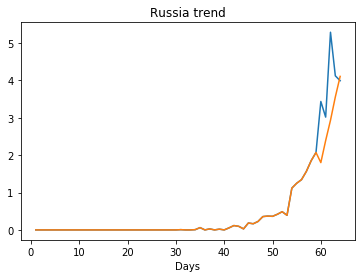

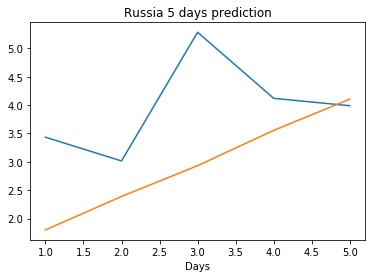

Creating directory ./offline6/Finland/training/
Finland
Saving the best model weights at Epoch [1], Best Valid Loss: 76.3586
Saving the best model weights at Epoch [2], Best Valid Loss: 48.2577


/space/home/nzhang/anaconda3/envs/neuralnet/lib/python3.7/site-packages/torch/nn/modules/loss.py:431: UserWarning: Using a target size (torch.Size([1, 1, 5])) that is different to the input size (torch.Size([5])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/space/home/nzhang/anaconda3/envs/neuralnet/lib/python3.7/site-packages/torch/nn/modules/loss.py:431: UserWarning: Using a target size (torch.Size([1, 5])) that is different to the input size (torch.Size([5])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Saving the best model weights at Epoch [4], Best Valid Loss: 47.3161
Saving the best model weights at Epoch [7], Best Valid Loss: 46.7953
Saving the best model weights at Epoch [9], Best Valid Loss: 25.8007
Saving the best model weights at Epoch [26], Best Valid Loss: 23.0070
Saving the best model weights at Epoch [27], Best Valid Loss: 22.9689
train error: 12.571720978425395
22.968902587890625
Saving the best model weights at Epoch [1], Best Valid Loss: 57.6238
Saving the best model weights at Epoch [2], Best Valid Loss: 48.6376
Saving the best model weights at Epoch [3], Best Valid Loss: 42.5127
Saving the best model weights at Epoch [5], Best Valid Loss: 36.8416
Saving the best model weights at Epoch [7], Best Valid Loss: 28.8654
Saving the best model weights at Epoch [8], Best Valid Loss: 25.7634
Saving the best model weights at Epoch [47], Best Valid Loss: 20.0068
train error: 21.519863119048456
20.00680923461914
Saving the best model weights at Epoch [1], Best Valid Loss: 132.659

Saving the best model weights at Epoch [12], Best Valid Loss: 13.4699
train error: 61.78315298018917
13.46985149383545
Saving the best model weights at Epoch [1], Best Valid Loss: 72.0529
Saving the best model weights at Epoch [2], Best Valid Loss: 15.3385
Saving the best model weights at Epoch [27], Best Valid Loss: 13.3542
train error: 8.424782546777879
13.354235649108887
Saving the best model weights at Epoch [1], Best Valid Loss: 97.5168
Saving the best model weights at Epoch [3], Best Valid Loss: 22.5282
Saving the best model weights at Epoch [24], Best Valid Loss: 19.6901
train error: 12.396271654915425
19.690052032470703
Saving the best model weights at Epoch [1], Best Valid Loss: 23.6508
Saving the best model weights at Epoch [9], Best Valid Loss: 12.1936
train error: 106.88297088684574
12.193577766418457
Saving the best model weights at Epoch [1], Best Valid Loss: 18.3749
Saving the best model weights at Epoch [5], Best Valid Loss: 12.8181
train error: 5.935386491398657
12.818

Saving the best model weights at Epoch [38], Best Valid Loss: 23.0706
train error: 19.857277870178223
23.070621490478516
Saving the best model weights at Epoch [1], Best Valid Loss: 184.8192
Saving the best model weights at Epoch [2], Best Valid Loss: 144.7543
Saving the best model weights at Epoch [3], Best Valid Loss: 114.9962
Saving the best model weights at Epoch [5], Best Valid Loss: 106.1558
Saving the best model weights at Epoch [11], Best Valid Loss: 59.2727
Saving the best model weights at Epoch [12], Best Valid Loss: 19.0921
train error: 52.12278676802112
19.092145919799805
Saving the best model weights at Epoch [1], Best Valid Loss: 121.3798
Saving the best model weights at Epoch [2], Best Valid Loss: 101.0303
Saving the best model weights at Epoch [3], Best Valid Loss: 89.7068
Saving the best model weights at Epoch [4], Best Valid Loss: 79.6723
Saving the best model weights at Epoch [9], Best Valid Loss: 66.4021
Saving the best model weights at Epoch [15], Best Valid Loss: 

Saving the best model weights at Epoch [41], Best Valid Loss: 114.6832
Saving the best model weights at Epoch [43], Best Valid Loss: 111.9870
train error: 46.27479264043993
111.98701477050781
Saving the best model weights at Epoch [1], Best Valid Loss: 121.9230
Saving the best model weights at Epoch [5], Best Valid Loss: 99.2652
train error: 47.26626443862915
99.26517486572266
Saving the best model weights at Epoch [1], Best Valid Loss: 100.1227
Saving the best model weights at Epoch [2], Best Valid Loss: 20.2541
Saving the best model weights at Epoch [38], Best Valid Loss: 14.1215
train error: 77.06056322589997
14.121543884277344
Saving the best model weights at Epoch [1], Best Valid Loss: 245.2397
Saving the best model weights at Epoch [2], Best Valid Loss: 177.5905
Saving the best model weights at Epoch [3], Best Valid Loss: 129.3326
Saving the best model weights at Epoch [4], Best Valid Loss: 99.1239
Saving the best model weights at Epoch [5], Best Valid Loss: 78.9225
Saving the be

Saving the best model weights at Epoch [28], Best Valid Loss: 8.3269
train error: 3.802013857350234
8.326860427856445
Saving the best model weights at Epoch [1], Best Valid Loss: 28.2427
Saving the best model weights at Epoch [4], Best Valid Loss: 19.4482
Saving the best model weights at Epoch [11], Best Valid Loss: 18.2056
train error: 5.07192153255305
18.20558738708496
Saving the best model weights at Epoch [1], Best Valid Loss: 107.7594
Saving the best model weights at Epoch [2], Best Valid Loss: 45.8303
Saving the best model weights at Epoch [3], Best Valid Loss: 33.0561
Saving the best model weights at Epoch [5], Best Valid Loss: 27.2624
Saving the best model weights at Epoch [7], Best Valid Loss: 21.7287
Saving the best model weights at Epoch [8], Best Valid Loss: 18.1318
Saving the best model weights at Epoch [15], Best Valid Loss: 17.9923
Saving the best model weights at Epoch [16], Best Valid Loss: 16.5696
Saving the best model weights at Epoch [20], Best Valid Loss: 15.8859
S

train error: 14.661985572788023
23.00006675720215
Saving the best model weights at Epoch [1], Best Valid Loss: 275.1347
Saving the best model weights at Epoch [2], Best Valid Loss: 235.0407
Saving the best model weights at Epoch [3], Best Valid Loss: 174.8946
Saving the best model weights at Epoch [4], Best Valid Loss: 115.5552
Saving the best model weights at Epoch [5], Best Valid Loss: 72.5626
Saving the best model weights at Epoch [6], Best Valid Loss: 53.8878
Saving the best model weights at Epoch [7], Best Valid Loss: 40.2924
Saving the best model weights at Epoch [8], Best Valid Loss: 37.0809
Saving the best model weights at Epoch [9], Best Valid Loss: 36.5612
Saving the best model weights at Epoch [10], Best Valid Loss: 26.6794
Saving the best model weights at Epoch [12], Best Valid Loss: 23.1502
Saving the best model weights at Epoch [14], Best Valid Loss: 22.7245
Saving the best model weights at Epoch [15], Best Valid Loss: 20.8214
Saving the best model weights at Epoch [17], 

Saving the best model weights at Epoch [15], Best Valid Loss: 97.4399
Saving the best model weights at Epoch [16], Best Valid Loss: 80.1005
Saving the best model weights at Epoch [17], Best Valid Loss: 64.8180
Saving the best model weights at Epoch [18], Best Valid Loss: 56.2809
Saving the best model weights at Epoch [19], Best Valid Loss: 49.0394
Saving the best model weights at Epoch [20], Best Valid Loss: 43.7566
Saving the best model weights at Epoch [21], Best Valid Loss: 40.4876
Saving the best model weights at Epoch [22], Best Valid Loss: 37.4886
Saving the best model weights at Epoch [29], Best Valid Loss: 33.9723
Saving the best model weights at Epoch [30], Best Valid Loss: 30.3572
Saving the best model weights at Epoch [31], Best Valid Loss: 29.4980
Saving the best model weights at Epoch [41], Best Valid Loss: 27.1278
Saving the best model weights at Epoch [42], Best Valid Loss: 26.2548
Saving the best model weights at Epoch [43], Best Valid Loss: 23.6627
Saving the best mode

Saving the best model weights at Epoch [6], Best Valid Loss: 29.9416
Saving the best model weights at Epoch [8], Best Valid Loss: 27.0150
Saving the best model weights at Epoch [10], Best Valid Loss: 24.6202
Saving the best model weights at Epoch [12], Best Valid Loss: 17.7627
Saving the best model weights at Epoch [14], Best Valid Loss: 17.2314
Saving the best model weights at Epoch [18], Best Valid Loss: 16.4899
Saving the best model weights at Epoch [20], Best Valid Loss: 16.1743
train error: 9.691449429479338
16.174299240112305
Saving the best model weights at Epoch [1], Best Valid Loss: 150.9175
Saving the best model weights at Epoch [2], Best Valid Loss: 114.3319
Saving the best model weights at Epoch [3], Best Valid Loss: 64.8365
Saving the best model weights at Epoch [4], Best Valid Loss: 19.5639
Saving the best model weights at Epoch [10], Best Valid Loss: 17.2119
Saving the best model weights at Epoch [36], Best Valid Loss: 16.3106
Saving the best model weights at Epoch [47],

Saving the best model weights at Epoch [39], Best Valid Loss: 21.6712
Saving the best model weights at Epoch [40], Best Valid Loss: 21.6470
Saving the best model weights at Epoch [42], Best Valid Loss: 19.3630
Saving the best model weights at Epoch [44], Best Valid Loss: 18.0580
train error: 9.816539860781162
18.058027267456055
Saving the best model weights at Epoch [1], Best Valid Loss: 251.7215
Saving the best model weights at Epoch [2], Best Valid Loss: 210.7000
Saving the best model weights at Epoch [3], Best Valid Loss: 173.8983
Saving the best model weights at Epoch [4], Best Valid Loss: 147.3670
Saving the best model weights at Epoch [5], Best Valid Loss: 133.0161
Saving the best model weights at Epoch [6], Best Valid Loss: 132.4590
Saving the best model weights at Epoch [7], Best Valid Loss: 132.3299
Saving the best model weights at Epoch [9], Best Valid Loss: 131.0865
Saving the best model weights at Epoch [10], Best Valid Loss: 124.7907
Saving the best model weights at Epoch 

Saving the best model weights at Epoch [21], Best Valid Loss: 22.3390
Saving the best model weights at Epoch [22], Best Valid Loss: 21.7706
Saving the best model weights at Epoch [26], Best Valid Loss: 20.4605
Saving the best model weights at Epoch [29], Best Valid Loss: 20.0638
Saving the best model weights at Epoch [30], Best Valid Loss: 18.1941
train error: 9.794405823753726
18.194114685058594
Saving the best model weights at Epoch [1], Best Valid Loss: 251.8496
Saving the best model weights at Epoch [2], Best Valid Loss: 203.7586
Saving the best model weights at Epoch [3], Best Valid Loss: 169.1854
Saving the best model weights at Epoch [4], Best Valid Loss: 152.2307
Saving the best model weights at Epoch [5], Best Valid Loss: 141.4712
Saving the best model weights at Epoch [6], Best Valid Loss: 135.0686
Saving the best model weights at Epoch [7], Best Valid Loss: 124.9779
Saving the best model weights at Epoch [8], Best Valid Loss: 114.0790
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [6], Best Valid Loss: 133.9587
Saving the best model weights at Epoch [7], Best Valid Loss: 133.5388
Saving the best model weights at Epoch [8], Best Valid Loss: 133.2565
Saving the best model weights at Epoch [13], Best Valid Loss: 128.9070
Saving the best model weights at Epoch [15], Best Valid Loss: 128.8315
Saving the best model weights at Epoch [19], Best Valid Loss: 128.1166
Saving the best model weights at Epoch [32], Best Valid Loss: 126.8961
Saving the best model weights at Epoch [44], Best Valid Loss: 125.0550
Saving the best model weights at Epoch [49], Best Valid Loss: 119.9265
Saving the best model weights at Epoch [50], Best Valid Loss: 88.8774
train error: 39.26617843874039
88.87740325927734
Saving the best model weights at Epoch [1], Best Valid Loss: 148.9286
Saving the best model weights at Epoch [2], Best Valid Loss: 142.9803
Saving the best model weights at Epoch [3], Best Valid Loss: 121.9508
train error: 45.59152378574495
121.

Saving the best model weights at Epoch [26], Best Valid Loss: 81.2669
Saving the best model weights at Epoch [27], Best Valid Loss: 78.2113
Saving the best model weights at Epoch [28], Best Valid Loss: 75.3176
Saving the best model weights at Epoch [29], Best Valid Loss: 72.6903
Saving the best model weights at Epoch [30], Best Valid Loss: 70.3488
Saving the best model weights at Epoch [31], Best Valid Loss: 68.0341
Saving the best model weights at Epoch [32], Best Valid Loss: 65.7874
Saving the best model weights at Epoch [33], Best Valid Loss: 63.9124
Saving the best model weights at Epoch [34], Best Valid Loss: 61.8435
Saving the best model weights at Epoch [35], Best Valid Loss: 60.2327
Saving the best model weights at Epoch [36], Best Valid Loss: 58.4454
Saving the best model weights at Epoch [37], Best Valid Loss: 56.9339
Saving the best model weights at Epoch [38], Best Valid Loss: 55.3317
Saving the best model weights at Epoch [39], Best Valid Loss: 54.1861
Saving the best mode

Saving the best model weights at Epoch [10], Best Valid Loss: 80.2727
Saving the best model weights at Epoch [11], Best Valid Loss: 72.0396
Saving the best model weights at Epoch [12], Best Valid Loss: 65.3266
Saving the best model weights at Epoch [13], Best Valid Loss: 59.7059
Saving the best model weights at Epoch [14], Best Valid Loss: 55.2313
Saving the best model weights at Epoch [15], Best Valid Loss: 51.0373
Saving the best model weights at Epoch [16], Best Valid Loss: 47.7538
Saving the best model weights at Epoch [17], Best Valid Loss: 44.9014
Saving the best model weights at Epoch [18], Best Valid Loss: 42.7033
Saving the best model weights at Epoch [19], Best Valid Loss: 40.5214
Saving the best model weights at Epoch [20], Best Valid Loss: 38.8892
Saving the best model weights at Epoch [21], Best Valid Loss: 37.2537
Saving the best model weights at Epoch [22], Best Valid Loss: 35.7192
Saving the best model weights at Epoch [23], Best Valid Loss: 34.6459
Saving the best mode

Saving the best model weights at Epoch [14], Best Valid Loss: 35.3132
Saving the best model weights at Epoch [15], Best Valid Loss: 33.1171
Saving the best model weights at Epoch [16], Best Valid Loss: 30.7870
Saving the best model weights at Epoch [17], Best Valid Loss: 29.2346
Saving the best model weights at Epoch [18], Best Valid Loss: 27.5257
Saving the best model weights at Epoch [19], Best Valid Loss: 26.6979
Saving the best model weights at Epoch [20], Best Valid Loss: 25.1718
Saving the best model weights at Epoch [21], Best Valid Loss: 24.0317
Saving the best model weights at Epoch [22], Best Valid Loss: 23.1567
Saving the best model weights at Epoch [23], Best Valid Loss: 22.5084
Saving the best model weights at Epoch [24], Best Valid Loss: 21.7387
Saving the best model weights at Epoch [25], Best Valid Loss: 21.5609
Saving the best model weights at Epoch [26], Best Valid Loss: 21.1499
Saving the best model weights at Epoch [27], Best Valid Loss: 20.5735
Saving the best mode

train error: 8.548694407747638
16.504270553588867
Saving the best model weights at Epoch [1], Best Valid Loss: 177.1413
Saving the best model weights at Epoch [2], Best Valid Loss: 27.5667
Saving the best model weights at Epoch [3], Best Valid Loss: 27.0025
Saving the best model weights at Epoch [4], Best Valid Loss: 25.4907
Saving the best model weights at Epoch [5], Best Valid Loss: 19.0396
Saving the best model weights at Epoch [7], Best Valid Loss: 16.0418
Saving the best model weights at Epoch [10], Best Valid Loss: 14.3995
train error: 3.877749688112207
14.399505615234375
Saving the best model weights at Epoch [1], Best Valid Loss: 299.0856
Saving the best model weights at Epoch [2], Best Valid Loss: 295.9644
Saving the best model weights at Epoch [3], Best Valid Loss: 292.9174
Saving the best model weights at Epoch [4], Best Valid Loss: 289.9376
Saving the best model weights at Epoch [5], Best Valid Loss: 286.9563
Saving the best model weights at Epoch [6], Best Valid Loss: 284.

Saving the best model weights at Epoch [8], Best Valid Loss: 105.7113
Saving the best model weights at Epoch [9], Best Valid Loss: 85.4371
Saving the best model weights at Epoch [10], Best Valid Loss: 69.3161
Saving the best model weights at Epoch [11], Best Valid Loss: 59.4301
Saving the best model weights at Epoch [12], Best Valid Loss: 52.9716
Saving the best model weights at Epoch [13], Best Valid Loss: 47.9810
Saving the best model weights at Epoch [15], Best Valid Loss: 46.0618
Saving the best model weights at Epoch [16], Best Valid Loss: 37.8466
Saving the best model weights at Epoch [17], Best Valid Loss: 35.4489
Saving the best model weights at Epoch [18], Best Valid Loss: 33.4011
Saving the best model weights at Epoch [19], Best Valid Loss: 32.5742
Saving the best model weights at Epoch [20], Best Valid Loss: 26.1128
Saving the best model weights at Epoch [21], Best Valid Loss: 24.8920
Saving the best model weights at Epoch [22], Best Valid Loss: 23.2198
Saving the best model

Saving the best model weights at Epoch [37], Best Valid Loss: 42.4421
Saving the best model weights at Epoch [38], Best Valid Loss: 40.7872
Saving the best model weights at Epoch [39], Best Valid Loss: 39.3128
Saving the best model weights at Epoch [40], Best Valid Loss: 38.7320
Saving the best model weights at Epoch [41], Best Valid Loss: 38.0675
Saving the best model weights at Epoch [42], Best Valid Loss: 37.0939
Saving the best model weights at Epoch [43], Best Valid Loss: 35.4397
Saving the best model weights at Epoch [44], Best Valid Loss: 34.6125
Saving the best model weights at Epoch [45], Best Valid Loss: 33.8607
Saving the best model weights at Epoch [46], Best Valid Loss: 33.0529
Saving the best model weights at Epoch [47], Best Valid Loss: 31.9281
Saving the best model weights at Epoch [48], Best Valid Loss: 31.2459
Saving the best model weights at Epoch [49], Best Valid Loss: 30.6991
Saving the best model weights at Epoch [50], Best Valid Loss: 30.1969
train error: 11.7469

Saving the best model weights at Epoch [41], Best Valid Loss: 25.9500
Saving the best model weights at Epoch [42], Best Valid Loss: 24.8957
Saving the best model weights at Epoch [43], Best Valid Loss: 24.2594
Saving the best model weights at Epoch [44], Best Valid Loss: 23.9668
Saving the best model weights at Epoch [45], Best Valid Loss: 23.3409
Saving the best model weights at Epoch [46], Best Valid Loss: 22.7997
Saving the best model weights at Epoch [47], Best Valid Loss: 22.4344
Saving the best model weights at Epoch [48], Best Valid Loss: 22.3172
Saving the best model weights at Epoch [49], Best Valid Loss: 22.0574
Saving the best model weights at Epoch [50], Best Valid Loss: 21.9992
train error: 10.289297404789156
21.999229431152344
Saving the best model weights at Epoch [1], Best Valid Loss: 283.0875
Saving the best model weights at Epoch [2], Best Valid Loss: 251.8510
Saving the best model weights at Epoch [3], Best Valid Loss: 211.1758
Saving the best model weights at Epoch 

Saving the best model weights at Epoch [44], Best Valid Loss: 18.7766
Saving the best model weights at Epoch [45], Best Valid Loss: 18.7023
Saving the best model weights at Epoch [46], Best Valid Loss: 18.3868
train error: 10.246568516858163
18.386810302734375
Saving the best model weights at Epoch [1], Best Valid Loss: 283.8719
Saving the best model weights at Epoch [2], Best Valid Loss: 240.6878
Saving the best model weights at Epoch [3], Best Valid Loss: 168.4561
Saving the best model weights at Epoch [4], Best Valid Loss: 62.4285
Saving the best model weights at Epoch [5], Best Valid Loss: 31.1045
Saving the best model weights at Epoch [6], Best Valid Loss: 29.8056
Saving the best model weights at Epoch [7], Best Valid Loss: 23.4529
Saving the best model weights at Epoch [8], Best Valid Loss: 21.3074
Saving the best model weights at Epoch [10], Best Valid Loss: 18.5482
Saving the best model weights at Epoch [11], Best Valid Loss: 18.0372
Saving the best model weights at Epoch [22],

Saving the best model weights at Epoch [50], Best Valid Loss: 146.2343
train error: 45.1239416368546
146.2342987060547
Saving the best model weights at Epoch [1], Best Valid Loss: 281.3232
Saving the best model weights at Epoch [2], Best Valid Loss: 257.1510
Saving the best model weights at Epoch [3], Best Valid Loss: 233.9600
Saving the best model weights at Epoch [4], Best Valid Loss: 212.9326
Saving the best model weights at Epoch [5], Best Valid Loss: 193.6556
Saving the best model weights at Epoch [6], Best Valid Loss: 179.2162
Saving the best model weights at Epoch [7], Best Valid Loss: 162.5202
Saving the best model weights at Epoch [8], Best Valid Loss: 152.4659
Saving the best model weights at Epoch [9], Best Valid Loss: 144.9344
Saving the best model weights at Epoch [10], Best Valid Loss: 138.4526
Saving the best model weights at Epoch [11], Best Valid Loss: 136.8356
Saving the best model weights at Epoch [12], Best Valid Loss: 132.5378
Saving the best model weights at Epoch

Saving the best model weights at Epoch [25], Best Valid Loss: 188.5722
Saving the best model weights at Epoch [26], Best Valid Loss: 184.9986
Saving the best model weights at Epoch [27], Best Valid Loss: 180.8049
Saving the best model weights at Epoch [28], Best Valid Loss: 177.5058
Saving the best model weights at Epoch [29], Best Valid Loss: 173.5806
Saving the best model weights at Epoch [30], Best Valid Loss: 170.5572
Saving the best model weights at Epoch [31], Best Valid Loss: 167.1930
Saving the best model weights at Epoch [32], Best Valid Loss: 164.3212
Saving the best model weights at Epoch [33], Best Valid Loss: 160.8780
Saving the best model weights at Epoch [34], Best Valid Loss: 158.3516
Saving the best model weights at Epoch [35], Best Valid Loss: 155.4023
Saving the best model weights at Epoch [36], Best Valid Loss: 153.1840
Saving the best model weights at Epoch [37], Best Valid Loss: 150.4014
Saving the best model weights at Epoch [38], Best Valid Loss: 148.3462
Saving

Saving the best model weights at Epoch [14], Best Valid Loss: 231.4491
Saving the best model weights at Epoch [15], Best Valid Loss: 226.1181
Saving the best model weights at Epoch [16], Best Valid Loss: 221.2139
Saving the best model weights at Epoch [17], Best Valid Loss: 216.1716
Saving the best model weights at Epoch [18], Best Valid Loss: 210.6671
Saving the best model weights at Epoch [19], Best Valid Loss: 205.8812
Saving the best model weights at Epoch [20], Best Valid Loss: 200.5759
Saving the best model weights at Epoch [21], Best Valid Loss: 195.6068
Saving the best model weights at Epoch [22], Best Valid Loss: 190.6498
Saving the best model weights at Epoch [23], Best Valid Loss: 185.7877
Saving the best model weights at Epoch [24], Best Valid Loss: 180.9157
Saving the best model weights at Epoch [25], Best Valid Loss: 176.0030
Saving the best model weights at Epoch [26], Best Valid Loss: 170.7629
Saving the best model weights at Epoch [27], Best Valid Loss: 166.1325
Saving

Saving the best model weights at Epoch [7], Best Valid Loss: 268.8773
Saving the best model weights at Epoch [8], Best Valid Loss: 264.2549
Saving the best model weights at Epoch [9], Best Valid Loss: 259.1836
Saving the best model weights at Epoch [10], Best Valid Loss: 254.4867
Saving the best model weights at Epoch [11], Best Valid Loss: 249.7785
Saving the best model weights at Epoch [12], Best Valid Loss: 244.8736
Saving the best model weights at Epoch [13], Best Valid Loss: 239.6855
Saving the best model weights at Epoch [14], Best Valid Loss: 234.7294
Saving the best model weights at Epoch [15], Best Valid Loss: 229.6257
Saving the best model weights at Epoch [16], Best Valid Loss: 224.5551
Saving the best model weights at Epoch [17], Best Valid Loss: 219.4297
Saving the best model weights at Epoch [18], Best Valid Loss: 213.9961
Saving the best model weights at Epoch [19], Best Valid Loss: 208.5875
Saving the best model weights at Epoch [20], Best Valid Loss: 202.8833
Saving th

Saving the best model weights at Epoch [8], Best Valid Loss: 261.0061
Saving the best model weights at Epoch [9], Best Valid Loss: 256.4652
Saving the best model weights at Epoch [10], Best Valid Loss: 251.3039
Saving the best model weights at Epoch [11], Best Valid Loss: 246.8782
Saving the best model weights at Epoch [12], Best Valid Loss: 241.9055
Saving the best model weights at Epoch [13], Best Valid Loss: 237.4325
Saving the best model weights at Epoch [14], Best Valid Loss: 232.9047
Saving the best model weights at Epoch [15], Best Valid Loss: 228.3747
Saving the best model weights at Epoch [16], Best Valid Loss: 224.0011
Saving the best model weights at Epoch [17], Best Valid Loss: 219.3490
Saving the best model weights at Epoch [18], Best Valid Loss: 215.2962
Saving the best model weights at Epoch [19], Best Valid Loss: 211.0190
Saving the best model weights at Epoch [20], Best Valid Loss: 206.5290
Saving the best model weights at Epoch [21], Best Valid Loss: 202.3783
Saving t

Saving the best model weights at Epoch [48], Best Valid Loss: 182.8504
Saving the best model weights at Epoch [49], Best Valid Loss: 180.9116
Saving the best model weights at Epoch [50], Best Valid Loss: 179.0233
train error: 48.84830431784353
179.02334594726562
Saving the best model weights at Epoch [1], Best Valid Loss: 298.2193
Saving the best model weights at Epoch [2], Best Valid Loss: 292.6111
Saving the best model weights at Epoch [3], Best Valid Loss: 287.5076
Saving the best model weights at Epoch [4], Best Valid Loss: 282.2860
Saving the best model weights at Epoch [5], Best Valid Loss: 277.0508
Saving the best model weights at Epoch [6], Best Valid Loss: 272.1028
Saving the best model weights at Epoch [7], Best Valid Loss: 267.2595
Saving the best model weights at Epoch [8], Best Valid Loss: 262.2209
Saving the best model weights at Epoch [9], Best Valid Loss: 257.5086
Saving the best model weights at Epoch [10], Best Valid Loss: 252.6796
Saving the best model weights at Epo

Saving the best model weights at Epoch [32], Best Valid Loss: 220.7500
Saving the best model weights at Epoch [33], Best Valid Loss: 218.3349
Saving the best model weights at Epoch [34], Best Valid Loss: 215.9609
Saving the best model weights at Epoch [35], Best Valid Loss: 213.5585
Saving the best model weights at Epoch [36], Best Valid Loss: 211.1692
Saving the best model weights at Epoch [37], Best Valid Loss: 208.8061
Saving the best model weights at Epoch [38], Best Valid Loss: 206.4385
Saving the best model weights at Epoch [39], Best Valid Loss: 204.1125
Saving the best model weights at Epoch [40], Best Valid Loss: 201.8123
Saving the best model weights at Epoch [41], Best Valid Loss: 199.5627
Saving the best model weights at Epoch [42], Best Valid Loss: 197.2676
Saving the best model weights at Epoch [43], Best Valid Loss: 195.0360
Saving the best model weights at Epoch [44], Best Valid Loss: 192.8377
Saving the best model weights at Epoch [45], Best Valid Loss: 190.6790
Saving

Saving the best model weights at Epoch [20], Best Valid Loss: 247.6493
Saving the best model weights at Epoch [21], Best Valid Loss: 244.8930
Saving the best model weights at Epoch [22], Best Valid Loss: 242.1342
Saving the best model weights at Epoch [23], Best Valid Loss: 239.3781
Saving the best model weights at Epoch [24], Best Valid Loss: 236.5736
Saving the best model weights at Epoch [25], Best Valid Loss: 233.7893
Saving the best model weights at Epoch [26], Best Valid Loss: 230.9984
Saving the best model weights at Epoch [27], Best Valid Loss: 228.2089
Saving the best model weights at Epoch [28], Best Valid Loss: 225.4066
Saving the best model weights at Epoch [29], Best Valid Loss: 222.6235
Saving the best model weights at Epoch [30], Best Valid Loss: 219.8358
Saving the best model weights at Epoch [31], Best Valid Loss: 217.0582
Saving the best model weights at Epoch [32], Best Valid Loss: 214.2961
Saving the best model weights at Epoch [33], Best Valid Loss: 211.5086
Saving

Saving the best model weights at Epoch [12], Best Valid Loss: 267.5686
Saving the best model weights at Epoch [13], Best Valid Loss: 264.9698
Saving the best model weights at Epoch [14], Best Valid Loss: 262.3865
Saving the best model weights at Epoch [15], Best Valid Loss: 259.8252
Saving the best model weights at Epoch [16], Best Valid Loss: 257.3048
Saving the best model weights at Epoch [17], Best Valid Loss: 254.7805
Saving the best model weights at Epoch [18], Best Valid Loss: 252.2919
Saving the best model weights at Epoch [19], Best Valid Loss: 249.8280
Saving the best model weights at Epoch [20], Best Valid Loss: 247.3858
Saving the best model weights at Epoch [21], Best Valid Loss: 244.9130
Saving the best model weights at Epoch [22], Best Valid Loss: 242.4934
Saving the best model weights at Epoch [23], Best Valid Loss: 240.0799
Saving the best model weights at Epoch [24], Best Valid Loss: 237.6794
Saving the best model weights at Epoch [25], Best Valid Loss: 235.3066
Saving

Saving the best model weights at Epoch [10], Best Valid Loss: 275.2704
Saving the best model weights at Epoch [11], Best Valid Loss: 272.5173
Saving the best model weights at Epoch [12], Best Valid Loss: 269.7704
Saving the best model weights at Epoch [13], Best Valid Loss: 267.0666
Saving the best model weights at Epoch [14], Best Valid Loss: 264.3975
Saving the best model weights at Epoch [15], Best Valid Loss: 261.7332
Saving the best model weights at Epoch [16], Best Valid Loss: 259.0711
Saving the best model weights at Epoch [17], Best Valid Loss: 256.4242
Saving the best model weights at Epoch [18], Best Valid Loss: 253.7763
Saving the best model weights at Epoch [19], Best Valid Loss: 251.1608
Saving the best model weights at Epoch [20], Best Valid Loss: 248.5507
Saving the best model weights at Epoch [21], Best Valid Loss: 245.9737
Saving the best model weights at Epoch [22], Best Valid Loss: 243.3876
Saving the best model weights at Epoch [23], Best Valid Loss: 240.7997
Saving

Saving the best model weights at Epoch [8], Best Valid Loss: 280.8470
Saving the best model weights at Epoch [9], Best Valid Loss: 278.0529
Saving the best model weights at Epoch [10], Best Valid Loss: 275.2773
Saving the best model weights at Epoch [11], Best Valid Loss: 272.5011
Saving the best model weights at Epoch [12], Best Valid Loss: 269.7638
Saving the best model weights at Epoch [13], Best Valid Loss: 267.0554
Saving the best model weights at Epoch [14], Best Valid Loss: 264.3572
Saving the best model weights at Epoch [15], Best Valid Loss: 261.6545
Saving the best model weights at Epoch [16], Best Valid Loss: 258.9366
Saving the best model weights at Epoch [17], Best Valid Loss: 256.2635
Saving the best model weights at Epoch [18], Best Valid Loss: 253.5882
Saving the best model weights at Epoch [19], Best Valid Loss: 250.9013
Saving the best model weights at Epoch [20], Best Valid Loss: 248.2274
Saving the best model weights at Epoch [21], Best Valid Loss: 245.5431
Saving t

Saving the best model weights at Epoch [12], Best Valid Loss: 269.9029
Saving the best model weights at Epoch [13], Best Valid Loss: 267.2565
Saving the best model weights at Epoch [14], Best Valid Loss: 264.6609
Saving the best model weights at Epoch [15], Best Valid Loss: 262.0750
Saving the best model weights at Epoch [16], Best Valid Loss: 259.5127
Saving the best model weights at Epoch [17], Best Valid Loss: 256.9512
Saving the best model weights at Epoch [18], Best Valid Loss: 254.4103
Saving the best model weights at Epoch [19], Best Valid Loss: 251.8971
Saving the best model weights at Epoch [20], Best Valid Loss: 249.3467
Saving the best model weights at Epoch [21], Best Valid Loss: 246.8202
Saving the best model weights at Epoch [22], Best Valid Loss: 244.2793
Saving the best model weights at Epoch [23], Best Valid Loss: 241.7572
Saving the best model weights at Epoch [24], Best Valid Loss: 239.2587
Saving the best model weights at Epoch [25], Best Valid Loss: 236.6957
Saving

Saving the best model weights at Epoch [14], Best Valid Loss: 301.9248
Saving the best model weights at Epoch [15], Best Valid Loss: 301.5020
Saving the best model weights at Epoch [16], Best Valid Loss: 301.0713
Saving the best model weights at Epoch [17], Best Valid Loss: 300.6243
Saving the best model weights at Epoch [18], Best Valid Loss: 300.1675
Saving the best model weights at Epoch [19], Best Valid Loss: 299.7015
Saving the best model weights at Epoch [20], Best Valid Loss: 299.2258
Saving the best model weights at Epoch [21], Best Valid Loss: 298.7275
Saving the best model weights at Epoch [22], Best Valid Loss: 298.2249
Saving the best model weights at Epoch [23], Best Valid Loss: 297.7153
Saving the best model weights at Epoch [24], Best Valid Loss: 297.1983
Saving the best model weights at Epoch [25], Best Valid Loss: 296.6753
Saving the best model weights at Epoch [26], Best Valid Loss: 296.1463
Saving the best model weights at Epoch [27], Best Valid Loss: 295.6114
Saving

Saving the best model weights at Epoch [30], Best Valid Loss: 125.0711
Saving the best model weights at Epoch [31], Best Valid Loss: 121.8002
Saving the best model weights at Epoch [32], Best Valid Loss: 117.9883
Saving the best model weights at Epoch [33], Best Valid Loss: 114.7688
Saving the best model weights at Epoch [34], Best Valid Loss: 111.9027
Saving the best model weights at Epoch [35], Best Valid Loss: 108.6957
Saving the best model weights at Epoch [36], Best Valid Loss: 106.0493
Saving the best model weights at Epoch [37], Best Valid Loss: 103.2026
Saving the best model weights at Epoch [38], Best Valid Loss: 100.1169
Saving the best model weights at Epoch [39], Best Valid Loss: 96.4100
Saving the best model weights at Epoch [40], Best Valid Loss: 93.8301
Saving the best model weights at Epoch [41], Best Valid Loss: 90.7522
Saving the best model weights at Epoch [42], Best Valid Loss: 88.6464
Saving the best model weights at Epoch [43], Best Valid Loss: 86.4858
Saving the 

Saving the best model weights at Epoch [46], Best Valid Loss: 169.2026
Saving the best model weights at Epoch [47], Best Valid Loss: 166.6722
Saving the best model weights at Epoch [48], Best Valid Loss: 164.1558
Saving the best model weights at Epoch [49], Best Valid Loss: 161.6946
Saving the best model weights at Epoch [50], Best Valid Loss: 159.4081
train error: 41.570956503191304
159.4081268310547
Saving the best model weights at Epoch [1], Best Valid Loss: 293.6462
Saving the best model weights at Epoch [2], Best Valid Loss: 287.4830
Saving the best model weights at Epoch [3], Best Valid Loss: 276.4782
Saving the best model weights at Epoch [4], Best Valid Loss: 265.3291
Saving the best model weights at Epoch [5], Best Valid Loss: 253.0336
Saving the best model weights at Epoch [6], Best Valid Loss: 238.6072
Saving the best model weights at Epoch [7], Best Valid Loss: 226.6847
Saving the best model weights at Epoch [8], Best Valid Loss: 214.0160
Saving the best model weights at Ep

Saving the best model weights at Epoch [12], Best Valid Loss: 268.3976
Saving the best model weights at Epoch [13], Best Valid Loss: 264.8770
Saving the best model weights at Epoch [14], Best Valid Loss: 261.3355
Saving the best model weights at Epoch [15], Best Valid Loss: 257.6509
Saving the best model weights at Epoch [16], Best Valid Loss: 254.1689
Saving the best model weights at Epoch [17], Best Valid Loss: 250.5143
Saving the best model weights at Epoch [18], Best Valid Loss: 246.4465
Saving the best model weights at Epoch [19], Best Valid Loss: 242.6125
Saving the best model weights at Epoch [20], Best Valid Loss: 238.9219
Saving the best model weights at Epoch [21], Best Valid Loss: 234.9616
Saving the best model weights at Epoch [22], Best Valid Loss: 231.1033
Saving the best model weights at Epoch [23], Best Valid Loss: 227.1816
Saving the best model weights at Epoch [24], Best Valid Loss: 223.5687
Saving the best model weights at Epoch [25], Best Valid Loss: 219.5173
Saving

Saving the best model weights at Epoch [28], Best Valid Loss: 219.8875
Saving the best model weights at Epoch [29], Best Valid Loss: 215.5369
Saving the best model weights at Epoch [30], Best Valid Loss: 211.2208
Saving the best model weights at Epoch [31], Best Valid Loss: 206.8476
Saving the best model weights at Epoch [32], Best Valid Loss: 202.5214
Saving the best model weights at Epoch [33], Best Valid Loss: 198.2153
Saving the best model weights at Epoch [34], Best Valid Loss: 193.9066
Saving the best model weights at Epoch [35], Best Valid Loss: 189.6569
Saving the best model weights at Epoch [36], Best Valid Loss: 185.3582
Saving the best model weights at Epoch [37], Best Valid Loss: 181.1529
Saving the best model weights at Epoch [38], Best Valid Loss: 176.9281
Saving the best model weights at Epoch [39], Best Valid Loss: 172.8018
Saving the best model weights at Epoch [40], Best Valid Loss: 168.7720
Saving the best model weights at Epoch [41], Best Valid Loss: 164.7355
Saving

Saving the best model weights at Epoch [1], Best Valid Loss: 303.1842
Saving the best model weights at Epoch [2], Best Valid Loss: 302.8598
Saving the best model weights at Epoch [3], Best Valid Loss: 302.5368
Saving the best model weights at Epoch [4], Best Valid Loss: 302.2120
Saving the best model weights at Epoch [5], Best Valid Loss: 301.8900
Saving the best model weights at Epoch [6], Best Valid Loss: 301.5667
Saving the best model weights at Epoch [7], Best Valid Loss: 301.2475
Saving the best model weights at Epoch [8], Best Valid Loss: 300.9258
Saving the best model weights at Epoch [9], Best Valid Loss: 300.6081
Saving the best model weights at Epoch [10], Best Valid Loss: 300.2887
Saving the best model weights at Epoch [11], Best Valid Loss: 299.9712
Saving the best model weights at Epoch [12], Best Valid Loss: 299.6571
Saving the best model weights at Epoch [13], Best Valid Loss: 299.3385
Saving the best model weights at Epoch [14], Best Valid Loss: 299.0249
Saving the best

Saving the best model weights at Epoch [18], Best Valid Loss: 252.3103
Saving the best model weights at Epoch [19], Best Valid Loss: 249.3686
Saving the best model weights at Epoch [20], Best Valid Loss: 246.2737
Saving the best model weights at Epoch [21], Best Valid Loss: 242.9276
Saving the best model weights at Epoch [22], Best Valid Loss: 240.1323
Saving the best model weights at Epoch [23], Best Valid Loss: 236.8320
Saving the best model weights at Epoch [24], Best Valid Loss: 234.5172
Saving the best model weights at Epoch [25], Best Valid Loss: 231.2943
Saving the best model weights at Epoch [26], Best Valid Loss: 228.0361
Saving the best model weights at Epoch [27], Best Valid Loss: 225.6971
Saving the best model weights at Epoch [28], Best Valid Loss: 222.0108
Saving the best model weights at Epoch [29], Best Valid Loss: 219.5757
Saving the best model weights at Epoch [30], Best Valid Loss: 216.0904
Saving the best model weights at Epoch [31], Best Valid Loss: 212.6611
Saving

Saving the best model weights at Epoch [35], Best Valid Loss: 281.9164
Saving the best model weights at Epoch [36], Best Valid Loss: 281.3387
Saving the best model weights at Epoch [37], Best Valid Loss: 280.7472
Saving the best model weights at Epoch [38], Best Valid Loss: 280.1552
Saving the best model weights at Epoch [39], Best Valid Loss: 279.5558
Saving the best model weights at Epoch [40], Best Valid Loss: 278.9204
Saving the best model weights at Epoch [41], Best Valid Loss: 278.3210
Saving the best model weights at Epoch [42], Best Valid Loss: 277.7266
Saving the best model weights at Epoch [43], Best Valid Loss: 277.0919
Saving the best model weights at Epoch [44], Best Valid Loss: 276.4682
Saving the best model weights at Epoch [45], Best Valid Loss: 275.8770
Saving the best model weights at Epoch [46], Best Valid Loss: 275.2466
Saving the best model weights at Epoch [47], Best Valid Loss: 274.6210
Saving the best model weights at Epoch [48], Best Valid Loss: 273.9952
Saving

Saving the best model weights at Epoch [2], Best Valid Loss: 302.2798
Saving the best model weights at Epoch [3], Best Valid Loss: 301.6968
Saving the best model weights at Epoch [4], Best Valid Loss: 301.0862
Saving the best model weights at Epoch [5], Best Valid Loss: 300.5023
Saving the best model weights at Epoch [6], Best Valid Loss: 299.9116
Saving the best model weights at Epoch [7], Best Valid Loss: 299.3283
Saving the best model weights at Epoch [8], Best Valid Loss: 298.7578
Saving the best model weights at Epoch [9], Best Valid Loss: 298.1434
Saving the best model weights at Epoch [10], Best Valid Loss: 297.5802
Saving the best model weights at Epoch [11], Best Valid Loss: 296.9895
Saving the best model weights at Epoch [12], Best Valid Loss: 296.4020
Saving the best model weights at Epoch [13], Best Valid Loss: 295.8303
Saving the best model weights at Epoch [14], Best Valid Loss: 295.2465
Saving the best model weights at Epoch [15], Best Valid Loss: 294.6445
Saving the bes

Saving the best model weights at Epoch [19], Best Valid Loss: 298.9735
Saving the best model weights at Epoch [20], Best Valid Loss: 298.6187
Saving the best model weights at Epoch [21], Best Valid Loss: 298.2615
Saving the best model weights at Epoch [22], Best Valid Loss: 297.9070
Saving the best model weights at Epoch [23], Best Valid Loss: 297.5503
Saving the best model weights at Epoch [24], Best Valid Loss: 297.1939
Saving the best model weights at Epoch [25], Best Valid Loss: 296.8374
Saving the best model weights at Epoch [26], Best Valid Loss: 296.4808
Saving the best model weights at Epoch [27], Best Valid Loss: 296.1222
Saving the best model weights at Epoch [28], Best Valid Loss: 295.7646
Saving the best model weights at Epoch [29], Best Valid Loss: 295.4013
Saving the best model weights at Epoch [30], Best Valid Loss: 295.0429
Saving the best model weights at Epoch [31], Best Valid Loss: 294.6787
Saving the best model weights at Epoch [32], Best Valid Loss: 294.3140
Saving

Saving the best model weights at Epoch [36], Best Valid Loss: 42.3591
Saving the best model weights at Epoch [37], Best Valid Loss: 39.4161
Saving the best model weights at Epoch [38], Best Valid Loss: 38.1689
Saving the best model weights at Epoch [39], Best Valid Loss: 36.6394
Saving the best model weights at Epoch [40], Best Valid Loss: 35.1598
Saving the best model weights at Epoch [41], Best Valid Loss: 33.8266
Saving the best model weights at Epoch [42], Best Valid Loss: 33.0105
Saving the best model weights at Epoch [43], Best Valid Loss: 31.7130
Saving the best model weights at Epoch [44], Best Valid Loss: 31.2105
Saving the best model weights at Epoch [45], Best Valid Loss: 29.9910
Saving the best model weights at Epoch [46], Best Valid Loss: 29.2041
Saving the best model weights at Epoch [47], Best Valid Loss: 28.9160
Saving the best model weights at Epoch [48], Best Valid Loss: 28.0990
Saving the best model weights at Epoch [49], Best Valid Loss: 27.7221
Saving the best mode

Saving the best model weights at Epoch [1], Best Valid Loss: 305.0492
Saving the best model weights at Epoch [2], Best Valid Loss: 302.3337
Saving the best model weights at Epoch [3], Best Valid Loss: 299.2377
Saving the best model weights at Epoch [4], Best Valid Loss: 297.0278
Saving the best model weights at Epoch [5], Best Valid Loss: 294.1758
Saving the best model weights at Epoch [6], Best Valid Loss: 291.6709
Saving the best model weights at Epoch [7], Best Valid Loss: 288.9032
Saving the best model weights at Epoch [8], Best Valid Loss: 286.5226
Saving the best model weights at Epoch [9], Best Valid Loss: 283.9100
Saving the best model weights at Epoch [10], Best Valid Loss: 281.4376
Saving the best model weights at Epoch [11], Best Valid Loss: 279.1015
Saving the best model weights at Epoch [12], Best Valid Loss: 276.6243
Saving the best model weights at Epoch [13], Best Valid Loss: 274.2882
Saving the best model weights at Epoch [14], Best Valid Loss: 271.8890
Saving the best

Saving the best model weights at Epoch [18], Best Valid Loss: 295.0241
Saving the best model weights at Epoch [19], Best Valid Loss: 294.4891
Saving the best model weights at Epoch [20], Best Valid Loss: 293.9898
Saving the best model weights at Epoch [21], Best Valid Loss: 293.4491
Saving the best model weights at Epoch [22], Best Valid Loss: 292.9316
Saving the best model weights at Epoch [23], Best Valid Loss: 292.3948
Saving the best model weights at Epoch [24], Best Valid Loss: 291.8581
Saving the best model weights at Epoch [25], Best Valid Loss: 291.3221
Saving the best model weights at Epoch [26], Best Valid Loss: 290.8069
Saving the best model weights at Epoch [27], Best Valid Loss: 290.2973
Saving the best model weights at Epoch [28], Best Valid Loss: 289.7667
Saving the best model weights at Epoch [29], Best Valid Loss: 289.2307
Saving the best model weights at Epoch [30], Best Valid Loss: 288.7197
Saving the best model weights at Epoch [31], Best Valid Loss: 288.2113
Saving

Saving the best model weights at Epoch [35], Best Valid Loss: 295.2148
Saving the best model weights at Epoch [36], Best Valid Loss: 294.9099
Saving the best model weights at Epoch [37], Best Valid Loss: 294.6081
Saving the best model weights at Epoch [38], Best Valid Loss: 294.3072
Saving the best model weights at Epoch [39], Best Valid Loss: 294.0053
Saving the best model weights at Epoch [40], Best Valid Loss: 293.7035
Saving the best model weights at Epoch [41], Best Valid Loss: 293.4006
Saving the best model weights at Epoch [42], Best Valid Loss: 293.1015
Saving the best model weights at Epoch [43], Best Valid Loss: 292.8014
Saving the best model weights at Epoch [44], Best Valid Loss: 292.5002
Saving the best model weights at Epoch [45], Best Valid Loss: 292.2020
Saving the best model weights at Epoch [46], Best Valid Loss: 291.9017
Saving the best model weights at Epoch [47], Best Valid Loss: 291.6036
Saving the best model weights at Epoch [48], Best Valid Loss: 291.3049
Saving

Saving the best model weights at Epoch [1], Best Valid Loss: 303.6384
Saving the best model weights at Epoch [2], Best Valid Loss: 303.3215
Saving the best model weights at Epoch [3], Best Valid Loss: 303.0044
Saving the best model weights at Epoch [4], Best Valid Loss: 302.6884
Saving the best model weights at Epoch [5], Best Valid Loss: 302.3717
Saving the best model weights at Epoch [6], Best Valid Loss: 302.0533
Saving the best model weights at Epoch [7], Best Valid Loss: 301.7402
Saving the best model weights at Epoch [8], Best Valid Loss: 301.4231
Saving the best model weights at Epoch [9], Best Valid Loss: 301.1112
Saving the best model weights at Epoch [10], Best Valid Loss: 300.7964
Saving the best model weights at Epoch [11], Best Valid Loss: 300.4844
Saving the best model weights at Epoch [12], Best Valid Loss: 300.1705
Saving the best model weights at Epoch [13], Best Valid Loss: 299.8568
Saving the best model weights at Epoch [14], Best Valid Loss: 299.5451
Saving the best

Saving the best model weights at Epoch [17], Best Valid Loss: 260.4944
Saving the best model weights at Epoch [18], Best Valid Loss: 257.6985
Saving the best model weights at Epoch [19], Best Valid Loss: 254.9473
Saving the best model weights at Epoch [20], Best Valid Loss: 252.2189
Saving the best model weights at Epoch [21], Best Valid Loss: 249.7880
Saving the best model weights at Epoch [22], Best Valid Loss: 247.2765
Saving the best model weights at Epoch [23], Best Valid Loss: 244.9910
Saving the best model weights at Epoch [24], Best Valid Loss: 241.8364
Saving the best model weights at Epoch [25], Best Valid Loss: 239.5645
Saving the best model weights at Epoch [26], Best Valid Loss: 236.7771
Saving the best model weights at Epoch [27], Best Valid Loss: 233.7100
Saving the best model weights at Epoch [28], Best Valid Loss: 231.0875
Saving the best model weights at Epoch [29], Best Valid Loss: 228.4320
Saving the best model weights at Epoch [30], Best Valid Loss: 225.7240
Saving

Saving the best model weights at Epoch [32], Best Valid Loss: 285.4548
Saving the best model weights at Epoch [33], Best Valid Loss: 284.9500
Saving the best model weights at Epoch [34], Best Valid Loss: 284.4244
Saving the best model weights at Epoch [35], Best Valid Loss: 283.9247
Saving the best model weights at Epoch [36], Best Valid Loss: 283.3927
Saving the best model weights at Epoch [37], Best Valid Loss: 282.8776
Saving the best model weights at Epoch [38], Best Valid Loss: 282.3790
Saving the best model weights at Epoch [39], Best Valid Loss: 281.8662
Saving the best model weights at Epoch [40], Best Valid Loss: 281.3767
Saving the best model weights at Epoch [41], Best Valid Loss: 280.8560
Saving the best model weights at Epoch [42], Best Valid Loss: 280.3514
Saving the best model weights at Epoch [43], Best Valid Loss: 279.8303
Saving the best model weights at Epoch [44], Best Valid Loss: 279.3427
Saving the best model weights at Epoch [45], Best Valid Loss: 278.8112
Saving

Saving the best model weights at Epoch [48], Best Valid Loss: 292.3672
Saving the best model weights at Epoch [49], Best Valid Loss: 292.0730
Saving the best model weights at Epoch [50], Best Valid Loss: 291.7756
train error: 78.49031411519935
291.775634765625
Saving the best model weights at Epoch [1], Best Valid Loss: 303.9214
Saving the best model weights at Epoch [2], Best Valid Loss: 303.3620
Saving the best model weights at Epoch [3], Best Valid Loss: 302.7937
Saving the best model weights at Epoch [4], Best Valid Loss: 302.2462
Saving the best model weights at Epoch [5], Best Valid Loss: 301.6863
Saving the best model weights at Epoch [6], Best Valid Loss: 301.1516
Saving the best model weights at Epoch [7], Best Valid Loss: 300.6055
Saving the best model weights at Epoch [8], Best Valid Loss: 300.0624
Saving the best model weights at Epoch [9], Best Valid Loss: 299.4959
Saving the best model weights at Epoch [10], Best Valid Loss: 298.9598
Saving the best model weights at Epoch

Saving the best model weights at Epoch [12], Best Valid Loss: 301.7810
Saving the best model weights at Epoch [13], Best Valid Loss: 301.4718
Saving the best model weights at Epoch [14], Best Valid Loss: 301.1620
Saving the best model weights at Epoch [15], Best Valid Loss: 300.8525
Saving the best model weights at Epoch [16], Best Valid Loss: 300.5472
Saving the best model weights at Epoch [17], Best Valid Loss: 300.2389
Saving the best model weights at Epoch [18], Best Valid Loss: 299.9319
Saving the best model weights at Epoch [19], Best Valid Loss: 299.6244
Saving the best model weights at Epoch [20], Best Valid Loss: 299.3198
Saving the best model weights at Epoch [21], Best Valid Loss: 299.0139
Saving the best model weights at Epoch [22], Best Valid Loss: 298.7119
Saving the best model weights at Epoch [23], Best Valid Loss: 298.4068
Saving the best model weights at Epoch [24], Best Valid Loss: 298.1020
Saving the best model weights at Epoch [25], Best Valid Loss: 297.7991
Saving

Saving the best model weights at Epoch [28], Best Valid Loss: 238.2507
Saving the best model weights at Epoch [29], Best Valid Loss: 235.8501
Saving the best model weights at Epoch [30], Best Valid Loss: 233.5964
Saving the best model weights at Epoch [31], Best Valid Loss: 231.4314
Saving the best model weights at Epoch [32], Best Valid Loss: 228.9284
Saving the best model weights at Epoch [33], Best Valid Loss: 226.5512
Saving the best model weights at Epoch [34], Best Valid Loss: 224.2623
Saving the best model weights at Epoch [35], Best Valid Loss: 222.2512
Saving the best model weights at Epoch [36], Best Valid Loss: 220.1042
Saving the best model weights at Epoch [37], Best Valid Loss: 217.7482
Saving the best model weights at Epoch [38], Best Valid Loss: 215.3065
Saving the best model weights at Epoch [39], Best Valid Loss: 213.0895
Saving the best model weights at Epoch [40], Best Valid Loss: 210.7854
Saving the best model weights at Epoch [41], Best Valid Loss: 208.7951
Saving

Saving the best model weights at Epoch [44], Best Valid Loss: 281.9114
Saving the best model weights at Epoch [45], Best Valid Loss: 281.4078
Saving the best model weights at Epoch [46], Best Valid Loss: 280.9221
Saving the best model weights at Epoch [47], Best Valid Loss: 280.4036
Saving the best model weights at Epoch [48], Best Valid Loss: 279.9066
Saving the best model weights at Epoch [49], Best Valid Loss: 279.4048
Saving the best model weights at Epoch [50], Best Valid Loss: 278.9204
train error: 74.15636500379732
278.9203796386719
Saving the best model weights at Epoch [1], Best Valid Loss: 303.2147
Saving the best model weights at Epoch [2], Best Valid Loss: 300.1519
Saving the best model weights at Epoch [3], Best Valid Loss: 297.4153
Saving the best model weights at Epoch [4], Best Valid Loss: 294.7612
Saving the best model weights at Epoch [5], Best Valid Loss: 292.4358
Saving the best model weights at Epoch [6], Best Valid Loss: 289.3065
Saving the best model weights at E

Saving the best model weights at Epoch [8], Best Valid Loss: 295.8006
Saving the best model weights at Epoch [9], Best Valid Loss: 295.2639
Saving the best model weights at Epoch [10], Best Valid Loss: 294.6917
Saving the best model weights at Epoch [11], Best Valid Loss: 294.1514
Saving the best model weights at Epoch [12], Best Valid Loss: 293.5814
Saving the best model weights at Epoch [13], Best Valid Loss: 293.0135
Saving the best model weights at Epoch [14], Best Valid Loss: 292.4688
Saving the best model weights at Epoch [15], Best Valid Loss: 291.9390
Saving the best model weights at Epoch [16], Best Valid Loss: 291.3734
Saving the best model weights at Epoch [17], Best Valid Loss: 290.8294
Saving the best model weights at Epoch [18], Best Valid Loss: 290.2755
Saving the best model weights at Epoch [19], Best Valid Loss: 289.7477
Saving the best model weights at Epoch [20], Best Valid Loss: 289.1903
Saving the best model weights at Epoch [21], Best Valid Loss: 288.6500
Saving t

Saving the best model weights at Epoch [24], Best Valid Loss: 297.8426
Saving the best model weights at Epoch [25], Best Valid Loss: 297.5474
Saving the best model weights at Epoch [26], Best Valid Loss: 297.2540
Saving the best model weights at Epoch [27], Best Valid Loss: 296.9636
Saving the best model weights at Epoch [28], Best Valid Loss: 296.6715
Saving the best model weights at Epoch [29], Best Valid Loss: 296.3784
Saving the best model weights at Epoch [30], Best Valid Loss: 296.0876
Saving the best model weights at Epoch [31], Best Valid Loss: 295.7988
Saving the best model weights at Epoch [32], Best Valid Loss: 295.5090
Saving the best model weights at Epoch [33], Best Valid Loss: 295.2191
Saving the best model weights at Epoch [34], Best Valid Loss: 294.9306
Saving the best model weights at Epoch [35], Best Valid Loss: 294.6429
Saving the best model weights at Epoch [36], Best Valid Loss: 294.3576
Saving the best model weights at Epoch [37], Best Valid Loss: 294.0701
Saving

Saving the best model weights at Epoch [39], Best Valid Loss: 216.1909
Saving the best model weights at Epoch [40], Best Valid Loss: 214.2009
Saving the best model weights at Epoch [41], Best Valid Loss: 211.9440
Saving the best model weights at Epoch [42], Best Valid Loss: 210.1051
Saving the best model weights at Epoch [43], Best Valid Loss: 208.6077
Saving the best model weights at Epoch [44], Best Valid Loss: 206.3863
Saving the best model weights at Epoch [45], Best Valid Loss: 204.7194
Saving the best model weights at Epoch [46], Best Valid Loss: 202.8904
Saving the best model weights at Epoch [47], Best Valid Loss: 200.7607
Saving the best model weights at Epoch [48], Best Valid Loss: 198.9026
Saving the best model weights at Epoch [49], Best Valid Loss: 197.0031
Saving the best model weights at Epoch [50], Best Valid Loss: 194.9262
train error: 51.66262209799982
194.92617797851562
Saving the best model weights at Epoch [1], Best Valid Loss: 304.9825
Saving the best model weight

Saving the best model weights at Epoch [4], Best Valid Loss: 294.3169
Saving the best model weights at Epoch [5], Best Valid Loss: 291.8394
Saving the best model weights at Epoch [6], Best Valid Loss: 289.0235
Saving the best model weights at Epoch [7], Best Valid Loss: 286.5931
Saving the best model weights at Epoch [8], Best Valid Loss: 284.0811
Saving the best model weights at Epoch [9], Best Valid Loss: 281.4413
Saving the best model weights at Epoch [10], Best Valid Loss: 278.9961
Saving the best model weights at Epoch [11], Best Valid Loss: 276.7538
Saving the best model weights at Epoch [12], Best Valid Loss: 274.2901
Saving the best model weights at Epoch [13], Best Valid Loss: 271.7961
Saving the best model weights at Epoch [14], Best Valid Loss: 269.5027
Saving the best model weights at Epoch [15], Best Valid Loss: 267.3429
Saving the best model weights at Epoch [16], Best Valid Loss: 264.6973
Saving the best model weights at Epoch [17], Best Valid Loss: 262.5805
Saving the b

Saving the best model weights at Epoch [20], Best Valid Loss: 294.0589
Saving the best model weights at Epoch [21], Best Valid Loss: 293.5305
Saving the best model weights at Epoch [22], Best Valid Loss: 292.9900
Saving the best model weights at Epoch [23], Best Valid Loss: 292.4800
Saving the best model weights at Epoch [24], Best Valid Loss: 291.9731
Saving the best model weights at Epoch [25], Best Valid Loss: 291.4426
Saving the best model weights at Epoch [26], Best Valid Loss: 290.9145
Saving the best model weights at Epoch [27], Best Valid Loss: 290.3904
Saving the best model weights at Epoch [28], Best Valid Loss: 289.8755
Saving the best model weights at Epoch [29], Best Valid Loss: 289.3459
Saving the best model weights at Epoch [30], Best Valid Loss: 288.8471
Saving the best model weights at Epoch [31], Best Valid Loss: 288.3307
Saving the best model weights at Epoch [32], Best Valid Loss: 287.8156
Saving the best model weights at Epoch [33], Best Valid Loss: 287.2783
Saving

Saving the best model weights at Epoch [37], Best Valid Loss: 301.9899
Saving the best model weights at Epoch [38], Best Valid Loss: 301.9507
Saving the best model weights at Epoch [39], Best Valid Loss: 301.9110
Saving the best model weights at Epoch [40], Best Valid Loss: 301.8714
Saving the best model weights at Epoch [41], Best Valid Loss: 301.8322
Saving the best model weights at Epoch [42], Best Valid Loss: 301.7926
Saving the best model weights at Epoch [43], Best Valid Loss: 301.7528
Saving the best model weights at Epoch [44], Best Valid Loss: 301.7133
Saving the best model weights at Epoch [45], Best Valid Loss: 301.6737
Saving the best model weights at Epoch [46], Best Valid Loss: 301.6341
Saving the best model weights at Epoch [47], Best Valid Loss: 301.5946
Saving the best model weights at Epoch [48], Best Valid Loss: 301.5550
Saving the best model weights at Epoch [49], Best Valid Loss: 301.5154
Saving the best model weights at Epoch [50], Best Valid Loss: 301.4762
train 

Saving the best model weights at Epoch [3], Best Valid Loss: 306.2621
Saving the best model weights at Epoch [4], Best Valid Loss: 306.1844
Saving the best model weights at Epoch [5], Best Valid Loss: 306.1079
Saving the best model weights at Epoch [6], Best Valid Loss: 306.0300
Saving the best model weights at Epoch [7], Best Valid Loss: 305.9534
Saving the best model weights at Epoch [8], Best Valid Loss: 305.8767
Saving the best model weights at Epoch [9], Best Valid Loss: 305.8009
Saving the best model weights at Epoch [10], Best Valid Loss: 305.7245
Saving the best model weights at Epoch [11], Best Valid Loss: 305.6486
Saving the best model weights at Epoch [12], Best Valid Loss: 305.5729
Saving the best model weights at Epoch [13], Best Valid Loss: 305.4978
Saving the best model weights at Epoch [14], Best Valid Loss: 305.4224
Saving the best model weights at Epoch [15], Best Valid Loss: 305.3475
Saving the best model weights at Epoch [16], Best Valid Loss: 305.2727
Saving the be

Saving the best model weights at Epoch [19], Best Valid Loss: 290.1713
Saving the best model weights at Epoch [20], Best Valid Loss: 289.3190
Saving the best model weights at Epoch [21], Best Valid Loss: 288.3401
Saving the best model weights at Epoch [22], Best Valid Loss: 287.3498
Saving the best model weights at Epoch [23], Best Valid Loss: 286.3945
Saving the best model weights at Epoch [24], Best Valid Loss: 285.4007
Saving the best model weights at Epoch [25], Best Valid Loss: 284.2400
Saving the best model weights at Epoch [26], Best Valid Loss: 283.2679
Saving the best model weights at Epoch [27], Best Valid Loss: 282.2666
Saving the best model weights at Epoch [28], Best Valid Loss: 281.2401
Saving the best model weights at Epoch [29], Best Valid Loss: 280.1367
Saving the best model weights at Epoch [30], Best Valid Loss: 279.0394
Saving the best model weights at Epoch [31], Best Valid Loss: 277.8879
Saving the best model weights at Epoch [32], Best Valid Loss: 276.5756
Saving

Saving the best model weights at Epoch [35], Best Valid Loss: 295.8362
Saving the best model weights at Epoch [36], Best Valid Loss: 295.5445
Saving the best model weights at Epoch [37], Best Valid Loss: 295.2237
Saving the best model weights at Epoch [38], Best Valid Loss: 294.9170
Saving the best model weights at Epoch [39], Best Valid Loss: 294.6061
Saving the best model weights at Epoch [40], Best Valid Loss: 294.3074
Saving the best model weights at Epoch [41], Best Valid Loss: 294.0236
Saving the best model weights at Epoch [42], Best Valid Loss: 293.6977
Saving the best model weights at Epoch [43], Best Valid Loss: 293.3967
Saving the best model weights at Epoch [44], Best Valid Loss: 293.0838
Saving the best model weights at Epoch [45], Best Valid Loss: 292.8040
Saving the best model weights at Epoch [46], Best Valid Loss: 292.4773
Saving the best model weights at Epoch [47], Best Valid Loss: 292.1800
Saving the best model weights at Epoch [48], Best Valid Loss: 291.8853
Saving

Saving the best model weights at Epoch [50], Best Valid Loss: 295.3186
train error: 80.34949111230972
295.3185729980469
Saving the best model weights at Epoch [1], Best Valid Loss: 309.8648
Saving the best model weights at Epoch [2], Best Valid Loss: 309.5793
Saving the best model weights at Epoch [3], Best Valid Loss: 309.2686
Saving the best model weights at Epoch [4], Best Valid Loss: 308.9529
Saving the best model weights at Epoch [5], Best Valid Loss: 308.6419
Saving the best model weights at Epoch [6], Best Valid Loss: 308.3362
Saving the best model weights at Epoch [7], Best Valid Loss: 308.0477
Saving the best model weights at Epoch [8], Best Valid Loss: 307.7260
Saving the best model weights at Epoch [9], Best Valid Loss: 307.4133
Saving the best model weights at Epoch [10], Best Valid Loss: 307.0918
Saving the best model weights at Epoch [11], Best Valid Loss: 306.7751
Saving the best model weights at Epoch [12], Best Valid Loss: 306.4623
Saving the best model weights at Epoc

Saving the best model weights at Epoch [15], Best Valid Loss: 304.7033
Saving the best model weights at Epoch [16], Best Valid Loss: 304.6711
Saving the best model weights at Epoch [17], Best Valid Loss: 304.6389
Saving the best model weights at Epoch [18], Best Valid Loss: 304.6064
Saving the best model weights at Epoch [19], Best Valid Loss: 304.5742
Saving the best model weights at Epoch [20], Best Valid Loss: 304.5422
Saving the best model weights at Epoch [21], Best Valid Loss: 304.5099
Saving the best model weights at Epoch [22], Best Valid Loss: 304.4778
Saving the best model weights at Epoch [23], Best Valid Loss: 304.4454
Saving the best model weights at Epoch [24], Best Valid Loss: 304.4133
Saving the best model weights at Epoch [25], Best Valid Loss: 304.3810
Saving the best model weights at Epoch [26], Best Valid Loss: 304.3488
Saving the best model weights at Epoch [27], Best Valid Loss: 304.3167
Saving the best model weights at Epoch [28], Best Valid Loss: 304.2845
Saving

Saving the best model weights at Epoch [30], Best Valid Loss: 294.6839
Saving the best model weights at Epoch [31], Best Valid Loss: 294.4159
Saving the best model weights at Epoch [32], Best Valid Loss: 294.1419
Saving the best model weights at Epoch [33], Best Valid Loss: 293.8541
Saving the best model weights at Epoch [34], Best Valid Loss: 293.6087
Saving the best model weights at Epoch [35], Best Valid Loss: 293.3493
Saving the best model weights at Epoch [36], Best Valid Loss: 293.0866
Saving the best model weights at Epoch [37], Best Valid Loss: 292.8331
Saving the best model weights at Epoch [38], Best Valid Loss: 292.5602
Saving the best model weights at Epoch [39], Best Valid Loss: 292.2758
Saving the best model weights at Epoch [40], Best Valid Loss: 292.0216
Saving the best model weights at Epoch [41], Best Valid Loss: 291.7746
Saving the best model weights at Epoch [42], Best Valid Loss: 291.5100
Saving the best model weights at Epoch [43], Best Valid Loss: 291.2311
Saving

Saving the best model weights at Epoch [47], Best Valid Loss: 302.5685
Saving the best model weights at Epoch [48], Best Valid Loss: 302.5080
Saving the best model weights at Epoch [49], Best Valid Loss: 302.4489
Saving the best model weights at Epoch [50], Best Valid Loss: 302.3904
train error: 82.07676189434865
302.390380859375
Saving the best model weights at Epoch [1], Best Valid Loss: 304.1455
Saving the best model weights at Epoch [2], Best Valid Loss: 303.8401
Saving the best model weights at Epoch [3], Best Valid Loss: 303.5690
Saving the best model weights at Epoch [4], Best Valid Loss: 303.2930
Saving the best model weights at Epoch [5], Best Valid Loss: 303.0077
Saving the best model weights at Epoch [6], Best Valid Loss: 302.7334
Saving the best model weights at Epoch [7], Best Valid Loss: 302.4464
Saving the best model weights at Epoch [8], Best Valid Loss: 302.1577
Saving the best model weights at Epoch [9], Best Valid Loss: 301.8480
Saving the best model weights at Epoch

Saving the best model weights at Epoch [11], Best Valid Loss: 304.3049
Saving the best model weights at Epoch [12], Best Valid Loss: 304.2416
Saving the best model weights at Epoch [13], Best Valid Loss: 304.1758
Saving the best model weights at Epoch [14], Best Valid Loss: 304.1103
Saving the best model weights at Epoch [15], Best Valid Loss: 304.0463
Saving the best model weights at Epoch [16], Best Valid Loss: 303.9780
Saving the best model weights at Epoch [17], Best Valid Loss: 303.9158
Saving the best model weights at Epoch [18], Best Valid Loss: 303.8472
Saving the best model weights at Epoch [19], Best Valid Loss: 303.7823
Saving the best model weights at Epoch [20], Best Valid Loss: 303.7167
Saving the best model weights at Epoch [21], Best Valid Loss: 303.6528
Saving the best model weights at Epoch [22], Best Valid Loss: 303.5877
Saving the best model weights at Epoch [23], Best Valid Loss: 303.5230
Saving the best model weights at Epoch [24], Best Valid Loss: 303.4592
Saving

Saving the best model weights at Epoch [29], Best Valid Loss: 306.1303
Saving the best model weights at Epoch [30], Best Valid Loss: 306.0922
Saving the best model weights at Epoch [31], Best Valid Loss: 306.0542
Saving the best model weights at Epoch [32], Best Valid Loss: 306.0161
Saving the best model weights at Epoch [33], Best Valid Loss: 305.9781
Saving the best model weights at Epoch [34], Best Valid Loss: 305.9398
Saving the best model weights at Epoch [35], Best Valid Loss: 305.9019
Saving the best model weights at Epoch [36], Best Valid Loss: 305.8640
Saving the best model weights at Epoch [37], Best Valid Loss: 305.8257
Saving the best model weights at Epoch [38], Best Valid Loss: 305.7879
Saving the best model weights at Epoch [39], Best Valid Loss: 305.7495
Saving the best model weights at Epoch [40], Best Valid Loss: 305.7115
Saving the best model weights at Epoch [41], Best Valid Loss: 305.6735
Saving the best model weights at Epoch [42], Best Valid Loss: 305.6355
Saving

Saving the best model weights at Epoch [45], Best Valid Loss: 292.1613
Saving the best model weights at Epoch [46], Best Valid Loss: 291.8856
Saving the best model weights at Epoch [47], Best Valid Loss: 291.5631
Saving the best model weights at Epoch [48], Best Valid Loss: 291.2372
Saving the best model weights at Epoch [49], Best Valid Loss: 290.9171
Saving the best model weights at Epoch [50], Best Valid Loss: 290.6296
train error: 78.33838792734089
290.6296081542969
Saving the best model weights at Epoch [1], Best Valid Loss: 302.4995
Saving the best model weights at Epoch [2], Best Valid Loss: 302.4689
Saving the best model weights at Epoch [3], Best Valid Loss: 302.4386
Saving the best model weights at Epoch [4], Best Valid Loss: 302.4080
Saving the best model weights at Epoch [5], Best Valid Loss: 302.3775
Saving the best model weights at Epoch [6], Best Valid Loss: 302.3470
Saving the best model weights at Epoch [7], Best Valid Loss: 302.3167
Saving the best model weights at Ep

Saving the best model weights at Epoch [9], Best Valid Loss: 302.6977
Saving the best model weights at Epoch [10], Best Valid Loss: 302.4281
Saving the best model weights at Epoch [11], Best Valid Loss: 302.1781
Saving the best model weights at Epoch [12], Best Valid Loss: 301.8800
Saving the best model weights at Epoch [13], Best Valid Loss: 301.5959
Saving the best model weights at Epoch [14], Best Valid Loss: 301.3180
Saving the best model weights at Epoch [15], Best Valid Loss: 301.0265
Saving the best model weights at Epoch [16], Best Valid Loss: 300.7393
Saving the best model weights at Epoch [17], Best Valid Loss: 300.4857
Saving the best model weights at Epoch [18], Best Valid Loss: 300.2174
Saving the best model weights at Epoch [19], Best Valid Loss: 299.9322
Saving the best model weights at Epoch [20], Best Valid Loss: 299.6612
Saving the best model weights at Epoch [21], Best Valid Loss: 299.3752
Saving the best model weights at Epoch [22], Best Valid Loss: 299.1237
Saving 

Saving the best model weights at Epoch [26], Best Valid Loss: 304.0650
Saving the best model weights at Epoch [27], Best Valid Loss: 304.0095
Saving the best model weights at Epoch [28], Best Valid Loss: 303.9517
Saving the best model weights at Epoch [29], Best Valid Loss: 303.8973
Saving the best model weights at Epoch [30], Best Valid Loss: 303.8392
Saving the best model weights at Epoch [31], Best Valid Loss: 303.7842
Saving the best model weights at Epoch [32], Best Valid Loss: 303.7286
Saving the best model weights at Epoch [33], Best Valid Loss: 303.6700
Saving the best model weights at Epoch [34], Best Valid Loss: 303.6142
Saving the best model weights at Epoch [35], Best Valid Loss: 303.5594
Saving the best model weights at Epoch [36], Best Valid Loss: 303.5026
Saving the best model weights at Epoch [37], Best Valid Loss: 303.4456
Saving the best model weights at Epoch [38], Best Valid Loss: 303.3891
Saving the best model weights at Epoch [39], Best Valid Loss: 303.3354
Saving

Saving the best model weights at Epoch [43], Best Valid Loss: 303.3759
Saving the best model weights at Epoch [44], Best Valid Loss: 303.3450
Saving the best model weights at Epoch [45], Best Valid Loss: 303.3142
Saving the best model weights at Epoch [46], Best Valid Loss: 303.2836
Saving the best model weights at Epoch [47], Best Valid Loss: 303.2526
Saving the best model weights at Epoch [48], Best Valid Loss: 303.2218
Saving the best model weights at Epoch [49], Best Valid Loss: 303.1910
Saving the best model weights at Epoch [50], Best Valid Loss: 303.1602
train error: 82.61442432561589
303.1601867675781
Saving the best model weights at Epoch [1], Best Valid Loss: 302.8765
Saving the best model weights at Epoch [2], Best Valid Loss: 302.8211
Saving the best model weights at Epoch [3], Best Valid Loss: 302.7634
Saving the best model weights at Epoch [4], Best Valid Loss: 302.7086
Saving the best model weights at Epoch [5], Best Valid Loss: 302.6515
Saving the best model weights at 

Saving the best model weights at Epoch [9], Best Valid Loss: 306.0722
Saving the best model weights at Epoch [10], Best Valid Loss: 306.0404
Saving the best model weights at Epoch [11], Best Valid Loss: 306.0088
Saving the best model weights at Epoch [12], Best Valid Loss: 305.9771
Saving the best model weights at Epoch [13], Best Valid Loss: 305.9452
Saving the best model weights at Epoch [14], Best Valid Loss: 305.9134
Saving the best model weights at Epoch [15], Best Valid Loss: 305.8817
Saving the best model weights at Epoch [16], Best Valid Loss: 305.8500
Saving the best model weights at Epoch [17], Best Valid Loss: 305.8185
Saving the best model weights at Epoch [18], Best Valid Loss: 305.7866
Saving the best model weights at Epoch [19], Best Valid Loss: 305.7549
Saving the best model weights at Epoch [20], Best Valid Loss: 305.7231
Saving the best model weights at Epoch [21], Best Valid Loss: 305.6914
Saving the best model weights at Epoch [22], Best Valid Loss: 305.6599
Saving 

Saving the best model weights at Epoch [25], Best Valid Loss: 298.0808
Saving the best model weights at Epoch [26], Best Valid Loss: 297.8036
Saving the best model weights at Epoch [27], Best Valid Loss: 297.5481
Saving the best model weights at Epoch [28], Best Valid Loss: 297.2822
Saving the best model weights at Epoch [29], Best Valid Loss: 296.9797
Saving the best model weights at Epoch [30], Best Valid Loss: 296.7002
Saving the best model weights at Epoch [31], Best Valid Loss: 296.4640
Saving the best model weights at Epoch [32], Best Valid Loss: 296.1703
Saving the best model weights at Epoch [33], Best Valid Loss: 295.9020
Saving the best model weights at Epoch [34], Best Valid Loss: 295.6474
Saving the best model weights at Epoch [35], Best Valid Loss: 295.3684
Saving the best model weights at Epoch [36], Best Valid Loss: 295.0912
Saving the best model weights at Epoch [37], Best Valid Loss: 294.8171
Saving the best model weights at Epoch [38], Best Valid Loss: 294.5543
Saving

Saving the best model weights at Epoch [41], Best Valid Loss: 306.6208
Saving the best model weights at Epoch [42], Best Valid Loss: 306.5604
Saving the best model weights at Epoch [43], Best Valid Loss: 306.5051
Saving the best model weights at Epoch [44], Best Valid Loss: 306.4461
Saving the best model weights at Epoch [45], Best Valid Loss: 306.3897
Saving the best model weights at Epoch [46], Best Valid Loss: 306.3322
Saving the best model weights at Epoch [47], Best Valid Loss: 306.2753
Saving the best model weights at Epoch [48], Best Valid Loss: 306.2186
Saving the best model weights at Epoch [49], Best Valid Loss: 306.1610
Saving the best model weights at Epoch [50], Best Valid Loss: 306.1024
train error: 83.67506719879326
306.1024475097656
Saving the best model weights at Epoch [1], Best Valid Loss: 305.9928
Saving the best model weights at Epoch [2], Best Valid Loss: 305.7139
Saving the best model weights at Epoch [3], Best Valid Loss: 305.4299
Saving the best model weights a

Saving the best model weights at Epoch [5], Best Valid Loss: 305.5403
Saving the best model weights at Epoch [6], Best Valid Loss: 305.4793
Saving the best model weights at Epoch [7], Best Valid Loss: 305.4220
Saving the best model weights at Epoch [8], Best Valid Loss: 305.3622
Saving the best model weights at Epoch [9], Best Valid Loss: 305.3061
Saving the best model weights at Epoch [10], Best Valid Loss: 305.2474
Saving the best model weights at Epoch [11], Best Valid Loss: 305.1906
Saving the best model weights at Epoch [12], Best Valid Loss: 305.1313
Saving the best model weights at Epoch [13], Best Valid Loss: 305.0725
Saving the best model weights at Epoch [14], Best Valid Loss: 305.0149
Saving the best model weights at Epoch [15], Best Valid Loss: 304.9566
Saving the best model weights at Epoch [16], Best Valid Loss: 304.9005
Saving the best model weights at Epoch [17], Best Valid Loss: 304.8409
Saving the best model weights at Epoch [18], Best Valid Loss: 304.7848
Saving the 

Saving the best model weights at Epoch [21], Best Valid Loss: 300.9904
Saving the best model weights at Epoch [22], Best Valid Loss: 300.9595
Saving the best model weights at Epoch [23], Best Valid Loss: 300.9285
Saving the best model weights at Epoch [24], Best Valid Loss: 300.8976
Saving the best model weights at Epoch [25], Best Valid Loss: 300.8667
Saving the best model weights at Epoch [26], Best Valid Loss: 300.8357
Saving the best model weights at Epoch [27], Best Valid Loss: 300.8048
Saving the best model weights at Epoch [28], Best Valid Loss: 300.7739
Saving the best model weights at Epoch [29], Best Valid Loss: 300.7430
Saving the best model weights at Epoch [30], Best Valid Loss: 300.7122
Saving the best model weights at Epoch [31], Best Valid Loss: 300.6812
Saving the best model weights at Epoch [32], Best Valid Loss: 300.6504
Saving the best model weights at Epoch [33], Best Valid Loss: 300.6195
Saving the best model weights at Epoch [34], Best Valid Loss: 300.5887
Saving

Saving the best model weights at Epoch [37], Best Valid Loss: 296.6220
Saving the best model weights at Epoch [38], Best Valid Loss: 296.3702
Saving the best model weights at Epoch [39], Best Valid Loss: 296.0987
Saving the best model weights at Epoch [40], Best Valid Loss: 295.8237
Saving the best model weights at Epoch [41], Best Valid Loss: 295.5484
Saving the best model weights at Epoch [42], Best Valid Loss: 295.2699
Saving the best model weights at Epoch [43], Best Valid Loss: 295.0276
Saving the best model weights at Epoch [44], Best Valid Loss: 294.7343
Saving the best model weights at Epoch [45], Best Valid Loss: 294.4541
Saving the best model weights at Epoch [46], Best Valid Loss: 294.2275
Saving the best model weights at Epoch [47], Best Valid Loss: 293.9465
Saving the best model weights at Epoch [48], Best Valid Loss: 293.6617
Saving the best model weights at Epoch [49], Best Valid Loss: 293.3941
Saving the best model weights at Epoch [50], Best Valid Loss: 293.1291
train 

Saving the best model weights at Epoch [1], Best Valid Loss: 304.1912
Saving the best model weights at Epoch [2], Best Valid Loss: 303.9210
Saving the best model weights at Epoch [3], Best Valid Loss: 303.6420
Saving the best model weights at Epoch [4], Best Valid Loss: 303.3386
Saving the best model weights at Epoch [5], Best Valid Loss: 303.0392
Saving the best model weights at Epoch [6], Best Valid Loss: 302.7917
Saving the best model weights at Epoch [7], Best Valid Loss: 302.4781
Saving the best model weights at Epoch [8], Best Valid Loss: 302.2243
Saving the best model weights at Epoch [9], Best Valid Loss: 301.9245
Saving the best model weights at Epoch [10], Best Valid Loss: 301.6414
Saving the best model weights at Epoch [11], Best Valid Loss: 301.3808
Saving the best model weights at Epoch [12], Best Valid Loss: 301.0691
Saving the best model weights at Epoch [13], Best Valid Loss: 300.8184
Saving the best model weights at Epoch [14], Best Valid Loss: 300.5172
Saving the best

Saving the best model weights at Epoch [18], Best Valid Loss: 302.1048
Saving the best model weights at Epoch [19], Best Valid Loss: 302.0465
Saving the best model weights at Epoch [20], Best Valid Loss: 301.9895
Saving the best model weights at Epoch [21], Best Valid Loss: 301.9327
Saving the best model weights at Epoch [22], Best Valid Loss: 301.8752
Saving the best model weights at Epoch [23], Best Valid Loss: 301.8159
Saving the best model weights at Epoch [24], Best Valid Loss: 301.7599
Saving the best model weights at Epoch [25], Best Valid Loss: 301.7015
Saving the best model weights at Epoch [26], Best Valid Loss: 301.6439
Saving the best model weights at Epoch [27], Best Valid Loss: 301.5868
Saving the best model weights at Epoch [28], Best Valid Loss: 301.5289
Saving the best model weights at Epoch [29], Best Valid Loss: 301.4710
Saving the best model weights at Epoch [30], Best Valid Loss: 301.4133
Saving the best model weights at Epoch [31], Best Valid Loss: 301.3572
Saving

Saving the best model weights at Epoch [33], Best Valid Loss: 302.4311
Saving the best model weights at Epoch [34], Best Valid Loss: 302.4000
Saving the best model weights at Epoch [35], Best Valid Loss: 302.3693
Saving the best model weights at Epoch [36], Best Valid Loss: 302.3384
Saving the best model weights at Epoch [37], Best Valid Loss: 302.3073
Saving the best model weights at Epoch [38], Best Valid Loss: 302.2764
Saving the best model weights at Epoch [39], Best Valid Loss: 302.2458
Saving the best model weights at Epoch [40], Best Valid Loss: 302.2146
Saving the best model weights at Epoch [41], Best Valid Loss: 302.1839
Saving the best model weights at Epoch [42], Best Valid Loss: 302.1529
Saving the best model weights at Epoch [43], Best Valid Loss: 302.1220
Saving the best model weights at Epoch [44], Best Valid Loss: 302.0911
Saving the best model weights at Epoch [45], Best Valid Loss: 302.0603
Saving the best model weights at Epoch [46], Best Valid Loss: 302.0294
Saving

Saving the best model weights at Epoch [48], Best Valid Loss: 293.5155
Saving the best model weights at Epoch [49], Best Valid Loss: 293.2301
Saving the best model weights at Epoch [50], Best Valid Loss: 292.9773
train error: 79.10821864501604
292.977294921875
Saving the best model weights at Epoch [1], Best Valid Loss: 304.7206
Saving the best model weights at Epoch [2], Best Valid Loss: 304.6885
Saving the best model weights at Epoch [3], Best Valid Loss: 304.6567
Saving the best model weights at Epoch [4], Best Valid Loss: 304.6248
Saving the best model weights at Epoch [5], Best Valid Loss: 304.5930
Saving the best model weights at Epoch [6], Best Valid Loss: 304.5611
Saving the best model weights at Epoch [7], Best Valid Loss: 304.5293
Saving the best model weights at Epoch [8], Best Valid Loss: 304.4976
Saving the best model weights at Epoch [9], Best Valid Loss: 304.4657
Saving the best model weights at Epoch [10], Best Valid Loss: 304.4339
Saving the best model weights at Epoch

Saving the best model weights at Epoch [12], Best Valid Loss: 300.2685
Saving the best model weights at Epoch [13], Best Valid Loss: 299.9665
Saving the best model weights at Epoch [14], Best Valid Loss: 299.6979
Saving the best model weights at Epoch [15], Best Valid Loss: 299.4195
Saving the best model weights at Epoch [16], Best Valid Loss: 299.1622
Saving the best model weights at Epoch [17], Best Valid Loss: 298.8729
Saving the best model weights at Epoch [18], Best Valid Loss: 298.5988
Saving the best model weights at Epoch [19], Best Valid Loss: 298.3440
Saving the best model weights at Epoch [20], Best Valid Loss: 298.0813
Saving the best model weights at Epoch [21], Best Valid Loss: 297.7769
Saving the best model weights at Epoch [22], Best Valid Loss: 297.5451
Saving the best model weights at Epoch [23], Best Valid Loss: 297.2559
Saving the best model weights at Epoch [24], Best Valid Loss: 297.0094
Saving the best model weights at Epoch [25], Best Valid Loss: 296.7168
Saving

Saving the best model weights at Epoch [28], Best Valid Loss: 301.1591
Saving the best model weights at Epoch [29], Best Valid Loss: 301.1021
Saving the best model weights at Epoch [30], Best Valid Loss: 301.0479
Saving the best model weights at Epoch [31], Best Valid Loss: 300.9912
Saving the best model weights at Epoch [32], Best Valid Loss: 300.9350
Saving the best model weights at Epoch [33], Best Valid Loss: 300.8791
Saving the best model weights at Epoch [34], Best Valid Loss: 300.8251
Saving the best model weights at Epoch [35], Best Valid Loss: 300.7690
Saving the best model weights at Epoch [36], Best Valid Loss: 300.7127
Saving the best model weights at Epoch [37], Best Valid Loss: 300.6593
Saving the best model weights at Epoch [38], Best Valid Loss: 300.6040
Saving the best model weights at Epoch [39], Best Valid Loss: 300.5476
Saving the best model weights at Epoch [40], Best Valid Loss: 300.4924
Saving the best model weights at Epoch [41], Best Valid Loss: 300.4370
Saving

Saving the best model weights at Epoch [46], Best Valid Loss: 304.2147
Saving the best model weights at Epoch [47], Best Valid Loss: 304.2097
Saving the best model weights at Epoch [48], Best Valid Loss: 304.2049
Saving the best model weights at Epoch [49], Best Valid Loss: 304.2002
Saving the best model weights at Epoch [50], Best Valid Loss: 304.1953
train error: 82.45715471819764
304.1953125
Saving the best model weights at Epoch [1], Best Valid Loss: 307.3480
Saving the best model weights at Epoch [2], Best Valid Loss: 307.3405
Saving the best model weights at Epoch [3], Best Valid Loss: 307.3322
Saving the best model weights at Epoch [4], Best Valid Loss: 307.3249
Saving the best model weights at Epoch [5], Best Valid Loss: 307.3167
Saving the best model weights at Epoch [6], Best Valid Loss: 307.3091
Saving the best model weights at Epoch [7], Best Valid Loss: 307.3014
Saving the best model weights at Epoch [8], Best Valid Loss: 307.2934
Saving the best model weights at Epoch [9]

Saving the best model weights at Epoch [12], Best Valid Loss: 303.0235
Saving the best model weights at Epoch [13], Best Valid Loss: 303.0171
Saving the best model weights at Epoch [14], Best Valid Loss: 303.0107
Saving the best model weights at Epoch [15], Best Valid Loss: 303.0044
Saving the best model weights at Epoch [16], Best Valid Loss: 302.9980
Saving the best model weights at Epoch [17], Best Valid Loss: 302.9917
Saving the best model weights at Epoch [18], Best Valid Loss: 302.9853
Saving the best model weights at Epoch [19], Best Valid Loss: 302.9789
Saving the best model weights at Epoch [20], Best Valid Loss: 302.9726
Saving the best model weights at Epoch [21], Best Valid Loss: 302.9662
Saving the best model weights at Epoch [22], Best Valid Loss: 302.9598
Saving the best model weights at Epoch [23], Best Valid Loss: 302.9535
Saving the best model weights at Epoch [24], Best Valid Loss: 302.9471
Saving the best model weights at Epoch [25], Best Valid Loss: 302.9408
Saving

Saving the best model weights at Epoch [28], Best Valid Loss: 307.4977
Saving the best model weights at Epoch [29], Best Valid Loss: 307.4310
Saving the best model weights at Epoch [30], Best Valid Loss: 307.3752
Saving the best model weights at Epoch [31], Best Valid Loss: 307.3169
Saving the best model weights at Epoch [32], Best Valid Loss: 307.2522
Saving the best model weights at Epoch [33], Best Valid Loss: 307.1906
Saving the best model weights at Epoch [34], Best Valid Loss: 307.1270
Saving the best model weights at Epoch [35], Best Valid Loss: 307.0696
Saving the best model weights at Epoch [36], Best Valid Loss: 306.9988
Saving the best model weights at Epoch [37], Best Valid Loss: 306.9366
Saving the best model weights at Epoch [38], Best Valid Loss: 306.8664
Saving the best model weights at Epoch [39], Best Valid Loss: 306.8117
Saving the best model weights at Epoch [40], Best Valid Loss: 306.7456
Saving the best model weights at Epoch [41], Best Valid Loss: 306.6786
Saving

Saving the best model weights at Epoch [44], Best Valid Loss: 306.9851
Saving the best model weights at Epoch [45], Best Valid Loss: 306.9708
Saving the best model weights at Epoch [46], Best Valid Loss: 306.9579
Saving the best model weights at Epoch [47], Best Valid Loss: 306.9449
Saving the best model weights at Epoch [48], Best Valid Loss: 306.9321
Saving the best model weights at Epoch [49], Best Valid Loss: 306.9188
Saving the best model weights at Epoch [50], Best Valid Loss: 306.9060
train error: 83.80883795272318
306.906005859375
Saving the best model weights at Epoch [1], Best Valid Loss: 306.1692
Saving the best model weights at Epoch [2], Best Valid Loss: 306.0604
Saving the best model weights at Epoch [3], Best Valid Loss: 305.9616
Saving the best model weights at Epoch [4], Best Valid Loss: 305.8580
Saving the best model weights at Epoch [5], Best Valid Loss: 305.7634
Saving the best model weights at Epoch [6], Best Valid Loss: 305.6564
Saving the best model weights at Ep

Saving the best model weights at Epoch [10], Best Valid Loss: 304.9857
Saving the best model weights at Epoch [11], Best Valid Loss: 304.9500
Saving the best model weights at Epoch [12], Best Valid Loss: 304.9136
Saving the best model weights at Epoch [13], Best Valid Loss: 304.8777
Saving the best model weights at Epoch [14], Best Valid Loss: 304.8423
Saving the best model weights at Epoch [15], Best Valid Loss: 304.8054
Saving the best model weights at Epoch [16], Best Valid Loss: 304.7690
Saving the best model weights at Epoch [17], Best Valid Loss: 304.7315
Saving the best model weights at Epoch [18], Best Valid Loss: 304.6960
Saving the best model weights at Epoch [19], Best Valid Loss: 304.6593
Saving the best model weights at Epoch [20], Best Valid Loss: 304.6227
Saving the best model weights at Epoch [21], Best Valid Loss: 304.5867
Saving the best model weights at Epoch [22], Best Valid Loss: 304.5515
Saving the best model weights at Epoch [23], Best Valid Loss: 304.5142
Saving

Saving the best model weights at Epoch [25], Best Valid Loss: 301.4883
Saving the best model weights at Epoch [26], Best Valid Loss: 301.4848
Saving the best model weights at Epoch [27], Best Valid Loss: 301.4815
Saving the best model weights at Epoch [28], Best Valid Loss: 301.4781
Saving the best model weights at Epoch [29], Best Valid Loss: 301.4748
Saving the best model weights at Epoch [30], Best Valid Loss: 301.4714
Saving the best model weights at Epoch [31], Best Valid Loss: 301.4681
Saving the best model weights at Epoch [32], Best Valid Loss: 301.4647
Saving the best model weights at Epoch [33], Best Valid Loss: 301.4614
Saving the best model weights at Epoch [34], Best Valid Loss: 301.4580
Saving the best model weights at Epoch [35], Best Valid Loss: 301.4547
Saving the best model weights at Epoch [36], Best Valid Loss: 301.4513
Saving the best model weights at Epoch [37], Best Valid Loss: 301.4479
Saving the best model weights at Epoch [38], Best Valid Loss: 301.4446
Saving

Saving the best model weights at Epoch [40], Best Valid Loss: 305.0848
Saving the best model weights at Epoch [41], Best Valid Loss: 305.0506
Saving the best model weights at Epoch [42], Best Valid Loss: 305.0209
Saving the best model weights at Epoch [43], Best Valid Loss: 304.9853
Saving the best model weights at Epoch [44], Best Valid Loss: 304.9522
Saving the best model weights at Epoch [45], Best Valid Loss: 304.9198
Saving the best model weights at Epoch [46], Best Valid Loss: 304.8853
Saving the best model weights at Epoch [47], Best Valid Loss: 304.8524
Saving the best model weights at Epoch [48], Best Valid Loss: 304.8183
Saving the best model weights at Epoch [49], Best Valid Loss: 304.7850
Saving the best model weights at Epoch [50], Best Valid Loss: 304.7509
train error: 83.46563785967808
304.7509460449219
Saving the best model weights at Epoch [1], Best Valid Loss: 306.5452
Saving the best model weights at Epoch [2], Best Valid Loss: 306.5419
Saving the best model weights 

Saving the best model weights at Epoch [6], Best Valid Loss: 306.4316
Saving the best model weights at Epoch [7], Best Valid Loss: 306.4031
Saving the best model weights at Epoch [8], Best Valid Loss: 306.3664
Saving the best model weights at Epoch [9], Best Valid Loss: 306.3367
Saving the best model weights at Epoch [10], Best Valid Loss: 306.3085
Saving the best model weights at Epoch [11], Best Valid Loss: 306.2750
Saving the best model weights at Epoch [12], Best Valid Loss: 306.2463
Saving the best model weights at Epoch [13], Best Valid Loss: 306.2157
Saving the best model weights at Epoch [14], Best Valid Loss: 306.1824
Saving the best model weights at Epoch [15], Best Valid Loss: 306.1527
Saving the best model weights at Epoch [16], Best Valid Loss: 306.1230
Saving the best model weights at Epoch [17], Best Valid Loss: 306.0926
Saving the best model weights at Epoch [18], Best Valid Loss: 306.0586
Saving the best model weights at Epoch [19], Best Valid Loss: 306.0300
Saving the

Saving the best model weights at Epoch [23], Best Valid Loss: 304.9766
Saving the best model weights at Epoch [24], Best Valid Loss: 304.9701
Saving the best model weights at Epoch [25], Best Valid Loss: 304.9638
Saving the best model weights at Epoch [26], Best Valid Loss: 304.9575
Saving the best model weights at Epoch [27], Best Valid Loss: 304.9510
Saving the best model weights at Epoch [28], Best Valid Loss: 304.9447
Saving the best model weights at Epoch [29], Best Valid Loss: 304.9381
Saving the best model weights at Epoch [30], Best Valid Loss: 304.9317
Saving the best model weights at Epoch [31], Best Valid Loss: 304.9254
Saving the best model weights at Epoch [32], Best Valid Loss: 304.9191
Saving the best model weights at Epoch [33], Best Valid Loss: 304.9126
Saving the best model weights at Epoch [34], Best Valid Loss: 304.9063
Saving the best model weights at Epoch [35], Best Valid Loss: 304.9001
Saving the best model weights at Epoch [36], Best Valid Loss: 304.8935
Saving

Saving the best model weights at Epoch [39], Best Valid Loss: 304.4897
Saving the best model weights at Epoch [40], Best Valid Loss: 304.4861
Saving the best model weights at Epoch [41], Best Valid Loss: 304.4825
Saving the best model weights at Epoch [42], Best Valid Loss: 304.4789
Saving the best model weights at Epoch [43], Best Valid Loss: 304.4753
Saving the best model weights at Epoch [44], Best Valid Loss: 304.4716
Saving the best model weights at Epoch [45], Best Valid Loss: 304.4680
Saving the best model weights at Epoch [46], Best Valid Loss: 304.4644
Saving the best model weights at Epoch [47], Best Valid Loss: 304.4608
Saving the best model weights at Epoch [48], Best Valid Loss: 304.4572
Saving the best model weights at Epoch [49], Best Valid Loss: 304.4535
Saving the best model weights at Epoch [50], Best Valid Loss: 304.4499
train error: 82.83738473790788
304.4499206542969
Saving the best model weights at Epoch [1], Best Valid Loss: 303.9726
Saving the best model weights

Saving the best model weights at Epoch [5], Best Valid Loss: 304.4283
Saving the best model weights at Epoch [6], Best Valid Loss: 304.4252
Saving the best model weights at Epoch [7], Best Valid Loss: 304.4221
Saving the best model weights at Epoch [8], Best Valid Loss: 304.4190
Saving the best model weights at Epoch [9], Best Valid Loss: 304.4160
Saving the best model weights at Epoch [10], Best Valid Loss: 304.4128
Saving the best model weights at Epoch [11], Best Valid Loss: 304.4098
Saving the best model weights at Epoch [12], Best Valid Loss: 304.4066
Saving the best model weights at Epoch [13], Best Valid Loss: 304.4035
Saving the best model weights at Epoch [14], Best Valid Loss: 304.4005
Saving the best model weights at Epoch [15], Best Valid Loss: 304.3974
Saving the best model weights at Epoch [16], Best Valid Loss: 304.3943
Saving the best model weights at Epoch [17], Best Valid Loss: 304.3912
Saving the best model weights at Epoch [18], Best Valid Loss: 304.3882
Saving the 

Saving the best model weights at Epoch [22], Best Valid Loss: 303.7974
Saving the best model weights at Epoch [23], Best Valid Loss: 303.7639
Saving the best model weights at Epoch [24], Best Valid Loss: 303.7383
Saving the best model weights at Epoch [25], Best Valid Loss: 303.7096
Saving the best model weights at Epoch [26], Best Valid Loss: 303.6821
Saving the best model weights at Epoch [27], Best Valid Loss: 303.6561
Saving the best model weights at Epoch [28], Best Valid Loss: 303.6268
Saving the best model weights at Epoch [29], Best Valid Loss: 303.6000
Saving the best model weights at Epoch [30], Best Valid Loss: 303.5725
Saving the best model weights at Epoch [31], Best Valid Loss: 303.5461
Saving the best model weights at Epoch [32], Best Valid Loss: 303.5162
Saving the best model weights at Epoch [33], Best Valid Loss: 303.4870
Saving the best model weights at Epoch [34], Best Valid Loss: 303.4620
Saving the best model weights at Epoch [35], Best Valid Loss: 303.4333
Saving

Saving the best model weights at Epoch [39], Best Valid Loss: 304.7766
Saving the best model weights at Epoch [40], Best Valid Loss: 304.7708
Saving the best model weights at Epoch [41], Best Valid Loss: 304.7654
Saving the best model weights at Epoch [42], Best Valid Loss: 304.7594
Saving the best model weights at Epoch [43], Best Valid Loss: 304.7538
Saving the best model weights at Epoch [44], Best Valid Loss: 304.7481
Saving the best model weights at Epoch [45], Best Valid Loss: 304.7424
Saving the best model weights at Epoch [46], Best Valid Loss: 304.7366
Saving the best model weights at Epoch [47], Best Valid Loss: 304.7309
Saving the best model weights at Epoch [48], Best Valid Loss: 304.7253
Saving the best model weights at Epoch [49], Best Valid Loss: 304.7195
Saving the best model weights at Epoch [50], Best Valid Loss: 304.7138
train error: 83.09055563780448
304.71380615234375
Saving the best model weights at Epoch [1], Best Valid Loss: 304.7102
Saving the best model weight

Saving the best model weights at Epoch [3], Best Valid Loss: 305.3929
Saving the best model weights at Epoch [4], Best Valid Loss: 305.3872
Saving the best model weights at Epoch [5], Best Valid Loss: 305.3814
Saving the best model weights at Epoch [6], Best Valid Loss: 305.3756
Saving the best model weights at Epoch [7], Best Valid Loss: 305.3701
Saving the best model weights at Epoch [8], Best Valid Loss: 305.3641
Saving the best model weights at Epoch [9], Best Valid Loss: 305.3582
Saving the best model weights at Epoch [10], Best Valid Loss: 305.3528
Saving the best model weights at Epoch [11], Best Valid Loss: 305.3470
Saving the best model weights at Epoch [12], Best Valid Loss: 305.3410
Saving the best model weights at Epoch [13], Best Valid Loss: 305.3354
Saving the best model weights at Epoch [14], Best Valid Loss: 305.3295
Saving the best model weights at Epoch [15], Best Valid Loss: 305.3236
Saving the best model weights at Epoch [16], Best Valid Loss: 305.3181
Saving the be

Saving the best model weights at Epoch [20], Best Valid Loss: 303.9677
Saving the best model weights at Epoch [21], Best Valid Loss: 303.9644
Saving the best model weights at Epoch [22], Best Valid Loss: 303.9612
Saving the best model weights at Epoch [23], Best Valid Loss: 303.9579
Saving the best model weights at Epoch [24], Best Valid Loss: 303.9547
Saving the best model weights at Epoch [25], Best Valid Loss: 303.9515
Saving the best model weights at Epoch [26], Best Valid Loss: 303.9482
Saving the best model weights at Epoch [27], Best Valid Loss: 303.9449
Saving the best model weights at Epoch [28], Best Valid Loss: 303.9417
Saving the best model weights at Epoch [29], Best Valid Loss: 303.9384
Saving the best model weights at Epoch [30], Best Valid Loss: 303.9352
Saving the best model weights at Epoch [31], Best Valid Loss: 303.9319
Saving the best model weights at Epoch [32], Best Valid Loss: 303.9287
Saving the best model weights at Epoch [33], Best Valid Loss: 303.9255
Saving

Saving the best model weights at Epoch [37], Best Valid Loss: 303.1504
Saving the best model weights at Epoch [38], Best Valid Loss: 303.1241
Saving the best model weights at Epoch [39], Best Valid Loss: 303.0935
Saving the best model weights at Epoch [40], Best Valid Loss: 303.0652
Saving the best model weights at Epoch [41], Best Valid Loss: 303.0365
Saving the best model weights at Epoch [42], Best Valid Loss: 303.0105
Saving the best model weights at Epoch [43], Best Valid Loss: 302.9818
Saving the best model weights at Epoch [44], Best Valid Loss: 302.9561
Saving the best model weights at Epoch [45], Best Valid Loss: 302.9251
Saving the best model weights at Epoch [46], Best Valid Loss: 302.8964
Saving the best model weights at Epoch [47], Best Valid Loss: 302.8701
Saving the best model weights at Epoch [48], Best Valid Loss: 302.8418
Saving the best model weights at Epoch [49], Best Valid Loss: 302.8133
Saving the best model weights at Epoch [50], Best Valid Loss: 302.7861
train 

Saving the best model weights at Epoch [1], Best Valid Loss: 303.2491
Saving the best model weights at Epoch [2], Best Valid Loss: 303.2209
Saving the best model weights at Epoch [3], Best Valid Loss: 303.1944
Saving the best model weights at Epoch [4], Best Valid Loss: 303.1663
Saving the best model weights at Epoch [5], Best Valid Loss: 303.1395
Saving the best model weights at Epoch [6], Best Valid Loss: 303.1116
Saving the best model weights at Epoch [7], Best Valid Loss: 303.0874
Saving the best model weights at Epoch [8], Best Valid Loss: 303.0578
Saving the best model weights at Epoch [9], Best Valid Loss: 303.0301
Saving the best model weights at Epoch [10], Best Valid Loss: 303.0038
Saving the best model weights at Epoch [11], Best Valid Loss: 302.9765
Saving the best model weights at Epoch [12], Best Valid Loss: 302.9495
Saving the best model weights at Epoch [13], Best Valid Loss: 302.9232
Saving the best model weights at Epoch [14], Best Valid Loss: 302.8951
Saving the best

Saving the best model weights at Epoch [16], Best Valid Loss: 307.7871
Saving the best model weights at Epoch [17], Best Valid Loss: 307.7815
Saving the best model weights at Epoch [18], Best Valid Loss: 307.7755
Saving the best model weights at Epoch [19], Best Valid Loss: 307.7697
Saving the best model weights at Epoch [20], Best Valid Loss: 307.7640
Saving the best model weights at Epoch [21], Best Valid Loss: 307.7581
Saving the best model weights at Epoch [22], Best Valid Loss: 307.7522
Saving the best model weights at Epoch [23], Best Valid Loss: 307.7464
Saving the best model weights at Epoch [24], Best Valid Loss: 307.7408
Saving the best model weights at Epoch [25], Best Valid Loss: 307.7348
Saving the best model weights at Epoch [26], Best Valid Loss: 307.7291
Saving the best model weights at Epoch [27], Best Valid Loss: 307.7232
Saving the best model weights at Epoch [28], Best Valid Loss: 307.7174
Saving the best model weights at Epoch [29], Best Valid Loss: 307.7115
Saving

Saving the best model weights at Epoch [31], Best Valid Loss: 304.2332
Saving the best model weights at Epoch [32], Best Valid Loss: 304.2301
Saving the best model weights at Epoch [33], Best Valid Loss: 304.2270
Saving the best model weights at Epoch [34], Best Valid Loss: 304.2239
Saving the best model weights at Epoch [35], Best Valid Loss: 304.2208
Saving the best model weights at Epoch [36], Best Valid Loss: 304.2177
Saving the best model weights at Epoch [37], Best Valid Loss: 304.2146
Saving the best model weights at Epoch [38], Best Valid Loss: 304.2115
Saving the best model weights at Epoch [39], Best Valid Loss: 304.2084
Saving the best model weights at Epoch [40], Best Valid Loss: 304.2053
Saving the best model weights at Epoch [41], Best Valid Loss: 304.2022
Saving the best model weights at Epoch [42], Best Valid Loss: 304.1991
Saving the best model weights at Epoch [43], Best Valid Loss: 304.1960
Saving the best model weights at Epoch [44], Best Valid Loss: 304.1928
Saving

Saving the best model weights at Epoch [47], Best Valid Loss: 303.5081
Saving the best model weights at Epoch [48], Best Valid Loss: 303.4781
Saving the best model weights at Epoch [49], Best Valid Loss: 303.4495
Saving the best model weights at Epoch [50], Best Valid Loss: 303.4211
train error: 82.58799458313132
303.421142578125
Saving the best model weights at Epoch [1], Best Valid Loss: 303.6587
Saving the best model weights at Epoch [2], Best Valid Loss: 303.6555
Saving the best model weights at Epoch [3], Best Valid Loss: 303.6524
Saving the best model weights at Epoch [4], Best Valid Loss: 303.6493
Saving the best model weights at Epoch [5], Best Valid Loss: 303.6461
Saving the best model weights at Epoch [6], Best Valid Loss: 303.6430
Saving the best model weights at Epoch [7], Best Valid Loss: 303.6399
Saving the best model weights at Epoch [8], Best Valid Loss: 303.6367
Saving the best model weights at Epoch [9], Best Valid Loss: 303.6335
Saving the best model weights at Epoch

Saving the best model weights at Epoch [11], Best Valid Loss: 303.5800
Saving the best model weights at Epoch [12], Best Valid Loss: 303.5515
Saving the best model weights at Epoch [13], Best Valid Loss: 303.5265
Saving the best model weights at Epoch [14], Best Valid Loss: 303.4973
Saving the best model weights at Epoch [15], Best Valid Loss: 303.4686
Saving the best model weights at Epoch [16], Best Valid Loss: 303.4398
Saving the best model weights at Epoch [17], Best Valid Loss: 303.4090
Saving the best model weights at Epoch [18], Best Valid Loss: 303.3853
Saving the best model weights at Epoch [19], Best Valid Loss: 303.3562
Saving the best model weights at Epoch [20], Best Valid Loss: 303.3276
Saving the best model weights at Epoch [21], Best Valid Loss: 303.3003
Saving the best model weights at Epoch [22], Best Valid Loss: 303.2730
Saving the best model weights at Epoch [23], Best Valid Loss: 303.2472
Saving the best model weights at Epoch [24], Best Valid Loss: 303.2156
Saving

Saving the best model weights at Epoch [27], Best Valid Loss: 306.2479
Saving the best model weights at Epoch [28], Best Valid Loss: 306.2422
Saving the best model weights at Epoch [29], Best Valid Loss: 306.2365
Saving the best model weights at Epoch [30], Best Valid Loss: 306.2310
Saving the best model weights at Epoch [31], Best Valid Loss: 306.2254
Saving the best model weights at Epoch [32], Best Valid Loss: 306.2198
Saving the best model weights at Epoch [33], Best Valid Loss: 306.2141
Saving the best model weights at Epoch [34], Best Valid Loss: 306.2086
Saving the best model weights at Epoch [35], Best Valid Loss: 306.2028
Saving the best model weights at Epoch [36], Best Valid Loss: 306.1973
Saving the best model weights at Epoch [37], Best Valid Loss: 306.1917
Saving the best model weights at Epoch [38], Best Valid Loss: 306.1860
Saving the best model weights at Epoch [39], Best Valid Loss: 306.1804
Saving the best model weights at Epoch [40], Best Valid Loss: 306.1750
Saving

Saving the best model weights at Epoch [43], Best Valid Loss: 304.4703
Saving the best model weights at Epoch [44], Best Valid Loss: 304.4671
Saving the best model weights at Epoch [45], Best Valid Loss: 304.4639
Saving the best model weights at Epoch [46], Best Valid Loss: 304.4607
Saving the best model weights at Epoch [47], Best Valid Loss: 304.4575
Saving the best model weights at Epoch [48], Best Valid Loss: 304.4543
Saving the best model weights at Epoch [49], Best Valid Loss: 304.4511
Saving the best model weights at Epoch [50], Best Valid Loss: 304.4479
train error: 83.08357520960271
304.4479064941406
Saving the best model weights at Epoch [1], Best Valid Loss: 303.5023
Saving the best model weights at Epoch [2], Best Valid Loss: 303.4964
Saving the best model weights at Epoch [3], Best Valid Loss: 303.4906
Saving the best model weights at Epoch [4], Best Valid Loss: 303.4849
Saving the best model weights at Epoch [5], Best Valid Loss: 303.4791
Saving the best model weights at 

Saving the best model weights at Epoch [8], Best Valid Loss: 306.5423
Saving the best model weights at Epoch [9], Best Valid Loss: 306.5390
Saving the best model weights at Epoch [10], Best Valid Loss: 306.5359
Saving the best model weights at Epoch [11], Best Valid Loss: 306.5326
Saving the best model weights at Epoch [12], Best Valid Loss: 306.5294
Saving the best model weights at Epoch [13], Best Valid Loss: 306.5262
Saving the best model weights at Epoch [14], Best Valid Loss: 306.5229
Saving the best model weights at Epoch [15], Best Valid Loss: 306.5198
Saving the best model weights at Epoch [16], Best Valid Loss: 306.5166
Saving the best model weights at Epoch [17], Best Valid Loss: 306.5133
Saving the best model weights at Epoch [18], Best Valid Loss: 306.5101
Saving the best model weights at Epoch [19], Best Valid Loss: 306.5069
Saving the best model weights at Epoch [20], Best Valid Loss: 306.5037
Saving the best model weights at Epoch [21], Best Valid Loss: 306.5005
Saving t

Saving the best model weights at Epoch [24], Best Valid Loss: 303.6450
Saving the best model weights at Epoch [25], Best Valid Loss: 303.6159
Saving the best model weights at Epoch [26], Best Valid Loss: 303.5869
Saving the best model weights at Epoch [27], Best Valid Loss: 303.5581
Saving the best model weights at Epoch [28], Best Valid Loss: 303.5295
Saving the best model weights at Epoch [29], Best Valid Loss: 303.5017
Saving the best model weights at Epoch [30], Best Valid Loss: 303.4720
Saving the best model weights at Epoch [31], Best Valid Loss: 303.4459
Saving the best model weights at Epoch [32], Best Valid Loss: 303.4156
Saving the best model weights at Epoch [33], Best Valid Loss: 303.3868
Saving the best model weights at Epoch [34], Best Valid Loss: 303.3604
Saving the best model weights at Epoch [35], Best Valid Loss: 303.3311
Saving the best model weights at Epoch [36], Best Valid Loss: 303.3047
Saving the best model weights at Epoch [37], Best Valid Loss: 303.2748
Saving

Saving the best model weights at Epoch [40], Best Valid Loss: 303.3668
Saving the best model weights at Epoch [41], Best Valid Loss: 303.3612
Saving the best model weights at Epoch [42], Best Valid Loss: 303.3554
Saving the best model weights at Epoch [43], Best Valid Loss: 303.3496
Saving the best model weights at Epoch [44], Best Valid Loss: 303.3441
Saving the best model weights at Epoch [45], Best Valid Loss: 303.3383
Saving the best model weights at Epoch [46], Best Valid Loss: 303.3327
Saving the best model weights at Epoch [47], Best Valid Loss: 303.3269
Saving the best model weights at Epoch [48], Best Valid Loss: 303.3213
Saving the best model weights at Epoch [49], Best Valid Loss: 303.3156
Saving the best model weights at Epoch [50], Best Valid Loss: 303.3099
train error: 82.57705313165582
303.30987548828125
Saving the best model weights at Epoch [1], Best Valid Loss: 302.8239
Saving the best model weights at Epoch [2], Best Valid Loss: 302.7948
Saving the best model weights

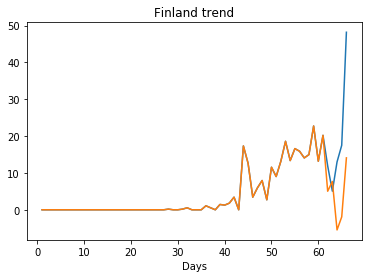

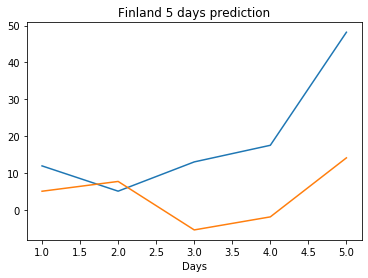

Creating directory ./offline6/Sweden/training/
Sweden
Saving the best model weights at Epoch [1], Best Valid Loss: 391.5171
Saving the best model weights at Epoch [2], Best Valid Loss: 369.0072
Saving the best model weights at Epoch [3], Best Valid Loss: 324.5787


/space/home/nzhang/anaconda3/envs/neuralnet/lib/python3.7/site-packages/torch/nn/modules/loss.py:431: UserWarning: Using a target size (torch.Size([1, 1, 5])) that is different to the input size (torch.Size([5])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/space/home/nzhang/anaconda3/envs/neuralnet/lib/python3.7/site-packages/torch/nn/modules/loss.py:431: UserWarning: Using a target size (torch.Size([1, 5])) that is different to the input size (torch.Size([5])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Saving the best model weights at Epoch [4], Best Valid Loss: 291.8377
Saving the best model weights at Epoch [5], Best Valid Loss: 254.9053
Saving the best model weights at Epoch [7], Best Valid Loss: 219.6709
Saving the best model weights at Epoch [10], Best Valid Loss: 218.1049
Saving the best model weights at Epoch [11], Best Valid Loss: 193.5654
Saving the best model weights at Epoch [12], Best Valid Loss: 188.5335
Saving the best model weights at Epoch [13], Best Valid Loss: 187.4114
Saving the best model weights at Epoch [14], Best Valid Loss: 181.0524
Saving the best model weights at Epoch [17], Best Valid Loss: 166.4715
Saving the best model weights at Epoch [19], Best Valid Loss: 162.5412
Saving the best model weights at Epoch [22], Best Valid Loss: 158.3230
Saving the best model weights at Epoch [30], Best Valid Loss: 154.9351
train error: 40.47448913341966
154.9351043701172
Saving the best model weights at Epoch [1], Best Valid Loss: 382.1983
Saving the best model weights at

Saving the best model weights at Epoch [6], Best Valid Loss: 195.6502
Saving the best model weights at Epoch [8], Best Valid Loss: 10.2719
train error: 117.02875453028186
10.271924018859863
Saving the best model weights at Epoch [1], Best Valid Loss: 272.6625
Saving the best model weights at Epoch [5], Best Valid Loss: 219.3485
Saving the best model weights at Epoch [6], Best Valid Loss: 215.2789
Saving the best model weights at Epoch [11], Best Valid Loss: 93.1060
train error: 29.326891095987683
93.10597229003906
Saving the best model weights at Epoch [1], Best Valid Loss: 382.5833
Saving the best model weights at Epoch [2], Best Valid Loss: 343.5161
Saving the best model weights at Epoch [3], Best Valid Loss: 269.9773
Saving the best model weights at Epoch [5], Best Valid Loss: 221.9285
Saving the best model weights at Epoch [9], Best Valid Loss: 212.0542
Saving the best model weights at Epoch [12], Best Valid Loss: 175.0827
Saving the best model weights at Epoch [16], Best Valid Los

Saving the best model weights at Epoch [5], Best Valid Loss: 214.0873
Saving the best model weights at Epoch [26], Best Valid Loss: 149.3136
Saving the best model weights at Epoch [37], Best Valid Loss: 141.6229
Saving the best model weights at Epoch [41], Best Valid Loss: 108.7755
train error: 29.12900900018626
108.7755126953125
Saving the best model weights at Epoch [1], Best Valid Loss: 260.4888
Saving the best model weights at Epoch [22], Best Valid Loss: 121.4530
train error: 83.98775528217185
121.4530258178711
Saving the best model weights at Epoch [1], Best Valid Loss: 606.5496
Saving the best model weights at Epoch [2], Best Valid Loss: 347.1635
Saving the best model weights at Epoch [7], Best Valid Loss: 251.6571
Saving the best model weights at Epoch [24], Best Valid Loss: 206.5419
Saving the best model weights at Epoch [25], Best Valid Loss: 190.3813
train error: 95.52703341122331
190.38133239746094
Saving the best model weights at Epoch [1], Best Valid Loss: 426.5637
Saving

Saving the best model weights at Epoch [8], Best Valid Loss: 270.3267
Saving the best model weights at Epoch [9], Best Valid Loss: 249.1594
Saving the best model weights at Epoch [14], Best Valid Loss: 243.2986
Saving the best model weights at Epoch [15], Best Valid Loss: 226.4280
Saving the best model weights at Epoch [42], Best Valid Loss: 216.4170
Saving the best model weights at Epoch [43], Best Valid Loss: 209.2628
train error: 35.88362571288799
209.26284790039062
Saving the best model weights at Epoch [1], Best Valid Loss: 601.4493
Saving the best model weights at Epoch [2], Best Valid Loss: 404.2389
Saving the best model weights at Epoch [4], Best Valid Loss: 336.0425
Saving the best model weights at Epoch [7], Best Valid Loss: 332.3278
Saving the best model weights at Epoch [8], Best Valid Loss: 277.0887
Saving the best model weights at Epoch [9], Best Valid Loss: 244.8973
Saving the best model weights at Epoch [15], Best Valid Loss: 219.9278
Saving the best model weights at Ep

Saving the best model weights at Epoch [11], Best Valid Loss: 251.4266
Saving the best model weights at Epoch [12], Best Valid Loss: 248.8259
Saving the best model weights at Epoch [14], Best Valid Loss: 235.2617
Saving the best model weights at Epoch [17], Best Valid Loss: 217.9441
Saving the best model weights at Epoch [18], Best Valid Loss: 208.0824
Saving the best model weights at Epoch [19], Best Valid Loss: 207.1170
Saving the best model weights at Epoch [21], Best Valid Loss: 204.2868
Saving the best model weights at Epoch [28], Best Valid Loss: 201.4016
Saving the best model weights at Epoch [31], Best Valid Loss: 172.1850
Saving the best model weights at Epoch [36], Best Valid Loss: 161.4573
Saving the best model weights at Epoch [40], Best Valid Loss: 136.0966
Saving the best model weights at Epoch [42], Best Valid Loss: 135.7094
Saving the best model weights at Epoch [50], Best Valid Loss: 128.0321
train error: 21.61513873677829
128.03208923339844
Saving the best model weigh

Saving the best model weights at Epoch [21], Best Valid Loss: 146.6560
Saving the best model weights at Epoch [23], Best Valid Loss: 141.7839
Saving the best model weights at Epoch [24], Best Valid Loss: 141.1931
Saving the best model weights at Epoch [25], Best Valid Loss: 137.6953
Saving the best model weights at Epoch [27], Best Valid Loss: 137.2063
Saving the best model weights at Epoch [32], Best Valid Loss: 136.9306
Saving the best model weights at Epoch [33], Best Valid Loss: 135.6258
Saving the best model weights at Epoch [34], Best Valid Loss: 135.5656
Saving the best model weights at Epoch [35], Best Valid Loss: 134.3327
Saving the best model weights at Epoch [38], Best Valid Loss: 123.2782
Saving the best model weights at Epoch [48], Best Valid Loss: 123.2243
train error: 23.513062429582252
123.22429656982422
Saving the best model weights at Epoch [1], Best Valid Loss: 764.5429
Saving the best model weights at Epoch [2], Best Valid Loss: 588.8209
Saving the best model weight

Saving the best model weights at Epoch [12], Best Valid Loss: 87.3659
Saving the best model weights at Epoch [20], Best Valid Loss: 66.5438
train error: 23.39273177241457
66.5438461303711
Saving the best model weights at Epoch [1], Best Valid Loss: 748.2406
Saving the best model weights at Epoch [2], Best Valid Loss: 337.3104
Saving the best model weights at Epoch [3], Best Valid Loss: 211.4074
Saving the best model weights at Epoch [8], Best Valid Loss: 173.2117
Saving the best model weights at Epoch [9], Best Valid Loss: 90.1475
Saving the best model weights at Epoch [27], Best Valid Loss: 88.1431
Saving the best model weights at Epoch [34], Best Valid Loss: 62.0277
Saving the best model weights at Epoch [40], Best Valid Loss: 56.6883
train error: 28.532310895621777
56.68830490112305
Saving the best model weights at Epoch [1], Best Valid Loss: 294.6677
Saving the best model weights at Epoch [2], Best Valid Loss: 236.8486
Saving the best model weights at Epoch [6], Best Valid Loss: 17

Saving the best model weights at Epoch [11], Best Valid Loss: 244.4986
Saving the best model weights at Epoch [12], Best Valid Loss: 203.8473
Saving the best model weights at Epoch [15], Best Valid Loss: 157.6481
Saving the best model weights at Epoch [16], Best Valid Loss: 147.0894
Saving the best model weights at Epoch [17], Best Valid Loss: 137.2198
Saving the best model weights at Epoch [22], Best Valid Loss: 134.1235
Saving the best model weights at Epoch [23], Best Valid Loss: 127.6093
Saving the best model weights at Epoch [27], Best Valid Loss: 95.7015
Saving the best model weights at Epoch [34], Best Valid Loss: 89.3910
train error: 25.93525718306673
89.39102935791016
Saving the best model weights at Epoch [1], Best Valid Loss: 763.0939
Saving the best model weights at Epoch [2], Best Valid Loss: 557.6364
Saving the best model weights at Epoch [3], Best Valid Loss: 388.8296
Saving the best model weights at Epoch [5], Best Valid Loss: 344.3711
Saving the best model weights at E

Saving the best model weights at Epoch [9], Best Valid Loss: 341.6210
train error: 78.29030365779482
341.6210021972656
Saving the best model weights at Epoch [1], Best Valid Loss: 828.5436
Saving the best model weights at Epoch [2], Best Valid Loss: 727.4459
Saving the best model weights at Epoch [3], Best Valid Loss: 600.1427
Saving the best model weights at Epoch [4], Best Valid Loss: 490.9687
Saving the best model weights at Epoch [5], Best Valid Loss: 421.6064
Saving the best model weights at Epoch [6], Best Valid Loss: 407.3624
Saving the best model weights at Epoch [11], Best Valid Loss: 403.0657
Saving the best model weights at Epoch [12], Best Valid Loss: 395.7272
Saving the best model weights at Epoch [13], Best Valid Loss: 393.2765
Saving the best model weights at Epoch [16], Best Valid Loss: 390.3979
Saving the best model weights at Epoch [18], Best Valid Loss: 388.9157
Saving the best model weights at Epoch [19], Best Valid Loss: 376.4047
Saving the best model weights at Ep

Saving the best model weights at Epoch [40], Best Valid Loss: 349.2856
Saving the best model weights at Epoch [41], Best Valid Loss: 343.9276
Saving the best model weights at Epoch [42], Best Valid Loss: 338.8149
Saving the best model weights at Epoch [43], Best Valid Loss: 333.8740
Saving the best model weights at Epoch [44], Best Valid Loss: 328.9647
Saving the best model weights at Epoch [45], Best Valid Loss: 324.3363
Saving the best model weights at Epoch [46], Best Valid Loss: 320.0295
Saving the best model weights at Epoch [47], Best Valid Loss: 315.8521
Saving the best model weights at Epoch [48], Best Valid Loss: 311.7627
Saving the best model weights at Epoch [49], Best Valid Loss: 307.1248
train error: 37.61262795020794
307.1248474121094
Saving the best model weights at Epoch [1], Best Valid Loss: 870.2614
Saving the best model weights at Epoch [2], Best Valid Loss: 825.9264
Saving the best model weights at Epoch [3], Best Valid Loss: 783.5794
Saving the best model weights a

Saving the best model weights at Epoch [7], Best Valid Loss: 431.7940
Saving the best model weights at Epoch [8], Best Valid Loss: 394.5354
Saving the best model weights at Epoch [9], Best Valid Loss: 366.3079
Saving the best model weights at Epoch [10], Best Valid Loss: 342.3394
Saving the best model weights at Epoch [11], Best Valid Loss: 323.8678
Saving the best model weights at Epoch [12], Best Valid Loss: 307.1907
Saving the best model weights at Epoch [13], Best Valid Loss: 294.2240
Saving the best model weights at Epoch [14], Best Valid Loss: 284.7267
Saving the best model weights at Epoch [18], Best Valid Loss: 278.5545
Saving the best model weights at Epoch [23], Best Valid Loss: 272.6652
Saving the best model weights at Epoch [24], Best Valid Loss: 255.9093
Saving the best model weights at Epoch [25], Best Valid Loss: 255.8506
Saving the best model weights at Epoch [27], Best Valid Loss: 245.1916
Saving the best model weights at Epoch [33], Best Valid Loss: 239.6550
Saving th

Saving the best model weights at Epoch [1], Best Valid Loss: 485.0543
Saving the best model weights at Epoch [2], Best Valid Loss: 218.1560
Saving the best model weights at Epoch [7], Best Valid Loss: 186.5885
Saving the best model weights at Epoch [9], Best Valid Loss: 170.7938
Saving the best model weights at Epoch [11], Best Valid Loss: 170.1348
Saving the best model weights at Epoch [13], Best Valid Loss: 146.3221
Saving the best model weights at Epoch [19], Best Valid Loss: 134.9759
Saving the best model weights at Epoch [20], Best Valid Loss: 133.2919
Saving the best model weights at Epoch [22], Best Valid Loss: 122.2206
Saving the best model weights at Epoch [32], Best Valid Loss: 119.8349
Saving the best model weights at Epoch [34], Best Valid Loss: 105.7442
Saving the best model weights at Epoch [36], Best Valid Loss: 89.8973
Saving the best model weights at Epoch [44], Best Valid Loss: 85.1174
train error: 11.841029420495033
85.11744689941406
Saving the best model weights at 

Saving the best model weights at Epoch [21], Best Valid Loss: 672.7627
Saving the best model weights at Epoch [22], Best Valid Loss: 655.5939
Saving the best model weights at Epoch [23], Best Valid Loss: 638.5539
Saving the best model weights at Epoch [24], Best Valid Loss: 621.5295
Saving the best model weights at Epoch [25], Best Valid Loss: 604.9215
Saving the best model weights at Epoch [26], Best Valid Loss: 588.5070
Saving the best model weights at Epoch [27], Best Valid Loss: 572.7487
Saving the best model weights at Epoch [28], Best Valid Loss: 557.6368
Saving the best model weights at Epoch [29], Best Valid Loss: 542.9826
Saving the best model weights at Epoch [30], Best Valid Loss: 528.8040
Saving the best model weights at Epoch [31], Best Valid Loss: 515.1733
Saving the best model weights at Epoch [32], Best Valid Loss: 502.3133
Saving the best model weights at Epoch [33], Best Valid Loss: 489.9866
Saving the best model weights at Epoch [34], Best Valid Loss: 478.1240
Saving

Saving the best model weights at Epoch [15], Best Valid Loss: 613.9411
Saving the best model weights at Epoch [16], Best Valid Loss: 579.4827
Saving the best model weights at Epoch [17], Best Valid Loss: 545.9518
Saving the best model weights at Epoch [18], Best Valid Loss: 514.2778
Saving the best model weights at Epoch [19], Best Valid Loss: 485.1057
Saving the best model weights at Epoch [20], Best Valid Loss: 458.5743
Saving the best model weights at Epoch [21], Best Valid Loss: 434.1281
Saving the best model weights at Epoch [22], Best Valid Loss: 412.5298
Saving the best model weights at Epoch [23], Best Valid Loss: 392.9420
Saving the best model weights at Epoch [24], Best Valid Loss: 375.1747
Saving the best model weights at Epoch [25], Best Valid Loss: 358.9992
Saving the best model weights at Epoch [26], Best Valid Loss: 344.3611
Saving the best model weights at Epoch [27], Best Valid Loss: 331.2055
Saving the best model weights at Epoch [28], Best Valid Loss: 319.1102
Saving

Saving the best model weights at Epoch [40], Best Valid Loss: 204.2244
Saving the best model weights at Epoch [42], Best Valid Loss: 195.2776
Saving the best model weights at Epoch [44], Best Valid Loss: 183.3782
Saving the best model weights at Epoch [45], Best Valid Loss: 179.0046
Saving the best model weights at Epoch [46], Best Valid Loss: 175.0510
Saving the best model weights at Epoch [47], Best Valid Loss: 169.5187
Saving the best model weights at Epoch [48], Best Valid Loss: 164.6316
Saving the best model weights at Epoch [49], Best Valid Loss: 160.2604
Saving the best model weights at Epoch [50], Best Valid Loss: 156.1655
train error: 22.901614016500012
156.16552734375
Saving the best model weights at Epoch [1], Best Valid Loss: 896.0732
Saving the best model weights at Epoch [2], Best Valid Loss: 876.8227
Saving the best model weights at Epoch [3], Best Valid Loss: 855.6530
Saving the best model weights at Epoch [4], Best Valid Loss: 831.1689
Saving the best model weights at 

Saving the best model weights at Epoch [13], Best Valid Loss: 215.5437
Saving the best model weights at Epoch [14], Best Valid Loss: 203.8694
Saving the best model weights at Epoch [16], Best Valid Loss: 196.0331
Saving the best model weights at Epoch [17], Best Valid Loss: 185.2098
Saving the best model weights at Epoch [18], Best Valid Loss: 178.5157
Saving the best model weights at Epoch [19], Best Valid Loss: 163.8663
Saving the best model weights at Epoch [21], Best Valid Loss: 153.4814
Saving the best model weights at Epoch [22], Best Valid Loss: 143.1245
Saving the best model weights at Epoch [23], Best Valid Loss: 129.0976
Saving the best model weights at Epoch [24], Best Valid Loss: 126.9267
Saving the best model weights at Epoch [25], Best Valid Loss: 123.4322
Saving the best model weights at Epoch [26], Best Valid Loss: 109.0769
Saving the best model weights at Epoch [27], Best Valid Loss: 105.8491
Saving the best model weights at Epoch [28], Best Valid Loss: 96.0039
Saving 

Saving the best model weights at Epoch [31], Best Valid Loss: 464.7878
Saving the best model weights at Epoch [32], Best Valid Loss: 457.6948
Saving the best model weights at Epoch [33], Best Valid Loss: 451.2693
Saving the best model weights at Epoch [34], Best Valid Loss: 446.0988
Saving the best model weights at Epoch [35], Best Valid Loss: 440.3929
Saving the best model weights at Epoch [36], Best Valid Loss: 435.3157
Saving the best model weights at Epoch [37], Best Valid Loss: 430.0737
Saving the best model weights at Epoch [38], Best Valid Loss: 426.3399
Saving the best model weights at Epoch [39], Best Valid Loss: 422.6730
Saving the best model weights at Epoch [40], Best Valid Loss: 419.4063
Saving the best model weights at Epoch [41], Best Valid Loss: 415.4793
Saving the best model weights at Epoch [42], Best Valid Loss: 412.2349
Saving the best model weights at Epoch [43], Best Valid Loss: 409.7231
Saving the best model weights at Epoch [44], Best Valid Loss: 406.7494
Saving

Saving the best model weights at Epoch [24], Best Valid Loss: 474.1873
Saving the best model weights at Epoch [25], Best Valid Loss: 454.1095
Saving the best model weights at Epoch [26], Best Valid Loss: 433.9828
Saving the best model weights at Epoch [27], Best Valid Loss: 414.1353
Saving the best model weights at Epoch [28], Best Valid Loss: 397.1637
Saving the best model weights at Epoch [29], Best Valid Loss: 382.1212
Saving the best model weights at Epoch [30], Best Valid Loss: 369.0772
Saving the best model weights at Epoch [31], Best Valid Loss: 353.6889
Saving the best model weights at Epoch [32], Best Valid Loss: 338.0680
Saving the best model weights at Epoch [33], Best Valid Loss: 324.4210
Saving the best model weights at Epoch [34], Best Valid Loss: 309.6845
Saving the best model weights at Epoch [35], Best Valid Loss: 296.1524
Saving the best model weights at Epoch [36], Best Valid Loss: 284.2796
Saving the best model weights at Epoch [37], Best Valid Loss: 273.1764
Saving

Saving the best model weights at Epoch [25], Best Valid Loss: 274.9646
Saving the best model weights at Epoch [26], Best Valid Loss: 264.2910
Saving the best model weights at Epoch [27], Best Valid Loss: 249.6790
Saving the best model weights at Epoch [28], Best Valid Loss: 240.6077
Saving the best model weights at Epoch [29], Best Valid Loss: 233.3028
Saving the best model weights at Epoch [30], Best Valid Loss: 228.8465
Saving the best model weights at Epoch [31], Best Valid Loss: 225.7258
Saving the best model weights at Epoch [32], Best Valid Loss: 216.1520
Saving the best model weights at Epoch [34], Best Valid Loss: 194.7641
Saving the best model weights at Epoch [35], Best Valid Loss: 177.2711
Saving the best model weights at Epoch [36], Best Valid Loss: 169.4359
Saving the best model weights at Epoch [37], Best Valid Loss: 161.8265
Saving the best model weights at Epoch [39], Best Valid Loss: 155.4585
Saving the best model weights at Epoch [41], Best Valid Loss: 135.6656
Saving

Saving the best model weights at Epoch [29], Best Valid Loss: 149.1933
Saving the best model weights at Epoch [30], Best Valid Loss: 134.8442
Saving the best model weights at Epoch [32], Best Valid Loss: 120.8440
Saving the best model weights at Epoch [34], Best Valid Loss: 115.0594
Saving the best model weights at Epoch [35], Best Valid Loss: 103.3049
Saving the best model weights at Epoch [36], Best Valid Loss: 98.6724
Saving the best model weights at Epoch [37], Best Valid Loss: 86.3490
Saving the best model weights at Epoch [40], Best Valid Loss: 86.3447
Saving the best model weights at Epoch [41], Best Valid Loss: 84.6394
Saving the best model weights at Epoch [42], Best Valid Loss: 81.6742
Saving the best model weights at Epoch [43], Best Valid Loss: 78.1071
Saving the best model weights at Epoch [45], Best Valid Loss: 77.4437
Saving the best model weights at Epoch [47], Best Valid Loss: 74.1944
Saving the best model weights at Epoch [49], Best Valid Loss: 72.0989
Saving the best

Saving the best model weights at Epoch [34], Best Valid Loss: 425.1813
Saving the best model weights at Epoch [35], Best Valid Loss: 423.0345
Saving the best model weights at Epoch [36], Best Valid Loss: 417.8786
Saving the best model weights at Epoch [37], Best Valid Loss: 416.9898
Saving the best model weights at Epoch [38], Best Valid Loss: 413.2188
Saving the best model weights at Epoch [39], Best Valid Loss: 411.4893
Saving the best model weights at Epoch [40], Best Valid Loss: 409.0300
Saving the best model weights at Epoch [41], Best Valid Loss: 407.6765
Saving the best model weights at Epoch [42], Best Valid Loss: 404.9783
Saving the best model weights at Epoch [43], Best Valid Loss: 403.4288
Saving the best model weights at Epoch [45], Best Valid Loss: 402.4310
Saving the best model weights at Epoch [46], Best Valid Loss: 401.6112
Saving the best model weights at Epoch [47], Best Valid Loss: 400.9068
Saving the best model weights at Epoch [48], Best Valid Loss: 399.7816
Saving

Saving the best model weights at Epoch [35], Best Valid Loss: 405.9692
Saving the best model weights at Epoch [36], Best Valid Loss: 402.6948
Saving the best model weights at Epoch [37], Best Valid Loss: 402.3707
Saving the best model weights at Epoch [38], Best Valid Loss: 398.7037
Saving the best model weights at Epoch [40], Best Valid Loss: 396.3234
Saving the best model weights at Epoch [41], Best Valid Loss: 396.2054
Saving the best model weights at Epoch [42], Best Valid Loss: 394.1775
Saving the best model weights at Epoch [43], Best Valid Loss: 392.3424
Saving the best model weights at Epoch [44], Best Valid Loss: 390.6131
Saving the best model weights at Epoch [46], Best Valid Loss: 389.7782
Saving the best model weights at Epoch [49], Best Valid Loss: 384.1839
Saving the best model weights at Epoch [50], Best Valid Loss: 382.5489
train error: 74.07036963824568
382.5488586425781
Saving the best model weights at Epoch [1], Best Valid Loss: 861.5695
Saving the best model weights

Saving the best model weights at Epoch [34], Best Valid Loss: 398.8587
Saving the best model weights at Epoch [35], Best Valid Loss: 397.2656
Saving the best model weights at Epoch [36], Best Valid Loss: 395.3967
Saving the best model weights at Epoch [37], Best Valid Loss: 389.9873
Saving the best model weights at Epoch [38], Best Valid Loss: 389.3741
Saving the best model weights at Epoch [40], Best Valid Loss: 386.4677
Saving the best model weights at Epoch [41], Best Valid Loss: 380.2209
Saving the best model weights at Epoch [42], Best Valid Loss: 379.9793
Saving the best model weights at Epoch [43], Best Valid Loss: 379.6411
Saving the best model weights at Epoch [44], Best Valid Loss: 373.0379
Saving the best model weights at Epoch [45], Best Valid Loss: 370.9857
Saving the best model weights at Epoch [46], Best Valid Loss: 366.5868
Saving the best model weights at Epoch [47], Best Valid Loss: 362.2547
Saving the best model weights at Epoch [48], Best Valid Loss: 354.3159
Saving

Saving the best model weights at Epoch [28], Best Valid Loss: 408.0936
Saving the best model weights at Epoch [29], Best Valid Loss: 399.9797
Saving the best model weights at Epoch [30], Best Valid Loss: 391.3625
Saving the best model weights at Epoch [31], Best Valid Loss: 389.1826
Saving the best model weights at Epoch [32], Best Valid Loss: 380.0622
Saving the best model weights at Epoch [33], Best Valid Loss: 373.0965
Saving the best model weights at Epoch [34], Best Valid Loss: 363.4883
Saving the best model weights at Epoch [35], Best Valid Loss: 359.0210
Saving the best model weights at Epoch [36], Best Valid Loss: 349.0691
Saving the best model weights at Epoch [37], Best Valid Loss: 335.6711
Saving the best model weights at Epoch [38], Best Valid Loss: 324.7500
Saving the best model weights at Epoch [39], Best Valid Loss: 307.1078
Saving the best model weights at Epoch [40], Best Valid Loss: 291.4668
Saving the best model weights at Epoch [41], Best Valid Loss: 274.3036
Saving

Saving the best model weights at Epoch [24], Best Valid Loss: 543.2408
Saving the best model weights at Epoch [25], Best Valid Loss: 530.0289
Saving the best model weights at Epoch [26], Best Valid Loss: 516.8997
Saving the best model weights at Epoch [27], Best Valid Loss: 506.9337
Saving the best model weights at Epoch [28], Best Valid Loss: 494.7961
Saving the best model weights at Epoch [29], Best Valid Loss: 486.4863
Saving the best model weights at Epoch [30], Best Valid Loss: 476.4715
Saving the best model weights at Epoch [31], Best Valid Loss: 468.6393
Saving the best model weights at Epoch [32], Best Valid Loss: 460.9645
Saving the best model weights at Epoch [33], Best Valid Loss: 454.0940
Saving the best model weights at Epoch [34], Best Valid Loss: 450.0591
Saving the best model weights at Epoch [35], Best Valid Loss: 442.4456
Saving the best model weights at Epoch [36], Best Valid Loss: 437.7292
Saving the best model weights at Epoch [37], Best Valid Loss: 433.9434
Saving

Saving the best model weights at Epoch [26], Best Valid Loss: 473.0630
Saving the best model weights at Epoch [27], Best Valid Loss: 463.8537
Saving the best model weights at Epoch [28], Best Valid Loss: 454.0796
Saving the best model weights at Epoch [29], Best Valid Loss: 442.9650
Saving the best model weights at Epoch [30], Best Valid Loss: 436.6932
Saving the best model weights at Epoch [31], Best Valid Loss: 431.2488
Saving the best model weights at Epoch [32], Best Valid Loss: 423.1370
Saving the best model weights at Epoch [33], Best Valid Loss: 419.0176
Saving the best model weights at Epoch [34], Best Valid Loss: 416.5918
Saving the best model weights at Epoch [35], Best Valid Loss: 413.6949
Saving the best model weights at Epoch [36], Best Valid Loss: 411.9522
Saving the best model weights at Epoch [37], Best Valid Loss: 407.0685
Saving the best model weights at Epoch [38], Best Valid Loss: 405.3962
Saving the best model weights at Epoch [39], Best Valid Loss: 402.9523
Saving

Saving the best model weights at Epoch [34], Best Valid Loss: 404.8971
Saving the best model weights at Epoch [35], Best Valid Loss: 403.0350
Saving the best model weights at Epoch [36], Best Valid Loss: 402.4072
Saving the best model weights at Epoch [37], Best Valid Loss: 401.2354
Saving the best model weights at Epoch [38], Best Valid Loss: 400.0904
Saving the best model weights at Epoch [39], Best Valid Loss: 398.4999
Saving the best model weights at Epoch [40], Best Valid Loss: 398.3231
Saving the best model weights at Epoch [42], Best Valid Loss: 398.1834
Saving the best model weights at Epoch [43], Best Valid Loss: 398.0959
Saving the best model weights at Epoch [45], Best Valid Loss: 397.9777
Saving the best model weights at Epoch [46], Best Valid Loss: 397.6757
Saving the best model weights at Epoch [47], Best Valid Loss: 395.7039
train error: 76.63344236900066
395.70391845703125
Saving the best model weights at Epoch [1], Best Valid Loss: 861.6284
Saving the best model weight

Saving the best model weights at Epoch [41], Best Valid Loss: 396.0254
Saving the best model weights at Epoch [47], Best Valid Loss: 395.1013
train error: 76.72420860158986
395.101318359375
Saving the best model weights at Epoch [1], Best Valid Loss: 854.8781
Saving the best model weights at Epoch [2], Best Valid Loss: 779.8097
Saving the best model weights at Epoch [3], Best Valid Loss: 697.2653
Saving the best model weights at Epoch [4], Best Valid Loss: 601.6013
Saving the best model weights at Epoch [5], Best Valid Loss: 493.3210
Saving the best model weights at Epoch [6], Best Valid Loss: 412.3215
Saving the best model weights at Epoch [7], Best Valid Loss: 405.8027
Saving the best model weights at Epoch [8], Best Valid Loss: 397.8837
Saving the best model weights at Epoch [11], Best Valid Loss: 392.8369
Saving the best model weights at Epoch [16], Best Valid Loss: 376.9311
Saving the best model weights at Epoch [22], Best Valid Loss: 372.9843
Saving the best model weights at Epoc

Saving the best model weights at Epoch [42], Best Valid Loss: 771.6569
Saving the best model weights at Epoch [43], Best Valid Loss: 766.4686
Saving the best model weights at Epoch [44], Best Valid Loss: 758.9260
Saving the best model weights at Epoch [45], Best Valid Loss: 752.9305
Saving the best model weights at Epoch [46], Best Valid Loss: 748.5673
Saving the best model weights at Epoch [47], Best Valid Loss: 744.6173
Saving the best model weights at Epoch [48], Best Valid Loss: 740.8199
Saving the best model weights at Epoch [49], Best Valid Loss: 737.0229
Saving the best model weights at Epoch [50], Best Valid Loss: 733.2638
train error: 133.22105605643372
733.2637939453125
Saving the best model weights at Epoch [1], Best Valid Loss: 901.7031
Saving the best model weights at Epoch [2], Best Valid Loss: 886.5320
Saving the best model weights at Epoch [3], Best Valid Loss: 871.6473
Saving the best model weights at Epoch [4], Best Valid Loss: 857.8968
Saving the best model weights a

Saving the best model weights at Epoch [8], Best Valid Loss: 855.0791
Saving the best model weights at Epoch [9], Best Valid Loss: 846.8528
Saving the best model weights at Epoch [10], Best Valid Loss: 837.3252
Saving the best model weights at Epoch [11], Best Valid Loss: 828.0740
Saving the best model weights at Epoch [12], Best Valid Loss: 817.9635
Saving the best model weights at Epoch [13], Best Valid Loss: 808.0666
Saving the best model weights at Epoch [14], Best Valid Loss: 797.7326
Saving the best model weights at Epoch [15], Best Valid Loss: 787.5825
Saving the best model weights at Epoch [16], Best Valid Loss: 777.6266
Saving the best model weights at Epoch [17], Best Valid Loss: 768.0234
Saving the best model weights at Epoch [18], Best Valid Loss: 759.0899
Saving the best model weights at Epoch [19], Best Valid Loss: 749.5190
Saving the best model weights at Epoch [20], Best Valid Loss: 740.8503
Saving the best model weights at Epoch [21], Best Valid Loss: 731.4936
Saving t

Saving the best model weights at Epoch [29], Best Valid Loss: 698.6732
Saving the best model weights at Epoch [30], Best Valid Loss: 690.7332
Saving the best model weights at Epoch [31], Best Valid Loss: 682.9187
Saving the best model weights at Epoch [32], Best Valid Loss: 675.1746
Saving the best model weights at Epoch [33], Best Valid Loss: 667.5388
Saving the best model weights at Epoch [34], Best Valid Loss: 660.0363
Saving the best model weights at Epoch [35], Best Valid Loss: 652.6034
Saving the best model weights at Epoch [36], Best Valid Loss: 645.2703
Saving the best model weights at Epoch [37], Best Valid Loss: 638.0563
Saving the best model weights at Epoch [38], Best Valid Loss: 630.9401
Saving the best model weights at Epoch [39], Best Valid Loss: 623.9053
Saving the best model weights at Epoch [40], Best Valid Loss: 616.9213
Saving the best model weights at Epoch [41], Best Valid Loss: 609.9703
Saving the best model weights at Epoch [42], Best Valid Loss: 602.9689
Saving

Saving the best model weights at Epoch [49], Best Valid Loss: 149.7848
train error: 20.608966379330077
149.78477478027344
Saving the best model weights at Epoch [1], Best Valid Loss: 907.8514
Saving the best model weights at Epoch [2], Best Valid Loss: 901.2921
Saving the best model weights at Epoch [3], Best Valid Loss: 893.7049
Saving the best model weights at Epoch [4], Best Valid Loss: 885.4551
Saving the best model weights at Epoch [5], Best Valid Loss: 876.5731
Saving the best model weights at Epoch [6], Best Valid Loss: 866.5747
Saving the best model weights at Epoch [7], Best Valid Loss: 855.7965
Saving the best model weights at Epoch [8], Best Valid Loss: 844.2202
Saving the best model weights at Epoch [9], Best Valid Loss: 831.9583
Saving the best model weights at Epoch [10], Best Valid Loss: 818.6344
Saving the best model weights at Epoch [11], Best Valid Loss: 804.7336
Saving the best model weights at Epoch [12], Best Valid Loss: 790.5328
Saving the best model weights at Ep

Saving the best model weights at Epoch [15], Best Valid Loss: 195.1213
Saving the best model weights at Epoch [16], Best Valid Loss: 193.1503
Saving the best model weights at Epoch [17], Best Valid Loss: 184.9211
Saving the best model weights at Epoch [19], Best Valid Loss: 178.9492
Saving the best model weights at Epoch [20], Best Valid Loss: 173.1481
Saving the best model weights at Epoch [21], Best Valid Loss: 169.0370
Saving the best model weights at Epoch [22], Best Valid Loss: 168.6877
Saving the best model weights at Epoch [23], Best Valid Loss: 165.0531
Saving the best model weights at Epoch [24], Best Valid Loss: 159.0073
Saving the best model weights at Epoch [25], Best Valid Loss: 153.9305
Saving the best model weights at Epoch [27], Best Valid Loss: 148.3254
Saving the best model weights at Epoch [28], Best Valid Loss: 146.6025
Saving the best model weights at Epoch [29], Best Valid Loss: 145.5433
Saving the best model weights at Epoch [30], Best Valid Loss: 138.8151
Saving

Saving the best model weights at Epoch [41], Best Valid Loss: 856.5942
Saving the best model weights at Epoch [42], Best Valid Loss: 855.0754
Saving the best model weights at Epoch [43], Best Valid Loss: 853.4443
Saving the best model weights at Epoch [44], Best Valid Loss: 851.8385
Saving the best model weights at Epoch [45], Best Valid Loss: 850.3420
Saving the best model weights at Epoch [46], Best Valid Loss: 848.6924
Saving the best model weights at Epoch [47], Best Valid Loss: 847.0906
Saving the best model weights at Epoch [48], Best Valid Loss: 845.4967
Saving the best model weights at Epoch [49], Best Valid Loss: 843.8926
Saving the best model weights at Epoch [50], Best Valid Loss: 842.2823
train error: 166.76151530804304
842.2823486328125
Saving the best model weights at Epoch [1], Best Valid Loss: 902.1110
Saving the best model weights at Epoch [2], Best Valid Loss: 894.3647
Saving the best model weights at Epoch [3], Best Valid Loss: 885.9648
Saving the best model weights 

Saving the best model weights at Epoch [5], Best Valid Loss: 907.3896
Saving the best model weights at Epoch [6], Best Valid Loss: 905.7511
Saving the best model weights at Epoch [7], Best Valid Loss: 903.9845
Saving the best model weights at Epoch [8], Best Valid Loss: 902.3214
Saving the best model weights at Epoch [9], Best Valid Loss: 900.5670
Saving the best model weights at Epoch [10], Best Valid Loss: 898.9580
Saving the best model weights at Epoch [11], Best Valid Loss: 897.1855
Saving the best model weights at Epoch [12], Best Valid Loss: 895.4424
Saving the best model weights at Epoch [13], Best Valid Loss: 893.8097
Saving the best model weights at Epoch [14], Best Valid Loss: 892.0317
Saving the best model weights at Epoch [15], Best Valid Loss: 890.3385
Saving the best model weights at Epoch [16], Best Valid Loss: 888.6266
Saving the best model weights at Epoch [17], Best Valid Loss: 886.8218
Saving the best model weights at Epoch [18], Best Valid Loss: 885.0947
Saving the 

Saving the best model weights at Epoch [22], Best Valid Loss: 889.9599
Saving the best model weights at Epoch [23], Best Valid Loss: 888.8795
Saving the best model weights at Epoch [24], Best Valid Loss: 887.8073
Saving the best model weights at Epoch [25], Best Valid Loss: 886.7127
Saving the best model weights at Epoch [26], Best Valid Loss: 885.6071
Saving the best model weights at Epoch [27], Best Valid Loss: 884.4936
Saving the best model weights at Epoch [28], Best Valid Loss: 883.3694
Saving the best model weights at Epoch [29], Best Valid Loss: 882.2108
Saving the best model weights at Epoch [30], Best Valid Loss: 881.0529
Saving the best model weights at Epoch [31], Best Valid Loss: 879.8696
Saving the best model weights at Epoch [32], Best Valid Loss: 878.6752
Saving the best model weights at Epoch [33], Best Valid Loss: 877.4575
Saving the best model weights at Epoch [34], Best Valid Loss: 876.2267
Saving the best model weights at Epoch [35], Best Valid Loss: 874.9750
Saving

Saving the best model weights at Epoch [40], Best Valid Loss: 238.0030
Saving the best model weights at Epoch [41], Best Valid Loss: 232.9687
Saving the best model weights at Epoch [42], Best Valid Loss: 230.8504
Saving the best model weights at Epoch [43], Best Valid Loss: 225.1020
Saving the best model weights at Epoch [45], Best Valid Loss: 214.7928
Saving the best model weights at Epoch [46], Best Valid Loss: 210.3897
Saving the best model weights at Epoch [50], Best Valid Loss: 193.6856
train error: 26.715239064446813
193.68557739257812
Saving the best model weights at Epoch [1], Best Valid Loss: 908.5994
Saving the best model weights at Epoch [2], Best Valid Loss: 907.4953
Saving the best model weights at Epoch [3], Best Valid Loss: 906.3919
Saving the best model weights at Epoch [4], Best Valid Loss: 905.3029
Saving the best model weights at Epoch [5], Best Valid Loss: 904.1949
Saving the best model weights at Epoch [6], Best Valid Loss: 903.0949
Saving the best model weights at

Saving the best model weights at Epoch [8], Best Valid Loss: 789.7269
Saving the best model weights at Epoch [9], Best Valid Loss: 749.1948
Saving the best model weights at Epoch [10], Best Valid Loss: 704.4375
Saving the best model weights at Epoch [11], Best Valid Loss: 648.6714
Saving the best model weights at Epoch [12], Best Valid Loss: 580.0395
Saving the best model weights at Epoch [13], Best Valid Loss: 520.4139
Saving the best model weights at Epoch [14], Best Valid Loss: 457.3446
Saving the best model weights at Epoch [15], Best Valid Loss: 398.2572
Saving the best model weights at Epoch [16], Best Valid Loss: 353.2372
Saving the best model weights at Epoch [17], Best Valid Loss: 323.1836
Saving the best model weights at Epoch [18], Best Valid Loss: 296.0478
Saving the best model weights at Epoch [19], Best Valid Loss: 274.9808
Saving the best model weights at Epoch [20], Best Valid Loss: 256.1470
Saving the best model weights at Epoch [21], Best Valid Loss: 243.1072
Saving t

Saving the best model weights at Epoch [32], Best Valid Loss: 862.8768
Saving the best model weights at Epoch [33], Best Valid Loss: 861.3838
Saving the best model weights at Epoch [34], Best Valid Loss: 859.8776
Saving the best model weights at Epoch [35], Best Valid Loss: 858.4194
Saving the best model weights at Epoch [36], Best Valid Loss: 856.8900
Saving the best model weights at Epoch [37], Best Valid Loss: 855.3963
Saving the best model weights at Epoch [38], Best Valid Loss: 853.8976
Saving the best model weights at Epoch [39], Best Valid Loss: 852.4031
Saving the best model weights at Epoch [40], Best Valid Loss: 850.9386
Saving the best model weights at Epoch [41], Best Valid Loss: 849.4326
Saving the best model weights at Epoch [42], Best Valid Loss: 847.9510
Saving the best model weights at Epoch [43], Best Valid Loss: 846.4674
Saving the best model weights at Epoch [44], Best Valid Loss: 844.9742
Saving the best model weights at Epoch [45], Best Valid Loss: 843.4672
Saving

Saving the best model weights at Epoch [48], Best Valid Loss: 876.9510
Saving the best model weights at Epoch [49], Best Valid Loss: 876.1098
Saving the best model weights at Epoch [50], Best Valid Loss: 875.2633
train error: 177.96947766378008
875.2633056640625
Saving the best model weights at Epoch [1], Best Valid Loss: 910.5233
Saving the best model weights at Epoch [2], Best Valid Loss: 908.9670
Saving the best model weights at Epoch [3], Best Valid Loss: 907.3590
Saving the best model weights at Epoch [4], Best Valid Loss: 905.7654
Saving the best model weights at Epoch [5], Best Valid Loss: 904.1875
Saving the best model weights at Epoch [6], Best Valid Loss: 902.6486
Saving the best model weights at Epoch [7], Best Valid Loss: 901.1078
Saving the best model weights at Epoch [8], Best Valid Loss: 899.4877
Saving the best model weights at Epoch [9], Best Valid Loss: 897.9406
Saving the best model weights at Epoch [10], Best Valid Loss: 896.3768
Saving the best model weights at Epo

Saving the best model weights at Epoch [12], Best Valid Loss: 905.2886
Saving the best model weights at Epoch [13], Best Valid Loss: 904.4248
Saving the best model weights at Epoch [14], Best Valid Loss: 903.5538
Saving the best model weights at Epoch [15], Best Valid Loss: 902.6916
Saving the best model weights at Epoch [16], Best Valid Loss: 901.8256
Saving the best model weights at Epoch [17], Best Valid Loss: 900.9648
Saving the best model weights at Epoch [18], Best Valid Loss: 900.1054
Saving the best model weights at Epoch [19], Best Valid Loss: 899.2433
Saving the best model weights at Epoch [20], Best Valid Loss: 898.3877
Saving the best model weights at Epoch [21], Best Valid Loss: 897.5254
Saving the best model weights at Epoch [22], Best Valid Loss: 896.6727
Saving the best model weights at Epoch [23], Best Valid Loss: 895.8090
Saving the best model weights at Epoch [24], Best Valid Loss: 894.9627
Saving the best model weights at Epoch [25], Best Valid Loss: 894.1015
Saving

Saving the best model weights at Epoch [29], Best Valid Loss: 624.8569
Saving the best model weights at Epoch [30], Best Valid Loss: 608.5764
Saving the best model weights at Epoch [31], Best Valid Loss: 588.3577
Saving the best model weights at Epoch [32], Best Valid Loss: 572.5067
Saving the best model weights at Epoch [33], Best Valid Loss: 554.5848
Saving the best model weights at Epoch [34], Best Valid Loss: 531.0714
Saving the best model weights at Epoch [35], Best Valid Loss: 513.4502
Saving the best model weights at Epoch [36], Best Valid Loss: 494.2075
Saving the best model weights at Epoch [37], Best Valid Loss: 473.5024
Saving the best model weights at Epoch [38], Best Valid Loss: 456.7861
Saving the best model weights at Epoch [39], Best Valid Loss: 433.0194
Saving the best model weights at Epoch [40], Best Valid Loss: 416.2791
Saving the best model weights at Epoch [41], Best Valid Loss: 397.6883
Saving the best model weights at Epoch [42], Best Valid Loss: 383.3989
Saving

Saving the best model weights at Epoch [46], Best Valid Loss: 839.7666
Saving the best model weights at Epoch [47], Best Valid Loss: 838.0704
Saving the best model weights at Epoch [48], Best Valid Loss: 836.4847
Saving the best model weights at Epoch [49], Best Valid Loss: 834.7885
Saving the best model weights at Epoch [50], Best Valid Loss: 833.1704
train error: 163.66473697999427
833.17041015625
Saving the best model weights at Epoch [1], Best Valid Loss: 907.8566
Saving the best model weights at Epoch [2], Best Valid Loss: 900.1943
Saving the best model weights at Epoch [3], Best Valid Loss: 892.5121
Saving the best model weights at Epoch [4], Best Valid Loss: 884.3675
Saving the best model weights at Epoch [5], Best Valid Loss: 876.9500
Saving the best model weights at Epoch [6], Best Valid Loss: 869.7653
Saving the best model weights at Epoch [7], Best Valid Loss: 861.6824
Saving the best model weights at Epoch [8], Best Valid Loss: 854.1971
Saving the best model weights at Epoc

Saving the best model weights at Epoch [14], Best Valid Loss: 892.5601
Saving the best model weights at Epoch [15], Best Valid Loss: 891.1423
Saving the best model weights at Epoch [16], Best Valid Loss: 889.6593
Saving the best model weights at Epoch [17], Best Valid Loss: 888.1992
Saving the best model weights at Epoch [18], Best Valid Loss: 886.7784
Saving the best model weights at Epoch [19], Best Valid Loss: 885.2892
Saving the best model weights at Epoch [20], Best Valid Loss: 883.9002
Saving the best model weights at Epoch [21], Best Valid Loss: 882.4266
Saving the best model weights at Epoch [22], Best Valid Loss: 880.9858
Saving the best model weights at Epoch [23], Best Valid Loss: 879.5548
Saving the best model weights at Epoch [24], Best Valid Loss: 878.1522
Saving the best model weights at Epoch [25], Best Valid Loss: 876.7150
Saving the best model weights at Epoch [26], Best Valid Loss: 875.3065
Saving the best model weights at Epoch [27], Best Valid Loss: 873.8979
Saving

Saving the best model weights at Epoch [30], Best Valid Loss: 889.2101
Saving the best model weights at Epoch [31], Best Valid Loss: 888.3603
Saving the best model weights at Epoch [32], Best Valid Loss: 887.5190
Saving the best model weights at Epoch [33], Best Valid Loss: 886.6689
Saving the best model weights at Epoch [34], Best Valid Loss: 885.8289
Saving the best model weights at Epoch [35], Best Valid Loss: 884.9838
Saving the best model weights at Epoch [36], Best Valid Loss: 884.1403
Saving the best model weights at Epoch [37], Best Valid Loss: 883.2957
Saving the best model weights at Epoch [38], Best Valid Loss: 882.4557
Saving the best model weights at Epoch [39], Best Valid Loss: 881.6187
Saving the best model weights at Epoch [40], Best Valid Loss: 880.7753
Saving the best model weights at Epoch [41], Best Valid Loss: 879.9355
Saving the best model weights at Epoch [42], Best Valid Loss: 879.0918
Saving the best model weights at Epoch [43], Best Valid Loss: 878.2563
Saving

Saving the best model weights at Epoch [45], Best Valid Loss: 510.6357
Saving the best model weights at Epoch [46], Best Valid Loss: 500.8773
Saving the best model weights at Epoch [47], Best Valid Loss: 494.2852
Saving the best model weights at Epoch [48], Best Valid Loss: 487.3817
Saving the best model weights at Epoch [49], Best Valid Loss: 478.8969
Saving the best model weights at Epoch [50], Best Valid Loss: 472.5904
train error: 80.59282478792915
472.5904235839844
Saving the best model weights at Epoch [1], Best Valid Loss: 913.8571
Saving the best model weights at Epoch [2], Best Valid Loss: 912.9736
Saving the best model weights at Epoch [3], Best Valid Loss: 912.0885
Saving the best model weights at Epoch [4], Best Valid Loss: 911.2055
Saving the best model weights at Epoch [5], Best Valid Loss: 910.3192
Saving the best model weights at Epoch [6], Best Valid Loss: 909.4463
Saving the best model weights at Epoch [7], Best Valid Loss: 908.5635
Saving the best model weights at Ep

Saving the best model weights at Epoch [10], Best Valid Loss: 837.9928
Saving the best model weights at Epoch [11], Best Valid Loss: 829.8024
Saving the best model weights at Epoch [12], Best Valid Loss: 821.9838
Saving the best model weights at Epoch [13], Best Valid Loss: 814.1645
Saving the best model weights at Epoch [14], Best Valid Loss: 805.2409
Saving the best model weights at Epoch [15], Best Valid Loss: 797.2832
Saving the best model weights at Epoch [16], Best Valid Loss: 787.4719
Saving the best model weights at Epoch [17], Best Valid Loss: 779.9007
Saving the best model weights at Epoch [18], Best Valid Loss: 770.0041
Saving the best model weights at Epoch [19], Best Valid Loss: 761.3450
Saving the best model weights at Epoch [20], Best Valid Loss: 751.4201
Saving the best model weights at Epoch [21], Best Valid Loss: 740.8415
Saving the best model weights at Epoch [22], Best Valid Loss: 731.2016
Saving the best model weights at Epoch [23], Best Valid Loss: 719.9603
Saving

Saving the best model weights at Epoch [25], Best Valid Loss: 875.1359
Saving the best model weights at Epoch [26], Best Valid Loss: 873.5908
Saving the best model weights at Epoch [27], Best Valid Loss: 872.0953
Saving the best model weights at Epoch [28], Best Valid Loss: 870.5698
Saving the best model weights at Epoch [29], Best Valid Loss: 869.0150
Saving the best model weights at Epoch [30], Best Valid Loss: 867.5524
Saving the best model weights at Epoch [31], Best Valid Loss: 866.0120
Saving the best model weights at Epoch [32], Best Valid Loss: 864.4551
Saving the best model weights at Epoch [33], Best Valid Loss: 862.9260
Saving the best model weights at Epoch [34], Best Valid Loss: 861.4781
Saving the best model weights at Epoch [35], Best Valid Loss: 859.9308
Saving the best model weights at Epoch [36], Best Valid Loss: 858.4101
Saving the best model weights at Epoch [37], Best Valid Loss: 856.9047
Saving the best model weights at Epoch [38], Best Valid Loss: 855.3449
Saving

Saving the best model weights at Epoch [40], Best Valid Loss: 870.9576
Saving the best model weights at Epoch [41], Best Valid Loss: 870.1273
Saving the best model weights at Epoch [42], Best Valid Loss: 869.2838
Saving the best model weights at Epoch [43], Best Valid Loss: 868.4511
Saving the best model weights at Epoch [44], Best Valid Loss: 867.6141
Saving the best model weights at Epoch [45], Best Valid Loss: 866.7820
Saving the best model weights at Epoch [46], Best Valid Loss: 865.9446
Saving the best model weights at Epoch [47], Best Valid Loss: 865.1125
Saving the best model weights at Epoch [48], Best Valid Loss: 864.2790
Saving the best model weights at Epoch [49], Best Valid Loss: 863.4450
Saving the best model weights at Epoch [50], Best Valid Loss: 862.6069
train error: 173.65597287231478
862.6068725585938
Saving the best model weights at Epoch [1], Best Valid Loss: 902.5835
Saving the best model weights at Epoch [2], Best Valid Loss: 901.0865
Saving the best model weights

Saving the best model weights at Epoch [4], Best Valid Loss: 905.9189
Saving the best model weights at Epoch [5], Best Valid Loss: 905.0490
Saving the best model weights at Epoch [6], Best Valid Loss: 904.1831
Saving the best model weights at Epoch [7], Best Valid Loss: 903.3175
Saving the best model weights at Epoch [8], Best Valid Loss: 902.4625
Saving the best model weights at Epoch [9], Best Valid Loss: 901.5942
Saving the best model weights at Epoch [10], Best Valid Loss: 900.7369
Saving the best model weights at Epoch [11], Best Valid Loss: 899.8828
Saving the best model weights at Epoch [12], Best Valid Loss: 899.0175
Saving the best model weights at Epoch [13], Best Valid Loss: 898.1646
Saving the best model weights at Epoch [14], Best Valid Loss: 897.3088
Saving the best model weights at Epoch [15], Best Valid Loss: 896.4531
Saving the best model weights at Epoch [16], Best Valid Loss: 895.6033
Saving the best model weights at Epoch [17], Best Valid Loss: 894.7490
Saving the b

Saving the best model weights at Epoch [19], Best Valid Loss: 764.8970
Saving the best model weights at Epoch [20], Best Valid Loss: 755.4122
Saving the best model weights at Epoch [21], Best Valid Loss: 745.5468
Saving the best model weights at Epoch [22], Best Valid Loss: 736.1132
Saving the best model weights at Epoch [23], Best Valid Loss: 726.8412
Saving the best model weights at Epoch [24], Best Valid Loss: 717.0601
Saving the best model weights at Epoch [25], Best Valid Loss: 705.3870
Saving the best model weights at Epoch [26], Best Valid Loss: 695.7106
Saving the best model weights at Epoch [27], Best Valid Loss: 685.9653
Saving the best model weights at Epoch [28], Best Valid Loss: 674.6455
Saving the best model weights at Epoch [29], Best Valid Loss: 664.5312
Saving the best model weights at Epoch [30], Best Valid Loss: 653.3113
Saving the best model weights at Epoch [31], Best Valid Loss: 643.5578
Saving the best model weights at Epoch [32], Best Valid Loss: 631.0612
Saving

Saving the best model weights at Epoch [35], Best Valid Loss: 860.9272
Saving the best model weights at Epoch [36], Best Valid Loss: 859.3839
Saving the best model weights at Epoch [37], Best Valid Loss: 857.9173
Saving the best model weights at Epoch [38], Best Valid Loss: 856.3661
Saving the best model weights at Epoch [39], Best Valid Loss: 854.9229
Saving the best model weights at Epoch [40], Best Valid Loss: 853.3613
Saving the best model weights at Epoch [41], Best Valid Loss: 851.8120
Saving the best model weights at Epoch [42], Best Valid Loss: 850.2947
Saving the best model weights at Epoch [43], Best Valid Loss: 848.7905
Saving the best model weights at Epoch [44], Best Valid Loss: 847.2778
Saving the best model weights at Epoch [45], Best Valid Loss: 845.7358
Saving the best model weights at Epoch [46], Best Valid Loss: 844.2619
Saving the best model weights at Epoch [47], Best Valid Loss: 842.7108
Saving the best model weights at Epoch [48], Best Valid Loss: 841.1119
Saving

Saving the best model weights at Epoch [1], Best Valid Loss: 912.7358
Saving the best model weights at Epoch [2], Best Valid Loss: 911.1182
Saving the best model weights at Epoch [3], Best Valid Loss: 909.4948
Saving the best model weights at Epoch [4], Best Valid Loss: 907.9217
Saving the best model weights at Epoch [5], Best Valid Loss: 906.4053
Saving the best model weights at Epoch [6], Best Valid Loss: 904.8309
Saving the best model weights at Epoch [7], Best Valid Loss: 903.2829
Saving the best model weights at Epoch [8], Best Valid Loss: 901.6917
Saving the best model weights at Epoch [9], Best Valid Loss: 900.1042
Saving the best model weights at Epoch [10], Best Valid Loss: 898.5922
Saving the best model weights at Epoch [11], Best Valid Loss: 897.0251
Saving the best model weights at Epoch [12], Best Valid Loss: 895.5387
Saving the best model weights at Epoch [13], Best Valid Loss: 893.9360
Saving the best model weights at Epoch [14], Best Valid Loss: 892.4111
Saving the best

Saving the best model weights at Epoch [18], Best Valid Loss: 904.3211
Saving the best model weights at Epoch [19], Best Valid Loss: 903.9420
Saving the best model weights at Epoch [20], Best Valid Loss: 903.5861
Saving the best model weights at Epoch [21], Best Valid Loss: 903.2529
Saving the best model weights at Epoch [22], Best Valid Loss: 902.9391
Saving the best model weights at Epoch [23], Best Valid Loss: 902.6428
Saving the best model weights at Epoch [24], Best Valid Loss: 902.3598
Saving the best model weights at Epoch [25], Best Valid Loss: 902.0909
Saving the best model weights at Epoch [26], Best Valid Loss: 901.8282
Saving the best model weights at Epoch [27], Best Valid Loss: 901.5776
Saving the best model weights at Epoch [28], Best Valid Loss: 901.3361
Saving the best model weights at Epoch [29], Best Valid Loss: 901.0988
Saving the best model weights at Epoch [30], Best Valid Loss: 900.8670
Saving the best model weights at Epoch [31], Best Valid Loss: 900.6420
Saving

Saving the best model weights at Epoch [34], Best Valid Loss: 863.5514
Saving the best model weights at Epoch [35], Best Valid Loss: 861.6237
Saving the best model weights at Epoch [36], Best Valid Loss: 860.0615
Saving the best model weights at Epoch [37], Best Valid Loss: 858.2070
Saving the best model weights at Epoch [38], Best Valid Loss: 856.5727
Saving the best model weights at Epoch [39], Best Valid Loss: 854.6989
Saving the best model weights at Epoch [40], Best Valid Loss: 852.9349
Saving the best model weights at Epoch [41], Best Valid Loss: 850.9250
Saving the best model weights at Epoch [42], Best Valid Loss: 848.7853
Saving the best model weights at Epoch [43], Best Valid Loss: 846.8580
Saving the best model weights at Epoch [44], Best Valid Loss: 844.7089
Saving the best model weights at Epoch [45], Best Valid Loss: 842.9346
Saving the best model weights at Epoch [46], Best Valid Loss: 840.9742
Saving the best model weights at Epoch [47], Best Valid Loss: 838.7547
Saving

Saving the best model weights at Epoch [50], Best Valid Loss: 877.4348
train error: 180.61264706030488
877.4347534179688
Saving the best model weights at Epoch [1], Best Valid Loss: 909.5842
Saving the best model weights at Epoch [2], Best Valid Loss: 907.3745
Saving the best model weights at Epoch [3], Best Valid Loss: 904.7719
Saving the best model weights at Epoch [4], Best Valid Loss: 902.9181
Saving the best model weights at Epoch [5], Best Valid Loss: 900.6559
Saving the best model weights at Epoch [6], Best Valid Loss: 897.9360
Saving the best model weights at Epoch [7], Best Valid Loss: 894.8578
Saving the best model weights at Epoch [8], Best Valid Loss: 891.9534
Saving the best model weights at Epoch [9], Best Valid Loss: 888.1754
Saving the best model weights at Epoch [10], Best Valid Loss: 884.4061
Saving the best model weights at Epoch [11], Best Valid Loss: 880.6428
Saving the best model weights at Epoch [12], Best Valid Loss: 876.9077
Saving the best model weights at Epo

Saving the best model weights at Epoch [16], Best Valid Loss: 902.3469
Saving the best model weights at Epoch [17], Best Valid Loss: 901.6431
Saving the best model weights at Epoch [18], Best Valid Loss: 900.8896
Saving the best model weights at Epoch [19], Best Valid Loss: 900.1284
Saving the best model weights at Epoch [20], Best Valid Loss: 899.3339
Saving the best model weights at Epoch [21], Best Valid Loss: 898.5320
Saving the best model weights at Epoch [22], Best Valid Loss: 897.7377
Saving the best model weights at Epoch [23], Best Valid Loss: 896.8546
Saving the best model weights at Epoch [24], Best Valid Loss: 896.0003
Saving the best model weights at Epoch [25], Best Valid Loss: 895.1756
Saving the best model weights at Epoch [26], Best Valid Loss: 894.2917
Saving the best model weights at Epoch [27], Best Valid Loss: 893.3943
Saving the best model weights at Epoch [28], Best Valid Loss: 892.4977
Saving the best model weights at Epoch [29], Best Valid Loss: 891.6127
Saving

Saving the best model weights at Epoch [31], Best Valid Loss: 890.7346
Saving the best model weights at Epoch [32], Best Valid Loss: 889.9523
Saving the best model weights at Epoch [33], Best Valid Loss: 889.1650
Saving the best model weights at Epoch [34], Best Valid Loss: 888.3784
Saving the best model weights at Epoch [35], Best Valid Loss: 887.5949
Saving the best model weights at Epoch [36], Best Valid Loss: 886.8013
Saving the best model weights at Epoch [37], Best Valid Loss: 886.0097
Saving the best model weights at Epoch [38], Best Valid Loss: 885.2207
Saving the best model weights at Epoch [39], Best Valid Loss: 884.4177
Saving the best model weights at Epoch [40], Best Valid Loss: 883.6191
Saving the best model weights at Epoch [41], Best Valid Loss: 882.8118
Saving the best model weights at Epoch [42], Best Valid Loss: 882.0058
Saving the best model weights at Epoch [43], Best Valid Loss: 881.1951
Saving the best model weights at Epoch [44], Best Valid Loss: 880.3852
Saving

Saving the best model weights at Epoch [47], Best Valid Loss: 419.2289
Saving the best model weights at Epoch [48], Best Valid Loss: 411.3313
Saving the best model weights at Epoch [49], Best Valid Loss: 404.5273
Saving the best model weights at Epoch [50], Best Valid Loss: 398.4571
train error: 56.91943925413592
398.45709228515625
Saving the best model weights at Epoch [1], Best Valid Loss: 911.1484
Saving the best model weights at Epoch [2], Best Valid Loss: 911.0516
Saving the best model weights at Epoch [3], Best Valid Loss: 910.9555
Saving the best model weights at Epoch [4], Best Valid Loss: 910.8592
Saving the best model weights at Epoch [5], Best Valid Loss: 910.7631
Saving the best model weights at Epoch [6], Best Valid Loss: 910.6670
Saving the best model weights at Epoch [7], Best Valid Loss: 910.5714
Saving the best model weights at Epoch [8], Best Valid Loss: 910.4750
Saving the best model weights at Epoch [9], Best Valid Loss: 910.3795
Saving the best model weights at Epo

Saving the best model weights at Epoch [11], Best Valid Loss: 915.6818
Saving the best model weights at Epoch [12], Best Valid Loss: 914.8959
Saving the best model weights at Epoch [13], Best Valid Loss: 914.0560
Saving the best model weights at Epoch [14], Best Valid Loss: 913.2295
Saving the best model weights at Epoch [15], Best Valid Loss: 912.4487
Saving the best model weights at Epoch [16], Best Valid Loss: 911.6398
Saving the best model weights at Epoch [17], Best Valid Loss: 910.7599
Saving the best model weights at Epoch [18], Best Valid Loss: 909.9368
Saving the best model weights at Epoch [19], Best Valid Loss: 909.1756
Saving the best model weights at Epoch [20], Best Valid Loss: 908.3798
Saving the best model weights at Epoch [21], Best Valid Loss: 907.5381
Saving the best model weights at Epoch [22], Best Valid Loss: 906.7322
Saving the best model weights at Epoch [23], Best Valid Loss: 905.9420
Saving the best model weights at Epoch [24], Best Valid Loss: 905.1356
Saving

Saving the best model weights at Epoch [26], Best Valid Loss: 910.8660
Saving the best model weights at Epoch [27], Best Valid Loss: 910.7018
Saving the best model weights at Epoch [28], Best Valid Loss: 910.5344
Saving the best model weights at Epoch [29], Best Valid Loss: 910.3745
Saving the best model weights at Epoch [30], Best Valid Loss: 910.2036
Saving the best model weights at Epoch [31], Best Valid Loss: 910.0468
Saving the best model weights at Epoch [32], Best Valid Loss: 909.8771
Saving the best model weights at Epoch [33], Best Valid Loss: 909.7155
Saving the best model weights at Epoch [34], Best Valid Loss: 909.5431
Saving the best model weights at Epoch [35], Best Valid Loss: 909.3776
Saving the best model weights at Epoch [36], Best Valid Loss: 909.2125
Saving the best model weights at Epoch [37], Best Valid Loss: 909.0480
Saving the best model weights at Epoch [38], Best Valid Loss: 908.8884
Saving the best model weights at Epoch [39], Best Valid Loss: 908.7207
Saving

Saving the best model weights at Epoch [43], Best Valid Loss: 911.1711
Saving the best model weights at Epoch [44], Best Valid Loss: 911.0750
Saving the best model weights at Epoch [45], Best Valid Loss: 910.9788
Saving the best model weights at Epoch [46], Best Valid Loss: 910.8826
Saving the best model weights at Epoch [47], Best Valid Loss: 910.7869
Saving the best model weights at Epoch [48], Best Valid Loss: 910.6906
Saving the best model weights at Epoch [49], Best Valid Loss: 910.5944
Saving the best model weights at Epoch [50], Best Valid Loss: 910.4982
train error: 190.21326746380535
910.4981689453125
Saving the best model weights at Epoch [1], Best Valid Loss: 913.5604
Saving the best model weights at Epoch [2], Best Valid Loss: 913.3834
Saving the best model weights at Epoch [3], Best Valid Loss: 913.2168
Saving the best model weights at Epoch [4], Best Valid Loss: 913.0463
Saving the best model weights at Epoch [5], Best Valid Loss: 912.8735
Saving the best model weights at

Saving the best model weights at Epoch [7], Best Valid Loss: 910.9316
Saving the best model weights at Epoch [8], Best Valid Loss: 910.8198
Saving the best model weights at Epoch [9], Best Valid Loss: 910.7094
Saving the best model weights at Epoch [10], Best Valid Loss: 910.5969
Saving the best model weights at Epoch [11], Best Valid Loss: 910.4863
Saving the best model weights at Epoch [12], Best Valid Loss: 910.3745
Saving the best model weights at Epoch [13], Best Valid Loss: 910.2635
Saving the best model weights at Epoch [14], Best Valid Loss: 910.1528
Saving the best model weights at Epoch [15], Best Valid Loss: 910.0414
Saving the best model weights at Epoch [16], Best Valid Loss: 909.9307
Saving the best model weights at Epoch [17], Best Valid Loss: 909.8212
Saving the best model weights at Epoch [18], Best Valid Loss: 909.7094
Saving the best model weights at Epoch [19], Best Valid Loss: 909.5991
Saving the best model weights at Epoch [20], Best Valid Loss: 909.4886
Saving th

Saving the best model weights at Epoch [24], Best Valid Loss: 887.7922
Saving the best model weights at Epoch [25], Best Valid Loss: 886.6685
Saving the best model weights at Epoch [26], Best Valid Loss: 885.4592
Saving the best model weights at Epoch [27], Best Valid Loss: 884.2426
Saving the best model weights at Epoch [28], Best Valid Loss: 883.0190
Saving the best model weights at Epoch [29], Best Valid Loss: 881.8315
Saving the best model weights at Epoch [30], Best Valid Loss: 880.5848
Saving the best model weights at Epoch [31], Best Valid Loss: 879.3799
Saving the best model weights at Epoch [32], Best Valid Loss: 878.2441
Saving the best model weights at Epoch [33], Best Valid Loss: 876.8135
Saving the best model weights at Epoch [34], Best Valid Loss: 875.5383
Saving the best model weights at Epoch [35], Best Valid Loss: 874.1294
Saving the best model weights at Epoch [36], Best Valid Loss: 872.8210
Saving the best model weights at Epoch [37], Best Valid Loss: 871.3627
Saving

Saving the best model weights at Epoch [41], Best Valid Loss: 901.7344
Saving the best model weights at Epoch [42], Best Valid Loss: 901.5797
Saving the best model weights at Epoch [43], Best Valid Loss: 901.4285
Saving the best model weights at Epoch [44], Best Valid Loss: 901.2725
Saving the best model weights at Epoch [45], Best Valid Loss: 901.1202
Saving the best model weights at Epoch [46], Best Valid Loss: 900.9668
Saving the best model weights at Epoch [47], Best Valid Loss: 900.8127
Saving the best model weights at Epoch [48], Best Valid Loss: 900.6606
Saving the best model weights at Epoch [49], Best Valid Loss: 900.5058
Saving the best model weights at Epoch [50], Best Valid Loss: 900.3528
train error: 187.01081593463132
900.3528442382812
Saving the best model weights at Epoch [1], Best Valid Loss: 907.8342
Saving the best model weights at Epoch [2], Best Valid Loss: 907.0123
Saving the best model weights at Epoch [3], Best Valid Loss: 906.2455
Saving the best model weights 

Saving the best model weights at Epoch [5], Best Valid Loss: 910.4637
Saving the best model weights at Epoch [6], Best Valid Loss: 910.3049
Saving the best model weights at Epoch [7], Best Valid Loss: 910.1522
Saving the best model weights at Epoch [8], Best Valid Loss: 909.9933
Saving the best model weights at Epoch [9], Best Valid Loss: 909.8356
Saving the best model weights at Epoch [10], Best Valid Loss: 909.6743
Saving the best model weights at Epoch [11], Best Valid Loss: 909.5166
Saving the best model weights at Epoch [12], Best Valid Loss: 909.3630
Saving the best model weights at Epoch [13], Best Valid Loss: 909.2108
Saving the best model weights at Epoch [14], Best Valid Loss: 909.0493
Saving the best model weights at Epoch [15], Best Valid Loss: 908.8939
Saving the best model weights at Epoch [16], Best Valid Loss: 908.7375
Saving the best model weights at Epoch [17], Best Valid Loss: 908.5783
Saving the best model weights at Epoch [18], Best Valid Loss: 908.4207
Saving the 

Saving the best model weights at Epoch [22], Best Valid Loss: 908.5224
Saving the best model weights at Epoch [23], Best Valid Loss: 908.4341
Saving the best model weights at Epoch [24], Best Valid Loss: 908.3467
Saving the best model weights at Epoch [25], Best Valid Loss: 908.2586
Saving the best model weights at Epoch [26], Best Valid Loss: 908.1709
Saving the best model weights at Epoch [27], Best Valid Loss: 908.0826
Saving the best model weights at Epoch [28], Best Valid Loss: 907.9948
Saving the best model weights at Epoch [29], Best Valid Loss: 907.9072
Saving the best model weights at Epoch [30], Best Valid Loss: 907.8198
Saving the best model weights at Epoch [31], Best Valid Loss: 907.7314
Saving the best model weights at Epoch [32], Best Valid Loss: 907.6439
Saving the best model weights at Epoch [33], Best Valid Loss: 907.5561
Saving the best model weights at Epoch [34], Best Valid Loss: 907.4688
Saving the best model weights at Epoch [35], Best Valid Loss: 907.3805
Saving

Saving the best model weights at Epoch [39], Best Valid Loss: 880.4711
Saving the best model weights at Epoch [40], Best Valid Loss: 879.7283
Saving the best model weights at Epoch [41], Best Valid Loss: 878.9462
Saving the best model weights at Epoch [42], Best Valid Loss: 878.1431
Saving the best model weights at Epoch [43], Best Valid Loss: 877.3879
Saving the best model weights at Epoch [44], Best Valid Loss: 876.5515
Saving the best model weights at Epoch [45], Best Valid Loss: 875.8457
Saving the best model weights at Epoch [46], Best Valid Loss: 875.0515
Saving the best model weights at Epoch [47], Best Valid Loss: 874.1881
Saving the best model weights at Epoch [48], Best Valid Loss: 873.4614
Saving the best model weights at Epoch [49], Best Valid Loss: 872.6813
Saving the best model weights at Epoch [50], Best Valid Loss: 871.8669
train error: 176.45023429034086
871.8668823242188
Saving the best model weights at Epoch [1], Best Valid Loss: 913.8381
Saving the best model weight

Saving the best model weights at Epoch [3], Best Valid Loss: 910.8724
Saving the best model weights at Epoch [4], Best Valid Loss: 910.1383
Saving the best model weights at Epoch [5], Best Valid Loss: 909.3377
Saving the best model weights at Epoch [6], Best Valid Loss: 908.5136
Saving the best model weights at Epoch [7], Best Valid Loss: 907.7731
Saving the best model weights at Epoch [8], Best Valid Loss: 906.9713
Saving the best model weights at Epoch [9], Best Valid Loss: 906.1298
Saving the best model weights at Epoch [10], Best Valid Loss: 905.3188
Saving the best model weights at Epoch [11], Best Valid Loss: 904.5541
Saving the best model weights at Epoch [12], Best Valid Loss: 903.7822
Saving the best model weights at Epoch [13], Best Valid Loss: 903.0148
Saving the best model weights at Epoch [14], Best Valid Loss: 902.2082
Saving the best model weights at Epoch [15], Best Valid Loss: 901.4604
Saving the best model weights at Epoch [16], Best Valid Loss: 900.6045
Saving the be

Saving the best model weights at Epoch [18], Best Valid Loss: 912.9194
Saving the best model weights at Epoch [19], Best Valid Loss: 912.7615
Saving the best model weights at Epoch [20], Best Valid Loss: 912.6038
Saving the best model weights at Epoch [21], Best Valid Loss: 912.4471
Saving the best model weights at Epoch [22], Best Valid Loss: 912.2891
Saving the best model weights at Epoch [23], Best Valid Loss: 912.1270
Saving the best model weights at Epoch [24], Best Valid Loss: 911.9761
Saving the best model weights at Epoch [25], Best Valid Loss: 911.8122
Saving the best model weights at Epoch [26], Best Valid Loss: 911.6592
Saving the best model weights at Epoch [27], Best Valid Loss: 911.5001
Saving the best model weights at Epoch [28], Best Valid Loss: 911.3366
Saving the best model weights at Epoch [29], Best Valid Loss: 911.1806
Saving the best model weights at Epoch [30], Best Valid Loss: 911.0260
Saving the best model weights at Epoch [31], Best Valid Loss: 910.8703
Saving

Saving the best model weights at Epoch [34], Best Valid Loss: 909.8770
Saving the best model weights at Epoch [35], Best Valid Loss: 909.7902
Saving the best model weights at Epoch [36], Best Valid Loss: 909.7039
Saving the best model weights at Epoch [37], Best Valid Loss: 909.6168
Saving the best model weights at Epoch [38], Best Valid Loss: 909.5301
Saving the best model weights at Epoch [39], Best Valid Loss: 909.4438
Saving the best model weights at Epoch [40], Best Valid Loss: 909.3572
Saving the best model weights at Epoch [41], Best Valid Loss: 909.2707
Saving the best model weights at Epoch [42], Best Valid Loss: 909.1843
Saving the best model weights at Epoch [43], Best Valid Loss: 909.0974
Saving the best model weights at Epoch [44], Best Valid Loss: 909.0114
Saving the best model weights at Epoch [45], Best Valid Loss: 908.9247
Saving the best model weights at Epoch [46], Best Valid Loss: 908.8381
Saving the best model weights at Epoch [47], Best Valid Loss: 908.7518
Saving

Saving the best model weights at Epoch [49], Best Valid Loss: 873.5703
Saving the best model weights at Epoch [50], Best Valid Loss: 872.8391
train error: 177.00163623330923
872.8390502929688
Saving the best model weights at Epoch [1], Best Valid Loss: 909.4565
Saving the best model weights at Epoch [2], Best Valid Loss: 909.3693
Saving the best model weights at Epoch [3], Best Valid Loss: 909.2819
Saving the best model weights at Epoch [4], Best Valid Loss: 909.1949
Saving the best model weights at Epoch [5], Best Valid Loss: 909.1075
Saving the best model weights at Epoch [6], Best Valid Loss: 909.0205
Saving the best model weights at Epoch [7], Best Valid Loss: 908.9330
Saving the best model weights at Epoch [8], Best Valid Loss: 908.8459
Saving the best model weights at Epoch [9], Best Valid Loss: 908.7590
Saving the best model weights at Epoch [10], Best Valid Loss: 908.6718
Saving the best model weights at Epoch [11], Best Valid Loss: 908.5847
Saving the best model weights at Epo

Saving the best model weights at Epoch [13], Best Valid Loss: 903.1823
Saving the best model weights at Epoch [14], Best Valid Loss: 902.3508
Saving the best model weights at Epoch [15], Best Valid Loss: 901.5309
Saving the best model weights at Epoch [16], Best Valid Loss: 900.7748
Saving the best model weights at Epoch [17], Best Valid Loss: 900.0170
Saving the best model weights at Epoch [18], Best Valid Loss: 899.2557
Saving the best model weights at Epoch [19], Best Valid Loss: 898.4789
Saving the best model weights at Epoch [20], Best Valid Loss: 897.7266
Saving the best model weights at Epoch [21], Best Valid Loss: 896.8844
Saving the best model weights at Epoch [22], Best Valid Loss: 896.1945
Saving the best model weights at Epoch [23], Best Valid Loss: 895.4443
Saving the best model weights at Epoch [24], Best Valid Loss: 894.6740
Saving the best model weights at Epoch [25], Best Valid Loss: 893.8805
Saving the best model weights at Epoch [26], Best Valid Loss: 893.1025
Saving

Saving the best model weights at Epoch [28], Best Valid Loss: 908.1746
Saving the best model weights at Epoch [29], Best Valid Loss: 908.0171
Saving the best model weights at Epoch [30], Best Valid Loss: 907.8575
Saving the best model weights at Epoch [31], Best Valid Loss: 907.7016
Saving the best model weights at Epoch [32], Best Valid Loss: 907.5438
Saving the best model weights at Epoch [33], Best Valid Loss: 907.3807
Saving the best model weights at Epoch [34], Best Valid Loss: 907.2285
Saving the best model weights at Epoch [35], Best Valid Loss: 907.0698
Saving the best model weights at Epoch [36], Best Valid Loss: 906.9078
Saving the best model weights at Epoch [37], Best Valid Loss: 906.7502
Saving the best model weights at Epoch [38], Best Valid Loss: 906.5915
Saving the best model weights at Epoch [39], Best Valid Loss: 906.4313
Saving the best model weights at Epoch [40], Best Valid Loss: 906.2775
Saving the best model weights at Epoch [41], Best Valid Loss: 906.1178
Saving

Saving the best model weights at Epoch [44], Best Valid Loss: 915.7055
Saving the best model weights at Epoch [45], Best Valid Loss: 915.6203
Saving the best model weights at Epoch [46], Best Valid Loss: 915.5353
Saving the best model weights at Epoch [47], Best Valid Loss: 915.4504
Saving the best model weights at Epoch [48], Best Valid Loss: 915.3652
Saving the best model weights at Epoch [49], Best Valid Loss: 915.2798
Saving the best model weights at Epoch [50], Best Valid Loss: 915.1951
train error: 191.46309007293192
915.1951293945312
Saving the best model weights at Epoch [1], Best Valid Loss: 910.8625
Saving the best model weights at Epoch [2], Best Valid Loss: 910.7090
Saving the best model weights at Epoch [3], Best Valid Loss: 910.5464
Saving the best model weights at Epoch [4], Best Valid Loss: 910.3943
Saving the best model weights at Epoch [5], Best Valid Loss: 910.2365
Saving the best model weights at Epoch [6], Best Valid Loss: 910.0854
Saving the best model weights at 

Saving the best model weights at Epoch [8], Best Valid Loss: 913.6471
Saving the best model weights at Epoch [9], Best Valid Loss: 913.5593
Saving the best model weights at Epoch [10], Best Valid Loss: 913.4707
Saving the best model weights at Epoch [11], Best Valid Loss: 913.3832
Saving the best model weights at Epoch [12], Best Valid Loss: 913.2954
Saving the best model weights at Epoch [13], Best Valid Loss: 913.2070
Saving the best model weights at Epoch [14], Best Valid Loss: 913.1196
Saving the best model weights at Epoch [15], Best Valid Loss: 913.0319
Saving the best model weights at Epoch [16], Best Valid Loss: 912.9440
Saving the best model weights at Epoch [17], Best Valid Loss: 912.8560
Saving the best model weights at Epoch [18], Best Valid Loss: 912.7685
Saving the best model weights at Epoch [19], Best Valid Loss: 912.6808
Saving the best model weights at Epoch [20], Best Valid Loss: 912.5926
Saving the best model weights at Epoch [21], Best Valid Loss: 912.5053
Saving t

Saving the best model weights at Epoch [24], Best Valid Loss: 894.1517
Saving the best model weights at Epoch [25], Best Valid Loss: 893.3876
Saving the best model weights at Epoch [26], Best Valid Loss: 892.6369
Saving the best model weights at Epoch [27], Best Valid Loss: 891.8690
Saving the best model weights at Epoch [28], Best Valid Loss: 891.0910
Saving the best model weights at Epoch [29], Best Valid Loss: 890.3906
Saving the best model weights at Epoch [30], Best Valid Loss: 889.6232
Saving the best model weights at Epoch [31], Best Valid Loss: 888.8467
Saving the best model weights at Epoch [32], Best Valid Loss: 888.0804
Saving the best model weights at Epoch [33], Best Valid Loss: 887.3183
Saving the best model weights at Epoch [34], Best Valid Loss: 886.6376
Saving the best model weights at Epoch [35], Best Valid Loss: 885.9055
Saving the best model weights at Epoch [36], Best Valid Loss: 885.0959
Saving the best model weights at Epoch [37], Best Valid Loss: 884.3566
Saving

Saving the best model weights at Epoch [40], Best Valid Loss: 906.1535
Saving the best model weights at Epoch [41], Best Valid Loss: 905.9951
Saving the best model weights at Epoch [42], Best Valid Loss: 905.8424
Saving the best model weights at Epoch [43], Best Valid Loss: 905.6857
Saving the best model weights at Epoch [44], Best Valid Loss: 905.5324
Saving the best model weights at Epoch [45], Best Valid Loss: 905.3823
Saving the best model weights at Epoch [46], Best Valid Loss: 905.2241
Saving the best model weights at Epoch [47], Best Valid Loss: 905.0719
Saving the best model weights at Epoch [48], Best Valid Loss: 904.9169
Saving the best model weights at Epoch [49], Best Valid Loss: 904.7643
Saving the best model weights at Epoch [50], Best Valid Loss: 904.6077
train error: 188.26468164255394
904.6077270507812
Saving the best model weights at Epoch [1], Best Valid Loss: 910.1339
Saving the best model weights at Epoch [2], Best Valid Loss: 909.3317
Saving the best model weights

Saving the best model weights at Epoch [4], Best Valid Loss: 910.1914
Saving the best model weights at Epoch [5], Best Valid Loss: 910.0391
Saving the best model weights at Epoch [6], Best Valid Loss: 909.8817
Saving the best model weights at Epoch [7], Best Valid Loss: 909.7225
Saving the best model weights at Epoch [8], Best Valid Loss: 909.5620
Saving the best model weights at Epoch [9], Best Valid Loss: 909.4043
Saving the best model weights at Epoch [10], Best Valid Loss: 909.2480
Saving the best model weights at Epoch [11], Best Valid Loss: 909.0869
Saving the best model weights at Epoch [12], Best Valid Loss: 908.9283
Saving the best model weights at Epoch [13], Best Valid Loss: 908.7747
Saving the best model weights at Epoch [14], Best Valid Loss: 908.6152
Saving the best model weights at Epoch [15], Best Valid Loss: 908.4521
Saving the best model weights at Epoch [16], Best Valid Loss: 908.3019
Saving the best model weights at Epoch [17], Best Valid Loss: 908.1398
Saving the b

Saving the best model weights at Epoch [20], Best Valid Loss: 919.2158
Saving the best model weights at Epoch [21], Best Valid Loss: 919.1875
Saving the best model weights at Epoch [22], Best Valid Loss: 919.1590
Saving the best model weights at Epoch [23], Best Valid Loss: 919.1304
Saving the best model weights at Epoch [24], Best Valid Loss: 919.1017
Saving the best model weights at Epoch [25], Best Valid Loss: 919.0731
Saving the best model weights at Epoch [26], Best Valid Loss: 919.0441
Saving the best model weights at Epoch [27], Best Valid Loss: 919.0156
Saving the best model weights at Epoch [28], Best Valid Loss: 918.9861
Saving the best model weights at Epoch [29], Best Valid Loss: 918.9570
Saving the best model weights at Epoch [30], Best Valid Loss: 918.9277
Saving the best model weights at Epoch [31], Best Valid Loss: 918.8984
Saving the best model weights at Epoch [32], Best Valid Loss: 918.8694
Saving the best model weights at Epoch [33], Best Valid Loss: 918.8395
Saving

Saving the best model weights at Epoch [36], Best Valid Loss: 903.8434
Saving the best model weights at Epoch [37], Best Valid Loss: 903.6638
Saving the best model weights at Epoch [38], Best Valid Loss: 903.5085
Saving the best model weights at Epoch [39], Best Valid Loss: 903.3456
Saving the best model weights at Epoch [40], Best Valid Loss: 903.1752
Saving the best model weights at Epoch [41], Best Valid Loss: 903.0201
Saving the best model weights at Epoch [42], Best Valid Loss: 902.8439
Saving the best model weights at Epoch [43], Best Valid Loss: 902.6708
Saving the best model weights at Epoch [44], Best Valid Loss: 902.5016
Saving the best model weights at Epoch [45], Best Valid Loss: 902.3442
Saving the best model weights at Epoch [46], Best Valid Loss: 902.1815
Saving the best model weights at Epoch [47], Best Valid Loss: 902.0043
Saving the best model weights at Epoch [48], Best Valid Loss: 901.8426
Saving the best model weights at Epoch [49], Best Valid Loss: 901.6811
Saving

Saving the best model weights at Epoch [2], Best Valid Loss: 913.5541
Saving the best model weights at Epoch [3], Best Valid Loss: 913.3371
Saving the best model weights at Epoch [4], Best Valid Loss: 913.1341
Saving the best model weights at Epoch [5], Best Valid Loss: 912.8948
Saving the best model weights at Epoch [6], Best Valid Loss: 912.6418
Saving the best model weights at Epoch [7], Best Valid Loss: 912.4330
Saving the best model weights at Epoch [8], Best Valid Loss: 912.1989
Saving the best model weights at Epoch [9], Best Valid Loss: 911.9725
Saving the best model weights at Epoch [10], Best Valid Loss: 911.7606
Saving the best model weights at Epoch [11], Best Valid Loss: 911.5270
Saving the best model weights at Epoch [12], Best Valid Loss: 911.2967
Saving the best model weights at Epoch [13], Best Valid Loss: 911.0850
Saving the best model weights at Epoch [14], Best Valid Loss: 910.8342
Saving the best model weights at Epoch [15], Best Valid Loss: 910.6295
Saving the bes

Saving the best model weights at Epoch [18], Best Valid Loss: 910.2099
Saving the best model weights at Epoch [19], Best Valid Loss: 910.0963
Saving the best model weights at Epoch [20], Best Valid Loss: 909.9811
Saving the best model weights at Epoch [21], Best Valid Loss: 909.8691
Saving the best model weights at Epoch [22], Best Valid Loss: 909.7578
Saving the best model weights at Epoch [23], Best Valid Loss: 909.6549
Saving the best model weights at Epoch [24], Best Valid Loss: 909.5377
Saving the best model weights at Epoch [25], Best Valid Loss: 909.4272
Saving the best model weights at Epoch [26], Best Valid Loss: 909.3228
Saving the best model weights at Epoch [27], Best Valid Loss: 909.2114
Saving the best model weights at Epoch [28], Best Valid Loss: 909.1030
Saving the best model weights at Epoch [29], Best Valid Loss: 908.9951
Saving the best model weights at Epoch [30], Best Valid Loss: 908.8884
Saving the best model weights at Epoch [31], Best Valid Loss: 908.7814
Saving

Saving the best model weights at Epoch [34], Best Valid Loss: 912.5508
Saving the best model weights at Epoch [35], Best Valid Loss: 912.4641
Saving the best model weights at Epoch [36], Best Valid Loss: 912.3774
Saving the best model weights at Epoch [37], Best Valid Loss: 912.2914
Saving the best model weights at Epoch [38], Best Valid Loss: 912.2055
Saving the best model weights at Epoch [39], Best Valid Loss: 912.1198
Saving the best model weights at Epoch [40], Best Valid Loss: 912.0353
Saving the best model weights at Epoch [41], Best Valid Loss: 911.9502
Saving the best model weights at Epoch [42], Best Valid Loss: 911.8660
Saving the best model weights at Epoch [43], Best Valid Loss: 911.7822
Saving the best model weights at Epoch [44], Best Valid Loss: 911.6977
Saving the best model weights at Epoch [45], Best Valid Loss: 911.6149
Saving the best model weights at Epoch [46], Best Valid Loss: 911.5309
Saving the best model weights at Epoch [47], Best Valid Loss: 911.4482
Saving

Saving the best model weights at Epoch [50], Best Valid Loss: 884.4609
train error: 182.51449080762166
884.4608764648438
Saving the best model weights at Epoch [1], Best Valid Loss: 912.4121
Saving the best model weights at Epoch [2], Best Valid Loss: 912.4020
Saving the best model weights at Epoch [3], Best Valid Loss: 912.3921
Saving the best model weights at Epoch [4], Best Valid Loss: 912.3821
Saving the best model weights at Epoch [5], Best Valid Loss: 912.3722
Saving the best model weights at Epoch [6], Best Valid Loss: 912.3622
Saving the best model weights at Epoch [7], Best Valid Loss: 912.3522
Saving the best model weights at Epoch [8], Best Valid Loss: 912.3422
Saving the best model weights at Epoch [9], Best Valid Loss: 912.3322
Saving the best model weights at Epoch [10], Best Valid Loss: 912.3224
Saving the best model weights at Epoch [11], Best Valid Loss: 912.3124
Saving the best model weights at Epoch [12], Best Valid Loss: 912.3024
Saving the best model weights at Epo

Saving the best model weights at Epoch [16], Best Valid Loss: 907.2328
Saving the best model weights at Epoch [17], Best Valid Loss: 907.1582
Saving the best model weights at Epoch [18], Best Valid Loss: 907.0729
Saving the best model weights at Epoch [19], Best Valid Loss: 906.9952
Saving the best model weights at Epoch [20], Best Valid Loss: 906.9199
Saving the best model weights at Epoch [21], Best Valid Loss: 906.8445
Saving the best model weights at Epoch [22], Best Valid Loss: 906.7594
Saving the best model weights at Epoch [23], Best Valid Loss: 906.6871
Saving the best model weights at Epoch [24], Best Valid Loss: 906.6046
Saving the best model weights at Epoch [25], Best Valid Loss: 906.5273
Saving the best model weights at Epoch [26], Best Valid Loss: 906.4484
Saving the best model weights at Epoch [27], Best Valid Loss: 906.3727
Saving the best model weights at Epoch [28], Best Valid Loss: 906.2916
Saving the best model weights at Epoch [29], Best Valid Loss: 906.2121
Saving

Saving the best model weights at Epoch [31], Best Valid Loss: 911.9567
Saving the best model weights at Epoch [32], Best Valid Loss: 911.9394
Saving the best model weights at Epoch [33], Best Valid Loss: 911.9215
Saving the best model weights at Epoch [34], Best Valid Loss: 911.9043
Saving the best model weights at Epoch [35], Best Valid Loss: 911.8872
Saving the best model weights at Epoch [36], Best Valid Loss: 911.8699
Saving the best model weights at Epoch [37], Best Valid Loss: 911.8533
Saving the best model weights at Epoch [38], Best Valid Loss: 911.8354
Saving the best model weights at Epoch [39], Best Valid Loss: 911.8185
Saving the best model weights at Epoch [40], Best Valid Loss: 911.8006
Saving the best model weights at Epoch [41], Best Valid Loss: 911.7832
Saving the best model weights at Epoch [42], Best Valid Loss: 911.7661
Saving the best model weights at Epoch [43], Best Valid Loss: 911.7488
Saving the best model weights at Epoch [44], Best Valid Loss: 911.7316
Saving

Saving the best model weights at Epoch [46], Best Valid Loss: 909.6668
Saving the best model weights at Epoch [47], Best Valid Loss: 909.6570
Saving the best model weights at Epoch [48], Best Valid Loss: 909.6474
Saving the best model weights at Epoch [49], Best Valid Loss: 909.6376
Saving the best model weights at Epoch [50], Best Valid Loss: 909.6279
train error: 190.02258274498683
909.6279296875
Saving the best model weights at Epoch [1], Best Valid Loss: 914.2420
Saving the best model weights at Epoch [2], Best Valid Loss: 914.2226
Saving the best model weights at Epoch [3], Best Valid Loss: 914.2039
Saving the best model weights at Epoch [4], Best Valid Loss: 914.1840
Saving the best model weights at Epoch [5], Best Valid Loss: 914.1650
Saving the best model weights at Epoch [6], Best Valid Loss: 914.1462
Saving the best model weights at Epoch [7], Best Valid Loss: 914.1268
Saving the best model weights at Epoch [8], Best Valid Loss: 914.1078
Saving the best model weights at Epoch

Saving the best model weights at Epoch [10], Best Valid Loss: 912.9759
Saving the best model weights at Epoch [11], Best Valid Loss: 912.9650
Saving the best model weights at Epoch [12], Best Valid Loss: 912.9542
Saving the best model weights at Epoch [13], Best Valid Loss: 912.9434
Saving the best model weights at Epoch [14], Best Valid Loss: 912.9326
Saving the best model weights at Epoch [15], Best Valid Loss: 912.9219
Saving the best model weights at Epoch [16], Best Valid Loss: 912.9111
Saving the best model weights at Epoch [17], Best Valid Loss: 912.9003
Saving the best model weights at Epoch [18], Best Valid Loss: 912.8895
Saving the best model weights at Epoch [19], Best Valid Loss: 912.8786
Saving the best model weights at Epoch [20], Best Valid Loss: 912.8678
Saving the best model weights at Epoch [21], Best Valid Loss: 912.8569
Saving the best model weights at Epoch [22], Best Valid Loss: 912.8461
Saving the best model weights at Epoch [23], Best Valid Loss: 912.8354
Saving

Saving the best model weights at Epoch [26], Best Valid Loss: 912.9106
Saving the best model weights at Epoch [27], Best Valid Loss: 912.8222
Saving the best model weights at Epoch [28], Best Valid Loss: 912.7192
Saving the best model weights at Epoch [29], Best Valid Loss: 912.6206
Saving the best model weights at Epoch [30], Best Valid Loss: 912.5350
Saving the best model weights at Epoch [31], Best Valid Loss: 912.4352
Saving the best model weights at Epoch [32], Best Valid Loss: 912.3378
Saving the best model weights at Epoch [33], Best Valid Loss: 912.2358
Saving the best model weights at Epoch [34], Best Valid Loss: 912.1425
Saving the best model weights at Epoch [35], Best Valid Loss: 912.0461
Saving the best model weights at Epoch [36], Best Valid Loss: 911.9492
Saving the best model weights at Epoch [37], Best Valid Loss: 911.8470
Saving the best model weights at Epoch [38], Best Valid Loss: 911.7595
Saving the best model weights at Epoch [39], Best Valid Loss: 911.6611
Saving

Saving the best model weights at Epoch [42], Best Valid Loss: 902.5239
Saving the best model weights at Epoch [43], Best Valid Loss: 902.5080
Saving the best model weights at Epoch [44], Best Valid Loss: 902.4917
Saving the best model weights at Epoch [45], Best Valid Loss: 902.4756
Saving the best model weights at Epoch [46], Best Valid Loss: 902.4599
Saving the best model weights at Epoch [47], Best Valid Loss: 902.4435
Saving the best model weights at Epoch [48], Best Valid Loss: 902.4279
Saving the best model weights at Epoch [49], Best Valid Loss: 902.4119
Saving the best model weights at Epoch [50], Best Valid Loss: 902.3956
train error: 187.03458102586967
902.3956298828125
Saving the best model weights at Epoch [1], Best Valid Loss: 914.5446
Saving the best model weights at Epoch [2], Best Valid Loss: 914.4632
Saving the best model weights at Epoch [3], Best Valid Loss: 914.3797
Saving the best model weights at Epoch [4], Best Valid Loss: 914.3038
Saving the best model weights a

Saving the best model weights at Epoch [6], Best Valid Loss: 908.1525
Saving the best model weights at Epoch [7], Best Valid Loss: 908.1364
Saving the best model weights at Epoch [8], Best Valid Loss: 908.1209
Saving the best model weights at Epoch [9], Best Valid Loss: 908.1043
Saving the best model weights at Epoch [10], Best Valid Loss: 908.0887
Saving the best model weights at Epoch [11], Best Valid Loss: 908.0724
Saving the best model weights at Epoch [12], Best Valid Loss: 908.0566
Saving the best model weights at Epoch [13], Best Valid Loss: 908.0407
Saving the best model weights at Epoch [14], Best Valid Loss: 908.0244
Saving the best model weights at Epoch [15], Best Valid Loss: 908.0086
Saving the best model weights at Epoch [16], Best Valid Loss: 907.9921
Saving the best model weights at Epoch [17], Best Valid Loss: 907.9766
Saving the best model weights at Epoch [18], Best Valid Loss: 907.9606
Saving the best model weights at Epoch [19], Best Valid Loss: 907.9446
Saving the

Saving the best model weights at Epoch [22], Best Valid Loss: 914.0610
Saving the best model weights at Epoch [23], Best Valid Loss: 914.0521
Saving the best model weights at Epoch [24], Best Valid Loss: 914.0432
Saving the best model weights at Epoch [25], Best Valid Loss: 914.0344
Saving the best model weights at Epoch [26], Best Valid Loss: 914.0254
Saving the best model weights at Epoch [27], Best Valid Loss: 914.0166
Saving the best model weights at Epoch [28], Best Valid Loss: 914.0076
Saving the best model weights at Epoch [29], Best Valid Loss: 913.9987
Saving the best model weights at Epoch [30], Best Valid Loss: 913.9899
Saving the best model weights at Epoch [31], Best Valid Loss: 913.9811
Saving the best model weights at Epoch [32], Best Valid Loss: 913.9721
Saving the best model weights at Epoch [33], Best Valid Loss: 913.9633
Saving the best model weights at Epoch [34], Best Valid Loss: 913.9543
Saving the best model weights at Epoch [35], Best Valid Loss: 913.9455
Saving

Saving the best model weights at Epoch [39], Best Valid Loss: 912.3188
Saving the best model weights at Epoch [40], Best Valid Loss: 912.2306
Saving the best model weights at Epoch [41], Best Valid Loss: 912.1550
Saving the best model weights at Epoch [42], Best Valid Loss: 912.0657
Saving the best model weights at Epoch [43], Best Valid Loss: 911.9916
Saving the best model weights at Epoch [44], Best Valid Loss: 911.9098
Saving the best model weights at Epoch [45], Best Valid Loss: 911.8256
Saving the best model weights at Epoch [46], Best Valid Loss: 911.7557
Saving the best model weights at Epoch [47], Best Valid Loss: 911.6662
Saving the best model weights at Epoch [48], Best Valid Loss: 911.5883
Saving the best model weights at Epoch [49], Best Valid Loss: 911.5086
Saving the best model weights at Epoch [50], Best Valid Loss: 911.4263
train error: 190.81116226135657
911.42626953125
Saving the best model weights at Epoch [1], Best Valid Loss: 913.3867
Saving the best model weights 

Saving the best model weights at Epoch [3], Best Valid Loss: 909.3455
Saving the best model weights at Epoch [4], Best Valid Loss: 909.2632
Saving the best model weights at Epoch [5], Best Valid Loss: 909.1740
Saving the best model weights at Epoch [6], Best Valid Loss: 909.1043
Saving the best model weights at Epoch [7], Best Valid Loss: 909.0240
Saving the best model weights at Epoch [8], Best Valid Loss: 908.9430
Saving the best model weights at Epoch [9], Best Valid Loss: 908.8626
Saving the best model weights at Epoch [10], Best Valid Loss: 908.7750
Saving the best model weights at Epoch [11], Best Valid Loss: 908.7018
Saving the best model weights at Epoch [12], Best Valid Loss: 908.6183
Saving the best model weights at Epoch [13], Best Valid Loss: 908.5399
Saving the best model weights at Epoch [14], Best Valid Loss: 908.4559
Saving the best model weights at Epoch [15], Best Valid Loss: 908.3801
Saving the best model weights at Epoch [16], Best Valid Loss: 908.2996
Saving the be

Saving the best model weights at Epoch [19], Best Valid Loss: 922.0582
Saving the best model weights at Epoch [20], Best Valid Loss: 922.0428
Saving the best model weights at Epoch [21], Best Valid Loss: 922.0272
Saving the best model weights at Epoch [22], Best Valid Loss: 922.0114
Saving the best model weights at Epoch [23], Best Valid Loss: 921.9958
Saving the best model weights at Epoch [24], Best Valid Loss: 921.9799
Saving the best model weights at Epoch [25], Best Valid Loss: 921.9650
Saving the best model weights at Epoch [26], Best Valid Loss: 921.9487
Saving the best model weights at Epoch [27], Best Valid Loss: 921.9328
Saving the best model weights at Epoch [28], Best Valid Loss: 921.9177
Saving the best model weights at Epoch [29], Best Valid Loss: 921.9020
Saving the best model weights at Epoch [30], Best Valid Loss: 921.8864
Saving the best model weights at Epoch [31], Best Valid Loss: 921.8713
Saving the best model weights at Epoch [32], Best Valid Loss: 921.8553
Saving

Saving the best model weights at Epoch [34], Best Valid Loss: 915.8756
Saving the best model weights at Epoch [35], Best Valid Loss: 915.8666
Saving the best model weights at Epoch [36], Best Valid Loss: 915.8576
Saving the best model weights at Epoch [37], Best Valid Loss: 915.8486
Saving the best model weights at Epoch [38], Best Valid Loss: 915.8397
Saving the best model weights at Epoch [39], Best Valid Loss: 915.8307
Saving the best model weights at Epoch [40], Best Valid Loss: 915.8218
Saving the best model weights at Epoch [41], Best Valid Loss: 915.8128
Saving the best model weights at Epoch [42], Best Valid Loss: 915.8037
Saving the best model weights at Epoch [43], Best Valid Loss: 915.7947
Saving the best model weights at Epoch [44], Best Valid Loss: 915.7858
Saving the best model weights at Epoch [45], Best Valid Loss: 915.7769
Saving the best model weights at Epoch [46], Best Valid Loss: 915.7679
Saving the best model weights at Epoch [47], Best Valid Loss: 915.7589
Saving

Saving the best model weights at Epoch [50], Best Valid Loss: 910.5841
train error: 190.02373046582116
910.5841064453125
Saving the best model weights at Epoch [1], Best Valid Loss: 915.0630
Saving the best model weights at Epoch [2], Best Valid Loss: 915.0541
Saving the best model weights at Epoch [3], Best Valid Loss: 915.0453
Saving the best model weights at Epoch [4], Best Valid Loss: 915.0366
Saving the best model weights at Epoch [5], Best Valid Loss: 915.0276
Saving the best model weights at Epoch [6], Best Valid Loss: 915.0187
Saving the best model weights at Epoch [7], Best Valid Loss: 915.0099
Saving the best model weights at Epoch [8], Best Valid Loss: 915.0010
Saving the best model weights at Epoch [9], Best Valid Loss: 914.9922
Saving the best model weights at Epoch [10], Best Valid Loss: 914.9834
Saving the best model weights at Epoch [11], Best Valid Loss: 914.9746
Saving the best model weights at Epoch [12], Best Valid Loss: 914.9656
Saving the best model weights at Epo

Saving the best model weights at Epoch [14], Best Valid Loss: 912.2723
Saving the best model weights at Epoch [15], Best Valid Loss: 912.1974
Saving the best model weights at Epoch [16], Best Valid Loss: 912.1188
Saving the best model weights at Epoch [17], Best Valid Loss: 912.0285
Saving the best model weights at Epoch [18], Best Valid Loss: 911.9526
Saving the best model weights at Epoch [19], Best Valid Loss: 911.8758
Saving the best model weights at Epoch [20], Best Valid Loss: 911.7983
Saving the best model weights at Epoch [21], Best Valid Loss: 911.7119
Saving the best model weights at Epoch [22], Best Valid Loss: 911.6325
Saving the best model weights at Epoch [23], Best Valid Loss: 911.5524
Saving the best model weights at Epoch [24], Best Valid Loss: 911.4785
Saving the best model weights at Epoch [25], Best Valid Loss: 911.3916
Saving the best model weights at Epoch [26], Best Valid Loss: 911.3145
Saving the best model weights at Epoch [27], Best Valid Loss: 911.2326
Saving

Saving the best model weights at Epoch [30], Best Valid Loss: 911.2768
Saving the best model weights at Epoch [31], Best Valid Loss: 911.2614
Saving the best model weights at Epoch [32], Best Valid Loss: 911.2458
Saving the best model weights at Epoch [33], Best Valid Loss: 911.2296
Saving the best model weights at Epoch [34], Best Valid Loss: 911.2135
Saving the best model weights at Epoch [35], Best Valid Loss: 911.1981
Saving the best model weights at Epoch [36], Best Valid Loss: 911.1816
Saving the best model weights at Epoch [37], Best Valid Loss: 911.1660
Saving the best model weights at Epoch [38], Best Valid Loss: 911.1499
Saving the best model weights at Epoch [39], Best Valid Loss: 911.1345
Saving the best model weights at Epoch [40], Best Valid Loss: 911.1183
Saving the best model weights at Epoch [41], Best Valid Loss: 911.1027
Saving the best model weights at Epoch [42], Best Valid Loss: 911.0869
Saving the best model weights at Epoch [43], Best Valid Loss: 911.0711
Saving

Saving the best model weights at Epoch [45], Best Valid Loss: 913.7836
Saving the best model weights at Epoch [46], Best Valid Loss: 913.7748
Saving the best model weights at Epoch [47], Best Valid Loss: 913.7661
Saving the best model weights at Epoch [48], Best Valid Loss: 913.7573
Saving the best model weights at Epoch [49], Best Valid Loss: 913.7485
Saving the best model weights at Epoch [50], Best Valid Loss: 913.7397
train error: 191.38119995748175
913.7396850585938
Saving the best model weights at Epoch [1], Best Valid Loss: 906.5939
Saving the best model weights at Epoch [2], Best Valid Loss: 906.5784
Saving the best model weights at Epoch [3], Best Valid Loss: 906.5630
Saving the best model weights at Epoch [4], Best Valid Loss: 906.5478
Saving the best model weights at Epoch [5], Best Valid Loss: 906.5327
Saving the best model weights at Epoch [6], Best Valid Loss: 906.5163
Saving the best model weights at Epoch [7], Best Valid Loss: 906.5014
Saving the best model weights at E

Saving the best model weights at Epoch [9], Best Valid Loss: 913.7311
Saving the best model weights at Epoch [10], Best Valid Loss: 913.7223
Saving the best model weights at Epoch [11], Best Valid Loss: 913.7133
Saving the best model weights at Epoch [12], Best Valid Loss: 913.7043
Saving the best model weights at Epoch [13], Best Valid Loss: 913.6953
Saving the best model weights at Epoch [14], Best Valid Loss: 913.6863
Saving the best model weights at Epoch [15], Best Valid Loss: 913.6774
Saving the best model weights at Epoch [16], Best Valid Loss: 913.6684
Saving the best model weights at Epoch [17], Best Valid Loss: 913.6595
Saving the best model weights at Epoch [18], Best Valid Loss: 913.6505
Saving the best model weights at Epoch [19], Best Valid Loss: 913.6416
Saving the best model weights at Epoch [20], Best Valid Loss: 913.6326
Saving the best model weights at Epoch [21], Best Valid Loss: 913.6237
Saving the best model weights at Epoch [22], Best Valid Loss: 913.6147
Saving 

Saving the best model weights at Epoch [25], Best Valid Loss: 912.7081
Saving the best model weights at Epoch [26], Best Valid Loss: 912.6281
Saving the best model weights at Epoch [27], Best Valid Loss: 912.5483
Saving the best model weights at Epoch [28], Best Valid Loss: 912.4682
Saving the best model weights at Epoch [29], Best Valid Loss: 912.3955
Saving the best model weights at Epoch [30], Best Valid Loss: 912.3181
Saving the best model weights at Epoch [31], Best Valid Loss: 912.2363
Saving the best model weights at Epoch [32], Best Valid Loss: 912.1543
Saving the best model weights at Epoch [33], Best Valid Loss: 912.0812
Saving the best model weights at Epoch [34], Best Valid Loss: 912.0026
Saving the best model weights at Epoch [35], Best Valid Loss: 911.9289
Saving the best model weights at Epoch [36], Best Valid Loss: 911.8459
Saving the best model weights at Epoch [37], Best Valid Loss: 911.7666
Saving the best model weights at Epoch [38], Best Valid Loss: 911.6927
Saving

Saving the best model weights at Epoch [40], Best Valid Loss: 908.0844
Saving the best model weights at Epoch [41], Best Valid Loss: 908.0685
Saving the best model weights at Epoch [42], Best Valid Loss: 908.0533
Saving the best model weights at Epoch [43], Best Valid Loss: 908.0370
Saving the best model weights at Epoch [44], Best Valid Loss: 908.0218
Saving the best model weights at Epoch [45], Best Valid Loss: 908.0057
Saving the best model weights at Epoch [46], Best Valid Loss: 907.9901
Saving the best model weights at Epoch [47], Best Valid Loss: 907.9743
Saving the best model weights at Epoch [48], Best Valid Loss: 907.9586
Saving the best model weights at Epoch [49], Best Valid Loss: 907.9427
Saving the best model weights at Epoch [50], Best Valid Loss: 907.9264
train error: 189.42379436873156
907.9263916015625
Saving the best model weights at Epoch [1], Best Valid Loss: 910.4838
Saving the best model weights at Epoch [2], Best Valid Loss: 910.4077
Saving the best model weights

Saving the best model weights at Epoch [4], Best Valid Loss: 910.2137
Saving the best model weights at Epoch [5], Best Valid Loss: 910.1981
Saving the best model weights at Epoch [6], Best Valid Loss: 910.1818
Saving the best model weights at Epoch [7], Best Valid Loss: 910.1660
Saving the best model weights at Epoch [8], Best Valid Loss: 910.1498
Saving the best model weights at Epoch [9], Best Valid Loss: 910.1338
Saving the best model weights at Epoch [10], Best Valid Loss: 910.1182
Saving the best model weights at Epoch [11], Best Valid Loss: 910.1024
Saving the best model weights at Epoch [12], Best Valid Loss: 910.0867
Saving the best model weights at Epoch [13], Best Valid Loss: 910.0700
Saving the best model weights at Epoch [14], Best Valid Loss: 910.0545
Saving the best model weights at Epoch [15], Best Valid Loss: 910.0383
Saving the best model weights at Epoch [16], Best Valid Loss: 910.0226
Saving the best model weights at Epoch [17], Best Valid Loss: 910.0065
Saving the b

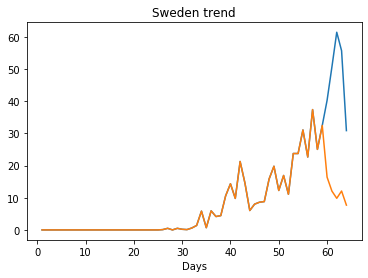

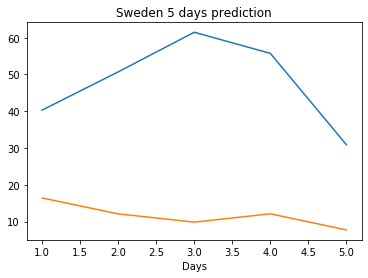

Creating directory ./offline6/Italy/training/
Italy
Saving the best model weights at Epoch [1], Best Valid Loss: 3403.4146
Saving the best model weights at Epoch [2], Best Valid Loss: 2200.1289


/space/home/nzhang/anaconda3/envs/neuralnet/lib/python3.7/site-packages/torch/nn/modules/loss.py:431: UserWarning: Using a target size (torch.Size([1, 1, 5])) that is different to the input size (torch.Size([5])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/space/home/nzhang/anaconda3/envs/neuralnet/lib/python3.7/site-packages/torch/nn/modules/loss.py:431: UserWarning: Using a target size (torch.Size([1, 5])) that is different to the input size (torch.Size([5])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Saving the best model weights at Epoch [6], Best Valid Loss: 1972.4739
Saving the best model weights at Epoch [9], Best Valid Loss: 1516.5941
Saving the best model weights at Epoch [38], Best Valid Loss: 1500.5699
Saving the best model weights at Epoch [45], Best Valid Loss: 1434.0881
train error: 1447.2208294046336
1434.088134765625
Saving the best model weights at Epoch [1], Best Valid Loss: 1760.1571
Saving the best model weights at Epoch [3], Best Valid Loss: 1636.6299
Saving the best model weights at Epoch [6], Best Valid Loss: 1422.6243
Saving the best model weights at Epoch [13], Best Valid Loss: 1296.9603
Saving the best model weights at Epoch [36], Best Valid Loss: 1232.7006
Saving the best model weights at Epoch [38], Best Valid Loss: 1049.6718
train error: 1483.1541338295772
1049.6717529296875
Saving the best model weights at Epoch [1], Best Valid Loss: 1292.7620
Saving the best model weights at Epoch [5], Best Valid Loss: 530.2906
Saving the best model weights at Epoch [6],

Saving the best model weights at Epoch [8], Best Valid Loss: 2064.4082
Saving the best model weights at Epoch [17], Best Valid Loss: 900.7990
Saving the best model weights at Epoch [18], Best Valid Loss: 900.3886
Saving the best model weights at Epoch [24], Best Valid Loss: 845.9067
train error: 13084.907521214978
845.9066772460938
Saving the best model weights at Epoch [1], Best Valid Loss: 2153.7563
Saving the best model weights at Epoch [4], Best Valid Loss: 1254.3586
Saving the best model weights at Epoch [10], Best Valid Loss: 1146.5920
Saving the best model weights at Epoch [11], Best Valid Loss: 473.0359
train error: 1498.3339945694495
473.03594970703125
Saving the best model weights at Epoch [1], Best Valid Loss: 883.7961
Saving the best model weights at Epoch [33], Best Valid Loss: 678.3503
train error: 1490.294374334401
678.3502807617188
Saving the best model weights at Epoch [1], Best Valid Loss: 1022.1411
Saving the best model weights at Epoch [4], Best Valid Loss: 910.1791

Saving the best model weights at Epoch [8], Best Valid Loss: 457.8425
Saving the best model weights at Epoch [36], Best Valid Loss: 418.3887
train error: 2522.822872819572
418.38873291015625
Saving the best model weights at Epoch [1], Best Valid Loss: 2537.0547
Saving the best model weights at Epoch [3], Best Valid Loss: 577.3382
Saving the best model weights at Epoch [9], Best Valid Loss: 523.8962
train error: 1461.495207161739
523.8961791992188
Saving the best model weights at Epoch [1], Best Valid Loss: 4747.9585
Saving the best model weights at Epoch [2], Best Valid Loss: 2149.6348
Saving the best model weights at Epoch [3], Best Valid Loss: 1014.9725
Saving the best model weights at Epoch [6], Best Valid Loss: 661.9216
train error: 1532.4022290459995
661.9215698242188
Saving the best model weights at Epoch [1], Best Valid Loss: 1179.0856
Saving the best model weights at Epoch [4], Best Valid Loss: 641.9269
Saving the best model weights at Epoch [7], Best Valid Loss: 579.8170
Savin

Saving the best model weights at Epoch [13], Best Valid Loss: 2272.9324
Saving the best model weights at Epoch [17], Best Valid Loss: 2214.8318
Saving the best model weights at Epoch [21], Best Valid Loss: 2067.7087
Saving the best model weights at Epoch [22], Best Valid Loss: 2066.5112
Saving the best model weights at Epoch [24], Best Valid Loss: 2003.3577
Saving the best model weights at Epoch [34], Best Valid Loss: 1868.8899
Saving the best model weights at Epoch [39], Best Valid Loss: 1853.8412
train error: 1371.632654124293
1853.8411865234375
Saving the best model weights at Epoch [1], Best Valid Loss: 5976.4697
Saving the best model weights at Epoch [2], Best Valid Loss: 2931.5437
Saving the best model weights at Epoch [4], Best Valid Loss: 2672.1704
Saving the best model weights at Epoch [5], Best Valid Loss: 2491.3044
Saving the best model weights at Epoch [7], Best Valid Loss: 1832.4781
Saving the best model weights at Epoch [8], Best Valid Loss: 1804.3824
Saving the best mode

Saving the best model weights at Epoch [4], Best Valid Loss: 606.3821
Saving the best model weights at Epoch [5], Best Valid Loss: 495.2864
Saving the best model weights at Epoch [10], Best Valid Loss: 473.1658
Saving the best model weights at Epoch [27], Best Valid Loss: 270.3062
Saving the best model weights at Epoch [28], Best Valid Loss: 222.2793
train error: 1607.535374082368
222.2792510986328
Saving the best model weights at Epoch [1], Best Valid Loss: 5983.2578
Saving the best model weights at Epoch [2], Best Valid Loss: 3549.1541
Saving the best model weights at Epoch [3], Best Valid Loss: 2629.0254
Saving the best model weights at Epoch [4], Best Valid Loss: 2288.1743
Saving the best model weights at Epoch [5], Best Valid Loss: 2186.6814
Saving the best model weights at Epoch [6], Best Valid Loss: 2083.5430
Saving the best model weights at Epoch [9], Best Valid Loss: 2047.3928
Saving the best model weights at Epoch [10], Best Valid Loss: 1979.4379
Saving the best model weights

Saving the best model weights at Epoch [4], Best Valid Loss: 1336.8578
Saving the best model weights at Epoch [6], Best Valid Loss: 798.0900
Saving the best model weights at Epoch [18], Best Valid Loss: 657.6149
Saving the best model weights at Epoch [23], Best Valid Loss: 267.8247
train error: 1508.4946496240025
267.8246765136719
Saving the best model weights at Epoch [1], Best Valid Loss: 4669.7495
Saving the best model weights at Epoch [2], Best Valid Loss: 1848.8375
Saving the best model weights at Epoch [7], Best Valid Loss: 1698.5820
Saving the best model weights at Epoch [8], Best Valid Loss: 1348.0435
Saving the best model weights at Epoch [11], Best Valid Loss: 1155.7438
train error: 1421.196435336409
1155.7437744140625
Saving the best model weights at Epoch [1], Best Valid Loss: 1655.8866
Saving the best model weights at Epoch [9], Best Valid Loss: 1384.2178
Saving the best model weights at Epoch [24], Best Valid Loss: 1371.1497
Saving the best model weights at Epoch [38], Be

Saving the best model weights at Epoch [16], Best Valid Loss: 5352.8188
Saving the best model weights at Epoch [17], Best Valid Loss: 5165.3960
Saving the best model weights at Epoch [18], Best Valid Loss: 4984.2661
Saving the best model weights at Epoch [19], Best Valid Loss: 4815.7144
Saving the best model weights at Epoch [20], Best Valid Loss: 4666.6797
Saving the best model weights at Epoch [21], Best Valid Loss: 4528.7061
Saving the best model weights at Epoch [22], Best Valid Loss: 4395.2896
Saving the best model weights at Epoch [23], Best Valid Loss: 4273.3726
Saving the best model weights at Epoch [24], Best Valid Loss: 4157.2290
Saving the best model weights at Epoch [25], Best Valid Loss: 4036.4187
Saving the best model weights at Epoch [26], Best Valid Loss: 3916.2876
Saving the best model weights at Epoch [27], Best Valid Loss: 3821.0125
Saving the best model weights at Epoch [28], Best Valid Loss: 3725.2056
Saving the best model weights at Epoch [29], Best Valid Loss: 36

Saving the best model weights at Epoch [3], Best Valid Loss: 5333.2607
Saving the best model weights at Epoch [4], Best Valid Loss: 4826.4097
Saving the best model weights at Epoch [7], Best Valid Loss: 4542.9946
Saving the best model weights at Epoch [8], Best Valid Loss: 4015.6021
Saving the best model weights at Epoch [9], Best Valid Loss: 4004.9207
Saving the best model weights at Epoch [10], Best Valid Loss: 3660.0833
Saving the best model weights at Epoch [12], Best Valid Loss: 3533.2305
Saving the best model weights at Epoch [13], Best Valid Loss: 3500.5369
Saving the best model weights at Epoch [14], Best Valid Loss: 3240.7468
Saving the best model weights at Epoch [15], Best Valid Loss: 3038.0925
Saving the best model weights at Epoch [16], Best Valid Loss: 2829.3982
Saving the best model weights at Epoch [18], Best Valid Loss: 2611.1267
Saving the best model weights at Epoch [19], Best Valid Loss: 2426.2837
Saving the best model weights at Epoch [24], Best Valid Loss: 2424.54

Saving the best model weights at Epoch [22], Best Valid Loss: 2320.3418
Saving the best model weights at Epoch [23], Best Valid Loss: 2179.2195
Saving the best model weights at Epoch [24], Best Valid Loss: 2075.3345
Saving the best model weights at Epoch [26], Best Valid Loss: 2040.5160
Saving the best model weights at Epoch [27], Best Valid Loss: 1956.3988
Saving the best model weights at Epoch [31], Best Valid Loss: 1908.5823
Saving the best model weights at Epoch [37], Best Valid Loss: 1842.5399
Saving the best model weights at Epoch [38], Best Valid Loss: 1775.9594
Saving the best model weights at Epoch [40], Best Valid Loss: 1700.9071
Saving the best model weights at Epoch [41], Best Valid Loss: 1620.1884
Saving the best model weights at Epoch [42], Best Valid Loss: 1534.5992
Saving the best model weights at Epoch [43], Best Valid Loss: 1466.0634
Saving the best model weights at Epoch [45], Best Valid Loss: 1370.3060
Saving the best model weights at Epoch [50], Best Valid Loss: 13

Saving the best model weights at Epoch [33], Best Valid Loss: 2050.6863
Saving the best model weights at Epoch [34], Best Valid Loss: 2039.2551
Saving the best model weights at Epoch [36], Best Valid Loss: 2029.0028
Saving the best model weights at Epoch [40], Best Valid Loss: 2024.1969
Saving the best model weights at Epoch [41], Best Valid Loss: 2018.5297
Saving the best model weights at Epoch [44], Best Valid Loss: 2015.7743
Saving the best model weights at Epoch [46], Best Valid Loss: 2012.2582
train error: 1330.7662995437097
2012.2581787109375
Saving the best model weights at Epoch [1], Best Valid Loss: 7236.0283
Saving the best model weights at Epoch [2], Best Valid Loss: 4565.6689
Saving the best model weights at Epoch [3], Best Valid Loss: 2593.4849
Saving the best model weights at Epoch [4], Best Valid Loss: 2440.0845
Saving the best model weights at Epoch [5], Best Valid Loss: 1886.2122
Saving the best model weights at Epoch [20], Best Valid Loss: 1799.6985
train error: 1371.

Saving the best model weights at Epoch [44], Best Valid Loss: 746.3895
train error: 1267.2118640768117
746.3895263671875
Saving the best model weights at Epoch [1], Best Valid Loss: 3382.3774
Saving the best model weights at Epoch [2], Best Valid Loss: 2297.3875
Saving the best model weights at Epoch [3], Best Valid Loss: 1994.9209
Saving the best model weights at Epoch [4], Best Valid Loss: 1955.1171
Saving the best model weights at Epoch [5], Best Valid Loss: 1812.2571
Saving the best model weights at Epoch [7], Best Valid Loss: 1521.6682
train error: 1387.4207666331324
1521.668212890625
Saving the best model weights at Epoch [1], Best Valid Loss: 8225.0732
Saving the best model weights at Epoch [2], Best Valid Loss: 8092.7681
Saving the best model weights at Epoch [3], Best Valid Loss: 7942.6909
Saving the best model weights at Epoch [4], Best Valid Loss: 7756.3159
Saving the best model weights at Epoch [5], Best Valid Loss: 7523.5649
Saving the best model weights at Epoch [6], Best

Saving the best model weights at Epoch [12], Best Valid Loss: 3190.8474
Saving the best model weights at Epoch [13], Best Valid Loss: 3101.0535
Saving the best model weights at Epoch [14], Best Valid Loss: 2760.6848
Saving the best model weights at Epoch [15], Best Valid Loss: 2628.0144
Saving the best model weights at Epoch [16], Best Valid Loss: 2498.8162
Saving the best model weights at Epoch [17], Best Valid Loss: 2397.2368
Saving the best model weights at Epoch [18], Best Valid Loss: 2289.9275
Saving the best model weights at Epoch [20], Best Valid Loss: 2187.3552
Saving the best model weights at Epoch [21], Best Valid Loss: 2155.6389
Saving the best model weights at Epoch [22], Best Valid Loss: 2124.5789
Saving the best model weights at Epoch [23], Best Valid Loss: 2117.3613
Saving the best model weights at Epoch [24], Best Valid Loss: 2098.2954
Saving the best model weights at Epoch [25], Best Valid Loss: 2097.3274
Saving the best model weights at Epoch [26], Best Valid Loss: 20

Saving the best model weights at Epoch [38], Best Valid Loss: 1121.1216
Saving the best model weights at Epoch [40], Best Valid Loss: 826.8388
Saving the best model weights at Epoch [43], Best Valid Loss: 775.1265
Saving the best model weights at Epoch [44], Best Valid Loss: 672.7749
Saving the best model weights at Epoch [45], Best Valid Loss: 494.8330
Saving the best model weights at Epoch [48], Best Valid Loss: 456.2134
Saving the best model weights at Epoch [50], Best Valid Loss: 454.8837
train error: 685.4953068042623
454.8836975097656
Saving the best model weights at Epoch [1], Best Valid Loss: 8127.7954
Saving the best model weights at Epoch [2], Best Valid Loss: 7754.9111
Saving the best model weights at Epoch [3], Best Valid Loss: 6026.4829
Saving the best model weights at Epoch [4], Best Valid Loss: 3171.1665
Saving the best model weights at Epoch [5], Best Valid Loss: 2819.4822
Saving the best model weights at Epoch [6], Best Valid Loss: 2373.3765
Saving the best model weigh

Saving the best model weights at Epoch [36], Best Valid Loss: 2051.0164
Saving the best model weights at Epoch [37], Best Valid Loss: 2044.9930
Saving the best model weights at Epoch [40], Best Valid Loss: 2042.6506
Saving the best model weights at Epoch [42], Best Valid Loss: 2034.9180
Saving the best model weights at Epoch [45], Best Valid Loss: 2028.5399
Saving the best model weights at Epoch [46], Best Valid Loss: 2027.4033
Saving the best model weights at Epoch [47], Best Valid Loss: 2023.7094
Saving the best model weights at Epoch [50], Best Valid Loss: 2021.1149
train error: 1323.166418141332
2021.1148681640625
Saving the best model weights at Epoch [1], Best Valid Loss: 7352.6108
Saving the best model weights at Epoch [2], Best Valid Loss: 5004.3730
Saving the best model weights at Epoch [3], Best Valid Loss: 3131.5923
Saving the best model weights at Epoch [4], Best Valid Loss: 2267.6169
Saving the best model weights at Epoch [5], Best Valid Loss: 2064.3337
Saving the best mod

Saving the best model weights at Epoch [31], Best Valid Loss: 1774.8623
Saving the best model weights at Epoch [34], Best Valid Loss: 1631.7841
Saving the best model weights at Epoch [35], Best Valid Loss: 1593.0922
Saving the best model weights at Epoch [36], Best Valid Loss: 1399.3883
Saving the best model weights at Epoch [37], Best Valid Loss: 1234.9619
Saving the best model weights at Epoch [38], Best Valid Loss: 1118.9885
Saving the best model weights at Epoch [39], Best Valid Loss: 1030.5691
Saving the best model weights at Epoch [41], Best Valid Loss: 936.8447
Saving the best model weights at Epoch [42], Best Valid Loss: 893.7543
Saving the best model weights at Epoch [43], Best Valid Loss: 815.8384
Saving the best model weights at Epoch [44], Best Valid Loss: 730.9201
train error: 1323.5939166628082
730.9201049804688
Saving the best model weights at Epoch [1], Best Valid Loss: 8130.5352
Saving the best model weights at Epoch [2], Best Valid Loss: 7865.4463
Saving the best mode

Saving the best model weights at Epoch [24], Best Valid Loss: 3131.7249
Saving the best model weights at Epoch [25], Best Valid Loss: 3028.3450
Saving the best model weights at Epoch [26], Best Valid Loss: 2934.6960
Saving the best model weights at Epoch [27], Best Valid Loss: 2850.4260
Saving the best model weights at Epoch [28], Best Valid Loss: 2774.8438
Saving the best model weights at Epoch [29], Best Valid Loss: 2708.4609
Saving the best model weights at Epoch [30], Best Valid Loss: 2647.8855
Saving the best model weights at Epoch [31], Best Valid Loss: 2592.3875
Saving the best model weights at Epoch [32], Best Valid Loss: 2540.3345
Saving the best model weights at Epoch [33], Best Valid Loss: 2495.0132
Saving the best model weights at Epoch [34], Best Valid Loss: 2452.3044
Saving the best model weights at Epoch [35], Best Valid Loss: 2412.7290
Saving the best model weights at Epoch [36], Best Valid Loss: 2378.9692
Saving the best model weights at Epoch [37], Best Valid Loss: 23

Saving the best model weights at Epoch [9], Best Valid Loss: 2736.1892
Saving the best model weights at Epoch [10], Best Valid Loss: 2513.8257
Saving the best model weights at Epoch [11], Best Valid Loss: 2336.7024
Saving the best model weights at Epoch [12], Best Valid Loss: 2213.5955
Saving the best model weights at Epoch [13], Best Valid Loss: 2152.5415
Saving the best model weights at Epoch [14], Best Valid Loss: 2095.1375
Saving the best model weights at Epoch [15], Best Valid Loss: 2056.3125
Saving the best model weights at Epoch [16], Best Valid Loss: 2025.6356
Saving the best model weights at Epoch [22], Best Valid Loss: 1988.8938
Saving the best model weights at Epoch [26], Best Valid Loss: 1987.1647
Saving the best model weights at Epoch [32], Best Valid Loss: 1978.6416
Saving the best model weights at Epoch [35], Best Valid Loss: 1953.2083
Saving the best model weights at Epoch [36], Best Valid Loss: 1901.7584
Saving the best model weights at Epoch [37], Best Valid Loss: 183

Saving the best model weights at Epoch [14], Best Valid Loss: 2025.4486
Saving the best model weights at Epoch [15], Best Valid Loss: 1892.6780
Saving the best model weights at Epoch [18], Best Valid Loss: 1817.4980
Saving the best model weights at Epoch [21], Best Valid Loss: 1741.2660
Saving the best model weights at Epoch [22], Best Valid Loss: 1730.3245
Saving the best model weights at Epoch [25], Best Valid Loss: 1415.7754
Saving the best model weights at Epoch [27], Best Valid Loss: 1289.9474
Saving the best model weights at Epoch [32], Best Valid Loss: 1212.8857
Saving the best model weights at Epoch [33], Best Valid Loss: 1144.0077
Saving the best model weights at Epoch [35], Best Valid Loss: 1002.0319
Saving the best model weights at Epoch [36], Best Valid Loss: 899.0402
Saving the best model weights at Epoch [37], Best Valid Loss: 775.3384
Saving the best model weights at Epoch [41], Best Valid Loss: 633.1786
Saving the best model weights at Epoch [42], Best Valid Loss: 572.4

Saving the best model weights at Epoch [30], Best Valid Loss: 7219.3315
Saving the best model weights at Epoch [31], Best Valid Loss: 7184.7612
Saving the best model weights at Epoch [32], Best Valid Loss: 7149.2236
Saving the best model weights at Epoch [33], Best Valid Loss: 7115.6187
Saving the best model weights at Epoch [34], Best Valid Loss: 7080.3330
Saving the best model weights at Epoch [35], Best Valid Loss: 7046.1562
Saving the best model weights at Epoch [36], Best Valid Loss: 7013.0815
Saving the best model weights at Epoch [37], Best Valid Loss: 6979.7671
Saving the best model weights at Epoch [38], Best Valid Loss: 6945.1792
Saving the best model weights at Epoch [39], Best Valid Loss: 6913.3877
Saving the best model weights at Epoch [40], Best Valid Loss: 6880.0562
Saving the best model weights at Epoch [41], Best Valid Loss: 6846.8003
Saving the best model weights at Epoch [42], Best Valid Loss: 6814.5820
Saving the best model weights at Epoch [43], Best Valid Loss: 67

Saving the best model weights at Epoch [14], Best Valid Loss: 6134.3975
Saving the best model weights at Epoch [15], Best Valid Loss: 5994.8286
Saving the best model weights at Epoch [16], Best Valid Loss: 5846.7007
Saving the best model weights at Epoch [17], Best Valid Loss: 5715.8633
Saving the best model weights at Epoch [18], Best Valid Loss: 5582.7158
Saving the best model weights at Epoch [19], Best Valid Loss: 5455.3818
Saving the best model weights at Epoch [20], Best Valid Loss: 5336.6392
Saving the best model weights at Epoch [21], Best Valid Loss: 5214.7700
Saving the best model weights at Epoch [22], Best Valid Loss: 5099.2720
Saving the best model weights at Epoch [23], Best Valid Loss: 4987.0664
Saving the best model weights at Epoch [24], Best Valid Loss: 4880.0151
Saving the best model weights at Epoch [25], Best Valid Loss: 4779.5312
Saving the best model weights at Epoch [26], Best Valid Loss: 4674.7681
Saving the best model weights at Epoch [27], Best Valid Loss: 45

Saving the best model weights at Epoch [4], Best Valid Loss: 7500.1597
Saving the best model weights at Epoch [5], Best Valid Loss: 7256.7358
Saving the best model weights at Epoch [6], Best Valid Loss: 7020.8081
Saving the best model weights at Epoch [7], Best Valid Loss: 6780.9204
Saving the best model weights at Epoch [8], Best Valid Loss: 6563.6714
Saving the best model weights at Epoch [9], Best Valid Loss: 6363.1279
Saving the best model weights at Epoch [10], Best Valid Loss: 6164.7197
Saving the best model weights at Epoch [11], Best Valid Loss: 5965.7378
Saving the best model weights at Epoch [12], Best Valid Loss: 5762.6694
Saving the best model weights at Epoch [13], Best Valid Loss: 5573.1831
Saving the best model weights at Epoch [14], Best Valid Loss: 5392.5747
Saving the best model weights at Epoch [15], Best Valid Loss: 5216.6807
Saving the best model weights at Epoch [16], Best Valid Loss: 5056.2266
Saving the best model weights at Epoch [17], Best Valid Loss: 4894.473

Saving the best model weights at Epoch [50], Best Valid Loss: 1542.3607
train error: 637.8871886812408
1542.3607177734375
Saving the best model weights at Epoch [1], Best Valid Loss: 7959.5220
Saving the best model weights at Epoch [2], Best Valid Loss: 7485.2183
Saving the best model weights at Epoch [3], Best Valid Loss: 7034.8081
Saving the best model weights at Epoch [4], Best Valid Loss: 6567.3892
Saving the best model weights at Epoch [5], Best Valid Loss: 6109.2759
Saving the best model weights at Epoch [6], Best Valid Loss: 5688.2007
Saving the best model weights at Epoch [7], Best Valid Loss: 5281.6943
Saving the best model weights at Epoch [8], Best Valid Loss: 4923.3843
Saving the best model weights at Epoch [9], Best Valid Loss: 4577.0469
Saving the best model weights at Epoch [10], Best Valid Loss: 4278.7876
Saving the best model weights at Epoch [11], Best Valid Loss: 3995.1306
Saving the best model weights at Epoch [12], Best Valid Loss: 3774.4888
Saving the best model w

Saving the best model weights at Epoch [18], Best Valid Loss: 7840.1572
Saving the best model weights at Epoch [19], Best Valid Loss: 7790.7627
Saving the best model weights at Epoch [20], Best Valid Loss: 7734.8281
Saving the best model weights at Epoch [21], Best Valid Loss: 7674.5190
Saving the best model weights at Epoch [22], Best Valid Loss: 7609.6470
Saving the best model weights at Epoch [23], Best Valid Loss: 7543.8799
Saving the best model weights at Epoch [24], Best Valid Loss: 7473.0830
Saving the best model weights at Epoch [25], Best Valid Loss: 7400.5151
Saving the best model weights at Epoch [26], Best Valid Loss: 7326.6597
Saving the best model weights at Epoch [27], Best Valid Loss: 7252.7471
Saving the best model weights at Epoch [28], Best Valid Loss: 7171.7710
Saving the best model weights at Epoch [29], Best Valid Loss: 7094.9097
Saving the best model weights at Epoch [30], Best Valid Loss: 7017.4233
Saving the best model weights at Epoch [31], Best Valid Loss: 69

Saving the best model weights at Epoch [42], Best Valid Loss: 6135.7856
Saving the best model weights at Epoch [43], Best Valid Loss: 6031.8345
Saving the best model weights at Epoch [44], Best Valid Loss: 5930.2485
Saving the best model weights at Epoch [45], Best Valid Loss: 5828.7495
Saving the best model weights at Epoch [46], Best Valid Loss: 5728.2026
Saving the best model weights at Epoch [47], Best Valid Loss: 5628.4751
Saving the best model weights at Epoch [48], Best Valid Loss: 5530.9448
Saving the best model weights at Epoch [49], Best Valid Loss: 5433.2954
Saving the best model weights at Epoch [50], Best Valid Loss: 5338.4946
train error: 2231.1791266737314
5338.49462890625
Saving the best model weights at Epoch [1], Best Valid Loss: 8334.0859
Saving the best model weights at Epoch [2], Best Valid Loss: 8303.7969
Saving the best model weights at Epoch [3], Best Valid Loss: 8273.2510
Saving the best model weights at Epoch [4], Best Valid Loss: 8241.9297
Saving the best mod

Saving the best model weights at Epoch [11], Best Valid Loss: 8174.6611
Saving the best model weights at Epoch [12], Best Valid Loss: 8149.1675
Saving the best model weights at Epoch [13], Best Valid Loss: 8121.9619
Saving the best model weights at Epoch [14], Best Valid Loss: 8092.1079
Saving the best model weights at Epoch [15], Best Valid Loss: 8059.1963
Saving the best model weights at Epoch [16], Best Valid Loss: 8013.8003
Saving the best model weights at Epoch [17], Best Valid Loss: 7969.1885
Saving the best model weights at Epoch [18], Best Valid Loss: 7920.9644
Saving the best model weights at Epoch [19], Best Valid Loss: 7865.1499
Saving the best model weights at Epoch [20], Best Valid Loss: 7799.9141
Saving the best model weights at Epoch [21], Best Valid Loss: 7724.0972
Saving the best model weights at Epoch [22], Best Valid Loss: 7646.9219
Saving the best model weights at Epoch [23], Best Valid Loss: 7562.8281
Saving the best model weights at Epoch [24], Best Valid Loss: 74

Saving the best model weights at Epoch [7], Best Valid Loss: 8195.9990
Saving the best model weights at Epoch [8], Best Valid Loss: 8162.3525
Saving the best model weights at Epoch [9], Best Valid Loss: 8121.7930
Saving the best model weights at Epoch [10], Best Valid Loss: 8072.4189
Saving the best model weights at Epoch [11], Best Valid Loss: 8012.1548
Saving the best model weights at Epoch [12], Best Valid Loss: 7945.5859
Saving the best model weights at Epoch [13], Best Valid Loss: 7864.1353
Saving the best model weights at Epoch [14], Best Valid Loss: 7763.8491
Saving the best model weights at Epoch [15], Best Valid Loss: 7645.7456
Saving the best model weights at Epoch [16], Best Valid Loss: 7510.3438
Saving the best model weights at Epoch [17], Best Valid Loss: 7357.5547
Saving the best model weights at Epoch [18], Best Valid Loss: 7184.1235
Saving the best model weights at Epoch [19], Best Valid Loss: 6994.0674
Saving the best model weights at Epoch [20], Best Valid Loss: 6790.

Saving the best model weights at Epoch [9], Best Valid Loss: 8265.2021
Saving the best model weights at Epoch [10], Best Valid Loss: 8253.3916
Saving the best model weights at Epoch [11], Best Valid Loss: 8241.4287
Saving the best model weights at Epoch [12], Best Valid Loss: 8229.5771
Saving the best model weights at Epoch [13], Best Valid Loss: 8217.6250
Saving the best model weights at Epoch [14], Best Valid Loss: 8205.6143
Saving the best model weights at Epoch [15], Best Valid Loss: 8193.5459
Saving the best model weights at Epoch [16], Best Valid Loss: 8181.4917
Saving the best model weights at Epoch [17], Best Valid Loss: 8169.3042
Saving the best model weights at Epoch [18], Best Valid Loss: 8157.0796
Saving the best model weights at Epoch [19], Best Valid Loss: 8144.7651
Saving the best model weights at Epoch [20], Best Valid Loss: 8132.4468
Saving the best model weights at Epoch [21], Best Valid Loss: 8119.9634
Saving the best model weights at Epoch [22], Best Valid Loss: 810

Saving the best model weights at Epoch [23], Best Valid Loss: 3264.0032
Saving the best model weights at Epoch [24], Best Valid Loss: 3198.3579
Saving the best model weights at Epoch [25], Best Valid Loss: 3083.8533
Saving the best model weights at Epoch [26], Best Valid Loss: 2966.8503
Saving the best model weights at Epoch [27], Best Valid Loss: 2887.0161
Saving the best model weights at Epoch [28], Best Valid Loss: 2807.2290
Saving the best model weights at Epoch [29], Best Valid Loss: 2760.9165
Saving the best model weights at Epoch [30], Best Valid Loss: 2697.8638
Saving the best model weights at Epoch [31], Best Valid Loss: 2615.7810
Saving the best model weights at Epoch [32], Best Valid Loss: 2575.9094
Saving the best model weights at Epoch [33], Best Valid Loss: 2553.3220
Saving the best model weights at Epoch [34], Best Valid Loss: 2504.8240
Saving the best model weights at Epoch [35], Best Valid Loss: 2434.3923
Saving the best model weights at Epoch [37], Best Valid Loss: 24

Saving the best model weights at Epoch [43], Best Valid Loss: 5360.7905
Saving the best model weights at Epoch [44], Best Valid Loss: 5202.4072
Saving the best model weights at Epoch [45], Best Valid Loss: 5054.9326
Saving the best model weights at Epoch [46], Best Valid Loss: 4909.3667
Saving the best model weights at Epoch [47], Best Valid Loss: 4775.6577
Saving the best model weights at Epoch [48], Best Valid Loss: 4639.4189
Saving the best model weights at Epoch [49], Best Valid Loss: 4512.7637
Saving the best model weights at Epoch [50], Best Valid Loss: 4394.4424
train error: 1853.567001605856
4394.4423828125
Saving the best model weights at Epoch [1], Best Valid Loss: 8293.2861
Saving the best model weights at Epoch [2], Best Valid Loss: 8179.4136
Saving the best model weights at Epoch [3], Best Valid Loss: 8054.3042
Saving the best model weights at Epoch [4], Best Valid Loss: 7907.0894
Saving the best model weights at Epoch [5], Best Valid Loss: 7693.4727
Saving the best model 

Saving the best model weights at Epoch [34], Best Valid Loss: 6202.3511
Saving the best model weights at Epoch [35], Best Valid Loss: 5951.4346
Saving the best model weights at Epoch [36], Best Valid Loss: 5702.1089
Saving the best model weights at Epoch [37], Best Valid Loss: 5453.9746
Saving the best model weights at Epoch [38], Best Valid Loss: 5206.5151
Saving the best model weights at Epoch [39], Best Valid Loss: 4970.2056
Saving the best model weights at Epoch [40], Best Valid Loss: 4753.0542
Saving the best model weights at Epoch [41], Best Valid Loss: 4534.4546
Saving the best model weights at Epoch [42], Best Valid Loss: 4337.5249
Saving the best model weights at Epoch [43], Best Valid Loss: 4156.1460
Saving the best model weights at Epoch [44], Best Valid Loss: 3990.3696
Saving the best model weights at Epoch [45], Best Valid Loss: 3823.0317
Saving the best model weights at Epoch [46], Best Valid Loss: 3698.8047
Saving the best model weights at Epoch [47], Best Valid Loss: 35

Saving the best model weights at Epoch [21], Best Valid Loss: 7523.5234
Saving the best model weights at Epoch [22], Best Valid Loss: 7378.3608
Saving the best model weights at Epoch [23], Best Valid Loss: 7207.2905
Saving the best model weights at Epoch [24], Best Valid Loss: 6980.3667
Saving the best model weights at Epoch [25], Best Valid Loss: 6690.0190
Saving the best model weights at Epoch [26], Best Valid Loss: 6316.6812
Saving the best model weights at Epoch [27], Best Valid Loss: 5932.3906
Saving the best model weights at Epoch [28], Best Valid Loss: 5504.8511
Saving the best model weights at Epoch [29], Best Valid Loss: 5081.7026
Saving the best model weights at Epoch [30], Best Valid Loss: 4697.9917
Saving the best model weights at Epoch [31], Best Valid Loss: 4319.4907
Saving the best model weights at Epoch [32], Best Valid Loss: 3984.9141
Saving the best model weights at Epoch [33], Best Valid Loss: 3668.7000
Saving the best model weights at Epoch [34], Best Valid Loss: 34

Saving the best model weights at Epoch [17], Best Valid Loss: 7935.9097
Saving the best model weights at Epoch [18], Best Valid Loss: 7905.9463
Saving the best model weights at Epoch [19], Best Valid Loss: 7874.5659
Saving the best model weights at Epoch [20], Best Valid Loss: 7841.7666
Saving the best model weights at Epoch [21], Best Valid Loss: 7806.8296
Saving the best model weights at Epoch [22], Best Valid Loss: 7772.4111
Saving the best model weights at Epoch [23], Best Valid Loss: 7734.8315
Saving the best model weights at Epoch [24], Best Valid Loss: 7695.8438
Saving the best model weights at Epoch [25], Best Valid Loss: 7654.4492
Saving the best model weights at Epoch [26], Best Valid Loss: 7611.6694
Saving the best model weights at Epoch [27], Best Valid Loss: 7565.2173
Saving the best model weights at Epoch [28], Best Valid Loss: 7519.7407
Saving the best model weights at Epoch [29], Best Valid Loss: 7470.4097
Saving the best model weights at Epoch [30], Best Valid Loss: 74

Saving the best model weights at Epoch [32], Best Valid Loss: 7963.1040
Saving the best model weights at Epoch [33], Best Valid Loss: 7947.3745
Saving the best model weights at Epoch [34], Best Valid Loss: 7931.4663
Saving the best model weights at Epoch [35], Best Valid Loss: 7915.0596
Saving the best model weights at Epoch [36], Best Valid Loss: 7898.1953
Saving the best model weights at Epoch [37], Best Valid Loss: 7880.9077
Saving the best model weights at Epoch [38], Best Valid Loss: 7863.1987
Saving the best model weights at Epoch [39], Best Valid Loss: 7845.0298
Saving the best model weights at Epoch [40], Best Valid Loss: 7826.3345
Saving the best model weights at Epoch [41], Best Valid Loss: 7807.0093
Saving the best model weights at Epoch [42], Best Valid Loss: 7787.2017
Saving the best model weights at Epoch [43], Best Valid Loss: 7766.8081
Saving the best model weights at Epoch [44], Best Valid Loss: 7745.6079
Saving the best model weights at Epoch [45], Best Valid Loss: 77

Saving the best model weights at Epoch [15], Best Valid Loss: 8153.2690
Saving the best model weights at Epoch [16], Best Valid Loss: 8139.8579
Saving the best model weights at Epoch [17], Best Valid Loss: 8126.2861
Saving the best model weights at Epoch [18], Best Valid Loss: 8112.5425
Saving the best model weights at Epoch [19], Best Valid Loss: 8098.5869
Saving the best model weights at Epoch [20], Best Valid Loss: 8084.4844
Saving the best model weights at Epoch [21], Best Valid Loss: 8069.9492
Saving the best model weights at Epoch [22], Best Valid Loss: 8055.2280
Saving the best model weights at Epoch [23], Best Valid Loss: 8040.2095
Saving the best model weights at Epoch [24], Best Valid Loss: 8024.8486
Saving the best model weights at Epoch [25], Best Valid Loss: 8009.1782
Saving the best model weights at Epoch [26], Best Valid Loss: 7993.1069
Saving the best model weights at Epoch [27], Best Valid Loss: 7976.7124
Saving the best model weights at Epoch [28], Best Valid Loss: 79

Saving the best model weights at Epoch [6], Best Valid Loss: 8283.8125
Saving the best model weights at Epoch [7], Best Valid Loss: 8271.4854
Saving the best model weights at Epoch [8], Best Valid Loss: 8259.0000
Saving the best model weights at Epoch [9], Best Valid Loss: 8246.5508
Saving the best model weights at Epoch [10], Best Valid Loss: 8233.9453
Saving the best model weights at Epoch [11], Best Valid Loss: 8221.2900
Saving the best model weights at Epoch [12], Best Valid Loss: 8208.5498
Saving the best model weights at Epoch [13], Best Valid Loss: 8195.6104
Saving the best model weights at Epoch [14], Best Valid Loss: 8182.6108
Saving the best model weights at Epoch [15], Best Valid Loss: 8169.4487
Saving the best model weights at Epoch [16], Best Valid Loss: 8156.1108
Saving the best model weights at Epoch [17], Best Valid Loss: 8142.5181
Saving the best model weights at Epoch [18], Best Valid Loss: 8128.7852
Saving the best model weights at Epoch [19], Best Valid Loss: 8114.7

Saving the best model weights at Epoch [3], Best Valid Loss: 8314.4600
Saving the best model weights at Epoch [4], Best Valid Loss: 8302.2061
Saving the best model weights at Epoch [5], Best Valid Loss: 8289.9873
Saving the best model weights at Epoch [6], Best Valid Loss: 8277.7490
Saving the best model weights at Epoch [7], Best Valid Loss: 8265.5615
Saving the best model weights at Epoch [8], Best Valid Loss: 8253.3389
Saving the best model weights at Epoch [9], Best Valid Loss: 8241.0596
Saving the best model weights at Epoch [10], Best Valid Loss: 8228.7412
Saving the best model weights at Epoch [11], Best Valid Loss: 8216.4238
Saving the best model weights at Epoch [12], Best Valid Loss: 8204.1191
Saving the best model weights at Epoch [13], Best Valid Loss: 8191.6323
Saving the best model weights at Epoch [14], Best Valid Loss: 8179.1616
Saving the best model weights at Epoch [15], Best Valid Loss: 8166.6753
Saving the best model weights at Epoch [16], Best Valid Loss: 8154.0439

Saving the best model weights at Epoch [16], Best Valid Loss: 4822.5601
Saving the best model weights at Epoch [17], Best Valid Loss: 4556.0176
Saving the best model weights at Epoch [18], Best Valid Loss: 4339.7329
Saving the best model weights at Epoch [19], Best Valid Loss: 4121.8672
Saving the best model weights at Epoch [20], Best Valid Loss: 3907.4021
Saving the best model weights at Epoch [21], Best Valid Loss: 3739.9844
Saving the best model weights at Epoch [22], Best Valid Loss: 3590.9089
Saving the best model weights at Epoch [23], Best Valid Loss: 3474.4480
Saving the best model weights at Epoch [24], Best Valid Loss: 3320.8162
Saving the best model weights at Epoch [25], Best Valid Loss: 3196.9675
Saving the best model weights at Epoch [26], Best Valid Loss: 3138.5295
Saving the best model weights at Epoch [27], Best Valid Loss: 3018.4568
Saving the best model weights at Epoch [28], Best Valid Loss: 2937.9341
Saving the best model weights at Epoch [29], Best Valid Loss: 28

Saving the best model weights at Epoch [30], Best Valid Loss: 7414.5767
Saving the best model weights at Epoch [31], Best Valid Loss: 7350.7822
Saving the best model weights at Epoch [32], Best Valid Loss: 7283.3384
Saving the best model weights at Epoch [33], Best Valid Loss: 7207.5127
Saving the best model weights at Epoch [34], Best Valid Loss: 7128.5698
Saving the best model weights at Epoch [35], Best Valid Loss: 7046.3447
Saving the best model weights at Epoch [36], Best Valid Loss: 6958.4937
Saving the best model weights at Epoch [37], Best Valid Loss: 6860.5000
Saving the best model weights at Epoch [38], Best Valid Loss: 6758.8228
Saving the best model weights at Epoch [39], Best Valid Loss: 6654.3281
Saving the best model weights at Epoch [40], Best Valid Loss: 6547.3633
Saving the best model weights at Epoch [41], Best Valid Loss: 6429.2798
Saving the best model weights at Epoch [42], Best Valid Loss: 6312.4961
Saving the best model weights at Epoch [43], Best Valid Loss: 61

Saving the best model weights at Epoch [14], Best Valid Loss: 8027.6431
Saving the best model weights at Epoch [15], Best Valid Loss: 8000.8735
Saving the best model weights at Epoch [16], Best Valid Loss: 7972.3843
Saving the best model weights at Epoch [17], Best Valid Loss: 7943.4097
Saving the best model weights at Epoch [18], Best Valid Loss: 7911.4775
Saving the best model weights at Epoch [19], Best Valid Loss: 7877.3408
Saving the best model weights at Epoch [20], Best Valid Loss: 7844.1797
Saving the best model weights at Epoch [21], Best Valid Loss: 7806.2222
Saving the best model weights at Epoch [22], Best Valid Loss: 7766.5830
Saving the best model weights at Epoch [23], Best Valid Loss: 7725.9609
Saving the best model weights at Epoch [24], Best Valid Loss: 7681.7485
Saving the best model weights at Epoch [25], Best Valid Loss: 7634.2017
Saving the best model weights at Epoch [26], Best Valid Loss: 7582.1128
Saving the best model weights at Epoch [27], Best Valid Loss: 75

Saving the best model weights at Epoch [48], Best Valid Loss: 7500.1885
Saving the best model weights at Epoch [49], Best Valid Loss: 7464.0781
Saving the best model weights at Epoch [50], Best Valid Loss: 7426.1782
train error: 3243.6057071274727
7426.17822265625
Saving the best model weights at Epoch [1], Best Valid Loss: 8336.5928
Saving the best model weights at Epoch [2], Best Valid Loss: 8315.3486
Saving the best model weights at Epoch [3], Best Valid Loss: 8293.2881
Saving the best model weights at Epoch [4], Best Valid Loss: 8271.5039
Saving the best model weights at Epoch [5], Best Valid Loss: 8249.2471
Saving the best model weights at Epoch [6], Best Valid Loss: 8226.7451
Saving the best model weights at Epoch [7], Best Valid Loss: 8204.5645
Saving the best model weights at Epoch [8], Best Valid Loss: 8181.8140
Saving the best model weights at Epoch [9], Best Valid Loss: 8158.3726
Saving the best model weights at Epoch [10], Best Valid Loss: 8134.2720
Saving the best model we

Saving the best model weights at Epoch [40], Best Valid Loss: 8150.8374
Saving the best model weights at Epoch [41], Best Valid Loss: 8147.2983
Saving the best model weights at Epoch [42], Best Valid Loss: 8143.7300
Saving the best model weights at Epoch [43], Best Valid Loss: 8140.1768
Saving the best model weights at Epoch [44], Best Valid Loss: 8136.6050
Saving the best model weights at Epoch [45], Best Valid Loss: 8133.0518
Saving the best model weights at Epoch [46], Best Valid Loss: 8129.5220
Saving the best model weights at Epoch [47], Best Valid Loss: 8125.9468
Saving the best model weights at Epoch [48], Best Valid Loss: 8122.4048
Saving the best model weights at Epoch [49], Best Valid Loss: 8118.8511
Saving the best model weights at Epoch [50], Best Valid Loss: 8115.3296
train error: 3602.113857137746
8115.32958984375
Saving the best model weights at Epoch [1], Best Valid Loss: 8334.0059
Saving the best model weights at Epoch [2], Best Valid Loss: 8330.5049
Saving the best mo

Saving the best model weights at Epoch [6], Best Valid Loss: 8309.7705
Saving the best model weights at Epoch [7], Best Valid Loss: 8304.0615
Saving the best model weights at Epoch [8], Best Valid Loss: 8298.3584
Saving the best model weights at Epoch [9], Best Valid Loss: 8292.5684
Saving the best model weights at Epoch [10], Best Valid Loss: 8286.7295
Saving the best model weights at Epoch [11], Best Valid Loss: 8280.7725
Saving the best model weights at Epoch [12], Best Valid Loss: 8274.7578
Saving the best model weights at Epoch [13], Best Valid Loss: 8268.6514
Saving the best model weights at Epoch [14], Best Valid Loss: 8262.3662
Saving the best model weights at Epoch [15], Best Valid Loss: 8256.0303
Saving the best model weights at Epoch [16], Best Valid Loss: 8249.5459
Saving the best model weights at Epoch [17], Best Valid Loss: 8242.8896
Saving the best model weights at Epoch [18], Best Valid Loss: 8236.1250
Saving the best model weights at Epoch [19], Best Valid Loss: 8229.1

Saving the best model weights at Epoch [22], Best Valid Loss: 6976.5674
Saving the best model weights at Epoch [23], Best Valid Loss: 6915.5156
Saving the best model weights at Epoch [24], Best Valid Loss: 6851.1875
Saving the best model weights at Epoch [25], Best Valid Loss: 6783.2251
Saving the best model weights at Epoch [26], Best Valid Loss: 6722.4946
Saving the best model weights at Epoch [27], Best Valid Loss: 6660.3799
Saving the best model weights at Epoch [28], Best Valid Loss: 6591.9175
Saving the best model weights at Epoch [29], Best Valid Loss: 6532.4243
Saving the best model weights at Epoch [30], Best Valid Loss: 6478.2241
Saving the best model weights at Epoch [31], Best Valid Loss: 6414.7446
Saving the best model weights at Epoch [32], Best Valid Loss: 6356.7441
Saving the best model weights at Epoch [33], Best Valid Loss: 6295.4204
Saving the best model weights at Epoch [34], Best Valid Loss: 6240.0991
Saving the best model weights at Epoch [35], Best Valid Loss: 61

Saving the best model weights at Epoch [38], Best Valid Loss: 7356.4844
Saving the best model weights at Epoch [39], Best Valid Loss: 7329.1343
Saving the best model weights at Epoch [40], Best Valid Loss: 7302.2534
Saving the best model weights at Epoch [41], Best Valid Loss: 7273.7017
Saving the best model weights at Epoch [42], Best Valid Loss: 7238.6367
Saving the best model weights at Epoch [43], Best Valid Loss: 7204.7886
Saving the best model weights at Epoch [44], Best Valid Loss: 7175.5015
Saving the best model weights at Epoch [45], Best Valid Loss: 7148.0425
Saving the best model weights at Epoch [46], Best Valid Loss: 7120.1440
Saving the best model weights at Epoch [47], Best Valid Loss: 7092.0430
Saving the best model weights at Epoch [48], Best Valid Loss: 7065.9644
Saving the best model weights at Epoch [49], Best Valid Loss: 7037.7964
Saving the best model weights at Epoch [50], Best Valid Loss: 7010.5776
train error: 3040.114590677722
7010.57763671875
Saving the best 

Saving the best model weights at Epoch [4], Best Valid Loss: 8158.2690
Saving the best model weights at Epoch [5], Best Valid Loss: 8119.4658
Saving the best model weights at Epoch [6], Best Valid Loss: 8081.8828
Saving the best model weights at Epoch [7], Best Valid Loss: 8036.4922
Saving the best model weights at Epoch [8], Best Valid Loss: 7994.9531
Saving the best model weights at Epoch [9], Best Valid Loss: 7948.5938
Saving the best model weights at Epoch [10], Best Valid Loss: 7904.5947
Saving the best model weights at Epoch [11], Best Valid Loss: 7858.7319
Saving the best model weights at Epoch [12], Best Valid Loss: 7815.2891
Saving the best model weights at Epoch [13], Best Valid Loss: 7769.5688
Saving the best model weights at Epoch [14], Best Valid Loss: 7727.0454
Saving the best model weights at Epoch [15], Best Valid Loss: 7684.4517
Saving the best model weights at Epoch [16], Best Valid Loss: 7640.6367
Saving the best model weights at Epoch [17], Best Valid Loss: 7597.279

Saving the best model weights at Epoch [21], Best Valid Loss: 8332.2969
Saving the best model weights at Epoch [22], Best Valid Loss: 8331.0625
Saving the best model weights at Epoch [23], Best Valid Loss: 8329.8379
Saving the best model weights at Epoch [24], Best Valid Loss: 8328.6143
Saving the best model weights at Epoch [25], Best Valid Loss: 8327.3867
Saving the best model weights at Epoch [26], Best Valid Loss: 8326.1592
Saving the best model weights at Epoch [27], Best Valid Loss: 8324.9346
Saving the best model weights at Epoch [28], Best Valid Loss: 8323.7070
Saving the best model weights at Epoch [29], Best Valid Loss: 8322.4717
Saving the best model weights at Epoch [30], Best Valid Loss: 8321.2441
Saving the best model weights at Epoch [31], Best Valid Loss: 8320.0176
Saving the best model weights at Epoch [32], Best Valid Loss: 8318.7852
Saving the best model weights at Epoch [33], Best Valid Loss: 8317.5615
Saving the best model weights at Epoch [34], Best Valid Loss: 83

Saving the best model weights at Epoch [36], Best Valid Loss: 7808.9751
Saving the best model weights at Epoch [37], Best Valid Loss: 7784.7549
Saving the best model weights at Epoch [38], Best Valid Loss: 7758.6064
Saving the best model weights at Epoch [39], Best Valid Loss: 7727.8931
Saving the best model weights at Epoch [40], Best Valid Loss: 7692.4321
Saving the best model weights at Epoch [41], Best Valid Loss: 7656.2925
Saving the best model weights at Epoch [42], Best Valid Loss: 7623.6377
Saving the best model weights at Epoch [43], Best Valid Loss: 7591.5884
Saving the best model weights at Epoch [44], Best Valid Loss: 7559.1768
Saving the best model weights at Epoch [45], Best Valid Loss: 7525.5142
Saving the best model weights at Epoch [46], Best Valid Loss: 7488.8057
Saving the best model weights at Epoch [47], Best Valid Loss: 7452.0898
Saving the best model weights at Epoch [48], Best Valid Loss: 7414.0557
Saving the best model weights at Epoch [49], Best Valid Loss: 73

Saving the best model weights at Epoch [50], Best Valid Loss: 8238.2842
train error: 3667.6652008582805
8238.2841796875
Saving the best model weights at Epoch [1], Best Valid Loss: 8330.8662
Saving the best model weights at Epoch [2], Best Valid Loss: 8319.3691
Saving the best model weights at Epoch [3], Best Valid Loss: 8306.1553
Saving the best model weights at Epoch [4], Best Valid Loss: 8294.1387
Saving the best model weights at Epoch [5], Best Valid Loss: 8282.5732
Saving the best model weights at Epoch [6], Best Valid Loss: 8270.9980
Saving the best model weights at Epoch [7], Best Valid Loss: 8257.4287
Saving the best model weights at Epoch [8], Best Valid Loss: 8245.0645
Saving the best model weights at Epoch [9], Best Valid Loss: 8232.9248
Saving the best model weights at Epoch [10], Best Valid Loss: 8220.5127
Saving the best model weights at Epoch [11], Best Valid Loss: 8206.9033
Saving the best model weights at Epoch [12], Best Valid Loss: 8193.8936
Saving the best model wei

Saving the best model weights at Epoch [14], Best Valid Loss: 8319.2764
Saving the best model weights at Epoch [15], Best Valid Loss: 8316.4365
Saving the best model weights at Epoch [16], Best Valid Loss: 8313.8652
Saving the best model weights at Epoch [17], Best Valid Loss: 8311.1924
Saving the best model weights at Epoch [18], Best Valid Loss: 8308.5098
Saving the best model weights at Epoch [19], Best Valid Loss: 8305.7754
Saving the best model weights at Epoch [20], Best Valid Loss: 8303.0508
Saving the best model weights at Epoch [21], Best Valid Loss: 8300.3428
Saving the best model weights at Epoch [22], Best Valid Loss: 8297.5547
Saving the best model weights at Epoch [23], Best Valid Loss: 8294.8438
Saving the best model weights at Epoch [24], Best Valid Loss: 8292.1436
Saving the best model weights at Epoch [25], Best Valid Loss: 8289.4053
Saving the best model weights at Epoch [26], Best Valid Loss: 8286.5215
Saving the best model weights at Epoch [27], Best Valid Loss: 82

Saving the best model weights at Epoch [28], Best Valid Loss: 8313.2842
Saving the best model weights at Epoch [29], Best Valid Loss: 8311.6006
Saving the best model weights at Epoch [30], Best Valid Loss: 8309.8857
Saving the best model weights at Epoch [31], Best Valid Loss: 8308.1670
Saving the best model weights at Epoch [32], Best Valid Loss: 8306.4287
Saving the best model weights at Epoch [33], Best Valid Loss: 8304.6504
Saving the best model weights at Epoch [34], Best Valid Loss: 8302.8486
Saving the best model weights at Epoch [35], Best Valid Loss: 8301.0146
Saving the best model weights at Epoch [36], Best Valid Loss: 8299.1309
Saving the best model weights at Epoch [37], Best Valid Loss: 8297.2207
Saving the best model weights at Epoch [38], Best Valid Loss: 8295.2764
Saving the best model weights at Epoch [39], Best Valid Loss: 8293.2988
Saving the best model weights at Epoch [40], Best Valid Loss: 8291.2949
Saving the best model weights at Epoch [41], Best Valid Loss: 82

Saving the best model weights at Epoch [43], Best Valid Loss: 3019.5747
Saving the best model weights at Epoch [44], Best Valid Loss: 2900.1309
Saving the best model weights at Epoch [45], Best Valid Loss: 2793.7993
Saving the best model weights at Epoch [46], Best Valid Loss: 2694.6433
Saving the best model weights at Epoch [47], Best Valid Loss: 2593.6736
Saving the best model weights at Epoch [48], Best Valid Loss: 2509.3621
Saving the best model weights at Epoch [49], Best Valid Loss: 2447.1680
Saving the best model weights at Epoch [50], Best Valid Loss: 2353.1511
train error: 992.16756031431
2353.151123046875
Saving the best model weights at Epoch [1], Best Valid Loss: 8363.3672
Saving the best model weights at Epoch [2], Best Valid Loss: 8362.1748
Saving the best model weights at Epoch [3], Best Valid Loss: 8360.9834
Saving the best model weights at Epoch [4], Best Valid Loss: 8359.7881
Saving the best model weights at Epoch [5], Best Valid Loss: 8358.6045
Saving the best model 

Saving the best model weights at Epoch [7], Best Valid Loss: 8276.4160
Saving the best model weights at Epoch [8], Best Valid Loss: 8266.9561
Saving the best model weights at Epoch [9], Best Valid Loss: 8255.3271
Saving the best model weights at Epoch [10], Best Valid Loss: 8244.1641
Saving the best model weights at Epoch [11], Best Valid Loss: 8234.4316
Saving the best model weights at Epoch [12], Best Valid Loss: 8223.0615
Saving the best model weights at Epoch [13], Best Valid Loss: 8211.3701
Saving the best model weights at Epoch [14], Best Valid Loss: 8199.8379
Saving the best model weights at Epoch [15], Best Valid Loss: 8189.0908
Saving the best model weights at Epoch [16], Best Valid Loss: 8177.4390
Saving the best model weights at Epoch [17], Best Valid Loss: 8166.7290
Saving the best model weights at Epoch [18], Best Valid Loss: 8154.6089
Saving the best model weights at Epoch [19], Best Valid Loss: 8143.1680
Saving the best model weights at Epoch [20], Best Valid Loss: 8131.

Saving the best model weights at Epoch [21], Best Valid Loss: 8312.8271
Saving the best model weights at Epoch [22], Best Valid Loss: 8310.6250
Saving the best model weights at Epoch [23], Best Valid Loss: 8308.4141
Saving the best model weights at Epoch [24], Best Valid Loss: 8306.2021
Saving the best model weights at Epoch [25], Best Valid Loss: 8303.9863
Saving the best model weights at Epoch [26], Best Valid Loss: 8301.7578
Saving the best model weights at Epoch [27], Best Valid Loss: 8299.5283
Saving the best model weights at Epoch [28], Best Valid Loss: 8297.3936
Saving the best model weights at Epoch [29], Best Valid Loss: 8295.2217
Saving the best model weights at Epoch [30], Best Valid Loss: 8292.9814
Saving the best model weights at Epoch [31], Best Valid Loss: 8290.7188
Saving the best model weights at Epoch [32], Best Valid Loss: 8288.5098
Saving the best model weights at Epoch [33], Best Valid Loss: 8286.2803
Saving the best model weights at Epoch [34], Best Valid Loss: 82

Saving the best model weights at Epoch [35], Best Valid Loss: 8302.3838
Saving the best model weights at Epoch [36], Best Valid Loss: 8301.1670
Saving the best model weights at Epoch [37], Best Valid Loss: 8299.9512
Saving the best model weights at Epoch [38], Best Valid Loss: 8298.7373
Saving the best model weights at Epoch [39], Best Valid Loss: 8297.5127
Saving the best model weights at Epoch [40], Best Valid Loss: 8296.2998
Saving the best model weights at Epoch [41], Best Valid Loss: 8295.0771
Saving the best model weights at Epoch [42], Best Valid Loss: 8293.8643
Saving the best model weights at Epoch [43], Best Valid Loss: 8292.6455
Saving the best model weights at Epoch [44], Best Valid Loss: 8291.4248
Saving the best model weights at Epoch [45], Best Valid Loss: 8290.2021
Saving the best model weights at Epoch [46], Best Valid Loss: 8288.9834
Saving the best model weights at Epoch [47], Best Valid Loss: 8287.7637
Saving the best model weights at Epoch [48], Best Valid Loss: 82

Saving the best model weights at Epoch [49], Best Valid Loss: 7534.2095
Saving the best model weights at Epoch [50], Best Valid Loss: 7499.1626
train error: 3280.5563549337717
7499.16259765625
Saving the best model weights at Epoch [1], Best Valid Loss: 8347.6592
Saving the best model weights at Epoch [2], Best Valid Loss: 8346.3506
Saving the best model weights at Epoch [3], Best Valid Loss: 8345.0264
Saving the best model weights at Epoch [4], Best Valid Loss: 8343.7119
Saving the best model weights at Epoch [5], Best Valid Loss: 8342.4092
Saving the best model weights at Epoch [6], Best Valid Loss: 8341.1201
Saving the best model weights at Epoch [7], Best Valid Loss: 8339.8457
Saving the best model weights at Epoch [8], Best Valid Loss: 8338.5771
Saving the best model weights at Epoch [9], Best Valid Loss: 8337.2979
Saving the best model weights at Epoch [10], Best Valid Loss: 8336.0225
Saving the best model weights at Epoch [11], Best Valid Loss: 8334.7568
Saving the best model we

Saving the best model weights at Epoch [13], Best Valid Loss: 8205.3613
Saving the best model weights at Epoch [14], Best Valid Loss: 8192.9658
Saving the best model weights at Epoch [15], Best Valid Loss: 8181.8408
Saving the best model weights at Epoch [16], Best Valid Loss: 8168.8018
Saving the best model weights at Epoch [17], Best Valid Loss: 8156.4507
Saving the best model weights at Epoch [18], Best Valid Loss: 8144.6157
Saving the best model weights at Epoch [19], Best Valid Loss: 8131.5244
Saving the best model weights at Epoch [20], Best Valid Loss: 8116.9126
Saving the best model weights at Epoch [21], Best Valid Loss: 8103.8921
Saving the best model weights at Epoch [22], Best Valid Loss: 8090.2886
Saving the best model weights at Epoch [23], Best Valid Loss: 8075.4922
Saving the best model weights at Epoch [24], Best Valid Loss: 8061.7300
Saving the best model weights at Epoch [25], Best Valid Loss: 8044.7925
Saving the best model weights at Epoch [26], Best Valid Loss: 80

Saving the best model weights at Epoch [26], Best Valid Loss: 8294.9941
Saving the best model weights at Epoch [27], Best Valid Loss: 8292.8193
Saving the best model weights at Epoch [28], Best Valid Loss: 8290.7393
Saving the best model weights at Epoch [29], Best Valid Loss: 8288.5713
Saving the best model weights at Epoch [30], Best Valid Loss: 8286.4873
Saving the best model weights at Epoch [31], Best Valid Loss: 8284.3584
Saving the best model weights at Epoch [32], Best Valid Loss: 8282.2471
Saving the best model weights at Epoch [33], Best Valid Loss: 8280.0742
Saving the best model weights at Epoch [34], Best Valid Loss: 8277.9873
Saving the best model weights at Epoch [35], Best Valid Loss: 8275.8145
Saving the best model weights at Epoch [36], Best Valid Loss: 8273.6631
Saving the best model weights at Epoch [37], Best Valid Loss: 8271.5381
Saving the best model weights at Epoch [38], Best Valid Loss: 8269.3955
Saving the best model weights at Epoch [39], Best Valid Loss: 82

Saving the best model weights at Epoch [40], Best Valid Loss: 8307.3916
Saving the best model weights at Epoch [41], Best Valid Loss: 8306.1992
Saving the best model weights at Epoch [42], Best Valid Loss: 8305.0186
Saving the best model weights at Epoch [43], Best Valid Loss: 8303.8281
Saving the best model weights at Epoch [44], Best Valid Loss: 8302.6455
Saving the best model weights at Epoch [45], Best Valid Loss: 8301.4629
Saving the best model weights at Epoch [46], Best Valid Loss: 8300.2812
Saving the best model weights at Epoch [47], Best Valid Loss: 8299.0928
Saving the best model weights at Epoch [48], Best Valid Loss: 8297.9082
Saving the best model weights at Epoch [49], Best Valid Loss: 8296.7266
Saving the best model weights at Epoch [50], Best Valid Loss: 8295.5498
train error: 3698.027214971082
8295.5498046875
Saving the best model weights at Epoch [1], Best Valid Loss: 8358.7891
Saving the best model weights at Epoch [2], Best Valid Loss: 8356.6143
Saving the best mod

Saving the best model weights at Epoch [4], Best Valid Loss: 8342.5049
Saving the best model weights at Epoch [5], Best Valid Loss: 8341.2969
Saving the best model weights at Epoch [6], Best Valid Loss: 8340.0928
Saving the best model weights at Epoch [7], Best Valid Loss: 8338.8916
Saving the best model weights at Epoch [8], Best Valid Loss: 8337.6865
Saving the best model weights at Epoch [9], Best Valid Loss: 8336.4873
Saving the best model weights at Epoch [10], Best Valid Loss: 8335.2881
Saving the best model weights at Epoch [11], Best Valid Loss: 8334.0811
Saving the best model weights at Epoch [12], Best Valid Loss: 8332.8779
Saving the best model weights at Epoch [13], Best Valid Loss: 8331.6748
Saving the best model weights at Epoch [14], Best Valid Loss: 8330.4824
Saving the best model weights at Epoch [15], Best Valid Loss: 8329.2725
Saving the best model weights at Epoch [16], Best Valid Loss: 8328.0703
Saving the best model weights at Epoch [17], Best Valid Loss: 8326.872

Saving the best model weights at Epoch [18], Best Valid Loss: 8150.2500
Saving the best model weights at Epoch [19], Best Valid Loss: 8137.9702
Saving the best model weights at Epoch [20], Best Valid Loss: 8125.0674
Saving the best model weights at Epoch [21], Best Valid Loss: 8113.3984
Saving the best model weights at Epoch [22], Best Valid Loss: 8100.7744
Saving the best model weights at Epoch [23], Best Valid Loss: 8087.9487
Saving the best model weights at Epoch [24], Best Valid Loss: 8075.2827
Saving the best model weights at Epoch [25], Best Valid Loss: 8061.7827
Saving the best model weights at Epoch [26], Best Valid Loss: 8048.7749
Saving the best model weights at Epoch [27], Best Valid Loss: 8035.1245
Saving the best model weights at Epoch [28], Best Valid Loss: 8022.5503
Saving the best model weights at Epoch [29], Best Valid Loss: 8007.0674
Saving the best model weights at Epoch [30], Best Valid Loss: 7992.7358
Saving the best model weights at Epoch [31], Best Valid Loss: 79

Saving the best model weights at Epoch [31], Best Valid Loss: 8287.0107
Saving the best model weights at Epoch [32], Best Valid Loss: 8284.8203
Saving the best model weights at Epoch [33], Best Valid Loss: 8282.5957
Saving the best model weights at Epoch [34], Best Valid Loss: 8280.3838
Saving the best model weights at Epoch [35], Best Valid Loss: 8278.2295
Saving the best model weights at Epoch [36], Best Valid Loss: 8276.0273
Saving the best model weights at Epoch [37], Best Valid Loss: 8273.8027
Saving the best model weights at Epoch [38], Best Valid Loss: 8271.6104
Saving the best model weights at Epoch [39], Best Valid Loss: 8269.4248
Saving the best model weights at Epoch [40], Best Valid Loss: 8267.1240
Saving the best model weights at Epoch [41], Best Valid Loss: 8264.9580
Saving the best model weights at Epoch [42], Best Valid Loss: 8262.6641
Saving the best model weights at Epoch [43], Best Valid Loss: 8260.5303
Saving the best model weights at Epoch [44], Best Valid Loss: 82

Saving the best model weights at Epoch [45], Best Valid Loss: 8299.4961
Saving the best model weights at Epoch [46], Best Valid Loss: 8298.3232
Saving the best model weights at Epoch [47], Best Valid Loss: 8297.1504
Saving the best model weights at Epoch [48], Best Valid Loss: 8295.9756
Saving the best model weights at Epoch [49], Best Valid Loss: 8294.7998
Saving the best model weights at Epoch [50], Best Valid Loss: 8293.6279
train error: 3698.8287037158834
8293.6279296875
Saving the best model weights at Epoch [1], Best Valid Loss: 8342.2959
Saving the best model weights at Epoch [2], Best Valid Loss: 8340.1143
Saving the best model weights at Epoch [3], Best Valid Loss: 8337.9961
Saving the best model weights at Epoch [4], Best Valid Loss: 8335.8535
Saving the best model weights at Epoch [5], Best Valid Loss: 8333.6660
Saving the best model weights at Epoch [6], Best Valid Loss: 8331.6084
Saving the best model weights at Epoch [7], Best Valid Loss: 8329.4287
Saving the best model w

Saving the best model weights at Epoch [9], Best Valid Loss: 8352.5049
Saving the best model weights at Epoch [10], Best Valid Loss: 8351.3076
Saving the best model weights at Epoch [11], Best Valid Loss: 8350.1074
Saving the best model weights at Epoch [12], Best Valid Loss: 8348.9111
Saving the best model weights at Epoch [13], Best Valid Loss: 8347.7109
Saving the best model weights at Epoch [14], Best Valid Loss: 8346.5186
Saving the best model weights at Epoch [15], Best Valid Loss: 8345.3145
Saving the best model weights at Epoch [16], Best Valid Loss: 8344.1191
Saving the best model weights at Epoch [17], Best Valid Loss: 8342.9248
Saving the best model weights at Epoch [18], Best Valid Loss: 8341.7246
Saving the best model weights at Epoch [19], Best Valid Loss: 8340.5312
Saving the best model weights at Epoch [20], Best Valid Loss: 8339.3301
Saving the best model weights at Epoch [21], Best Valid Loss: 8338.1357
Saving the best model weights at Epoch [22], Best Valid Loss: 833

Saving the best model weights at Epoch [23], Best Valid Loss: 8098.7266
Saving the best model weights at Epoch [24], Best Valid Loss: 8086.8159
Saving the best model weights at Epoch [25], Best Valid Loss: 8074.2290
Saving the best model weights at Epoch [26], Best Valid Loss: 8062.1846
Saving the best model weights at Epoch [27], Best Valid Loss: 8050.3267
Saving the best model weights at Epoch [28], Best Valid Loss: 8038.0581
Saving the best model weights at Epoch [29], Best Valid Loss: 8025.5078
Saving the best model weights at Epoch [30], Best Valid Loss: 8012.7456
Saving the best model weights at Epoch [31], Best Valid Loss: 7999.5366
Saving the best model weights at Epoch [32], Best Valid Loss: 7986.2720
Saving the best model weights at Epoch [33], Best Valid Loss: 7973.2578
Saving the best model weights at Epoch [34], Best Valid Loss: 7960.6562
Saving the best model weights at Epoch [35], Best Valid Loss: 7946.4609
Saving the best model weights at Epoch [36], Best Valid Loss: 79

Saving the best model weights at Epoch [37], Best Valid Loss: 8271.2158
Saving the best model weights at Epoch [38], Best Valid Loss: 8268.9834
Saving the best model weights at Epoch [39], Best Valid Loss: 8266.8037
Saving the best model weights at Epoch [40], Best Valid Loss: 8264.5957
Saving the best model weights at Epoch [41], Best Valid Loss: 8262.4424
Saving the best model weights at Epoch [42], Best Valid Loss: 8260.1924
Saving the best model weights at Epoch [43], Best Valid Loss: 8258.0625
Saving the best model weights at Epoch [44], Best Valid Loss: 8255.8379
Saving the best model weights at Epoch [45], Best Valid Loss: 8253.5869
Saving the best model weights at Epoch [46], Best Valid Loss: 8251.4033
Saving the best model weights at Epoch [47], Best Valid Loss: 8249.1709
Saving the best model weights at Epoch [48], Best Valid Loss: 8246.9893
Saving the best model weights at Epoch [49], Best Valid Loss: 8244.7842
Saving the best model weights at Epoch [50], Best Valid Loss: 82

Saving the best model weights at Epoch [1], Best Valid Loss: 8348.6191
Saving the best model weights at Epoch [2], Best Valid Loss: 8346.4092
Saving the best model weights at Epoch [3], Best Valid Loss: 8344.2314
Saving the best model weights at Epoch [4], Best Valid Loss: 8342.0146
Saving the best model weights at Epoch [5], Best Valid Loss: 8339.8818
Saving the best model weights at Epoch [6], Best Valid Loss: 8337.6279
Saving the best model weights at Epoch [7], Best Valid Loss: 8335.4502
Saving the best model weights at Epoch [8], Best Valid Loss: 8333.3135
Saving the best model weights at Epoch [9], Best Valid Loss: 8331.0518
Saving the best model weights at Epoch [10], Best Valid Loss: 8328.9531
Saving the best model weights at Epoch [11], Best Valid Loss: 8326.7178
Saving the best model weights at Epoch [12], Best Valid Loss: 8324.4756
Saving the best model weights at Epoch [13], Best Valid Loss: 8322.3623
Saving the best model weights at Epoch [14], Best Valid Loss: 8320.1006
S

Saving the best model weights at Epoch [14], Best Valid Loss: 8337.9502
Saving the best model weights at Epoch [15], Best Valid Loss: 8337.5508
Saving the best model weights at Epoch [16], Best Valid Loss: 8337.1748
Saving the best model weights at Epoch [17], Best Valid Loss: 8336.8115
Saving the best model weights at Epoch [18], Best Valid Loss: 8336.4609
Saving the best model weights at Epoch [19], Best Valid Loss: 8336.1260
Saving the best model weights at Epoch [20], Best Valid Loss: 8335.7979
Saving the best model weights at Epoch [21], Best Valid Loss: 8335.4805
Saving the best model weights at Epoch [22], Best Valid Loss: 8335.1768
Saving the best model weights at Epoch [23], Best Valid Loss: 8334.8818
Saving the best model weights at Epoch [24], Best Valid Loss: 8334.5908
Saving the best model weights at Epoch [25], Best Valid Loss: 8334.3096
Saving the best model weights at Epoch [26], Best Valid Loss: 8334.0342
Saving the best model weights at Epoch [27], Best Valid Loss: 83

Saving the best model weights at Epoch [30], Best Valid Loss: 8290.4424
Saving the best model weights at Epoch [31], Best Valid Loss: 8287.9443
Saving the best model weights at Epoch [32], Best Valid Loss: 8285.4053
Saving the best model weights at Epoch [33], Best Valid Loss: 8282.5586
Saving the best model weights at Epoch [34], Best Valid Loss: 8280.1016
Saving the best model weights at Epoch [35], Best Valid Loss: 8277.5898
Saving the best model weights at Epoch [36], Best Valid Loss: 8275.1260
Saving the best model weights at Epoch [37], Best Valid Loss: 8272.5645
Saving the best model weights at Epoch [38], Best Valid Loss: 8269.8896
Saving the best model weights at Epoch [39], Best Valid Loss: 8267.4941
Saving the best model weights at Epoch [40], Best Valid Loss: 8264.8096
Saving the best model weights at Epoch [41], Best Valid Loss: 8262.3506
Saving the best model weights at Epoch [42], Best Valid Loss: 8259.5488
Saving the best model weights at Epoch [43], Best Valid Loss: 82

Saving the best model weights at Epoch [46], Best Valid Loss: 8274.6240
Saving the best model weights at Epoch [47], Best Valid Loss: 8273.6709
Saving the best model weights at Epoch [48], Best Valid Loss: 8272.7832
Saving the best model weights at Epoch [49], Best Valid Loss: 8271.8203
Saving the best model weights at Epoch [50], Best Valid Loss: 8270.8896
train error: 3675.3708115939435
8270.8896484375
Saving the best model weights at Epoch [1], Best Valid Loss: 8377.8770
Saving the best model weights at Epoch [2], Best Valid Loss: 8375.0537
Saving the best model weights at Epoch [3], Best Valid Loss: 8372.5146
Saving the best model weights at Epoch [4], Best Valid Loss: 8369.4336
Saving the best model weights at Epoch [5], Best Valid Loss: 8365.8730
Saving the best model weights at Epoch [6], Best Valid Loss: 8361.2979
Saving the best model weights at Epoch [7], Best Valid Loss: 8351.6982
Saving the best model weights at Epoch [8], Best Valid Loss: 8346.2764
Saving the best model we

Saving the best model weights at Epoch [12], Best Valid Loss: 8290.5449
Saving the best model weights at Epoch [13], Best Valid Loss: 8289.1934
Saving the best model weights at Epoch [14], Best Valid Loss: 8287.8262
Saving the best model weights at Epoch [15], Best Valid Loss: 8286.4619
Saving the best model weights at Epoch [16], Best Valid Loss: 8285.0459
Saving the best model weights at Epoch [17], Best Valid Loss: 8283.6328
Saving the best model weights at Epoch [18], Best Valid Loss: 8282.1592
Saving the best model weights at Epoch [19], Best Valid Loss: 8280.7178
Saving the best model weights at Epoch [20], Best Valid Loss: 8279.1787
Saving the best model weights at Epoch [21], Best Valid Loss: 8277.6768
Saving the best model weights at Epoch [22], Best Valid Loss: 8276.1299
Saving the best model weights at Epoch [23], Best Valid Loss: 8274.5684
Saving the best model weights at Epoch [24], Best Valid Loss: 8272.9980
Saving the best model weights at Epoch [25], Best Valid Loss: 82

Saving the best model weights at Epoch [28], Best Valid Loss: 8322.0381
Saving the best model weights at Epoch [29], Best Valid Loss: 8320.8896
Saving the best model weights at Epoch [30], Best Valid Loss: 8319.6191
Saving the best model weights at Epoch [31], Best Valid Loss: 8318.2441
Saving the best model weights at Epoch [32], Best Valid Loss: 8316.8545
Saving the best model weights at Epoch [33], Best Valid Loss: 8315.4736
Saving the best model weights at Epoch [34], Best Valid Loss: 8314.1006
Saving the best model weights at Epoch [35], Best Valid Loss: 8312.7598
Saving the best model weights at Epoch [36], Best Valid Loss: 8311.4629
Saving the best model weights at Epoch [37], Best Valid Loss: 8310.1982
Saving the best model weights at Epoch [38], Best Valid Loss: 8308.9551
Saving the best model weights at Epoch [39], Best Valid Loss: 8307.7422
Saving the best model weights at Epoch [40], Best Valid Loss: 8306.5254
Saving the best model weights at Epoch [41], Best Valid Loss: 83

Saving the best model weights at Epoch [44], Best Valid Loss: 7348.0405
Saving the best model weights at Epoch [45], Best Valid Loss: 7322.1167
Saving the best model weights at Epoch [46], Best Valid Loss: 7296.5205
Saving the best model weights at Epoch [47], Best Valid Loss: 7272.4565
Saving the best model weights at Epoch [48], Best Valid Loss: 7249.0078
Saving the best model weights at Epoch [49], Best Valid Loss: 7224.7705
Saving the best model weights at Epoch [50], Best Valid Loss: 7201.7827
train error: 3138.3299776274584
7201.78271484375
Saving the best model weights at Epoch [1], Best Valid Loss: 8345.7002
Saving the best model weights at Epoch [2], Best Valid Loss: 8345.5752
Saving the best model weights at Epoch [3], Best Valid Loss: 8345.4492
Saving the best model weights at Epoch [4], Best Valid Loss: 8345.3232
Saving the best model weights at Epoch [5], Best Valid Loss: 8345.1982
Saving the best model weights at Epoch [6], Best Valid Loss: 8345.0723
Saving the best model

Saving the best model weights at Epoch [7], Best Valid Loss: 8341.3174
Saving the best model weights at Epoch [8], Best Valid Loss: 8340.1982
Saving the best model weights at Epoch [9], Best Valid Loss: 8339.2188
Saving the best model weights at Epoch [10], Best Valid Loss: 8338.0273
Saving the best model weights at Epoch [11], Best Valid Loss: 8336.9668
Saving the best model weights at Epoch [12], Best Valid Loss: 8335.9443
Saving the best model weights at Epoch [13], Best Valid Loss: 8334.8594
Saving the best model weights at Epoch [14], Best Valid Loss: 8333.7734
Saving the best model weights at Epoch [15], Best Valid Loss: 8332.6924
Saving the best model weights at Epoch [16], Best Valid Loss: 8331.6133
Saving the best model weights at Epoch [17], Best Valid Loss: 8330.4473
Saving the best model weights at Epoch [18], Best Valid Loss: 8329.3809
Saving the best model weights at Epoch [19], Best Valid Loss: 8328.3271
Saving the best model weights at Epoch [20], Best Valid Loss: 8327.

Saving the best model weights at Epoch [21], Best Valid Loss: 8340.4268
Saving the best model weights at Epoch [22], Best Valid Loss: 8340.2070
Saving the best model weights at Epoch [23], Best Valid Loss: 8339.9893
Saving the best model weights at Epoch [24], Best Valid Loss: 8339.7695
Saving the best model weights at Epoch [25], Best Valid Loss: 8339.5527
Saving the best model weights at Epoch [26], Best Valid Loss: 8339.3311
Saving the best model weights at Epoch [27], Best Valid Loss: 8339.1123
Saving the best model weights at Epoch [28], Best Valid Loss: 8338.8906
Saving the best model weights at Epoch [29], Best Valid Loss: 8338.6709
Saving the best model weights at Epoch [30], Best Valid Loss: 8338.4521
Saving the best model weights at Epoch [31], Best Valid Loss: 8338.2412
Saving the best model weights at Epoch [32], Best Valid Loss: 8338.0186
Saving the best model weights at Epoch [33], Best Valid Loss: 8337.7998
Saving the best model weights at Epoch [34], Best Valid Loss: 83

Saving the best model weights at Epoch [35], Best Valid Loss: 8357.1064
Saving the best model weights at Epoch [36], Best Valid Loss: 8356.9502
Saving the best model weights at Epoch [37], Best Valid Loss: 8356.7920
Saving the best model weights at Epoch [38], Best Valid Loss: 8356.6357
Saving the best model weights at Epoch [39], Best Valid Loss: 8356.4795
Saving the best model weights at Epoch [40], Best Valid Loss: 8356.3203
Saving the best model weights at Epoch [41], Best Valid Loss: 8356.1631
Saving the best model weights at Epoch [42], Best Valid Loss: 8356.0020
Saving the best model weights at Epoch [43], Best Valid Loss: 8355.8428
Saving the best model weights at Epoch [44], Best Valid Loss: 8355.6816
Saving the best model weights at Epoch [45], Best Valid Loss: 8355.5186
Saving the best model weights at Epoch [46], Best Valid Loss: 8355.3564
Saving the best model weights at Epoch [47], Best Valid Loss: 8355.1924
Saving the best model weights at Epoch [48], Best Valid Loss: 83

Saving the best model weights at Epoch [49], Best Valid Loss: 8306.3926
Saving the best model weights at Epoch [50], Best Valid Loss: 8305.0938
train error: 3701.958874932651
8305.09375
Saving the best model weights at Epoch [1], Best Valid Loss: 8345.6094
Saving the best model weights at Epoch [2], Best Valid Loss: 8345.4316
Saving the best model weights at Epoch [3], Best Valid Loss: 8345.2510
Saving the best model weights at Epoch [4], Best Valid Loss: 8345.0674
Saving the best model weights at Epoch [5], Best Valid Loss: 8344.8828
Saving the best model weights at Epoch [6], Best Valid Loss: 8344.6963
Saving the best model weights at Epoch [7], Best Valid Loss: 8344.5068
Saving the best model weights at Epoch [8], Best Valid Loss: 8344.3125
Saving the best model weights at Epoch [9], Best Valid Loss: 8344.1162
Saving the best model weights at Epoch [10], Best Valid Loss: 8343.9160
Saving the best model weights at Epoch [11], Best Valid Loss: 8343.7139
Saving the best model weights a

Saving the best model weights at Epoch [13], Best Valid Loss: 8338.5400
Saving the best model weights at Epoch [14], Best Valid Loss: 8337.1016
Saving the best model weights at Epoch [15], Best Valid Loss: 8335.7354
Saving the best model weights at Epoch [16], Best Valid Loss: 8334.4473
Saving the best model weights at Epoch [17], Best Valid Loss: 8332.9717
Saving the best model weights at Epoch [18], Best Valid Loss: 8331.4912
Saving the best model weights at Epoch [19], Best Valid Loss: 8330.1816
Saving the best model weights at Epoch [20], Best Valid Loss: 8328.9346
Saving the best model weights at Epoch [21], Best Valid Loss: 8327.4951
Saving the best model weights at Epoch [22], Best Valid Loss: 8326.0752
Saving the best model weights at Epoch [23], Best Valid Loss: 8324.7178
Saving the best model weights at Epoch [24], Best Valid Loss: 8323.3164
Saving the best model weights at Epoch [25], Best Valid Loss: 8321.9707
Saving the best model weights at Epoch [26], Best Valid Loss: 83

Saving the best model weights at Epoch [27], Best Valid Loss: 8339.8535
Saving the best model weights at Epoch [28], Best Valid Loss: 8339.6396
Saving the best model weights at Epoch [29], Best Valid Loss: 8339.4395
Saving the best model weights at Epoch [30], Best Valid Loss: 8339.2275
Saving the best model weights at Epoch [31], Best Valid Loss: 8339.0127
Saving the best model weights at Epoch [32], Best Valid Loss: 8338.7988
Saving the best model weights at Epoch [33], Best Valid Loss: 8338.5908
Saving the best model weights at Epoch [34], Best Valid Loss: 8338.3818
Saving the best model weights at Epoch [35], Best Valid Loss: 8338.1641
Saving the best model weights at Epoch [36], Best Valid Loss: 8337.9619
Saving the best model weights at Epoch [37], Best Valid Loss: 8337.7451
Saving the best model weights at Epoch [38], Best Valid Loss: 8337.5361
Saving the best model weights at Epoch [39], Best Valid Loss: 8337.3301
Saving the best model weights at Epoch [40], Best Valid Loss: 83

Saving the best model weights at Epoch [41], Best Valid Loss: 8356.8789
Saving the best model weights at Epoch [42], Best Valid Loss: 8356.7568
Saving the best model weights at Epoch [43], Best Valid Loss: 8356.6328
Saving the best model weights at Epoch [44], Best Valid Loss: 8356.5107
Saving the best model weights at Epoch [45], Best Valid Loss: 8356.3857
Saving the best model weights at Epoch [46], Best Valid Loss: 8356.2637
Saving the best model weights at Epoch [47], Best Valid Loss: 8356.1406
Saving the best model weights at Epoch [48], Best Valid Loss: 8356.0176
Saving the best model weights at Epoch [49], Best Valid Loss: 8355.8936
Saving the best model weights at Epoch [50], Best Valid Loss: 8355.7705
train error: 3731.952215589326
8355.7705078125
Saving the best model weights at Epoch [1], Best Valid Loss: 8344.1846
Saving the best model weights at Epoch [2], Best Valid Loss: 8343.9639
Saving the best model weights at Epoch [3], Best Valid Loss: 8343.7451
Saving the best mode

Saving the best model weights at Epoch [5], Best Valid Loss: 8356.0938
Saving the best model weights at Epoch [6], Best Valid Loss: 8355.9707
Saving the best model weights at Epoch [7], Best Valid Loss: 8355.8467
Saving the best model weights at Epoch [8], Best Valid Loss: 8355.7256
Saving the best model weights at Epoch [9], Best Valid Loss: 8355.6035
Saving the best model weights at Epoch [10], Best Valid Loss: 8355.4795
Saving the best model weights at Epoch [11], Best Valid Loss: 8355.3564
Saving the best model weights at Epoch [12], Best Valid Loss: 8355.2344
Saving the best model weights at Epoch [13], Best Valid Loss: 8355.1113
Saving the best model weights at Epoch [14], Best Valid Loss: 8354.9893
Saving the best model weights at Epoch [15], Best Valid Loss: 8354.8662
Saving the best model weights at Epoch [16], Best Valid Loss: 8354.7432
Saving the best model weights at Epoch [17], Best Valid Loss: 8354.6201
Saving the best model weights at Epoch [18], Best Valid Loss: 8354.49

Saving the best model weights at Epoch [19], Best Valid Loss: 8328.0303
Saving the best model weights at Epoch [20], Best Valid Loss: 8326.9209
Saving the best model weights at Epoch [21], Best Valid Loss: 8325.8047
Saving the best model weights at Epoch [22], Best Valid Loss: 8324.6865
Saving the best model weights at Epoch [23], Best Valid Loss: 8323.5596
Saving the best model weights at Epoch [24], Best Valid Loss: 8322.4453
Saving the best model weights at Epoch [25], Best Valid Loss: 8321.3438
Saving the best model weights at Epoch [26], Best Valid Loss: 8320.2490
Saving the best model weights at Epoch [27], Best Valid Loss: 8319.0996
Saving the best model weights at Epoch [28], Best Valid Loss: 8317.9697
Saving the best model weights at Epoch [29], Best Valid Loss: 8316.8311
Saving the best model weights at Epoch [30], Best Valid Loss: 8315.7080
Saving the best model weights at Epoch [31], Best Valid Loss: 8314.5977
Saving the best model weights at Epoch [32], Best Valid Loss: 83

Saving the best model weights at Epoch [33], Best Valid Loss: 8347.7246
Saving the best model weights at Epoch [34], Best Valid Loss: 8347.5098
Saving the best model weights at Epoch [35], Best Valid Loss: 8347.2881
Saving the best model weights at Epoch [36], Best Valid Loss: 8347.0615
Saving the best model weights at Epoch [37], Best Valid Loss: 8346.8467
Saving the best model weights at Epoch [38], Best Valid Loss: 8346.6221
Saving the best model weights at Epoch [39], Best Valid Loss: 8346.4082
Saving the best model weights at Epoch [40], Best Valid Loss: 8346.1836
Saving the best model weights at Epoch [41], Best Valid Loss: 8345.9658
Saving the best model weights at Epoch [42], Best Valid Loss: 8345.7490
Saving the best model weights at Epoch [43], Best Valid Loss: 8345.5215
Saving the best model weights at Epoch [44], Best Valid Loss: 8345.3096
Saving the best model weights at Epoch [45], Best Valid Loss: 8345.0859
Saving the best model weights at Epoch [46], Best Valid Loss: 83

Saving the best model weights at Epoch [46], Best Valid Loss: 8364.4141
Saving the best model weights at Epoch [47], Best Valid Loss: 8364.2920
Saving the best model weights at Epoch [48], Best Valid Loss: 8364.1699
Saving the best model weights at Epoch [49], Best Valid Loss: 8364.0479
Saving the best model weights at Epoch [50], Best Valid Loss: 8363.9258
train error: 3736.930455635334
8363.92578125
Saving the best model weights at Epoch [1], Best Valid Loss: 8367.5303
Saving the best model weights at Epoch [2], Best Valid Loss: 8367.3154
Saving the best model weights at Epoch [3], Best Valid Loss: 8367.0986
Saving the best model weights at Epoch [4], Best Valid Loss: 8366.8867
Saving the best model weights at Epoch [5], Best Valid Loss: 8366.6729
Saving the best model weights at Epoch [6], Best Valid Loss: 8366.4658
Saving the best model weights at Epoch [7], Best Valid Loss: 8366.2480
Saving the best model weights at Epoch [8], Best Valid Loss: 8366.0449
Saving the best model weigh

Saving the best model weights at Epoch [11], Best Valid Loss: 8354.9736
Saving the best model weights at Epoch [12], Best Valid Loss: 8354.8516
Saving the best model weights at Epoch [13], Best Valid Loss: 8354.7295
Saving the best model weights at Epoch [14], Best Valid Loss: 8354.6055
Saving the best model weights at Epoch [15], Best Valid Loss: 8354.4844
Saving the best model weights at Epoch [16], Best Valid Loss: 8354.3613
Saving the best model weights at Epoch [17], Best Valid Loss: 8354.2393
Saving the best model weights at Epoch [18], Best Valid Loss: 8354.1172
Saving the best model weights at Epoch [19], Best Valid Loss: 8353.9941
Saving the best model weights at Epoch [20], Best Valid Loss: 8353.8721
Saving the best model weights at Epoch [21], Best Valid Loss: 8353.7490
Saving the best model weights at Epoch [22], Best Valid Loss: 8353.6260
Saving the best model weights at Epoch [23], Best Valid Loss: 8353.5039
Saving the best model weights at Epoch [24], Best Valid Loss: 83

Saving the best model weights at Epoch [26], Best Valid Loss: 8344.7021
Saving the best model weights at Epoch [27], Best Valid Loss: 8343.5889
Saving the best model weights at Epoch [28], Best Valid Loss: 8342.4131
Saving the best model weights at Epoch [29], Best Valid Loss: 8341.3330
Saving the best model weights at Epoch [30], Best Valid Loss: 8340.3018
Saving the best model weights at Epoch [31], Best Valid Loss: 8339.2178
Saving the best model weights at Epoch [32], Best Valid Loss: 8338.1006
Saving the best model weights at Epoch [33], Best Valid Loss: 8336.9639
Saving the best model weights at Epoch [34], Best Valid Loss: 8335.8428
Saving the best model weights at Epoch [35], Best Valid Loss: 8334.8281
Saving the best model weights at Epoch [36], Best Valid Loss: 8333.7188
Saving the best model weights at Epoch [37], Best Valid Loss: 8332.6318
Saving the best model weights at Epoch [38], Best Valid Loss: 8331.5225
Saving the best model weights at Epoch [39], Best Valid Loss: 83

Saving the best model weights at Epoch [40], Best Valid Loss: 8352.6865
Saving the best model weights at Epoch [41], Best Valid Loss: 8352.4600
Saving the best model weights at Epoch [42], Best Valid Loss: 8352.2441
Saving the best model weights at Epoch [43], Best Valid Loss: 8352.0312
Saving the best model weights at Epoch [44], Best Valid Loss: 8351.8047
Saving the best model weights at Epoch [45], Best Valid Loss: 8351.5889
Saving the best model weights at Epoch [46], Best Valid Loss: 8351.3662
Saving the best model weights at Epoch [47], Best Valid Loss: 8351.1523
Saving the best model weights at Epoch [48], Best Valid Loss: 8350.9287
Saving the best model weights at Epoch [49], Best Valid Loss: 8350.7109
Saving the best model weights at Epoch [50], Best Valid Loss: 8350.4912
train error: 3729.108454013693
8350.4912109375
Saving the best model weights at Epoch [1], Best Valid Loss: 8350.3252
Saving the best model weights at Epoch [2], Best Valid Loss: 8349.1787
Saving the best mod

Saving the best model weights at Epoch [3], Best Valid Loss: 8350.3330
Saving the best model weights at Epoch [4], Best Valid Loss: 8350.1123
Saving the best model weights at Epoch [5], Best Valid Loss: 8349.8936
Saving the best model weights at Epoch [6], Best Valid Loss: 8349.6738
Saving the best model weights at Epoch [7], Best Valid Loss: 8349.4590
Saving the best model weights at Epoch [8], Best Valid Loss: 8349.2393
Saving the best model weights at Epoch [9], Best Valid Loss: 8349.0146
Saving the best model weights at Epoch [10], Best Valid Loss: 8348.7900
Saving the best model weights at Epoch [11], Best Valid Loss: 8348.5732
Saving the best model weights at Epoch [12], Best Valid Loss: 8348.3535
Saving the best model weights at Epoch [13], Best Valid Loss: 8348.1328
Saving the best model weights at Epoch [14], Best Valid Loss: 8347.9111
Saving the best model weights at Epoch [15], Best Valid Loss: 8347.6924
Saving the best model weights at Epoch [16], Best Valid Loss: 8347.4756

Saving the best model weights at Epoch [16], Best Valid Loss: 8353.2354
Saving the best model weights at Epoch [17], Best Valid Loss: 8353.1152
Saving the best model weights at Epoch [18], Best Valid Loss: 8352.9941
Saving the best model weights at Epoch [19], Best Valid Loss: 8352.8740
Saving the best model weights at Epoch [20], Best Valid Loss: 8352.7529
Saving the best model weights at Epoch [21], Best Valid Loss: 8352.6328
Saving the best model weights at Epoch [22], Best Valid Loss: 8352.5127
Saving the best model weights at Epoch [23], Best Valid Loss: 8352.3926
Saving the best model weights at Epoch [24], Best Valid Loss: 8352.2715
Saving the best model weights at Epoch [25], Best Valid Loss: 8352.1504
Saving the best model weights at Epoch [26], Best Valid Loss: 8352.0303
Saving the best model weights at Epoch [27], Best Valid Loss: 8351.9092
Saving the best model weights at Epoch [28], Best Valid Loss: 8351.7891
Saving the best model weights at Epoch [29], Best Valid Loss: 83

Saving the best model weights at Epoch [30], Best Valid Loss: 8293.4287
Saving the best model weights at Epoch [31], Best Valid Loss: 8292.3398
Saving the best model weights at Epoch [32], Best Valid Loss: 8291.3232
Saving the best model weights at Epoch [33], Best Valid Loss: 8290.2842
Saving the best model weights at Epoch [34], Best Valid Loss: 8289.1904
Saving the best model weights at Epoch [35], Best Valid Loss: 8288.1396
Saving the best model weights at Epoch [36], Best Valid Loss: 8287.0303
Saving the best model weights at Epoch [37], Best Valid Loss: 8285.9258
Saving the best model weights at Epoch [38], Best Valid Loss: 8284.8115
Saving the best model weights at Epoch [39], Best Valid Loss: 8283.7861
Saving the best model weights at Epoch [40], Best Valid Loss: 8282.7627
Saving the best model weights at Epoch [41], Best Valid Loss: 8281.6953
Saving the best model weights at Epoch [42], Best Valid Loss: 8280.5391
Saving the best model weights at Epoch [43], Best Valid Loss: 82

Saving the best model weights at Epoch [44], Best Valid Loss: 8347.0615
Saving the best model weights at Epoch [45], Best Valid Loss: 8346.8486
Saving the best model weights at Epoch [46], Best Valid Loss: 8346.6357
Saving the best model weights at Epoch [47], Best Valid Loss: 8346.4102
Saving the best model weights at Epoch [48], Best Valid Loss: 8346.1973
Saving the best model weights at Epoch [49], Best Valid Loss: 8345.9824
Saving the best model weights at Epoch [50], Best Valid Loss: 8345.7656
train error: 3727.1112308502197
8345.765625
Saving the best model weights at Epoch [1], Best Valid Loss: 8347.2295
Saving the best model weights at Epoch [2], Best Valid Loss: 8346.1016
Saving the best model weights at Epoch [3], Best Valid Loss: 8345.0098
Saving the best model weights at Epoch [4], Best Valid Loss: 8343.9688
Saving the best model weights at Epoch [5], Best Valid Loss: 8342.7686
Saving the best model weights at Epoch [6], Best Valid Loss: 8341.7412
Saving the best model weig

Saving the best model weights at Epoch [8], Best Valid Loss: 8350.4189
Saving the best model weights at Epoch [9], Best Valid Loss: 8350.2041
Saving the best model weights at Epoch [10], Best Valid Loss: 8349.9844
Saving the best model weights at Epoch [11], Best Valid Loss: 8349.7725
Saving the best model weights at Epoch [12], Best Valid Loss: 8349.5615
Saving the best model weights at Epoch [13], Best Valid Loss: 8349.3408
Saving the best model weights at Epoch [14], Best Valid Loss: 8349.1201
Saving the best model weights at Epoch [15], Best Valid Loss: 8348.9092
Saving the best model weights at Epoch [16], Best Valid Loss: 8348.6934
Saving the best model weights at Epoch [17], Best Valid Loss: 8348.4844
Saving the best model weights at Epoch [18], Best Valid Loss: 8348.2656
Saving the best model weights at Epoch [19], Best Valid Loss: 8348.0518
Saving the best model weights at Epoch [20], Best Valid Loss: 8347.8330
Saving the best model weights at Epoch [21], Best Valid Loss: 8347

Saving the best model weights at Epoch [22], Best Valid Loss: 8339.4395
Saving the best model weights at Epoch [23], Best Valid Loss: 8339.3193
Saving the best model weights at Epoch [24], Best Valid Loss: 8339.1973
Saving the best model weights at Epoch [25], Best Valid Loss: 8339.0771
Saving the best model weights at Epoch [26], Best Valid Loss: 8338.9561
Saving the best model weights at Epoch [27], Best Valid Loss: 8338.8350
Saving the best model weights at Epoch [28], Best Valid Loss: 8338.7139
Saving the best model weights at Epoch [29], Best Valid Loss: 8338.5928
Saving the best model weights at Epoch [30], Best Valid Loss: 8338.4717
Saving the best model weights at Epoch [31], Best Valid Loss: 8338.3506
Saving the best model weights at Epoch [32], Best Valid Loss: 8338.2295
Saving the best model weights at Epoch [33], Best Valid Loss: 8338.1094
Saving the best model weights at Epoch [34], Best Valid Loss: 8337.9873
Saving the best model weights at Epoch [35], Best Valid Loss: 83

Saving the best model weights at Epoch [36], Best Valid Loss: 8324.8408
Saving the best model weights at Epoch [37], Best Valid Loss: 8323.7695
Saving the best model weights at Epoch [38], Best Valid Loss: 8322.7500
Saving the best model weights at Epoch [39], Best Valid Loss: 8321.6611
Saving the best model weights at Epoch [40], Best Valid Loss: 8320.5049
Saving the best model weights at Epoch [41], Best Valid Loss: 8319.3945
Saving the best model weights at Epoch [42], Best Valid Loss: 8318.2939
Saving the best model weights at Epoch [43], Best Valid Loss: 8317.2295
Saving the best model weights at Epoch [44], Best Valid Loss: 8316.0781
Saving the best model weights at Epoch [45], Best Valid Loss: 8315.0938
Saving the best model weights at Epoch [46], Best Valid Loss: 8314.0439
Saving the best model weights at Epoch [47], Best Valid Loss: 8312.8623
Saving the best model weights at Epoch [48], Best Valid Loss: 8311.7998
Saving the best model weights at Epoch [49], Best Valid Loss: 83

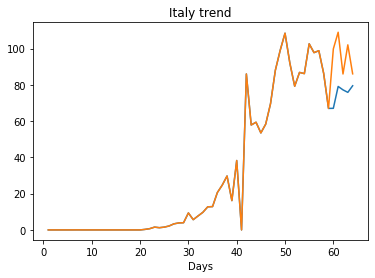

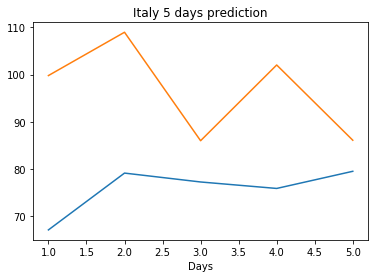

Creating directory ./offline6/Spain/training/
Spain
Saving the best model weights at Epoch [1], Best Valid Loss: 13009.2588
Saving the best model weights at Epoch [2], Best Valid Loss: 12506.9639


/space/home/nzhang/anaconda3/envs/neuralnet/lib/python3.7/site-packages/torch/nn/modules/loss.py:431: UserWarning: Using a target size (torch.Size([1, 1, 5])) that is different to the input size (torch.Size([5])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/space/home/nzhang/anaconda3/envs/neuralnet/lib/python3.7/site-packages/torch/nn/modules/loss.py:431: UserWarning: Using a target size (torch.Size([1, 5])) that is different to the input size (torch.Size([5])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Saving the best model weights at Epoch [5], Best Valid Loss: 11258.4678
Saving the best model weights at Epoch [12], Best Valid Loss: 10479.3311
train error: 3537.2020677839005
10479.3310546875
Saving the best model weights at Epoch [1], Best Valid Loss: 16505.9980
Saving the best model weights at Epoch [2], Best Valid Loss: 11602.6670
Saving the best model weights at Epoch [5], Best Valid Loss: 10421.6973
Saving the best model weights at Epoch [13], Best Valid Loss: 10403.0283
Saving the best model weights at Epoch [15], Best Valid Loss: 9633.2920
train error: 3650.805624280657
9633.2919921875
Saving the best model weights at Epoch [1], Best Valid Loss: 5893.4160
Saving the best model weights at Epoch [4], Best Valid Loss: 681.2043
train error: 6150.669919695173
681.204345703125
Saving the best model weights at Epoch [1], Best Valid Loss: 9848.2490
Saving the best model weights at Epoch [7], Best Valid Loss: 8983.5625
Saving the best model weights at Epoch [8], Best Valid Loss: 6319.2

Saving the best model weights at Epoch [35], Best Valid Loss: 582.8043
train error: 6985.397198268345
582.8043212890625
Saving the best model weights at Epoch [1], Best Valid Loss: 19526.3398
Saving the best model weights at Epoch [2], Best Valid Loss: 14522.8301
Saving the best model weights at Epoch [3], Best Valid Loss: 14117.5703
Saving the best model weights at Epoch [4], Best Valid Loss: 9165.7627
Saving the best model weights at Epoch [6], Best Valid Loss: 6513.4351
train error: 4009.2410651615687
6513.43505859375
Saving the best model weights at Epoch [1], Best Valid Loss: 11802.0771
Saving the best model weights at Epoch [2], Best Valid Loss: 8822.5928
Saving the best model weights at Epoch [4], Best Valid Loss: 8014.7671
Saving the best model weights at Epoch [6], Best Valid Loss: 6544.0464
Saving the best model weights at Epoch [9], Best Valid Loss: 1376.6169
train error: 6083.85651247842
1376.616943359375
Saving the best model weights at Epoch [1], Best Valid Loss: 6512.871

Saving the best model weights at Epoch [6], Best Valid Loss: 11199.2900
Saving the best model weights at Epoch [20], Best Valid Loss: 9082.1074
Saving the best model weights at Epoch [22], Best Valid Loss: 8699.9502
Saving the best model weights at Epoch [28], Best Valid Loss: 8342.3350
train error: 3715.8917606898717
8342.3349609375
Saving the best model weights at Epoch [1], Best Valid Loss: 22353.3359
Saving the best model weights at Epoch [2], Best Valid Loss: 13430.8252
Saving the best model weights at Epoch [3], Best Valid Loss: 12701.1377
Saving the best model weights at Epoch [4], Best Valid Loss: 10696.5879
Saving the best model weights at Epoch [7], Best Valid Loss: 9327.0293
Saving the best model weights at Epoch [8], Best Valid Loss: 9082.6826
Saving the best model weights at Epoch [11], Best Valid Loss: 5757.2563
Saving the best model weights at Epoch [40], Best Valid Loss: 5637.8296
train error: 4682.211818150112
5637.82958984375
Saving the best model weights at Epoch [1]

Saving the best model weights at Epoch [44], Best Valid Loss: 7955.5854
Saving the best model weights at Epoch [45], Best Valid Loss: 7763.1055
Saving the best model weights at Epoch [46], Best Valid Loss: 7590.3564
Saving the best model weights at Epoch [47], Best Valid Loss: 7438.9048
Saving the best model weights at Epoch [48], Best Valid Loss: 7304.5244
train error: 1892.5980709620885
7304.5244140625
Saving the best model weights at Epoch [1], Best Valid Loss: 21480.9199
Saving the best model weights at Epoch [2], Best Valid Loss: 16220.9092
Saving the best model weights at Epoch [3], Best Valid Loss: 12570.9229
Saving the best model weights at Epoch [9], Best Valid Loss: 10557.8867
train error: 3613.350281851632
10557.88671875
Saving the best model weights at Epoch [1], Best Valid Loss: 20602.0469
Saving the best model weights at Epoch [2], Best Valid Loss: 19320.3262
Saving the best model weights at Epoch [3], Best Valid Loss: 15685.9131
Saving the best model weights at Epoch [5]

Saving the best model weights at Epoch [10], Best Valid Loss: 11049.3799
Saving the best model weights at Epoch [13], Best Valid Loss: 9827.8809
Saving the best model weights at Epoch [20], Best Valid Loss: 9769.3594
Saving the best model weights at Epoch [21], Best Valid Loss: 9296.0830
Saving the best model weights at Epoch [28], Best Valid Loss: 7580.1221
Saving the best model weights at Epoch [33], Best Valid Loss: 7310.2827
Saving the best model weights at Epoch [35], Best Valid Loss: 6638.3569
train error: 2005.304633140564
6638.35693359375
Saving the best model weights at Epoch [1], Best Valid Loss: 21345.3809
Saving the best model weights at Epoch [2], Best Valid Loss: 19227.2344
Saving the best model weights at Epoch [3], Best Valid Loss: 17829.0605
Saving the best model weights at Epoch [4], Best Valid Loss: 15577.4033
Saving the best model weights at Epoch [6], Best Valid Loss: 5980.0898
Saving the best model weights at Epoch [8], Best Valid Loss: 2887.0676
Saving the best m

Saving the best model weights at Epoch [3], Best Valid Loss: 15728.8662
Saving the best model weights at Epoch [4], Best Valid Loss: 14205.1006
Saving the best model weights at Epoch [5], Best Valid Loss: 13257.3311
Saving the best model weights at Epoch [7], Best Valid Loss: 13130.1592
Saving the best model weights at Epoch [8], Best Valid Loss: 12844.0029
Saving the best model weights at Epoch [15], Best Valid Loss: 12754.7285
Saving the best model weights at Epoch [17], Best Valid Loss: 12710.3467
Saving the best model weights at Epoch [18], Best Valid Loss: 12511.5781
Saving the best model weights at Epoch [19], Best Valid Loss: 12360.9795
Saving the best model weights at Epoch [29], Best Valid Loss: 11835.7646
train error: 3453.623773302351
11835.7646484375
Saving the best model weights at Epoch [1], Best Valid Loss: 19341.3984
Saving the best model weights at Epoch [2], Best Valid Loss: 14347.9717
Saving the best model weights at Epoch [3], Best Valid Loss: 13127.1348
Saving the 

Saving the best model weights at Epoch [9], Best Valid Loss: 11785.8047
Saving the best model weights at Epoch [45], Best Valid Loss: 9106.7627
train error: 3569.274364743914
9106.7626953125
Saving the best model weights at Epoch [1], Best Valid Loss: 14925.3252
Saving the best model weights at Epoch [2], Best Valid Loss: 14636.4248
Saving the best model weights at Epoch [3], Best Valid Loss: 13041.6631
Saving the best model weights at Epoch [7], Best Valid Loss: 9582.2578
train error: 3496.751798902239
9582.2578125
Saving the best model weights at Epoch [1], Best Valid Loss: 13230.4326
Saving the best model weights at Epoch [8], Best Valid Loss: 11091.4609
Saving the best model weights at Epoch [10], Best Valid Loss: 9989.8701
Saving the best model weights at Epoch [11], Best Valid Loss: 5905.4644
Saving the best model weights at Epoch [14], Best Valid Loss: 5494.1704
Saving the best model weights at Epoch [35], Best Valid Loss: 4418.8252
Saving the best model weights at Epoch [50], B

Saving the best model weights at Epoch [12], Best Valid Loss: 21923.7852
Saving the best model weights at Epoch [13], Best Valid Loss: 21468.7363
Saving the best model weights at Epoch [14], Best Valid Loss: 21037.3809
Saving the best model weights at Epoch [15], Best Valid Loss: 20616.2715
Saving the best model weights at Epoch [16], Best Valid Loss: 20205.5977
Saving the best model weights at Epoch [17], Best Valid Loss: 19762.0762
Saving the best model weights at Epoch [18], Best Valid Loss: 19338.5059
Saving the best model weights at Epoch [19], Best Valid Loss: 18933.0215
Saving the best model weights at Epoch [20], Best Valid Loss: 18456.6875
Saving the best model weights at Epoch [21], Best Valid Loss: 18052.2500
Saving the best model weights at Epoch [24], Best Valid Loss: 16966.9512
Saving the best model weights at Epoch [28], Best Valid Loss: 16803.7715
Saving the best model weights at Epoch [29], Best Valid Loss: 16551.8613
Saving the best model weights at Epoch [30], Best V

Saving the best model weights at Epoch [22], Best Valid Loss: 12985.7803
Saving the best model weights at Epoch [23], Best Valid Loss: 12452.7607
Saving the best model weights at Epoch [24], Best Valid Loss: 11235.5889
Saving the best model weights at Epoch [25], Best Valid Loss: 11060.2715
Saving the best model weights at Epoch [26], Best Valid Loss: 10686.1221
Saving the best model weights at Epoch [27], Best Valid Loss: 10330.0703
Saving the best model weights at Epoch [31], Best Valid Loss: 9226.8877
Saving the best model weights at Epoch [33], Best Valid Loss: 9039.5703
Saving the best model weights at Epoch [34], Best Valid Loss: 8756.1826
train error: 2414.185732319951
8756.1826171875
Saving the best model weights at Epoch [1], Best Valid Loss: 24124.2012
Saving the best model weights at Epoch [2], Best Valid Loss: 20938.8340
Saving the best model weights at Epoch [3], Best Valid Loss: 18010.5508
Saving the best model weights at Epoch [4], Best Valid Loss: 15957.6270
Saving the 

Saving the best model weights at Epoch [12], Best Valid Loss: 13645.1787
Saving the best model weights at Epoch [23], Best Valid Loss: 13107.4844
Saving the best model weights at Epoch [29], Best Valid Loss: 12888.6670
Saving the best model weights at Epoch [31], Best Valid Loss: 12725.7559
Saving the best model weights at Epoch [33], Best Valid Loss: 12164.1602
Saving the best model weights at Epoch [34], Best Valid Loss: 11579.9775
Saving the best model weights at Epoch [35], Best Valid Loss: 11197.4707
Saving the best model weights at Epoch [39], Best Valid Loss: 10618.0410
Saving the best model weights at Epoch [40], Best Valid Loss: 10356.2500
Saving the best model weights at Epoch [41], Best Valid Loss: 9578.4219
Saving the best model weights at Epoch [44], Best Valid Loss: 9574.5859
Saving the best model weights at Epoch [45], Best Valid Loss: 8830.6943
Saving the best model weights at Epoch [46], Best Valid Loss: 8467.9863
Saving the best model weights at Epoch [47], Best Valid

Saving the best model weights at Epoch [6], Best Valid Loss: 21139.9414
Saving the best model weights at Epoch [7], Best Valid Loss: 19305.5879
Saving the best model weights at Epoch [8], Best Valid Loss: 17821.5098
Saving the best model weights at Epoch [9], Best Valid Loss: 17285.2168
Saving the best model weights at Epoch [11], Best Valid Loss: 14942.9033
Saving the best model weights at Epoch [12], Best Valid Loss: 13780.6631
Saving the best model weights at Epoch [15], Best Valid Loss: 12760.8682
Saving the best model weights at Epoch [17], Best Valid Loss: 12604.5576
Saving the best model weights at Epoch [21], Best Valid Loss: 11820.7109
Saving the best model weights at Epoch [22], Best Valid Loss: 10044.6504
Saving the best model weights at Epoch [24], Best Valid Loss: 8644.1572
Saving the best model weights at Epoch [25], Best Valid Loss: 8262.2100
Saving the best model weights at Epoch [26], Best Valid Loss: 7913.2524
Saving the best model weights at Epoch [27], Best Valid Lo

Saving the best model weights at Epoch [3], Best Valid Loss: 14327.2988
Saving the best model weights at Epoch [4], Best Valid Loss: 12388.5508
Saving the best model weights at Epoch [13], Best Valid Loss: 11370.6846
Saving the best model weights at Epoch [43], Best Valid Loss: 10697.8350
Saving the best model weights at Epoch [45], Best Valid Loss: 10683.4951
Saving the best model weights at Epoch [47], Best Valid Loss: 10444.3115
train error: 3341.0731585366384
10444.3115234375
Saving the best model weights at Epoch [1], Best Valid Loss: 26777.4746
Saving the best model weights at Epoch [2], Best Valid Loss: 25180.5684
Saving the best model weights at Epoch [3], Best Valid Loss: 20108.0176
Saving the best model weights at Epoch [4], Best Valid Loss: 15281.9844
Saving the best model weights at Epoch [5], Best Valid Loss: 13609.2178
Saving the best model weights at Epoch [7], Best Valid Loss: 10252.8594
Saving the best model weights at Epoch [9], Best Valid Loss: 9159.8936
Saving the b

Saving the best model weights at Epoch [45], Best Valid Loss: 8992.2236
Saving the best model weights at Epoch [46], Best Valid Loss: 8644.9502
Saving the best model weights at Epoch [47], Best Valid Loss: 8331.6113
Saving the best model weights at Epoch [48], Best Valid Loss: 8021.7769
Saving the best model weights at Epoch [49], Best Valid Loss: 7763.6538
Saving the best model weights at Epoch [50], Best Valid Loss: 7500.7495
train error: 1601.8496881212507
7500.74951171875
Saving the best model weights at Epoch [1], Best Valid Loss: 25630.7090
Saving the best model weights at Epoch [2], Best Valid Loss: 22001.9863
Saving the best model weights at Epoch [3], Best Valid Loss: 18007.4590
Saving the best model weights at Epoch [4], Best Valid Loss: 15278.1895
Saving the best model weights at Epoch [5], Best Valid Loss: 13691.5518
Saving the best model weights at Epoch [8], Best Valid Loss: 12534.4619
Saving the best model weights at Epoch [9], Best Valid Loss: 10975.0518
Saving the best

train error: 2553.988766533988
4550.6796875
Saving the best model weights at Epoch [1], Best Valid Loss: 25540.8574
Saving the best model weights at Epoch [2], Best Valid Loss: 19439.2500
Saving the best model weights at Epoch [5], Best Valid Loss: 16453.8379
Saving the best model weights at Epoch [6], Best Valid Loss: 13675.0518
Saving the best model weights at Epoch [8], Best Valid Loss: 13070.5957
Saving the best model weights at Epoch [10], Best Valid Loss: 13059.9131
Saving the best model weights at Epoch [11], Best Valid Loss: 12438.1221
train error: 3429.053626469203
12438.1220703125
Saving the best model weights at Epoch [1], Best Valid Loss: 26915.2637
Saving the best model weights at Epoch [2], Best Valid Loss: 26650.9277
Saving the best model weights at Epoch [3], Best Valid Loss: 26261.3262
Saving the best model weights at Epoch [4], Best Valid Loss: 25399.3184
Saving the best model weights at Epoch [5], Best Valid Loss: 22578.7480
Saving the best model weights at Epoch [6]

Saving the best model weights at Epoch [14], Best Valid Loss: 15693.6250
Saving the best model weights at Epoch [15], Best Valid Loss: 15333.8691
Saving the best model weights at Epoch [16], Best Valid Loss: 15063.7568
Saving the best model weights at Epoch [17], Best Valid Loss: 14898.4346
Saving the best model weights at Epoch [18], Best Valid Loss: 14630.9551
Saving the best model weights at Epoch [19], Best Valid Loss: 14448.5654
Saving the best model weights at Epoch [20], Best Valid Loss: 14308.8174
Saving the best model weights at Epoch [21], Best Valid Loss: 14150.6611
Saving the best model weights at Epoch [22], Best Valid Loss: 14039.2803
Saving the best model weights at Epoch [23], Best Valid Loss: 14011.0283
Saving the best model weights at Epoch [24], Best Valid Loss: 13878.3516
Saving the best model weights at Epoch [25], Best Valid Loss: 13801.6406
Saving the best model weights at Epoch [26], Best Valid Loss: 13762.5225
Saving the best model weights at Epoch [27], Best V

Saving the best model weights at Epoch [11], Best Valid Loss: 12595.9873
Saving the best model weights at Epoch [12], Best Valid Loss: 12036.3486
Saving the best model weights at Epoch [19], Best Valid Loss: 11010.9551
Saving the best model weights at Epoch [20], Best Valid Loss: 9122.3574
Saving the best model weights at Epoch [21], Best Valid Loss: 7594.3789
Saving the best model weights at Epoch [22], Best Valid Loss: 6577.5835
Saving the best model weights at Epoch [23], Best Valid Loss: 5887.1025
Saving the best model weights at Epoch [24], Best Valid Loss: 5507.3408
Saving the best model weights at Epoch [25], Best Valid Loss: 5010.1494
Saving the best model weights at Epoch [26], Best Valid Loss: 4645.8657
Saving the best model weights at Epoch [27], Best Valid Loss: 4593.8096
Saving the best model weights at Epoch [28], Best Valid Loss: 4423.3999
Saving the best model weights at Epoch [29], Best Valid Loss: 4218.9111
Saving the best model weights at Epoch [37], Best Valid Loss:

Saving the best model weights at Epoch [4], Best Valid Loss: 25561.5645
Saving the best model weights at Epoch [5], Best Valid Loss: 24908.7559
Saving the best model weights at Epoch [6], Best Valid Loss: 24052.2949
Saving the best model weights at Epoch [7], Best Valid Loss: 22989.2031
Saving the best model weights at Epoch [8], Best Valid Loss: 21903.2305
Saving the best model weights at Epoch [9], Best Valid Loss: 20849.9355
Saving the best model weights at Epoch [10], Best Valid Loss: 19801.3027
Saving the best model weights at Epoch [11], Best Valid Loss: 18868.1543
Saving the best model weights at Epoch [12], Best Valid Loss: 18052.1289
Saving the best model weights at Epoch [13], Best Valid Loss: 17401.6387
Saving the best model weights at Epoch [14], Best Valid Loss: 16683.0254
Saving the best model weights at Epoch [15], Best Valid Loss: 16307.3408
Saving the best model weights at Epoch [16], Best Valid Loss: 15783.9688
Saving the best model weights at Epoch [17], Best Valid L

Saving the best model weights at Epoch [2], Best Valid Loss: 26681.8535
Saving the best model weights at Epoch [3], Best Valid Loss: 26406.7637
Saving the best model weights at Epoch [4], Best Valid Loss: 26046.6133
Saving the best model weights at Epoch [5], Best Valid Loss: 25540.7402
Saving the best model weights at Epoch [6], Best Valid Loss: 24769.6973
Saving the best model weights at Epoch [7], Best Valid Loss: 23631.1973
Saving the best model weights at Epoch [8], Best Valid Loss: 22052.0293
Saving the best model weights at Epoch [9], Best Valid Loss: 20174.6445
Saving the best model weights at Epoch [10], Best Valid Loss: 18496.5918
Saving the best model weights at Epoch [11], Best Valid Loss: 17083.4258
Saving the best model weights at Epoch [12], Best Valid Loss: 16032.4014
Saving the best model weights at Epoch [13], Best Valid Loss: 15185.5391
Saving the best model weights at Epoch [14], Best Valid Loss: 14663.0361
Saving the best model weights at Epoch [15], Best Valid Los

Saving the best model weights at Epoch [32], Best Valid Loss: 23703.2324
Saving the best model weights at Epoch [33], Best Valid Loss: 23596.7539
Saving the best model weights at Epoch [34], Best Valid Loss: 23489.0996
Saving the best model weights at Epoch [35], Best Valid Loss: 23383.3750
Saving the best model weights at Epoch [36], Best Valid Loss: 23277.7793
Saving the best model weights at Epoch [37], Best Valid Loss: 23174.2168
Saving the best model weights at Epoch [38], Best Valid Loss: 23070.1523
Saving the best model weights at Epoch [39], Best Valid Loss: 22967.3848
Saving the best model weights at Epoch [40], Best Valid Loss: 22865.6035
Saving the best model weights at Epoch [41], Best Valid Loss: 22765.3281
Saving the best model weights at Epoch [42], Best Valid Loss: 22664.7949
Saving the best model weights at Epoch [43], Best Valid Loss: 22565.9570
Saving the best model weights at Epoch [44], Best Valid Loss: 22466.3652
Saving the best model weights at Epoch [45], Best V

Saving the best model weights at Epoch [7], Best Valid Loss: 25939.9141
Saving the best model weights at Epoch [8], Best Valid Loss: 25748.7363
Saving the best model weights at Epoch [9], Best Valid Loss: 25547.9043
Saving the best model weights at Epoch [10], Best Valid Loss: 25352.3730
Saving the best model weights at Epoch [11], Best Valid Loss: 25156.1562
Saving the best model weights at Epoch [12], Best Valid Loss: 24957.0469
Saving the best model weights at Epoch [13], Best Valid Loss: 24763.9043
Saving the best model weights at Epoch [14], Best Valid Loss: 24568.7461
Saving the best model weights at Epoch [15], Best Valid Loss: 24359.9512
Saving the best model weights at Epoch [16], Best Valid Loss: 24162.9590
Saving the best model weights at Epoch [17], Best Valid Loss: 23966.7168
Saving the best model weights at Epoch [18], Best Valid Loss: 23773.5059
Saving the best model weights at Epoch [19], Best Valid Loss: 23582.8184
Saving the best model weights at Epoch [20], Best Vali

Saving the best model weights at Epoch [47], Best Valid Loss: 10829.1299
Saving the best model weights at Epoch [48], Best Valid Loss: 10498.8906
Saving the best model weights at Epoch [49], Best Valid Loss: 10089.0488
Saving the best model weights at Epoch [50], Best Valid Loss: 9837.9033
train error: 1818.8558128029108
9837.9033203125
Saving the best model weights at Epoch [1], Best Valid Loss: 26975.1816
Saving the best model weights at Epoch [2], Best Valid Loss: 26827.8184
Saving the best model weights at Epoch [3], Best Valid Loss: 26645.3945
Saving the best model weights at Epoch [4], Best Valid Loss: 26452.9355
Saving the best model weights at Epoch [5], Best Valid Loss: 26225.6562
Saving the best model weights at Epoch [6], Best Valid Loss: 25980.5527
Saving the best model weights at Epoch [7], Best Valid Loss: 25717.6348
Saving the best model weights at Epoch [8], Best Valid Loss: 25476.2383
Saving the best model weights at Epoch [9], Best Valid Loss: 25198.5176
Saving the be

Saving the best model weights at Epoch [38], Best Valid Loss: 11842.5293
Saving the best model weights at Epoch [39], Best Valid Loss: 11001.3408
Saving the best model weights at Epoch [40], Best Valid Loss: 10975.2188
Saving the best model weights at Epoch [42], Best Valid Loss: 10665.3379
Saving the best model weights at Epoch [43], Best Valid Loss: 10515.8867
Saving the best model weights at Epoch [46], Best Valid Loss: 9582.7910
Saving the best model weights at Epoch [48], Best Valid Loss: 9259.8701
Saving the best model weights at Epoch [49], Best Valid Loss: 8886.9365
Saving the best model weights at Epoch [50], Best Valid Loss: 8698.7344
train error: 1706.4190218118686
8698.734375
Saving the best model weights at Epoch [1], Best Valid Loss: 26817.3535
Saving the best model weights at Epoch [2], Best Valid Loss: 26432.2695
Saving the best model weights at Epoch [3], Best Valid Loss: 25991.5762
Saving the best model weights at Epoch [4], Best Valid Loss: 25538.3633
Saving the best

Saving the best model weights at Epoch [42], Best Valid Loss: 8916.7949
Saving the best model weights at Epoch [50], Best Valid Loss: 8731.8486
train error: 1837.221756867
8731.8486328125
Saving the best model weights at Epoch [1], Best Valid Loss: 27134.4941
Saving the best model weights at Epoch [2], Best Valid Loss: 27112.7598
Saving the best model weights at Epoch [3], Best Valid Loss: 27090.7910
Saving the best model weights at Epoch [4], Best Valid Loss: 27068.7812
Saving the best model weights at Epoch [5], Best Valid Loss: 27046.9316
Saving the best model weights at Epoch [6], Best Valid Loss: 27024.6602
Saving the best model weights at Epoch [7], Best Valid Loss: 27002.3887
Saving the best model weights at Epoch [8], Best Valid Loss: 26979.8730
Saving the best model weights at Epoch [9], Best Valid Loss: 26957.3633
Saving the best model weights at Epoch [10], Best Valid Loss: 26934.8320
Saving the best model weights at Epoch [11], Best Valid Loss: 26911.6719
Saving the best mo

Saving the best model weights at Epoch [11], Best Valid Loss: 23326.9121
Saving the best model weights at Epoch [12], Best Valid Loss: 22724.4590
Saving the best model weights at Epoch [13], Best Valid Loss: 22136.6699
Saving the best model weights at Epoch [14], Best Valid Loss: 21482.8223
Saving the best model weights at Epoch [15], Best Valid Loss: 20984.3555
Saving the best model weights at Epoch [16], Best Valid Loss: 20181.9668
Saving the best model weights at Epoch [17], Best Valid Loss: 19663.2637
Saving the best model weights at Epoch [18], Best Valid Loss: 19159.1445
Saving the best model weights at Epoch [19], Best Valid Loss: 18725.5762
Saving the best model weights at Epoch [20], Best Valid Loss: 18307.5469
Saving the best model weights at Epoch [21], Best Valid Loss: 17788.8379
Saving the best model weights at Epoch [22], Best Valid Loss: 17272.0781
Saving the best model weights at Epoch [24], Best Valid Loss: 16979.8652
Saving the best model weights at Epoch [26], Best V

Saving the best model weights at Epoch [30], Best Valid Loss: 21026.9395
Saving the best model weights at Epoch [31], Best Valid Loss: 20664.5469
Saving the best model weights at Epoch [32], Best Valid Loss: 20336.3730
Saving the best model weights at Epoch [33], Best Valid Loss: 19967.2148
Saving the best model weights at Epoch [34], Best Valid Loss: 19646.7344
Saving the best model weights at Epoch [35], Best Valid Loss: 19287.2598
Saving the best model weights at Epoch [36], Best Valid Loss: 18967.4883
Saving the best model weights at Epoch [37], Best Valid Loss: 18660.0723
Saving the best model weights at Epoch [38], Best Valid Loss: 18356.3750
Saving the best model weights at Epoch [39], Best Valid Loss: 18077.5371
Saving the best model weights at Epoch [40], Best Valid Loss: 17775.1367
Saving the best model weights at Epoch [41], Best Valid Loss: 17503.4395
Saving the best model weights at Epoch [42], Best Valid Loss: 17217.3594
Saving the best model weights at Epoch [43], Best V

Saving the best model weights at Epoch [22], Best Valid Loss: 21582.9512
Saving the best model weights at Epoch [23], Best Valid Loss: 20987.3281
Saving the best model weights at Epoch [24], Best Valid Loss: 20416.6406
Saving the best model weights at Epoch [25], Best Valid Loss: 19870.4453
Saving the best model weights at Epoch [26], Best Valid Loss: 19310.2949
Saving the best model weights at Epoch [27], Best Valid Loss: 18771.1094
Saving the best model weights at Epoch [28], Best Valid Loss: 18243.9629
Saving the best model weights at Epoch [29], Best Valid Loss: 17716.6621
Saving the best model weights at Epoch [30], Best Valid Loss: 17260.9219
Saving the best model weights at Epoch [31], Best Valid Loss: 16800.6543
Saving the best model weights at Epoch [32], Best Valid Loss: 16343.7061
Saving the best model weights at Epoch [33], Best Valid Loss: 15926.0029
Saving the best model weights at Epoch [34], Best Valid Loss: 15852.7842
Saving the best model weights at Epoch [35], Best V

Saving the best model weights at Epoch [19], Best Valid Loss: 16161.5781
Saving the best model weights at Epoch [20], Best Valid Loss: 15414.1279
Saving the best model weights at Epoch [21], Best Valid Loss: 14654.7158
Saving the best model weights at Epoch [22], Best Valid Loss: 14011.7256
Saving the best model weights at Epoch [23], Best Valid Loss: 13529.4160
Saving the best model weights at Epoch [24], Best Valid Loss: 13267.2236
Saving the best model weights at Epoch [25], Best Valid Loss: 12815.3799
Saving the best model weights at Epoch [26], Best Valid Loss: 12276.3633
Saving the best model weights at Epoch [27], Best Valid Loss: 12185.2715
Saving the best model weights at Epoch [28], Best Valid Loss: 11709.2354
Saving the best model weights at Epoch [29], Best Valid Loss: 11289.9863
Saving the best model weights at Epoch [30], Best Valid Loss: 10774.7998
Saving the best model weights at Epoch [31], Best Valid Loss: 10751.5029
Saving the best model weights at Epoch [32], Best V

Saving the best model weights at Epoch [28], Best Valid Loss: 25618.7715
Saving the best model weights at Epoch [29], Best Valid Loss: 25530.6973
Saving the best model weights at Epoch [30], Best Valid Loss: 25440.2637
Saving the best model weights at Epoch [31], Best Valid Loss: 25341.2031
Saving the best model weights at Epoch [32], Best Valid Loss: 25246.2383
Saving the best model weights at Epoch [33], Best Valid Loss: 25139.7188
Saving the best model weights at Epoch [34], Best Valid Loss: 25033.8789
Saving the best model weights at Epoch [35], Best Valid Loss: 24912.6777
Saving the best model weights at Epoch [36], Best Valid Loss: 24795.7012
Saving the best model weights at Epoch [37], Best Valid Loss: 24673.4746
Saving the best model weights at Epoch [38], Best Valid Loss: 24544.7402
Saving the best model weights at Epoch [39], Best Valid Loss: 24420.9941
Saving the best model weights at Epoch [40], Best Valid Loss: 24274.8652
Saving the best model weights at Epoch [41], Best V

Saving the best model weights at Epoch [43], Best Valid Loss: 25808.4551
Saving the best model weights at Epoch [44], Best Valid Loss: 25744.6836
Saving the best model weights at Epoch [45], Best Valid Loss: 25682.3262
Saving the best model weights at Epoch [46], Best Valid Loss: 25617.0918
Saving the best model weights at Epoch [47], Best Valid Loss: 25549.3105
Saving the best model weights at Epoch [48], Best Valid Loss: 25478.4629
Saving the best model weights at Epoch [49], Best Valid Loss: 25404.0762
Saving the best model weights at Epoch [50], Best Valid Loss: 25324.8320
train error: 5423.1550250564305
25324.83203125
Saving the best model weights at Epoch [1], Best Valid Loss: 27101.9688
Saving the best model weights at Epoch [2], Best Valid Loss: 27061.7754
Saving the best model weights at Epoch [3], Best Valid Loss: 27023.5781
Saving the best model weights at Epoch [4], Best Valid Loss: 26983.6387
Saving the best model weights at Epoch [5], Best Valid Loss: 26942.8691
Saving th

Saving the best model weights at Epoch [27], Best Valid Loss: 26527.4531
Saving the best model weights at Epoch [28], Best Valid Loss: 26499.5938
Saving the best model weights at Epoch [29], Best Valid Loss: 26470.7383
Saving the best model weights at Epoch [30], Best Valid Loss: 26441.3164
Saving the best model weights at Epoch [31], Best Valid Loss: 26410.8496
Saving the best model weights at Epoch [32], Best Valid Loss: 26379.5059
Saving the best model weights at Epoch [33], Best Valid Loss: 26347.2715
Saving the best model weights at Epoch [34], Best Valid Loss: 26314.0996
Saving the best model weights at Epoch [35], Best Valid Loss: 26279.0195
Saving the best model weights at Epoch [36], Best Valid Loss: 26242.9531
Saving the best model weights at Epoch [37], Best Valid Loss: 26205.5059
Saving the best model weights at Epoch [38], Best Valid Loss: 26166.2441
Saving the best model weights at Epoch [39], Best Valid Loss: 26125.1309
Saving the best model weights at Epoch [40], Best V

Saving the best model weights at Epoch [18], Best Valid Loss: 26739.7070
Saving the best model weights at Epoch [19], Best Valid Loss: 26715.2500
Saving the best model weights at Epoch [20], Best Valid Loss: 26690.2129
Saving the best model weights at Epoch [21], Best Valid Loss: 26664.7695
Saving the best model weights at Epoch [22], Best Valid Loss: 26638.8320
Saving the best model weights at Epoch [23], Best Valid Loss: 26612.0625
Saving the best model weights at Epoch [24], Best Valid Loss: 26584.5000
Saving the best model weights at Epoch [25], Best Valid Loss: 26556.0566
Saving the best model weights at Epoch [26], Best Valid Loss: 26526.1699
Saving the best model weights at Epoch [27], Best Valid Loss: 26495.7285
Saving the best model weights at Epoch [28], Best Valid Loss: 26463.7129
Saving the best model weights at Epoch [29], Best Valid Loss: 26430.2129
Saving the best model weights at Epoch [30], Best Valid Loss: 26395.8691
Saving the best model weights at Epoch [31], Best V

Saving the best model weights at Epoch [17], Best Valid Loss: 26824.9844
Saving the best model weights at Epoch [18], Best Valid Loss: 26801.2246
Saving the best model weights at Epoch [19], Best Valid Loss: 26777.3535
Saving the best model weights at Epoch [20], Best Valid Loss: 26753.1914
Saving the best model weights at Epoch [21], Best Valid Loss: 26728.9160
Saving the best model weights at Epoch [22], Best Valid Loss: 26704.2246
Saving the best model weights at Epoch [23], Best Valid Loss: 26679.3379
Saving the best model weights at Epoch [24], Best Valid Loss: 26654.2070
Saving the best model weights at Epoch [25], Best Valid Loss: 26628.5996
Saving the best model weights at Epoch [26], Best Valid Loss: 26602.8691
Saving the best model weights at Epoch [27], Best Valid Loss: 26576.5879
Saving the best model weights at Epoch [28], Best Valid Loss: 26550.1504
Saving the best model weights at Epoch [29], Best Valid Loss: 26523.2793
Saving the best model weights at Epoch [30], Best V

Saving the best model weights at Epoch [30], Best Valid Loss: 15320.0781
Saving the best model weights at Epoch [31], Best Valid Loss: 15184.2266
Saving the best model weights at Epoch [32], Best Valid Loss: 15131.4248
Saving the best model weights at Epoch [33], Best Valid Loss: 14903.0361
Saving the best model weights at Epoch [34], Best Valid Loss: 14855.3350
Saving the best model weights at Epoch [35], Best Valid Loss: 14708.5576
Saving the best model weights at Epoch [36], Best Valid Loss: 14615.0801
Saving the best model weights at Epoch [37], Best Valid Loss: 14557.2812
Saving the best model weights at Epoch [38], Best Valid Loss: 14476.1875
Saving the best model weights at Epoch [39], Best Valid Loss: 14412.4326
Saving the best model weights at Epoch [40], Best Valid Loss: 14305.9600
Saving the best model weights at Epoch [41], Best Valid Loss: 14192.6035
Saving the best model weights at Epoch [43], Best Valid Loss: 14016.5928
Saving the best model weights at Epoch [46], Best V

Saving the best model weights at Epoch [49], Best Valid Loss: 21464.0742
Saving the best model weights at Epoch [50], Best Valid Loss: 21205.7852
train error: 4389.536761147635
21205.78515625
Saving the best model weights at Epoch [1], Best Valid Loss: 27042.3320
Saving the best model weights at Epoch [2], Best Valid Loss: 26818.1875
Saving the best model weights at Epoch [3], Best Valid Loss: 26647.0449
Saving the best model weights at Epoch [4], Best Valid Loss: 26387.0820
Saving the best model weights at Epoch [5], Best Valid Loss: 26120.2715
Saving the best model weights at Epoch [6], Best Valid Loss: 25773.8340
Saving the best model weights at Epoch [7], Best Valid Loss: 25322.4902
Saving the best model weights at Epoch [8], Best Valid Loss: 24782.9219
Saving the best model weights at Epoch [9], Best Valid Loss: 24022.5684
Saving the best model weights at Epoch [10], Best Valid Loss: 23052.8848
Saving the best model weights at Epoch [11], Best Valid Loss: 21846.1777
Saving the bes

Saving the best model weights at Epoch [36], Best Valid Loss: 24092.6855
Saving the best model weights at Epoch [37], Best Valid Loss: 23863.6797
Saving the best model weights at Epoch [38], Best Valid Loss: 23607.6543
Saving the best model weights at Epoch [39], Best Valid Loss: 23343.5508
Saving the best model weights at Epoch [40], Best Valid Loss: 23062.2871
Saving the best model weights at Epoch [41], Best Valid Loss: 22760.5410
Saving the best model weights at Epoch [42], Best Valid Loss: 22450.5566
Saving the best model weights at Epoch [43], Best Valid Loss: 22099.8789
Saving the best model weights at Epoch [44], Best Valid Loss: 21749.3691
Saving the best model weights at Epoch [45], Best Valid Loss: 21406.8164
Saving the best model weights at Epoch [46], Best Valid Loss: 20994.8242
Saving the best model weights at Epoch [47], Best Valid Loss: 20627.5195
Saving the best model weights at Epoch [48], Best Valid Loss: 20225.8965
Saving the best model weights at Epoch [49], Best V

Saving the best model weights at Epoch [24], Best Valid Loss: 25799.5918
Saving the best model weights at Epoch [25], Best Valid Loss: 25689.4707
Saving the best model weights at Epoch [26], Best Valid Loss: 25571.6621
Saving the best model weights at Epoch [27], Best Valid Loss: 25449.0215
Saving the best model weights at Epoch [28], Best Valid Loss: 25302.7930
Saving the best model weights at Epoch [29], Best Valid Loss: 25145.5156
Saving the best model weights at Epoch [30], Best Valid Loss: 24980.9512
Saving the best model weights at Epoch [31], Best Valid Loss: 24791.0508
Saving the best model weights at Epoch [32], Best Valid Loss: 24592.8418
Saving the best model weights at Epoch [33], Best Valid Loss: 24345.4375
Saving the best model weights at Epoch [34], Best Valid Loss: 24088.3867
Saving the best model weights at Epoch [35], Best Valid Loss: 23795.6699
Saving the best model weights at Epoch [36], Best Valid Loss: 23466.3574
Saving the best model weights at Epoch [37], Best V

Saving the best model weights at Epoch [13], Best Valid Loss: 26592.8027
Saving the best model weights at Epoch [14], Best Valid Loss: 26547.4902
Saving the best model weights at Epoch [15], Best Valid Loss: 26501.6133
Saving the best model weights at Epoch [16], Best Valid Loss: 26449.3730
Saving the best model weights at Epoch [17], Best Valid Loss: 26398.2695
Saving the best model weights at Epoch [18], Best Valid Loss: 26345.6230
Saving the best model weights at Epoch [19], Best Valid Loss: 26290.4355
Saving the best model weights at Epoch [20], Best Valid Loss: 26235.3809
Saving the best model weights at Epoch [21], Best Valid Loss: 26173.2246
Saving the best model weights at Epoch [22], Best Valid Loss: 26110.3301
Saving the best model weights at Epoch [23], Best Valid Loss: 26046.1719
Saving the best model weights at Epoch [24], Best Valid Loss: 25977.3281
Saving the best model weights at Epoch [25], Best Valid Loss: 25911.5293
Saving the best model weights at Epoch [26], Best V

Saving the best model weights at Epoch [29], Best Valid Loss: 26450.6133
Saving the best model weights at Epoch [30], Best Valid Loss: 26421.1562
Saving the best model weights at Epoch [31], Best Valid Loss: 26391.3262
Saving the best model weights at Epoch [32], Best Valid Loss: 26360.8164
Saving the best model weights at Epoch [33], Best Valid Loss: 26329.6191
Saving the best model weights at Epoch [34], Best Valid Loss: 26297.2227
Saving the best model weights at Epoch [35], Best Valid Loss: 26264.1875
Saving the best model weights at Epoch [36], Best Valid Loss: 26230.4590
Saving the best model weights at Epoch [37], Best Valid Loss: 26195.2422
Saving the best model weights at Epoch [38], Best Valid Loss: 26159.1367
Saving the best model weights at Epoch [39], Best Valid Loss: 26121.9727
Saving the best model weights at Epoch [40], Best Valid Loss: 26083.5215
Saving the best model weights at Epoch [41], Best Valid Loss: 26044.3125
Saving the best model weights at Epoch [42], Best V

Saving the best model weights at Epoch [7], Best Valid Loss: 26996.2090
Saving the best model weights at Epoch [8], Best Valid Loss: 26974.1934
Saving the best model weights at Epoch [9], Best Valid Loss: 26952.2480
Saving the best model weights at Epoch [10], Best Valid Loss: 26930.3262
Saving the best model weights at Epoch [11], Best Valid Loss: 26908.0566
Saving the best model weights at Epoch [12], Best Valid Loss: 26886.0508
Saving the best model weights at Epoch [13], Best Valid Loss: 26863.4902
Saving the best model weights at Epoch [14], Best Valid Loss: 26840.8887
Saving the best model weights at Epoch [15], Best Valid Loss: 26817.9688
Saving the best model weights at Epoch [16], Best Valid Loss: 26794.9473
Saving the best model weights at Epoch [17], Best Valid Loss: 26771.7598
Saving the best model weights at Epoch [18], Best Valid Loss: 26748.3184
Saving the best model weights at Epoch [19], Best Valid Loss: 26724.4043
Saving the best model weights at Epoch [20], Best Vali

Saving the best model weights at Epoch [21], Best Valid Loss: 13619.3613
Saving the best model weights at Epoch [22], Best Valid Loss: 13572.1816
Saving the best model weights at Epoch [23], Best Valid Loss: 13105.3203
Saving the best model weights at Epoch [28], Best Valid Loss: 12493.2529
train error: 3412.171338217599
12493.2529296875
Saving the best model weights at Epoch [1], Best Valid Loss: 27109.4668
Saving the best model weights at Epoch [2], Best Valid Loss: 27087.7012
Saving the best model weights at Epoch [3], Best Valid Loss: 27065.5352
Saving the best model weights at Epoch [4], Best Valid Loss: 27043.4375
Saving the best model weights at Epoch [5], Best Valid Loss: 27021.2637
Saving the best model weights at Epoch [6], Best Valid Loss: 26999.1074
Saving the best model weights at Epoch [7], Best Valid Loss: 26976.8652
Saving the best model weights at Epoch [8], Best Valid Loss: 26954.5371
Saving the best model weights at Epoch [9], Best Valid Loss: 26932.3340
Saving the b

Saving the best model weights at Epoch [9], Best Valid Loss: 22846.0781
Saving the best model weights at Epoch [10], Best Valid Loss: 21517.5879
Saving the best model weights at Epoch [11], Best Valid Loss: 19350.0664
Saving the best model weights at Epoch [12], Best Valid Loss: 16914.9824
Saving the best model weights at Epoch [13], Best Valid Loss: 15178.4658
Saving the best model weights at Epoch [14], Best Valid Loss: 14531.2998
Saving the best model weights at Epoch [15], Best Valid Loss: 14474.9609
Saving the best model weights at Epoch [16], Best Valid Loss: 13104.7148
Saving the best model weights at Epoch [17], Best Valid Loss: 12760.0391
Saving the best model weights at Epoch [18], Best Valid Loss: 12485.7217
Saving the best model weights at Epoch [19], Best Valid Loss: 10780.1875
Saving the best model weights at Epoch [28], Best Valid Loss: 9720.9941
train error: 3417.964346204485
9720.994140625
Saving the best model weights at Epoch [1], Best Valid Loss: 27152.1133
Saving t

Saving the best model weights at Epoch [4], Best Valid Loss: 26934.8633
Saving the best model weights at Epoch [5], Best Valid Loss: 26898.8008
Saving the best model weights at Epoch [6], Best Valid Loss: 26892.6758
Saving the best model weights at Epoch [7], Best Valid Loss: 26831.3164
Saving the best model weights at Epoch [8], Best Valid Loss: 26771.3574
Saving the best model weights at Epoch [9], Best Valid Loss: 26722.8633
Saving the best model weights at Epoch [10], Best Valid Loss: 26637.8691
Saving the best model weights at Epoch [11], Best Valid Loss: 26580.1934
Saving the best model weights at Epoch [12], Best Valid Loss: 26522.0195
Saving the best model weights at Epoch [13], Best Valid Loss: 26468.9199
Saving the best model weights at Epoch [14], Best Valid Loss: 26415.6875
Saving the best model weights at Epoch [15], Best Valid Loss: 26357.8945
Saving the best model weights at Epoch [16], Best Valid Loss: 26295.5938
Saving the best model weights at Epoch [17], Best Valid L

Saving the best model weights at Epoch [16], Best Valid Loss: 26897.4844
Saving the best model weights at Epoch [17], Best Valid Loss: 26883.4355
Saving the best model weights at Epoch [18], Best Valid Loss: 26869.8809
Saving the best model weights at Epoch [19], Best Valid Loss: 26840.6250
Saving the best model weights at Epoch [20], Best Valid Loss: 26824.3848
Saving the best model weights at Epoch [21], Best Valid Loss: 26807.7383
Saving the best model weights at Epoch [22], Best Valid Loss: 26786.0000
Saving the best model weights at Epoch [23], Best Valid Loss: 26761.5352
Saving the best model weights at Epoch [24], Best Valid Loss: 26739.2383
Saving the best model weights at Epoch [25], Best Valid Loss: 26718.0254
Saving the best model weights at Epoch [26], Best Valid Loss: 26701.0000
Saving the best model weights at Epoch [27], Best Valid Loss: 26683.0352
Saving the best model weights at Epoch [28], Best Valid Loss: 26665.8496
Saving the best model weights at Epoch [29], Best V

Saving the best model weights at Epoch [28], Best Valid Loss: 26751.4941
Saving the best model weights at Epoch [29], Best Valid Loss: 26735.1816
Saving the best model weights at Epoch [30], Best Valid Loss: 26718.4688
Saving the best model weights at Epoch [31], Best Valid Loss: 26701.2637
Saving the best model weights at Epoch [32], Best Valid Loss: 26683.5879
Saving the best model weights at Epoch [33], Best Valid Loss: 26665.4434
Saving the best model weights at Epoch [34], Best Valid Loss: 26646.9199
Saving the best model weights at Epoch [35], Best Valid Loss: 26627.4570
Saving the best model weights at Epoch [36], Best Valid Loss: 26607.2598
Saving the best model weights at Epoch [37], Best Valid Loss: 26582.4473
Saving the best model weights at Epoch [38], Best Valid Loss: 26551.7559
Saving the best model weights at Epoch [39], Best Valid Loss: 26518.1094
Saving the best model weights at Epoch [40], Best Valid Loss: 26488.5312
Saving the best model weights at Epoch [41], Best V

Saving the best model weights at Epoch [43], Best Valid Loss: 18616.9746
Saving the best model weights at Epoch [44], Best Valid Loss: 18446.0566
Saving the best model weights at Epoch [45], Best Valid Loss: 18286.9902
Saving the best model weights at Epoch [46], Best Valid Loss: 18091.8750
Saving the best model weights at Epoch [47], Best Valid Loss: 17925.3047
Saving the best model weights at Epoch [48], Best Valid Loss: 17746.6289
Saving the best model weights at Epoch [49], Best Valid Loss: 17603.3379
Saving the best model weights at Epoch [50], Best Valid Loss: 17436.5312
train error: 3341.5972180366516
17436.53125
Saving the best model weights at Epoch [1], Best Valid Loss: 27103.0254
Saving the best model weights at Epoch [2], Best Valid Loss: 27080.6602
Saving the best model weights at Epoch [3], Best Valid Loss: 27042.1816
Saving the best model weights at Epoch [4], Best Valid Loss: 27019.1094
Saving the best model weights at Epoch [5], Best Valid Loss: 26993.0820
Saving the b

Saving the best model weights at Epoch [5], Best Valid Loss: 25326.3008
Saving the best model weights at Epoch [6], Best Valid Loss: 24857.8652
Saving the best model weights at Epoch [7], Best Valid Loss: 24418.5879
Saving the best model weights at Epoch [8], Best Valid Loss: 24003.9727
Saving the best model weights at Epoch [9], Best Valid Loss: 23535.5684
Saving the best model weights at Epoch [10], Best Valid Loss: 22973.1914
Saving the best model weights at Epoch [11], Best Valid Loss: 22474.1387
Saving the best model weights at Epoch [12], Best Valid Loss: 22005.9160
Saving the best model weights at Epoch [13], Best Valid Loss: 21519.0918
Saving the best model weights at Epoch [14], Best Valid Loss: 21074.6602
Saving the best model weights at Epoch [15], Best Valid Loss: 20623.0293
Saving the best model weights at Epoch [16], Best Valid Loss: 20169.7246
Saving the best model weights at Epoch [17], Best Valid Loss: 19744.5859
Saving the best model weights at Epoch [18], Best Valid 

Saving the best model weights at Epoch [19], Best Valid Loss: 27121.3438
Saving the best model weights at Epoch [20], Best Valid Loss: 27117.5059
Saving the best model weights at Epoch [21], Best Valid Loss: 27113.7383
Saving the best model weights at Epoch [22], Best Valid Loss: 27109.8223
Saving the best model weights at Epoch [23], Best Valid Loss: 27106.0527
Saving the best model weights at Epoch [24], Best Valid Loss: 27102.0566
Saving the best model weights at Epoch [25], Best Valid Loss: 27098.1465
Saving the best model weights at Epoch [26], Best Valid Loss: 27094.3320
Saving the best model weights at Epoch [27], Best Valid Loss: 27090.2383
Saving the best model weights at Epoch [28], Best Valid Loss: 27086.2949
Saving the best model weights at Epoch [29], Best Valid Loss: 27081.8965
Saving the best model weights at Epoch [30], Best Valid Loss: 27077.3223
Saving the best model weights at Epoch [31], Best Valid Loss: 27072.6309
Saving the best model weights at Epoch [32], Best V

Saving the best model weights at Epoch [32], Best Valid Loss: 27072.5195
Saving the best model weights at Epoch [33], Best Valid Loss: 27070.2695
Saving the best model weights at Epoch [34], Best Valid Loss: 27068.0254
Saving the best model weights at Epoch [35], Best Valid Loss: 27065.7969
Saving the best model weights at Epoch [36], Best Valid Loss: 27063.5781
Saving the best model weights at Epoch [37], Best Valid Loss: 27061.3691
Saving the best model weights at Epoch [38], Best Valid Loss: 27059.1758
Saving the best model weights at Epoch [39], Best Valid Loss: 27056.9688
Saving the best model weights at Epoch [40], Best Valid Loss: 27054.7754
Saving the best model weights at Epoch [41], Best Valid Loss: 27052.5879
Saving the best model weights at Epoch [42], Best Valid Loss: 27050.4102
Saving the best model weights at Epoch [43], Best Valid Loss: 27048.2324
Saving the best model weights at Epoch [44], Best Valid Loss: 27046.0566
Saving the best model weights at Epoch [45], Best V

Saving the best model weights at Epoch [46], Best Valid Loss: 23085.4434
Saving the best model weights at Epoch [47], Best Valid Loss: 22910.6191
Saving the best model weights at Epoch [48], Best Valid Loss: 22693.2500
Saving the best model weights at Epoch [49], Best Valid Loss: 22502.3262
Saving the best model weights at Epoch [50], Best Valid Loss: 22319.5137
train error: 4579.952823400497
22319.513671875
Saving the best model weights at Epoch [1], Best Valid Loss: 27139.1914
Saving the best model weights at Epoch [2], Best Valid Loss: 27136.7168
Saving the best model weights at Epoch [3], Best Valid Loss: 27134.2383
Saving the best model weights at Epoch [4], Best Valid Loss: 27131.7031
Saving the best model weights at Epoch [5], Best Valid Loss: 27129.1543
Saving the best model weights at Epoch [6], Best Valid Loss: 27126.5508
Saving the best model weights at Epoch [7], Best Valid Loss: 27123.8535
Saving the best model weights at Epoch [8], Best Valid Loss: 27121.0566
Saving the b

Saving the best model weights at Epoch [7], Best Valid Loss: 26981.9277
Saving the best model weights at Epoch [8], Best Valid Loss: 26959.5879
Saving the best model weights at Epoch [9], Best Valid Loss: 26931.5723
Saving the best model weights at Epoch [10], Best Valid Loss: 26902.8125
Saving the best model weights at Epoch [11], Best Valid Loss: 26875.4258
Saving the best model weights at Epoch [12], Best Valid Loss: 26837.0996
Saving the best model weights at Epoch [13], Best Valid Loss: 26792.8652
Saving the best model weights at Epoch [14], Best Valid Loss: 26747.6074
Saving the best model weights at Epoch [15], Best Valid Loss: 26699.8008
Saving the best model weights at Epoch [16], Best Valid Loss: 26653.5449
Saving the best model weights at Epoch [17], Best Valid Loss: 26595.8320
Saving the best model weights at Epoch [18], Best Valid Loss: 26542.6133
Saving the best model weights at Epoch [19], Best Valid Loss: 26481.1445
Saving the best model weights at Epoch [20], Best Vali

Saving the best model weights at Epoch [21], Best Valid Loss: 27010.1387
Saving the best model weights at Epoch [22], Best Valid Loss: 27003.3809
Saving the best model weights at Epoch [23], Best Valid Loss: 26996.3496
Saving the best model weights at Epoch [24], Best Valid Loss: 26989.5371
Saving the best model weights at Epoch [25], Best Valid Loss: 26983.0684
Saving the best model weights at Epoch [26], Best Valid Loss: 26975.8340
Saving the best model weights at Epoch [27], Best Valid Loss: 26969.0879
Saving the best model weights at Epoch [28], Best Valid Loss: 26961.7812
Saving the best model weights at Epoch [29], Best Valid Loss: 26954.9199
Saving the best model weights at Epoch [30], Best Valid Loss: 26947.8965
Saving the best model weights at Epoch [31], Best Valid Loss: 26940.7344
Saving the best model weights at Epoch [32], Best Valid Loss: 26933.4004
Saving the best model weights at Epoch [33], Best Valid Loss: 26925.7168
Saving the best model weights at Epoch [34], Best V

Saving the best model weights at Epoch [35], Best Valid Loss: 27107.7324
Saving the best model weights at Epoch [36], Best Valid Loss: 27105.4512
Saving the best model weights at Epoch [37], Best Valid Loss: 27103.2012
Saving the best model weights at Epoch [38], Best Valid Loss: 27100.9258
Saving the best model weights at Epoch [39], Best Valid Loss: 27098.6602
Saving the best model weights at Epoch [40], Best Valid Loss: 27096.4199
Saving the best model weights at Epoch [41], Best Valid Loss: 27094.1387
Saving the best model weights at Epoch [42], Best Valid Loss: 27091.8633
Saving the best model weights at Epoch [43], Best Valid Loss: 27089.5977
Saving the best model weights at Epoch [44], Best Valid Loss: 27087.3320
Saving the best model weights at Epoch [45], Best Valid Loss: 27085.0723
Saving the best model weights at Epoch [46], Best Valid Loss: 27082.7910
Saving the best model weights at Epoch [47], Best Valid Loss: 27080.5254
Saving the best model weights at Epoch [48], Best V

Saving the best model weights at Epoch [49], Best Valid Loss: 25932.3574
Saving the best model weights at Epoch [50], Best Valid Loss: 25885.8652
train error: 5580.176737708704
25885.865234375
Saving the best model weights at Epoch [1], Best Valid Loss: 27148.8652
Saving the best model weights at Epoch [2], Best Valid Loss: 27146.6191
Saving the best model weights at Epoch [3], Best Valid Loss: 27144.3848
Saving the best model weights at Epoch [4], Best Valid Loss: 27142.1562
Saving the best model weights at Epoch [5], Best Valid Loss: 27139.9121
Saving the best model weights at Epoch [6], Best Valid Loss: 27137.6543
Saving the best model weights at Epoch [7], Best Valid Loss: 27135.4004
Saving the best model weights at Epoch [8], Best Valid Loss: 27133.1816
Saving the best model weights at Epoch [9], Best Valid Loss: 27130.9199
Saving the best model weights at Epoch [10], Best Valid Loss: 27128.6777
Saving the best model weights at Epoch [11], Best Valid Loss: 27126.4316
Saving the be

Saving the best model weights at Epoch [10], Best Valid Loss: 26934.1504
Saving the best model weights at Epoch [11], Best Valid Loss: 26913.4531
Saving the best model weights at Epoch [12], Best Valid Loss: 26892.9785
Saving the best model weights at Epoch [13], Best Valid Loss: 26872.7012
Saving the best model weights at Epoch [14], Best Valid Loss: 26852.3027
Saving the best model weights at Epoch [15], Best Valid Loss: 26833.4043
Saving the best model weights at Epoch [16], Best Valid Loss: 26813.0098
Saving the best model weights at Epoch [17], Best Valid Loss: 26791.0527
Saving the best model weights at Epoch [18], Best Valid Loss: 26766.5195
Saving the best model weights at Epoch [19], Best Valid Loss: 26744.7188
Saving the best model weights at Epoch [20], Best Valid Loss: 26725.0371
Saving the best model weights at Epoch [21], Best Valid Loss: 26702.7695
Saving the best model weights at Epoch [22], Best Valid Loss: 26681.0059
Saving the best model weights at Epoch [23], Best V

Saving the best model weights at Epoch [24], Best Valid Loss: 27060.6504
Saving the best model weights at Epoch [25], Best Valid Loss: 27056.8379
Saving the best model weights at Epoch [26], Best Valid Loss: 27052.7285
Saving the best model weights at Epoch [27], Best Valid Loss: 27048.7715
Saving the best model weights at Epoch [28], Best Valid Loss: 27044.8008
Saving the best model weights at Epoch [29], Best Valid Loss: 27040.6816
Saving the best model weights at Epoch [30], Best Valid Loss: 27036.7715
Saving the best model weights at Epoch [31], Best Valid Loss: 27032.6699
Saving the best model weights at Epoch [32], Best Valid Loss: 27028.9434
Saving the best model weights at Epoch [33], Best Valid Loss: 27024.8379
Saving the best model weights at Epoch [34], Best Valid Loss: 27020.8535
Saving the best model weights at Epoch [35], Best Valid Loss: 27016.7012
Saving the best model weights at Epoch [36], Best Valid Loss: 27012.9199
Saving the best model weights at Epoch [37], Best V

Saving the best model weights at Epoch [38], Best Valid Loss: 27061.3320
Saving the best model weights at Epoch [39], Best Valid Loss: 27059.0840
Saving the best model weights at Epoch [40], Best Valid Loss: 27056.8281
Saving the best model weights at Epoch [41], Best Valid Loss: 27054.5684
Saving the best model weights at Epoch [42], Best Valid Loss: 27052.3320
Saving the best model weights at Epoch [43], Best Valid Loss: 27050.0664
Saving the best model weights at Epoch [44], Best Valid Loss: 27047.8184
Saving the best model weights at Epoch [45], Best Valid Loss: 27045.5762
Saving the best model weights at Epoch [46], Best Valid Loss: 27043.3027
Saving the best model weights at Epoch [47], Best Valid Loss: 27041.0371
Saving the best model weights at Epoch [48], Best Valid Loss: 27038.7754
Saving the best model weights at Epoch [49], Best Valid Loss: 27036.5195
Saving the best model weights at Epoch [50], Best Valid Loss: 27034.2637
train error: 5922.305087867326
27034.263671875
Savi

Saving the best model weights at Epoch [2], Best Valid Loss: 27166.9980
Saving the best model weights at Epoch [3], Best Valid Loss: 27164.8691
Saving the best model weights at Epoch [4], Best Valid Loss: 27162.7598
Saving the best model weights at Epoch [5], Best Valid Loss: 27160.6250
Saving the best model weights at Epoch [6], Best Valid Loss: 27158.5000
Saving the best model weights at Epoch [7], Best Valid Loss: 27156.3945
Saving the best model weights at Epoch [8], Best Valid Loss: 27154.2559
Saving the best model weights at Epoch [9], Best Valid Loss: 27152.1387
Saving the best model weights at Epoch [10], Best Valid Loss: 27150.0215
Saving the best model weights at Epoch [11], Best Valid Loss: 27147.8945
Saving the best model weights at Epoch [12], Best Valid Loss: 27145.7793
Saving the best model weights at Epoch [13], Best Valid Loss: 27143.6660
Saving the best model weights at Epoch [14], Best Valid Loss: 27141.5508
Saving the best model weights at Epoch [15], Best Valid Los

Saving the best model weights at Epoch [14], Best Valid Loss: 26853.8281
Saving the best model weights at Epoch [15], Best Valid Loss: 26831.6875
Saving the best model weights at Epoch [16], Best Valid Loss: 26810.9824
Saving the best model weights at Epoch [17], Best Valid Loss: 26789.4160
Saving the best model weights at Epoch [18], Best Valid Loss: 26768.0000
Saving the best model weights at Epoch [19], Best Valid Loss: 26746.6348
Saving the best model weights at Epoch [20], Best Valid Loss: 26727.3848
Saving the best model weights at Epoch [21], Best Valid Loss: 26705.7695
Saving the best model weights at Epoch [22], Best Valid Loss: 26683.3320
Saving the best model weights at Epoch [23], Best Valid Loss: 26662.8574
Saving the best model weights at Epoch [24], Best Valid Loss: 26638.0371
Saving the best model weights at Epoch [25], Best Valid Loss: 26614.9414
Saving the best model weights at Epoch [26], Best Valid Loss: 26592.5723
Saving the best model weights at Epoch [27], Best V

Saving the best model weights at Epoch [27], Best Valid Loss: 27048.7012
Saving the best model weights at Epoch [28], Best Valid Loss: 27044.8340
Saving the best model weights at Epoch [29], Best Valid Loss: 27040.8418
Saving the best model weights at Epoch [30], Best Valid Loss: 27036.9512
Saving the best model weights at Epoch [31], Best Valid Loss: 27032.9414
Saving the best model weights at Epoch [32], Best Valid Loss: 27028.9883
Saving the best model weights at Epoch [33], Best Valid Loss: 27024.9941
Saving the best model weights at Epoch [34], Best Valid Loss: 27020.9316
Saving the best model weights at Epoch [35], Best Valid Loss: 27017.0137
Saving the best model weights at Epoch [36], Best Valid Loss: 27013.2031
Saving the best model weights at Epoch [37], Best Valid Loss: 27009.0449
Saving the best model weights at Epoch [38], Best Valid Loss: 27005.1875
Saving the best model weights at Epoch [39], Best Valid Loss: 27001.1406
Saving the best model weights at Epoch [40], Best V

Saving the best model weights at Epoch [39], Best Valid Loss: 27074.5098
Saving the best model weights at Epoch [40], Best Valid Loss: 27072.3066
Saving the best model weights at Epoch [41], Best Valid Loss: 27070.1035
Saving the best model weights at Epoch [42], Best Valid Loss: 27067.8965
Saving the best model weights at Epoch [43], Best Valid Loss: 27065.7070
Saving the best model weights at Epoch [44], Best Valid Loss: 27063.4941
Saving the best model weights at Epoch [45], Best Valid Loss: 27061.2852
Saving the best model weights at Epoch [46], Best Valid Loss: 27059.0723
Saving the best model weights at Epoch [47], Best Valid Loss: 27056.8652
Saving the best model weights at Epoch [48], Best Valid Loss: 27054.6602
Saving the best model weights at Epoch [49], Best Valid Loss: 27052.4473
Saving the best model weights at Epoch [50], Best Valid Loss: 27050.2383
train error: 5926.605780631037
27050.23828125
Saving the best model weights at Epoch [1], Best Valid Loss: 27138.3887
Saving

Saving the best model weights at Epoch [1], Best Valid Loss: 27141.0664
Saving the best model weights at Epoch [2], Best Valid Loss: 27138.8633
Saving the best model weights at Epoch [3], Best Valid Loss: 27136.6289
Saving the best model weights at Epoch [4], Best Valid Loss: 27134.4277
Saving the best model weights at Epoch [5], Best Valid Loss: 27132.2168
Saving the best model weights at Epoch [6], Best Valid Loss: 27130.0215
Saving the best model weights at Epoch [7], Best Valid Loss: 27127.8281
Saving the best model weights at Epoch [8], Best Valid Loss: 27125.5996
Saving the best model weights at Epoch [9], Best Valid Loss: 27123.3906
Saving the best model weights at Epoch [10], Best Valid Loss: 27121.1855
Saving the best model weights at Epoch [11], Best Valid Loss: 27118.9844
Saving the best model weights at Epoch [12], Best Valid Loss: 27116.7852
Saving the best model weights at Epoch [13], Best Valid Loss: 27114.5684
Saving the best model weights at Epoch [14], Best Valid Loss

Saving the best model weights at Epoch [13], Best Valid Loss: 26873.4824
Saving the best model weights at Epoch [14], Best Valid Loss: 26850.2500
Saving the best model weights at Epoch [15], Best Valid Loss: 26830.2754
Saving the best model weights at Epoch [16], Best Valid Loss: 26806.9883
Saving the best model weights at Epoch [17], Best Valid Loss: 26787.3418
Saving the best model weights at Epoch [18], Best Valid Loss: 26762.4727
Saving the best model weights at Epoch [19], Best Valid Loss: 26740.1035
Saving the best model weights at Epoch [20], Best Valid Loss: 26715.5723
Saving the best model weights at Epoch [21], Best Valid Loss: 26695.6504
Saving the best model weights at Epoch [22], Best Valid Loss: 26671.7441
Saving the best model weights at Epoch [23], Best Valid Loss: 26649.3633
Saving the best model weights at Epoch [24], Best Valid Loss: 26623.9824
Saving the best model weights at Epoch [25], Best Valid Loss: 26596.7910
Saving the best model weights at Epoch [26], Best V

Saving the best model weights at Epoch [26], Best Valid Loss: 27059.9160
Saving the best model weights at Epoch [27], Best Valid Loss: 27055.9688
Saving the best model weights at Epoch [28], Best Valid Loss: 27052.0371
Saving the best model weights at Epoch [29], Best Valid Loss: 27048.1816
Saving the best model weights at Epoch [30], Best Valid Loss: 27044.1758
Saving the best model weights at Epoch [31], Best Valid Loss: 27040.2402
Saving the best model weights at Epoch [32], Best Valid Loss: 27036.3262
Saving the best model weights at Epoch [33], Best Valid Loss: 27032.5215
Saving the best model weights at Epoch [34], Best Valid Loss: 27028.4883
Saving the best model weights at Epoch [35], Best Valid Loss: 27024.4590
Saving the best model weights at Epoch [36], Best Valid Loss: 27020.5762
Saving the best model weights at Epoch [37], Best Valid Loss: 27016.7637
Saving the best model weights at Epoch [38], Best Valid Loss: 27012.8887
Saving the best model weights at Epoch [39], Best V

Saving the best model weights at Epoch [39], Best Valid Loss: 27029.3887
Saving the best model weights at Epoch [40], Best Valid Loss: 27027.1504
Saving the best model weights at Epoch [41], Best Valid Loss: 27024.9004
Saving the best model weights at Epoch [42], Best Valid Loss: 27022.6621
Saving the best model weights at Epoch [43], Best Valid Loss: 27020.4258
Saving the best model weights at Epoch [44], Best Valid Loss: 27018.1699
Saving the best model weights at Epoch [45], Best Valid Loss: 27015.9473
Saving the best model weights at Epoch [46], Best Valid Loss: 27013.6758
Saving the best model weights at Epoch [47], Best Valid Loss: 27011.4512
Saving the best model weights at Epoch [48], Best Valid Loss: 27009.1777
Saving the best model weights at Epoch [49], Best Valid Loss: 27006.9258
Saving the best model weights at Epoch [50], Best Valid Loss: 27004.7012
train error: 5912.224469522813
27004.701171875
Saving the best model weights at Epoch [1], Best Valid Loss: 27145.8633
Savin

Saving the best model weights at Epoch [2], Best Valid Loss: 27146.0605
Saving the best model weights at Epoch [3], Best Valid Loss: 27143.8633
Saving the best model weights at Epoch [4], Best Valid Loss: 27141.6855
Saving the best model weights at Epoch [5], Best Valid Loss: 27139.5098
Saving the best model weights at Epoch [6], Best Valid Loss: 27137.3379
Saving the best model weights at Epoch [7], Best Valid Loss: 27135.1719
Saving the best model weights at Epoch [8], Best Valid Loss: 27132.9941
Saving the best model weights at Epoch [9], Best Valid Loss: 27130.8066
Saving the best model weights at Epoch [10], Best Valid Loss: 27128.6309
Saving the best model weights at Epoch [11], Best Valid Loss: 27126.4531
Saving the best model weights at Epoch [12], Best Valid Loss: 27124.2969
Saving the best model weights at Epoch [13], Best Valid Loss: 27122.0996
Saving the best model weights at Epoch [14], Best Valid Loss: 27119.9375
Saving the best model weights at Epoch [15], Best Valid Los

Saving the best model weights at Epoch [15], Best Valid Loss: 26843.5352
Saving the best model weights at Epoch [16], Best Valid Loss: 26820.2070
Saving the best model weights at Epoch [17], Best Valid Loss: 26800.0527
Saving the best model weights at Epoch [18], Best Valid Loss: 26779.0684
Saving the best model weights at Epoch [19], Best Valid Loss: 26757.9062
Saving the best model weights at Epoch [20], Best Valid Loss: 26734.9688
Saving the best model weights at Epoch [21], Best Valid Loss: 26712.8633
Saving the best model weights at Epoch [22], Best Valid Loss: 26690.4375
Saving the best model weights at Epoch [23], Best Valid Loss: 26667.7070
Saving the best model weights at Epoch [24], Best Valid Loss: 26643.2441
Saving the best model weights at Epoch [25], Best Valid Loss: 26620.6875
Saving the best model weights at Epoch [26], Best Valid Loss: 26598.6543
Saving the best model weights at Epoch [27], Best Valid Loss: 26574.3477
Saving the best model weights at Epoch [28], Best V

Saving the best model weights at Epoch [27], Best Valid Loss: 27014.2070
Saving the best model weights at Epoch [28], Best Valid Loss: 27010.0918
Saving the best model weights at Epoch [29], Best Valid Loss: 27006.1133
Saving the best model weights at Epoch [30], Best Valid Loss: 27002.1875
Saving the best model weights at Epoch [31], Best Valid Loss: 26998.1230
Saving the best model weights at Epoch [32], Best Valid Loss: 26994.2539
Saving the best model weights at Epoch [33], Best Valid Loss: 26990.2012
Saving the best model weights at Epoch [34], Best Valid Loss: 26986.2070
Saving the best model weights at Epoch [35], Best Valid Loss: 26982.1816
Saving the best model weights at Epoch [36], Best Valid Loss: 26978.1758
Saving the best model weights at Epoch [37], Best Valid Loss: 26974.3438
Saving the best model weights at Epoch [38], Best Valid Loss: 26970.3594
Saving the best model weights at Epoch [39], Best Valid Loss: 26966.1230
Saving the best model weights at Epoch [40], Best V

Saving the best model weights at Epoch [41], Best Valid Loss: 27067.0605
Saving the best model weights at Epoch [42], Best Valid Loss: 27065.6504
Saving the best model weights at Epoch [43], Best Valid Loss: 27064.3125
Saving the best model weights at Epoch [44], Best Valid Loss: 27062.9941
Saving the best model weights at Epoch [45], Best Valid Loss: 27061.7637
Saving the best model weights at Epoch [46], Best Valid Loss: 27060.5918
Saving the best model weights at Epoch [47], Best Valid Loss: 27059.4668
Saving the best model weights at Epoch [48], Best Valid Loss: 27058.3945
Saving the best model weights at Epoch [49], Best Valid Loss: 27057.3574
Saving the best model weights at Epoch [50], Best Valid Loss: 27056.3184
train error: 5929.383647876659
27056.318359375
Saving the best model weights at Epoch [1], Best Valid Loss: 27165.7441
Saving the best model weights at Epoch [2], Best Valid Loss: 27165.3066
Saving the best model weights at Epoch [3], Best Valid Loss: 27164.8965
Saving 

Saving the best model weights at Epoch [5], Best Valid Loss: 27082.3379
Saving the best model weights at Epoch [6], Best Valid Loss: 27079.2285
Saving the best model weights at Epoch [7], Best Valid Loss: 27075.8340
Saving the best model weights at Epoch [8], Best Valid Loss: 27072.0625
Saving the best model weights at Epoch [9], Best Valid Loss: 27068.1719
Saving the best model weights at Epoch [10], Best Valid Loss: 27064.4531
Saving the best model weights at Epoch [11], Best Valid Loss: 27061.0723
Saving the best model weights at Epoch [12], Best Valid Loss: 27058.2500
Saving the best model weights at Epoch [13], Best Valid Loss: 27055.8730
Saving the best model weights at Epoch [14], Best Valid Loss: 27053.8438
Saving the best model weights at Epoch [15], Best Valid Loss: 27052.0625
Saving the best model weights at Epoch [16], Best Valid Loss: 27050.5254
Saving the best model weights at Epoch [17], Best Valid Loss: 27049.1074
Saving the best model weights at Epoch [18], Best Valid 

Saving the best model weights at Epoch [23], Best Valid Loss: 26936.1309
Saving the best model weights at Epoch [24], Best Valid Loss: 26928.2168
Saving the best model weights at Epoch [25], Best Valid Loss: 26921.6562
Saving the best model weights at Epoch [26], Best Valid Loss: 26910.3535
Saving the best model weights at Epoch [27], Best Valid Loss: 26899.5371
Saving the best model weights at Epoch [28], Best Valid Loss: 26893.1250
Saving the best model weights at Epoch [29], Best Valid Loss: 26884.0566
Saving the best model weights at Epoch [30], Best Valid Loss: 26872.9199
Saving the best model weights at Epoch [31], Best Valid Loss: 26863.4727
Saving the best model weights at Epoch [32], Best Valid Loss: 26855.5684
Saving the best model weights at Epoch [33], Best Valid Loss: 26846.0000
Saving the best model weights at Epoch [34], Best Valid Loss: 26836.9570
Saving the best model weights at Epoch [35], Best Valid Loss: 26828.8320
Saving the best model weights at Epoch [36], Best V

Saving the best model weights at Epoch [35], Best Valid Loss: 26985.2070
Saving the best model weights at Epoch [36], Best Valid Loss: 26982.3633
Saving the best model weights at Epoch [37], Best Valid Loss: 26979.3184
Saving the best model weights at Epoch [38], Best Valid Loss: 26976.4629
Saving the best model weights at Epoch [39], Best Valid Loss: 26973.6914
Saving the best model weights at Epoch [40], Best Valid Loss: 26970.7812
Saving the best model weights at Epoch [41], Best Valid Loss: 26967.7812
Saving the best model weights at Epoch [42], Best Valid Loss: 26964.9316
Saving the best model weights at Epoch [43], Best Valid Loss: 26962.1934
Saving the best model weights at Epoch [44], Best Valid Loss: 26959.4355
Saving the best model weights at Epoch [45], Best Valid Loss: 26956.7168
Saving the best model weights at Epoch [46], Best Valid Loss: 26953.5684
Saving the best model weights at Epoch [47], Best Valid Loss: 26950.5723
Saving the best model weights at Epoch [48], Best V

Saving the best model weights at Epoch [47], Best Valid Loss: 26957.3730
Saving the best model weights at Epoch [48], Best Valid Loss: 26954.4746
Saving the best model weights at Epoch [49], Best Valid Loss: 26951.5566
Saving the best model weights at Epoch [50], Best Valid Loss: 26948.6191
train error: 5899.711282526808
26948.619140625
Saving the best model weights at Epoch [1], Best Valid Loss: 27156.3223
Saving the best model weights at Epoch [2], Best Valid Loss: 27152.8691
Saving the best model weights at Epoch [3], Best Valid Loss: 27148.0098
Saving the best model weights at Epoch [4], Best Valid Loss: 27135.7344
Saving the best model weights at Epoch [5], Best Valid Loss: 27115.3340
Saving the best model weights at Epoch [6], Best Valid Loss: 27106.9824
Saving the best model weights at Epoch [7], Best Valid Loss: 27101.0605
Saving the best model weights at Epoch [8], Best Valid Loss: 27095.7539
Saving the best model weights at Epoch [9], Best Valid Loss: 27092.1250
Saving the be

Saving the best model weights at Epoch [10], Best Valid Loss: 27183.1035
Saving the best model weights at Epoch [11], Best Valid Loss: 27180.4668
Saving the best model weights at Epoch [12], Best Valid Loss: 27178.4883
Saving the best model weights at Epoch [13], Best Valid Loss: 27177.3027
Saving the best model weights at Epoch [14], Best Valid Loss: 27176.6348
Saving the best model weights at Epoch [15], Best Valid Loss: 27176.2012
Saving the best model weights at Epoch [16], Best Valid Loss: 27175.8438
Saving the best model weights at Epoch [17], Best Valid Loss: 27175.5449
Saving the best model weights at Epoch [18], Best Valid Loss: 27175.2695
Saving the best model weights at Epoch [19], Best Valid Loss: 27175.0059
Saving the best model weights at Epoch [20], Best Valid Loss: 27174.7598
Saving the best model weights at Epoch [21], Best Valid Loss: 27174.5137
Saving the best model weights at Epoch [22], Best Valid Loss: 27174.2754
Saving the best model weights at Epoch [23], Best V

Saving the best model weights at Epoch [22], Best Valid Loss: 27080.3887
Saving the best model weights at Epoch [23], Best Valid Loss: 27078.3496
Saving the best model weights at Epoch [24], Best Valid Loss: 27076.3887
Saving the best model weights at Epoch [25], Best Valid Loss: 27074.5996
Saving the best model weights at Epoch [26], Best Valid Loss: 27072.6855
Saving the best model weights at Epoch [27], Best Valid Loss: 27070.5977
Saving the best model weights at Epoch [28], Best Valid Loss: 27068.9199
Saving the best model weights at Epoch [29], Best Valid Loss: 27066.8320
Saving the best model weights at Epoch [30], Best Valid Loss: 27064.9375
Saving the best model weights at Epoch [31], Best Valid Loss: 27063.0215
Saving the best model weights at Epoch [32], Best Valid Loss: 27061.1250
Saving the best model weights at Epoch [33], Best Valid Loss: 27059.1094
Saving the best model weights at Epoch [34], Best Valid Loss: 27057.3105
Saving the best model weights at Epoch [35], Best V

Saving the best model weights at Epoch [35], Best Valid Loss: 27089.2500
Saving the best model weights at Epoch [36], Best Valid Loss: 27088.8066
Saving the best model weights at Epoch [37], Best Valid Loss: 27088.3750
Saving the best model weights at Epoch [38], Best Valid Loss: 27087.9570
Saving the best model weights at Epoch [39], Best Valid Loss: 27087.5254
Saving the best model weights at Epoch [40], Best Valid Loss: 27087.0820
Saving the best model weights at Epoch [41], Best Valid Loss: 27086.6562
Saving the best model weights at Epoch [42], Best Valid Loss: 27086.2227
Saving the best model weights at Epoch [43], Best Valid Loss: 27085.8027
Saving the best model weights at Epoch [44], Best Valid Loss: 27085.3691
Saving the best model weights at Epoch [45], Best Valid Loss: 27084.9316
Saving the best model weights at Epoch [46], Best Valid Loss: 27084.5137
Saving the best model weights at Epoch [47], Best Valid Loss: 27084.0879
Saving the best model weights at Epoch [48], Best V

Saving the best model weights at Epoch [49], Best Valid Loss: 27122.4883
Saving the best model weights at Epoch [50], Best Valid Loss: 27122.2285
train error: 5948.498346084995
27122.228515625
Saving the best model weights at Epoch [1], Best Valid Loss: 27156.7949
Saving the best model weights at Epoch [2], Best Valid Loss: 27156.3730
Saving the best model weights at Epoch [3], Best Valid Loss: 27155.8379
Saving the best model weights at Epoch [4], Best Valid Loss: 27155.4277
Saving the best model weights at Epoch [5], Best Valid Loss: 27154.9004
Saving the best model weights at Epoch [6], Best Valid Loss: 27154.4512
Saving the best model weights at Epoch [7], Best Valid Loss: 27153.9629
Saving the best model weights at Epoch [8], Best Valid Loss: 27153.4883
Saving the best model weights at Epoch [9], Best Valid Loss: 27153.0312
Saving the best model weights at Epoch [10], Best Valid Loss: 27152.5566
Saving the best model weights at Epoch [11], Best Valid Loss: 27152.0996
Saving the be

Saving the best model weights at Epoch [10], Best Valid Loss: 27112.5996
Saving the best model weights at Epoch [11], Best Valid Loss: 27112.2871
Saving the best model weights at Epoch [12], Best Valid Loss: 27111.9824
Saving the best model weights at Epoch [13], Best Valid Loss: 27111.6699
Saving the best model weights at Epoch [14], Best Valid Loss: 27111.3574
Saving the best model weights at Epoch [15], Best Valid Loss: 27111.0449
Saving the best model weights at Epoch [16], Best Valid Loss: 27110.7383
Saving the best model weights at Epoch [17], Best Valid Loss: 27110.4258
Saving the best model weights at Epoch [18], Best Valid Loss: 27110.1191
Saving the best model weights at Epoch [19], Best Valid Loss: 27109.8066
Saving the best model weights at Epoch [20], Best Valid Loss: 27109.4980
Saving the best model weights at Epoch [21], Best Valid Loss: 27109.1875
Saving the best model weights at Epoch [22], Best Valid Loss: 27108.8789
Saving the best model weights at Epoch [23], Best V

Saving the best model weights at Epoch [24], Best Valid Loss: 27079.2344
Saving the best model weights at Epoch [25], Best Valid Loss: 27076.4316
Saving the best model weights at Epoch [26], Best Valid Loss: 27073.8945
Saving the best model weights at Epoch [27], Best Valid Loss: 27071.1719
Saving the best model weights at Epoch [28], Best Valid Loss: 27068.3730
Saving the best model weights at Epoch [29], Best Valid Loss: 27065.6875
Saving the best model weights at Epoch [30], Best Valid Loss: 27062.7246
Saving the best model weights at Epoch [31], Best Valid Loss: 27059.9512
Saving the best model weights at Epoch [32], Best Valid Loss: 27057.1621
Saving the best model weights at Epoch [33], Best Valid Loss: 27054.0938
Saving the best model weights at Epoch [34], Best Valid Loss: 27051.0410
Saving the best model weights at Epoch [35], Best Valid Loss: 27048.3730
Saving the best model weights at Epoch [36], Best Valid Loss: 27045.0762
Saving the best model weights at Epoch [37], Best V

Saving the best model weights at Epoch [38], Best Valid Loss: 27112.8848
Saving the best model weights at Epoch [39], Best Valid Loss: 27112.4746
Saving the best model weights at Epoch [40], Best Valid Loss: 27112.0664
Saving the best model weights at Epoch [41], Best Valid Loss: 27111.6660
Saving the best model weights at Epoch [42], Best Valid Loss: 27111.2754
Saving the best model weights at Epoch [43], Best Valid Loss: 27110.8594
Saving the best model weights at Epoch [44], Best Valid Loss: 27110.4512
Saving the best model weights at Epoch [45], Best Valid Loss: 27110.0625
Saving the best model weights at Epoch [46], Best Valid Loss: 27109.6445
Saving the best model weights at Epoch [47], Best Valid Loss: 27109.2441
Saving the best model weights at Epoch [48], Best Valid Loss: 27108.8496
Saving the best model weights at Epoch [49], Best Valid Loss: 27108.4355
Saving the best model weights at Epoch [50], Best Valid Loss: 27108.0195
train error: 5946.229564102633
27108.01953125
Savin

Saving the best model weights at Epoch [2], Best Valid Loss: 27141.8809
Saving the best model weights at Epoch [3], Best Valid Loss: 27141.4629
Saving the best model weights at Epoch [4], Best Valid Loss: 27141.0625
Saving the best model weights at Epoch [5], Best Valid Loss: 27140.6875
Saving the best model weights at Epoch [6], Best Valid Loss: 27140.2754
Saving the best model weights at Epoch [7], Best Valid Loss: 27139.8789
Saving the best model weights at Epoch [8], Best Valid Loss: 27139.4727
Saving the best model weights at Epoch [9], Best Valid Loss: 27139.0723
Saving the best model weights at Epoch [10], Best Valid Loss: 27138.6777
Saving the best model weights at Epoch [11], Best Valid Loss: 27138.2754
Saving the best model weights at Epoch [12], Best Valid Loss: 27137.9004
Saving the best model weights at Epoch [13], Best Valid Loss: 27137.5156
Saving the best model weights at Epoch [14], Best Valid Loss: 27137.0938
Saving the best model weights at Epoch [15], Best Valid Los

Saving the best model weights at Epoch [16], Best Valid Loss: 27149.9102
Saving the best model weights at Epoch [17], Best Valid Loss: 27149.6875
Saving the best model weights at Epoch [18], Best Valid Loss: 27149.4629
Saving the best model weights at Epoch [19], Best Valid Loss: 27149.2402
Saving the best model weights at Epoch [20], Best Valid Loss: 27149.0195
Saving the best model weights at Epoch [21], Best Valid Loss: 27148.7969
Saving the best model weights at Epoch [22], Best Valid Loss: 27148.5723
Saving the best model weights at Epoch [23], Best Valid Loss: 27148.3496
Saving the best model weights at Epoch [24], Best Valid Loss: 27148.1309
Saving the best model weights at Epoch [25], Best Valid Loss: 27147.9062
Saving the best model weights at Epoch [26], Best Valid Loss: 27147.6855
Saving the best model weights at Epoch [27], Best Valid Loss: 27147.4590
Saving the best model weights at Epoch [28], Best Valid Loss: 27147.2383
Saving the best model weights at Epoch [29], Best V

Saving the best model weights at Epoch [30], Best Valid Loss: 27065.2949
Saving the best model weights at Epoch [31], Best Valid Loss: 27063.4121
Saving the best model weights at Epoch [32], Best Valid Loss: 27061.4004
Saving the best model weights at Epoch [33], Best Valid Loss: 27059.5508
Saving the best model weights at Epoch [34], Best Valid Loss: 27057.3750
Saving the best model weights at Epoch [35], Best Valid Loss: 27055.5684
Saving the best model weights at Epoch [36], Best Valid Loss: 27053.4414
Saving the best model weights at Epoch [37], Best Valid Loss: 27051.7227
Saving the best model weights at Epoch [38], Best Valid Loss: 27049.4668
Saving the best model weights at Epoch [39], Best Valid Loss: 27047.5684
Saving the best model weights at Epoch [40], Best Valid Loss: 27045.6758
Saving the best model weights at Epoch [41], Best Valid Loss: 27043.5508
Saving the best model weights at Epoch [42], Best Valid Loss: 27041.7383
Saving the best model weights at Epoch [43], Best V

Saving the best model weights at Epoch [44], Best Valid Loss: 27120.5977
Saving the best model weights at Epoch [45], Best Valid Loss: 27120.2070
Saving the best model weights at Epoch [46], Best Valid Loss: 27119.7969
Saving the best model weights at Epoch [47], Best Valid Loss: 27119.4258
Saving the best model weights at Epoch [48], Best Valid Loss: 27119.0195
Saving the best model weights at Epoch [49], Best Valid Loss: 27118.6133
Saving the best model weights at Epoch [50], Best Valid Loss: 27118.2188
train error: 5948.686532898673
27118.21875
Saving the best model weights at Epoch [1], Best Valid Loss: 27135.7441
Saving the best model weights at Epoch [2], Best Valid Loss: 27133.8379
Saving the best model weights at Epoch [3], Best Valid Loss: 27132.0312
Saving the best model weights at Epoch [4], Best Valid Loss: 27129.8574
Saving the best model weights at Epoch [5], Best Valid Loss: 27127.8418
Saving the best model weights at Epoch [6], Best Valid Loss: 27126.0293
Saving the bes

Saving the best model weights at Epoch [6], Best Valid Loss: 27140.5352
Saving the best model weights at Epoch [7], Best Valid Loss: 27140.1387
Saving the best model weights at Epoch [8], Best Valid Loss: 27139.7441
Saving the best model weights at Epoch [9], Best Valid Loss: 27139.3340
Saving the best model weights at Epoch [10], Best Valid Loss: 27138.9473
Saving the best model weights at Epoch [11], Best Valid Loss: 27138.5410
Saving the best model weights at Epoch [12], Best Valid Loss: 27138.1445
Saving the best model weights at Epoch [13], Best Valid Loss: 27137.7500
Saving the best model weights at Epoch [14], Best Valid Loss: 27137.3496
Saving the best model weights at Epoch [15], Best Valid Loss: 27136.9531
Saving the best model weights at Epoch [16], Best Valid Loss: 27136.5762
Saving the best model weights at Epoch [17], Best Valid Loss: 27136.1621
Saving the best model weights at Epoch [18], Best Valid Loss: 27135.7695
Saving the best model weights at Epoch [19], Best Valid

Saving the best model weights at Epoch [19], Best Valid Loss: 27142.2637
Saving the best model weights at Epoch [20], Best Valid Loss: 27142.0449
Saving the best model weights at Epoch [21], Best Valid Loss: 27141.8184
Saving the best model weights at Epoch [22], Best Valid Loss: 27141.5938
Saving the best model weights at Epoch [23], Best Valid Loss: 27141.3750
Saving the best model weights at Epoch [24], Best Valid Loss: 27141.1543
Saving the best model weights at Epoch [25], Best Valid Loss: 27140.9277
Saving the best model weights at Epoch [26], Best Valid Loss: 27140.7070
Saving the best model weights at Epoch [27], Best Valid Loss: 27140.4844
Saving the best model weights at Epoch [28], Best Valid Loss: 27140.2637
Saving the best model weights at Epoch [29], Best Valid Loss: 27140.0371
Saving the best model weights at Epoch [30], Best Valid Loss: 27139.8184
Saving the best model weights at Epoch [31], Best Valid Loss: 27139.5938
Saving the best model weights at Epoch [32], Best V

Saving the best model weights at Epoch [32], Best Valid Loss: 27090.3789
Saving the best model weights at Epoch [33], Best Valid Loss: 27088.2383
Saving the best model weights at Epoch [34], Best Valid Loss: 27086.4043
Saving the best model weights at Epoch [35], Best Valid Loss: 27084.5195
Saving the best model weights at Epoch [36], Best Valid Loss: 27082.3945
Saving the best model weights at Epoch [37], Best Valid Loss: 27080.5605
Saving the best model weights at Epoch [38], Best Valid Loss: 27078.3730
Saving the best model weights at Epoch [39], Best Valid Loss: 27076.5996
Saving the best model weights at Epoch [40], Best Valid Loss: 27074.5977
Saving the best model weights at Epoch [41], Best Valid Loss: 27072.6465
Saving the best model weights at Epoch [42], Best Valid Loss: 27070.6602
Saving the best model weights at Epoch [43], Best Valid Loss: 27068.7441
Saving the best model weights at Epoch [44], Best Valid Loss: 27066.5195
Saving the best model weights at Epoch [45], Best V

Saving the best model weights at Epoch [45], Best Valid Loss: 27124.3652
Saving the best model weights at Epoch [46], Best Valid Loss: 27123.9414
Saving the best model weights at Epoch [47], Best Valid Loss: 27123.5449
Saving the best model weights at Epoch [48], Best Valid Loss: 27123.1504
Saving the best model weights at Epoch [49], Best Valid Loss: 27122.7383
Saving the best model weights at Epoch [50], Best Valid Loss: 27122.3320
train error: 5947.500972944179
27122.33203125
Saving the best model weights at Epoch [1], Best Valid Loss: 27156.6406
Saving the best model weights at Epoch [2], Best Valid Loss: 27154.7344
Saving the best model weights at Epoch [3], Best Valid Loss: 27152.7949
Saving the best model weights at Epoch [4], Best Valid Loss: 27150.7441
Saving the best model weights at Epoch [5], Best Valid Loss: 27148.7344
Saving the best model weights at Epoch [6], Best Valid Loss: 27146.7656
Saving the best model weights at Epoch [7], Best Valid Loss: 27144.5254
Saving the b

Saving the best model weights at Epoch [8], Best Valid Loss: 27135.8164
Saving the best model weights at Epoch [9], Best Valid Loss: 27135.4199
Saving the best model weights at Epoch [10], Best Valid Loss: 27135.0371
Saving the best model weights at Epoch [11], Best Valid Loss: 27134.6309
Saving the best model weights at Epoch [12], Best Valid Loss: 27134.2246
Saving the best model weights at Epoch [13], Best Valid Loss: 27133.8379
Saving the best model weights at Epoch [14], Best Valid Loss: 27133.4258
Saving the best model weights at Epoch [15], Best Valid Loss: 27133.0312
Saving the best model weights at Epoch [16], Best Valid Loss: 27132.6250
Saving the best model weights at Epoch [17], Best Valid Loss: 27132.2344
Saving the best model weights at Epoch [18], Best Valid Loss: 27131.8379
Saving the best model weights at Epoch [19], Best Valid Loss: 27131.4375
Saving the best model weights at Epoch [20], Best Valid Loss: 27131.0410
Saving the best model weights at Epoch [21], Best Val

Saving the best model weights at Epoch [21], Best Valid Loss: 27170.4824
Saving the best model weights at Epoch [22], Best Valid Loss: 27170.2637
Saving the best model weights at Epoch [23], Best Valid Loss: 27170.0449
Saving the best model weights at Epoch [24], Best Valid Loss: 27169.8262
Saving the best model weights at Epoch [25], Best Valid Loss: 27169.6074
Saving the best model weights at Epoch [26], Best Valid Loss: 27169.3887
Saving the best model weights at Epoch [27], Best Valid Loss: 27169.1699
Saving the best model weights at Epoch [28], Best Valid Loss: 27168.9512
Saving the best model weights at Epoch [29], Best Valid Loss: 27168.7324
Saving the best model weights at Epoch [30], Best Valid Loss: 27168.5137
Saving the best model weights at Epoch [31], Best Valid Loss: 27168.2949
Saving the best model weights at Epoch [32], Best Valid Loss: 27168.0762
Saving the best model weights at Epoch [33], Best Valid Loss: 27167.8574
Saving the best model weights at Epoch [34], Best V

Saving the best model weights at Epoch [33], Best Valid Loss: 27134.5195
Saving the best model weights at Epoch [34], Best Valid Loss: 27132.3691
Saving the best model weights at Epoch [35], Best Valid Loss: 27130.4414
Saving the best model weights at Epoch [36], Best Valid Loss: 27128.4824
Saving the best model weights at Epoch [37], Best Valid Loss: 27126.7324
Saving the best model weights at Epoch [38], Best Valid Loss: 27124.7070
Saving the best model weights at Epoch [39], Best Valid Loss: 27122.6191
Saving the best model weights at Epoch [40], Best Valid Loss: 27121.0039
Saving the best model weights at Epoch [41], Best Valid Loss: 27118.9258
Saving the best model weights at Epoch [42], Best Valid Loss: 27116.9434
Saving the best model weights at Epoch [43], Best Valid Loss: 27115.0996
Saving the best model weights at Epoch [44], Best Valid Loss: 27113.0879
Saving the best model weights at Epoch [45], Best Valid Loss: 27111.3652
Saving the best model weights at Epoch [46], Best V

Saving the best model weights at Epoch [46], Best Valid Loss: 27119.9160
Saving the best model weights at Epoch [47], Best Valid Loss: 27119.5215
Saving the best model weights at Epoch [48], Best Valid Loss: 27119.1445
Saving the best model weights at Epoch [49], Best Valid Loss: 27118.7344
Saving the best model weights at Epoch [50], Best Valid Loss: 27118.3574
train error: 5948.191410928965
27118.357421875
Saving the best model weights at Epoch [1], Best Valid Loss: 27155.4668
Saving the best model weights at Epoch [2], Best Valid Loss: 27153.5254
Saving the best model weights at Epoch [3], Best Valid Loss: 27151.5312
Saving the best model weights at Epoch [4], Best Valid Loss: 27149.6406
Saving the best model weights at Epoch [5], Best Valid Loss: 27147.6074
Saving the best model weights at Epoch [6], Best Valid Loss: 27145.5508
Saving the best model weights at Epoch [7], Best Valid Loss: 27143.5508
Saving the best model weights at Epoch [8], Best Valid Loss: 27141.6777
Saving the b

Saving the best model weights at Epoch [8], Best Valid Loss: 27153.2812
Saving the best model weights at Epoch [9], Best Valid Loss: 27152.8848
Saving the best model weights at Epoch [10], Best Valid Loss: 27152.4883
Saving the best model weights at Epoch [11], Best Valid Loss: 27152.0781
Saving the best model weights at Epoch [12], Best Valid Loss: 27151.6855
Saving the best model weights at Epoch [13], Best Valid Loss: 27151.3008
Saving the best model weights at Epoch [14], Best Valid Loss: 27150.8809
Saving the best model weights at Epoch [15], Best Valid Loss: 27150.4883
Saving the best model weights at Epoch [16], Best Valid Loss: 27150.0977
Saving the best model weights at Epoch [17], Best Valid Loss: 27149.6934
Saving the best model weights at Epoch [18], Best Valid Loss: 27149.3184
Saving the best model weights at Epoch [19], Best Valid Loss: 27148.9121
Saving the best model weights at Epoch [20], Best Valid Loss: 27148.4844
Saving the best model weights at Epoch [21], Best Val

Saving the best model weights at Epoch [20], Best Valid Loss: 27125.0723
Saving the best model weights at Epoch [21], Best Valid Loss: 27124.8496
Saving the best model weights at Epoch [22], Best Valid Loss: 27124.6348
Saving the best model weights at Epoch [23], Best Valid Loss: 27124.4160
Saving the best model weights at Epoch [24], Best Valid Loss: 27124.1934
Saving the best model weights at Epoch [25], Best Valid Loss: 27123.9746
Saving the best model weights at Epoch [26], Best Valid Loss: 27123.7500
Saving the best model weights at Epoch [27], Best Valid Loss: 27123.5352
Saving the best model weights at Epoch [28], Best Valid Loss: 27123.3164
Saving the best model weights at Epoch [29], Best Valid Loss: 27123.0938
Saving the best model weights at Epoch [30], Best Valid Loss: 27122.8750
Saving the best model weights at Epoch [31], Best Valid Loss: 27122.6562
Saving the best model weights at Epoch [32], Best Valid Loss: 27122.4355
Saving the best model weights at Epoch [33], Best V

Saving the best model weights at Epoch [32], Best Valid Loss: 27084.1699
Saving the best model weights at Epoch [33], Best Valid Loss: 27082.0137
Saving the best model weights at Epoch [34], Best Valid Loss: 27080.1074
Saving the best model weights at Epoch [35], Best Valid Loss: 27078.2559
Saving the best model weights at Epoch [36], Best Valid Loss: 27076.2812
Saving the best model weights at Epoch [37], Best Valid Loss: 27074.3906
Saving the best model weights at Epoch [38], Best Valid Loss: 27072.6074
Saving the best model weights at Epoch [39], Best Valid Loss: 27070.4316
Saving the best model weights at Epoch [40], Best Valid Loss: 27068.3848
Saving the best model weights at Epoch [41], Best Valid Loss: 27066.4258
Saving the best model weights at Epoch [42], Best Valid Loss: 27064.5566
Saving the best model weights at Epoch [43], Best Valid Loss: 27062.4531
Saving the best model weights at Epoch [44], Best Valid Loss: 27060.6699
Saving the best model weights at Epoch [45], Best V

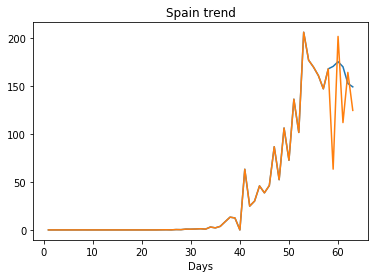

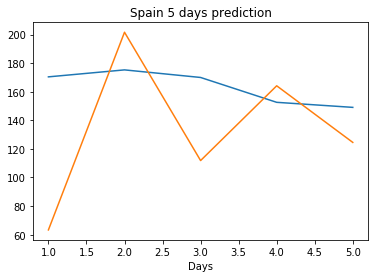

Creating directory ./offline6/Belgium/training/
Belgium
Saving the best model weights at Epoch [1], Best Valid Loss: 11735.7295
Saving the best model weights at Epoch [2], Best Valid Loss: 10640.0391
Saving the best model weights at Epoch [3], Best Valid Loss: 7743.9019


/space/home/nzhang/anaconda3/envs/neuralnet/lib/python3.7/site-packages/torch/nn/modules/loss.py:431: UserWarning: Using a target size (torch.Size([1, 1, 5])) that is different to the input size (torch.Size([5])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/space/home/nzhang/anaconda3/envs/neuralnet/lib/python3.7/site-packages/torch/nn/modules/loss.py:431: UserWarning: Using a target size (torch.Size([1, 5])) that is different to the input size (torch.Size([5])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Saving the best model weights at Epoch [20], Best Valid Loss: 6941.6499
train error: 824.2777908182144
6941.64990234375
Saving the best model weights at Epoch [1], Best Valid Loss: 9294.1904
Saving the best model weights at Epoch [2], Best Valid Loss: 8628.1787
Saving the best model weights at Epoch [10], Best Valid Loss: 8462.8662
Saving the best model weights at Epoch [20], Best Valid Loss: 8082.0049
Saving the best model weights at Epoch [21], Best Valid Loss: 7982.7891
Saving the best model weights at Epoch [31], Best Valid Loss: 7076.4736
train error: 1074.6057066488265
7076.4736328125
Saving the best model weights at Epoch [1], Best Valid Loss: 8168.4619
Saving the best model weights at Epoch [2], Best Valid Loss: 5037.5522
Saving the best model weights at Epoch [23], Best Valid Loss: 4130.6138
train error: 827.1154181671143
4130.61376953125
Saving the best model weights at Epoch [1], Best Valid Loss: 11497.8936
Saving the best model weights at Epoch [2], Best Valid Loss: 7868.07

Saving the best model weights at Epoch [24], Best Valid Loss: 3522.8286
Saving the best model weights at Epoch [34], Best Valid Loss: 2665.5007
train error: 1450.2001540374756
2665.500732421875
Saving the best model weights at Epoch [1], Best Valid Loss: 11507.8145
Saving the best model weights at Epoch [2], Best Valid Loss: 11225.0488
Saving the best model weights at Epoch [3], Best Valid Loss: 8938.3623
Saving the best model weights at Epoch [8], Best Valid Loss: 8165.4878
Saving the best model weights at Epoch [10], Best Valid Loss: 7561.7163
Saving the best model weights at Epoch [14], Best Valid Loss: 4250.3140
Saving the best model weights at Epoch [15], Best Valid Loss: 3824.8438
Saving the best model weights at Epoch [28], Best Valid Loss: 2876.4802
train error: 1456.9632177639007
2876.480224609375
Saving the best model weights at Epoch [1], Best Valid Loss: 10096.8594
Saving the best model weights at Epoch [3], Best Valid Loss: 8775.0117
Saving the best model weights at Epoch 

Saving the best model weights at Epoch [33], Best Valid Loss: 7680.1577
train error: 1146.3192039871217
7680.15771484375
Saving the best model weights at Epoch [1], Best Valid Loss: 14735.4736
Saving the best model weights at Epoch [2], Best Valid Loss: 9114.4893
Saving the best model weights at Epoch [4], Best Valid Loss: 7512.9272
Saving the best model weights at Epoch [6], Best Valid Loss: 5345.4395
Saving the best model weights at Epoch [33], Best Valid Loss: 3885.3567
train error: 1367.7672602844239
3885.356689453125
Saving the best model weights at Epoch [1], Best Valid Loss: 9462.0537
Saving the best model weights at Epoch [2], Best Valid Loss: 7459.6406
Saving the best model weights at Epoch [4], Best Valid Loss: 7085.7197
Saving the best model weights at Epoch [5], Best Valid Loss: 7085.3149
Saving the best model weights at Epoch [6], Best Valid Loss: 7039.1284
Saving the best model weights at Epoch [12], Best Valid Loss: 5464.5977
train error: 1123.3292108154296
5464.59765625

Saving the best model weights at Epoch [15], Best Valid Loss: 9717.9102
Saving the best model weights at Epoch [16], Best Valid Loss: 9586.9189
Saving the best model weights at Epoch [17], Best Valid Loss: 9470.2363
Saving the best model weights at Epoch [18], Best Valid Loss: 9350.7217
Saving the best model weights at Epoch [22], Best Valid Loss: 9338.8506
Saving the best model weights at Epoch [23], Best Valid Loss: 9211.3984
Saving the best model weights at Epoch [28], Best Valid Loss: 9091.1045
Saving the best model weights at Epoch [29], Best Valid Loss: 8990.2725
Saving the best model weights at Epoch [40], Best Valid Loss: 8971.0645
Saving the best model weights at Epoch [41], Best Valid Loss: 8953.4834
Saving the best model weights at Epoch [43], Best Valid Loss: 8794.0879
Saving the best model weights at Epoch [44], Best Valid Loss: 8458.2969
Saving the best model weights at Epoch [45], Best Valid Loss: 8376.4521
Saving the best model weights at Epoch [48], Best Valid Loss: 81

Saving the best model weights at Epoch [24], Best Valid Loss: 6533.1914
train error: 952.8916274547577
6533.19140625
Saving the best model weights at Epoch [1], Best Valid Loss: 4256.6821
train error: 1145.174206237793
4256.68212890625
Saving the best model weights at Epoch [1], Best Valid Loss: 14116.3545
Saving the best model weights at Epoch [2], Best Valid Loss: 11866.8066
Saving the best model weights at Epoch [3], Best Valid Loss: 10908.4590
Saving the best model weights at Epoch [4], Best Valid Loss: 10023.8770
Saving the best model weights at Epoch [5], Best Valid Loss: 9637.6484
Saving the best model weights at Epoch [17], Best Valid Loss: 9607.8789
Saving the best model weights at Epoch [18], Best Valid Loss: 9579.7842
Saving the best model weights at Epoch [23], Best Valid Loss: 9572.4424
Saving the best model weights at Epoch [31], Best Valid Loss: 9572.1904
Saving the best model weights at Epoch [32], Best Valid Loss: 9527.4736
Saving the best model weights at Epoch [33], 

Saving the best model weights at Epoch [8], Best Valid Loss: 9011.4580
Saving the best model weights at Epoch [23], Best Valid Loss: 8279.5254
Saving the best model weights at Epoch [31], Best Valid Loss: 8230.6113
Saving the best model weights at Epoch [50], Best Valid Loss: 8107.0718
train error: 971.9006259918212
8107.07177734375
Saving the best model weights at Epoch [1], Best Valid Loss: 12766.7100
Saving the best model weights at Epoch [2], Best Valid Loss: 10796.4229
Saving the best model weights at Epoch [3], Best Valid Loss: 8490.8818
train error: 1066.3228298950196
8490.8818359375
Saving the best model weights at Epoch [1], Best Valid Loss: 9321.4395
Saving the best model weights at Epoch [5], Best Valid Loss: 8920.6279
Saving the best model weights at Epoch [12], Best Valid Loss: 8609.6504
Saving the best model weights at Epoch [16], Best Valid Loss: 8593.8975
Saving the best model weights at Epoch [17], Best Valid Loss: 8552.2461
Saving the best model weights at Epoch [19],

Saving the best model weights at Epoch [3], Best Valid Loss: 10542.4619
Saving the best model weights at Epoch [4], Best Valid Loss: 9414.4219
Saving the best model weights at Epoch [6], Best Valid Loss: 9157.8691
Saving the best model weights at Epoch [9], Best Valid Loss: 8576.8643
Saving the best model weights at Epoch [10], Best Valid Loss: 8171.9375
train error: 1086.1094079589843
8171.9375
Saving the best model weights at Epoch [1], Best Valid Loss: 13015.4639
Saving the best model weights at Epoch [2], Best Valid Loss: 10339.4980
Saving the best model weights at Epoch [3], Best Valid Loss: 9591.6201
Saving the best model weights at Epoch [5], Best Valid Loss: 8813.8662
Saving the best model weights at Epoch [7], Best Valid Loss: 7798.0039
Saving the best model weights at Epoch [50], Best Valid Loss: 7221.2847
train error: 796.462399597168
7221.28466796875
Saving the best model weights at Epoch [1], Best Valid Loss: 8795.0635
Saving the best model weights at Epoch [10], Best Vali

Saving the best model weights at Epoch [45], Best Valid Loss: 10441.9971
train error: 1031.220385594368
10441.9970703125
Saving the best model weights at Epoch [1], Best Valid Loss: 14996.2891
Saving the best model weights at Epoch [2], Best Valid Loss: 14745.3066
Saving the best model weights at Epoch [3], Best Valid Loss: 14483.3467
Saving the best model weights at Epoch [4], Best Valid Loss: 14192.8486
Saving the best model weights at Epoch [5], Best Valid Loss: 13913.7002
Saving the best model weights at Epoch [6], Best Valid Loss: 13660.5850
Saving the best model weights at Epoch [7], Best Valid Loss: 13428.5410
Saving the best model weights at Epoch [8], Best Valid Loss: 13165.1670
Saving the best model weights at Epoch [9], Best Valid Loss: 12957.3906
Saving the best model weights at Epoch [10], Best Valid Loss: 12707.7910
Saving the best model weights at Epoch [11], Best Valid Loss: 12387.4883
Saving the best model weights at Epoch [12], Best Valid Loss: 12031.5527
Saving the b

Saving the best model weights at Epoch [46], Best Valid Loss: 8634.8828
train error: 819.4532813739777
8634.8828125
Saving the best model weights at Epoch [1], Best Valid Loss: 13911.0596
Saving the best model weights at Epoch [2], Best Valid Loss: 12447.1875
Saving the best model weights at Epoch [3], Best Valid Loss: 10987.7686
Saving the best model weights at Epoch [4], Best Valid Loss: 9935.7373
Saving the best model weights at Epoch [7], Best Valid Loss: 9758.6895
Saving the best model weights at Epoch [19], Best Valid Loss: 9585.8506
Saving the best model weights at Epoch [21], Best Valid Loss: 9384.4766
Saving the best model weights at Epoch [22], Best Valid Loss: 9380.6016
train error: 903.1621919441224
9380.6015625
Saving the best model weights at Epoch [1], Best Valid Loss: 11937.8877
Saving the best model weights at Epoch [2], Best Valid Loss: 11415.4424
Saving the best model weights at Epoch [4], Best Valid Loss: 10669.4785
Saving the best model weights at Epoch [6], Best V

Saving the best model weights at Epoch [34], Best Valid Loss: 9617.5068
Saving the best model weights at Epoch [37], Best Valid Loss: 9526.2061
Saving the best model weights at Epoch [43], Best Valid Loss: 9426.0986
Saving the best model weights at Epoch [46], Best Valid Loss: 9276.5000
Saving the best model weights at Epoch [47], Best Valid Loss: 9111.3975
Saving the best model weights at Epoch [49], Best Valid Loss: 8949.8594
train error: 983.750009765625
8949.859375
Saving the best model weights at Epoch [1], Best Valid Loss: 14799.2607
Saving the best model weights at Epoch [2], Best Valid Loss: 13692.0029
Saving the best model weights at Epoch [3], Best Valid Loss: 11848.0674
Saving the best model weights at Epoch [4], Best Valid Loss: 10796.5674
Saving the best model weights at Epoch [5], Best Valid Loss: 9967.7568
Saving the best model weights at Epoch [8], Best Valid Loss: 9740.8193
Saving the best model weights at Epoch [9], Best Valid Loss: 9541.9814
Saving the best model wei

Saving the best model weights at Epoch [13], Best Valid Loss: 8481.9346
Saving the best model weights at Epoch [16], Best Valid Loss: 8369.4912
Saving the best model weights at Epoch [26], Best Valid Loss: 8107.9385
Saving the best model weights at Epoch [32], Best Valid Loss: 7787.6675
Saving the best model weights at Epoch [35], Best Valid Loss: 7107.0312
Saving the best model weights at Epoch [45], Best Valid Loss: 7008.1104
Saving the best model weights at Epoch [48], Best Valid Loss: 6987.9390
Saving the best model weights at Epoch [49], Best Valid Loss: 6495.0396
train error: 942.8206348991393
6495.03955078125
Saving the best model weights at Epoch [1], Best Valid Loss: 14993.6123
Saving the best model weights at Epoch [2], Best Valid Loss: 14117.9736
Saving the best model weights at Epoch [3], Best Valid Loss: 11989.0752
Saving the best model weights at Epoch [4], Best Valid Loss: 9564.7559
Saving the best model weights at Epoch [5], Best Valid Loss: 8958.1582
Saving the best mo

Saving the best model weights at Epoch [6], Best Valid Loss: 14735.3145
Saving the best model weights at Epoch [7], Best Valid Loss: 14630.1143
Saving the best model weights at Epoch [8], Best Valid Loss: 14511.5654
Saving the best model weights at Epoch [9], Best Valid Loss: 14373.7500
Saving the best model weights at Epoch [10], Best Valid Loss: 14212.5928
Saving the best model weights at Epoch [11], Best Valid Loss: 14020.7754
Saving the best model weights at Epoch [12], Best Valid Loss: 13791.6816
Saving the best model weights at Epoch [13], Best Valid Loss: 13517.1162
Saving the best model weights at Epoch [14], Best Valid Loss: 13197.2607
Saving the best model weights at Epoch [15], Best Valid Loss: 12827.6064
Saving the best model weights at Epoch [16], Best Valid Loss: 12429.8428
Saving the best model weights at Epoch [17], Best Valid Loss: 12016.7471
Saving the best model weights at Epoch [18], Best Valid Loss: 11612.2314
Saving the best model weights at Epoch [19], Best Valid

Saving the best model weights at Epoch [7], Best Valid Loss: 8898.1436
Saving the best model weights at Epoch [8], Best Valid Loss: 8522.6934
Saving the best model weights at Epoch [18], Best Valid Loss: 8277.4766
Saving the best model weights at Epoch [21], Best Valid Loss: 8118.0913
Saving the best model weights at Epoch [42], Best Valid Loss: 7848.9878
Saving the best model weights at Epoch [48], Best Valid Loss: 7214.2446
Saving the best model weights at Epoch [49], Best Valid Loss: 7203.2144
train error: 907.1760612010955
7203.21435546875
Saving the best model weights at Epoch [1], Best Valid Loss: 15172.5928
Saving the best model weights at Epoch [2], Best Valid Loss: 15096.1592
Saving the best model weights at Epoch [3], Best Valid Loss: 15015.4287
Saving the best model weights at Epoch [4], Best Valid Loss: 14930.4092
Saving the best model weights at Epoch [5], Best Valid Loss: 14834.2998
Saving the best model weights at Epoch [6], Best Valid Loss: 14720.7031
Saving the best mo

Saving the best model weights at Epoch [18], Best Valid Loss: 11017.2627
Saving the best model weights at Epoch [19], Best Valid Loss: 10824.5596
Saving the best model weights at Epoch [20], Best Valid Loss: 10665.7881
Saving the best model weights at Epoch [21], Best Valid Loss: 10524.4268
Saving the best model weights at Epoch [22], Best Valid Loss: 10392.5244
Saving the best model weights at Epoch [23], Best Valid Loss: 10306.8906
Saving the best model weights at Epoch [24], Best Valid Loss: 10218.4170
Saving the best model weights at Epoch [25], Best Valid Loss: 10145.1396
Saving the best model weights at Epoch [26], Best Valid Loss: 10093.5420
Saving the best model weights at Epoch [27], Best Valid Loss: 10015.4375
Saving the best model weights at Epoch [28], Best Valid Loss: 9960.1318
Saving the best model weights at Epoch [29], Best Valid Loss: 9918.1035
Saving the best model weights at Epoch [30], Best Valid Loss: 9863.7939
Saving the best model weights at Epoch [31], Best Vali

train error: 1026.7794435882568
8864.0029296875
Saving the best model weights at Epoch [1], Best Valid Loss: 15170.6084
Saving the best model weights at Epoch [2], Best Valid Loss: 15092.8535
Saving the best model weights at Epoch [3], Best Valid Loss: 15014.2725
Saving the best model weights at Epoch [4], Best Valid Loss: 14931.1973
Saving the best model weights at Epoch [5], Best Valid Loss: 14842.0156
Saving the best model weights at Epoch [6], Best Valid Loss: 14744.7002
Saving the best model weights at Epoch [7], Best Valid Loss: 14637.7188
Saving the best model weights at Epoch [8], Best Valid Loss: 14511.5928
Saving the best model weights at Epoch [9], Best Valid Loss: 14368.0283
Saving the best model weights at Epoch [10], Best Valid Loss: 14200.0986
Saving the best model weights at Epoch [11], Best Valid Loss: 14003.4531
Saving the best model weights at Epoch [12], Best Valid Loss: 13770.7686
Saving the best model weights at Epoch [13], Best Valid Loss: 13499.1738
Saving the b

Saving the best model weights at Epoch [9], Best Valid Loss: 8342.5361
Saving the best model weights at Epoch [17], Best Valid Loss: 7958.8452
train error: 1039.3976219558715
7958.84521484375
Saving the best model weights at Epoch [1], Best Valid Loss: 15158.0693
Saving the best model weights at Epoch [2], Best Valid Loss: 15081.4131
Saving the best model weights at Epoch [3], Best Valid Loss: 15003.3701
Saving the best model weights at Epoch [4], Best Valid Loss: 14923.3379
Saving the best model weights at Epoch [5], Best Valid Loss: 14841.4160
Saving the best model weights at Epoch [6], Best Valid Loss: 14752.2031
Saving the best model weights at Epoch [7], Best Valid Loss: 14659.0674
Saving the best model weights at Epoch [8], Best Valid Loss: 14555.8037
Saving the best model weights at Epoch [9], Best Valid Loss: 14443.1797
Saving the best model weights at Epoch [10], Best Valid Loss: 14320.0928
Saving the best model weights at Epoch [11], Best Valid Loss: 14182.8223
Saving the bes

Saving the best model weights at Epoch [6], Best Valid Loss: 14748.6250
Saving the best model weights at Epoch [7], Best Valid Loss: 14644.9707
Saving the best model weights at Epoch [8], Best Valid Loss: 14528.0410
Saving the best model weights at Epoch [9], Best Valid Loss: 14397.0547
Saving the best model weights at Epoch [10], Best Valid Loss: 14246.9688
Saving the best model weights at Epoch [11], Best Valid Loss: 14076.6846
Saving the best model weights at Epoch [12], Best Valid Loss: 13884.1748
Saving the best model weights at Epoch [13], Best Valid Loss: 13669.1689
Saving the best model weights at Epoch [14], Best Valid Loss: 13429.4395
Saving the best model weights at Epoch [15], Best Valid Loss: 13169.3984
Saving the best model weights at Epoch [16], Best Valid Loss: 12895.2959
Saving the best model weights at Epoch [17], Best Valid Loss: 12605.2578
Saving the best model weights at Epoch [18], Best Valid Loss: 12312.0137
Saving the best model weights at Epoch [19], Best Valid

Saving the best model weights at Epoch [33], Best Valid Loss: 9711.7656
Saving the best model weights at Epoch [34], Best Valid Loss: 9701.1602
Saving the best model weights at Epoch [35], Best Valid Loss: 9689.5537
Saving the best model weights at Epoch [36], Best Valid Loss: 9666.9932
Saving the best model weights at Epoch [37], Best Valid Loss: 9633.9277
Saving the best model weights at Epoch [38], Best Valid Loss: 9598.1924
Saving the best model weights at Epoch [42], Best Valid Loss: 9574.4121
Saving the best model weights at Epoch [43], Best Valid Loss: 9572.9688
Saving the best model weights at Epoch [44], Best Valid Loss: 9549.4990
Saving the best model weights at Epoch [45], Best Valid Loss: 9510.5811
Saving the best model weights at Epoch [46], Best Valid Loss: 9422.7568
Saving the best model weights at Epoch [47], Best Valid Loss: 9314.3506
Saving the best model weights at Epoch [48], Best Valid Loss: 9085.8594
Saving the best model weights at Epoch [49], Best Valid Loss: 89

Saving the best model weights at Epoch [4], Best Valid Loss: 15199.4912
Saving the best model weights at Epoch [5], Best Valid Loss: 15184.2832
Saving the best model weights at Epoch [6], Best Valid Loss: 15168.3613
Saving the best model weights at Epoch [7], Best Valid Loss: 15151.0498
Saving the best model weights at Epoch [8], Best Valid Loss: 15133.4238
Saving the best model weights at Epoch [9], Best Valid Loss: 15115.4365
Saving the best model weights at Epoch [10], Best Valid Loss: 15096.2725
Saving the best model weights at Epoch [11], Best Valid Loss: 15076.1270
Saving the best model weights at Epoch [12], Best Valid Loss: 15055.7236
Saving the best model weights at Epoch [13], Best Valid Loss: 15033.6436
Saving the best model weights at Epoch [14], Best Valid Loss: 15006.7100
Saving the best model weights at Epoch [15], Best Valid Loss: 14974.5254
Saving the best model weights at Epoch [16], Best Valid Loss: 14947.7969
Saving the best model weights at Epoch [17], Best Valid L

Saving the best model weights at Epoch [16], Best Valid Loss: 12436.0889
Saving the best model weights at Epoch [17], Best Valid Loss: 12276.0996
Saving the best model weights at Epoch [18], Best Valid Loss: 12128.4502
Saving the best model weights at Epoch [19], Best Valid Loss: 11968.0391
Saving the best model weights at Epoch [20], Best Valid Loss: 11843.0049
Saving the best model weights at Epoch [21], Best Valid Loss: 11680.7803
Saving the best model weights at Epoch [22], Best Valid Loss: 11558.1777
Saving the best model weights at Epoch [23], Best Valid Loss: 11430.1660
Saving the best model weights at Epoch [24], Best Valid Loss: 11281.8301
Saving the best model weights at Epoch [25], Best Valid Loss: 11168.5742
Saving the best model weights at Epoch [26], Best Valid Loss: 11057.9971
Saving the best model weights at Epoch [27], Best Valid Loss: 10941.2422
Saving the best model weights at Epoch [28], Best Valid Loss: 10812.0781
Saving the best model weights at Epoch [29], Best V

Saving the best model weights at Epoch [43], Best Valid Loss: 11268.9541
Saving the best model weights at Epoch [44], Best Valid Loss: 11192.5840
Saving the best model weights at Epoch [45], Best Valid Loss: 11114.6299
Saving the best model weights at Epoch [46], Best Valid Loss: 11038.9668
Saving the best model weights at Epoch [47], Best Valid Loss: 10963.9678
Saving the best model weights at Epoch [48], Best Valid Loss: 10891.2412
Saving the best model weights at Epoch [49], Best Valid Loss: 10822.5352
Saving the best model weights at Epoch [50], Best Valid Loss: 10749.5889
train error: 950.1106422114373
10749.5888671875
Saving the best model weights at Epoch [1], Best Valid Loss: 15027.3154
Saving the best model weights at Epoch [2], Best Valid Loss: 14586.4795
Saving the best model weights at Epoch [3], Best Valid Loss: 14186.8672
Saving the best model weights at Epoch [4], Best Valid Loss: 13701.7842
Saving the best model weights at Epoch [5], Best Valid Loss: 13237.7061
Saving t

Saving the best model weights at Epoch [34], Best Valid Loss: 10338.7109
Saving the best model weights at Epoch [35], Best Valid Loss: 10248.1963
Saving the best model weights at Epoch [36], Best Valid Loss: 10144.8193
Saving the best model weights at Epoch [37], Best Valid Loss: 10036.2334
Saving the best model weights at Epoch [38], Best Valid Loss: 9939.6045
Saving the best model weights at Epoch [39], Best Valid Loss: 9845.3848
Saving the best model weights at Epoch [40], Best Valid Loss: 9763.4238
Saving the best model weights at Epoch [41], Best Valid Loss: 9669.6748
Saving the best model weights at Epoch [42], Best Valid Loss: 9570.5498
Saving the best model weights at Epoch [43], Best Valid Loss: 9485.0928
Saving the best model weights at Epoch [44], Best Valid Loss: 9398.2969
Saving the best model weights at Epoch [45], Best Valid Loss: 9319.7500
Saving the best model weights at Epoch [46], Best Valid Loss: 9231.8311
Saving the best model weights at Epoch [47], Best Valid Loss

Saving the best model weights at Epoch [30], Best Valid Loss: 7920.2744
Saving the best model weights at Epoch [31], Best Valid Loss: 7782.9297
Saving the best model weights at Epoch [32], Best Valid Loss: 7658.5112
Saving the best model weights at Epoch [33], Best Valid Loss: 7530.2563
Saving the best model weights at Epoch [34], Best Valid Loss: 7426.3550
Saving the best model weights at Epoch [35], Best Valid Loss: 7315.3281
Saving the best model weights at Epoch [36], Best Valid Loss: 7234.4766
Saving the best model weights at Epoch [37], Best Valid Loss: 7098.0898
Saving the best model weights at Epoch [39], Best Valid Loss: 6908.8462
Saving the best model weights at Epoch [41], Best Valid Loss: 6746.0469
Saving the best model weights at Epoch [42], Best Valid Loss: 6640.4658
Saving the best model weights at Epoch [49], Best Valid Loss: 6587.1768
train error: 463.93593392968177
6587.1767578125
Saving the best model weights at Epoch [1], Best Valid Loss: 14625.8623
Saving the best 

Saving the best model weights at Epoch [38], Best Valid Loss: 14662.9971
Saving the best model weights at Epoch [39], Best Valid Loss: 14642.3779
Saving the best model weights at Epoch [40], Best Valid Loss: 14620.6982
Saving the best model weights at Epoch [41], Best Valid Loss: 14600.2109
Saving the best model weights at Epoch [42], Best Valid Loss: 14575.8857
Saving the best model weights at Epoch [43], Best Valid Loss: 14552.8359
Saving the best model weights at Epoch [44], Best Valid Loss: 14529.2031
Saving the best model weights at Epoch [45], Best Valid Loss: 14506.4639
Saving the best model weights at Epoch [46], Best Valid Loss: 14478.8594
Saving the best model weights at Epoch [47], Best Valid Loss: 14453.8740
Saving the best model weights at Epoch [48], Best Valid Loss: 14426.6533
Saving the best model weights at Epoch [49], Best Valid Loss: 14399.7490
Saving the best model weights at Epoch [50], Best Valid Loss: 14371.2725
train error: 1603.2359160614014
14371.2724609375
Sa

Saving the best model weights at Epoch [5], Best Valid Loss: 15148.8721
Saving the best model weights at Epoch [6], Best Valid Loss: 15130.6953
Saving the best model weights at Epoch [7], Best Valid Loss: 15111.8203
Saving the best model weights at Epoch [8], Best Valid Loss: 15092.0879
Saving the best model weights at Epoch [9], Best Valid Loss: 15071.8359
Saving the best model weights at Epoch [10], Best Valid Loss: 15049.6035
Saving the best model weights at Epoch [11], Best Valid Loss: 15027.2627
Saving the best model weights at Epoch [12], Best Valid Loss: 15006.3379
Saving the best model weights at Epoch [13], Best Valid Loss: 14980.3330
Saving the best model weights at Epoch [14], Best Valid Loss: 14955.4131
Saving the best model weights at Epoch [15], Best Valid Loss: 14927.6475
Saving the best model weights at Epoch [16], Best Valid Loss: 14898.3848
Saving the best model weights at Epoch [17], Best Valid Loss: 14868.8594
Saving the best model weights at Epoch [18], Best Valid 

Saving the best model weights at Epoch [40], Best Valid Loss: 14541.3379
Saving the best model weights at Epoch [41], Best Valid Loss: 14500.7139
Saving the best model weights at Epoch [42], Best Valid Loss: 14458.4561
Saving the best model weights at Epoch [43], Best Valid Loss: 14413.1250
Saving the best model weights at Epoch [44], Best Valid Loss: 14365.7158
Saving the best model weights at Epoch [45], Best Valid Loss: 14315.8457
Saving the best model weights at Epoch [46], Best Valid Loss: 14263.3564
Saving the best model weights at Epoch [47], Best Valid Loss: 14209.1201
Saving the best model weights at Epoch [48], Best Valid Loss: 14152.1250
Saving the best model weights at Epoch [49], Best Valid Loss: 14093.6240
Saving the best model weights at Epoch [50], Best Valid Loss: 14032.2598
train error: 1534.171198630333
14032.259765625
Saving the best model weights at Epoch [1], Best Valid Loss: 15212.3623
Saving the best model weights at Epoch [2], Best Valid Loss: 15196.0811
Saving

Saving the best model weights at Epoch [32], Best Valid Loss: 14316.1553
Saving the best model weights at Epoch [33], Best Valid Loss: 14238.5234
Saving the best model weights at Epoch [34], Best Valid Loss: 14156.1660
Saving the best model weights at Epoch [35], Best Valid Loss: 14066.7812
Saving the best model weights at Epoch [36], Best Valid Loss: 13972.1221
Saving the best model weights at Epoch [37], Best Valid Loss: 13874.5283
Saving the best model weights at Epoch [38], Best Valid Loss: 13768.3018
Saving the best model weights at Epoch [39], Best Valid Loss: 13659.7363
Saving the best model weights at Epoch [40], Best Valid Loss: 13546.9404
Saving the best model weights at Epoch [41], Best Valid Loss: 13430.3691
Saving the best model weights at Epoch [42], Best Valid Loss: 13310.8701
Saving the best model weights at Epoch [43], Best Valid Loss: 13186.9658
Saving the best model weights at Epoch [44], Best Valid Loss: 13056.8242
Saving the best model weights at Epoch [45], Best V

Saving the best model weights at Epoch [30], Best Valid Loss: 15055.9873
Saving the best model weights at Epoch [31], Best Valid Loss: 15048.1426
Saving the best model weights at Epoch [32], Best Valid Loss: 15040.0029
Saving the best model weights at Epoch [33], Best Valid Loss: 15032.0420
Saving the best model weights at Epoch [34], Best Valid Loss: 15023.8828
Saving the best model weights at Epoch [35], Best Valid Loss: 15015.7881
Saving the best model weights at Epoch [36], Best Valid Loss: 15007.6768
Saving the best model weights at Epoch [37], Best Valid Loss: 14999.4922
Saving the best model weights at Epoch [38], Best Valid Loss: 14991.1943
Saving the best model weights at Epoch [39], Best Valid Loss: 14982.9561
Saving the best model weights at Epoch [40], Best Valid Loss: 14974.6113
Saving the best model weights at Epoch [41], Best Valid Loss: 14966.2266
Saving the best model weights at Epoch [42], Best Valid Loss: 14957.7998
Saving the best model weights at Epoch [43], Best V

Saving the best model weights at Epoch [43], Best Valid Loss: 10305.6758
Saving the best model weights at Epoch [45], Best Valid Loss: 10257.1016
Saving the best model weights at Epoch [46], Best Valid Loss: 10178.0850
Saving the best model weights at Epoch [48], Best Valid Loss: 10112.7139
Saving the best model weights at Epoch [49], Best Valid Loss: 10050.8740
train error: 1067.5297024536133
10050.8740234375
Saving the best model weights at Epoch [1], Best Valid Loss: 15241.9424
Saving the best model weights at Epoch [2], Best Valid Loss: 15234.2910
Saving the best model weights at Epoch [3], Best Valid Loss: 15226.6045
Saving the best model weights at Epoch [4], Best Valid Loss: 15218.9756
Saving the best model weights at Epoch [5], Best Valid Loss: 15211.3877
Saving the best model weights at Epoch [6], Best Valid Loss: 15203.7188
Saving the best model weights at Epoch [7], Best Valid Loss: 15196.1191
Saving the best model weights at Epoch [8], Best Valid Loss: 15188.4912
Saving the

Saving the best model weights at Epoch [7], Best Valid Loss: 14751.1904
Saving the best model weights at Epoch [8], Best Valid Loss: 14662.2520
Saving the best model weights at Epoch [9], Best Valid Loss: 14566.9863
Saving the best model weights at Epoch [10], Best Valid Loss: 14462.3115
Saving the best model weights at Epoch [11], Best Valid Loss: 14338.3984
Saving the best model weights at Epoch [12], Best Valid Loss: 14216.6553
Saving the best model weights at Epoch [13], Best Valid Loss: 14066.3174
Saving the best model weights at Epoch [14], Best Valid Loss: 13854.0439
Saving the best model weights at Epoch [15], Best Valid Loss: 13676.6748
Saving the best model weights at Epoch [16], Best Valid Loss: 13398.9629
Saving the best model weights at Epoch [17], Best Valid Loss: 13062.6006
Saving the best model weights at Epoch [18], Best Valid Loss: 12744.2852
Saving the best model weights at Epoch [19], Best Valid Loss: 12360.0713
Saving the best model weights at Epoch [20], Best Vali

Saving the best model weights at Epoch [37], Best Valid Loss: 14592.6816
Saving the best model weights at Epoch [38], Best Valid Loss: 14567.2490
Saving the best model weights at Epoch [39], Best Valid Loss: 14542.1064
Saving the best model weights at Epoch [40], Best Valid Loss: 14514.6064
Saving the best model weights at Epoch [41], Best Valid Loss: 14487.2471
Saving the best model weights at Epoch [42], Best Valid Loss: 14458.4678
Saving the best model weights at Epoch [43], Best Valid Loss: 14429.1084
Saving the best model weights at Epoch [44], Best Valid Loss: 14398.9033
Saving the best model weights at Epoch [45], Best Valid Loss: 14364.9014
Saving the best model weights at Epoch [46], Best Valid Loss: 14331.3877
Saving the best model weights at Epoch [47], Best Valid Loss: 14295.0469
Saving the best model weights at Epoch [48], Best Valid Loss: 14256.7422
Saving the best model weights at Epoch [49], Best Valid Loss: 14219.2783
Saving the best model weights at Epoch [50], Best V

Saving the best model weights at Epoch [19], Best Valid Loss: 14984.0000
Saving the best model weights at Epoch [20], Best Valid Loss: 14967.7656
Saving the best model weights at Epoch [21], Best Valid Loss: 14951.9951
Saving the best model weights at Epoch [22], Best Valid Loss: 14936.0420
Saving the best model weights at Epoch [23], Best Valid Loss: 14920.1318
Saving the best model weights at Epoch [24], Best Valid Loss: 14903.3779
Saving the best model weights at Epoch [25], Best Valid Loss: 14885.7031
Saving the best model weights at Epoch [26], Best Valid Loss: 14867.7920
Saving the best model weights at Epoch [27], Best Valid Loss: 14850.8359
Saving the best model weights at Epoch [28], Best Valid Loss: 14831.1270
Saving the best model weights at Epoch [29], Best Valid Loss: 14811.6143
Saving the best model weights at Epoch [30], Best Valid Loss: 14791.8623
Saving the best model weights at Epoch [31], Best Valid Loss: 14770.9688
Saving the best model weights at Epoch [32], Best V

Saving the best model weights at Epoch [10], Best Valid Loss: 15077.0625
Saving the best model weights at Epoch [11], Best Valid Loss: 15062.9248
Saving the best model weights at Epoch [12], Best Valid Loss: 15049.3408
Saving the best model weights at Epoch [13], Best Valid Loss: 15036.4756
Saving the best model weights at Epoch [14], Best Valid Loss: 15023.5732
Saving the best model weights at Epoch [15], Best Valid Loss: 15009.3779
Saving the best model weights at Epoch [16], Best Valid Loss: 14997.0566
Saving the best model weights at Epoch [17], Best Valid Loss: 14982.5381
Saving the best model weights at Epoch [18], Best Valid Loss: 14968.9189
Saving the best model weights at Epoch [19], Best Valid Loss: 14956.5029
Saving the best model weights at Epoch [20], Best Valid Loss: 14942.4346
Saving the best model weights at Epoch [21], Best Valid Loss: 14929.2285
Saving the best model weights at Epoch [22], Best Valid Loss: 14915.1748
Saving the best model weights at Epoch [23], Best V

Saving the best model weights at Epoch [24], Best Valid Loss: 15067.8701
Saving the best model weights at Epoch [25], Best Valid Loss: 15060.2207
Saving the best model weights at Epoch [26], Best Valid Loss: 15052.5723
Saving the best model weights at Epoch [27], Best Valid Loss: 15044.9287
Saving the best model weights at Epoch [28], Best Valid Loss: 15037.2295
Saving the best model weights at Epoch [29], Best Valid Loss: 15029.5156
Saving the best model weights at Epoch [30], Best Valid Loss: 15021.7910
Saving the best model weights at Epoch [31], Best Valid Loss: 15014.0186
Saving the best model weights at Epoch [32], Best Valid Loss: 15006.2422
Saving the best model weights at Epoch [33], Best Valid Loss: 14998.4707
Saving the best model weights at Epoch [34], Best Valid Loss: 14990.5986
Saving the best model weights at Epoch [35], Best Valid Loss: 14982.8721
Saving the best model weights at Epoch [36], Best Valid Loss: 14974.8506
Saving the best model weights at Epoch [37], Best V

Saving the best model weights at Epoch [38], Best Valid Loss: 9709.2500
Saving the best model weights at Epoch [39], Best Valid Loss: 9661.6113
Saving the best model weights at Epoch [40], Best Valid Loss: 9602.6904
Saving the best model weights at Epoch [41], Best Valid Loss: 9578.6611
Saving the best model weights at Epoch [42], Best Valid Loss: 9554.2568
Saving the best model weights at Epoch [43], Best Valid Loss: 9430.3887
Saving the best model weights at Epoch [44], Best Valid Loss: 9332.1279
Saving the best model weights at Epoch [45], Best Valid Loss: 9275.2412
Saving the best model weights at Epoch [46], Best Valid Loss: 9194.7842
train error: 1038.3194411849975
9194.7841796875
Saving the best model weights at Epoch [1], Best Valid Loss: 15243.1846
Saving the best model weights at Epoch [2], Best Valid Loss: 15235.5078
Saving the best model weights at Epoch [3], Best Valid Loss: 15227.8877
Saving the best model weights at Epoch [4], Best Valid Loss: 15220.3193
Saving the best 

Saving the best model weights at Epoch [5], Best Valid Loss: 14906.5000
Saving the best model weights at Epoch [6], Best Valid Loss: 14833.4326
Saving the best model weights at Epoch [7], Best Valid Loss: 14753.8125
Saving the best model weights at Epoch [8], Best Valid Loss: 14651.7051
Saving the best model weights at Epoch [9], Best Valid Loss: 14545.5693
Saving the best model weights at Epoch [10], Best Valid Loss: 14412.8506
Saving the best model weights at Epoch [11], Best Valid Loss: 14295.7959
Saving the best model weights at Epoch [12], Best Valid Loss: 14102.2842
Saving the best model weights at Epoch [13], Best Valid Loss: 13926.6436
Saving the best model weights at Epoch [14], Best Valid Loss: 13711.0264
Saving the best model weights at Epoch [15], Best Valid Loss: 13459.9756
Saving the best model weights at Epoch [16], Best Valid Loss: 13221.5928
Saving the best model weights at Epoch [17], Best Valid Loss: 12962.8330
Saving the best model weights at Epoch [18], Best Valid 

Saving the best model weights at Epoch [34], Best Valid Loss: 14733.4443
Saving the best model weights at Epoch [35], Best Valid Loss: 14715.0078
Saving the best model weights at Epoch [36], Best Valid Loss: 14694.7910
Saving the best model weights at Epoch [37], Best Valid Loss: 14674.3438
Saving the best model weights at Epoch [38], Best Valid Loss: 14655.6250
Saving the best model weights at Epoch [39], Best Valid Loss: 14632.8691
Saving the best model weights at Epoch [40], Best Valid Loss: 14611.2129
Saving the best model weights at Epoch [41], Best Valid Loss: 14590.0986
Saving the best model weights at Epoch [42], Best Valid Loss: 14565.9473
Saving the best model weights at Epoch [43], Best Valid Loss: 14542.4004
Saving the best model weights at Epoch [44], Best Valid Loss: 14517.7676
Saving the best model weights at Epoch [45], Best Valid Loss: 14492.9580
Saving the best model weights at Epoch [46], Best Valid Loss: 14466.4346
Saving the best model weights at Epoch [47], Best V

Saving the best model weights at Epoch [15], Best Valid Loss: 15018.2646
Saving the best model weights at Epoch [16], Best Valid Loss: 15004.0518
Saving the best model weights at Epoch [17], Best Valid Loss: 14989.8330
Saving the best model weights at Epoch [18], Best Valid Loss: 14975.5312
Saving the best model weights at Epoch [19], Best Valid Loss: 14961.4131
Saving the best model weights at Epoch [20], Best Valid Loss: 14947.0391
Saving the best model weights at Epoch [21], Best Valid Loss: 14934.1299
Saving the best model weights at Epoch [22], Best Valid Loss: 14919.2754
Saving the best model weights at Epoch [23], Best Valid Loss: 14905.0068
Saving the best model weights at Epoch [24], Best Valid Loss: 14890.3154
Saving the best model weights at Epoch [25], Best Valid Loss: 14875.6084
Saving the best model weights at Epoch [26], Best Valid Loss: 14860.9473
Saving the best model weights at Epoch [27], Best Valid Loss: 14846.4287
Saving the best model weights at Epoch [28], Best V

Saving the best model weights at Epoch [27], Best Valid Loss: 15015.2529
Saving the best model weights at Epoch [28], Best Valid Loss: 15007.4814
Saving the best model weights at Epoch [29], Best Valid Loss: 14999.5312
Saving the best model weights at Epoch [30], Best Valid Loss: 14991.7100
Saving the best model weights at Epoch [31], Best Valid Loss: 14983.7812
Saving the best model weights at Epoch [32], Best Valid Loss: 14975.6533
Saving the best model weights at Epoch [33], Best Valid Loss: 14967.6318
Saving the best model weights at Epoch [34], Best Valid Loss: 14959.5625
Saving the best model weights at Epoch [35], Best Valid Loss: 14951.5723
Saving the best model weights at Epoch [36], Best Valid Loss: 14943.4531
Saving the best model weights at Epoch [37], Best Valid Loss: 14935.1953
Saving the best model weights at Epoch [38], Best Valid Loss: 14926.9502
Saving the best model weights at Epoch [39], Best Valid Loss: 14918.5811
Saving the best model weights at Epoch [40], Best V

Saving the best model weights at Epoch [41], Best Valid Loss: 9726.4170
Saving the best model weights at Epoch [42], Best Valid Loss: 9666.4424
Saving the best model weights at Epoch [44], Best Valid Loss: 9629.9580
train error: 1037.8661122512817
9629.9580078125
Saving the best model weights at Epoch [1], Best Valid Loss: 15245.1270
Saving the best model weights at Epoch [2], Best Valid Loss: 15237.4443
Saving the best model weights at Epoch [3], Best Valid Loss: 15229.8154
Saving the best model weights at Epoch [4], Best Valid Loss: 15222.1455
Saving the best model weights at Epoch [5], Best Valid Loss: 15214.4473
Saving the best model weights at Epoch [6], Best Valid Loss: 15206.8438
Saving the best model weights at Epoch [7], Best Valid Loss: 15199.2754
Saving the best model weights at Epoch [8], Best Valid Loss: 15191.5068
Saving the best model weights at Epoch [9], Best Valid Loss: 15183.8691
Saving the best model weights at Epoch [10], Best Valid Loss: 15176.2158
Saving the best

Saving the best model weights at Epoch [9], Best Valid Loss: 14555.6875
Saving the best model weights at Epoch [10], Best Valid Loss: 14458.1045
Saving the best model weights at Epoch [11], Best Valid Loss: 14322.4287
Saving the best model weights at Epoch [12], Best Valid Loss: 14197.9346
Saving the best model weights at Epoch [13], Best Valid Loss: 14051.8379
Saving the best model weights at Epoch [14], Best Valid Loss: 13867.1953
Saving the best model weights at Epoch [15], Best Valid Loss: 13634.3252
Saving the best model weights at Epoch [16], Best Valid Loss: 13420.0498
Saving the best model weights at Epoch [17], Best Valid Loss: 13137.3379
Saving the best model weights at Epoch [18], Best Valid Loss: 12921.3350
Saving the best model weights at Epoch [19], Best Valid Loss: 12567.6240
Saving the best model weights at Epoch [20], Best Valid Loss: 12271.7686
Saving the best model weights at Epoch [21], Best Valid Loss: 11933.2686
Saving the best model weights at Epoch [22], Best Va

Saving the best model weights at Epoch [34], Best Valid Loss: 14739.0752
Saving the best model weights at Epoch [35], Best Valid Loss: 14719.7939
Saving the best model weights at Epoch [36], Best Valid Loss: 14699.8154
Saving the best model weights at Epoch [37], Best Valid Loss: 14679.2598
Saving the best model weights at Epoch [38], Best Valid Loss: 14658.2061
Saving the best model weights at Epoch [39], Best Valid Loss: 14637.3506
Saving the best model weights at Epoch [40], Best Valid Loss: 14614.8115
Saving the best model weights at Epoch [41], Best Valid Loss: 14592.0811
Saving the best model weights at Epoch [42], Best Valid Loss: 14568.4736
Saving the best model weights at Epoch [43], Best Valid Loss: 14545.4707
Saving the best model weights at Epoch [44], Best Valid Loss: 14519.1006
Saving the best model weights at Epoch [45], Best Valid Loss: 14493.9033
Saving the best model weights at Epoch [46], Best Valid Loss: 14469.6904
Saving the best model weights at Epoch [47], Best V

Saving the best model weights at Epoch [10], Best Valid Loss: 15177.2812
Saving the best model weights at Epoch [11], Best Valid Loss: 15175.0693
Saving the best model weights at Epoch [12], Best Valid Loss: 15172.5498
Saving the best model weights at Epoch [13], Best Valid Loss: 15170.1094
Saving the best model weights at Epoch [14], Best Valid Loss: 15167.6895
Saving the best model weights at Epoch [15], Best Valid Loss: 15165.2734
Saving the best model weights at Epoch [16], Best Valid Loss: 15162.8857
Saving the best model weights at Epoch [17], Best Valid Loss: 15160.6035
Saving the best model weights at Epoch [18], Best Valid Loss: 15158.0850
Saving the best model weights at Epoch [19], Best Valid Loss: 15155.6279
Saving the best model weights at Epoch [20], Best Valid Loss: 15153.2158
Saving the best model weights at Epoch [21], Best Valid Loss: 15150.8096
Saving the best model weights at Epoch [22], Best Valid Loss: 15148.4238
Saving the best model weights at Epoch [23], Best V

Saving the best model weights at Epoch [25], Best Valid Loss: 15165.0029
Saving the best model weights at Epoch [26], Best Valid Loss: 15162.0146
Saving the best model weights at Epoch [27], Best Valid Loss: 15159.0205
Saving the best model weights at Epoch [28], Best Valid Loss: 15155.9941
Saving the best model weights at Epoch [29], Best Valid Loss: 15152.9248
Saving the best model weights at Epoch [30], Best Valid Loss: 15149.8301
Saving the best model weights at Epoch [31], Best Valid Loss: 15146.6250
Saving the best model weights at Epoch [32], Best Valid Loss: 15143.3877
Saving the best model weights at Epoch [33], Best Valid Loss: 15140.0723
Saving the best model weights at Epoch [34], Best Valid Loss: 15136.6562
Saving the best model weights at Epoch [35], Best Valid Loss: 15133.1562
Saving the best model weights at Epoch [36], Best Valid Loss: 15129.3906
Saving the best model weights at Epoch [37], Best Valid Loss: 15125.4629
Saving the best model weights at Epoch [38], Best V

Saving the best model weights at Epoch [39], Best Valid Loss: 12923.1123
Saving the best model weights at Epoch [40], Best Valid Loss: 12864.3037
Saving the best model weights at Epoch [41], Best Valid Loss: 12814.2139
Saving the best model weights at Epoch [42], Best Valid Loss: 12749.5342
Saving the best model weights at Epoch [43], Best Valid Loss: 12695.6748
Saving the best model weights at Epoch [44], Best Valid Loss: 12635.5742
Saving the best model weights at Epoch [45], Best Valid Loss: 12577.2920
Saving the best model weights at Epoch [46], Best Valid Loss: 12523.1465
Saving the best model weights at Epoch [47], Best Valid Loss: 12480.1064
Saving the best model weights at Epoch [48], Best Valid Loss: 12417.1592
Saving the best model weights at Epoch [49], Best Valid Loss: 12363.5664
Saving the best model weights at Epoch [50], Best Valid Loss: 12307.0068
train error: 1206.1317768406868
12307.0068359375
Saving the best model weights at Epoch [1], Best Valid Loss: 15256.8857
Sav

Saving the best model weights at Epoch [1], Best Valid Loss: 15219.4863
Saving the best model weights at Epoch [2], Best Valid Loss: 15150.5068
Saving the best model weights at Epoch [3], Best Valid Loss: 15104.1250
Saving the best model weights at Epoch [4], Best Valid Loss: 15028.7764
Saving the best model weights at Epoch [5], Best Valid Loss: 14961.0225
Saving the best model weights at Epoch [6], Best Valid Loss: 14903.4521
Saving the best model weights at Epoch [7], Best Valid Loss: 14830.1406
Saving the best model weights at Epoch [8], Best Valid Loss: 14757.1748
Saving the best model weights at Epoch [9], Best Valid Loss: 14674.4941
Saving the best model weights at Epoch [10], Best Valid Loss: 14583.9189
Saving the best model weights at Epoch [11], Best Valid Loss: 14502.0703
Saving the best model weights at Epoch [12], Best Valid Loss: 14430.2959
Saving the best model weights at Epoch [13], Best Valid Loss: 14340.6768
Saving the best model weights at Epoch [14], Best Valid Loss

Saving the best model weights at Epoch [14], Best Valid Loss: 14963.4189
Saving the best model weights at Epoch [15], Best Valid Loss: 14942.1592
Saving the best model weights at Epoch [16], Best Valid Loss: 14920.9053
Saving the best model weights at Epoch [17], Best Valid Loss: 14899.4756
Saving the best model weights at Epoch [18], Best Valid Loss: 14875.8408
Saving the best model weights at Epoch [19], Best Valid Loss: 14852.2881
Saving the best model weights at Epoch [20], Best Valid Loss: 14829.4189
Saving the best model weights at Epoch [21], Best Valid Loss: 14803.9766
Saving the best model weights at Epoch [22], Best Valid Loss: 14781.3936
Saving the best model weights at Epoch [23], Best Valid Loss: 14755.1006
Saving the best model weights at Epoch [24], Best Valid Loss: 14730.1475
Saving the best model weights at Epoch [25], Best Valid Loss: 14704.5098
Saving the best model weights at Epoch [26], Best Valid Loss: 14679.2441
Saving the best model weights at Epoch [27], Best V

Saving the best model weights at Epoch [27], Best Valid Loss: 15229.5264
Saving the best model weights at Epoch [28], Best Valid Loss: 15228.7158
Saving the best model weights at Epoch [29], Best Valid Loss: 15227.9111
Saving the best model weights at Epoch [30], Best Valid Loss: 15227.1094
Saving the best model weights at Epoch [31], Best Valid Loss: 15226.3037
Saving the best model weights at Epoch [32], Best Valid Loss: 15225.5020
Saving the best model weights at Epoch [33], Best Valid Loss: 15224.7002
Saving the best model weights at Epoch [34], Best Valid Loss: 15223.9014
Saving the best model weights at Epoch [35], Best Valid Loss: 15223.0938
Saving the best model weights at Epoch [36], Best Valid Loss: 15222.2939
Saving the best model weights at Epoch [37], Best Valid Loss: 15221.4941
Saving the best model weights at Epoch [38], Best Valid Loss: 15220.6924
Saving the best model weights at Epoch [39], Best Valid Loss: 15219.8896
Saving the best model weights at Epoch [40], Best V

Saving the best model weights at Epoch [42], Best Valid Loss: 14940.9092
Saving the best model weights at Epoch [43], Best Valid Loss: 14929.5146
Saving the best model weights at Epoch [44], Best Valid Loss: 14919.9004
Saving the best model weights at Epoch [45], Best Valid Loss: 14911.5381
Saving the best model weights at Epoch [46], Best Valid Loss: 14903.1348
Saving the best model weights at Epoch [47], Best Valid Loss: 14894.2061
Saving the best model weights at Epoch [48], Best Valid Loss: 14885.7881
Saving the best model weights at Epoch [49], Best Valid Loss: 14876.2988
Saving the best model weights at Epoch [50], Best Valid Loss: 14867.5312
train error: 1706.7558226513863
14867.53125
Saving the best model weights at Epoch [1], Best Valid Loss: 15221.2891
Saving the best model weights at Epoch [2], Best Valid Loss: 15220.4424
Saving the best model weights at Epoch [3], Best Valid Loss: 15219.5879
Saving the best model weights at Epoch [4], Best Valid Loss: 15218.7334
Saving the 

Saving the best model weights at Epoch [5], Best Valid Loss: 15217.8115
Saving the best model weights at Epoch [6], Best Valid Loss: 15208.7832
Saving the best model weights at Epoch [7], Best Valid Loss: 15200.3311
Saving the best model weights at Epoch [8], Best Valid Loss: 15192.0771
Saving the best model weights at Epoch [9], Best Valid Loss: 15183.7021
Saving the best model weights at Epoch [10], Best Valid Loss: 15174.6748
Saving the best model weights at Epoch [11], Best Valid Loss: 15164.4443
Saving the best model weights at Epoch [12], Best Valid Loss: 15155.4893
Saving the best model weights at Epoch [13], Best Valid Loss: 15145.7969
Saving the best model weights at Epoch [14], Best Valid Loss: 15135.6377
Saving the best model weights at Epoch [15], Best Valid Loss: 15124.8154
Saving the best model weights at Epoch [16], Best Valid Loss: 15113.4521
Saving the best model weights at Epoch [17], Best Valid Loss: 15102.4873
Saving the best model weights at Epoch [18], Best Valid 

Saving the best model weights at Epoch [17], Best Valid Loss: 15201.4629
Saving the best model weights at Epoch [18], Best Valid Loss: 15199.7578
Saving the best model weights at Epoch [19], Best Valid Loss: 15198.0156
Saving the best model weights at Epoch [20], Best Valid Loss: 15196.2080
Saving the best model weights at Epoch [21], Best Valid Loss: 15194.4160
Saving the best model weights at Epoch [22], Best Valid Loss: 15192.5693
Saving the best model weights at Epoch [23], Best Valid Loss: 15190.7451
Saving the best model weights at Epoch [24], Best Valid Loss: 15188.9141
Saving the best model weights at Epoch [25], Best Valid Loss: 15187.1406
Saving the best model weights at Epoch [26], Best Valid Loss: 15185.2598
Saving the best model weights at Epoch [27], Best Valid Loss: 15183.5537
Saving the best model weights at Epoch [28], Best Valid Loss: 15181.4531
Saving the best model weights at Epoch [29], Best Valid Loss: 15179.5781
Saving the best model weights at Epoch [30], Best V

Saving the best model weights at Epoch [31], Best Valid Loss: 15197.8643
Saving the best model weights at Epoch [32], Best Valid Loss: 15196.7285
Saving the best model weights at Epoch [33], Best Valid Loss: 15195.5801
Saving the best model weights at Epoch [34], Best Valid Loss: 15194.4346
Saving the best model weights at Epoch [35], Best Valid Loss: 15193.2881
Saving the best model weights at Epoch [36], Best Valid Loss: 15192.1406
Saving the best model weights at Epoch [37], Best Valid Loss: 15190.9912
Saving the best model weights at Epoch [38], Best Valid Loss: 15189.8428
Saving the best model weights at Epoch [39], Best Valid Loss: 15188.6875
Saving the best model weights at Epoch [40], Best Valid Loss: 15187.5312
Saving the best model weights at Epoch [41], Best Valid Loss: 15186.3955
Saving the best model weights at Epoch [42], Best Valid Loss: 15185.2158
Saving the best model weights at Epoch [43], Best Valid Loss: 15184.0625
Saving the best model weights at Epoch [44], Best V

Saving the best model weights at Epoch [43], Best Valid Loss: 13789.4795
Saving the best model weights at Epoch [44], Best Valid Loss: 13685.3506
Saving the best model weights at Epoch [45], Best Valid Loss: 13574.1436
Saving the best model weights at Epoch [46], Best Valid Loss: 13454.0420
Saving the best model weights at Epoch [47], Best Valid Loss: 13345.1084
Saving the best model weights at Epoch [48], Best Valid Loss: 13227.0732
Saving the best model weights at Epoch [49], Best Valid Loss: 13096.6318
Saving the best model weights at Epoch [50], Best Valid Loss: 12975.6709
train error: 1335.248240981102
12975.6708984375
Saving the best model weights at Epoch [1], Best Valid Loss: 15252.4219
Saving the best model weights at Epoch [2], Best Valid Loss: 15251.6865
Saving the best model weights at Epoch [3], Best Valid Loss: 15250.9531
Saving the best model weights at Epoch [4], Best Valid Loss: 15250.2002
Saving the best model weights at Epoch [5], Best Valid Loss: 15249.4600
Saving t

Saving the best model weights at Epoch [4], Best Valid Loss: 15223.7002
Saving the best model weights at Epoch [5], Best Valid Loss: 15217.1201
Saving the best model weights at Epoch [6], Best Valid Loss: 15209.8379
Saving the best model weights at Epoch [7], Best Valid Loss: 15202.8701
Saving the best model weights at Epoch [8], Best Valid Loss: 15195.7988
Saving the best model weights at Epoch [9], Best Valid Loss: 15189.0723
Saving the best model weights at Epoch [10], Best Valid Loss: 15182.7998
Saving the best model weights at Epoch [11], Best Valid Loss: 15175.9453
Saving the best model weights at Epoch [12], Best Valid Loss: 15168.7754
Saving the best model weights at Epoch [13], Best Valid Loss: 15162.3584
Saving the best model weights at Epoch [14], Best Valid Loss: 15155.8037
Saving the best model weights at Epoch [15], Best Valid Loss: 15149.2607
Saving the best model weights at Epoch [16], Best Valid Loss: 15141.9990
Saving the best model weights at Epoch [17], Best Valid L

Saving the best model weights at Epoch [18], Best Valid Loss: 15225.4297
Saving the best model weights at Epoch [19], Best Valid Loss: 15224.1406
Saving the best model weights at Epoch [20], Best Valid Loss: 15222.6865
Saving the best model weights at Epoch [21], Best Valid Loss: 15221.3428
Saving the best model weights at Epoch [22], Best Valid Loss: 15220.0381
Saving the best model weights at Epoch [23], Best Valid Loss: 15218.6846
Saving the best model weights at Epoch [24], Best Valid Loss: 15217.2500
Saving the best model weights at Epoch [25], Best Valid Loss: 15215.9395
Saving the best model weights at Epoch [26], Best Valid Loss: 15214.5879
Saving the best model weights at Epoch [27], Best Valid Loss: 15213.2100
Saving the best model weights at Epoch [28], Best Valid Loss: 15211.8350
Saving the best model weights at Epoch [29], Best Valid Loss: 15210.4561
Saving the best model weights at Epoch [30], Best Valid Loss: 15209.1172
Saving the best model weights at Epoch [31], Best V

Saving the best model weights at Epoch [32], Best Valid Loss: 15221.7217
Saving the best model weights at Epoch [33], Best Valid Loss: 15220.9639
Saving the best model weights at Epoch [34], Best Valid Loss: 15220.2178
Saving the best model weights at Epoch [35], Best Valid Loss: 15219.4580
Saving the best model weights at Epoch [36], Best Valid Loss: 15218.7031
Saving the best model weights at Epoch [37], Best Valid Loss: 15217.9580
Saving the best model weights at Epoch [38], Best Valid Loss: 15217.1973
Saving the best model weights at Epoch [39], Best Valid Loss: 15216.4473
Saving the best model weights at Epoch [40], Best Valid Loss: 15215.6924
Saving the best model weights at Epoch [41], Best Valid Loss: 15214.9443
Saving the best model weights at Epoch [42], Best Valid Loss: 15214.1875
Saving the best model weights at Epoch [43], Best Valid Loss: 15213.4473
Saving the best model weights at Epoch [44], Best Valid Loss: 15212.6875
Saving the best model weights at Epoch [45], Best V

Saving the best model weights at Epoch [44], Best Valid Loss: 14929.2129
Saving the best model weights at Epoch [45], Best Valid Loss: 14921.5381
Saving the best model weights at Epoch [46], Best Valid Loss: 14913.2969
Saving the best model weights at Epoch [47], Best Valid Loss: 14905.0986
Saving the best model weights at Epoch [48], Best Valid Loss: 14897.7178
Saving the best model weights at Epoch [49], Best Valid Loss: 14888.9404
Saving the best model weights at Epoch [50], Best Valid Loss: 14881.4443
train error: 1708.7322234749795
14881.4443359375
Saving the best model weights at Epoch [1], Best Valid Loss: 15244.0156
Saving the best model weights at Epoch [2], Best Valid Loss: 15243.2373
Saving the best model weights at Epoch [3], Best Valid Loss: 15242.4629
Saving the best model weights at Epoch [4], Best Valid Loss: 15241.6943
Saving the best model weights at Epoch [5], Best Valid Loss: 15240.9219
Saving the best model weights at Epoch [6], Best Valid Loss: 15240.1426
Saving t

Saving the best model weights at Epoch [8], Best Valid Loss: 15190.4785
Saving the best model weights at Epoch [9], Best Valid Loss: 15183.0752
Saving the best model weights at Epoch [10], Best Valid Loss: 15177.1162
Saving the best model weights at Epoch [11], Best Valid Loss: 15170.0723
Saving the best model weights at Epoch [12], Best Valid Loss: 15162.8594
Saving the best model weights at Epoch [13], Best Valid Loss: 15155.6582
Saving the best model weights at Epoch [14], Best Valid Loss: 15148.8281
Saving the best model weights at Epoch [15], Best Valid Loss: 15141.7422
Saving the best model weights at Epoch [16], Best Valid Loss: 15135.1787
Saving the best model weights at Epoch [17], Best Valid Loss: 15127.7490
Saving the best model weights at Epoch [18], Best Valid Loss: 15121.4316
Saving the best model weights at Epoch [19], Best Valid Loss: 15114.0928
Saving the best model weights at Epoch [20], Best Valid Loss: 15107.1631
Saving the best model weights at Epoch [21], Best Val

Saving the best model weights at Epoch [22], Best Valid Loss: 15240.5732
Saving the best model weights at Epoch [23], Best Valid Loss: 15239.1172
Saving the best model weights at Epoch [24], Best Valid Loss: 15237.7969
Saving the best model weights at Epoch [25], Best Valid Loss: 15236.2285
Saving the best model weights at Epoch [26], Best Valid Loss: 15234.8018
Saving the best model weights at Epoch [27], Best Valid Loss: 15233.2998
Saving the best model weights at Epoch [28], Best Valid Loss: 15231.9443
Saving the best model weights at Epoch [29], Best Valid Loss: 15230.4062
Saving the best model weights at Epoch [30], Best Valid Loss: 15228.9580
Saving the best model weights at Epoch [31], Best Valid Loss: 15227.5381
Saving the best model weights at Epoch [32], Best Valid Loss: 15226.0547
Saving the best model weights at Epoch [33], Best Valid Loss: 15224.6348
Saving the best model weights at Epoch [34], Best Valid Loss: 15223.2803
Saving the best model weights at Epoch [35], Best V

Saving the best model weights at Epoch [36], Best Valid Loss: 15210.6123
Saving the best model weights at Epoch [37], Best Valid Loss: 15209.8506
Saving the best model weights at Epoch [38], Best Valid Loss: 15209.0938
Saving the best model weights at Epoch [39], Best Valid Loss: 15208.3281
Saving the best model weights at Epoch [40], Best Valid Loss: 15207.5781
Saving the best model weights at Epoch [41], Best Valid Loss: 15206.8145
Saving the best model weights at Epoch [42], Best Valid Loss: 15206.0498
Saving the best model weights at Epoch [43], Best Valid Loss: 15205.2959
Saving the best model weights at Epoch [44], Best Valid Loss: 15204.5312
Saving the best model weights at Epoch [45], Best Valid Loss: 15203.7705
Saving the best model weights at Epoch [46], Best Valid Loss: 15203.0098
Saving the best model weights at Epoch [47], Best Valid Loss: 15202.2500
Saving the best model weights at Epoch [48], Best Valid Loss: 15201.4873
Saving the best model weights at Epoch [49], Best V

Saving the best model weights at Epoch [49], Best Valid Loss: 14894.8359
Saving the best model weights at Epoch [50], Best Valid Loss: 14887.3115
train error: 1709.4437623429299
14887.3115234375
Saving the best model weights at Epoch [1], Best Valid Loss: 15236.0566
Saving the best model weights at Epoch [2], Best Valid Loss: 15235.2832
Saving the best model weights at Epoch [3], Best Valid Loss: 15234.5205
Saving the best model weights at Epoch [4], Best Valid Loss: 15233.7500
Saving the best model weights at Epoch [5], Best Valid Loss: 15232.9844
Saving the best model weights at Epoch [6], Best Valid Loss: 15232.2256
Saving the best model weights at Epoch [7], Best Valid Loss: 15231.4502
Saving the best model weights at Epoch [8], Best Valid Loss: 15230.6846
Saving the best model weights at Epoch [9], Best Valid Loss: 15229.9209
Saving the best model weights at Epoch [10], Best Valid Loss: 15229.1514
Saving the best model weights at Epoch [11], Best Valid Loss: 15228.3877
Saving the 

Saving the best model weights at Epoch [10], Best Valid Loss: 15182.2578
Saving the best model weights at Epoch [11], Best Valid Loss: 15174.0908
Saving the best model weights at Epoch [12], Best Valid Loss: 15168.0938
Saving the best model weights at Epoch [13], Best Valid Loss: 15160.8125
Saving the best model weights at Epoch [14], Best Valid Loss: 15153.6279
Saving the best model weights at Epoch [15], Best Valid Loss: 15147.2646
Saving the best model weights at Epoch [16], Best Valid Loss: 15140.3330
Saving the best model weights at Epoch [17], Best Valid Loss: 15133.4316
Saving the best model weights at Epoch [18], Best Valid Loss: 15126.1123
Saving the best model weights at Epoch [19], Best Valid Loss: 15119.2100
Saving the best model weights at Epoch [20], Best Valid Loss: 15112.2080
Saving the best model weights at Epoch [21], Best Valid Loss: 15105.7412
Saving the best model weights at Epoch [22], Best Valid Loss: 15098.2627
Saving the best model weights at Epoch [23], Best V

Saving the best model weights at Epoch [24], Best Valid Loss: 15213.2031
Saving the best model weights at Epoch [25], Best Valid Loss: 15211.8115
Saving the best model weights at Epoch [26], Best Valid Loss: 15210.4287
Saving the best model weights at Epoch [27], Best Valid Loss: 15209.0850
Saving the best model weights at Epoch [28], Best Valid Loss: 15207.6484
Saving the best model weights at Epoch [29], Best Valid Loss: 15206.2783
Saving the best model weights at Epoch [30], Best Valid Loss: 15204.8623
Saving the best model weights at Epoch [31], Best Valid Loss: 15203.5283
Saving the best model weights at Epoch [32], Best Valid Loss: 15202.1191
Saving the best model weights at Epoch [33], Best Valid Loss: 15200.7139
Saving the best model weights at Epoch [34], Best Valid Loss: 15199.3193
Saving the best model weights at Epoch [35], Best Valid Loss: 15197.9404
Saving the best model weights at Epoch [36], Best Valid Loss: 15196.5781
Saving the best model weights at Epoch [37], Best V

Saving the best model weights at Epoch [37], Best Valid Loss: 15239.1357
Saving the best model weights at Epoch [38], Best Valid Loss: 15238.3975
Saving the best model weights at Epoch [39], Best Valid Loss: 15237.6631
Saving the best model weights at Epoch [40], Best Valid Loss: 15236.9238
Saving the best model weights at Epoch [41], Best Valid Loss: 15236.1846
Saving the best model weights at Epoch [42], Best Valid Loss: 15235.4443
Saving the best model weights at Epoch [43], Best Valid Loss: 15234.7080
Saving the best model weights at Epoch [44], Best Valid Loss: 15233.9766
Saving the best model weights at Epoch [45], Best Valid Loss: 15233.2285
Saving the best model weights at Epoch [46], Best Valid Loss: 15232.4912
Saving the best model weights at Epoch [47], Best Valid Loss: 15231.7568
Saving the best model weights at Epoch [48], Best Valid Loss: 15231.0127
Saving the best model weights at Epoch [49], Best Valid Loss: 15230.2764
Saving the best model weights at Epoch [50], Best V

Saving the best model weights at Epoch [50], Best Valid Loss: 14889.4287
train error: 1710.31874212265
14889.4287109375
Saving the best model weights at Epoch [1], Best Valid Loss: 15226.1719
Saving the best model weights at Epoch [2], Best Valid Loss: 15225.4219
Saving the best model weights at Epoch [3], Best Valid Loss: 15224.6719
Saving the best model weights at Epoch [4], Best Valid Loss: 15223.9248
Saving the best model weights at Epoch [5], Best Valid Loss: 15223.1748
Saving the best model weights at Epoch [6], Best Valid Loss: 15222.4287
Saving the best model weights at Epoch [7], Best Valid Loss: 15221.6875
Saving the best model weights at Epoch [8], Best Valid Loss: 15220.9297
Saving the best model weights at Epoch [9], Best Valid Loss: 15220.1875
Saving the best model weights at Epoch [10], Best Valid Loss: 15219.4375
Saving the best model weights at Epoch [11], Best Valid Loss: 15218.6973
Saving the best model weights at Epoch [12], Best Valid Loss: 15217.9395
Saving the be

Saving the best model weights at Epoch [12], Best Valid Loss: 15147.7783
Saving the best model weights at Epoch [13], Best Valid Loss: 15140.7988
Saving the best model weights at Epoch [14], Best Valid Loss: 15134.6006
Saving the best model weights at Epoch [15], Best Valid Loss: 15128.6436
Saving the best model weights at Epoch [16], Best Valid Loss: 15120.7881
Saving the best model weights at Epoch [17], Best Valid Loss: 15114.8076
Saving the best model weights at Epoch [18], Best Valid Loss: 15107.7754
Saving the best model weights at Epoch [19], Best Valid Loss: 15100.9795
Saving the best model weights at Epoch [20], Best Valid Loss: 15094.9346
Saving the best model weights at Epoch [21], Best Valid Loss: 15088.1045
Saving the best model weights at Epoch [22], Best Valid Loss: 15081.5654
Saving the best model weights at Epoch [23], Best Valid Loss: 15074.3467
Saving the best model weights at Epoch [24], Best Valid Loss: 15067.8848
Saving the best model weights at Epoch [25], Best V

Saving the best model weights at Epoch [24], Best Valid Loss: 15197.2812
Saving the best model weights at Epoch [25], Best Valid Loss: 15195.9297
Saving the best model weights at Epoch [26], Best Valid Loss: 15194.4766
Saving the best model weights at Epoch [27], Best Valid Loss: 15193.0488
Saving the best model weights at Epoch [28], Best Valid Loss: 15191.6846
Saving the best model weights at Epoch [29], Best Valid Loss: 15190.2910
Saving the best model weights at Epoch [30], Best Valid Loss: 15188.9170
Saving the best model weights at Epoch [31], Best Valid Loss: 15187.5068
Saving the best model weights at Epoch [32], Best Valid Loss: 15186.1201
Saving the best model weights at Epoch [33], Best Valid Loss: 15184.7285
Saving the best model weights at Epoch [34], Best Valid Loss: 15183.3535
Saving the best model weights at Epoch [35], Best Valid Loss: 15181.8984
Saving the best model weights at Epoch [36], Best Valid Loss: 15180.5967
Saving the best model weights at Epoch [37], Best V

Saving the best model weights at Epoch [36], Best Valid Loss: 15210.6143
Saving the best model weights at Epoch [37], Best Valid Loss: 15209.8594
Saving the best model weights at Epoch [38], Best Valid Loss: 15209.0850
Saving the best model weights at Epoch [39], Best Valid Loss: 15208.3223
Saving the best model weights at Epoch [40], Best Valid Loss: 15207.5645
Saving the best model weights at Epoch [41], Best Valid Loss: 15206.7939
Saving the best model weights at Epoch [42], Best Valid Loss: 15206.0303
Saving the best model weights at Epoch [43], Best Valid Loss: 15205.2686
Saving the best model weights at Epoch [44], Best Valid Loss: 15204.5020
Saving the best model weights at Epoch [45], Best Valid Loss: 15203.7373
Saving the best model weights at Epoch [46], Best Valid Loss: 15202.9756
Saving the best model weights at Epoch [47], Best Valid Loss: 15202.2129
Saving the best model weights at Epoch [48], Best Valid Loss: 15201.4443
Saving the best model weights at Epoch [49], Best V

Saving the best model weights at Epoch [49], Best Valid Loss: 14897.3516
Saving the best model weights at Epoch [50], Best Valid Loss: 14889.3125
train error: 1710.634854001999
14889.3125
Saving the best model weights at Epoch [1], Best Valid Loss: 15264.2656
train error: 1790.1721010971069
15264.265625
Saving the best model weights at Epoch [1], Best Valid Loss: 15183.2158
Saving the best model weights at Epoch [2], Best Valid Loss: 15182.9375
Saving the best model weights at Epoch [3], Best Valid Loss: 15182.7236
Saving the best model weights at Epoch [4], Best Valid Loss: 15182.4785
Saving the best model weights at Epoch [5], Best Valid Loss: 15182.2656
Saving the best model weights at Epoch [6], Best Valid Loss: 15182.0459
Saving the best model weights at Epoch [7], Best Valid Loss: 15181.8486
Saving the best model weights at Epoch [8], Best Valid Loss: 15181.6318
Saving the best model weights at Epoch [9], Best Valid Loss: 15181.4189
Saving the best model weights at Epoch [10], Be

Saving the best model weights at Epoch [11], Best Valid Loss: 15225.3740
Saving the best model weights at Epoch [12], Best Valid Loss: 15224.9160
Saving the best model weights at Epoch [13], Best Valid Loss: 15224.4609
Saving the best model weights at Epoch [14], Best Valid Loss: 15224.0127
Saving the best model weights at Epoch [15], Best Valid Loss: 15223.5732
Saving the best model weights at Epoch [16], Best Valid Loss: 15223.1348
Saving the best model weights at Epoch [17], Best Valid Loss: 15222.7061
Saving the best model weights at Epoch [18], Best Valid Loss: 15222.2842
Saving the best model weights at Epoch [19], Best Valid Loss: 15221.8691
Saving the best model weights at Epoch [20], Best Valid Loss: 15221.4502
Saving the best model weights at Epoch [21], Best Valid Loss: 15221.0410
Saving the best model weights at Epoch [22], Best Valid Loss: 15220.6318
Saving the best model weights at Epoch [23], Best Valid Loss: 15220.2285
Saving the best model weights at Epoch [24], Best V

Saving the best model weights at Epoch [23], Best Valid Loss: 15139.3223
Saving the best model weights at Epoch [24], Best Valid Loss: 15136.3350
Saving the best model weights at Epoch [25], Best Valid Loss: 15132.2500
Saving the best model weights at Epoch [26], Best Valid Loss: 15128.4580
Saving the best model weights at Epoch [27], Best Valid Loss: 15123.6250
Saving the best model weights at Epoch [28], Best Valid Loss: 15119.0098
Saving the best model weights at Epoch [29], Best Valid Loss: 15114.5156
Saving the best model weights at Epoch [30], Best Valid Loss: 15110.0410
Saving the best model weights at Epoch [31], Best Valid Loss: 15105.3535
Saving the best model weights at Epoch [32], Best Valid Loss: 15101.0957
Saving the best model weights at Epoch [33], Best Valid Loss: 15097.2031
Saving the best model weights at Epoch [34], Best Valid Loss: 15092.4873
Saving the best model weights at Epoch [35], Best Valid Loss: 15087.9717
Saving the best model weights at Epoch [36], Best V

Saving the best model weights at Epoch [36], Best Valid Loss: 15152.1504
Saving the best model weights at Epoch [37], Best Valid Loss: 15150.9248
Saving the best model weights at Epoch [38], Best Valid Loss: 15149.6328
Saving the best model weights at Epoch [39], Best Valid Loss: 15148.4717
Saving the best model weights at Epoch [40], Best Valid Loss: 15147.1318
Saving the best model weights at Epoch [41], Best Valid Loss: 15145.9033
Saving the best model weights at Epoch [42], Best Valid Loss: 15144.6875
Saving the best model weights at Epoch [43], Best Valid Loss: 15143.4131
Saving the best model weights at Epoch [44], Best Valid Loss: 15142.1748
Saving the best model weights at Epoch [45], Best Valid Loss: 15140.9717
Saving the best model weights at Epoch [46], Best Valid Loss: 15139.7910
Saving the best model weights at Epoch [47], Best Valid Loss: 15138.5332
Saving the best model weights at Epoch [48], Best Valid Loss: 15137.3984
Saving the best model weights at Epoch [49], Best V

Saving the best model weights at Epoch [50], Best Valid Loss: 15176.3281
train error: 1776.3204067659378
15176.328125
Saving the best model weights at Epoch [1], Best Valid Loss: 15244.2471
Saving the best model weights at Epoch [2], Best Valid Loss: 15241.0469
Saving the best model weights at Epoch [3], Best Valid Loss: 15237.5518
Saving the best model weights at Epoch [4], Best Valid Loss: 15234.1250
Saving the best model weights at Epoch [5], Best Valid Loss: 15230.4971
Saving the best model weights at Epoch [6], Best Valid Loss: 15227.1787
Saving the best model weights at Epoch [7], Best Valid Loss: 15223.8037
Saving the best model weights at Epoch [8], Best Valid Loss: 15221.1250
Saving the best model weights at Epoch [9], Best Valid Loss: 15218.0029
Saving the best model weights at Epoch [10], Best Valid Loss: 15215.2812
Saving the best model weights at Epoch [11], Best Valid Loss: 15212.5986
Saving the best model weights at Epoch [12], Best Valid Loss: 15209.9629
Saving the best

Saving the best model weights at Epoch [13], Best Valid Loss: 15257.8691
Saving the best model weights at Epoch [14], Best Valid Loss: 15257.7910
Saving the best model weights at Epoch [15], Best Valid Loss: 15257.7129
Saving the best model weights at Epoch [16], Best Valid Loss: 15257.6357
Saving the best model weights at Epoch [17], Best Valid Loss: 15257.5596
Saving the best model weights at Epoch [18], Best Valid Loss: 15257.4814
Saving the best model weights at Epoch [19], Best Valid Loss: 15257.4062
Saving the best model weights at Epoch [20], Best Valid Loss: 15257.3281
Saving the best model weights at Epoch [21], Best Valid Loss: 15257.2520
Saving the best model weights at Epoch [22], Best Valid Loss: 15257.1748
Saving the best model weights at Epoch [23], Best Valid Loss: 15257.0986
Saving the best model weights at Epoch [24], Best Valid Loss: 15257.0205
Saving the best model weights at Epoch [25], Best Valid Loss: 15256.9443
Saving the best model weights at Epoch [26], Best V

Saving the best model weights at Epoch [25], Best Valid Loss: 15258.9795
Saving the best model weights at Epoch [26], Best Valid Loss: 15258.3662
Saving the best model weights at Epoch [27], Best Valid Loss: 15257.6748
Saving the best model weights at Epoch [28], Best Valid Loss: 15256.8906
Saving the best model weights at Epoch [29], Best Valid Loss: 15256.2061
Saving the best model weights at Epoch [30], Best Valid Loss: 15255.4951
Saving the best model weights at Epoch [31], Best Valid Loss: 15254.9033
Saving the best model weights at Epoch [32], Best Valid Loss: 15254.2256
Saving the best model weights at Epoch [33], Best Valid Loss: 15253.4795
Saving the best model weights at Epoch [34], Best Valid Loss: 15252.8623
Saving the best model weights at Epoch [35], Best Valid Loss: 15252.1533
Saving the best model weights at Epoch [36], Best Valid Loss: 15251.3906
Saving the best model weights at Epoch [37], Best Valid Loss: 15250.7363
Saving the best model weights at Epoch [38], Best V

Saving the best model weights at Epoch [40], Best Valid Loss: 15218.3564
Saving the best model weights at Epoch [41], Best Valid Loss: 15218.1924
Saving the best model weights at Epoch [42], Best Valid Loss: 15218.0410
Saving the best model weights at Epoch [43], Best Valid Loss: 15217.8936
Saving the best model weights at Epoch [44], Best Valid Loss: 15217.7412
Saving the best model weights at Epoch [45], Best Valid Loss: 15217.5938
Saving the best model weights at Epoch [46], Best Valid Loss: 15217.4443
Saving the best model weights at Epoch [47], Best Valid Loss: 15217.2969
Saving the best model weights at Epoch [48], Best Valid Loss: 15217.1406
Saving the best model weights at Epoch [49], Best Valid Loss: 15216.9941
Saving the best model weights at Epoch [50], Best Valid Loss: 15216.8467
train error: 1784.3309495687486
15216.8466796875
Saving the best model weights at Epoch [1], Best Valid Loss: 15254.9912
Saving the best model weights at Epoch [2], Best Valid Loss: 15253.9971
Savi

Saving the best model weights at Epoch [1], Best Valid Loss: 15225.5068
Saving the best model weights at Epoch [2], Best Valid Loss: 15225.3438
Saving the best model weights at Epoch [3], Best Valid Loss: 15225.1875
Saving the best model weights at Epoch [4], Best Valid Loss: 15225.0264
Saving the best model weights at Epoch [5], Best Valid Loss: 15224.8750
Saving the best model weights at Epoch [6], Best Valid Loss: 15224.7129
Saving the best model weights at Epoch [7], Best Valid Loss: 15224.5566
Saving the best model weights at Epoch [8], Best Valid Loss: 15224.4014
Saving the best model weights at Epoch [9], Best Valid Loss: 15224.2471
Saving the best model weights at Epoch [10], Best Valid Loss: 15224.0830
Saving the best model weights at Epoch [11], Best Valid Loss: 15223.9219
Saving the best model weights at Epoch [12], Best Valid Loss: 15223.7646
Saving the best model weights at Epoch [13], Best Valid Loss: 15223.5967
Saving the best model weights at Epoch [14], Best Valid Loss

Saving the best model weights at Epoch [13], Best Valid Loss: 15238.7861
Saving the best model weights at Epoch [14], Best Valid Loss: 15238.6875
Saving the best model weights at Epoch [15], Best Valid Loss: 15238.5879
Saving the best model weights at Epoch [16], Best Valid Loss: 15238.4893
Saving the best model weights at Epoch [17], Best Valid Loss: 15238.3906
Saving the best model weights at Epoch [18], Best Valid Loss: 15238.2939
Saving the best model weights at Epoch [19], Best Valid Loss: 15238.1924
Saving the best model weights at Epoch [20], Best Valid Loss: 15238.0957
Saving the best model weights at Epoch [21], Best Valid Loss: 15237.9951
Saving the best model weights at Epoch [22], Best Valid Loss: 15237.8936
Saving the best model weights at Epoch [23], Best Valid Loss: 15237.7969
Saving the best model weights at Epoch [24], Best Valid Loss: 15237.6982
Saving the best model weights at Epoch [25], Best Valid Loss: 15237.6006
Saving the best model weights at Epoch [26], Best V

Saving the best model weights at Epoch [27], Best Valid Loss: 15204.3594
Saving the best model weights at Epoch [28], Best Valid Loss: 15203.4531
Saving the best model weights at Epoch [29], Best Valid Loss: 15202.4756
Saving the best model weights at Epoch [30], Best Valid Loss: 15201.2705
Saving the best model weights at Epoch [31], Best Valid Loss: 15200.1865
Saving the best model weights at Epoch [32], Best Valid Loss: 15199.2920
Saving the best model weights at Epoch [33], Best Valid Loss: 15198.1846
Saving the best model weights at Epoch [34], Best Valid Loss: 15197.2021
Saving the best model weights at Epoch [35], Best Valid Loss: 15196.0811
Saving the best model weights at Epoch [36], Best Valid Loss: 15195.1006
Saving the best model weights at Epoch [37], Best Valid Loss: 15194.1504
Saving the best model weights at Epoch [38], Best Valid Loss: 15193.0078
Saving the best model weights at Epoch [39], Best Valid Loss: 15191.8623
Saving the best model weights at Epoch [40], Best V

Saving the best model weights at Epoch [41], Best Valid Loss: 15267.2422
Saving the best model weights at Epoch [42], Best Valid Loss: 15267.1006
Saving the best model weights at Epoch [43], Best Valid Loss: 15266.9688
Saving the best model weights at Epoch [44], Best Valid Loss: 15266.8174
Saving the best model weights at Epoch [45], Best Valid Loss: 15266.6787
Saving the best model weights at Epoch [46], Best Valid Loss: 15266.5312
Saving the best model weights at Epoch [47], Best Valid Loss: 15266.3926
Saving the best model weights at Epoch [48], Best Valid Loss: 15266.2490
Saving the best model weights at Epoch [49], Best Valid Loss: 15266.1064
Saving the best model weights at Epoch [50], Best Valid Loss: 15265.9629
train error: 1794.0264018011094
15265.962890625
Saving the best model weights at Epoch [1], Best Valid Loss: 15234.3564
Saving the best model weights at Epoch [2], Best Valid Loss: 15233.7158
Saving the best model weights at Epoch [3], Best Valid Loss: 15233.0283
Saving

Saving the best model weights at Epoch [4], Best Valid Loss: 15224.1816
Saving the best model weights at Epoch [5], Best Valid Loss: 15224.0410
Saving the best model weights at Epoch [6], Best Valid Loss: 15223.9053
Saving the best model weights at Epoch [7], Best Valid Loss: 15223.7686
Saving the best model weights at Epoch [8], Best Valid Loss: 15223.6240
Saving the best model weights at Epoch [9], Best Valid Loss: 15223.4834
Saving the best model weights at Epoch [10], Best Valid Loss: 15223.3467
Saving the best model weights at Epoch [11], Best Valid Loss: 15223.2051
Saving the best model weights at Epoch [12], Best Valid Loss: 15223.0654
Saving the best model weights at Epoch [13], Best Valid Loss: 15222.9268
Saving the best model weights at Epoch [14], Best Valid Loss: 15222.7842
Saving the best model weights at Epoch [15], Best Valid Loss: 15222.6514
Saving the best model weights at Epoch [16], Best Valid Loss: 15222.5098
Saving the best model weights at Epoch [17], Best Valid L

Saving the best model weights at Epoch [16], Best Valid Loss: 15243.2812
Saving the best model weights at Epoch [17], Best Valid Loss: 15243.2031
Saving the best model weights at Epoch [18], Best Valid Loss: 15243.1250
Saving the best model weights at Epoch [19], Best Valid Loss: 15243.0469
Saving the best model weights at Epoch [20], Best Valid Loss: 15242.9688
Saving the best model weights at Epoch [21], Best Valid Loss: 15242.8896
Saving the best model weights at Epoch [22], Best Valid Loss: 15242.8115
Saving the best model weights at Epoch [23], Best Valid Loss: 15242.7334
Saving the best model weights at Epoch [24], Best Valid Loss: 15242.6533
Saving the best model weights at Epoch [25], Best Valid Loss: 15242.5752
Saving the best model weights at Epoch [26], Best Valid Loss: 15242.4971
Saving the best model weights at Epoch [27], Best Valid Loss: 15242.4170
Saving the best model weights at Epoch [28], Best Valid Loss: 15242.3408
Saving the best model weights at Epoch [29], Best V

Saving the best model weights at Epoch [29], Best Valid Loss: 15224.5654
Saving the best model weights at Epoch [30], Best Valid Loss: 15223.8145
Saving the best model weights at Epoch [31], Best Valid Loss: 15223.1533
Saving the best model weights at Epoch [32], Best Valid Loss: 15222.3691
Saving the best model weights at Epoch [33], Best Valid Loss: 15221.8125
Saving the best model weights at Epoch [34], Best Valid Loss: 15220.9189
Saving the best model weights at Epoch [35], Best Valid Loss: 15220.2451
Saving the best model weights at Epoch [36], Best Valid Loss: 15219.5938
Saving the best model weights at Epoch [37], Best Valid Loss: 15218.9014
Saving the best model weights at Epoch [38], Best Valid Loss: 15218.1826
Saving the best model weights at Epoch [39], Best Valid Loss: 15217.3984
Saving the best model weights at Epoch [40], Best Valid Loss: 15216.7725
Saving the best model weights at Epoch [41], Best Valid Loss: 15215.9658
Saving the best model weights at Epoch [42], Best V

Saving the best model weights at Epoch [43], Best Valid Loss: 15234.3037
Saving the best model weights at Epoch [44], Best Valid Loss: 15234.1641
Saving the best model weights at Epoch [45], Best Valid Loss: 15234.0225
Saving the best model weights at Epoch [46], Best Valid Loss: 15233.8848
Saving the best model weights at Epoch [47], Best Valid Loss: 15233.7490
Saving the best model weights at Epoch [48], Best Valid Loss: 15233.6035
Saving the best model weights at Epoch [49], Best Valid Loss: 15233.4600
Saving the best model weights at Epoch [50], Best Valid Loss: 15233.3223
train error: 1788.3115469884872
15233.322265625
Saving the best model weights at Epoch [1], Best Valid Loss: 15245.7686
Saving the best model weights at Epoch [2], Best Valid Loss: 15245.1279
Saving the best model weights at Epoch [3], Best Valid Loss: 15244.4238
Saving the best model weights at Epoch [4], Best Valid Loss: 15243.7188
Saving the best model weights at Epoch [5], Best Valid Loss: 15243.0498
Saving t

Saving the best model weights at Epoch [4], Best Valid Loss: 15201.1094
Saving the best model weights at Epoch [5], Best Valid Loss: 15200.9756
Saving the best model weights at Epoch [6], Best Valid Loss: 15200.8438
Saving the best model weights at Epoch [7], Best Valid Loss: 15200.7061
Saving the best model weights at Epoch [8], Best Valid Loss: 15200.5811
Saving the best model weights at Epoch [9], Best Valid Loss: 15200.4424
Saving the best model weights at Epoch [10], Best Valid Loss: 15200.3174
Saving the best model weights at Epoch [11], Best Valid Loss: 15200.1738
Saving the best model weights at Epoch [12], Best Valid Loss: 15200.0439
Saving the best model weights at Epoch [13], Best Valid Loss: 15199.9209
Saving the best model weights at Epoch [14], Best Valid Loss: 15199.7754
Saving the best model weights at Epoch [15], Best Valid Loss: 15199.6436
Saving the best model weights at Epoch [16], Best Valid Loss: 15199.5176
Saving the best model weights at Epoch [17], Best Valid L

Saving the best model weights at Epoch [18], Best Valid Loss: 15246.4717
Saving the best model weights at Epoch [19], Best Valid Loss: 15246.3955
Saving the best model weights at Epoch [20], Best Valid Loss: 15246.3193
Saving the best model weights at Epoch [21], Best Valid Loss: 15246.2441
Saving the best model weights at Epoch [22], Best Valid Loss: 15246.1660
Saving the best model weights at Epoch [23], Best Valid Loss: 15246.0889
Saving the best model weights at Epoch [24], Best Valid Loss: 15246.0127
Saving the best model weights at Epoch [25], Best Valid Loss: 15245.9375
Saving the best model weights at Epoch [26], Best Valid Loss: 15245.8613
Saving the best model weights at Epoch [27], Best Valid Loss: 15245.7842
Saving the best model weights at Epoch [28], Best Valid Loss: 15245.7100
Saving the best model weights at Epoch [29], Best Valid Loss: 15245.6328
Saving the best model weights at Epoch [30], Best Valid Loss: 15245.5566
Saving the best model weights at Epoch [31], Best V

Saving the best model weights at Epoch [32], Best Valid Loss: 15206.2754
Saving the best model weights at Epoch [33], Best Valid Loss: 15205.6904
Saving the best model weights at Epoch [34], Best Valid Loss: 15205.0410
Saving the best model weights at Epoch [35], Best Valid Loss: 15204.2471
Saving the best model weights at Epoch [36], Best Valid Loss: 15203.6123
Saving the best model weights at Epoch [37], Best Valid Loss: 15202.9834
Saving the best model weights at Epoch [38], Best Valid Loss: 15202.2881
Saving the best model weights at Epoch [39], Best Valid Loss: 15201.6582
Saving the best model weights at Epoch [40], Best Valid Loss: 15200.8691
Saving the best model weights at Epoch [41], Best Valid Loss: 15200.2598
Saving the best model weights at Epoch [42], Best Valid Loss: 15199.6377
Saving the best model weights at Epoch [43], Best Valid Loss: 15198.9092
Saving the best model weights at Epoch [44], Best Valid Loss: 15198.1533
Saving the best model weights at Epoch [45], Best V

Saving the best model weights at Epoch [46], Best Valid Loss: 15251.7256
Saving the best model weights at Epoch [47], Best Valid Loss: 15251.5967
Saving the best model weights at Epoch [48], Best Valid Loss: 15251.4521
Saving the best model weights at Epoch [49], Best Valid Loss: 15251.3125
Saving the best model weights at Epoch [50], Best Valid Loss: 15251.1709
train error: 1793.1286010313033
15251.1708984375
Saving the best model weights at Epoch [1], Best Valid Loss: 15236.7939
Saving the best model weights at Epoch [2], Best Valid Loss: 15236.1143
Saving the best model weights at Epoch [3], Best Valid Loss: 15235.4609
Saving the best model weights at Epoch [4], Best Valid Loss: 15234.8906
Saving the best model weights at Epoch [5], Best Valid Loss: 15234.0420
Saving the best model weights at Epoch [6], Best Valid Loss: 15233.3115
Saving the best model weights at Epoch [7], Best Valid Loss: 15232.6973
Saving the best model weights at Epoch [8], Best Valid Loss: 15231.9111
Saving the

Saving the best model weights at Epoch [9], Best Valid Loss: 15236.3096
Saving the best model weights at Epoch [10], Best Valid Loss: 15236.1719
Saving the best model weights at Epoch [11], Best Valid Loss: 15236.0332
Saving the best model weights at Epoch [12], Best Valid Loss: 15235.8975
Saving the best model weights at Epoch [13], Best Valid Loss: 15235.7568
Saving the best model weights at Epoch [14], Best Valid Loss: 15235.6240
Saving the best model weights at Epoch [15], Best Valid Loss: 15235.4893
Saving the best model weights at Epoch [16], Best Valid Loss: 15235.3438
Saving the best model weights at Epoch [17], Best Valid Loss: 15235.2061
Saving the best model weights at Epoch [18], Best Valid Loss: 15235.0693
Saving the best model weights at Epoch [19], Best Valid Loss: 15234.9316
Saving the best model weights at Epoch [20], Best Valid Loss: 15234.7939
Saving the best model weights at Epoch [21], Best Valid Loss: 15234.6533
Saving the best model weights at Epoch [22], Best Va

Saving the best model weights at Epoch [22], Best Valid Loss: 15230.4404
Saving the best model weights at Epoch [23], Best Valid Loss: 15230.3672
Saving the best model weights at Epoch [24], Best Valid Loss: 15230.2959
Saving the best model weights at Epoch [25], Best Valid Loss: 15230.2217
Saving the best model weights at Epoch [26], Best Valid Loss: 15230.1475
Saving the best model weights at Epoch [27], Best Valid Loss: 15230.0752
Saving the best model weights at Epoch [28], Best Valid Loss: 15230.0029
Saving the best model weights at Epoch [29], Best Valid Loss: 15229.9287
Saving the best model weights at Epoch [30], Best Valid Loss: 15229.8545
Saving the best model weights at Epoch [31], Best Valid Loss: 15229.7812
Saving the best model weights at Epoch [32], Best Valid Loss: 15229.7100
Saving the best model weights at Epoch [33], Best Valid Loss: 15229.6357
Saving the best model weights at Epoch [34], Best Valid Loss: 15229.5645
Saving the best model weights at Epoch [35], Best V

Saving the best model weights at Epoch [34], Best Valid Loss: 15231.4941
Saving the best model weights at Epoch [35], Best Valid Loss: 15230.7725
Saving the best model weights at Epoch [36], Best Valid Loss: 15230.1406
Saving the best model weights at Epoch [37], Best Valid Loss: 15229.3926
Saving the best model weights at Epoch [38], Best Valid Loss: 15228.7373
Saving the best model weights at Epoch [39], Best Valid Loss: 15228.0254
Saving the best model weights at Epoch [40], Best Valid Loss: 15227.3545
Saving the best model weights at Epoch [41], Best Valid Loss: 15226.6406
Saving the best model weights at Epoch [42], Best Valid Loss: 15225.9316
Saving the best model weights at Epoch [43], Best Valid Loss: 15225.2969
Saving the best model weights at Epoch [44], Best Valid Loss: 15224.5645
Saving the best model weights at Epoch [45], Best Valid Loss: 15223.8750
Saving the best model weights at Epoch [46], Best Valid Loss: 15223.2051
Saving the best model weights at Epoch [47], Best V

Saving the best model weights at Epoch [46], Best Valid Loss: 15228.4941
Saving the best model weights at Epoch [47], Best Valid Loss: 15228.3467
Saving the best model weights at Epoch [48], Best Valid Loss: 15228.2129
Saving the best model weights at Epoch [49], Best Valid Loss: 15228.0723
Saving the best model weights at Epoch [50], Best Valid Loss: 15227.9346
train error: 1788.1176674318313
15227.9345703125
Saving the best model weights at Epoch [1], Best Valid Loss: 15249.1904
Saving the best model weights at Epoch [2], Best Valid Loss: 15248.5264
Saving the best model weights at Epoch [3], Best Valid Loss: 15247.7881
Saving the best model weights at Epoch [4], Best Valid Loss: 15247.1221
Saving the best model weights at Epoch [5], Best Valid Loss: 15246.4375
Saving the best model weights at Epoch [6], Best Valid Loss: 15245.7344
Saving the best model weights at Epoch [7], Best Valid Loss: 15245.0547
Saving the best model weights at Epoch [8], Best Valid Loss: 15244.3457
Saving the

Saving the best model weights at Epoch [8], Best Valid Loss: 15235.0439
Saving the best model weights at Epoch [9], Best Valid Loss: 15234.9189
Saving the best model weights at Epoch [10], Best Valid Loss: 15234.7705
Saving the best model weights at Epoch [11], Best Valid Loss: 15234.6357
Saving the best model weights at Epoch [12], Best Valid Loss: 15234.5020
Saving the best model weights at Epoch [13], Best Valid Loss: 15234.3643
Saving the best model weights at Epoch [14], Best Valid Loss: 15234.2314
Saving the best model weights at Epoch [15], Best Valid Loss: 15234.0957
Saving the best model weights at Epoch [16], Best Valid Loss: 15233.9658
Saving the best model weights at Epoch [17], Best Valid Loss: 15233.8281
Saving the best model weights at Epoch [18], Best Valid Loss: 15233.6953
Saving the best model weights at Epoch [19], Best Valid Loss: 15233.5566
Saving the best model weights at Epoch [20], Best Valid Loss: 15233.4316
Saving the best model weights at Epoch [21], Best Val

Saving the best model weights at Epoch [21], Best Valid Loss: 15236.2314
Saving the best model weights at Epoch [22], Best Valid Loss: 15236.1533
Saving the best model weights at Epoch [23], Best Valid Loss: 15236.0752
Saving the best model weights at Epoch [24], Best Valid Loss: 15235.9971
Saving the best model weights at Epoch [25], Best Valid Loss: 15235.9209
Saving the best model weights at Epoch [26], Best Valid Loss: 15235.8438
Saving the best model weights at Epoch [27], Best Valid Loss: 15235.7656
Saving the best model weights at Epoch [28], Best Valid Loss: 15235.6895
Saving the best model weights at Epoch [29], Best Valid Loss: 15235.6113
Saving the best model weights at Epoch [30], Best Valid Loss: 15235.5342
Saving the best model weights at Epoch [31], Best Valid Loss: 15235.4561
Saving the best model weights at Epoch [32], Best Valid Loss: 15235.3779
Saving the best model weights at Epoch [33], Best Valid Loss: 15235.2998
Saving the best model weights at Epoch [34], Best V

Saving the best model weights at Epoch [34], Best Valid Loss: 15214.1846
Saving the best model weights at Epoch [35], Best Valid Loss: 15213.4766
Saving the best model weights at Epoch [36], Best Valid Loss: 15212.8281
Saving the best model weights at Epoch [37], Best Valid Loss: 15212.0850
Saving the best model weights at Epoch [38], Best Valid Loss: 15211.4473
Saving the best model weights at Epoch [39], Best Valid Loss: 15210.8125
Saving the best model weights at Epoch [40], Best Valid Loss: 15210.1377
Saving the best model weights at Epoch [41], Best Valid Loss: 15209.4004
Saving the best model weights at Epoch [42], Best Valid Loss: 15208.7139
Saving the best model weights at Epoch [43], Best Valid Loss: 15207.9912
Saving the best model weights at Epoch [44], Best Valid Loss: 15207.3936
Saving the best model weights at Epoch [45], Best Valid Loss: 15206.6279
Saving the best model weights at Epoch [46], Best Valid Loss: 15205.9531
Saving the best model weights at Epoch [47], Best V

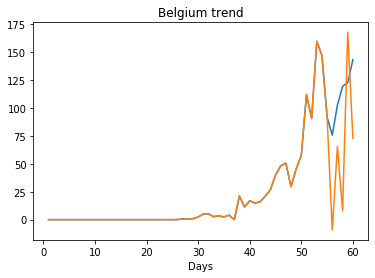

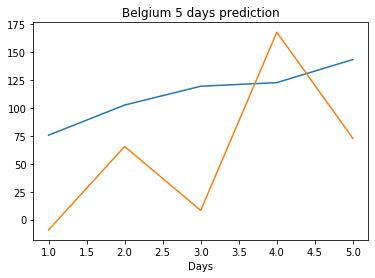

Creating directory ./offline6/Germany/training/
Germany
Saving the best model weights at Epoch [1], Best Valid Loss: 2082.7251


/space/home/nzhang/anaconda3/envs/neuralnet/lib/python3.7/site-packages/torch/nn/modules/loss.py:431: UserWarning: Using a target size (torch.Size([1, 1, 5])) that is different to the input size (torch.Size([5])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/space/home/nzhang/anaconda3/envs/neuralnet/lib/python3.7/site-packages/torch/nn/modules/loss.py:431: UserWarning: Using a target size (torch.Size([1, 5])) that is different to the input size (torch.Size([5])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Saving the best model weights at Epoch [10], Best Valid Loss: 1745.3969
Saving the best model weights at Epoch [28], Best Valid Loss: 1732.5736
train error: 555.6350416125673
1732.5736083984375
Saving the best model weights at Epoch [1], Best Valid Loss: 2816.8230
Saving the best model weights at Epoch [4], Best Valid Loss: 2663.0618
Saving the best model weights at Epoch [9], Best Valid Loss: 2052.5122
Saving the best model weights at Epoch [10], Best Valid Loss: 1547.6655
Saving the best model weights at Epoch [11], Best Valid Loss: 1316.8033
Saving the best model weights at Epoch [13], Best Valid Loss: 1222.7479
Saving the best model weights at Epoch [14], Best Valid Loss: 715.6970
train error: 588.154395681439
715.6969604492188
Saving the best model weights at Epoch [1], Best Valid Loss: 3141.3640
Saving the best model weights at Epoch [2], Best Valid Loss: 2213.8794
Saving the best model weights at Epoch [3], Best Valid Loss: 2142.6523
Saving the best model weights at Epoch [4], B

Saving the best model weights at Epoch [17], Best Valid Loss: 1612.7046
Saving the best model weights at Epoch [23], Best Valid Loss: 1362.8605
Saving the best model weights at Epoch [30], Best Valid Loss: 1145.3171
Saving the best model weights at Epoch [45], Best Valid Loss: 863.5258
train error: 711.4617676012443
863.5258178710938
Saving the best model weights at Epoch [1], Best Valid Loss: 3357.4861
Saving the best model weights at Epoch [3], Best Valid Loss: 1830.7852
Saving the best model weights at Epoch [17], Best Valid Loss: 1795.7955
Saving the best model weights at Epoch [21], Best Valid Loss: 1646.6625
Saving the best model weights at Epoch [27], Best Valid Loss: 1547.8999
Saving the best model weights at Epoch [29], Best Valid Loss: 845.0854
train error: 412.319523637945
845.0853881835938
Saving the best model weights at Epoch [1], Best Valid Loss: 5137.6279
Saving the best model weights at Epoch [2], Best Valid Loss: 4490.3687
Saving the best model weights at Epoch [4], B

Saving the best model weights at Epoch [12], Best Valid Loss: 2945.6875
Saving the best model weights at Epoch [14], Best Valid Loss: 2835.6260
Saving the best model weights at Epoch [21], Best Valid Loss: 2791.9934
Saving the best model weights at Epoch [29], Best Valid Loss: 2067.0957
train error: 547.5849925532485
2067.095703125
Saving the best model weights at Epoch [1], Best Valid Loss: 3613.4141
Saving the best model weights at Epoch [2], Best Valid Loss: 3600.3872
Saving the best model weights at Epoch [3], Best Valid Loss: 3361.4783
Saving the best model weights at Epoch [5], Best Valid Loss: 2849.5911
Saving the best model weights at Epoch [7], Best Valid Loss: 2714.4138
Saving the best model weights at Epoch [9], Best Valid Loss: 2627.5005
Saving the best model weights at Epoch [13], Best Valid Loss: 2573.4470
Saving the best model weights at Epoch [33], Best Valid Loss: 2521.5830
train error: 569.7036345510771
2521.5830078125
Saving the best model weights at Epoch [1], Best 

train error: 713.5571759830822
719.0
Saving the best model weights at Epoch [1], Best Valid Loss: 4372.9839
Saving the best model weights at Epoch [2], Best Valid Loss: 4234.5093
Saving the best model weights at Epoch [3], Best Valid Loss: 4041.2915
Saving the best model weights at Epoch [4], Best Valid Loss: 3802.6335
Saving the best model weights at Epoch [7], Best Valid Loss: 3017.7087
Saving the best model weights at Epoch [11], Best Valid Loss: 2999.5652
Saving the best model weights at Epoch [14], Best Valid Loss: 2850.8696
Saving the best model weights at Epoch [15], Best Valid Loss: 2494.4973
Saving the best model weights at Epoch [16], Best Valid Loss: 2209.4062
Saving the best model weights at Epoch [17], Best Valid Loss: 2161.9802
Saving the best model weights at Epoch [40], Best Valid Loss: 2130.6914
Saving the best model weights at Epoch [44], Best Valid Loss: 2126.9790
Saving the best model weights at Epoch [45], Best Valid Loss: 2025.4961
Saving the best model weights at

Saving the best model weights at Epoch [11], Best Valid Loss: 1279.6302
Saving the best model weights at Epoch [14], Best Valid Loss: 1079.7605
Saving the best model weights at Epoch [16], Best Valid Loss: 720.7884
Saving the best model weights at Epoch [17], Best Valid Loss: 591.9306
Saving the best model weights at Epoch [25], Best Valid Loss: 555.2733
Saving the best model weights at Epoch [29], Best Valid Loss: 543.2156
Saving the best model weights at Epoch [36], Best Valid Loss: 529.4528
Saving the best model weights at Epoch [37], Best Valid Loss: 510.3759
train error: 235.3866973356767
510.3759460449219
Saving the best model weights at Epoch [1], Best Valid Loss: 3791.2805
Saving the best model weights at Epoch [2], Best Valid Loss: 2695.4832
Saving the best model weights at Epoch [3], Best Valid Loss: 2597.9211
Saving the best model weights at Epoch [4], Best Valid Loss: 2283.3215
Saving the best model weights at Epoch [6], Best Valid Loss: 2145.6775
Saving the best model weig

Saving the best model weights at Epoch [3], Best Valid Loss: 1910.1119
Saving the best model weights at Epoch [6], Best Valid Loss: 1808.6156
Saving the best model weights at Epoch [13], Best Valid Loss: 1408.4856
Saving the best model weights at Epoch [15], Best Valid Loss: 1051.2167
Saving the best model weights at Epoch [28], Best Valid Loss: 825.5799
Saving the best model weights at Epoch [29], Best Valid Loss: 554.1987
Saving the best model weights at Epoch [32], Best Valid Loss: 530.1463
Saving the best model weights at Epoch [34], Best Valid Loss: 526.2384
Saving the best model weights at Epoch [37], Best Valid Loss: 522.7723
Saving the best model weights at Epoch [38], Best Valid Loss: 512.5123
Saving the best model weights at Epoch [39], Best Valid Loss: 498.5963
Saving the best model weights at Epoch [42], Best Valid Loss: 486.4402
train error: 163.8925608513933
486.44024658203125
Saving the best model weights at Epoch [1], Best Valid Loss: 3984.6609
Saving the best model wei

Saving the best model weights at Epoch [25], Best Valid Loss: 2290.2939
Saving the best model weights at Epoch [50], Best Valid Loss: 1908.7727
train error: 546.0017400221391
1908.772705078125
Saving the best model weights at Epoch [1], Best Valid Loss: 4535.4033
Saving the best model weights at Epoch [2], Best Valid Loss: 3462.8840
Saving the best model weights at Epoch [4], Best Valid Loss: 2117.8157
Saving the best model weights at Epoch [11], Best Valid Loss: 1959.0289
Saving the best model weights at Epoch [12], Best Valid Loss: 1443.0769
Saving the best model weights at Epoch [15], Best Valid Loss: 1189.9600
Saving the best model weights at Epoch [43], Best Valid Loss: 1160.6482
Saving the best model weights at Epoch [49], Best Valid Loss: 1026.2731
Saving the best model weights at Epoch [50], Best Valid Loss: 892.7432
train error: 256.32058052583176
892.7431640625
Saving the best model weights at Epoch [1], Best Valid Loss: 2271.5605
Saving the best model weights at Epoch [6], B

Saving the best model weights at Epoch [2], Best Valid Loss: 3647.0496
Saving the best model weights at Epoch [3], Best Valid Loss: 3527.7117
Saving the best model weights at Epoch [5], Best Valid Loss: 2894.5857
Saving the best model weights at Epoch [6], Best Valid Loss: 2110.7302
Saving the best model weights at Epoch [7], Best Valid Loss: 1593.1200
Saving the best model weights at Epoch [34], Best Valid Loss: 1562.5027
Saving the best model weights at Epoch [35], Best Valid Loss: 1472.2158
Saving the best model weights at Epoch [50], Best Valid Loss: 1039.9696
train error: 426.17598617438114
1039.9696044921875
Saving the best model weights at Epoch [1], Best Valid Loss: 4108.3848
Saving the best model weights at Epoch [2], Best Valid Loss: 3373.2883
Saving the best model weights at Epoch [3], Best Valid Loss: 2851.5073
Saving the best model weights at Epoch [4], Best Valid Loss: 1715.3873
Saving the best model weights at Epoch [10], Best Valid Loss: 1639.9388
train error: 425.34229

Saving the best model weights at Epoch [20], Best Valid Loss: 3281.5916
Saving the best model weights at Epoch [21], Best Valid Loss: 3209.7466
Saving the best model weights at Epoch [22], Best Valid Loss: 3141.7351
Saving the best model weights at Epoch [23], Best Valid Loss: 3059.9551
Saving the best model weights at Epoch [24], Best Valid Loss: 2989.6992
Saving the best model weights at Epoch [25], Best Valid Loss: 2921.0681
Saving the best model weights at Epoch [26], Best Valid Loss: 2855.6921
Saving the best model weights at Epoch [27], Best Valid Loss: 2793.0234
Saving the best model weights at Epoch [28], Best Valid Loss: 2732.3779
Saving the best model weights at Epoch [29], Best Valid Loss: 2675.5476
Saving the best model weights at Epoch [30], Best Valid Loss: 2618.4141
Saving the best model weights at Epoch [31], Best Valid Loss: 2565.4148
Saving the best model weights at Epoch [32], Best Valid Loss: 2513.1711
Saving the best model weights at Epoch [33], Best Valid Loss: 24

Saving the best model weights at Epoch [16], Best Valid Loss: 2180.1238
Saving the best model weights at Epoch [22], Best Valid Loss: 1885.0205
Saving the best model weights at Epoch [25], Best Valid Loss: 1822.2141
Saving the best model weights at Epoch [26], Best Valid Loss: 1690.8168
Saving the best model weights at Epoch [27], Best Valid Loss: 1559.3981
Saving the best model weights at Epoch [33], Best Valid Loss: 1485.2421
Saving the best model weights at Epoch [34], Best Valid Loss: 1376.4603
Saving the best model weights at Epoch [35], Best Valid Loss: 1263.8779
train error: 210.993440307451
1263.8779296875
Saving the best model weights at Epoch [1], Best Valid Loss: 4810.8062
Saving the best model weights at Epoch [2], Best Valid Loss: 4364.5522
Saving the best model weights at Epoch [3], Best Valid Loss: 3869.9966
Saving the best model weights at Epoch [4], Best Valid Loss: 3447.9480
Saving the best model weights at Epoch [5], Best Valid Loss: 3093.6699
Saving the best model w

Saving the best model weights at Epoch [21], Best Valid Loss: 3305.1648
Saving the best model weights at Epoch [22], Best Valid Loss: 3204.1970
Saving the best model weights at Epoch [23], Best Valid Loss: 3108.9639
Saving the best model weights at Epoch [24], Best Valid Loss: 3017.8965
Saving the best model weights at Epoch [25], Best Valid Loss: 2932.2078
Saving the best model weights at Epoch [26], Best Valid Loss: 2852.2336
Saving the best model weights at Epoch [27], Best Valid Loss: 2780.4316
Saving the best model weights at Epoch [28], Best Valid Loss: 2703.8025
Saving the best model weights at Epoch [29], Best Valid Loss: 2634.9001
Saving the best model weights at Epoch [30], Best Valid Loss: 2568.6836
Saving the best model weights at Epoch [31], Best Valid Loss: 2520.3052
Saving the best model weights at Epoch [33], Best Valid Loss: 2429.8450
Saving the best model weights at Epoch [34], Best Valid Loss: 2427.7363
Saving the best model weights at Epoch [37], Best Valid Loss: 24

Saving the best model weights at Epoch [21], Best Valid Loss: 1632.5026
Saving the best model weights at Epoch [27], Best Valid Loss: 1513.0029
Saving the best model weights at Epoch [30], Best Valid Loss: 1442.3889
Saving the best model weights at Epoch [31], Best Valid Loss: 1377.2422
Saving the best model weights at Epoch [34], Best Valid Loss: 1258.4873
Saving the best model weights at Epoch [36], Best Valid Loss: 1138.7786
Saving the best model weights at Epoch [38], Best Valid Loss: 1106.6143
Saving the best model weights at Epoch [41], Best Valid Loss: 1071.7235
Saving the best model weights at Epoch [43], Best Valid Loss: 986.0350
Saving the best model weights at Epoch [47], Best Valid Loss: 924.0101
train error: 187.59429769895294
924.0100708007812
Saving the best model weights at Epoch [1], Best Valid Loss: 4727.8594
Saving the best model weights at Epoch [2], Best Valid Loss: 3440.6523
Saving the best model weights at Epoch [3], Best Valid Loss: 2033.2461
Saving the best mod

Saving the best model weights at Epoch [11], Best Valid Loss: 4745.2651
Saving the best model weights at Epoch [12], Best Valid Loss: 4704.6250
Saving the best model weights at Epoch [13], Best Valid Loss: 4661.9360
Saving the best model weights at Epoch [14], Best Valid Loss: 4616.4194
Saving the best model weights at Epoch [15], Best Valid Loss: 4567.0601
Saving the best model weights at Epoch [16], Best Valid Loss: 4513.7749
Saving the best model weights at Epoch [17], Best Valid Loss: 4456.6533
Saving the best model weights at Epoch [18], Best Valid Loss: 4393.2197
Saving the best model weights at Epoch [19], Best Valid Loss: 4326.9517
Saving the best model weights at Epoch [20], Best Valid Loss: 4255.8101
Saving the best model weights at Epoch [21], Best Valid Loss: 4182.2803
Saving the best model weights at Epoch [22], Best Valid Loss: 4106.8994
Saving the best model weights at Epoch [23], Best Valid Loss: 4030.6438
Saving the best model weights at Epoch [24], Best Valid Loss: 39

Saving the best model weights at Epoch [34], Best Valid Loss: 1838.9996
train error: 470.53182715358156
1838.9996337890625
Saving the best model weights at Epoch [1], Best Valid Loss: 5072.9409
Saving the best model weights at Epoch [2], Best Valid Loss: 5002.0615
Saving the best model weights at Epoch [3], Best Valid Loss: 4931.5088
Saving the best model weights at Epoch [4], Best Valid Loss: 4856.3887
Saving the best model weights at Epoch [5], Best Valid Loss: 4776.0410
Saving the best model weights at Epoch [6], Best Valid Loss: 4668.4414
Saving the best model weights at Epoch [7], Best Valid Loss: 4533.4072
Saving the best model weights at Epoch [8], Best Valid Loss: 4352.8086
Saving the best model weights at Epoch [9], Best Valid Loss: 4097.8989
Saving the best model weights at Epoch [10], Best Valid Loss: 3761.9336
Saving the best model weights at Epoch [11], Best Valid Loss: 3398.3621
Saving the best model weights at Epoch [12], Best Valid Loss: 3146.1521
Saving the best model 

Saving the best model weights at Epoch [46], Best Valid Loss: 1066.1743
Saving the best model weights at Epoch [47], Best Valid Loss: 1064.6561
Saving the best model weights at Epoch [48], Best Valid Loss: 937.2096
Saving the best model weights at Epoch [49], Best Valid Loss: 900.5353
train error: 303.1491358388554
900.5353393554688
Saving the best model weights at Epoch [1], Best Valid Loss: 5071.9175
Saving the best model weights at Epoch [2], Best Valid Loss: 5003.4946
Saving the best model weights at Epoch [3], Best Valid Loss: 4918.0469
Saving the best model weights at Epoch [4], Best Valid Loss: 4820.9111
Saving the best model weights at Epoch [5], Best Valid Loss: 4661.0894
Saving the best model weights at Epoch [6], Best Valid Loss: 4379.5942
Saving the best model weights at Epoch [7], Best Valid Loss: 3747.0781
Saving the best model weights at Epoch [8], Best Valid Loss: 2797.4246
Saving the best model weights at Epoch [9], Best Valid Loss: 2183.6453
Saving the best model weig

Saving the best model weights at Epoch [33], Best Valid Loss: 3023.2271
Saving the best model weights at Epoch [34], Best Valid Loss: 3014.7759
Saving the best model weights at Epoch [35], Best Valid Loss: 3011.5554
Saving the best model weights at Epoch [36], Best Valid Loss: 3005.9749
Saving the best model weights at Epoch [39], Best Valid Loss: 2999.2029
Saving the best model weights at Epoch [40], Best Valid Loss: 2990.4460
Saving the best model weights at Epoch [41], Best Valid Loss: 2984.4243
Saving the best model weights at Epoch [43], Best Valid Loss: 2983.4617
Saving the best model weights at Epoch [44], Best Valid Loss: 2960.7673
Saving the best model weights at Epoch [45], Best Valid Loss: 2960.5935
Saving the best model weights at Epoch [46], Best Valid Loss: 2838.4766
Saving the best model weights at Epoch [47], Best Valid Loss: 2744.7537
Saving the best model weights at Epoch [48], Best Valid Loss: 2708.2493
Saving the best model weights at Epoch [49], Best Valid Loss: 26

Saving the best model weights at Epoch [6], Best Valid Loss: 4901.4434
Saving the best model weights at Epoch [7], Best Valid Loss: 4853.6455
Saving the best model weights at Epoch [8], Best Valid Loss: 4801.3940
Saving the best model weights at Epoch [9], Best Valid Loss: 4744.0620
Saving the best model weights at Epoch [10], Best Valid Loss: 4679.3276
Saving the best model weights at Epoch [11], Best Valid Loss: 4608.4766
Saving the best model weights at Epoch [12], Best Valid Loss: 4530.4604
Saving the best model weights at Epoch [13], Best Valid Loss: 4441.1274
Saving the best model weights at Epoch [14], Best Valid Loss: 4346.2578
Saving the best model weights at Epoch [15], Best Valid Loss: 4242.4902
Saving the best model weights at Epoch [16], Best Valid Loss: 4131.6860
Saving the best model weights at Epoch [17], Best Valid Loss: 4015.2422
Saving the best model weights at Epoch [18], Best Valid Loss: 3894.0376
Saving the best model weights at Epoch [19], Best Valid Loss: 3776.9

Saving the best model weights at Epoch [17], Best Valid Loss: 1524.8623
Saving the best model weights at Epoch [19], Best Valid Loss: 1379.3635
Saving the best model weights at Epoch [21], Best Valid Loss: 1224.7303
Saving the best model weights at Epoch [35], Best Valid Loss: 1222.9252
train error: 409.6802328432148
1222.9251708984375
Saving the best model weights at Epoch [1], Best Valid Loss: 4865.7339
Saving the best model weights at Epoch [2], Best Valid Loss: 4385.7485
Saving the best model weights at Epoch [3], Best Valid Loss: 3453.2063
Saving the best model weights at Epoch [4], Best Valid Loss: 2251.7107
Saving the best model weights at Epoch [7], Best Valid Loss: 1670.0326
Saving the best model weights at Epoch [9], Best Valid Loss: 1198.8906
Saving the best model weights at Epoch [43], Best Valid Loss: 1108.2024
train error: 453.2927476131555
1108.202392578125
Saving the best model weights at Epoch [1], Best Valid Loss: 5083.1221
Saving the best model weights at Epoch [2], 

Saving the best model weights at Epoch [31], Best Valid Loss: 2894.3274
Saving the best model weights at Epoch [38], Best Valid Loss: 2889.2717
train error: 535.6886317802198
2889.271728515625
Saving the best model weights at Epoch [1], Best Valid Loss: 5107.1206
Saving the best model weights at Epoch [2], Best Valid Loss: 5067.9204
Saving the best model weights at Epoch [3], Best Valid Loss: 5029.4819
Saving the best model weights at Epoch [4], Best Valid Loss: 4989.5762
Saving the best model weights at Epoch [5], Best Valid Loss: 4949.6235
Saving the best model weights at Epoch [6], Best Valid Loss: 4907.4839
Saving the best model weights at Epoch [7], Best Valid Loss: 4863.7002
Saving the best model weights at Epoch [8], Best Valid Loss: 4816.9082
Saving the best model weights at Epoch [9], Best Valid Loss: 4766.5820
Saving the best model weights at Epoch [10], Best Valid Loss: 4712.1548
Saving the best model weights at Epoch [11], Best Valid Loss: 4651.5332
Saving the best model we

Saving the best model weights at Epoch [26], Best Valid Loss: 3211.5671
Saving the best model weights at Epoch [27], Best Valid Loss: 3168.4387
Saving the best model weights at Epoch [28], Best Valid Loss: 3130.0759
Saving the best model weights at Epoch [29], Best Valid Loss: 3102.8770
Saving the best model weights at Epoch [30], Best Valid Loss: 3077.0632
Saving the best model weights at Epoch [31], Best Valid Loss: 3061.1660
Saving the best model weights at Epoch [32], Best Valid Loss: 3034.2869
Saving the best model weights at Epoch [33], Best Valid Loss: 3022.0562
Saving the best model weights at Epoch [34], Best Valid Loss: 3006.7849
Saving the best model weights at Epoch [38], Best Valid Loss: 3001.4675
Saving the best model weights at Epoch [39], Best Valid Loss: 3001.4021
Saving the best model weights at Epoch [40], Best Valid Loss: 2997.9448
Saving the best model weights at Epoch [45], Best Valid Loss: 2989.6084
Saving the best model weights at Epoch [47], Best Valid Loss: 29

Saving the best model weights at Epoch [11], Best Valid Loss: 3591.8105
Saving the best model weights at Epoch [12], Best Valid Loss: 3379.6860
Saving the best model weights at Epoch [13], Best Valid Loss: 3263.7283
Saving the best model weights at Epoch [14], Best Valid Loss: 3149.4285
Saving the best model weights at Epoch [15], Best Valid Loss: 3095.2234
Saving the best model weights at Epoch [16], Best Valid Loss: 3049.0261
Saving the best model weights at Epoch [17], Best Valid Loss: 3000.6433
Saving the best model weights at Epoch [18], Best Valid Loss: 2979.3501
Saving the best model weights at Epoch [19], Best Valid Loss: 2970.5002
Saving the best model weights at Epoch [20], Best Valid Loss: 2953.6118
Saving the best model weights at Epoch [21], Best Valid Loss: 2915.1189
Saving the best model weights at Epoch [22], Best Valid Loss: 2706.8545
Saving the best model weights at Epoch [23], Best Valid Loss: 2315.6960
Saving the best model weights at Epoch [24], Best Valid Loss: 18

Saving the best model weights at Epoch [43], Best Valid Loss: 4403.6206
Saving the best model weights at Epoch [44], Best Valid Loss: 4388.0679
Saving the best model weights at Epoch [45], Best Valid Loss: 4371.1948
Saving the best model weights at Epoch [46], Best Valid Loss: 4356.1211
Saving the best model weights at Epoch [47], Best Valid Loss: 4339.8081
Saving the best model weights at Epoch [48], Best Valid Loss: 4324.1772
Saving the best model weights at Epoch [49], Best Valid Loss: 4308.9556
Saving the best model weights at Epoch [50], Best Valid Loss: 4293.5415
train error: 654.1834435481014
4293.54150390625
Saving the best model weights at Epoch [1], Best Valid Loss: 5077.5830
Saving the best model weights at Epoch [2], Best Valid Loss: 4987.7881
Saving the best model weights at Epoch [3], Best Valid Loss: 4920.1675
Saving the best model weights at Epoch [4], Best Valid Loss: 4832.6289
Saving the best model weights at Epoch [5], Best Valid Loss: 4733.6602
Saving the best model

Saving the best model weights at Epoch [10], Best Valid Loss: 4716.7651
Saving the best model weights at Epoch [11], Best Valid Loss: 4673.0112
Saving the best model weights at Epoch [12], Best Valid Loss: 4626.6440
Saving the best model weights at Epoch [13], Best Valid Loss: 4582.5884
Saving the best model weights at Epoch [14], Best Valid Loss: 4539.4844
Saving the best model weights at Epoch [15], Best Valid Loss: 4494.9785
Saving the best model weights at Epoch [16], Best Valid Loss: 4455.6143
Saving the best model weights at Epoch [17], Best Valid Loss: 4409.5327
Saving the best model weights at Epoch [18], Best Valid Loss: 4355.7773
Saving the best model weights at Epoch [19], Best Valid Loss: 4308.5298
Saving the best model weights at Epoch [20], Best Valid Loss: 4259.0015
Saving the best model weights at Epoch [21], Best Valid Loss: 4210.3823
Saving the best model weights at Epoch [22], Best Valid Loss: 4162.4736
Saving the best model weights at Epoch [23], Best Valid Loss: 41

Saving the best model weights at Epoch [33], Best Valid Loss: 3502.1626
Saving the best model weights at Epoch [34], Best Valid Loss: 3463.0125
Saving the best model weights at Epoch [35], Best Valid Loss: 3424.5955
Saving the best model weights at Epoch [36], Best Valid Loss: 3387.0122
Saving the best model weights at Epoch [37], Best Valid Loss: 3350.1145
Saving the best model weights at Epoch [38], Best Valid Loss: 3314.3503
Saving the best model weights at Epoch [39], Best Valid Loss: 3279.0688
Saving the best model weights at Epoch [40], Best Valid Loss: 3243.8027
Saving the best model weights at Epoch [41], Best Valid Loss: 3209.6660
Saving the best model weights at Epoch [42], Best Valid Loss: 3175.9629
Saving the best model weights at Epoch [43], Best Valid Loss: 3141.8359
Saving the best model weights at Epoch [44], Best Valid Loss: 3108.9512
Saving the best model weights at Epoch [45], Best Valid Loss: 3076.2700
Saving the best model weights at Epoch [46], Best Valid Loss: 30

Saving the best model weights at Epoch [16], Best Valid Loss: 3935.0063
Saving the best model weights at Epoch [17], Best Valid Loss: 3860.4861
Saving the best model weights at Epoch [18], Best Valid Loss: 3787.6790
Saving the best model weights at Epoch [19], Best Valid Loss: 3715.0964
Saving the best model weights at Epoch [20], Best Valid Loss: 3641.3782
Saving the best model weights at Epoch [21], Best Valid Loss: 3570.3848
Saving the best model weights at Epoch [22], Best Valid Loss: 3502.8865
Saving the best model weights at Epoch [23], Best Valid Loss: 3437.3787
Saving the best model weights at Epoch [24], Best Valid Loss: 3373.0352
Saving the best model weights at Epoch [25], Best Valid Loss: 3309.6687
Saving the best model weights at Epoch [26], Best Valid Loss: 3247.0298
Saving the best model weights at Epoch [27], Best Valid Loss: 3186.0759
Saving the best model weights at Epoch [28], Best Valid Loss: 3127.6125
Saving the best model weights at Epoch [29], Best Valid Loss: 30

Saving the best model weights at Epoch [6], Best Valid Loss: 5125.5947
Saving the best model weights at Epoch [7], Best Valid Loss: 5121.6758
Saving the best model weights at Epoch [8], Best Valid Loss: 5117.7417
Saving the best model weights at Epoch [9], Best Valid Loss: 5113.8306
Saving the best model weights at Epoch [10], Best Valid Loss: 5109.9541
Saving the best model weights at Epoch [11], Best Valid Loss: 5106.0337
Saving the best model weights at Epoch [12], Best Valid Loss: 5102.1616
Saving the best model weights at Epoch [13], Best Valid Loss: 5098.2954
Saving the best model weights at Epoch [14], Best Valid Loss: 5094.4106
Saving the best model weights at Epoch [15], Best Valid Loss: 5090.4878
Saving the best model weights at Epoch [16], Best Valid Loss: 5086.6323
Saving the best model weights at Epoch [17], Best Valid Loss: 5082.7163
Saving the best model weights at Epoch [18], Best Valid Loss: 5078.8066
Saving the best model weights at Epoch [19], Best Valid Loss: 5074.8

Saving the best model weights at Epoch [20], Best Valid Loss: 3872.2949
Saving the best model weights at Epoch [21], Best Valid Loss: 3785.6619
Saving the best model weights at Epoch [22], Best Valid Loss: 3695.8523
Saving the best model weights at Epoch [23], Best Valid Loss: 3593.4490
Saving the best model weights at Epoch [24], Best Valid Loss: 3508.2134
Saving the best model weights at Epoch [25], Best Valid Loss: 3409.8313
Saving the best model weights at Epoch [26], Best Valid Loss: 3310.8196
Saving the best model weights at Epoch [27], Best Valid Loss: 3221.5142
Saving the best model weights at Epoch [28], Best Valid Loss: 3141.4348
Saving the best model weights at Epoch [29], Best Valid Loss: 3054.9504
Saving the best model weights at Epoch [30], Best Valid Loss: 2980.5403
Saving the best model weights at Epoch [31], Best Valid Loss: 2895.3945
Saving the best model weights at Epoch [32], Best Valid Loss: 2838.5383
Saving the best model weights at Epoch [34], Best Valid Loss: 27

Saving the best model weights at Epoch [41], Best Valid Loss: 4490.2798
Saving the best model weights at Epoch [42], Best Valid Loss: 4452.6226
Saving the best model weights at Epoch [43], Best Valid Loss: 4411.5078
Saving the best model weights at Epoch [44], Best Valid Loss: 4371.6211
Saving the best model weights at Epoch [45], Best Valid Loss: 4328.2046
Saving the best model weights at Epoch [46], Best Valid Loss: 4284.9858
Saving the best model weights at Epoch [47], Best Valid Loss: 4238.8154
Saving the best model weights at Epoch [48], Best Valid Loss: 4193.4741
Saving the best model weights at Epoch [49], Best Valid Loss: 4147.6533
Saving the best model weights at Epoch [50], Best Valid Loss: 4100.1270
train error: 618.5969056938634
4100.126953125
Saving the best model weights at Epoch [1], Best Valid Loss: 5112.9058
Saving the best model weights at Epoch [2], Best Valid Loss: 5068.2300
Saving the best model weights at Epoch [3], Best Valid Loss: 5023.8374
Saving the best model

Saving the best model weights at Epoch [24], Best Valid Loss: 4724.4331
Saving the best model weights at Epoch [25], Best Valid Loss: 4683.0972
Saving the best model weights at Epoch [26], Best Valid Loss: 4641.4907
Saving the best model weights at Epoch [27], Best Valid Loss: 4593.9507
Saving the best model weights at Epoch [28], Best Valid Loss: 4546.1704
Saving the best model weights at Epoch [29], Best Valid Loss: 4497.5454
Saving the best model weights at Epoch [30], Best Valid Loss: 4443.5571
Saving the best model weights at Epoch [31], Best Valid Loss: 4385.0234
Saving the best model weights at Epoch [32], Best Valid Loss: 4325.8623
Saving the best model weights at Epoch [33], Best Valid Loss: 4268.2852
Saving the best model weights at Epoch [34], Best Valid Loss: 4202.7354
Saving the best model weights at Epoch [35], Best Valid Loss: 4137.5142
Saving the best model weights at Epoch [36], Best Valid Loss: 4074.9673
Saving the best model weights at Epoch [37], Best Valid Loss: 40

Saving the best model weights at Epoch [10], Best Valid Loss: 5018.2988
Saving the best model weights at Epoch [11], Best Valid Loss: 4998.0059
Saving the best model weights at Epoch [12], Best Valid Loss: 4975.0347
Saving the best model weights at Epoch [13], Best Valid Loss: 4950.2041
Saving the best model weights at Epoch [14], Best Valid Loss: 4921.6406
Saving the best model weights at Epoch [15], Best Valid Loss: 4886.4365
Saving the best model weights at Epoch [16], Best Valid Loss: 4847.9570
Saving the best model weights at Epoch [17], Best Valid Loss: 4804.4458
Saving the best model weights at Epoch [18], Best Valid Loss: 4753.0483
Saving the best model weights at Epoch [19], Best Valid Loss: 4694.1963
Saving the best model weights at Epoch [20], Best Valid Loss: 4627.3198
Saving the best model weights at Epoch [21], Best Valid Loss: 4558.4390
Saving the best model weights at Epoch [22], Best Valid Loss: 4475.2720
Saving the best model weights at Epoch [23], Best Valid Loss: 43

Saving the best model weights at Epoch [2], Best Valid Loss: 5153.9243
Saving the best model weights at Epoch [3], Best Valid Loss: 5147.0747
Saving the best model weights at Epoch [4], Best Valid Loss: 5140.3643
Saving the best model weights at Epoch [5], Best Valid Loss: 5133.2661
Saving the best model weights at Epoch [6], Best Valid Loss: 5126.5156
Saving the best model weights at Epoch [7], Best Valid Loss: 5119.8765
Saving the best model weights at Epoch [8], Best Valid Loss: 5112.8379
Saving the best model weights at Epoch [9], Best Valid Loss: 5106.2051
Saving the best model weights at Epoch [10], Best Valid Loss: 5099.2319
Saving the best model weights at Epoch [11], Best Valid Loss: 5092.9116
Saving the best model weights at Epoch [12], Best Valid Loss: 5085.9004
Saving the best model weights at Epoch [13], Best Valid Loss: 5079.0054
Saving the best model weights at Epoch [14], Best Valid Loss: 5072.1733
Saving the best model weights at Epoch [15], Best Valid Loss: 5065.8115


Saving the best model weights at Epoch [16], Best Valid Loss: 5091.8237
Saving the best model weights at Epoch [17], Best Valid Loss: 5087.9224
Saving the best model weights at Epoch [18], Best Valid Loss: 5084.0308
Saving the best model weights at Epoch [19], Best Valid Loss: 5080.1328
Saving the best model weights at Epoch [20], Best Valid Loss: 5076.2485
Saving the best model weights at Epoch [21], Best Valid Loss: 5072.3550
Saving the best model weights at Epoch [22], Best Valid Loss: 5068.4116
Saving the best model weights at Epoch [23], Best Valid Loss: 5064.4824
Saving the best model weights at Epoch [24], Best Valid Loss: 5060.5596
Saving the best model weights at Epoch [25], Best Valid Loss: 5056.6460
Saving the best model weights at Epoch [26], Best Valid Loss: 5052.7314
Saving the best model weights at Epoch [27], Best Valid Loss: 5048.7690
Saving the best model weights at Epoch [28], Best Valid Loss: 5044.8247
Saving the best model weights at Epoch [29], Best Valid Loss: 50

Saving the best model weights at Epoch [30], Best Valid Loss: 2360.0601
Saving the best model weights at Epoch [31], Best Valid Loss: 2217.8027
Saving the best model weights at Epoch [32], Best Valid Loss: 2112.5339
Saving the best model weights at Epoch [33], Best Valid Loss: 2015.6123
Saving the best model weights at Epoch [34], Best Valid Loss: 1930.5858
Saving the best model weights at Epoch [35], Best Valid Loss: 1805.4111
Saving the best model weights at Epoch [36], Best Valid Loss: 1762.5941
Saving the best model weights at Epoch [46], Best Valid Loss: 1676.5699
Saving the best model weights at Epoch [50], Best Valid Loss: 1590.4287
train error: 251.47392167026797
1590.4287109375
Saving the best model weights at Epoch [1], Best Valid Loss: 5147.1172
Saving the best model weights at Epoch [2], Best Valid Loss: 5143.0923
Saving the best model weights at Epoch [3], Best Valid Loss: 5139.0205
Saving the best model weights at Epoch [4], Best Valid Loss: 5134.9971
Saving the best mode

Saving the best model weights at Epoch [6], Best Valid Loss: 4946.9917
Saving the best model weights at Epoch [7], Best Valid Loss: 4903.8906
Saving the best model weights at Epoch [8], Best Valid Loss: 4861.4663
Saving the best model weights at Epoch [9], Best Valid Loss: 4813.7886
Saving the best model weights at Epoch [10], Best Valid Loss: 4758.3647
Saving the best model weights at Epoch [11], Best Valid Loss: 4700.1948
Saving the best model weights at Epoch [12], Best Valid Loss: 4631.5347
Saving the best model weights at Epoch [13], Best Valid Loss: 4571.9814
Saving the best model weights at Epoch [14], Best Valid Loss: 4464.3218
Saving the best model weights at Epoch [15], Best Valid Loss: 4357.4385
Saving the best model weights at Epoch [16], Best Valid Loss: 4234.5391
Saving the best model weights at Epoch [17], Best Valid Loss: 4074.8638
Saving the best model weights at Epoch [18], Best Valid Loss: 3836.7556
Saving the best model weights at Epoch [19], Best Valid Loss: 3590.7

Saving the best model weights at Epoch [36], Best Valid Loss: 4861.8979
Saving the best model weights at Epoch [37], Best Valid Loss: 4850.8022
Saving the best model weights at Epoch [38], Best Valid Loss: 4840.3423
Saving the best model weights at Epoch [39], Best Valid Loss: 4828.0571
Saving the best model weights at Epoch [40], Best Valid Loss: 4816.5000
Saving the best model weights at Epoch [41], Best Valid Loss: 4803.5708
Saving the best model weights at Epoch [42], Best Valid Loss: 4790.9282
Saving the best model weights at Epoch [43], Best Valid Loss: 4777.6187
Saving the best model weights at Epoch [44], Best Valid Loss: 4763.8843
Saving the best model weights at Epoch [45], Best Valid Loss: 4748.3354
Saving the best model weights at Epoch [46], Best Valid Loss: 4732.0181
Saving the best model weights at Epoch [47], Best Valid Loss: 4715.0117
Saving the best model weights at Epoch [48], Best Valid Loss: 4698.7158
Saving the best model weights at Epoch [49], Best Valid Loss: 46

Saving the best model weights at Epoch [22], Best Valid Loss: 5022.4102
Saving the best model weights at Epoch [23], Best Valid Loss: 5015.3076
Saving the best model weights at Epoch [24], Best Valid Loss: 5008.4580
Saving the best model weights at Epoch [25], Best Valid Loss: 5001.4995
Saving the best model weights at Epoch [26], Best Valid Loss: 4994.7314
Saving the best model weights at Epoch [27], Best Valid Loss: 4988.0454
Saving the best model weights at Epoch [28], Best Valid Loss: 4980.5767
Saving the best model weights at Epoch [29], Best Valid Loss: 4973.7808
Saving the best model weights at Epoch [30], Best Valid Loss: 4966.8687
Saving the best model weights at Epoch [31], Best Valid Loss: 4959.9058
Saving the best model weights at Epoch [32], Best Valid Loss: 4952.4795
Saving the best model weights at Epoch [33], Best Valid Loss: 4945.3149
Saving the best model weights at Epoch [34], Best Valid Loss: 4938.3296
Saving the best model weights at Epoch [35], Best Valid Loss: 49

Saving the best model weights at Epoch [37], Best Valid Loss: 5010.3188
Saving the best model weights at Epoch [38], Best Valid Loss: 5006.1768
Saving the best model weights at Epoch [39], Best Valid Loss: 5002.0190
Saving the best model weights at Epoch [40], Best Valid Loss: 4997.8643
Saving the best model weights at Epoch [41], Best Valid Loss: 4993.6929
Saving the best model weights at Epoch [42], Best Valid Loss: 4989.5493
Saving the best model weights at Epoch [43], Best Valid Loss: 4985.3486
Saving the best model weights at Epoch [44], Best Valid Loss: 4981.0977
Saving the best model weights at Epoch [45], Best Valid Loss: 4976.8281
Saving the best model weights at Epoch [46], Best Valid Loss: 4972.5854
Saving the best model weights at Epoch [47], Best Valid Loss: 4968.2783
Saving the best model weights at Epoch [48], Best Valid Loss: 4963.9761
Saving the best model weights at Epoch [49], Best Valid Loss: 4959.6445
Saving the best model weights at Epoch [50], Best Valid Loss: 49

Saving the best model weights at Epoch [10], Best Valid Loss: 5111.8296
Saving the best model weights at Epoch [11], Best Valid Loss: 5107.9814
Saving the best model weights at Epoch [12], Best Valid Loss: 5104.0986
Saving the best model weights at Epoch [13], Best Valid Loss: 5100.2354
Saving the best model weights at Epoch [14], Best Valid Loss: 5096.3638
Saving the best model weights at Epoch [15], Best Valid Loss: 5092.5337
Saving the best model weights at Epoch [16], Best Valid Loss: 5088.6514
Saving the best model weights at Epoch [17], Best Valid Loss: 5084.8188
Saving the best model weights at Epoch [18], Best Valid Loss: 5080.9453
Saving the best model weights at Epoch [19], Best Valid Loss: 5077.1094
Saving the best model weights at Epoch [20], Best Valid Loss: 5073.2402
Saving the best model weights at Epoch [21], Best Valid Loss: 5069.3804
Saving the best model weights at Epoch [22], Best Valid Loss: 5065.5532
Saving the best model weights at Epoch [23], Best Valid Loss: 50

Saving the best model weights at Epoch [24], Best Valid Loss: 3526.6665
Saving the best model weights at Epoch [25], Best Valid Loss: 3441.5669
Saving the best model weights at Epoch [26], Best Valid Loss: 3304.6365
Saving the best model weights at Epoch [27], Best Valid Loss: 3239.4011
Saving the best model weights at Epoch [28], Best Valid Loss: 3067.7822
Saving the best model weights at Epoch [29], Best Valid Loss: 2912.5232
Saving the best model weights at Epoch [30], Best Valid Loss: 2772.1060
Saving the best model weights at Epoch [31], Best Valid Loss: 2620.2896
Saving the best model weights at Epoch [32], Best Valid Loss: 2410.9724
Saving the best model weights at Epoch [33], Best Valid Loss: 2232.3691
Saving the best model weights at Epoch [34], Best Valid Loss: 2068.7566
Saving the best model weights at Epoch [35], Best Valid Loss: 1919.5297
Saving the best model weights at Epoch [36], Best Valid Loss: 1797.6302
Saving the best model weights at Epoch [37], Best Valid Loss: 17

Saving the best model weights at Epoch [45], Best Valid Loss: 4802.0430
Saving the best model weights at Epoch [46], Best Valid Loss: 4791.3657
Saving the best model weights at Epoch [47], Best Valid Loss: 4781.5181
Saving the best model weights at Epoch [48], Best Valid Loss: 4770.9478
Saving the best model weights at Epoch [49], Best Valid Loss: 4760.9448
Saving the best model weights at Epoch [50], Best Valid Loss: 4750.0728
train error: 767.234550365896
4750.07275390625
Saving the best model weights at Epoch [1], Best Valid Loss: 5121.4604
Saving the best model weights at Epoch [2], Best Valid Loss: 5084.8667
Saving the best model weights at Epoch [3], Best Valid Loss: 5051.9155
Saving the best model weights at Epoch [4], Best Valid Loss: 5014.6572
Saving the best model weights at Epoch [5], Best Valid Loss: 4982.4609
Saving the best model weights at Epoch [6], Best Valid Loss: 4942.6763
Saving the best model weights at Epoch [7], Best Valid Loss: 4907.7153
Saving the best model we

Saving the best model weights at Epoch [21], Best Valid Loss: 4979.0479
Saving the best model weights at Epoch [22], Best Valid Loss: 4971.8354
Saving the best model weights at Epoch [23], Best Valid Loss: 4964.4805
Saving the best model weights at Epoch [24], Best Valid Loss: 4957.0029
Saving the best model weights at Epoch [25], Best Valid Loss: 4949.8901
Saving the best model weights at Epoch [26], Best Valid Loss: 4942.3374
Saving the best model weights at Epoch [27], Best Valid Loss: 4934.8789
Saving the best model weights at Epoch [28], Best Valid Loss: 4927.2578
Saving the best model weights at Epoch [29], Best Valid Loss: 4919.6680
Saving the best model weights at Epoch [30], Best Valid Loss: 4911.9888
Saving the best model weights at Epoch [31], Best Valid Loss: 4904.5288
Saving the best model weights at Epoch [32], Best Valid Loss: 4896.5107
Saving the best model weights at Epoch [33], Best Valid Loss: 4888.7451
Saving the best model weights at Epoch [34], Best Valid Loss: 48

Saving the best model weights at Epoch [35], Best Valid Loss: 5000.2700
Saving the best model weights at Epoch [36], Best Valid Loss: 4996.1548
Saving the best model weights at Epoch [37], Best Valid Loss: 4992.0156
Saving the best model weights at Epoch [38], Best Valid Loss: 4987.8867
Saving the best model weights at Epoch [39], Best Valid Loss: 4983.7222
Saving the best model weights at Epoch [40], Best Valid Loss: 4979.5352
Saving the best model weights at Epoch [41], Best Valid Loss: 4975.3550
Saving the best model weights at Epoch [42], Best Valid Loss: 4971.1050
Saving the best model weights at Epoch [43], Best Valid Loss: 4966.8799
Saving the best model weights at Epoch [44], Best Valid Loss: 4962.6011
Saving the best model weights at Epoch [45], Best Valid Loss: 4958.3213
Saving the best model weights at Epoch [46], Best Valid Loss: 4954.0767
Saving the best model weights at Epoch [47], Best Valid Loss: 4949.7090
Saving the best model weights at Epoch [48], Best Valid Loss: 49

Saving the best model weights at Epoch [8], Best Valid Loss: 5110.5698
Saving the best model weights at Epoch [9], Best Valid Loss: 5106.6079
Saving the best model weights at Epoch [10], Best Valid Loss: 5102.6772
Saving the best model weights at Epoch [11], Best Valid Loss: 5098.7764
Saving the best model weights at Epoch [12], Best Valid Loss: 5094.8203
Saving the best model weights at Epoch [13], Best Valid Loss: 5090.8960
Saving the best model weights at Epoch [14], Best Valid Loss: 5086.9648
Saving the best model weights at Epoch [15], Best Valid Loss: 5083.0405
Saving the best model weights at Epoch [16], Best Valid Loss: 5079.1084
Saving the best model weights at Epoch [17], Best Valid Loss: 5075.1914
Saving the best model weights at Epoch [18], Best Valid Loss: 5071.2461
Saving the best model weights at Epoch [19], Best Valid Loss: 5067.3169
Saving the best model weights at Epoch [20], Best Valid Loss: 5063.3833
Saving the best model weights at Epoch [21], Best Valid Loss: 5059

Saving the best model weights at Epoch [22], Best Valid Loss: 3727.9001
Saving the best model weights at Epoch [23], Best Valid Loss: 3620.6782
Saving the best model weights at Epoch [24], Best Valid Loss: 3545.8899
Saving the best model weights at Epoch [25], Best Valid Loss: 3479.2791
Saving the best model weights at Epoch [26], Best Valid Loss: 3407.3364
Saving the best model weights at Epoch [27], Best Valid Loss: 3340.9277
Saving the best model weights at Epoch [28], Best Valid Loss: 3253.0652
Saving the best model weights at Epoch [29], Best Valid Loss: 3209.2615
Saving the best model weights at Epoch [30], Best Valid Loss: 3165.6321
Saving the best model weights at Epoch [31], Best Valid Loss: 3136.5801
Saving the best model weights at Epoch [32], Best Valid Loss: 3130.8931
Saving the best model weights at Epoch [33], Best Valid Loss: 3076.8066
Saving the best model weights at Epoch [34], Best Valid Loss: 3062.3416
Saving the best model weights at Epoch [36], Best Valid Loss: 30

Saving the best model weights at Epoch [44], Best Valid Loss: 4796.3960
Saving the best model weights at Epoch [45], Best Valid Loss: 4786.0469
Saving the best model weights at Epoch [46], Best Valid Loss: 4775.5405
Saving the best model weights at Epoch [47], Best Valid Loss: 4763.8594
Saving the best model weights at Epoch [48], Best Valid Loss: 4752.9087
Saving the best model weights at Epoch [49], Best Valid Loss: 4740.9819
Saving the best model weights at Epoch [50], Best Valid Loss: 4728.9512
train error: 762.980282664299
4728.951171875
Saving the best model weights at Epoch [1], Best Valid Loss: 5119.1797
Saving the best model weights at Epoch [2], Best Valid Loss: 5084.2397
Saving the best model weights at Epoch [3], Best Valid Loss: 5050.6138
Saving the best model weights at Epoch [4], Best Valid Loss: 5014.6665
Saving the best model weights at Epoch [5], Best Valid Loss: 4984.0815
Saving the best model weights at Epoch [6], Best Valid Loss: 4942.3945
Saving the best model wei

Saving the best model weights at Epoch [17], Best Valid Loss: 5106.4316
Saving the best model weights at Epoch [18], Best Valid Loss: 5104.7544
Saving the best model weights at Epoch [19], Best Valid Loss: 5102.9688
Saving the best model weights at Epoch [20], Best Valid Loss: 5101.1509
Saving the best model weights at Epoch [21], Best Valid Loss: 5099.3530
Saving the best model weights at Epoch [22], Best Valid Loss: 5097.5938
Saving the best model weights at Epoch [23], Best Valid Loss: 5095.6167
Saving the best model weights at Epoch [24], Best Valid Loss: 5093.8608
Saving the best model weights at Epoch [25], Best Valid Loss: 5091.9453
Saving the best model weights at Epoch [26], Best Valid Loss: 5090.0605
Saving the best model weights at Epoch [27], Best Valid Loss: 5088.1968
Saving the best model weights at Epoch [28], Best Valid Loss: 5086.3975
Saving the best model weights at Epoch [29], Best Valid Loss: 5084.5000
Saving the best model weights at Epoch [30], Best Valid Loss: 50

Saving the best model weights at Epoch [31], Best Valid Loss: 5109.1812
Saving the best model weights at Epoch [32], Best Valid Loss: 5107.4570
Saving the best model weights at Epoch [33], Best Valid Loss: 5105.7842
Saving the best model weights at Epoch [34], Best Valid Loss: 5104.1890
Saving the best model weights at Epoch [35], Best Valid Loss: 5102.6484
Saving the best model weights at Epoch [36], Best Valid Loss: 5101.1128
Saving the best model weights at Epoch [37], Best Valid Loss: 5099.5830
Saving the best model weights at Epoch [38], Best Valid Loss: 5098.0581
Saving the best model weights at Epoch [39], Best Valid Loss: 5096.5181
Saving the best model weights at Epoch [40], Best Valid Loss: 5094.9771
Saving the best model weights at Epoch [41], Best Valid Loss: 5093.3804
Saving the best model weights at Epoch [42], Best Valid Loss: 5091.7769
Saving the best model weights at Epoch [43], Best Valid Loss: 5090.1313
Saving the best model weights at Epoch [44], Best Valid Loss: 50

Saving the best model weights at Epoch [46], Best Valid Loss: 4130.5283
Saving the best model weights at Epoch [47], Best Valid Loss: 4105.2456
Saving the best model weights at Epoch [48], Best Valid Loss: 4084.1609
Saving the best model weights at Epoch [49], Best Valid Loss: 4061.9075
Saving the best model weights at Epoch [50], Best Valid Loss: 4039.8462
train error: 597.1165394322438
4039.84619140625
Saving the best model weights at Epoch [1], Best Valid Loss: 5150.0142
Saving the best model weights at Epoch [2], Best Valid Loss: 5146.2554
Saving the best model weights at Epoch [3], Best Valid Loss: 5142.4058
Saving the best model weights at Epoch [4], Best Valid Loss: 5137.7783
Saving the best model weights at Epoch [5], Best Valid Loss: 5132.4126
Saving the best model weights at Epoch [6], Best Valid Loss: 5127.1167
Saving the best model weights at Epoch [7], Best Valid Loss: 5123.0737
Saving the best model weights at Epoch [8], Best Valid Loss: 5119.6455
Saving the best model we

Saving the best model weights at Epoch [10], Best Valid Loss: 4918.2412
Saving the best model weights at Epoch [11], Best Valid Loss: 4886.5908
Saving the best model weights at Epoch [12], Best Valid Loss: 4855.9058
Saving the best model weights at Epoch [13], Best Valid Loss: 4819.9453
Saving the best model weights at Epoch [14], Best Valid Loss: 4785.0405
Saving the best model weights at Epoch [15], Best Valid Loss: 4751.2773
Saving the best model weights at Epoch [16], Best Valid Loss: 4721.8774
Saving the best model weights at Epoch [17], Best Valid Loss: 4682.1758
Saving the best model weights at Epoch [18], Best Valid Loss: 4649.8491
Saving the best model weights at Epoch [19], Best Valid Loss: 4614.6831
Saving the best model weights at Epoch [20], Best Valid Loss: 4581.3149
Saving the best model weights at Epoch [21], Best Valid Loss: 4544.0991
Saving the best model weights at Epoch [22], Best Valid Loss: 4508.1597
Saving the best model weights at Epoch [23], Best Valid Loss: 44

Saving the best model weights at Epoch [24], Best Valid Loss: 4879.9814
Saving the best model weights at Epoch [25], Best Valid Loss: 4867.2007
Saving the best model weights at Epoch [26], Best Valid Loss: 4853.7417
Saving the best model weights at Epoch [27], Best Valid Loss: 4840.8071
Saving the best model weights at Epoch [28], Best Valid Loss: 4827.7900
Saving the best model weights at Epoch [29], Best Valid Loss: 4816.0146
Saving the best model weights at Epoch [30], Best Valid Loss: 4803.7612
Saving the best model weights at Epoch [31], Best Valid Loss: 4793.1235
Saving the best model weights at Epoch [32], Best Valid Loss: 4781.7275
Saving the best model weights at Epoch [33], Best Valid Loss: 4769.4336
Saving the best model weights at Epoch [34], Best Valid Loss: 4756.2007
Saving the best model weights at Epoch [35], Best Valid Loss: 4742.1260
Saving the best model weights at Epoch [36], Best Valid Loss: 4727.3164
Saving the best model weights at Epoch [37], Best Valid Loss: 47

Saving the best model weights at Epoch [38], Best Valid Loss: 5137.9878
Saving the best model weights at Epoch [39], Best Valid Loss: 5137.5688
Saving the best model weights at Epoch [40], Best Valid Loss: 5137.1543
Saving the best model weights at Epoch [41], Best Valid Loss: 5136.7368
Saving the best model weights at Epoch [42], Best Valid Loss: 5136.3193
Saving the best model weights at Epoch [43], Best Valid Loss: 5135.9038
Saving the best model weights at Epoch [44], Best Valid Loss: 5135.4868
Saving the best model weights at Epoch [45], Best Valid Loss: 5135.0718
Saving the best model weights at Epoch [46], Best Valid Loss: 5134.6558
Saving the best model weights at Epoch [47], Best Valid Loss: 5134.2397
Saving the best model weights at Epoch [48], Best Valid Loss: 5133.8237
Saving the best model weights at Epoch [49], Best Valid Loss: 5133.4097
Saving the best model weights at Epoch [50], Best Valid Loss: 5132.9946
train error: 864.5666895426358
5132.99462890625
Saving the best 

Saving the best model weights at Epoch [2], Best Valid Loss: 5150.9351
Saving the best model weights at Epoch [3], Best Valid Loss: 5150.5034
Saving the best model weights at Epoch [4], Best Valid Loss: 5150.0703
Saving the best model weights at Epoch [5], Best Valid Loss: 5149.6343
Saving the best model weights at Epoch [6], Best Valid Loss: 5149.1948
Saving the best model weights at Epoch [7], Best Valid Loss: 5148.7524
Saving the best model weights at Epoch [8], Best Valid Loss: 5148.2827
Saving the best model weights at Epoch [9], Best Valid Loss: 5147.7847
Saving the best model weights at Epoch [10], Best Valid Loss: 5147.2085
Saving the best model weights at Epoch [11], Best Valid Loss: 5146.4399
Saving the best model weights at Epoch [12], Best Valid Loss: 5145.3882
Saving the best model weights at Epoch [13], Best Valid Loss: 5144.3809
Saving the best model weights at Epoch [14], Best Valid Loss: 5143.6372
Saving the best model weights at Epoch [15], Best Valid Loss: 5143.0264


Saving the best model weights at Epoch [16], Best Valid Loss: 5079.7515
Saving the best model weights at Epoch [17], Best Valid Loss: 5075.0303
Saving the best model weights at Epoch [18], Best Valid Loss: 5070.1577
Saving the best model weights at Epoch [19], Best Valid Loss: 5065.4995
Saving the best model weights at Epoch [20], Best Valid Loss: 5060.9370
Saving the best model weights at Epoch [21], Best Valid Loss: 5055.5859
Saving the best model weights at Epoch [22], Best Valid Loss: 5051.1982
Saving the best model weights at Epoch [23], Best Valid Loss: 5046.1733
Saving the best model weights at Epoch [24], Best Valid Loss: 5040.8481
Saving the best model weights at Epoch [25], Best Valid Loss: 5036.2173
Saving the best model weights at Epoch [26], Best Valid Loss: 5030.9941
Saving the best model weights at Epoch [27], Best Valid Loss: 5025.1714
Saving the best model weights at Epoch [28], Best Valid Loss: 5020.4219
Saving the best model weights at Epoch [29], Best Valid Loss: 50

Saving the best model weights at Epoch [30], Best Valid Loss: 5122.0522
Saving the best model weights at Epoch [31], Best Valid Loss: 5121.2236
Saving the best model weights at Epoch [32], Best Valid Loss: 5120.2861
Saving the best model weights at Epoch [33], Best Valid Loss: 5119.4360
Saving the best model weights at Epoch [34], Best Valid Loss: 5118.5376
Saving the best model weights at Epoch [35], Best Valid Loss: 5117.6011
Saving the best model weights at Epoch [36], Best Valid Loss: 5116.7119
Saving the best model weights at Epoch [37], Best Valid Loss: 5115.8086
Saving the best model weights at Epoch [38], Best Valid Loss: 5114.8877
Saving the best model weights at Epoch [39], Best Valid Loss: 5114.0190
Saving the best model weights at Epoch [40], Best Valid Loss: 5113.0698
Saving the best model weights at Epoch [41], Best Valid Loss: 5112.1665
Saving the best model weights at Epoch [42], Best Valid Loss: 5111.2471
Saving the best model weights at Epoch [43], Best Valid Loss: 51

Saving the best model weights at Epoch [44], Best Valid Loss: 5125.6567
Saving the best model weights at Epoch [45], Best Valid Loss: 5124.9766
Saving the best model weights at Epoch [46], Best Valid Loss: 5124.2720
Saving the best model weights at Epoch [47], Best Valid Loss: 5123.5840
Saving the best model weights at Epoch [48], Best Valid Loss: 5122.9038
Saving the best model weights at Epoch [49], Best Valid Loss: 5122.2158
Saving the best model weights at Epoch [50], Best Valid Loss: 5121.5366
train error: 861.488062069836
5121.53662109375
Saving the best model weights at Epoch [1], Best Valid Loss: 5153.2393
Saving the best model weights at Epoch [2], Best Valid Loss: 5152.1743
Saving the best model weights at Epoch [3], Best Valid Loss: 5151.0444
Saving the best model weights at Epoch [4], Best Valid Loss: 5150.0229
Saving the best model weights at Epoch [5], Best Valid Loss: 5148.9243
Saving the best model weights at Epoch [6], Best Valid Loss: 5147.9019
Saving the best model w

Saving the best model weights at Epoch [7], Best Valid Loss: 5159.7705
Saving the best model weights at Epoch [8], Best Valid Loss: 5159.3745
Saving the best model weights at Epoch [9], Best Valid Loss: 5158.9746
Saving the best model weights at Epoch [10], Best Valid Loss: 5158.5806
Saving the best model weights at Epoch [11], Best Valid Loss: 5158.1816
Saving the best model weights at Epoch [12], Best Valid Loss: 5157.7847
Saving the best model weights at Epoch [13], Best Valid Loss: 5157.3838
Saving the best model weights at Epoch [14], Best Valid Loss: 5156.9893
Saving the best model weights at Epoch [15], Best Valid Loss: 5156.5923
Saving the best model weights at Epoch [16], Best Valid Loss: 5156.1938
Saving the best model weights at Epoch [17], Best Valid Loss: 5155.7969
Saving the best model weights at Epoch [18], Best Valid Loss: 5155.3999
Saving the best model weights at Epoch [19], Best Valid Loss: 5155.0034
Saving the best model weights at Epoch [20], Best Valid Loss: 5154.

Saving the best model weights at Epoch [20], Best Valid Loss: 5085.1382
Saving the best model weights at Epoch [21], Best Valid Loss: 5081.8652
Saving the best model weights at Epoch [22], Best Valid Loss: 5078.4937
Saving the best model weights at Epoch [23], Best Valid Loss: 5074.5859
Saving the best model weights at Epoch [24], Best Valid Loss: 5071.3096
Saving the best model weights at Epoch [25], Best Valid Loss: 5067.8276
Saving the best model weights at Epoch [26], Best Valid Loss: 5064.1431
Saving the best model weights at Epoch [27], Best Valid Loss: 5060.8589
Saving the best model weights at Epoch [28], Best Valid Loss: 5056.9087
Saving the best model weights at Epoch [29], Best Valid Loss: 5053.8374
Saving the best model weights at Epoch [30], Best Valid Loss: 5050.1567
Saving the best model weights at Epoch [31], Best Valid Loss: 5046.9229
Saving the best model weights at Epoch [32], Best Valid Loss: 5043.1772
Saving the best model weights at Epoch [33], Best Valid Loss: 50

Saving the best model weights at Epoch [34], Best Valid Loss: 5127.1338
Saving the best model weights at Epoch [35], Best Valid Loss: 5126.4043
Saving the best model weights at Epoch [36], Best Valid Loss: 5125.6758
Saving the best model weights at Epoch [37], Best Valid Loss: 5124.9487
Saving the best model weights at Epoch [38], Best Valid Loss: 5124.2305
Saving the best model weights at Epoch [39], Best Valid Loss: 5123.4917
Saving the best model weights at Epoch [40], Best Valid Loss: 5122.7549
Saving the best model weights at Epoch [41], Best Valid Loss: 5122.0347
Saving the best model weights at Epoch [42], Best Valid Loss: 5121.3315
Saving the best model weights at Epoch [43], Best Valid Loss: 5120.6011
Saving the best model weights at Epoch [44], Best Valid Loss: 5119.8838
Saving the best model weights at Epoch [45], Best Valid Loss: 5119.1733
Saving the best model weights at Epoch [46], Best Valid Loss: 5118.4297
Saving the best model weights at Epoch [47], Best Valid Loss: 51

Saving the best model weights at Epoch [47], Best Valid Loss: 5128.0015
Saving the best model weights at Epoch [48], Best Valid Loss: 5127.5986
Saving the best model weights at Epoch [49], Best Valid Loss: 5127.1953
Saving the best model weights at Epoch [50], Best Valid Loss: 5126.7920
train error: 862.3582103701704
5126.7919921875
Saving the best model weights at Epoch [1], Best Valid Loss: 5154.9014
Saving the best model weights at Epoch [2], Best Valid Loss: 5154.1509
Saving the best model weights at Epoch [3], Best Valid Loss: 5153.4258
Saving the best model weights at Epoch [4], Best Valid Loss: 5152.7344
Saving the best model weights at Epoch [5], Best Valid Loss: 5151.9526
Saving the best model weights at Epoch [6], Best Valid Loss: 5151.2305
Saving the best model weights at Epoch [7], Best Valid Loss: 5150.5327
Saving the best model weights at Epoch [8], Best Valid Loss: 5149.7866
Saving the best model weights at Epoch [9], Best Valid Loss: 5149.0884
Saving the best model weig

Saving the best model weights at Epoch [10], Best Valid Loss: 5150.9414
Saving the best model weights at Epoch [11], Best Valid Loss: 5150.5405
Saving the best model weights at Epoch [12], Best Valid Loss: 5150.1362
Saving the best model weights at Epoch [13], Best Valid Loss: 5149.7339
Saving the best model weights at Epoch [14], Best Valid Loss: 5149.3306
Saving the best model weights at Epoch [15], Best Valid Loss: 5148.9312
Saving the best model weights at Epoch [16], Best Valid Loss: 5148.5278
Saving the best model weights at Epoch [17], Best Valid Loss: 5148.1226
Saving the best model weights at Epoch [18], Best Valid Loss: 5147.7202
Saving the best model weights at Epoch [19], Best Valid Loss: 5147.3198
Saving the best model weights at Epoch [20], Best Valid Loss: 5146.9180
Saving the best model weights at Epoch [21], Best Valid Loss: 5146.5171
Saving the best model weights at Epoch [22], Best Valid Loss: 5146.1167
Saving the best model weights at Epoch [23], Best Valid Loss: 51

Saving the best model weights at Epoch [25], Best Valid Loss: 5059.6235
Saving the best model weights at Epoch [26], Best Valid Loss: 5056.4663
Saving the best model weights at Epoch [27], Best Valid Loss: 5052.4526
Saving the best model weights at Epoch [28], Best Valid Loss: 5048.8140
Saving the best model weights at Epoch [29], Best Valid Loss: 5045.2339
Saving the best model weights at Epoch [30], Best Valid Loss: 5041.4326
Saving the best model weights at Epoch [31], Best Valid Loss: 5037.8062
Saving the best model weights at Epoch [32], Best Valid Loss: 5034.3848
Saving the best model weights at Epoch [33], Best Valid Loss: 5030.7495
Saving the best model weights at Epoch [34], Best Valid Loss: 5027.2031
Saving the best model weights at Epoch [35], Best Valid Loss: 5022.9175
Saving the best model weights at Epoch [36], Best Valid Loss: 5019.5894
Saving the best model weights at Epoch [37], Best Valid Loss: 5016.1187
Saving the best model weights at Epoch [38], Best Valid Loss: 50

Saving the best model weights at Epoch [39], Best Valid Loss: 5112.3213
Saving the best model weights at Epoch [40], Best Valid Loss: 5111.6445
Saving the best model weights at Epoch [41], Best Valid Loss: 5110.9751
Saving the best model weights at Epoch [42], Best Valid Loss: 5110.2812
Saving the best model weights at Epoch [43], Best Valid Loss: 5109.5781
Saving the best model weights at Epoch [44], Best Valid Loss: 5108.8848
Saving the best model weights at Epoch [45], Best Valid Loss: 5108.2017
Saving the best model weights at Epoch [46], Best Valid Loss: 5107.5166
Saving the best model weights at Epoch [47], Best Valid Loss: 5106.8228
Saving the best model weights at Epoch [48], Best Valid Loss: 5106.1509
Saving the best model weights at Epoch [49], Best Valid Loss: 5105.4634
Saving the best model weights at Epoch [50], Best Valid Loss: 5104.7759
train error: 855.2886340741181
5104.77587890625
Saving the best model weights at Epoch [1], Best Valid Loss: 5168.1431
Saving the best m

Saving the best model weights at Epoch [3], Best Valid Loss: 5159.0991
Saving the best model weights at Epoch [4], Best Valid Loss: 5158.3677
Saving the best model weights at Epoch [5], Best Valid Loss: 5157.6675
Saving the best model weights at Epoch [6], Best Valid Loss: 5156.9438
Saving the best model weights at Epoch [7], Best Valid Loss: 5156.1899
Saving the best model weights at Epoch [8], Best Valid Loss: 5155.4341
Saving the best model weights at Epoch [9], Best Valid Loss: 5154.7070
Saving the best model weights at Epoch [10], Best Valid Loss: 5153.9868
Saving the best model weights at Epoch [11], Best Valid Loss: 5153.2593
Saving the best model weights at Epoch [12], Best Valid Loss: 5152.5474
Saving the best model weights at Epoch [13], Best Valid Loss: 5151.8472
Saving the best model weights at Epoch [14], Best Valid Loss: 5151.0791
Saving the best model weights at Epoch [15], Best Valid Loss: 5150.3530
Saving the best model weights at Epoch [16], Best Valid Loss: 5149.6519

Saving the best model weights at Epoch [16], Best Valid Loss: 5141.6650
Saving the best model weights at Epoch [17], Best Valid Loss: 5141.2681
Saving the best model weights at Epoch [18], Best Valid Loss: 5140.8687
Saving the best model weights at Epoch [19], Best Valid Loss: 5140.4673
Saving the best model weights at Epoch [20], Best Valid Loss: 5140.0693
Saving the best model weights at Epoch [21], Best Valid Loss: 5139.6729
Saving the best model weights at Epoch [22], Best Valid Loss: 5139.2769
Saving the best model weights at Epoch [23], Best Valid Loss: 5138.8779
Saving the best model weights at Epoch [24], Best Valid Loss: 5138.4819
Saving the best model weights at Epoch [25], Best Valid Loss: 5138.0801
Saving the best model weights at Epoch [26], Best Valid Loss: 5137.6846
Saving the best model weights at Epoch [27], Best Valid Loss: 5137.2876
Saving the best model weights at Epoch [28], Best Valid Loss: 5136.8867
Saving the best model weights at Epoch [29], Best Valid Loss: 51

Saving the best model weights at Epoch [30], Best Valid Loss: 5031.7554
Saving the best model weights at Epoch [31], Best Valid Loss: 5028.0425
Saving the best model weights at Epoch [32], Best Valid Loss: 5024.4370
Saving the best model weights at Epoch [33], Best Valid Loss: 5020.6709
Saving the best model weights at Epoch [34], Best Valid Loss: 5016.5713
Saving the best model weights at Epoch [35], Best Valid Loss: 5012.9131
Saving the best model weights at Epoch [36], Best Valid Loss: 5009.4175
Saving the best model weights at Epoch [37], Best Valid Loss: 5005.9312
Saving the best model weights at Epoch [38], Best Valid Loss: 5002.1187
Saving the best model weights at Epoch [39], Best Valid Loss: 4998.1323
Saving the best model weights at Epoch [40], Best Valid Loss: 4994.3784
Saving the best model weights at Epoch [41], Best Valid Loss: 4990.5938
Saving the best model weights at Epoch [42], Best Valid Loss: 4986.6362
Saving the best model weights at Epoch [43], Best Valid Loss: 49

Saving the best model weights at Epoch [44], Best Valid Loss: 5121.8115
Saving the best model weights at Epoch [45], Best Valid Loss: 5121.0898
Saving the best model weights at Epoch [46], Best Valid Loss: 5120.3979
Saving the best model weights at Epoch [47], Best Valid Loss: 5119.7002
Saving the best model weights at Epoch [48], Best Valid Loss: 5118.9878
Saving the best model weights at Epoch [49], Best Valid Loss: 5118.2891
Saving the best model weights at Epoch [50], Best Valid Loss: 5117.5835
train error: 860.230761763555
5117.58349609375
Saving the best model weights at Epoch [1], Best Valid Loss: 5145.2729
Saving the best model weights at Epoch [2], Best Valid Loss: 5141.6064
Saving the best model weights at Epoch [3], Best Valid Loss: 5138.3647
Saving the best model weights at Epoch [4], Best Valid Loss: 5134.3564
Saving the best model weights at Epoch [5], Best Valid Loss: 5131.4922
Saving the best model weights at Epoch [6], Best Valid Loss: 5127.7573
Saving the best model w

Saving the best model weights at Epoch [8], Best Valid Loss: 5146.8428
Saving the best model weights at Epoch [9], Best Valid Loss: 5146.1147
Saving the best model weights at Epoch [10], Best Valid Loss: 5145.4038
Saving the best model weights at Epoch [11], Best Valid Loss: 5144.7109
Saving the best model weights at Epoch [12], Best Valid Loss: 5143.9790
Saving the best model weights at Epoch [13], Best Valid Loss: 5143.2788
Saving the best model weights at Epoch [14], Best Valid Loss: 5142.5957
Saving the best model weights at Epoch [15], Best Valid Loss: 5141.8599
Saving the best model weights at Epoch [16], Best Valid Loss: 5141.1704
Saving the best model weights at Epoch [17], Best Valid Loss: 5140.4214
Saving the best model weights at Epoch [18], Best Valid Loss: 5139.7583
Saving the best model weights at Epoch [19], Best Valid Loss: 5139.0015
Saving the best model weights at Epoch [20], Best Valid Loss: 5138.2935
Saving the best model weights at Epoch [21], Best Valid Loss: 5137

Saving the best model weights at Epoch [22], Best Valid Loss: 5150.3589
Saving the best model weights at Epoch [23], Best Valid Loss: 5149.9609
Saving the best model weights at Epoch [24], Best Valid Loss: 5149.5688
Saving the best model weights at Epoch [25], Best Valid Loss: 5149.1792
Saving the best model weights at Epoch [26], Best Valid Loss: 5148.7842
Saving the best model weights at Epoch [27], Best Valid Loss: 5148.3931
Saving the best model weights at Epoch [28], Best Valid Loss: 5148.0000
Saving the best model weights at Epoch [29], Best Valid Loss: 5147.6108
Saving the best model weights at Epoch [30], Best Valid Loss: 5147.2158
Saving the best model weights at Epoch [31], Best Valid Loss: 5146.8252
Saving the best model weights at Epoch [32], Best Valid Loss: 5146.4316
Saving the best model weights at Epoch [33], Best Valid Loss: 5146.0405
Saving the best model weights at Epoch [34], Best Valid Loss: 5145.6479
Saving the best model weights at Epoch [35], Best Valid Loss: 51

Saving the best model weights at Epoch [36], Best Valid Loss: 5023.0088
Saving the best model weights at Epoch [37], Best Valid Loss: 5019.3745
Saving the best model weights at Epoch [38], Best Valid Loss: 5015.5493
Saving the best model weights at Epoch [39], Best Valid Loss: 5011.6548
Saving the best model weights at Epoch [40], Best Valid Loss: 5008.2163
Saving the best model weights at Epoch [41], Best Valid Loss: 5004.9165
Saving the best model weights at Epoch [42], Best Valid Loss: 5000.8677
Saving the best model weights at Epoch [43], Best Valid Loss: 4997.5190
Saving the best model weights at Epoch [44], Best Valid Loss: 4993.0977
Saving the best model weights at Epoch [45], Best Valid Loss: 4989.5464
Saving the best model weights at Epoch [46], Best Valid Loss: 4985.8291
Saving the best model weights at Epoch [47], Best Valid Loss: 4982.2690
Saving the best model weights at Epoch [48], Best Valid Loss: 4978.0581
Saving the best model weights at Epoch [49], Best Valid Loss: 49

Saving the best model weights at Epoch [50], Best Valid Loss: 5120.4517
train error: 859.7473269580496
5120.45166015625
Saving the best model weights at Epoch [1], Best Valid Loss: 5141.0063
Saving the best model weights at Epoch [2], Best Valid Loss: 5137.7437
Saving the best model weights at Epoch [3], Best Valid Loss: 5133.9097
Saving the best model weights at Epoch [4], Best Valid Loss: 5130.5737
Saving the best model weights at Epoch [5], Best Valid Loss: 5127.1157
Saving the best model weights at Epoch [6], Best Valid Loss: 5123.5269
Saving the best model weights at Epoch [7], Best Valid Loss: 5120.3687
Saving the best model weights at Epoch [8], Best Valid Loss: 5116.4766
Saving the best model weights at Epoch [9], Best Valid Loss: 5113.1206
Saving the best model weights at Epoch [10], Best Valid Loss: 5109.4375
Saving the best model weights at Epoch [11], Best Valid Loss: 5106.2847
Saving the best model weights at Epoch [12], Best Valid Loss: 5102.6118
Saving the best model wei

Saving the best model weights at Epoch [14], Best Valid Loss: 5127.1235
Saving the best model weights at Epoch [15], Best Valid Loss: 5126.4155
Saving the best model weights at Epoch [16], Best Valid Loss: 5125.7397
Saving the best model weights at Epoch [17], Best Valid Loss: 5125.0049
Saving the best model weights at Epoch [18], Best Valid Loss: 5124.3340
Saving the best model weights at Epoch [19], Best Valid Loss: 5123.5903
Saving the best model weights at Epoch [20], Best Valid Loss: 5122.8813
Saving the best model weights at Epoch [21], Best Valid Loss: 5122.1587
Saving the best model weights at Epoch [22], Best Valid Loss: 5121.4712
Saving the best model weights at Epoch [23], Best Valid Loss: 5120.7563
Saving the best model weights at Epoch [24], Best Valid Loss: 5120.0220
Saving the best model weights at Epoch [25], Best Valid Loss: 5119.3335
Saving the best model weights at Epoch [26], Best Valid Loss: 5118.6089
Saving the best model weights at Epoch [27], Best Valid Loss: 51

Saving the best model weights at Epoch [27], Best Valid Loss: 5170.8569
Saving the best model weights at Epoch [28], Best Valid Loss: 5170.7729
Saving the best model weights at Epoch [29], Best Valid Loss: 5170.6895
Saving the best model weights at Epoch [30], Best Valid Loss: 5170.6069
Saving the best model weights at Epoch [31], Best Valid Loss: 5170.5225
Saving the best model weights at Epoch [32], Best Valid Loss: 5170.4395
Saving the best model weights at Epoch [33], Best Valid Loss: 5170.3564
Saving the best model weights at Epoch [34], Best Valid Loss: 5170.2739
Saving the best model weights at Epoch [35], Best Valid Loss: 5170.1899
Saving the best model weights at Epoch [36], Best Valid Loss: 5170.1089
Saving the best model weights at Epoch [37], Best Valid Loss: 5170.0254
Saving the best model weights at Epoch [38], Best Valid Loss: 5169.9414
Saving the best model weights at Epoch [39], Best Valid Loss: 5169.8579
Saving the best model weights at Epoch [40], Best Valid Loss: 51

Saving the best model weights at Epoch [41], Best Valid Loss: 5119.6177
Saving the best model weights at Epoch [42], Best Valid Loss: 5119.0020
Saving the best model weights at Epoch [43], Best Valid Loss: 5118.3447
Saving the best model weights at Epoch [44], Best Valid Loss: 5117.5933
Saving the best model weights at Epoch [45], Best Valid Loss: 5116.9722
Saving the best model weights at Epoch [46], Best Valid Loss: 5116.1104
Saving the best model weights at Epoch [47], Best Valid Loss: 5115.4155
Saving the best model weights at Epoch [48], Best Valid Loss: 5114.5229
Saving the best model weights at Epoch [49], Best Valid Loss: 5113.6099
Saving the best model weights at Epoch [50], Best Valid Loss: 5112.7573
train error: 858.669058534232
5112.75732421875
Saving the best model weights at Epoch [1], Best Valid Loss: 5138.9634
Saving the best model weights at Epoch [2], Best Valid Loss: 5138.8198
Saving the best model weights at Epoch [3], Best Valid Loss: 5138.6768
Saving the best mode

Saving the best model weights at Epoch [6], Best Valid Loss: 5116.6641
Saving the best model weights at Epoch [7], Best Valid Loss: 5115.3071
Saving the best model weights at Epoch [8], Best Valid Loss: 5111.9858
Saving the best model weights at Epoch [9], Best Valid Loss: 5107.5503
Saving the best model weights at Epoch [10], Best Valid Loss: 5102.9995
Saving the best model weights at Epoch [11], Best Valid Loss: 5098.4019
Saving the best model weights at Epoch [12], Best Valid Loss: 5095.3003
Saving the best model weights at Epoch [13], Best Valid Loss: 5091.3550
Saving the best model weights at Epoch [14], Best Valid Loss: 5088.3428
Saving the best model weights at Epoch [15], Best Valid Loss: 5085.3140
Saving the best model weights at Epoch [16], Best Valid Loss: 5082.7539
Saving the best model weights at Epoch [17], Best Valid Loss: 5080.0659
Saving the best model weights at Epoch [18], Best Valid Loss: 5077.3022
Saving the best model weights at Epoch [19], Best Valid Loss: 5074.9

Saving the best model weights at Epoch [20], Best Valid Loss: 5143.4116
Saving the best model weights at Epoch [21], Best Valid Loss: 5142.6440
Saving the best model weights at Epoch [22], Best Valid Loss: 5141.9375
Saving the best model weights at Epoch [23], Best Valid Loss: 5141.2456
Saving the best model weights at Epoch [24], Best Valid Loss: 5140.6079
Saving the best model weights at Epoch [25], Best Valid Loss: 5139.9473
Saving the best model weights at Epoch [26], Best Valid Loss: 5139.3672
Saving the best model weights at Epoch [27], Best Valid Loss: 5138.7007
Saving the best model weights at Epoch [28], Best Valid Loss: 5138.1401
Saving the best model weights at Epoch [29], Best Valid Loss: 5137.4683
Saving the best model weights at Epoch [30], Best Valid Loss: 5136.8564
Saving the best model weights at Epoch [31], Best Valid Loss: 5136.2378
Saving the best model weights at Epoch [32], Best Valid Loss: 5135.6206
Saving the best model weights at Epoch [33], Best Valid Loss: 51

Saving the best model weights at Epoch [35], Best Valid Loss: 5129.2812
Saving the best model weights at Epoch [36], Best Valid Loss: 5128.7578
Saving the best model weights at Epoch [37], Best Valid Loss: 5128.2158
Saving the best model weights at Epoch [38], Best Valid Loss: 5127.6860
Saving the best model weights at Epoch [39], Best Valid Loss: 5127.1460
Saving the best model weights at Epoch [40], Best Valid Loss: 5126.6040
Saving the best model weights at Epoch [41], Best Valid Loss: 5126.0649
Saving the best model weights at Epoch [42], Best Valid Loss: 5125.5205
Saving the best model weights at Epoch [43], Best Valid Loss: 5124.9780
Saving the best model weights at Epoch [44], Best Valid Loss: 5124.4272
Saving the best model weights at Epoch [45], Best Valid Loss: 5123.8809
Saving the best model weights at Epoch [46], Best Valid Loss: 5123.3315
Saving the best model weights at Epoch [47], Best Valid Loss: 5122.7759
Saving the best model weights at Epoch [48], Best Valid Loss: 51

Saving the best model weights at Epoch [49], Best Valid Loss: 4825.3232
Saving the best model weights at Epoch [50], Best Valid Loss: 4817.9155
train error: 795.0667799287617
4817.91552734375
Saving the best model weights at Epoch [1], Best Valid Loss: 5157.0957
Saving the best model weights at Epoch [2], Best Valid Loss: 5157.0552
Saving the best model weights at Epoch [3], Best Valid Loss: 5157.0151
Saving the best model weights at Epoch [4], Best Valid Loss: 5156.9751
Saving the best model weights at Epoch [5], Best Valid Loss: 5156.9346
Saving the best model weights at Epoch [6], Best Valid Loss: 5156.8940
Saving the best model weights at Epoch [7], Best Valid Loss: 5156.8545
Saving the best model weights at Epoch [8], Best Valid Loss: 5156.8140
Saving the best model weights at Epoch [9], Best Valid Loss: 5156.7734
Saving the best model weights at Epoch [10], Best Valid Loss: 5156.7329
Saving the best model weights at Epoch [11], Best Valid Loss: 5156.6929
Saving the best model wei

Saving the best model weights at Epoch [13], Best Valid Loss: 5168.0015
Saving the best model weights at Epoch [14], Best Valid Loss: 5167.6460
Saving the best model weights at Epoch [15], Best Valid Loss: 5167.2627
Saving the best model weights at Epoch [16], Best Valid Loss: 5166.9341
Saving the best model weights at Epoch [17], Best Valid Loss: 5166.5815
Saving the best model weights at Epoch [18], Best Valid Loss: 5166.2007
Saving the best model weights at Epoch [19], Best Valid Loss: 5165.8525
Saving the best model weights at Epoch [20], Best Valid Loss: 5165.5239
Saving the best model weights at Epoch [21], Best Valid Loss: 5165.1543
Saving the best model weights at Epoch [22], Best Valid Loss: 5164.7900
Saving the best model weights at Epoch [23], Best Valid Loss: 5164.4502
Saving the best model weights at Epoch [24], Best Valid Loss: 5164.0605
Saving the best model weights at Epoch [25], Best Valid Loss: 5163.7622
Saving the best model weights at Epoch [26], Best Valid Loss: 51

Saving the best model weights at Epoch [27], Best Valid Loss: 5150.3472
Saving the best model weights at Epoch [28], Best Valid Loss: 5150.2617
Saving the best model weights at Epoch [29], Best Valid Loss: 5150.1748
Saving the best model weights at Epoch [30], Best Valid Loss: 5150.0913
Saving the best model weights at Epoch [31], Best Valid Loss: 5150.0024
Saving the best model weights at Epoch [32], Best Valid Loss: 5149.9189
Saving the best model weights at Epoch [33], Best Valid Loss: 5149.8315
Saving the best model weights at Epoch [34], Best Valid Loss: 5149.7534
Saving the best model weights at Epoch [35], Best Valid Loss: 5149.6650
Saving the best model weights at Epoch [36], Best Valid Loss: 5149.5815
Saving the best model weights at Epoch [37], Best Valid Loss: 5149.4961
Saving the best model weights at Epoch [38], Best Valid Loss: 5149.4136
Saving the best model weights at Epoch [39], Best Valid Loss: 5149.3330
Saving the best model weights at Epoch [40], Best Valid Loss: 51

Saving the best model weights at Epoch [40], Best Valid Loss: 5153.0244
Saving the best model weights at Epoch [41], Best Valid Loss: 5152.9658
Saving the best model weights at Epoch [42], Best Valid Loss: 5152.9072
Saving the best model weights at Epoch [43], Best Valid Loss: 5152.8486
Saving the best model weights at Epoch [44], Best Valid Loss: 5152.7896
Saving the best model weights at Epoch [45], Best Valid Loss: 5152.7314
Saving the best model weights at Epoch [46], Best Valid Loss: 5152.6719
Saving the best model weights at Epoch [47], Best Valid Loss: 5152.6133
Saving the best model weights at Epoch [48], Best Valid Loss: 5152.5542
Saving the best model weights at Epoch [49], Best Valid Loss: 5152.4956
Saving the best model weights at Epoch [50], Best Valid Loss: 5152.4370
train error: 869.4297937432756
5152.43701171875
Saving the best model weights at Epoch [1], Best Valid Loss: 5156.9268
Saving the best model weights at Epoch [2], Best Valid Loss: 5156.8501
Saving the best mo

Saving the best model weights at Epoch [4], Best Valid Loss: 5146.3765
Saving the best model weights at Epoch [5], Best Valid Loss: 5146.3286
Saving the best model weights at Epoch [6], Best Valid Loss: 5146.2812
Saving the best model weights at Epoch [7], Best Valid Loss: 5146.2329
Saving the best model weights at Epoch [8], Best Valid Loss: 5146.1851
Saving the best model weights at Epoch [9], Best Valid Loss: 5146.1382
Saving the best model weights at Epoch [10], Best Valid Loss: 5146.0903
Saving the best model weights at Epoch [11], Best Valid Loss: 5146.0425
Saving the best model weights at Epoch [12], Best Valid Loss: 5145.9956
Saving the best model weights at Epoch [13], Best Valid Loss: 5145.9473
Saving the best model weights at Epoch [14], Best Valid Loss: 5145.8999
Saving the best model weights at Epoch [15], Best Valid Loss: 5145.8516
Saving the best model weights at Epoch [16], Best Valid Loss: 5145.8047
Saving the best model weights at Epoch [17], Best Valid Loss: 5145.757

Saving the best model weights at Epoch [18], Best Valid Loss: 5135.2446
Saving the best model weights at Epoch [19], Best Valid Loss: 5134.8027
Saving the best model weights at Epoch [20], Best Valid Loss: 5134.2969
Saving the best model weights at Epoch [21], Best Valid Loss: 5133.8174
Saving the best model weights at Epoch [22], Best Valid Loss: 5133.2812
Saving the best model weights at Epoch [23], Best Valid Loss: 5132.7983
Saving the best model weights at Epoch [24], Best Valid Loss: 5132.3267
Saving the best model weights at Epoch [25], Best Valid Loss: 5131.8760
Saving the best model weights at Epoch [26], Best Valid Loss: 5131.3589
Saving the best model weights at Epoch [27], Best Valid Loss: 5130.8745
Saving the best model weights at Epoch [28], Best Valid Loss: 5130.3716
Saving the best model weights at Epoch [29], Best Valid Loss: 5129.8438
Saving the best model weights at Epoch [30], Best Valid Loss: 5129.3618
Saving the best model weights at Epoch [31], Best Valid Loss: 51

Saving the best model weights at Epoch [32], Best Valid Loss: 5143.2627
Saving the best model weights at Epoch [33], Best Valid Loss: 5143.1909
Saving the best model weights at Epoch [34], Best Valid Loss: 5143.1187
Saving the best model weights at Epoch [35], Best Valid Loss: 5143.0464
Saving the best model weights at Epoch [36], Best Valid Loss: 5142.9756
Saving the best model weights at Epoch [37], Best Valid Loss: 5142.9048
Saving the best model weights at Epoch [38], Best Valid Loss: 5142.8320
Saving the best model weights at Epoch [39], Best Valid Loss: 5142.7593
Saving the best model weights at Epoch [40], Best Valid Loss: 5142.6895
Saving the best model weights at Epoch [41], Best Valid Loss: 5142.6182
Saving the best model weights at Epoch [42], Best Valid Loss: 5142.5464
Saving the best model weights at Epoch [43], Best Valid Loss: 5142.4741
Saving the best model weights at Epoch [44], Best Valid Loss: 5142.4023
Saving the best model weights at Epoch [45], Best Valid Loss: 51

Saving the best model weights at Epoch [45], Best Valid Loss: 5142.2324
Saving the best model weights at Epoch [46], Best Valid Loss: 5142.1929
Saving the best model weights at Epoch [47], Best Valid Loss: 5142.1533
Saving the best model weights at Epoch [48], Best Valid Loss: 5142.1143
Saving the best model weights at Epoch [49], Best Valid Loss: 5142.0742
Saving the best model weights at Epoch [50], Best Valid Loss: 5142.0352
train error: 867.5163846010568
5142.03515625
Saving the best model weights at Epoch [1], Best Valid Loss: 5142.2046
Saving the best model weights at Epoch [2], Best Valid Loss: 5142.1313
Saving the best model weights at Epoch [3], Best Valid Loss: 5142.0610
Saving the best model weights at Epoch [4], Best Valid Loss: 5141.9927
Saving the best model weights at Epoch [5], Best Valid Loss: 5141.9238
Saving the best model weights at Epoch [6], Best Valid Loss: 5141.8525
Saving the best model weights at Epoch [7], Best Valid Loss: 5141.7808
Saving the best model weig

Saving the best model weights at Epoch [9], Best Valid Loss: 5149.7593
Saving the best model weights at Epoch [10], Best Valid Loss: 5149.7197
Saving the best model weights at Epoch [11], Best Valid Loss: 5149.6797
Saving the best model weights at Epoch [12], Best Valid Loss: 5149.6406
Saving the best model weights at Epoch [13], Best Valid Loss: 5149.6011
Saving the best model weights at Epoch [14], Best Valid Loss: 5149.5610
Saving the best model weights at Epoch [15], Best Valid Loss: 5149.5220
Saving the best model weights at Epoch [16], Best Valid Loss: 5149.4819
Saving the best model weights at Epoch [17], Best Valid Loss: 5149.4429
Saving the best model weights at Epoch [18], Best Valid Loss: 5149.4033
Saving the best model weights at Epoch [19], Best Valid Loss: 5149.3643
Saving the best model weights at Epoch [20], Best Valid Loss: 5149.3242
Saving the best model weights at Epoch [21], Best Valid Loss: 5149.2852
Saving the best model weights at Epoch [22], Best Valid Loss: 514

Saving the best model weights at Epoch [22], Best Valid Loss: 5139.4790
Saving the best model weights at Epoch [23], Best Valid Loss: 5139.1616
Saving the best model weights at Epoch [24], Best Valid Loss: 5138.7866
Saving the best model weights at Epoch [25], Best Valid Loss: 5138.3999
Saving the best model weights at Epoch [26], Best Valid Loss: 5138.0479
Saving the best model weights at Epoch [27], Best Valid Loss: 5137.6938
Saving the best model weights at Epoch [28], Best Valid Loss: 5137.3594
Saving the best model weights at Epoch [29], Best Valid Loss: 5136.9985
Saving the best model weights at Epoch [30], Best Valid Loss: 5136.6206
Saving the best model weights at Epoch [31], Best Valid Loss: 5136.2832
Saving the best model weights at Epoch [32], Best Valid Loss: 5135.9292
Saving the best model weights at Epoch [33], Best Valid Loss: 5135.5845
Saving the best model weights at Epoch [34], Best Valid Loss: 5135.2222
Saving the best model weights at Epoch [35], Best Valid Loss: 51

Saving the best model weights at Epoch [36], Best Valid Loss: 5147.4849
Saving the best model weights at Epoch [37], Best Valid Loss: 5147.4126
Saving the best model weights at Epoch [38], Best Valid Loss: 5147.3447
Saving the best model weights at Epoch [39], Best Valid Loss: 5147.2695
Saving the best model weights at Epoch [40], Best Valid Loss: 5147.2002
Saving the best model weights at Epoch [41], Best Valid Loss: 5147.1260
Saving the best model weights at Epoch [42], Best Valid Loss: 5147.0542
Saving the best model weights at Epoch [43], Best Valid Loss: 5146.9805
Saving the best model weights at Epoch [44], Best Valid Loss: 5146.9102
Saving the best model weights at Epoch [45], Best Valid Loss: 5146.8408
Saving the best model weights at Epoch [46], Best Valid Loss: 5146.7671
Saving the best model weights at Epoch [47], Best Valid Loss: 5146.6943
Saving the best model weights at Epoch [48], Best Valid Loss: 5146.6250
Saving the best model weights at Epoch [49], Best Valid Loss: 51

Saving the best model weights at Epoch [49], Best Valid Loss: 5153.3726
Saving the best model weights at Epoch [50], Best Valid Loss: 5153.3330
train error: 869.4066517626246
5153.3330078125
Saving the best model weights at Epoch [1], Best Valid Loss: 5138.5464
Saving the best model weights at Epoch [2], Best Valid Loss: 5138.4751
Saving the best model weights at Epoch [3], Best Valid Loss: 5138.4058
Saving the best model weights at Epoch [4], Best Valid Loss: 5138.3335
Saving the best model weights at Epoch [5], Best Valid Loss: 5138.2612
Saving the best model weights at Epoch [6], Best Valid Loss: 5138.1904
Saving the best model weights at Epoch [7], Best Valid Loss: 5138.1187
Saving the best model weights at Epoch [8], Best Valid Loss: 5138.0508
Saving the best model weights at Epoch [9], Best Valid Loss: 5137.9810
Saving the best model weights at Epoch [10], Best Valid Loss: 5137.9062
Saving the best model weights at Epoch [11], Best Valid Loss: 5137.8369
Saving the best model weig

Saving the best model weights at Epoch [13], Best Valid Loss: 5158.1782
Saving the best model weights at Epoch [14], Best Valid Loss: 5158.1377
Saving the best model weights at Epoch [15], Best Valid Loss: 5158.0972
Saving the best model weights at Epoch [16], Best Valid Loss: 5158.0571
Saving the best model weights at Epoch [17], Best Valid Loss: 5158.0166
Saving the best model weights at Epoch [18], Best Valid Loss: 5157.9766
Saving the best model weights at Epoch [19], Best Valid Loss: 5157.9355
Saving the best model weights at Epoch [20], Best Valid Loss: 5157.8950
Saving the best model weights at Epoch [21], Best Valid Loss: 5157.8550
Saving the best model weights at Epoch [22], Best Valid Loss: 5157.8149
Saving the best model weights at Epoch [23], Best Valid Loss: 5157.7744
Saving the best model weights at Epoch [24], Best Valid Loss: 5157.7344
Saving the best model weights at Epoch [25], Best Valid Loss: 5157.6938
Saving the best model weights at Epoch [26], Best Valid Loss: 51

Saving the best model weights at Epoch [27], Best Valid Loss: 5138.6313
Saving the best model weights at Epoch [28], Best Valid Loss: 5138.2861
Saving the best model weights at Epoch [29], Best Valid Loss: 5137.9165
Saving the best model weights at Epoch [30], Best Valid Loss: 5137.5781
Saving the best model weights at Epoch [31], Best Valid Loss: 5137.2471
Saving the best model weights at Epoch [32], Best Valid Loss: 5136.8472
Saving the best model weights at Epoch [33], Best Valid Loss: 5136.5425
Saving the best model weights at Epoch [34], Best Valid Loss: 5136.1392
Saving the best model weights at Epoch [35], Best Valid Loss: 5135.8110
Saving the best model weights at Epoch [36], Best Valid Loss: 5135.4390
Saving the best model weights at Epoch [37], Best Valid Loss: 5135.1284
Saving the best model weights at Epoch [38], Best Valid Loss: 5134.7222
Saving the best model weights at Epoch [39], Best Valid Loss: 5134.3853
Saving the best model weights at Epoch [40], Best Valid Loss: 51

Saving the best model weights at Epoch [41], Best Valid Loss: 5148.7534
Saving the best model weights at Epoch [42], Best Valid Loss: 5148.6797
Saving the best model weights at Epoch [43], Best Valid Loss: 5148.6128
Saving the best model weights at Epoch [44], Best Valid Loss: 5148.5376
Saving the best model weights at Epoch [45], Best Valid Loss: 5148.4702
Saving the best model weights at Epoch [46], Best Valid Loss: 5148.3960
Saving the best model weights at Epoch [47], Best Valid Loss: 5148.3237
Saving the best model weights at Epoch [48], Best Valid Loss: 5148.2524
Saving the best model weights at Epoch [49], Best Valid Loss: 5148.1821
Saving the best model weights at Epoch [50], Best Valid Loss: 5148.1118
train error: 868.7512592738494
5148.11181640625
Saving the best model weights at Epoch [1], Best Valid Loss: 5137.1641
Saving the best model weights at Epoch [2], Best Valid Loss: 5136.8022
Saving the best model weights at Epoch [3], Best Valid Loss: 5136.4937
Saving the best mod

Saving the best model weights at Epoch [5], Best Valid Loss: 5148.7974
Saving the best model weights at Epoch [6], Best Valid Loss: 5148.7261
Saving the best model weights at Epoch [7], Best Valid Loss: 5148.6562
Saving the best model weights at Epoch [8], Best Valid Loss: 5148.5835
Saving the best model weights at Epoch [9], Best Valid Loss: 5148.5103
Saving the best model weights at Epoch [10], Best Valid Loss: 5148.4409
Saving the best model weights at Epoch [11], Best Valid Loss: 5148.3682
Saving the best model weights at Epoch [12], Best Valid Loss: 5148.2969
Saving the best model weights at Epoch [13], Best Valid Loss: 5148.2280
Saving the best model weights at Epoch [14], Best Valid Loss: 5148.1558
Saving the best model weights at Epoch [15], Best Valid Loss: 5148.0845
Saving the best model weights at Epoch [16], Best Valid Loss: 5148.0107
Saving the best model weights at Epoch [17], Best Valid Loss: 5147.9385
Saving the best model weights at Epoch [18], Best Valid Loss: 5147.86

Saving the best model weights at Epoch [19], Best Valid Loss: 5148.1870
Saving the best model weights at Epoch [20], Best Valid Loss: 5148.1479
Saving the best model weights at Epoch [21], Best Valid Loss: 5148.1089
Saving the best model weights at Epoch [22], Best Valid Loss: 5148.0698
Saving the best model weights at Epoch [23], Best Valid Loss: 5148.0312
Saving the best model weights at Epoch [24], Best Valid Loss: 5147.9922
Saving the best model weights at Epoch [25], Best Valid Loss: 5147.9536
Saving the best model weights at Epoch [26], Best Valid Loss: 5147.9150
Saving the best model weights at Epoch [27], Best Valid Loss: 5147.8760
Saving the best model weights at Epoch [28], Best Valid Loss: 5147.8374
Saving the best model weights at Epoch [29], Best Valid Loss: 5147.7979
Saving the best model weights at Epoch [30], Best Valid Loss: 5147.7593
Saving the best model weights at Epoch [31], Best Valid Loss: 5147.7202
Saving the best model weights at Epoch [32], Best Valid Loss: 51

Saving the best model weights at Epoch [33], Best Valid Loss: 5134.5796
Saving the best model weights at Epoch [34], Best Valid Loss: 5134.2124
Saving the best model weights at Epoch [35], Best Valid Loss: 5133.8345
Saving the best model weights at Epoch [36], Best Valid Loss: 5133.4653
Saving the best model weights at Epoch [37], Best Valid Loss: 5133.1265
Saving the best model weights at Epoch [38], Best Valid Loss: 5132.7227
Saving the best model weights at Epoch [39], Best Valid Loss: 5132.4146
Saving the best model weights at Epoch [40], Best Valid Loss: 5131.9727
Saving the best model weights at Epoch [41], Best Valid Loss: 5131.6636
Saving the best model weights at Epoch [42], Best Valid Loss: 5131.2930
Saving the best model weights at Epoch [43], Best Valid Loss: 5130.9219
Saving the best model weights at Epoch [44], Best Valid Loss: 5130.5884
Saving the best model weights at Epoch [45], Best Valid Loss: 5130.2310
Saving the best model weights at Epoch [46], Best Valid Loss: 51

Saving the best model weights at Epoch [47], Best Valid Loss: 5152.0366
Saving the best model weights at Epoch [48], Best Valid Loss: 5151.9673
Saving the best model weights at Epoch [49], Best Valid Loss: 5151.8950
Saving the best model weights at Epoch [50], Best Valid Loss: 5151.8257
train error: 868.3492316343808
5151.82568359375
Saving the best model weights at Epoch [1], Best Valid Loss: 5153.4922
Saving the best model weights at Epoch [2], Best Valid Loss: 5153.1533
Saving the best model weights at Epoch [3], Best Valid Loss: 5152.7852
Saving the best model weights at Epoch [4], Best Valid Loss: 5152.4058
Saving the best model weights at Epoch [5], Best Valid Loss: 5152.0503
Saving the best model weights at Epoch [6], Best Valid Loss: 5151.6899
Saving the best model weights at Epoch [7], Best Valid Loss: 5151.3599
Saving the best model weights at Epoch [8], Best Valid Loss: 5150.9858
Saving the best model weights at Epoch [9], Best Valid Loss: 5150.6187
Saving the best model wei

Saving the best model weights at Epoch [11], Best Valid Loss: 5138.3813
Saving the best model weights at Epoch [12], Best Valid Loss: 5138.3140
Saving the best model weights at Epoch [13], Best Valid Loss: 5138.2397
Saving the best model weights at Epoch [14], Best Valid Loss: 5138.1655
Saving the best model weights at Epoch [15], Best Valid Loss: 5138.0942
Saving the best model weights at Epoch [16], Best Valid Loss: 5138.0220
Saving the best model weights at Epoch [17], Best Valid Loss: 5137.9526
Saving the best model weights at Epoch [18], Best Valid Loss: 5137.8804
Saving the best model weights at Epoch [19], Best Valid Loss: 5137.8066
Saving the best model weights at Epoch [20], Best Valid Loss: 5137.7354
Saving the best model weights at Epoch [21], Best Valid Loss: 5137.6636
Saving the best model weights at Epoch [22], Best Valid Loss: 5137.5923
Saving the best model weights at Epoch [23], Best Valid Loss: 5137.5220
Saving the best model weights at Epoch [24], Best Valid Loss: 51

Saving the best model weights at Epoch [25], Best Valid Loss: 5146.6953
Saving the best model weights at Epoch [26], Best Valid Loss: 5146.6558
Saving the best model weights at Epoch [27], Best Valid Loss: 5146.6167
Saving the best model weights at Epoch [28], Best Valid Loss: 5146.5767
Saving the best model weights at Epoch [29], Best Valid Loss: 5146.5366
Saving the best model weights at Epoch [30], Best Valid Loss: 5146.4966
Saving the best model weights at Epoch [31], Best Valid Loss: 5146.4570
Saving the best model weights at Epoch [32], Best Valid Loss: 5146.4180
Saving the best model weights at Epoch [33], Best Valid Loss: 5146.3784
Saving the best model weights at Epoch [34], Best Valid Loss: 5146.3384
Saving the best model weights at Epoch [35], Best Valid Loss: 5146.2983
Saving the best model weights at Epoch [36], Best Valid Loss: 5146.2588
Saving the best model weights at Epoch [37], Best Valid Loss: 5146.2188
Saving the best model weights at Epoch [38], Best Valid Loss: 51

Saving the best model weights at Epoch [39], Best Valid Loss: 5127.7710
Saving the best model weights at Epoch [40], Best Valid Loss: 5127.4116
Saving the best model weights at Epoch [41], Best Valid Loss: 5127.0869
Saving the best model weights at Epoch [42], Best Valid Loss: 5126.7070
Saving the best model weights at Epoch [43], Best Valid Loss: 5126.3789
Saving the best model weights at Epoch [44], Best Valid Loss: 5126.0249
Saving the best model weights at Epoch [45], Best Valid Loss: 5125.6455
Saving the best model weights at Epoch [46], Best Valid Loss: 5125.3188
Saving the best model weights at Epoch [47], Best Valid Loss: 5124.9365
Saving the best model weights at Epoch [48], Best Valid Loss: 5124.6069
Saving the best model weights at Epoch [49], Best Valid Loss: 5124.2949
Saving the best model weights at Epoch [50], Best Valid Loss: 5123.9062
train error: 861.4222027291403
5123.90625
tensor([[58.7583, 72.3766, 82.6173, 75.9692, 58.8776]], device='cuda:0')
tensor([45.0713, 85.3

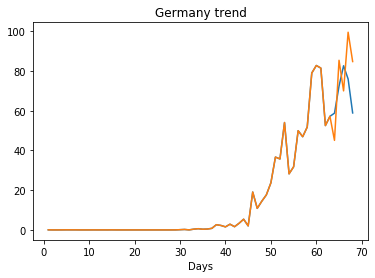

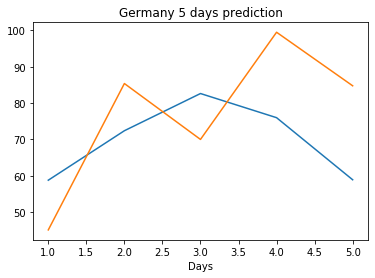

Creating directory ./offline6/US/training/
US
Saving the best model weights at Epoch [1], Best Valid Loss: 1930.5293
Saving the best model weights at Epoch [2], Best Valid Loss: 1344.0962


/space/home/nzhang/anaconda3/envs/neuralnet/lib/python3.7/site-packages/torch/nn/modules/loss.py:431: UserWarning: Using a target size (torch.Size([1, 1, 5])) that is different to the input size (torch.Size([5])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/space/home/nzhang/anaconda3/envs/neuralnet/lib/python3.7/site-packages/torch/nn/modules/loss.py:431: UserWarning: Using a target size (torch.Size([1, 5])) that is different to the input size (torch.Size([5])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Saving the best model weights at Epoch [6], Best Valid Loss: 1159.2875
Saving the best model weights at Epoch [23], Best Valid Loss: 896.8483
Saving the best model weights at Epoch [24], Best Valid Loss: 679.0260
Saving the best model weights at Epoch [25], Best Valid Loss: 501.4315
Saving the best model weights at Epoch [26], Best Valid Loss: 445.8478
Saving the best model weights at Epoch [27], Best Valid Loss: 386.7906
Saving the best model weights at Epoch [28], Best Valid Loss: 344.1951
Saving the best model weights at Epoch [29], Best Valid Loss: 326.4070
Saving the best model weights at Epoch [31], Best Valid Loss: 325.0456
Saving the best model weights at Epoch [33], Best Valid Loss: 316.9820
Saving the best model weights at Epoch [34], Best Valid Loss: 301.3228
Saving the best model weights at Epoch [38], Best Valid Loss: 297.9757
train error: 34.88237510092164
297.9756774902344
Saving the best model weights at Epoch [1], Best Valid Loss: 2831.8635
Saving the best model weight

Saving the best model weights at Epoch [14], Best Valid Loss: 565.7582
Saving the best model weights at Epoch [23], Best Valid Loss: 539.9323
Saving the best model weights at Epoch [27], Best Valid Loss: 318.6283
train error: 210.2671603532508
318.6282958984375
Saving the best model weights at Epoch [1], Best Valid Loss: 2200.4160
Saving the best model weights at Epoch [2], Best Valid Loss: 1540.4774
Saving the best model weights at Epoch [3], Best Valid Loss: 1179.2750
Saving the best model weights at Epoch [4], Best Valid Loss: 885.5802
Saving the best model weights at Epoch [6], Best Valid Loss: 833.2126
Saving the best model weights at Epoch [18], Best Valid Loss: 790.7744
Saving the best model weights at Epoch [22], Best Valid Loss: 359.9636
Saving the best model weights at Epoch [25], Best Valid Loss: 327.8111
Saving the best model weights at Epoch [48], Best Valid Loss: 300.1623
train error: 191.15004382008001
300.1623229980469
Saving the best model weights at Epoch [1], Best Va

Saving the best model weights at Epoch [2], Best Valid Loss: 2503.3044
Saving the best model weights at Epoch [4], Best Valid Loss: 2350.5383
Saving the best model weights at Epoch [5], Best Valid Loss: 2255.3875
Saving the best model weights at Epoch [8], Best Valid Loss: 2250.5664
Saving the best model weights at Epoch [15], Best Valid Loss: 2236.0952
Saving the best model weights at Epoch [28], Best Valid Loss: 2221.3391
Saving the best model weights at Epoch [29], Best Valid Loss: 2050.1504
Saving the best model weights at Epoch [49], Best Valid Loss: 2012.2385
train error: 245.33824521616884
2012.238525390625
Saving the best model weights at Epoch [1], Best Valid Loss: 2544.9570
Saving the best model weights at Epoch [2], Best Valid Loss: 2063.4861
Saving the best model weights at Epoch [3], Best Valid Loss: 1683.3668
Saving the best model weights at Epoch [7], Best Valid Loss: 1615.8212
Saving the best model weights at Epoch [47], Best Valid Loss: 1256.0106
train error: 278.42244

Saving the best model weights at Epoch [2], Best Valid Loss: 2543.8945
Saving the best model weights at Epoch [4], Best Valid Loss: 2429.0923
Saving the best model weights at Epoch [11], Best Valid Loss: 2422.0662
Saving the best model weights at Epoch [12], Best Valid Loss: 2107.6328
train error: 234.7811833431846
2107.6328125
Saving the best model weights at Epoch [1], Best Valid Loss: 1728.8434
Saving the best model weights at Epoch [3], Best Valid Loss: 1564.2438
Saving the best model weights at Epoch [10], Best Valid Loss: 1531.3497
Saving the best model weights at Epoch [14], Best Valid Loss: 1385.7427
train error: 229.78906772324913
1385.74267578125
Saving the best model weights at Epoch [1], Best Valid Loss: 2875.4363
Saving the best model weights at Epoch [2], Best Valid Loss: 2376.4675
Saving the best model weights at Epoch [3], Best Valid Loss: 2006.2786
Saving the best model weights at Epoch [4], Best Valid Loss: 1735.8105
Saving the best model weights at Epoch [5], Best Va

Saving the best model weights at Epoch [3], Best Valid Loss: 2626.8516
Saving the best model weights at Epoch [4], Best Valid Loss: 2273.1250
Saving the best model weights at Epoch [5], Best Valid Loss: 1982.8070
Saving the best model weights at Epoch [6], Best Valid Loss: 1672.5438
Saving the best model weights at Epoch [7], Best Valid Loss: 1538.7028
Saving the best model weights at Epoch [10], Best Valid Loss: 1262.7699
Saving the best model weights at Epoch [18], Best Valid Loss: 994.4704
Saving the best model weights at Epoch [20], Best Valid Loss: 911.7951
Saving the best model weights at Epoch [21], Best Valid Loss: 902.7551
Saving the best model weights at Epoch [27], Best Valid Loss: 804.5370
Saving the best model weights at Epoch [28], Best Valid Loss: 666.1957
Saving the best model weights at Epoch [29], Best Valid Loss: 596.5795
Saving the best model weights at Epoch [30], Best Valid Loss: 559.9542
train error: 119.53459998592122
559.9542236328125
Saving the best model weig

train error: 223.66432704423605
528.399658203125
Saving the best model weights at Epoch [1], Best Valid Loss: 3210.7861
Saving the best model weights at Epoch [2], Best Valid Loss: 3044.7925
Saving the best model weights at Epoch [3], Best Valid Loss: 2861.4214
Saving the best model weights at Epoch [4], Best Valid Loss: 2717.8748
Saving the best model weights at Epoch [5], Best Valid Loss: 2606.2188
Saving the best model weights at Epoch [6], Best Valid Loss: 2454.1711
Saving the best model weights at Epoch [7], Best Valid Loss: 2050.0464
Saving the best model weights at Epoch [9], Best Valid Loss: 1908.2773
Saving the best model weights at Epoch [10], Best Valid Loss: 1679.8223
Saving the best model weights at Epoch [12], Best Valid Loss: 1582.0948
Saving the best model weights at Epoch [14], Best Valid Loss: 1386.7323
Saving the best model weights at Epoch [18], Best Valid Loss: 1309.4741
Saving the best model weights at Epoch [19], Best Valid Loss: 1101.4596
train error: 109.841250

Saving the best model weights at Epoch [4], Best Valid Loss: 2721.5908
Saving the best model weights at Epoch [5], Best Valid Loss: 2608.4802
Saving the best model weights at Epoch [6], Best Valid Loss: 2571.2341
Saving the best model weights at Epoch [7], Best Valid Loss: 2552.2979
Saving the best model weights at Epoch [8], Best Valid Loss: 2486.5574
Saving the best model weights at Epoch [11], Best Valid Loss: 2483.4016
Saving the best model weights at Epoch [12], Best Valid Loss: 2151.9351
Saving the best model weights at Epoch [29], Best Valid Loss: 1814.2821
Saving the best model weights at Epoch [33], Best Valid Loss: 1575.0553
Saving the best model weights at Epoch [34], Best Valid Loss: 1351.2146
Saving the best model weights at Epoch [43], Best Valid Loss: 1301.8789
train error: 221.19653817227012
1301.87890625
Saving the best model weights at Epoch [1], Best Valid Loss: 3094.3726
Saving the best model weights at Epoch [2], Best Valid Loss: 2785.8279
Saving the best model wei

Saving the best model weights at Epoch [31], Best Valid Loss: 2463.4016
Saving the best model weights at Epoch [32], Best Valid Loss: 2449.2976
Saving the best model weights at Epoch [33], Best Valid Loss: 2444.8308
train error: 222.7180146167153
2444.830810546875
Saving the best model weights at Epoch [1], Best Valid Loss: 3074.5037
Saving the best model weights at Epoch [2], Best Valid Loss: 2787.9236
Saving the best model weights at Epoch [3], Best Valid Loss: 2640.0850
Saving the best model weights at Epoch [4], Best Valid Loss: 2556.6707
Saving the best model weights at Epoch [5], Best Valid Loss: 2519.9036
Saving the best model weights at Epoch [7], Best Valid Loss: 2455.2285
Saving the best model weights at Epoch [9], Best Valid Loss: 2451.5303
Saving the best model weights at Epoch [16], Best Valid Loss: 2451.4314
Saving the best model weights at Epoch [17], Best Valid Loss: 2442.6931
Saving the best model weights at Epoch [18], Best Valid Loss: 2393.0059
train error: 224.53507

Saving the best model weights at Epoch [18], Best Valid Loss: 2436.6555
Saving the best model weights at Epoch [19], Best Valid Loss: 2393.0901
Saving the best model weights at Epoch [20], Best Valid Loss: 2350.8064
Saving the best model weights at Epoch [21], Best Valid Loss: 2309.6533
Saving the best model weights at Epoch [22], Best Valid Loss: 2269.6746
Saving the best model weights at Epoch [23], Best Valid Loss: 2230.6982
Saving the best model weights at Epoch [24], Best Valid Loss: 2192.8992
Saving the best model weights at Epoch [25], Best Valid Loss: 2156.2424
Saving the best model weights at Epoch [26], Best Valid Loss: 2120.3542
Saving the best model weights at Epoch [27], Best Valid Loss: 2085.5413
Saving the best model weights at Epoch [28], Best Valid Loss: 2051.7107
Saving the best model weights at Epoch [29], Best Valid Loss: 2019.2274
Saving the best model weights at Epoch [30], Best Valid Loss: 1987.4137
Saving the best model weights at Epoch [31], Best Valid Loss: 19

Saving the best model weights at Epoch [29], Best Valid Loss: 1054.8777
Saving the best model weights at Epoch [30], Best Valid Loss: 1024.6477
Saving the best model weights at Epoch [31], Best Valid Loss: 996.5571
Saving the best model weights at Epoch [32], Best Valid Loss: 968.8907
Saving the best model weights at Epoch [33], Best Valid Loss: 943.4160
Saving the best model weights at Epoch [34], Best Valid Loss: 917.6918
Saving the best model weights at Epoch [35], Best Valid Loss: 894.4985
Saving the best model weights at Epoch [36], Best Valid Loss: 871.5455
Saving the best model weights at Epoch [38], Best Valid Loss: 827.9448
Saving the best model weights at Epoch [39], Best Valid Loss: 808.2369
Saving the best model weights at Epoch [40], Best Valid Loss: 789.1870
Saving the best model weights at Epoch [41], Best Valid Loss: 775.4823
Saving the best model weights at Epoch [43], Best Valid Loss: 742.4046
train error: 31.1517806640385
742.4046020507812
Saving the best model weigh

train error: 24.4518961155493
475.8787536621094
Saving the best model weights at Epoch [1], Best Valid Loss: 2313.0554
Saving the best model weights at Epoch [2], Best Valid Loss: 1376.6354
Saving the best model weights at Epoch [3], Best Valid Loss: 1067.4740
Saving the best model weights at Epoch [6], Best Valid Loss: 770.6431
Saving the best model weights at Epoch [10], Best Valid Loss: 743.0192
Saving the best model weights at Epoch [12], Best Valid Loss: 735.3539
Saving the best model weights at Epoch [22], Best Valid Loss: 718.7706
Saving the best model weights at Epoch [38], Best Valid Loss: 679.7658
Saving the best model weights at Epoch [39], Best Valid Loss: 646.6993
Saving the best model weights at Epoch [48], Best Valid Loss: 621.3352
train error: 30.06034356321968
621.335205078125
Saving the best model weights at Epoch [1], Best Valid Loss: 3133.3196
Saving the best model weights at Epoch [2], Best Valid Loss: 2797.3672
Saving the best model weights at Epoch [3], Best Vali

Saving the best model weights at Epoch [36], Best Valid Loss: 2222.6829
Saving the best model weights at Epoch [37], Best Valid Loss: 2180.7122
Saving the best model weights at Epoch [38], Best Valid Loss: 2140.4463
Saving the best model weights at Epoch [39], Best Valid Loss: 2100.1414
Saving the best model weights at Epoch [40], Best Valid Loss: 2061.8416
Saving the best model weights at Epoch [41], Best Valid Loss: 2024.1805
Saving the best model weights at Epoch [42], Best Valid Loss: 1987.8492
Saving the best model weights at Epoch [43], Best Valid Loss: 1952.6058
Saving the best model weights at Epoch [44], Best Valid Loss: 1918.0745
Saving the best model weights at Epoch [45], Best Valid Loss: 1884.6058
Saving the best model weights at Epoch [46], Best Valid Loss: 1852.2030
Saving the best model weights at Epoch [47], Best Valid Loss: 1820.1858
Saving the best model weights at Epoch [48], Best Valid Loss: 1789.4844
Saving the best model weights at Epoch [49], Best Valid Loss: 17

Saving the best model weights at Epoch [37], Best Valid Loss: 1186.6141
Saving the best model weights at Epoch [38], Best Valid Loss: 1144.7665
Saving the best model weights at Epoch [39], Best Valid Loss: 1106.0605
Saving the best model weights at Epoch [40], Best Valid Loss: 1071.9482
Saving the best model weights at Epoch [42], Best Valid Loss: 1048.8817
Saving the best model weights at Epoch [43], Best Valid Loss: 1013.5561
Saving the best model weights at Epoch [44], Best Valid Loss: 980.5031
Saving the best model weights at Epoch [45], Best Valid Loss: 948.0561
Saving the best model weights at Epoch [46], Best Valid Loss: 918.7205
Saving the best model weights at Epoch [49], Best Valid Loss: 898.7646
Saving the best model weights at Epoch [50], Best Valid Loss: 879.8989
train error: 39.87636772660833
879.8988647460938
Saving the best model weights at Epoch [1], Best Valid Loss: 3340.0774
Saving the best model weights at Epoch [2], Best Valid Loss: 3298.6328
Saving the best model 

Saving the best model weights at Epoch [16], Best Valid Loss: 1116.5641
Saving the best model weights at Epoch [17], Best Valid Loss: 1039.7478
Saving the best model weights at Epoch [18], Best Valid Loss: 961.8859
Saving the best model weights at Epoch [19], Best Valid Loss: 887.4935
Saving the best model weights at Epoch [21], Best Valid Loss: 844.1207
Saving the best model weights at Epoch [22], Best Valid Loss: 809.3934
Saving the best model weights at Epoch [23], Best Valid Loss: 747.9428
Saving the best model weights at Epoch [24], Best Valid Loss: 687.8878
Saving the best model weights at Epoch [25], Best Valid Loss: 685.2497
Saving the best model weights at Epoch [26], Best Valid Loss: 678.5709
Saving the best model weights at Epoch [27], Best Valid Loss: 625.0505
Saving the best model weights at Epoch [28], Best Valid Loss: 573.1359
Saving the best model weights at Epoch [29], Best Valid Loss: 534.3087
Saving the best model weights at Epoch [30], Best Valid Loss: 523.7682
Savi

Saving the best model weights at Epoch [20], Best Valid Loss: 3091.5481
Saving the best model weights at Epoch [21], Best Valid Loss: 3077.1111
Saving the best model weights at Epoch [22], Best Valid Loss: 3062.7756
Saving the best model weights at Epoch [23], Best Valid Loss: 3048.1882
Saving the best model weights at Epoch [24], Best Valid Loss: 3033.5532
Saving the best model weights at Epoch [25], Best Valid Loss: 3018.9060
Saving the best model weights at Epoch [26], Best Valid Loss: 3004.1169
Saving the best model weights at Epoch [27], Best Valid Loss: 2989.2712
Saving the best model weights at Epoch [28], Best Valid Loss: 2974.3479
Saving the best model weights at Epoch [29], Best Valid Loss: 2959.3689
Saving the best model weights at Epoch [30], Best Valid Loss: 2944.0662
Saving the best model weights at Epoch [31], Best Valid Loss: 2928.9443
Saving the best model weights at Epoch [32], Best Valid Loss: 2913.6238
Saving the best model weights at Epoch [33], Best Valid Loss: 28

Saving the best model weights at Epoch [16], Best Valid Loss: 3110.3086
Saving the best model weights at Epoch [17], Best Valid Loss: 3092.0154
Saving the best model weights at Epoch [18], Best Valid Loss: 3073.1892
Saving the best model weights at Epoch [19], Best Valid Loss: 3053.9507
Saving the best model weights at Epoch [20], Best Valid Loss: 3034.1384
Saving the best model weights at Epoch [21], Best Valid Loss: 3013.8430
Saving the best model weights at Epoch [22], Best Valid Loss: 2993.4348
Saving the best model weights at Epoch [23], Best Valid Loss: 2972.2683
Saving the best model weights at Epoch [24], Best Valid Loss: 2950.6409
Saving the best model weights at Epoch [25], Best Valid Loss: 2928.1895
Saving the best model weights at Epoch [26], Best Valid Loss: 2904.9915
Saving the best model weights at Epoch [27], Best Valid Loss: 2881.5581
Saving the best model weights at Epoch [28], Best Valid Loss: 2857.1052
Saving the best model weights at Epoch [29], Best Valid Loss: 28

Saving the best model weights at Epoch [27], Best Valid Loss: 2765.4829
Saving the best model weights at Epoch [28], Best Valid Loss: 2714.7737
Saving the best model weights at Epoch [29], Best Valid Loss: 2657.1855
Saving the best model weights at Epoch [30], Best Valid Loss: 2592.8279
Saving the best model weights at Epoch [31], Best Valid Loss: 2522.3318
Saving the best model weights at Epoch [32], Best Valid Loss: 2442.2944
Saving the best model weights at Epoch [33], Best Valid Loss: 2351.5559
Saving the best model weights at Epoch [34], Best Valid Loss: 2251.8235
Saving the best model weights at Epoch [35], Best Valid Loss: 2143.7346
Saving the best model weights at Epoch [36], Best Valid Loss: 2028.0594
Saving the best model weights at Epoch [37], Best Valid Loss: 1911.7936
Saving the best model weights at Epoch [38], Best Valid Loss: 1793.2523
Saving the best model weights at Epoch [39], Best Valid Loss: 1685.3119
Saving the best model weights at Epoch [40], Best Valid Loss: 15

Saving the best model weights at Epoch [47], Best Valid Loss: 494.9565
Saving the best model weights at Epoch [48], Best Valid Loss: 461.1850
Saving the best model weights at Epoch [49], Best Valid Loss: 436.6693
train error: 17.621297332458198
436.66925048828125
Saving the best model weights at Epoch [1], Best Valid Loss: 3346.7136
Saving the best model weights at Epoch [2], Best Valid Loss: 3314.4688
Saving the best model weights at Epoch [3], Best Valid Loss: 3283.7485
Saving the best model weights at Epoch [4], Best Valid Loss: 3254.0586
Saving the best model weights at Epoch [5], Best Valid Loss: 3224.5154
Saving the best model weights at Epoch [6], Best Valid Loss: 3189.7161
Saving the best model weights at Epoch [7], Best Valid Loss: 3160.0459
Saving the best model weights at Epoch [8], Best Valid Loss: 3121.9199
Saving the best model weights at Epoch [9], Best Valid Loss: 3075.2607
Saving the best model weights at Epoch [10], Best Valid Loss: 3025.5066
Saving the best model wei

Saving the best model weights at Epoch [24], Best Valid Loss: 2731.4109
Saving the best model weights at Epoch [25], Best Valid Loss: 2712.4897
Saving the best model weights at Epoch [26], Best Valid Loss: 2690.6365
Saving the best model weights at Epoch [27], Best Valid Loss: 2672.1074
Saving the best model weights at Epoch [28], Best Valid Loss: 2654.7546
Saving the best model weights at Epoch [29], Best Valid Loss: 2639.0945
Saving the best model weights at Epoch [30], Best Valid Loss: 2624.2043
Saving the best model weights at Epoch [31], Best Valid Loss: 2612.2729
Saving the best model weights at Epoch [32], Best Valid Loss: 2600.0466
Saving the best model weights at Epoch [33], Best Valid Loss: 2591.6152
Saving the best model weights at Epoch [34], Best Valid Loss: 2586.7273
Saving the best model weights at Epoch [35], Best Valid Loss: 2569.5745
Saving the best model weights at Epoch [36], Best Valid Loss: 2569.2144
Saving the best model weights at Epoch [37], Best Valid Loss: 25

Saving the best model weights at Epoch [18], Best Valid Loss: 2798.8826
Saving the best model weights at Epoch [19], Best Valid Loss: 2763.4102
Saving the best model weights at Epoch [20], Best Valid Loss: 2735.0151
Saving the best model weights at Epoch [21], Best Valid Loss: 2701.9060
Saving the best model weights at Epoch [22], Best Valid Loss: 2676.9175
Saving the best model weights at Epoch [23], Best Valid Loss: 2654.1138
Saving the best model weights at Epoch [24], Best Valid Loss: 2627.3340
Saving the best model weights at Epoch [25], Best Valid Loss: 2607.8889
Saving the best model weights at Epoch [26], Best Valid Loss: 2589.5059
Saving the best model weights at Epoch [27], Best Valid Loss: 2577.9624
Saving the best model weights at Epoch [28], Best Valid Loss: 2561.9170
Saving the best model weights at Epoch [29], Best Valid Loss: 2558.0969
Saving the best model weights at Epoch [30], Best Valid Loss: 2536.6455
Saving the best model weights at Epoch [31], Best Valid Loss: 25

Saving the best model weights at Epoch [16], Best Valid Loss: 2833.2056
Saving the best model weights at Epoch [17], Best Valid Loss: 2795.6296
Saving the best model weights at Epoch [18], Best Valid Loss: 2758.4431
Saving the best model weights at Epoch [19], Best Valid Loss: 2726.3630
Saving the best model weights at Epoch [20], Best Valid Loss: 2698.5127
Saving the best model weights at Epoch [21], Best Valid Loss: 2659.9329
Saving the best model weights at Epoch [22], Best Valid Loss: 2633.6733
Saving the best model weights at Epoch [23], Best Valid Loss: 2612.8386
Saving the best model weights at Epoch [24], Best Valid Loss: 2575.7156
Saving the best model weights at Epoch [25], Best Valid Loss: 2556.2307
Saving the best model weights at Epoch [26], Best Valid Loss: 2536.2749
Saving the best model weights at Epoch [27], Best Valid Loss: 2519.5552
Saving the best model weights at Epoch [28], Best Valid Loss: 2500.0935
Saving the best model weights at Epoch [29], Best Valid Loss: 24

Saving the best model weights at Epoch [18], Best Valid Loss: 2742.0095
Saving the best model weights at Epoch [19], Best Valid Loss: 2705.5291
Saving the best model weights at Epoch [20], Best Valid Loss: 2659.4407
Saving the best model weights at Epoch [21], Best Valid Loss: 2639.8208
Saving the best model weights at Epoch [22], Best Valid Loss: 2593.8972
Saving the best model weights at Epoch [23], Best Valid Loss: 2579.7146
Saving the best model weights at Epoch [24], Best Valid Loss: 2538.3328
Saving the best model weights at Epoch [25], Best Valid Loss: 2509.0410
Saving the best model weights at Epoch [26], Best Valid Loss: 2476.8301
Saving the best model weights at Epoch [27], Best Valid Loss: 2429.7527
Saving the best model weights at Epoch [28], Best Valid Loss: 2364.7473
Saving the best model weights at Epoch [29], Best Valid Loss: 2276.6519
Saving the best model weights at Epoch [30], Best Valid Loss: 2116.6641
Saving the best model weights at Epoch [31], Best Valid Loss: 18

Saving the best model weights at Epoch [28], Best Valid Loss: 2692.4978
Saving the best model weights at Epoch [29], Best Valid Loss: 2675.5591
Saving the best model weights at Epoch [30], Best Valid Loss: 2659.6511
Saving the best model weights at Epoch [31], Best Valid Loss: 2645.1990
Saving the best model weights at Epoch [32], Best Valid Loss: 2632.7266
Saving the best model weights at Epoch [33], Best Valid Loss: 2618.2068
Saving the best model weights at Epoch [34], Best Valid Loss: 2606.3464
Saving the best model weights at Epoch [35], Best Valid Loss: 2595.9082
Saving the best model weights at Epoch [36], Best Valid Loss: 2593.2822
Saving the best model weights at Epoch [37], Best Valid Loss: 2579.9941
Saving the best model weights at Epoch [38], Best Valid Loss: 2576.2114
Saving the best model weights at Epoch [39], Best Valid Loss: 2558.9373
Saving the best model weights at Epoch [40], Best Valid Loss: 2551.6843
Saving the best model weights at Epoch [42], Best Valid Loss: 25

Saving the best model weights at Epoch [30], Best Valid Loss: 2578.8262
Saving the best model weights at Epoch [31], Best Valid Loss: 2566.3086
Saving the best model weights at Epoch [32], Best Valid Loss: 2564.6160
Saving the best model weights at Epoch [33], Best Valid Loss: 2548.0886
Saving the best model weights at Epoch [34], Best Valid Loss: 2546.1355
Saving the best model weights at Epoch [35], Best Valid Loss: 2531.5266
Saving the best model weights at Epoch [36], Best Valid Loss: 2530.1968
Saving the best model weights at Epoch [37], Best Valid Loss: 2526.4832
Saving the best model weights at Epoch [38], Best Valid Loss: 2515.7312
Saving the best model weights at Epoch [39], Best Valid Loss: 2511.7832
Saving the best model weights at Epoch [42], Best Valid Loss: 2505.2996
Saving the best model weights at Epoch [44], Best Valid Loss: 2500.9521
Saving the best model weights at Epoch [46], Best Valid Loss: 2500.8784
Saving the best model weights at Epoch [47], Best Valid Loss: 24

Saving the best model weights at Epoch [40], Best Valid Loss: 2500.1396
Saving the best model weights at Epoch [41], Best Valid Loss: 2499.2271
Saving the best model weights at Epoch [44], Best Valid Loss: 2495.6934
train error: 221.0835996427034
2495.693359375
Saving the best model weights at Epoch [1], Best Valid Loss: 3256.1123
Saving the best model weights at Epoch [2], Best Valid Loss: 3129.2629
Saving the best model weights at Epoch [3], Best Valid Loss: 2991.0129
Saving the best model weights at Epoch [4], Best Valid Loss: 2824.3972
Saving the best model weights at Epoch [5], Best Valid Loss: 2664.8679
Saving the best model weights at Epoch [6], Best Valid Loss: 2572.8958
Saving the best model weights at Epoch [8], Best Valid Loss: 2463.5713
Saving the best model weights at Epoch [17], Best Valid Loss: 2442.9102
Saving the best model weights at Epoch [32], Best Valid Loss: 2352.3345
Saving the best model weights at Epoch [33], Best Valid Loss: 1640.5215
train error: 220.61913756

Saving the best model weights at Epoch [28], Best Valid Loss: 731.0532
train error: 219.00067203923277
731.05322265625
Saving the best model weights at Epoch [1], Best Valid Loss: 3383.1387
Saving the best model weights at Epoch [2], Best Valid Loss: 3378.3457
Saving the best model weights at Epoch [3], Best Valid Loss: 3373.2668
Saving the best model weights at Epoch [4], Best Valid Loss: 3366.4277
Saving the best model weights at Epoch [5], Best Valid Loss: 3354.0410
Saving the best model weights at Epoch [6], Best Valid Loss: 3345.8064
Saving the best model weights at Epoch [7], Best Valid Loss: 3339.4988
Saving the best model weights at Epoch [8], Best Valid Loss: 3333.7610
Saving the best model weights at Epoch [9], Best Valid Loss: 3328.2539
Saving the best model weights at Epoch [10], Best Valid Loss: 3322.8835
Saving the best model weights at Epoch [11], Best Valid Loss: 3317.5906
Saving the best model weights at Epoch [12], Best Valid Loss: 3312.2559
Saving the best model weig

Saving the best model weights at Epoch [14], Best Valid Loss: 2670.6179
Saving the best model weights at Epoch [15], Best Valid Loss: 2622.7771
Saving the best model weights at Epoch [16], Best Valid Loss: 2568.8071
Saving the best model weights at Epoch [17], Best Valid Loss: 2530.2380
Saving the best model weights at Epoch [18], Best Valid Loss: 2488.5818
Saving the best model weights at Epoch [19], Best Valid Loss: 2440.9136
Saving the best model weights at Epoch [20], Best Valid Loss: 2394.1489
Saving the best model weights at Epoch [21], Best Valid Loss: 2350.6306
Saving the best model weights at Epoch [22], Best Valid Loss: 2316.2019
Saving the best model weights at Epoch [23], Best Valid Loss: 2269.6248
Saving the best model weights at Epoch [24], Best Valid Loss: 2226.9460
Saving the best model weights at Epoch [25], Best Valid Loss: 2188.2249
Saving the best model weights at Epoch [26], Best Valid Loss: 2158.5632
Saving the best model weights at Epoch [27], Best Valid Loss: 21

Saving the best model weights at Epoch [28], Best Valid Loss: 2771.0693
Saving the best model weights at Epoch [29], Best Valid Loss: 2744.1951
Saving the best model weights at Epoch [30], Best Valid Loss: 2719.5720
Saving the best model weights at Epoch [31], Best Valid Loss: 2695.3135
Saving the best model weights at Epoch [32], Best Valid Loss: 2673.1472
Saving the best model weights at Epoch [33], Best Valid Loss: 2647.5574
Saving the best model weights at Epoch [34], Best Valid Loss: 2623.6653
Saving the best model weights at Epoch [35], Best Valid Loss: 2601.2773
Saving the best model weights at Epoch [36], Best Valid Loss: 2577.3220
Saving the best model weights at Epoch [37], Best Valid Loss: 2555.1118
Saving the best model weights at Epoch [38], Best Valid Loss: 2533.1541
Saving the best model weights at Epoch [39], Best Valid Loss: 2509.9443
Saving the best model weights at Epoch [40], Best Valid Loss: 2489.5447
Saving the best model weights at Epoch [41], Best Valid Loss: 24

Saving the best model weights at Epoch [49], Best Valid Loss: 2494.8677
Saving the best model weights at Epoch [50], Best Valid Loss: 2477.1501
train error: 182.81817024181547
2477.150146484375
Saving the best model weights at Epoch [1], Best Valid Loss: 3351.2517
Saving the best model weights at Epoch [2], Best Valid Loss: 3330.5789
Saving the best model weights at Epoch [3], Best Valid Loss: 3312.2368
Saving the best model weights at Epoch [4], Best Valid Loss: 3291.0554
Saving the best model weights at Epoch [5], Best Valid Loss: 3269.1443
Saving the best model weights at Epoch [6], Best Valid Loss: 3247.4951
Saving the best model weights at Epoch [7], Best Valid Loss: 3224.6858
Saving the best model weights at Epoch [8], Best Valid Loss: 3200.1865
Saving the best model weights at Epoch [9], Best Valid Loss: 3174.2371
Saving the best model weights at Epoch [10], Best Valid Loss: 3149.4326
Saving the best model weights at Epoch [11], Best Valid Loss: 3119.0676
Saving the best model w

Saving the best model weights at Epoch [27], Best Valid Loss: 2649.8037
Saving the best model weights at Epoch [28], Best Valid Loss: 2618.0164
Saving the best model weights at Epoch [29], Best Valid Loss: 2586.0828
Saving the best model weights at Epoch [30], Best Valid Loss: 2554.4219
Saving the best model weights at Epoch [31], Best Valid Loss: 2522.8418
Saving the best model weights at Epoch [32], Best Valid Loss: 2491.6328
Saving the best model weights at Epoch [33], Best Valid Loss: 2460.8877
Saving the best model weights at Epoch [34], Best Valid Loss: 2430.2532
Saving the best model weights at Epoch [35], Best Valid Loss: 2399.3337
Saving the best model weights at Epoch [36], Best Valid Loss: 2368.2195
Saving the best model weights at Epoch [37], Best Valid Loss: 2337.9636
Saving the best model weights at Epoch [38], Best Valid Loss: 2308.2783
Saving the best model weights at Epoch [39], Best Valid Loss: 2278.8943
Saving the best model weights at Epoch [40], Best Valid Loss: 22

Saving the best model weights at Epoch [6], Best Valid Loss: 3370.5969
Saving the best model weights at Epoch [7], Best Valid Loss: 3368.7578
Saving the best model weights at Epoch [8], Best Valid Loss: 3366.9531
Saving the best model weights at Epoch [9], Best Valid Loss: 3365.1833
Saving the best model weights at Epoch [10], Best Valid Loss: 3363.3574
Saving the best model weights at Epoch [11], Best Valid Loss: 3361.5681
Saving the best model weights at Epoch [12], Best Valid Loss: 3359.7896
Saving the best model weights at Epoch [13], Best Valid Loss: 3358.0044
Saving the best model weights at Epoch [14], Best Valid Loss: 3356.2336
Saving the best model weights at Epoch [15], Best Valid Loss: 3354.4539
Saving the best model weights at Epoch [16], Best Valid Loss: 3352.6855
Saving the best model weights at Epoch [17], Best Valid Loss: 3350.9204
Saving the best model weights at Epoch [18], Best Valid Loss: 3349.1587
Saving the best model weights at Epoch [19], Best Valid Loss: 3347.4

Saving the best model weights at Epoch [21], Best Valid Loss: 3037.0693
Saving the best model weights at Epoch [22], Best Valid Loss: 3009.1455
Saving the best model weights at Epoch [23], Best Valid Loss: 2983.5364
Saving the best model weights at Epoch [24], Best Valid Loss: 2958.5022
Saving the best model weights at Epoch [25], Best Valid Loss: 2925.7507
Saving the best model weights at Epoch [26], Best Valid Loss: 2899.2310
Saving the best model weights at Epoch [27], Best Valid Loss: 2873.1482
Saving the best model weights at Epoch [28], Best Valid Loss: 2840.0554
Saving the best model weights at Epoch [29], Best Valid Loss: 2811.5137
Saving the best model weights at Epoch [30], Best Valid Loss: 2781.5085
Saving the best model weights at Epoch [31], Best Valid Loss: 2740.4836
Saving the best model weights at Epoch [32], Best Valid Loss: 2706.8672
Saving the best model weights at Epoch [33], Best Valid Loss: 2668.9067
Saving the best model weights at Epoch [34], Best Valid Loss: 26

Saving the best model weights at Epoch [35], Best Valid Loss: 3212.5581
Saving the best model weights at Epoch [36], Best Valid Loss: 3204.8279
Saving the best model weights at Epoch [37], Best Valid Loss: 3197.2385
Saving the best model weights at Epoch [38], Best Valid Loss: 3190.2017
Saving the best model weights at Epoch [39], Best Valid Loss: 3181.6228
Saving the best model weights at Epoch [40], Best Valid Loss: 3173.5222
Saving the best model weights at Epoch [41], Best Valid Loss: 3165.4368
Saving the best model weights at Epoch [42], Best Valid Loss: 3156.7126
Saving the best model weights at Epoch [43], Best Valid Loss: 3148.0271
Saving the best model weights at Epoch [44], Best Valid Loss: 3139.3486
Saving the best model weights at Epoch [45], Best Valid Loss: 3129.7183
Saving the best model weights at Epoch [46], Best Valid Loss: 3120.4836
Saving the best model weights at Epoch [47], Best Valid Loss: 3110.4146
Saving the best model weights at Epoch [48], Best Valid Loss: 31

Saving the best model weights at Epoch [50], Best Valid Loss: 3268.0186
train error: 276.2328688414081
3268.0185546875
Saving the best model weights at Epoch [1], Best Valid Loss: 3376.6438
Saving the best model weights at Epoch [2], Best Valid Loss: 3372.6843
Saving the best model weights at Epoch [3], Best Valid Loss: 3368.3774
Saving the best model weights at Epoch [4], Best Valid Loss: 3363.8718
Saving the best model weights at Epoch [5], Best Valid Loss: 3359.8501
Saving the best model weights at Epoch [6], Best Valid Loss: 3355.2336
Saving the best model weights at Epoch [7], Best Valid Loss: 3350.9634
Saving the best model weights at Epoch [8], Best Valid Loss: 3346.3540
Saving the best model weights at Epoch [9], Best Valid Loss: 3342.1255
Saving the best model weights at Epoch [10], Best Valid Loss: 3337.2278
Saving the best model weights at Epoch [11], Best Valid Loss: 3332.5273
Saving the best model weights at Epoch [12], Best Valid Loss: 3327.7595
Saving the best model weig

Saving the best model weights at Epoch [19], Best Valid Loss: 3320.5891
Saving the best model weights at Epoch [20], Best Valid Loss: 3317.3794
Saving the best model weights at Epoch [21], Best Valid Loss: 3314.1118
Saving the best model weights at Epoch [22], Best Valid Loss: 3310.7859
Saving the best model weights at Epoch [23], Best Valid Loss: 3307.3540
Saving the best model weights at Epoch [24], Best Valid Loss: 3303.8484
Saving the best model weights at Epoch [25], Best Valid Loss: 3300.2500
Saving the best model weights at Epoch [26], Best Valid Loss: 3296.5598
Saving the best model weights at Epoch [27], Best Valid Loss: 3292.7356
Saving the best model weights at Epoch [28], Best Valid Loss: 3288.8044
Saving the best model weights at Epoch [29], Best Valid Loss: 3284.7810
Saving the best model weights at Epoch [30], Best Valid Loss: 3280.6438
Saving the best model weights at Epoch [31], Best Valid Loss: 3276.2107
Saving the best model weights at Epoch [32], Best Valid Loss: 32

Saving the best model weights at Epoch [32], Best Valid Loss: 551.7420
Saving the best model weights at Epoch [34], Best Valid Loss: 534.5226
Saving the best model weights at Epoch [35], Best Valid Loss: 492.8946
Saving the best model weights at Epoch [36], Best Valid Loss: 478.1815
Saving the best model weights at Epoch [37], Best Valid Loss: 453.6058
Saving the best model weights at Epoch [38], Best Valid Loss: 421.1120
Saving the best model weights at Epoch [39], Best Valid Loss: 414.6233
Saving the best model weights at Epoch [40], Best Valid Loss: 402.6339
Saving the best model weights at Epoch [41], Best Valid Loss: 387.4601
Saving the best model weights at Epoch [42], Best Valid Loss: 365.6856
Saving the best model weights at Epoch [43], Best Valid Loss: 352.4720
Saving the best model weights at Epoch [44], Best Valid Loss: 350.9451
Saving the best model weights at Epoch [45], Best Valid Loss: 344.7713
Saving the best model weights at Epoch [46], Best Valid Loss: 330.3875
Saving

Saving the best model weights at Epoch [48], Best Valid Loss: 3238.6208
Saving the best model weights at Epoch [49], Best Valid Loss: 3235.8579
Saving the best model weights at Epoch [50], Best Valid Loss: 3232.8108
train error: 270.9510216684522
3232.810791015625
Saving the best model weights at Epoch [1], Best Valid Loss: 3363.4961
Saving the best model weights at Epoch [2], Best Valid Loss: 3349.8352
Saving the best model weights at Epoch [3], Best Valid Loss: 3335.0923
Saving the best model weights at Epoch [4], Best Valid Loss: 3320.6106
Saving the best model weights at Epoch [5], Best Valid Loss: 3305.8638
Saving the best model weights at Epoch [6], Best Valid Loss: 3291.1287
Saving the best model weights at Epoch [7], Best Valid Loss: 3277.0122
Saving the best model weights at Epoch [8], Best Valid Loss: 3264.0361
Saving the best model weights at Epoch [9], Best Valid Loss: 3251.8503
Saving the best model weights at Epoch [10], Best Valid Loss: 3237.5798
Saving the best model we

Saving the best model weights at Epoch [11], Best Valid Loss: 3357.3633
Saving the best model weights at Epoch [12], Best Valid Loss: 3354.2966
Saving the best model weights at Epoch [13], Best Valid Loss: 3351.0378
Saving the best model weights at Epoch [14], Best Valid Loss: 3348.0989
Saving the best model weights at Epoch [15], Best Valid Loss: 3344.8235
Saving the best model weights at Epoch [16], Best Valid Loss: 3341.9500
Saving the best model weights at Epoch [17], Best Valid Loss: 3338.6172
Saving the best model weights at Epoch [18], Best Valid Loss: 3335.6306
Saving the best model weights at Epoch [19], Best Valid Loss: 3332.5793
Saving the best model weights at Epoch [20], Best Valid Loss: 3329.3586
Saving the best model weights at Epoch [21], Best Valid Loss: 3326.2676
Saving the best model weights at Epoch [22], Best Valid Loss: 3323.2017
Saving the best model weights at Epoch [23], Best Valid Loss: 3320.1184
Saving the best model weights at Epoch [24], Best Valid Loss: 33

Saving the best model weights at Epoch [25], Best Valid Loss: 3337.6633
Saving the best model weights at Epoch [26], Best Valid Loss: 3335.9688
Saving the best model weights at Epoch [27], Best Valid Loss: 3334.2910
Saving the best model weights at Epoch [28], Best Valid Loss: 3332.6392
Saving the best model weights at Epoch [29], Best Valid Loss: 3330.9451
Saving the best model weights at Epoch [30], Best Valid Loss: 3329.2742
Saving the best model weights at Epoch [31], Best Valid Loss: 3327.6055
Saving the best model weights at Epoch [32], Best Valid Loss: 3325.9395
Saving the best model weights at Epoch [33], Best Valid Loss: 3324.2759
Saving the best model weights at Epoch [34], Best Valid Loss: 3322.6438
Saving the best model weights at Epoch [35], Best Valid Loss: 3320.9614
Saving the best model weights at Epoch [36], Best Valid Loss: 3319.2974
Saving the best model weights at Epoch [37], Best Valid Loss: 3317.6411
Saving the best model weights at Epoch [38], Best Valid Loss: 33

Saving the best model weights at Epoch [38], Best Valid Loss: 2456.0193
Saving the best model weights at Epoch [39], Best Valid Loss: 2373.2341
Saving the best model weights at Epoch [40], Best Valid Loss: 2300.3889
Saving the best model weights at Epoch [41], Best Valid Loss: 2185.8552
Saving the best model weights at Epoch [42], Best Valid Loss: 2084.8699
Saving the best model weights at Epoch [43], Best Valid Loss: 1970.0975
Saving the best model weights at Epoch [44], Best Valid Loss: 1853.4961
Saving the best model weights at Epoch [45], Best Valid Loss: 1738.8571
Saving the best model weights at Epoch [46], Best Valid Loss: 1636.3807
Saving the best model weights at Epoch [47], Best Valid Loss: 1566.0404
Saving the best model weights at Epoch [48], Best Valid Loss: 1476.3671
Saving the best model weights at Epoch [49], Best Valid Loss: 1365.4993
Saving the best model weights at Epoch [50], Best Valid Loss: 1316.0157
train error: 67.1157199093876
1316.0157470703125
Saving the best

Saving the best model weights at Epoch [2], Best Valid Loss: 3355.2266
Saving the best model weights at Epoch [3], Best Valid Loss: 3339.8254
Saving the best model weights at Epoch [4], Best Valid Loss: 3324.1755
Saving the best model weights at Epoch [5], Best Valid Loss: 3309.9236
Saving the best model weights at Epoch [6], Best Valid Loss: 3295.8594
Saving the best model weights at Epoch [7], Best Valid Loss: 3280.3992
Saving the best model weights at Epoch [8], Best Valid Loss: 3265.0271
Saving the best model weights at Epoch [9], Best Valid Loss: 3248.4910
Saving the best model weights at Epoch [10], Best Valid Loss: 3233.8076
Saving the best model weights at Epoch [11], Best Valid Loss: 3217.1682
Saving the best model weights at Epoch [12], Best Valid Loss: 3203.1462
Saving the best model weights at Epoch [13], Best Valid Loss: 3185.6389
Saving the best model weights at Epoch [14], Best Valid Loss: 3166.6196
Saving the best model weights at Epoch [15], Best Valid Loss: 3151.2622


Saving the best model weights at Epoch [16], Best Valid Loss: 3335.6902
Saving the best model weights at Epoch [17], Best Valid Loss: 3332.6392
Saving the best model weights at Epoch [18], Best Valid Loss: 3329.7009
Saving the best model weights at Epoch [19], Best Valid Loss: 3326.6470
Saving the best model weights at Epoch [20], Best Valid Loss: 3323.6074
Saving the best model weights at Epoch [21], Best Valid Loss: 3320.5710
Saving the best model weights at Epoch [22], Best Valid Loss: 3317.6794
Saving the best model weights at Epoch [23], Best Valid Loss: 3314.5430
Saving the best model weights at Epoch [24], Best Valid Loss: 3311.5547
Saving the best model weights at Epoch [25], Best Valid Loss: 3308.6152
Saving the best model weights at Epoch [26], Best Valid Loss: 3305.6477
Saving the best model weights at Epoch [27], Best Valid Loss: 3302.5701
Saving the best model weights at Epoch [28], Best Valid Loss: 3299.5730
Saving the best model weights at Epoch [29], Best Valid Loss: 32

Saving the best model weights at Epoch [30], Best Valid Loss: 3341.1052
Saving the best model weights at Epoch [31], Best Valid Loss: 3339.4478
Saving the best model weights at Epoch [32], Best Valid Loss: 3337.7910
Saving the best model weights at Epoch [33], Best Valid Loss: 3336.1387
Saving the best model weights at Epoch [34], Best Valid Loss: 3334.4851
Saving the best model weights at Epoch [35], Best Valid Loss: 3332.8352
Saving the best model weights at Epoch [36], Best Valid Loss: 3331.1873
Saving the best model weights at Epoch [37], Best Valid Loss: 3329.5410
Saving the best model weights at Epoch [38], Best Valid Loss: 3327.8926
Saving the best model weights at Epoch [39], Best Valid Loss: 3326.2649
Saving the best model weights at Epoch [40], Best Valid Loss: 3324.6072
Saving the best model weights at Epoch [41], Best Valid Loss: 3322.9673
Saving the best model weights at Epoch [42], Best Valid Loss: 3321.3281
Saving the best model weights at Epoch [43], Best Valid Loss: 33

Saving the best model weights at Epoch [44], Best Valid Loss: 2640.0728
Saving the best model weights at Epoch [45], Best Valid Loss: 2637.8489
Saving the best model weights at Epoch [46], Best Valid Loss: 2624.4500
Saving the best model weights at Epoch [47], Best Valid Loss: 2613.9839
Saving the best model weights at Epoch [48], Best Valid Loss: 2595.2439
Saving the best model weights at Epoch [49], Best Valid Loss: 2594.7175
Saving the best model weights at Epoch [50], Best Valid Loss: 2583.1865
train error: 220.37971079976936
2583.1865234375
Saving the best model weights at Epoch [1], Best Valid Loss: 3378.1555
Saving the best model weights at Epoch [2], Best Valid Loss: 3376.4177
Saving the best model weights at Epoch [3], Best Valid Loss: 3374.6804
Saving the best model weights at Epoch [4], Best Valid Loss: 3372.9485
Saving the best model weights at Epoch [5], Best Valid Loss: 3371.2400
Saving the best model weights at Epoch [6], Best Valid Loss: 3369.4946
Saving the best model 

Saving the best model weights at Epoch [8], Best Valid Loss: 3257.1665
Saving the best model weights at Epoch [9], Best Valid Loss: 3239.5684
Saving the best model weights at Epoch [10], Best Valid Loss: 3225.2354
Saving the best model weights at Epoch [11], Best Valid Loss: 3208.3965
Saving the best model weights at Epoch [12], Best Valid Loss: 3192.4080
Saving the best model weights at Epoch [13], Best Valid Loss: 3177.2207
Saving the best model weights at Epoch [14], Best Valid Loss: 3162.1931
Saving the best model weights at Epoch [15], Best Valid Loss: 3150.0339
Saving the best model weights at Epoch [16], Best Valid Loss: 3131.8286
Saving the best model weights at Epoch [17], Best Valid Loss: 3112.3308
Saving the best model weights at Epoch [18], Best Valid Loss: 3102.6907
Saving the best model weights at Epoch [19], Best Valid Loss: 3080.4563
Saving the best model weights at Epoch [20], Best Valid Loss: 3065.1494
Saving the best model weights at Epoch [21], Best Valid Loss: 3045

Saving the best model weights at Epoch [22], Best Valid Loss: 3315.8438
Saving the best model weights at Epoch [23], Best Valid Loss: 3312.7993
Saving the best model weights at Epoch [24], Best Valid Loss: 3309.6326
Saving the best model weights at Epoch [25], Best Valid Loss: 3306.6912
Saving the best model weights at Epoch [26], Best Valid Loss: 3303.8474
Saving the best model weights at Epoch [27], Best Valid Loss: 3300.8640
Saving the best model weights at Epoch [28], Best Valid Loss: 3297.9009
Saving the best model weights at Epoch [29], Best Valid Loss: 3294.9363
Saving the best model weights at Epoch [30], Best Valid Loss: 3292.1313
Saving the best model weights at Epoch [31], Best Valid Loss: 3289.1313
Saving the best model weights at Epoch [32], Best Valid Loss: 3286.2732
Saving the best model weights at Epoch [33], Best Valid Loss: 3283.3679
Saving the best model weights at Epoch [34], Best Valid Loss: 3280.4285
Saving the best model weights at Epoch [35], Best Valid Loss: 32

Saving the best model weights at Epoch [36], Best Valid Loss: 3326.4929
Saving the best model weights at Epoch [37], Best Valid Loss: 3324.8398
Saving the best model weights at Epoch [38], Best Valid Loss: 3323.1875
Saving the best model weights at Epoch [39], Best Valid Loss: 3321.5359
Saving the best model weights at Epoch [40], Best Valid Loss: 3319.8860
Saving the best model weights at Epoch [41], Best Valid Loss: 3318.2656
Saving the best model weights at Epoch [42], Best Valid Loss: 3316.5950
Saving the best model weights at Epoch [43], Best Valid Loss: 3314.9407
Saving the best model weights at Epoch [44], Best Valid Loss: 3313.3103
Saving the best model weights at Epoch [45], Best Valid Loss: 3311.6489
Saving the best model weights at Epoch [46], Best Valid Loss: 3310.0273
Saving the best model weights at Epoch [47], Best Valid Loss: 3308.3599
Saving the best model weights at Epoch [48], Best Valid Loss: 3306.7458
Saving the best model weights at Epoch [49], Best Valid Loss: 33

Saving the best model weights at Epoch [50], Best Valid Loss: 2707.9031
train error: 224.83882166209975
2707.903076171875
Saving the best model weights at Epoch [1], Best Valid Loss: 3373.4548
Saving the best model weights at Epoch [2], Best Valid Loss: 3371.7156
Saving the best model weights at Epoch [3], Best Valid Loss: 3369.9805
Saving the best model weights at Epoch [4], Best Valid Loss: 3368.2468
Saving the best model weights at Epoch [5], Best Valid Loss: 3366.5183
Saving the best model weights at Epoch [6], Best Valid Loss: 3364.7917
Saving the best model weights at Epoch [7], Best Valid Loss: 3363.0740
Saving the best model weights at Epoch [8], Best Valid Loss: 3361.3562
Saving the best model weights at Epoch [9], Best Valid Loss: 3359.6328
Saving the best model weights at Epoch [10], Best Valid Loss: 3357.9438
Saving the best model weights at Epoch [11], Best Valid Loss: 3356.2329
Saving the best model weights at Epoch [12], Best Valid Loss: 3354.5105
Saving the best model w

Saving the best model weights at Epoch [14], Best Valid Loss: 3171.4751
Saving the best model weights at Epoch [15], Best Valid Loss: 3156.4758
Saving the best model weights at Epoch [16], Best Valid Loss: 3140.6875
Saving the best model weights at Epoch [17], Best Valid Loss: 3124.3298
Saving the best model weights at Epoch [18], Best Valid Loss: 3108.4001
Saving the best model weights at Epoch [19], Best Valid Loss: 3096.5415
Saving the best model weights at Epoch [20], Best Valid Loss: 3076.5076
Saving the best model weights at Epoch [21], Best Valid Loss: 3058.4204
Saving the best model weights at Epoch [22], Best Valid Loss: 3044.4158
Saving the best model weights at Epoch [23], Best Valid Loss: 3027.4109
Saving the best model weights at Epoch [24], Best Valid Loss: 3010.8943
Saving the best model weights at Epoch [25], Best Valid Loss: 2995.1223
Saving the best model weights at Epoch [26], Best Valid Loss: 2980.1521
Saving the best model weights at Epoch [27], Best Valid Loss: 29

Saving the best model weights at Epoch [28], Best Valid Loss: 3298.6860
Saving the best model weights at Epoch [29], Best Valid Loss: 3295.7693
Saving the best model weights at Epoch [30], Best Valid Loss: 3293.1230
Saving the best model weights at Epoch [31], Best Valid Loss: 3289.8333
Saving the best model weights at Epoch [32], Best Valid Loss: 3287.0234
Saving the best model weights at Epoch [33], Best Valid Loss: 3283.9673
Saving the best model weights at Epoch [34], Best Valid Loss: 3281.0071
Saving the best model weights at Epoch [35], Best Valid Loss: 3278.0493
Saving the best model weights at Epoch [36], Best Valid Loss: 3275.2332
Saving the best model weights at Epoch [37], Best Valid Loss: 3272.1470
Saving the best model weights at Epoch [38], Best Valid Loss: 3269.2102
Saving the best model weights at Epoch [39], Best Valid Loss: 3266.2930
Saving the best model weights at Epoch [40], Best Valid Loss: 3263.3181
Saving the best model weights at Epoch [41], Best Valid Loss: 32

Saving the best model weights at Epoch [42], Best Valid Loss: 3305.4629
Saving the best model weights at Epoch [43], Best Valid Loss: 3303.8228
Saving the best model weights at Epoch [44], Best Valid Loss: 3302.1785
Saving the best model weights at Epoch [45], Best Valid Loss: 3300.5090
Saving the best model weights at Epoch [46], Best Valid Loss: 3298.8586
Saving the best model weights at Epoch [47], Best Valid Loss: 3297.2102
Saving the best model weights at Epoch [48], Best Valid Loss: 3295.5593
Saving the best model weights at Epoch [49], Best Valid Loss: 3293.9109
Saving the best model weights at Epoch [50], Best Valid Loss: 3292.2634
train error: 278.70430080553416
3292.263427734375
Saving the best model weights at Epoch [1], Best Valid Loss: 3378.3711
Saving the best model weights at Epoch [2], Best Valid Loss: 3375.0742
Saving the best model weights at Epoch [3], Best Valid Loss: 3371.9895
Saving the best model weights at Epoch [4], Best Valid Loss: 3369.1602
Saving the best mo

Saving the best model weights at Epoch [6], Best Valid Loss: 3371.0642
Saving the best model weights at Epoch [7], Best Valid Loss: 3370.4431
Saving the best model weights at Epoch [8], Best Valid Loss: 3370.0383
Saving the best model weights at Epoch [9], Best Valid Loss: 3369.7148
Saving the best model weights at Epoch [10], Best Valid Loss: 3369.4067
Saving the best model weights at Epoch [11], Best Valid Loss: 3369.1040
Saving the best model weights at Epoch [12], Best Valid Loss: 3368.7969
Saving the best model weights at Epoch [13], Best Valid Loss: 3368.4890
Saving the best model weights at Epoch [14], Best Valid Loss: 3368.1804
Saving the best model weights at Epoch [15], Best Valid Loss: 3367.8711
Saving the best model weights at Epoch [16], Best Valid Loss: 3367.5603
Saving the best model weights at Epoch [17], Best Valid Loss: 3367.2505
Saving the best model weights at Epoch [18], Best Valid Loss: 3366.9387
Saving the best model weights at Epoch [19], Best Valid Loss: 3366.6

Saving the best model weights at Epoch [21], Best Valid Loss: 3219.8943
Saving the best model weights at Epoch [22], Best Valid Loss: 3214.1665
Saving the best model weights at Epoch [23], Best Valid Loss: 3208.6406
Saving the best model weights at Epoch [24], Best Valid Loss: 3203.0801
Saving the best model weights at Epoch [25], Best Valid Loss: 3197.7312
Saving the best model weights at Epoch [26], Best Valid Loss: 3191.4832
Saving the best model weights at Epoch [27], Best Valid Loss: 3186.6489
Saving the best model weights at Epoch [28], Best Valid Loss: 3181.4236
Saving the best model weights at Epoch [29], Best Valid Loss: 3174.6868
Saving the best model weights at Epoch [30], Best Valid Loss: 3168.5393
Saving the best model weights at Epoch [31], Best Valid Loss: 3163.8616
Saving the best model weights at Epoch [32], Best Valid Loss: 3158.0586
Saving the best model weights at Epoch [33], Best Valid Loss: 3152.2908
Saving the best model weights at Epoch [34], Best Valid Loss: 31

Saving the best model weights at Epoch [35], Best Valid Loss: 3358.0728
Saving the best model weights at Epoch [36], Best Valid Loss: 3357.3696
Saving the best model weights at Epoch [37], Best Valid Loss: 3356.6548
Saving the best model weights at Epoch [38], Best Valid Loss: 3355.9802
Saving the best model weights at Epoch [39], Best Valid Loss: 3355.2571
Saving the best model weights at Epoch [40], Best Valid Loss: 3354.5688
Saving the best model weights at Epoch [41], Best Valid Loss: 3353.8455
Saving the best model weights at Epoch [42], Best Valid Loss: 3353.1250
Saving the best model weights at Epoch [43], Best Valid Loss: 3352.4041
Saving the best model weights at Epoch [44], Best Valid Loss: 3351.6790
Saving the best model weights at Epoch [45], Best Valid Loss: 3350.9343
Saving the best model weights at Epoch [46], Best Valid Loss: 3350.1960
Saving the best model weights at Epoch [47], Best Valid Loss: 3349.4543
Saving the best model weights at Epoch [48], Best Valid Loss: 33

Saving the best model weights at Epoch [49], Best Valid Loss: 3319.0762
Saving the best model weights at Epoch [50], Best Valid Loss: 3317.6399
train error: 284.8039703213634
3317.639892578125
Saving the best model weights at Epoch [1], Best Valid Loss: 3358.4219
Saving the best model weights at Epoch [2], Best Valid Loss: 3354.9805
Saving the best model weights at Epoch [3], Best Valid Loss: 3351.3228
Saving the best model weights at Epoch [4], Best Valid Loss: 3347.4688
Saving the best model weights at Epoch [5], Best Valid Loss: 3343.4875
Saving the best model weights at Epoch [6], Best Valid Loss: 3339.5942
Saving the best model weights at Epoch [7], Best Valid Loss: 3335.7585
Saving the best model weights at Epoch [8], Best Valid Loss: 3332.2532
Saving the best model weights at Epoch [9], Best Valid Loss: 3328.5188
Saving the best model weights at Epoch [10], Best Valid Loss: 3325.2986
Saving the best model weights at Epoch [11], Best Valid Loss: 3321.6707
Saving the best model we

Saving the best model weights at Epoch [13], Best Valid Loss: 3358.1667
Saving the best model weights at Epoch [14], Best Valid Loss: 3355.8884
Saving the best model weights at Epoch [15], Best Valid Loss: 3353.6191
Saving the best model weights at Epoch [16], Best Valid Loss: 3351.3572
Saving the best model weights at Epoch [17], Best Valid Loss: 3349.0769
Saving the best model weights at Epoch [18], Best Valid Loss: 3346.8235
Saving the best model weights at Epoch [19], Best Valid Loss: 3344.5566
Saving the best model weights at Epoch [20], Best Valid Loss: 3342.3086
Saving the best model weights at Epoch [21], Best Valid Loss: 3340.0728
Saving the best model weights at Epoch [22], Best Valid Loss: 3337.8445
Saving the best model weights at Epoch [23], Best Valid Loss: 3335.6301
Saving the best model weights at Epoch [24], Best Valid Loss: 3333.4290
Saving the best model weights at Epoch [25], Best Valid Loss: 3331.2720
Saving the best model weights at Epoch [26], Best Valid Loss: 33

Saving the best model weights at Epoch [27], Best Valid Loss: 2808.8760
Saving the best model weights at Epoch [28], Best Valid Loss: 2782.4412
Saving the best model weights at Epoch [29], Best Valid Loss: 2748.1008
Saving the best model weights at Epoch [30], Best Valid Loss: 2728.0359
Saving the best model weights at Epoch [31], Best Valid Loss: 2696.3738
Saving the best model weights at Epoch [32], Best Valid Loss: 2671.0645
Saving the best model weights at Epoch [33], Best Valid Loss: 2637.1775
Saving the best model weights at Epoch [34], Best Valid Loss: 2607.7717
Saving the best model weights at Epoch [35], Best Valid Loss: 2579.1230
Saving the best model weights at Epoch [36], Best Valid Loss: 2552.9226
Saving the best model weights at Epoch [37], Best Valid Loss: 2528.4141
Saving the best model weights at Epoch [38], Best Valid Loss: 2503.2686
Saving the best model weights at Epoch [39], Best Valid Loss: 2469.2168
Saving the best model weights at Epoch [40], Best Valid Loss: 24

Saving the best model weights at Epoch [41], Best Valid Loss: 3371.8625
Saving the best model weights at Epoch [42], Best Valid Loss: 3371.5449
Saving the best model weights at Epoch [43], Best Valid Loss: 3371.2290
Saving the best model weights at Epoch [44], Best Valid Loss: 3370.9265
Saving the best model weights at Epoch [45], Best Valid Loss: 3370.5994
Saving the best model weights at Epoch [46], Best Valid Loss: 3370.2820
Saving the best model weights at Epoch [47], Best Valid Loss: 3369.9680
Saving the best model weights at Epoch [48], Best Valid Loss: 3369.6567
Saving the best model weights at Epoch [49], Best Valid Loss: 3369.3523
Saving the best model weights at Epoch [50], Best Valid Loss: 3369.0220
train error: 289.53694592700583
3369.02197265625
Saving the best model weights at Epoch [1], Best Valid Loss: 3377.5566
Saving the best model weights at Epoch [2], Best Valid Loss: 3375.2219
Saving the best model weights at Epoch [3], Best Valid Loss: 3372.7727
Saving the best mo

Saving the best model weights at Epoch [4], Best Valid Loss: 3368.8657
Saving the best model weights at Epoch [5], Best Valid Loss: 3368.4844
Saving the best model weights at Epoch [6], Best Valid Loss: 3368.0579
Saving the best model weights at Epoch [7], Best Valid Loss: 3367.6614
Saving the best model weights at Epoch [8], Best Valid Loss: 3367.2727
Saving the best model weights at Epoch [9], Best Valid Loss: 3366.8796
Saving the best model weights at Epoch [10], Best Valid Loss: 3366.4875
Saving the best model weights at Epoch [11], Best Valid Loss: 3366.0786
Saving the best model weights at Epoch [12], Best Valid Loss: 3365.6892
Saving the best model weights at Epoch [13], Best Valid Loss: 3365.2786
Saving the best model weights at Epoch [14], Best Valid Loss: 3364.8835
Saving the best model weights at Epoch [15], Best Valid Loss: 3364.4895
Saving the best model weights at Epoch [16], Best Valid Loss: 3364.0872
Saving the best model weights at Epoch [17], Best Valid Loss: 3363.691

Saving the best model weights at Epoch [18], Best Valid Loss: 3380.6501
Saving the best model weights at Epoch [19], Best Valid Loss: 3380.4375
Saving the best model weights at Epoch [20], Best Valid Loss: 3380.2244
Saving the best model weights at Epoch [21], Best Valid Loss: 3380.0122
Saving the best model weights at Epoch [22], Best Valid Loss: 3379.8000
Saving the best model weights at Epoch [23], Best Valid Loss: 3379.5879
Saving the best model weights at Epoch [24], Best Valid Loss: 3379.3757
Saving the best model weights at Epoch [25], Best Valid Loss: 3379.1641
Saving the best model weights at Epoch [26], Best Valid Loss: 3378.9543
Saving the best model weights at Epoch [27], Best Valid Loss: 3378.7419
Saving the best model weights at Epoch [28], Best Valid Loss: 3378.5300
Saving the best model weights at Epoch [29], Best Valid Loss: 3378.3191
Saving the best model weights at Epoch [30], Best Valid Loss: 3378.1082
Saving the best model weights at Epoch [31], Best Valid Loss: 33

Saving the best model weights at Epoch [33], Best Valid Loss: 3316.1863
Saving the best model weights at Epoch [34], Best Valid Loss: 3313.8711
Saving the best model weights at Epoch [35], Best Valid Loss: 3311.4851
Saving the best model weights at Epoch [36], Best Valid Loss: 3309.1743
Saving the best model weights at Epoch [37], Best Valid Loss: 3307.2480
Saving the best model weights at Epoch [38], Best Valid Loss: 3304.8821
Saving the best model weights at Epoch [39], Best Valid Loss: 3302.7517
Saving the best model weights at Epoch [40], Best Valid Loss: 3300.4114
Saving the best model weights at Epoch [41], Best Valid Loss: 3297.8789
Saving the best model weights at Epoch [42], Best Valid Loss: 3295.2693
Saving the best model weights at Epoch [43], Best Valid Loss: 3293.0344
Saving the best model weights at Epoch [44], Best Valid Loss: 3290.5457
Saving the best model weights at Epoch [45], Best Valid Loss: 3287.7812
Saving the best model weights at Epoch [46], Best Valid Loss: 32

Saving the best model weights at Epoch [46], Best Valid Loss: 3358.7051
Saving the best model weights at Epoch [47], Best Valid Loss: 3358.2676
Saving the best model weights at Epoch [48], Best Valid Loss: 3357.8345
Saving the best model weights at Epoch [49], Best Valid Loss: 3357.4021
Saving the best model weights at Epoch [50], Best Valid Loss: 3356.9863
train error: 287.8708726888473
3356.986328125
Saving the best model weights at Epoch [1], Best Valid Loss: 3382.9216
Saving the best model weights at Epoch [2], Best Valid Loss: 3380.4451
Saving the best model weights at Epoch [3], Best Valid Loss: 3378.2695
Saving the best model weights at Epoch [4], Best Valid Loss: 3375.9595
Saving the best model weights at Epoch [5], Best Valid Loss: 3373.8835
Saving the best model weights at Epoch [6], Best Valid Loss: 3371.7751
Saving the best model weights at Epoch [7], Best Valid Loss: 3369.5642
Saving the best model weights at Epoch [8], Best Valid Loss: 3367.5625
Saving the best model weig

Saving the best model weights at Epoch [9], Best Valid Loss: 3379.4087
Saving the best model weights at Epoch [10], Best Valid Loss: 3379.1023
Saving the best model weights at Epoch [11], Best Valid Loss: 3378.8113
Saving the best model weights at Epoch [12], Best Valid Loss: 3378.4851
Saving the best model weights at Epoch [13], Best Valid Loss: 3378.1646
Saving the best model weights at Epoch [14], Best Valid Loss: 3377.8567
Saving the best model weights at Epoch [15], Best Valid Loss: 3377.5532
Saving the best model weights at Epoch [16], Best Valid Loss: 3377.2429
Saving the best model weights at Epoch [17], Best Valid Loss: 3376.9375
Saving the best model weights at Epoch [18], Best Valid Loss: 3376.6282
Saving the best model weights at Epoch [19], Best Valid Loss: 3376.3325
Saving the best model weights at Epoch [20], Best Valid Loss: 3376.0408
Saving the best model weights at Epoch [21], Best Valid Loss: 3375.7188
Saving the best model weights at Epoch [22], Best Valid Loss: 337

Saving the best model weights at Epoch [23], Best Valid Loss: 3372.3840
Saving the best model weights at Epoch [24], Best Valid Loss: 3372.2070
Saving the best model weights at Epoch [25], Best Valid Loss: 3372.0273
Saving the best model weights at Epoch [26], Best Valid Loss: 3371.8489
Saving the best model weights at Epoch [27], Best Valid Loss: 3371.6707
Saving the best model weights at Epoch [28], Best Valid Loss: 3371.4927
Saving the best model weights at Epoch [29], Best Valid Loss: 3371.3142
Saving the best model weights at Epoch [30], Best Valid Loss: 3371.1392
Saving the best model weights at Epoch [31], Best Valid Loss: 3370.9578
Saving the best model weights at Epoch [32], Best Valid Loss: 3370.7812
Saving the best model weights at Epoch [33], Best Valid Loss: 3370.6016
Saving the best model weights at Epoch [34], Best Valid Loss: 3370.4236
Saving the best model weights at Epoch [35], Best Valid Loss: 3370.2458
Saving the best model weights at Epoch [36], Best Valid Loss: 33

Saving the best model weights at Epoch [37], Best Valid Loss: 3327.5664
Saving the best model weights at Epoch [38], Best Valid Loss: 3326.1101
Saving the best model weights at Epoch [39], Best Valid Loss: 3324.5591
Saving the best model weights at Epoch [40], Best Valid Loss: 3322.9236
Saving the best model weights at Epoch [41], Best Valid Loss: 3321.5996
Saving the best model weights at Epoch [42], Best Valid Loss: 3319.8242
Saving the best model weights at Epoch [43], Best Valid Loss: 3318.3533
Saving the best model weights at Epoch [44], Best Valid Loss: 3316.5996
Saving the best model weights at Epoch [45], Best Valid Loss: 3315.2188
Saving the best model weights at Epoch [46], Best Valid Loss: 3313.9614
Saving the best model weights at Epoch [47], Best Valid Loss: 3312.1321
Saving the best model weights at Epoch [48], Best Valid Loss: 3310.6497
Saving the best model weights at Epoch [49], Best Valid Loss: 3309.0671
Saving the best model weights at Epoch [50], Best Valid Loss: 33

Saving the best model weights at Epoch [1], Best Valid Loss: 3381.7603
Saving the best model weights at Epoch [2], Best Valid Loss: 3380.0669
Saving the best model weights at Epoch [3], Best Valid Loss: 3378.4219
Saving the best model weights at Epoch [4], Best Valid Loss: 3377.1621
Saving the best model weights at Epoch [5], Best Valid Loss: 3375.1875
Saving the best model weights at Epoch [6], Best Valid Loss: 3373.9102
Saving the best model weights at Epoch [7], Best Valid Loss: 3372.0691
Saving the best model weights at Epoch [8], Best Valid Loss: 3370.7681
Saving the best model weights at Epoch [9], Best Valid Loss: 3368.8650
Saving the best model weights at Epoch [10], Best Valid Loss: 3367.3633
Saving the best model weights at Epoch [11], Best Valid Loss: 3365.5664
Saving the best model weights at Epoch [12], Best Valid Loss: 3363.9797
Saving the best model weights at Epoch [13], Best Valid Loss: 3362.6028
Saving the best model weights at Epoch [14], Best Valid Loss: 3360.7075
S

Saving the best model weights at Epoch [14], Best Valid Loss: 3372.9282
Saving the best model weights at Epoch [15], Best Valid Loss: 3372.6062
Saving the best model weights at Epoch [16], Best Valid Loss: 3372.2976
Saving the best model weights at Epoch [17], Best Valid Loss: 3371.9946
Saving the best model weights at Epoch [18], Best Valid Loss: 3371.6619
Saving the best model weights at Epoch [19], Best Valid Loss: 3371.3425
Saving the best model weights at Epoch [20], Best Valid Loss: 3371.0339
Saving the best model weights at Epoch [21], Best Valid Loss: 3370.7146
Saving the best model weights at Epoch [22], Best Valid Loss: 3370.3977
Saving the best model weights at Epoch [23], Best Valid Loss: 3370.0845
Saving the best model weights at Epoch [24], Best Valid Loss: 3369.7642
Saving the best model weights at Epoch [25], Best Valid Loss: 3369.4500
Saving the best model weights at Epoch [26], Best Valid Loss: 3369.1372
Saving the best model weights at Epoch [27], Best Valid Loss: 33

Saving the best model weights at Epoch [28], Best Valid Loss: 3380.2227
Saving the best model weights at Epoch [29], Best Valid Loss: 3380.0532
Saving the best model weights at Epoch [30], Best Valid Loss: 3379.8845
Saving the best model weights at Epoch [31], Best Valid Loss: 3379.7153
Saving the best model weights at Epoch [32], Best Valid Loss: 3379.5461
Saving the best model weights at Epoch [33], Best Valid Loss: 3379.3774
Saving the best model weights at Epoch [34], Best Valid Loss: 3379.2083
Saving the best model weights at Epoch [35], Best Valid Loss: 3379.0417
Saving the best model weights at Epoch [36], Best Valid Loss: 3378.8704
Saving the best model weights at Epoch [37], Best Valid Loss: 3378.7012
Saving the best model weights at Epoch [38], Best Valid Loss: 3378.5330
Saving the best model weights at Epoch [39], Best Valid Loss: 3378.3640
Saving the best model weights at Epoch [40], Best Valid Loss: 3378.1951
Saving the best model weights at Epoch [41], Best Valid Loss: 33

Saving the best model weights at Epoch [42], Best Valid Loss: 3314.4446
Saving the best model weights at Epoch [43], Best Valid Loss: 3312.9785
Saving the best model weights at Epoch [44], Best Valid Loss: 3311.3054
Saving the best model weights at Epoch [45], Best Valid Loss: 3309.9766
Saving the best model weights at Epoch [46], Best Valid Loss: 3308.2625
Saving the best model weights at Epoch [47], Best Valid Loss: 3306.7422
Saving the best model weights at Epoch [48], Best Valid Loss: 3305.5007
Saving the best model weights at Epoch [49], Best Valid Loss: 3304.0574
Saving the best model weights at Epoch [50], Best Valid Loss: 3302.3235
train error: 280.02080274637984
3302.323486328125
Saving the best model weights at Epoch [1], Best Valid Loss: 3371.7556
Saving the best model weights at Epoch [2], Best Valid Loss: 3371.5818
Saving the best model weights at Epoch [3], Best Valid Loss: 3371.4087
Saving the best model weights at Epoch [4], Best Valid Loss: 3371.2375
Saving the best mo

Saving the best model weights at Epoch [6], Best Valid Loss: 3376.4421
Saving the best model weights at Epoch [7], Best Valid Loss: 3374.7512
Saving the best model weights at Epoch [8], Best Valid Loss: 3373.1875
Saving the best model weights at Epoch [9], Best Valid Loss: 3371.7839
Saving the best model weights at Epoch [10], Best Valid Loss: 3370.0024
Saving the best model weights at Epoch [11], Best Valid Loss: 3368.3267
Saving the best model weights at Epoch [12], Best Valid Loss: 3366.9290
Saving the best model weights at Epoch [13], Best Valid Loss: 3365.2695
Saving the best model weights at Epoch [14], Best Valid Loss: 3363.7673
Saving the best model weights at Epoch [15], Best Valid Loss: 3362.3508
Saving the best model weights at Epoch [16], Best Valid Loss: 3360.8103
Saving the best model weights at Epoch [17], Best Valid Loss: 3359.0923
Saving the best model weights at Epoch [18], Best Valid Loss: 3357.5742
Saving the best model weights at Epoch [19], Best Valid Loss: 3355.8

Saving the best model weights at Epoch [20], Best Valid Loss: 3374.8931
Saving the best model weights at Epoch [21], Best Valid Loss: 3374.5762
Saving the best model weights at Epoch [22], Best Valid Loss: 3374.2786
Saving the best model weights at Epoch [23], Best Valid Loss: 3373.9556
Saving the best model weights at Epoch [24], Best Valid Loss: 3373.6411
Saving the best model weights at Epoch [25], Best Valid Loss: 3373.3281
Saving the best model weights at Epoch [26], Best Valid Loss: 3373.0259
Saving the best model weights at Epoch [27], Best Valid Loss: 3372.7095
Saving the best model weights at Epoch [28], Best Valid Loss: 3372.4067
Saving the best model weights at Epoch [29], Best Valid Loss: 3372.0837
Saving the best model weights at Epoch [30], Best Valid Loss: 3371.7852
Saving the best model weights at Epoch [31], Best Valid Loss: 3371.4595
Saving the best model weights at Epoch [32], Best Valid Loss: 3371.1619
Saving the best model weights at Epoch [33], Best Valid Loss: 33

Saving the best model weights at Epoch [34], Best Valid Loss: 3374.5740
Saving the best model weights at Epoch [35], Best Valid Loss: 3374.3945
Saving the best model weights at Epoch [36], Best Valid Loss: 3374.2185
Saving the best model weights at Epoch [37], Best Valid Loss: 3374.0422
Saving the best model weights at Epoch [38], Best Valid Loss: 3373.8669
Saving the best model weights at Epoch [39], Best Valid Loss: 3373.6907
Saving the best model weights at Epoch [40], Best Valid Loss: 3373.5142
Saving the best model weights at Epoch [41], Best Valid Loss: 3373.3386
Saving the best model weights at Epoch [42], Best Valid Loss: 3373.1619
Saving the best model weights at Epoch [43], Best Valid Loss: 3372.9875
Saving the best model weights at Epoch [44], Best Valid Loss: 3372.8123
Saving the best model weights at Epoch [45], Best Valid Loss: 3372.6348
Saving the best model weights at Epoch [46], Best Valid Loss: 3372.4583
Saving the best model weights at Epoch [47], Best Valid Loss: 33

Saving the best model weights at Epoch [48], Best Valid Loss: 3306.1365
Saving the best model weights at Epoch [49], Best Valid Loss: 3304.7798
Saving the best model weights at Epoch [50], Best Valid Loss: 3303.3501
train error: 280.1490407346895
3303.35009765625
Saving the best model weights at Epoch [1], Best Valid Loss: 3366.6658
Saving the best model weights at Epoch [2], Best Valid Loss: 3366.4993
Saving the best model weights at Epoch [3], Best Valid Loss: 3366.3340
Saving the best model weights at Epoch [4], Best Valid Loss: 3366.1665
Saving the best model weights at Epoch [5], Best Valid Loss: 3366.0000
Saving the best model weights at Epoch [6], Best Valid Loss: 3365.8337
Saving the best model weights at Epoch [7], Best Valid Loss: 3365.6680
Saving the best model weights at Epoch [8], Best Valid Loss: 3365.5007
Saving the best model weights at Epoch [9], Best Valid Loss: 3365.3347
Saving the best model weights at Epoch [10], Best Valid Loss: 3365.1685
Saving the best model wei

Saving the best model weights at Epoch [12], Best Valid Loss: 3364.3521
Saving the best model weights at Epoch [13], Best Valid Loss: 3362.8118
Saving the best model weights at Epoch [14], Best Valid Loss: 3361.3777
Saving the best model weights at Epoch [15], Best Valid Loss: 3360.0786
Saving the best model weights at Epoch [16], Best Valid Loss: 3358.5142
Saving the best model weights at Epoch [17], Best Valid Loss: 3357.0447
Saving the best model weights at Epoch [18], Best Valid Loss: 3355.3828
Saving the best model weights at Epoch [19], Best Valid Loss: 3354.1218
Saving the best model weights at Epoch [20], Best Valid Loss: 3352.4871
Saving the best model weights at Epoch [21], Best Valid Loss: 3350.9392
Saving the best model weights at Epoch [22], Best Valid Loss: 3349.6196
Saving the best model weights at Epoch [23], Best Valid Loss: 3348.2556
Saving the best model weights at Epoch [24], Best Valid Loss: 3346.9211
Saving the best model weights at Epoch [25], Best Valid Loss: 33

Saving the best model weights at Epoch [26], Best Valid Loss: 3359.6189
Saving the best model weights at Epoch [27], Best Valid Loss: 3359.3054
Saving the best model weights at Epoch [28], Best Valid Loss: 3359.0066
Saving the best model weights at Epoch [29], Best Valid Loss: 3358.6990
Saving the best model weights at Epoch [30], Best Valid Loss: 3358.3657
Saving the best model weights at Epoch [31], Best Valid Loss: 3358.0540
Saving the best model weights at Epoch [32], Best Valid Loss: 3357.7493
Saving the best model weights at Epoch [33], Best Valid Loss: 3357.4329
Saving the best model weights at Epoch [34], Best Valid Loss: 3357.1392
Saving the best model weights at Epoch [35], Best Valid Loss: 3356.8052
Saving the best model weights at Epoch [36], Best Valid Loss: 3356.4910
Saving the best model weights at Epoch [37], Best Valid Loss: 3356.1804
Saving the best model weights at Epoch [38], Best Valid Loss: 3355.8875
Saving the best model weights at Epoch [39], Best Valid Loss: 33

Saving the best model weights at Epoch [40], Best Valid Loss: 3373.7278
Saving the best model weights at Epoch [41], Best Valid Loss: 3373.5532
Saving the best model weights at Epoch [42], Best Valid Loss: 3373.3796
Saving the best model weights at Epoch [43], Best Valid Loss: 3373.2095
Saving the best model weights at Epoch [44], Best Valid Loss: 3373.0332
Saving the best model weights at Epoch [45], Best Valid Loss: 3372.8599
Saving the best model weights at Epoch [46], Best Valid Loss: 3372.6868
Saving the best model weights at Epoch [47], Best Valid Loss: 3372.5154
Saving the best model weights at Epoch [48], Best Valid Loss: 3372.3425
Saving the best model weights at Epoch [49], Best Valid Loss: 3372.1680
Saving the best model weights at Epoch [50], Best Valid Loss: 3371.9939
train error: 290.00432681359695
3371.993896484375
Saving the best model weights at Epoch [1], Best Valid Loss: 3379.2332
Saving the best model weights at Epoch [2], Best Valid Loss: 3378.8899
Saving the best 

Saving the best model weights at Epoch [4], Best Valid Loss: 3376.9763
Saving the best model weights at Epoch [5], Best Valid Loss: 3376.8013
Saving the best model weights at Epoch [6], Best Valid Loss: 3376.6274
Saving the best model weights at Epoch [7], Best Valid Loss: 3376.4509
Saving the best model weights at Epoch [8], Best Valid Loss: 3376.2759
Saving the best model weights at Epoch [9], Best Valid Loss: 3376.1021
Saving the best model weights at Epoch [10], Best Valid Loss: 3375.9255
Saving the best model weights at Epoch [11], Best Valid Loss: 3375.7505
Saving the best model weights at Epoch [12], Best Valid Loss: 3375.5762
Saving the best model weights at Epoch [13], Best Valid Loss: 3375.4009
Saving the best model weights at Epoch [14], Best Valid Loss: 3375.2258
Saving the best model weights at Epoch [15], Best Valid Loss: 3375.0513
Saving the best model weights at Epoch [16], Best Valid Loss: 3374.8767
Saving the best model weights at Epoch [17], Best Valid Loss: 3374.702

Saving the best model weights at Epoch [18], Best Valid Loss: 3351.1782
Saving the best model weights at Epoch [19], Best Valid Loss: 3349.7407
Saving the best model weights at Epoch [20], Best Valid Loss: 3347.9314
Saving the best model weights at Epoch [21], Best Valid Loss: 3346.5183
Saving the best model weights at Epoch [22], Best Valid Loss: 3345.1055
Saving the best model weights at Epoch [23], Best Valid Loss: 3343.4836
Saving the best model weights at Epoch [24], Best Valid Loss: 3341.9871
Saving the best model weights at Epoch [25], Best Valid Loss: 3340.5212
Saving the best model weights at Epoch [26], Best Valid Loss: 3338.9023
Saving the best model weights at Epoch [27], Best Valid Loss: 3337.3853
Saving the best model weights at Epoch [28], Best Valid Loss: 3335.8359
Saving the best model weights at Epoch [29], Best Valid Loss: 3334.3633
Saving the best model weights at Epoch [30], Best Valid Loss: 3332.8625
Saving the best model weights at Epoch [31], Best Valid Loss: 33

Saving the best model weights at Epoch [31], Best Valid Loss: 3363.0293
Saving the best model weights at Epoch [32], Best Valid Loss: 3362.8020
Saving the best model weights at Epoch [33], Best Valid Loss: 3362.5728
Saving the best model weights at Epoch [34], Best Valid Loss: 3362.3391
Saving the best model weights at Epoch [35], Best Valid Loss: 3362.1033
Saving the best model weights at Epoch [36], Best Valid Loss: 3361.8696
Saving the best model weights at Epoch [37], Best Valid Loss: 3361.6404
Saving the best model weights at Epoch [38], Best Valid Loss: 3361.3806
Saving the best model weights at Epoch [39], Best Valid Loss: 3361.1235
Saving the best model weights at Epoch [40], Best Valid Loss: 3360.8691
Saving the best model weights at Epoch [41], Best Valid Loss: 3360.6074
Saving the best model weights at Epoch [42], Best Valid Loss: 3360.3430
Saving the best model weights at Epoch [43], Best Valid Loss: 3360.0903
Saving the best model weights at Epoch [44], Best Valid Loss: 33

Saving the best model weights at Epoch [45], Best Valid Loss: 3370.8455
Saving the best model weights at Epoch [46], Best Valid Loss: 3370.5728
Saving the best model weights at Epoch [47], Best Valid Loss: 3370.3093
Saving the best model weights at Epoch [48], Best Valid Loss: 3370.0508
Saving the best model weights at Epoch [49], Best Valid Loss: 3369.7915
Saving the best model weights at Epoch [50], Best Valid Loss: 3369.5422
train error: 290.6237801425159
3369.542236328125
Saving the best model weights at Epoch [1], Best Valid Loss: 3375.1477
Saving the best model weights at Epoch [2], Best Valid Loss: 3374.9648
Saving the best model weights at Epoch [3], Best Valid Loss: 3374.7935
Saving the best model weights at Epoch [4], Best Valid Loss: 3374.6321
Saving the best model weights at Epoch [5], Best Valid Loss: 3374.4790
Saving the best model weights at Epoch [6], Best Valid Loss: 3374.3308
Saving the best model weights at Epoch [7], Best Valid Loss: 3374.1809
Saving the best model 

Saving the best model weights at Epoch [10], Best Valid Loss: 3371.3208
Saving the best model weights at Epoch [11], Best Valid Loss: 3371.1843
Saving the best model weights at Epoch [12], Best Valid Loss: 3371.0486
Saving the best model weights at Epoch [13], Best Valid Loss: 3370.9128
Saving the best model weights at Epoch [14], Best Valid Loss: 3370.7761
Saving the best model weights at Epoch [15], Best Valid Loss: 3370.6394
Saving the best model weights at Epoch [16], Best Valid Loss: 3370.5032
Saving the best model weights at Epoch [17], Best Valid Loss: 3370.3652
Saving the best model weights at Epoch [18], Best Valid Loss: 3370.2273
Saving the best model weights at Epoch [19], Best Valid Loss: 3370.0896
Saving the best model weights at Epoch [20], Best Valid Loss: 3369.9517
Saving the best model weights at Epoch [21], Best Valid Loss: 3369.8132
Saving the best model weights at Epoch [22], Best Valid Loss: 3369.6738
Saving the best model weights at Epoch [23], Best Valid Loss: 33

Saving the best model weights at Epoch [23], Best Valid Loss: 3333.7024
Saving the best model weights at Epoch [24], Best Valid Loss: 3332.6101
Saving the best model weights at Epoch [25], Best Valid Loss: 3331.0984
Saving the best model weights at Epoch [26], Best Valid Loss: 3329.8774
Saving the best model weights at Epoch [27], Best Valid Loss: 3328.6313
Saving the best model weights at Epoch [28], Best Valid Loss: 3327.3679
Saving the best model weights at Epoch [29], Best Valid Loss: 3326.1414
Saving the best model weights at Epoch [30], Best Valid Loss: 3325.1970
Saving the best model weights at Epoch [31], Best Valid Loss: 3323.7891
Saving the best model weights at Epoch [32], Best Valid Loss: 3322.5376
Saving the best model weights at Epoch [33], Best Valid Loss: 3321.2966
Saving the best model weights at Epoch [34], Best Valid Loss: 3320.1899
Saving the best model weights at Epoch [35], Best Valid Loss: 3318.8025
Saving the best model weights at Epoch [36], Best Valid Loss: 33

Saving the best model weights at Epoch [36], Best Valid Loss: 3378.1179
Saving the best model weights at Epoch [37], Best Valid Loss: 3377.7375
Saving the best model weights at Epoch [38], Best Valid Loss: 3377.3555
Saving the best model weights at Epoch [39], Best Valid Loss: 3376.9922
Saving the best model weights at Epoch [40], Best Valid Loss: 3376.6326
Saving the best model weights at Epoch [41], Best Valid Loss: 3376.2173
Saving the best model weights at Epoch [42], Best Valid Loss: 3375.8438
Saving the best model weights at Epoch [43], Best Valid Loss: 3375.4692
Saving the best model weights at Epoch [44], Best Valid Loss: 3375.0852
Saving the best model weights at Epoch [45], Best Valid Loss: 3374.7090
Saving the best model weights at Epoch [46], Best Valid Loss: 3374.3352
Saving the best model weights at Epoch [47], Best Valid Loss: 3373.9668
Saving the best model weights at Epoch [48], Best Valid Loss: 3373.5891
Saving the best model weights at Epoch [49], Best Valid Loss: 33

Saving the best model weights at Epoch [50], Best Valid Loss: 3382.9832
train error: 291.6522552683753
3382.983154296875
Saving the best model weights at Epoch [1], Best Valid Loss: 3377.7429
Saving the best model weights at Epoch [2], Best Valid Loss: 3377.7109
Saving the best model weights at Epoch [3], Best Valid Loss: 3377.6794
Saving the best model weights at Epoch [4], Best Valid Loss: 3377.6462
Saving the best model weights at Epoch [5], Best Valid Loss: 3377.6118
Saving the best model weights at Epoch [6], Best Valid Loss: 3377.5793
Saving the best model weights at Epoch [7], Best Valid Loss: 3377.5461
Saving the best model weights at Epoch [8], Best Valid Loss: 3377.5142
Saving the best model weights at Epoch [9], Best Valid Loss: 3377.4810
Saving the best model weights at Epoch [10], Best Valid Loss: 3377.4478
Saving the best model weights at Epoch [11], Best Valid Loss: 3377.4158
Saving the best model weights at Epoch [12], Best Valid Loss: 3377.3835
Saving the best model we

Saving the best model weights at Epoch [13], Best Valid Loss: 3378.8555
Saving the best model weights at Epoch [14], Best Valid Loss: 3378.8345
Saving the best model weights at Epoch [15], Best Valid Loss: 3378.8132
Saving the best model weights at Epoch [16], Best Valid Loss: 3378.7922
Saving the best model weights at Epoch [17], Best Valid Loss: 3378.7708
Saving the best model weights at Epoch [18], Best Valid Loss: 3378.7493
Saving the best model weights at Epoch [19], Best Valid Loss: 3378.7283
Saving the best model weights at Epoch [20], Best Valid Loss: 3378.7070
Saving the best model weights at Epoch [21], Best Valid Loss: 3378.6860
Saving the best model weights at Epoch [22], Best Valid Loss: 3378.6646
Saving the best model weights at Epoch [23], Best Valid Loss: 3378.6438
Saving the best model weights at Epoch [24], Best Valid Loss: 3378.6228
Saving the best model weights at Epoch [25], Best Valid Loss: 3378.6008
Saving the best model weights at Epoch [26], Best Valid Loss: 33

Saving the best model weights at Epoch [27], Best Valid Loss: 3374.4148
Saving the best model weights at Epoch [28], Best Valid Loss: 3374.2161
Saving the best model weights at Epoch [29], Best Valid Loss: 3374.0242
Saving the best model weights at Epoch [30], Best Valid Loss: 3373.8423
Saving the best model weights at Epoch [31], Best Valid Loss: 3373.6003
Saving the best model weights at Epoch [32], Best Valid Loss: 3373.4148
Saving the best model weights at Epoch [33], Best Valid Loss: 3373.1980
Saving the best model weights at Epoch [34], Best Valid Loss: 3373.0056
Saving the best model weights at Epoch [35], Best Valid Loss: 3372.8508
Saving the best model weights at Epoch [36], Best Valid Loss: 3372.6313
Saving the best model weights at Epoch [37], Best Valid Loss: 3372.4473
Saving the best model weights at Epoch [38], Best Valid Loss: 3372.2500
Saving the best model weights at Epoch [39], Best Valid Loss: 3372.0251
Saving the best model weights at Epoch [40], Best Valid Loss: 33

Saving the best model weights at Epoch [41], Best Valid Loss: 3379.3833
Saving the best model weights at Epoch [42], Best Valid Loss: 3379.3435
Saving the best model weights at Epoch [43], Best Valid Loss: 3379.3027
Saving the best model weights at Epoch [44], Best Valid Loss: 3379.2603
Saving the best model weights at Epoch [45], Best Valid Loss: 3379.2195
Saving the best model weights at Epoch [46], Best Valid Loss: 3379.1814
Saving the best model weights at Epoch [47], Best Valid Loss: 3379.1375
Saving the best model weights at Epoch [48], Best Valid Loss: 3379.0957
Saving the best model weights at Epoch [49], Best Valid Loss: 3379.0559
Saving the best model weights at Epoch [50], Best Valid Loss: 3379.0142
train error: 290.7509107211433
3379.01416015625
Saving the best model weights at Epoch [1], Best Valid Loss: 3383.3279
Saving the best model weights at Epoch [2], Best Valid Loss: 3383.0977
Saving the best model weights at Epoch [3], Best Valid Loss: 3382.8867
Saving the best mod

Saving the best model weights at Epoch [4], Best Valid Loss: 3378.2231
Saving the best model weights at Epoch [5], Best Valid Loss: 3378.1750
Saving the best model weights at Epoch [6], Best Valid Loss: 3378.1355
Saving the best model weights at Epoch [7], Best Valid Loss: 3378.0879
Saving the best model weights at Epoch [8], Best Valid Loss: 3378.0447
Saving the best model weights at Epoch [9], Best Valid Loss: 3378.0017
Saving the best model weights at Epoch [10], Best Valid Loss: 3377.9641
Saving the best model weights at Epoch [11], Best Valid Loss: 3377.9148
Saving the best model weights at Epoch [12], Best Valid Loss: 3377.8743
Saving the best model weights at Epoch [13], Best Valid Loss: 3377.8298
Saving the best model weights at Epoch [14], Best Valid Loss: 3377.7891
Saving the best model weights at Epoch [15], Best Valid Loss: 3377.7439
Saving the best model weights at Epoch [16], Best Valid Loss: 3377.6978
Saving the best model weights at Epoch [17], Best Valid Loss: 3377.654

Saving the best model weights at Epoch [17], Best Valid Loss: 3388.2273
Saving the best model weights at Epoch [18], Best Valid Loss: 3388.2095
Saving the best model weights at Epoch [19], Best Valid Loss: 3388.1914
Saving the best model weights at Epoch [20], Best Valid Loss: 3388.1738
Saving the best model weights at Epoch [21], Best Valid Loss: 3388.1567
Saving the best model weights at Epoch [22], Best Valid Loss: 3388.1387
Saving the best model weights at Epoch [23], Best Valid Loss: 3388.1211
Saving the best model weights at Epoch [24], Best Valid Loss: 3388.1033
Saving the best model weights at Epoch [25], Best Valid Loss: 3388.0857
Saving the best model weights at Epoch [26], Best Valid Loss: 3388.0681
Saving the best model weights at Epoch [27], Best Valid Loss: 3388.0500
Saving the best model weights at Epoch [28], Best Valid Loss: 3388.0325
Saving the best model weights at Epoch [29], Best Valid Loss: 3388.0149
Saving the best model weights at Epoch [30], Best Valid Loss: 33

Saving the best model weights at Epoch [31], Best Valid Loss: 3378.1765
Saving the best model weights at Epoch [32], Best Valid Loss: 3378.0364
Saving the best model weights at Epoch [33], Best Valid Loss: 3377.8704
Saving the best model weights at Epoch [34], Best Valid Loss: 3377.7095
Saving the best model weights at Epoch [35], Best Valid Loss: 3377.5916
Saving the best model weights at Epoch [36], Best Valid Loss: 3377.4355
Saving the best model weights at Epoch [37], Best Valid Loss: 3377.2622
Saving the best model weights at Epoch [38], Best Valid Loss: 3377.1047
Saving the best model weights at Epoch [39], Best Valid Loss: 3376.9590
Saving the best model weights at Epoch [40], Best Valid Loss: 3376.7930
Saving the best model weights at Epoch [41], Best Valid Loss: 3376.6438
Saving the best model weights at Epoch [42], Best Valid Loss: 3376.4712
Saving the best model weights at Epoch [43], Best Valid Loss: 3376.3130
Saving the best model weights at Epoch [44], Best Valid Loss: 33

Saving the best model weights at Epoch [45], Best Valid Loss: 3391.2681
Saving the best model weights at Epoch [46], Best Valid Loss: 3391.2329
Saving the best model weights at Epoch [47], Best Valid Loss: 3391.2031
Saving the best model weights at Epoch [48], Best Valid Loss: 3391.1697
Saving the best model weights at Epoch [49], Best Valid Loss: 3391.1367
Saving the best model weights at Epoch [50], Best Valid Loss: 3391.1047
train error: 292.4511661992751
3391.104736328125
Saving the best model weights at Epoch [1], Best Valid Loss: 3366.6555
Saving the best model weights at Epoch [2], Best Valid Loss: 3366.5188
Saving the best model weights at Epoch [3], Best Valid Loss: 3366.3684
Saving the best model weights at Epoch [4], Best Valid Loss: 3366.2063
Saving the best model weights at Epoch [5], Best Valid Loss: 3366.0789
Saving the best model weights at Epoch [6], Best Valid Loss: 3365.9138
Saving the best model weights at Epoch [7], Best Valid Loss: 3365.7566
Saving the best model 

Saving the best model weights at Epoch [9], Best Valid Loss: 3384.6384
Saving the best model weights at Epoch [10], Best Valid Loss: 3384.6055
Saving the best model weights at Epoch [11], Best Valid Loss: 3384.5730
Saving the best model weights at Epoch [12], Best Valid Loss: 3384.5417
Saving the best model weights at Epoch [13], Best Valid Loss: 3384.5078
Saving the best model weights at Epoch [14], Best Valid Loss: 3384.4751
Saving the best model weights at Epoch [15], Best Valid Loss: 3384.4431
Saving the best model weights at Epoch [16], Best Valid Loss: 3384.4102
Saving the best model weights at Epoch [17], Best Valid Loss: 3384.3777
Saving the best model weights at Epoch [18], Best Valid Loss: 3384.3457
Saving the best model weights at Epoch [19], Best Valid Loss: 3384.3125
Saving the best model weights at Epoch [20], Best Valid Loss: 3384.2810
Saving the best model weights at Epoch [21], Best Valid Loss: 3384.2478
Saving the best model weights at Epoch [22], Best Valid Loss: 338

Saving the best model weights at Epoch [23], Best Valid Loss: 3376.0962
Saving the best model weights at Epoch [24], Best Valid Loss: 3376.0781
Saving the best model weights at Epoch [25], Best Valid Loss: 3376.0605
Saving the best model weights at Epoch [26], Best Valid Loss: 3376.0427
Saving the best model weights at Epoch [27], Best Valid Loss: 3376.0251
Saving the best model weights at Epoch [28], Best Valid Loss: 3376.0071
Saving the best model weights at Epoch [29], Best Valid Loss: 3375.9900
Saving the best model weights at Epoch [30], Best Valid Loss: 3375.9719
Saving the best model weights at Epoch [31], Best Valid Loss: 3375.9539
Saving the best model weights at Epoch [32], Best Valid Loss: 3375.9363
Saving the best model weights at Epoch [33], Best Valid Loss: 3375.9187
Saving the best model weights at Epoch [34], Best Valid Loss: 3375.9009
Saving the best model weights at Epoch [35], Best Valid Loss: 3375.8833
Saving the best model weights at Epoch [36], Best Valid Loss: 33

Saving the best model weights at Epoch [37], Best Valid Loss: 3372.2751
Saving the best model weights at Epoch [38], Best Valid Loss: 3372.1086
Saving the best model weights at Epoch [39], Best Valid Loss: 3371.9426
Saving the best model weights at Epoch [40], Best Valid Loss: 3371.7859
Saving the best model weights at Epoch [41], Best Valid Loss: 3371.6111
Saving the best model weights at Epoch [42], Best Valid Loss: 3371.4497
Saving the best model weights at Epoch [43], Best Valid Loss: 3371.3064
Saving the best model weights at Epoch [44], Best Valid Loss: 3371.1228
Saving the best model weights at Epoch [45], Best Valid Loss: 3370.9922
Saving the best model weights at Epoch [46], Best Valid Loss: 3370.8320
Saving the best model weights at Epoch [47], Best Valid Loss: 3370.6582
Saving the best model weights at Epoch [48], Best Valid Loss: 3370.4890
Saving the best model weights at Epoch [49], Best Valid Loss: 3370.3230
Saving the best model weights at Epoch [50], Best Valid Loss: 33

Saving the best model weights at Epoch [1], Best Valid Loss: 3384.7188
Saving the best model weights at Epoch [2], Best Valid Loss: 3384.5657
Saving the best model weights at Epoch [3], Best Valid Loss: 3384.3992
Saving the best model weights at Epoch [4], Best Valid Loss: 3384.2134
Saving the best model weights at Epoch [5], Best Valid Loss: 3384.0437
Saving the best model weights at Epoch [6], Best Valid Loss: 3383.8860
Saving the best model weights at Epoch [7], Best Valid Loss: 3383.7009
Saving the best model weights at Epoch [8], Best Valid Loss: 3383.5408
Saving the best model weights at Epoch [9], Best Valid Loss: 3383.3672
Saving the best model weights at Epoch [10], Best Valid Loss: 3383.2219
Saving the best model weights at Epoch [11], Best Valid Loss: 3383.0330
Saving the best model weights at Epoch [12], Best Valid Loss: 3382.8918
Saving the best model weights at Epoch [13], Best Valid Loss: 3382.6965
Saving the best model weights at Epoch [14], Best Valid Loss: 3382.5486
S

Saving the best model weights at Epoch [15], Best Valid Loss: 3377.4915
Saving the best model weights at Epoch [16], Best Valid Loss: 3377.4607
Saving the best model weights at Epoch [17], Best Valid Loss: 3377.4294
Saving the best model weights at Epoch [18], Best Valid Loss: 3377.3984
Saving the best model weights at Epoch [19], Best Valid Loss: 3377.3677
Saving the best model weights at Epoch [20], Best Valid Loss: 3377.3384
Saving the best model weights at Epoch [21], Best Valid Loss: 3377.3064
Saving the best model weights at Epoch [22], Best Valid Loss: 3377.2759
Saving the best model weights at Epoch [23], Best Valid Loss: 3377.2439
Saving the best model weights at Epoch [24], Best Valid Loss: 3377.2129
Saving the best model weights at Epoch [25], Best Valid Loss: 3377.1829
Saving the best model weights at Epoch [26], Best Valid Loss: 3377.1521
Saving the best model weights at Epoch [27], Best Valid Loss: 3377.1208
Saving the best model weights at Epoch [28], Best Valid Loss: 33

Saving the best model weights at Epoch [29], Best Valid Loss: 3382.4922
Saving the best model weights at Epoch [30], Best Valid Loss: 3382.4744
Saving the best model weights at Epoch [31], Best Valid Loss: 3382.4568
Saving the best model weights at Epoch [32], Best Valid Loss: 3382.4387
Saving the best model weights at Epoch [33], Best Valid Loss: 3382.4211
Saving the best model weights at Epoch [34], Best Valid Loss: 3382.4041
Saving the best model weights at Epoch [35], Best Valid Loss: 3382.3860
Saving the best model weights at Epoch [36], Best Valid Loss: 3382.3684
Saving the best model weights at Epoch [37], Best Valid Loss: 3382.3503
Saving the best model weights at Epoch [38], Best Valid Loss: 3382.3333
Saving the best model weights at Epoch [39], Best Valid Loss: 3382.3152
Saving the best model weights at Epoch [40], Best Valid Loss: 3382.2976
Saving the best model weights at Epoch [41], Best Valid Loss: 3382.2798
Saving the best model weights at Epoch [42], Best Valid Loss: 33

Saving the best model weights at Epoch [43], Best Valid Loss: 3372.9509
Saving the best model weights at Epoch [44], Best Valid Loss: 3372.8130
Saving the best model weights at Epoch [45], Best Valid Loss: 3372.6531
Saving the best model weights at Epoch [46], Best Valid Loss: 3372.4927
Saving the best model weights at Epoch [47], Best Valid Loss: 3372.3477
Saving the best model weights at Epoch [48], Best Valid Loss: 3372.1653
Saving the best model weights at Epoch [49], Best Valid Loss: 3372.0212
Saving the best model weights at Epoch [50], Best Valid Loss: 3371.8770
train error: 289.7515798543862
3371.876953125
Saving the best model weights at Epoch [1], Best Valid Loss: 3378.0466
Saving the best model weights at Epoch [2], Best Valid Loss: 3378.0291
Saving the best model weights at Epoch [3], Best Valid Loss: 3378.0115
Saving the best model weights at Epoch [4], Best Valid Loss: 3377.9939
Saving the best model weights at Epoch [5], Best Valid Loss: 3377.9758
Saving the best model w

Saving the best model weights at Epoch [7], Best Valid Loss: 3374.5300
Saving the best model weights at Epoch [8], Best Valid Loss: 3374.3591
Saving the best model weights at Epoch [9], Best Valid Loss: 3374.2188
Saving the best model weights at Epoch [10], Best Valid Loss: 3374.0730
Saving the best model weights at Epoch [11], Best Valid Loss: 3373.9231
Saving the best model weights at Epoch [12], Best Valid Loss: 3373.7605
Saving the best model weights at Epoch [13], Best Valid Loss: 3373.5789
Saving the best model weights at Epoch [14], Best Valid Loss: 3373.4353
Saving the best model weights at Epoch [15], Best Valid Loss: 3373.2625
Saving the best model weights at Epoch [16], Best Valid Loss: 3373.1035
Saving the best model weights at Epoch [17], Best Valid Loss: 3372.9529
Saving the best model weights at Epoch [18], Best Valid Loss: 3372.8145
Saving the best model weights at Epoch [19], Best Valid Loss: 3372.6411
Saving the best model weights at Epoch [20], Best Valid Loss: 3372.

Saving the best model weights at Epoch [21], Best Valid Loss: 3373.0583
Saving the best model weights at Epoch [22], Best Valid Loss: 3373.0305
Saving the best model weights at Epoch [23], Best Valid Loss: 3372.9973
Saving the best model weights at Epoch [24], Best Valid Loss: 3372.9666
Saving the best model weights at Epoch [25], Best Valid Loss: 3372.9387
Saving the best model weights at Epoch [26], Best Valid Loss: 3372.9055
Saving the best model weights at Epoch [27], Best Valid Loss: 3372.8750
Saving the best model weights at Epoch [28], Best Valid Loss: 3372.8445
Saving the best model weights at Epoch [29], Best Valid Loss: 3372.8130
Saving the best model weights at Epoch [30], Best Valid Loss: 3372.7830
Saving the best model weights at Epoch [31], Best Valid Loss: 3372.7520
Saving the best model weights at Epoch [32], Best Valid Loss: 3372.7212
Saving the best model weights at Epoch [33], Best Valid Loss: 3372.6907
Saving the best model weights at Epoch [34], Best Valid Loss: 33

Saving the best model weights at Epoch [35], Best Valid Loss: 3385.5767
Saving the best model weights at Epoch [36], Best Valid Loss: 3385.5586
Saving the best model weights at Epoch [37], Best Valid Loss: 3385.5410
Saving the best model weights at Epoch [38], Best Valid Loss: 3385.5234
Saving the best model weights at Epoch [39], Best Valid Loss: 3385.5059
Saving the best model weights at Epoch [40], Best Valid Loss: 3385.4883
Saving the best model weights at Epoch [41], Best Valid Loss: 3385.4707
Saving the best model weights at Epoch [42], Best Valid Loss: 3385.4531
Saving the best model weights at Epoch [43], Best Valid Loss: 3385.4360
Saving the best model weights at Epoch [44], Best Valid Loss: 3385.4185
Saving the best model weights at Epoch [45], Best Valid Loss: 3385.4009
Saving the best model weights at Epoch [46], Best Valid Loss: 3385.3828
Saving the best model weights at Epoch [47], Best Valid Loss: 3385.3657
Saving the best model weights at Epoch [48], Best Valid Loss: 33

Saving the best model weights at Epoch [49], Best Valid Loss: 3370.2720
Saving the best model weights at Epoch [50], Best Valid Loss: 3370.1345
train error: 289.54763017832545
3370.134521484375
Saving the best model weights at Epoch [1], Best Valid Loss: 3375.3826
Saving the best model weights at Epoch [2], Best Valid Loss: 3375.3650
Saving the best model weights at Epoch [3], Best Valid Loss: 3375.3469
Saving the best model weights at Epoch [4], Best Valid Loss: 3375.3293
Saving the best model weights at Epoch [5], Best Valid Loss: 3375.3110
Saving the best model weights at Epoch [6], Best Valid Loss: 3375.2937
Saving the best model weights at Epoch [7], Best Valid Loss: 3375.2759
Saving the best model weights at Epoch [8], Best Valid Loss: 3375.2578
Saving the best model weights at Epoch [9], Best Valid Loss: 3375.2400
Saving the best model weights at Epoch [10], Best Valid Loss: 3375.2219
Saving the best model weights at Epoch [11], Best Valid Loss: 3375.2048
Saving the best model w

Saving the best model weights at Epoch [13], Best Valid Loss: 3378.0996
Saving the best model weights at Epoch [14], Best Valid Loss: 3377.9470
Saving the best model weights at Epoch [15], Best Valid Loss: 3377.7739
Saving the best model weights at Epoch [16], Best Valid Loss: 3377.6384
Saving the best model weights at Epoch [17], Best Valid Loss: 3377.4712
Saving the best model weights at Epoch [18], Best Valid Loss: 3377.3184
Saving the best model weights at Epoch [19], Best Valid Loss: 3377.1404
Saving the best model weights at Epoch [20], Best Valid Loss: 3376.9980
Saving the best model weights at Epoch [21], Best Valid Loss: 3376.8418
Saving the best model weights at Epoch [22], Best Valid Loss: 3376.6899
Saving the best model weights at Epoch [23], Best Valid Loss: 3376.5090
Saving the best model weights at Epoch [24], Best Valid Loss: 3376.3586
Saving the best model weights at Epoch [25], Best Valid Loss: 3376.1899
Saving the best model weights at Epoch [26], Best Valid Loss: 33

Saving the best model weights at Epoch [27], Best Valid Loss: 3379.1509
Saving the best model weights at Epoch [28], Best Valid Loss: 3379.1189
Saving the best model weights at Epoch [29], Best Valid Loss: 3379.0876
Saving the best model weights at Epoch [30], Best Valid Loss: 3379.0566
Saving the best model weights at Epoch [31], Best Valid Loss: 3379.0242
Saving the best model weights at Epoch [32], Best Valid Loss: 3378.9922
Saving the best model weights at Epoch [33], Best Valid Loss: 3378.9595
Saving the best model weights at Epoch [34], Best Valid Loss: 3378.9282
Saving the best model weights at Epoch [35], Best Valid Loss: 3378.8962
Saving the best model weights at Epoch [36], Best Valid Loss: 3378.8679
Saving the best model weights at Epoch [37], Best Valid Loss: 3378.8328
Saving the best model weights at Epoch [38], Best Valid Loss: 3378.8008
Saving the best model weights at Epoch [39], Best Valid Loss: 3378.7712
Saving the best model weights at Epoch [40], Best Valid Loss: 33

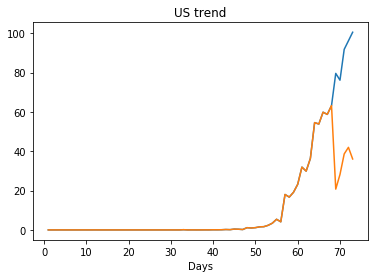

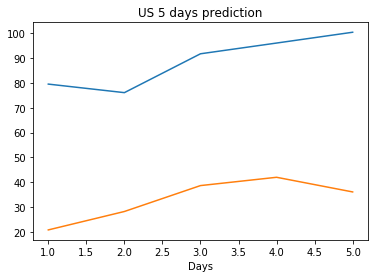

Creating directory ./offline6/Diamond Princess/training/
Diamond Princess
Saving the best model weights at Epoch [1], Best Valid Loss: 2586.2295


/space/home/nzhang/anaconda3/envs/neuralnet/lib/python3.7/site-packages/torch/nn/modules/loss.py:431: UserWarning: Using a target size (torch.Size([1, 1, 5])) that is different to the input size (torch.Size([5])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/space/home/nzhang/anaconda3/envs/neuralnet/lib/python3.7/site-packages/torch/nn/modules/loss.py:431: UserWarning: Using a target size (torch.Size([1, 5])) that is different to the input size (torch.Size([5])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


train error: 94342.1699329723
2586.2294921875
Saving the best model weights at Epoch [1], Best Valid Loss: 6677.2134
Saving the best model weights at Epoch [2], Best Valid Loss: 4950.4946
Saving the best model weights at Epoch [13], Best Valid Loss: 4541.5264
Saving the best model weights at Epoch [14], Best Valid Loss: 3142.7764
Saving the best model weights at Epoch [18], Best Valid Loss: 2741.4031
Saving the best model weights at Epoch [31], Best Valid Loss: 2324.6270
train error: 79748.10882013495
2324.626953125
Saving the best model weights at Epoch [1], Best Valid Loss: 17678.3027
Saving the best model weights at Epoch [6], Best Valid Loss: 12698.5879
train error: 121824.60890891335
12698.587890625
Saving the best model weights at Epoch [1], Best Valid Loss: 11514.1025
train error: 9460.71845037287
11514.1025390625
Saving the best model weights at Epoch [1], Best Valid Loss: 21392.5703
train error: 4649.807479858398
21392.5703125
Saving the best model weights at Epoch [1], Best V

Saving the best model weights at Epoch [4], Best Valid Loss: 3843.0864
Saving the best model weights at Epoch [5], Best Valid Loss: 2515.1978
train error: 114040.77111261542
2515.19775390625
Saving the best model weights at Epoch [1], Best Valid Loss: 26459.3574
Saving the best model weights at Epoch [4], Best Valid Loss: 9415.9941
Saving the best model weights at Epoch [7], Best Valid Loss: 3325.7117
Saving the best model weights at Epoch [10], Best Valid Loss: 682.8312
Saving the best model weights at Epoch [34], Best Valid Loss: 372.8888
Saving the best model weights at Epoch [41], Best Valid Loss: 335.9079
train error: 148226.01493696732
335.9079284667969
Saving the best model weights at Epoch [1], Best Valid Loss: 85618.7031
Saving the best model weights at Epoch [2], Best Valid Loss: 78797.9766
Saving the best model weights at Epoch [3], Best Valid Loss: 68524.0234
Saving the best model weights at Epoch [4], Best Valid Loss: 68053.4922
Saving the best model weights at Epoch [9], 

train error: 64901.48000266335
1397.6986083984375
Saving the best model weights at Epoch [1], Best Valid Loss: 42.4719
train error: 50512.34843306108
42.471923828125
Saving the best model weights at Epoch [1], Best Valid Loss: 158.5021
train error: 41319.97842129794
158.50209045410156
Saving the best model weights at Epoch [1], Best Valid Loss: 3032.1819
train error: 19260.623984596947
3032.181884765625
Saving the best model weights at Epoch [1], Best Valid Loss: 40.4669
train error: 31220.139687278053
40.4669075012207
Saving the best model weights at Epoch [1], Best Valid Loss: 108.9744
train error: 23294.877563476562
108.97440338134766
Saving the best model weights at Epoch [1], Best Valid Loss: 5762.2305
train error: 1110.621750051325
5762.23046875
Saving the best model weights at Epoch [1], Best Valid Loss: 52.3138
train error: 8258.500524347479
52.31379318237305
Saving the best model weights at Epoch [1], Best Valid Loss: 553.6778
train error: 2039.9950391596014
553.6777954101562


train error: 90068.14929476651
1.3347667455673218
Saving the best model weights at Epoch [1], Best Valid Loss: 3.5790
train error: 73693.9502618963
3.5790252685546875
Saving the best model weights at Epoch [1], Best Valid Loss: 11.5302
train error: 28872.620389071377
11.53021240234375
Saving the best model weights at Epoch [1], Best Valid Loss: 0.7069
train error: 66427.88003401323
0.7069129347801208
Saving the best model weights at Epoch [1], Best Valid Loss: 3.5255
train error: 56569.04768371582
3.525547742843628
Saving the best model weights at Epoch [1], Best Valid Loss: 41.4938
train error: 9940.549073652788
41.493831634521484
Saving the best model weights at Epoch [1], Best Valid Loss: 0.5130
train error: 103408.40028242632
0.5130476355552673
Saving the best model weights at Epoch [1], Best Valid Loss: 1.3089
train error: 99863.94392811168
1.308937907218933
Saving the best model weights at Epoch [1], Best Valid Loss: 36.4820
train error: 103393.59181352095
36.48200607299805
Savin

train error: 110126.71570101651
0.14728248119354248
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0118
train error: 117484.81773281097
0.011824366636574268
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0437
train error: 113665.52538576993
0.04365815222263336
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1746
train error: 79852.18935949152
0.1745770275592804
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0079
train error: 116993.74676270918
0.0079037481918931
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0261
train error: 109335.25871233507
0.026113733649253845
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1510
train error: 58830.10058004206
0.15095315873622894
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0039
train error: 112782.92505784468
0.003886912018060684
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0256
train error: 95715.88829387318
0.02559166

Saving the best model weights at Epoch [5], Best Valid Loss: 0.0347
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0338
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0331
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0328
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0327
train error: 117998.26202025705
0.032727934420108795
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0244
train error: 117324.11015869677
0.024442626163363457
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0825
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0789
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0777
train error: 112192.42619089647
0.07769796252250671
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0342
train error: 118740.03970465878
0.03417539224028587
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0202
train error: 118711.98335975679
0.02024634

train error: 118721.57864776254
0.007225529290735722
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0171
train error: 118074.85552198236
0.017107700929045677
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0061
train error: 118761.1351840381
0.006064053624868393
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0023
train error: 118721.07343067093
0.002279899315908551
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0037
train error: 118058.31309145148
0.003709326731041074
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1201
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1196
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1191
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1186
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1182
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1177
Saving the best model weights at Epoch [7], Best Valid L

Saving the best model weights at Epoch [30], Best Valid Loss: 0.0444
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0441
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0438
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0435
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0432
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0429
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0424
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0421
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0419
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0416
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0414
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0412
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0409
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0408
Saving the best model weights at E

Saving the best model weights at Epoch [19], Best Valid Loss: 0.0040
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0040
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0039
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0039
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0038
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0038
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0037
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0037
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0037
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0037
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0037
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0036
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0036
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0036
train error: 118814.82736243434
0.

Saving the best model weights at Epoch [12], Best Valid Loss: 0.0023
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0022
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0022
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0022
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0022
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0021
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0021
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0021
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0021
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0021
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0021
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0021
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0020
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0020
Saving the best model weights at E

Saving the best model weights at Epoch [3], Best Valid Loss: 0.0151
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0151
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0150
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0150
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0150
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0149
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0149
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0148
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0148
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0148
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0147
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0147
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0147
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0146
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [27], Best Valid Loss: 0.0046
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0046
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0046
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0045
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0045
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0044
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0044
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0044
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0044
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0043
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0043
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0043
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0042
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0042
Saving the best model weights at E

/space/home/nzhang/anaconda3/envs/neuralnet/lib/python3.7/site-packages/ipykernel_launcher.py:88: RuntimeWarning: divide by zero encountered in double_scalars


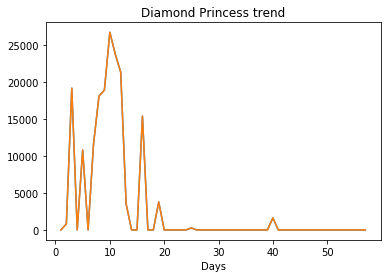

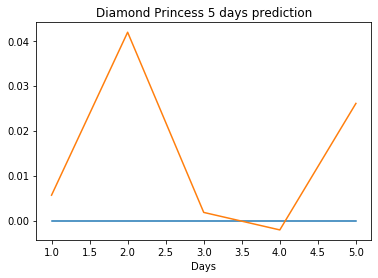

In [30]:
# optimization grid
lr_list = [0.1,0.01,0.001,1e-4,1e-5,1e-6]
hidden_lst = [1,2,3,4,5]
hState_lst = [10,30,50,100]
momentumS = [0.1,0.5,0.9]
tloss = []
ntloss = []

country_result = dict()
#optimizer = torch.optim.SGD(model.parameters(), lr = learning_rate, momentum=0.9)
best_error = 1e10
country_file_path = ("./country_file6.txt")
for i in range(len(countries)):
    if i in skip_countries:
        continue # too little data 
        
    country_result[countries[i]] = [] # store best validation parameter, test loss, test result
    best_error = 1e10
    
    best_param = [0,0,0]

    learning_rate = lr_list[0] # to be changed/optimized 
    hidden_dim = hidden_lst[0]
    hidden_state = hState_lst[0]
    
    
    model_name = countries[i]
    output_file_path = "./offline6/" + model_name + "/training/"
    directory = os.path.dirname(output_file_path)
    if not os.path.exists(directory):
        print("Creating directory %s" % output_file_path)
        os.makedirs(directory)
    else:
         print("Directory %s exists" % output_file_path)

    print(countries[i])
    train_dataset = torch.utils.data.TensorDataset(torch.tensor(country_train_X[i]).unsqueeze_(2).unsqueeze_(2).float(), torch.tensor(country_train_Y[i]).unsqueeze_(1).float())
    train_loader = torch.utils.data.DataLoader(dataset=train_dataset, batch_size=batch_size, shuffle=True)

    # load validation
    valid_dataset = torch.utils.data.TensorDataset(torch.tensor(country_valid_X[i]).unsqueeze_(1).unsqueeze_(1).unsqueeze_(0).float(), torch.tensor(country_valid_Y[i]).unsqueeze_(0).float())
    valid_loader = torch.utils.data.DataLoader(dataset=valid_dataset, batch_size=batch_size, shuffle=False)

    # load test
    test_dataset = torch.utils.data.TensorDataset(torch.tensor(country_test_X[i]).unsqueeze_(1).unsqueeze_(1).unsqueeze_(0).float(), torch.tensor(country_test_Y[i]).unsqueeze_(0).float())
    test_loader = torch.utils.data.DataLoader(dataset=test_dataset, batch_size=batch_size, shuffle=False)
    
    bestmodel = 0
    country_file = open(country_file_path,"a")
    # optimize (learning rate, hidden layer, hidden state, activation)
    for j in range(len(lr_list)):
        for k in range(len(hidden_lst)): # hidden layer
            for m in range(len(hState_lst)): # hidden state
                for s in range(len(momentumS)):
                # train
                # specific parameters
                    learning_rate = lr_list[j]
                    hidden_dim = hState_lst[m]
                    num_layers = hidden_lst[k]
                    momentum = momentumS[s]
                    #lstm_input_size = len()

                    net =  LSTM(lstm_input_size, hidden_dim, batch_size=batch_size, output_dim=output_dim, num_layers=num_layers)
                    #print(net)
                    model = net.to(device)

                    #
                    optimizer = torch.optim.SGD(model.parameters(), lr = learning_rate, momentum=momentum)
                    # to be changed/optimized 

                    model, err = train_model(train_loader, valid_loader, model, device, criterion,  optimizer, num_epochs, output_file_path,learning_rate,hidden_dim,num_layers,momentum)
                    print(err)
                    if err < best_error:
                        best_error = err
                        best_param = [lr_list[j],hidden_lst[k],hState_lst[m],momentum]
                        bestmodel = model
    
    country_result[countries[i]].append(best_param)
    
    # test data
    pred,final_loss = test_model(test_loader,bestmodel,device,criterion)
    print("test loss: ",final_loss)
    country_result[countries[i]].append([pred.tolist(),country_test_Y[i].tolist()])
    country_result[countries[i]].append(final_loss)
    torch.save(bestmodel.state_dict(), output_file_path+countries[i]+".th")
    
    tloss.append(final_loss)
    ntloss.append(final_loss/max(country_test_Y[i],0))
    
    print("%s, %s, %s, %s" % (countries[i], pred.tolist(), final_loss,best_param), file=country_file)
                   
    country_file.close()
    graph_country(i,pred.tolist(),graph_dir)

In [31]:
import json
with open("country_summary_6.js",'w+') as outfile:
    json.dump(country_result, outfile , sort_keys = True , indent = 4, separators = (",",": "))


OverflowError: cannot convert float infinity to integer

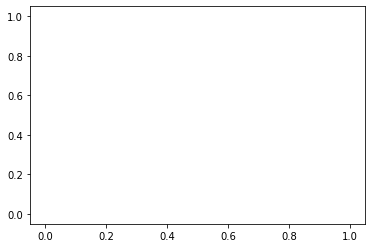

In [32]:
#country_test_Y[0]
sns.distplot(np.array(ntloss)); # normalized loss

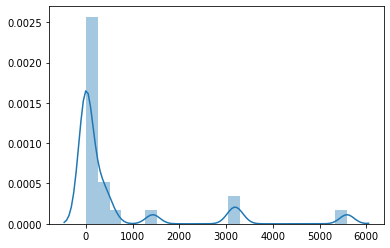

In [33]:
sns.distplot(np.array(tloss)); # not normalized loss

In [38]:
len(ntloss) #23
len(tloss)

23

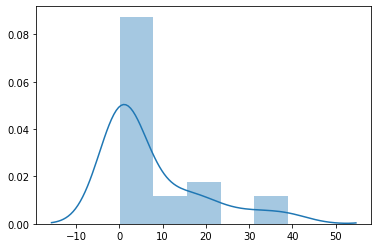

In [39]:
ntloss.pop()
sns.distplot(np.array(ntloss));